In [1]:
# do NOT post this block of code publicly!!
stocks_API_key = ''

# Lunar Cycle Influence on Twitter Sentiment and Stock Markets

article on lunar cycles & crime: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC1444800/

project proposal write-up: https://docs.google.com/document/d/1sAl3SyxhI6gLZ1zDEHhtIOfjB0FzofjjM3Bp7CaIBgM/edit#

how to let web app access Twitter without exposing my keys: https://thurmancms.herokuapp.com/articles/how-to-add-twitter-access-token-and-secret-key-to-heroku-application



## Import Libraries

In [211]:
# basic use libraries
import re
import numpy as np
import datetime
import pandas as pd

# for scraping the web
from bs4 import BeautifulSoup
import requests
from twitterscraper import query_tweets
import twitterscraper

# for visualizations
import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline
from wordcloud import WordCloud

# file management
import csv
import json
import subprocess
import shutil

#for initial time-series modeling
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.seasonal import seasonal_decompose as sd

# Facebook Prophet libraries
from fbprophet import Prophet
from fbprophet.plot import plot_plotly, plot_cross_validation_metric
from fbprophet.diagnostics import cross_validation, performance_metrics
import plotly.offline as py
pd.plotting.register_matplotlib_converters() #necessary to maintain pd.plotting functionality

# for NLP
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS
from textblob import TextBlob 
# import preprocessor as p   #is this the right one?    I want this one: https://pypi.org/project/tweet-preprocessor/

#### Obtain Scrub Explore Model iNterpret!

# 1. Obtaining the Data

## Obtaining Twitter Data

Twitter API documentation: https://developer.twitter.com/en/docs/api-reference-index

instructions on accessing the Twitter API and performing sentiment analysis: https://www.geeksforgeeks.org/twitter-sentiment-analysis-using-python/

this one has more options and discusses removing user handles and more: https://www.analyticsvidhya.com/blog/2018/07/hands-on-sentiment-analysis-dataset-python/

lunar phases: https://www.calendar-12.com/moon_phases/2018
    
- automating Twitter requests with python: https://github.com/Jefferson-Henrique/GetOldTweets-python

### Tweet preprocessing & Sentiment analysis links

   - good blog enter on sentiment analysis & preprocessing tweets: https://towardsdatascience.com/extracting-twitter-data-pre-processing-and-sentiment-analysis-using-python-3-0-7192bd8b47cf
   - Python library that specifically cleans tweets: https://pypi.org/project/tweet-preprocessor/
   - some more customizable options: https://stackoverflow.com/questions/8376691/how-to-remove-hashtag-user-link-of-a-tweet-using-regular-expression 

to think about: do I want to keep happy/sad emojis? what about simply removing the '#' character from hashtags to retain text sentiment

We will use the `twitterscraper` library for obtaining tweets. Documentation here: https://github.com/taspinar/twitterscraper

#### using cmd line method

In [3]:
# define functions to automate Twitter scraping
def make_dates_list(year=2018):
    # define a list of dates for a given year
    dates_year =[str(date)[:10] for date in pd.date_range(start=f'1/1/{year}', end=f'12/31/{year}')]
    # define a list of dates for generating file names
    dates_stripped_year = [date.replace('-','') for date in dates_year]
    return dates_year, dates_stripped_year


def scrape_tweets(query, year=2018, num_tweets=1000):
    """
    Automatically scrapes X number of Tweets per day for a
    given year. Scraping works backwards from midnight.
    'query' must be a string
    ------------------------------------
    Generates a JSON file for each day scraped, and moves 
    to the subfolder 'data'.
    """
    dates_year, dates_stripped_year = make_dates_list(year)
    for i in range(len(dates_year)):
        begin_date = dates_year[i]
        if i == len(dates_year)-1:
            end_date = f'{year+1}-01-01'
        else:
            end_date = dates_year[i+1]
        day = dates_stripped_year[i]
        cmd = 'twitterscraper "{}" -l {} -o t{}.json -bd {} -ed {} --lang en'.format(query, 
                num_tweets, day, begin_date, end_date)
        subprocess.run(cmd)

        #move JSON file into `data` directory
        shutil.move(f't{day}.json', f'./data/t{day}.json')
        if (i+1)%5 == 0:
            print(f"finished scraping {i+1} days of {year}")
    print("SCRAPING PROCESS COMPLETE!")
    pass

In [125]:
break #comment out this line if you want to execute, WARNING: takes hours

query = 'life OR death OR happy OR sad Exclude:retweets'
scrape_tweets(query=query, year=2018, num_tweets=1000)

finished scraping 0 days of 2018
finished scraping 1 days of 2018
finished scraping 2 days of 2018
finished scraping 3 days of 2018
finished scraping 4 days of 2018
finished scraping 5 days of 2018
finished scraping 6 days of 2018
finished scraping 7 days of 2018
finished scraping 8 days of 2018
finished scraping 9 days of 2018
finished scraping 10 days of 2018
finished scraping 11 days of 2018
finished scraping 12 days of 2018
finished scraping 13 days of 2018
finished scraping 14 days of 2018
finished scraping 15 days of 2018
finished scraping 16 days of 2018
finished scraping 17 days of 2018
finished scraping 18 days of 2018
finished scraping 19 days of 2018
finished scraping 20 days of 2018
finished scraping 21 days of 2018
finished scraping 22 days of 2018
finished scraping 23 days of 2018
finished scraping 24 days of 2018
finished scraping 25 days of 2018
finished scraping 26 days of 2018
finished scraping 27 days of 2018
finished scraping 28 days of 2018
finished scraping 29 day

finished scraping 238 days of 2018
finished scraping 239 days of 2018
finished scraping 240 days of 2018
finished scraping 241 days of 2018
finished scraping 242 days of 2018
finished scraping 243 days of 2018
finished scraping 244 days of 2018
finished scraping 245 days of 2018
finished scraping 246 days of 2018
finished scraping 247 days of 2018
finished scraping 248 days of 2018
finished scraping 249 days of 2018
finished scraping 250 days of 2018
finished scraping 251 days of 2018
finished scraping 252 days of 2018
finished scraping 253 days of 2018
finished scraping 254 days of 2018
finished scraping 255 days of 2018
finished scraping 256 days of 2018
finished scraping 257 days of 2018
finished scraping 258 days of 2018
finished scraping 259 days of 2018
finished scraping 260 days of 2018
finished scraping 261 days of 2018
finished scraping 262 days of 2018
finished scraping 263 days of 2018
finished scraping 264 days of 2018
finished scraping 265 days of 2018
finished scraping 26

## Obtaining (and cleaning) Financial Data

website to get historical infra-day stock prices: https://www.alphavantage.co/documentation/
   - request limitations: 5/minute, 500/day
   - URL structure: https://www.alphavantage.co/query?function=TIME_SERIES_DAILY&symbol=MSFT&outputsize=full&apikey=demo
   - (back up option: https://docs.intrinio.com/tutorial/web_api)
   
I need to be careful about how I look at this data. Since stock markets are only open 6.5 hours a day, 5 days a week, certain lunar cycle days will fall on weekends, while considerable after-hours trading can affect next-day opening prices. Since lunar cycles are most noticeble at night, I should probably set stock days as 24-hour periods, from opening bell to following opening bell to account for evening trading. 

In [48]:
# Define functions to scrape and clean financial data for a given year
def fetch_data(symbol, object_type, stocks_apikey):
    # Making an API request for a certain stock's history
    if object_type == 'currency':
        credentials = {'function':'FX_DAILY', 
                       'from_symbol':symbol, 
                       'to_symbol':'USD', 
                       'outputsize':'full',
                       'apikey':stocks_API_key}
    elif object_type == 'cryptocurrency':
        credentials = {'function':'DIGITAL_CURRENCY_DAILY', 
                       'symbol':symbol, 
                       'market':'USD', 
                       'apikey':stocks_API_key}
    else:
        credentials = {'function':'TIME_SERIES_DAILY',
                       'symbol':symbol,
                       'outputsize':'full',
                       'apikey':stocks_apikey}

    r = requests.get('https://www.alphavantage.co/query', params=credentials)
    # checking to make sure request was successful
    print(r.status_code)
    if r.status_code == requests.codes.ok:
        print("Request Successful")
    return r


def clean_financials(r, object_type):
    # cleaning up the data to make it easier to work with
    if object_type == 'currency':
        df = pd.DataFrame(r.json()["Time Series FX (Daily)"])
    elif object_type == 'cryptocurrency':
        df = pd.DataFrame(r.json()["Time Series (Digital Currency Daily)"])
    elif object_type in ['stock','index']:
        df = pd.DataFrame(r.json()["Time Series (Daily)"])

    df = df.T.reset_index()

    if object_type == 'cryptocurrency':
        df.drop(columns=["1b. open (USD)","2b. high (USD)","3b. low (USD)",
            "4b. close (USD)","6. market cap (USD)"], inplace=True, axis=1)

    if object_type == 'currency':
        df.columns = ['date','open','high','low','close']
        df.date = pd.to_datetime(df.date)
        df[['open','high','low','close']] = df[['open',
            'high','low','close']].astype(float)
    else:
        df.columns = ['date','open','high','low','close','volume']
        df.date = pd.to_datetime(df.date)
        df[['open','high','low','close','volume']] = df[['open',
            'high','low','close','volume']].astype(float)

    # create a new column to account for after-hours trading
    # this uses the next day's open value as the prior day's close value
    cl24 = [df.loc[0].close]
    for val in df.open.values:
        cl24.append(val)
    cl24 = pd.DataFrame(cl24[:-1], columns=['close_24'])
    df = df.join(cl24)

    # now we must account for when afterhours trading exceeds high/low values
    df['high_24'] = df[['high', 'close_24']].values.max(1)
    df['low_24'] = df[['low', 'close_24']].values.min(1)
    # and add a few more columns that should be useful
    df['range'] = df['high'] - df['low']
    df['range_24'] = df['high_24'] - df['low_24']
    df['change_24'] = df['close_24'] - df['open']
    # setting date column as index to facilitate timeseries manipulation
    df.set_index('date', inplace=True)
    return df
    

def get_financial_data(symbol, object_type, stocks_apikey, year=2018, verbose=True):
    """
    Inputs:
    symbol         (string) Stock or Currency symbol
    object_type    (string) must be one of these:
                      'stock'
                      'index'
                      'currency'
                      'cryptocurrency'
    stocks_apikey  (string) your API key for 
                      https://www.alphavantage.co
    year           (int) the year you wish to examine
    verbose        if True, displays .info() and .head() of data
    =========================================
    Returns a DataFrame of daily financial information containing
    at least opening, closing, high, and low values.
    """
    valid_types = ['stock','index','currency','cryptocurrency']
    if object_type in valid_types:
        r = fetch_data(symbol, object_type, stocks_apikey)
        df = clean_financials(r, object_type)    #cleaning data
        year_df = df[f'{year}':f'{year}']        # getting 1 year's data
        if verbose:
            display(year_df.head(),year_df.info())
        return year_df
    else:
        print("""
        Invalid entry for 'object_type', must be one of these strings:
                'stock'
                'index'
                'currency'
                'cryptocurrency'
        """)
        pass

### Let's look at a few stocks and currencies

In [5]:
# Microsoft
MSFT_2018 = get_financial_data('MSFT', 'stock', stocks_API_key, year=2018)

200
Request Successful


,open,high,low,close,volume,close_24,high_24,low_24,range,range_24,change_24
date,,,,,,,,,,,
2018-12-31,101.2871,102.40,100.44,101.57,33173800.0,99.5500,102.40,99.55,1.96,2.85,-1.7371
2018-12-28,102.0900,102.41,99.52,100.39,38196300.0,101.2871,102.41,99.52,2.89,2.89,-0.8029
2018-12-27,99.3000,101.19,96.40,101.18,49498500.0,102.0900,102.09,96.40,4.79,5.69,2.7900
2018-12-26,95.1400,100.69,93.96,100.56,51634800.0,99.3000,100.69,93.96,6.73,6.73,4.1600
2018-12-24,97.6800,97.97,93.98,94.13,43935200.0,95.1400,97.97,93.98,3.99,3.99,-2.5400


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 251 entries, 2018-12-31 to 2018-01-02
Data columns (total 11 columns):
open         251 non-null float64
high         251 non-null float64
low          251 non-null float64
close        251 non-null float64
volume       251 non-null float64
close_24     251 non-null float64
high_24      251 non-null float64
low_24       251 non-null float64
range        251 non-null float64
range_24     251 non-null float64
change_24    251 non-null float64
dtypes: float64(11)
memory usage: 23.5 KB


None

In [6]:
# S&P 500 (stock market index)
# The S&P 500 is an average of the performance of 
# 500 large companies, so we can use this to approximate 
# the entire stock market. (It is one of the most commonly 
# used indicators of the overall US stock market).
SP500_2018 = get_financial_data('INX', 'stock', stocks_API_key, year=2018)

200
Request Successful


,open,high,low,close,volume,close_24,high_24,low_24,range,range_24,change_24
date,,,,,,,,,,,
2018-12-31,2498.9399,2509.2400,2482.8201,2506.8501,3.442870e+09,2476.9600,2509.2400,2476.9600,26.4199,32.2800,-21.9799
2018-12-28,2498.7700,2520.2700,2472.8899,2485.7400,3.702620e+09,2498.9399,2520.2700,2472.8899,47.3801,47.3801,0.1699
2018-12-27,2442.5000,2489.1001,2397.9399,2488.8301,4.096610e+09,2498.7700,2498.7700,2397.9399,91.1602,100.8301,56.2700
2018-12-26,2363.1201,2467.7600,2346.5801,2467.7000,4.233990e+09,2442.5000,2467.7600,2346.5801,121.1799,121.1799,79.3799
2018-12-24,2400.5601,2410.3401,2351.1001,2351.1001,2.613930e+09,2363.1201,2410.3401,2351.1001,59.2400,59.2400,-37.4400


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 251 entries, 2018-12-31 to 2018-01-02
Data columns (total 11 columns):
open         251 non-null float64
high         251 non-null float64
low          251 non-null float64
close        251 non-null float64
volume       251 non-null float64
close_24     251 non-null float64
high_24      251 non-null float64
low_24       251 non-null float64
range        251 non-null float64
range_24     251 non-null float64
change_24    251 non-null float64
dtypes: float64(11)
memory usage: 23.5 KB


None

In [7]:
# Euro - USD exchange market
EUR_2018 = get_financial_data('EUR', 'currency', stocks_API_key, year=2018)

200
Request Successful


,open,high,low,close,close_24,high_24,low_24,range,range_24,change_24
date,,,,,,,,,,
2018-12-31,1.1439,1.1467,1.1420,1.1466,1.1465,1.1467,1.1420,0.0047,0.0047,0.0026
2018-12-30,1.1445,1.1450,1.1433,1.1439,1.1439,1.1450,1.1433,0.0017,0.0017,-0.0006
2018-12-28,1.1429,1.1473,1.1426,1.1442,1.1445,1.1473,1.1426,0.0047,0.0047,0.0016
2018-12-27,1.1355,1.1454,1.1354,1.1429,1.1429,1.1454,1.1354,0.0100,0.0100,0.0074
2018-12-26,1.1411,1.1420,1.1341,1.1355,1.1355,1.1420,1.1341,0.0079,0.0079,-0.0056


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 314 entries, 2018-12-31 to 2018-01-01
Data columns (total 10 columns):
open         314 non-null float64
high         314 non-null float64
low          314 non-null float64
close        314 non-null float64
close_24     314 non-null float64
high_24      314 non-null float64
low_24       314 non-null float64
range        314 non-null float64
range_24     314 non-null float64
change_24    314 non-null float64
dtypes: float64(10)
memory usage: 27.0 KB


None

In [8]:
# Bitcoin - USD exchange market
BTC_2018 = get_financial_data('BTC', 'cryptocurrency', stocks_API_key, year=2018)

200
Request Successful


,open,high,low,close,volume,close_24,high_24,low_24,range,range_24,change_24
date,,,,,,,,,,,
2018-12-31,3803.12,3810.00,3630.33,3702.90,29991.778350,3701.23,3810.00,3630.33,179.67,179.67,-101.89
2018-12-30,3696.71,3903.50,3657.90,3801.91,33222.369262,3803.12,3903.50,3657.90,245.60,245.60,106.41
2018-12-29,3839.00,3892.00,3670.00,3695.32,38874.373903,3696.71,3892.00,3670.00,222.00,222.00,-142.29
2018-12-28,3567.89,3887.25,3540.04,3839.26,45964.304987,3839.00,3887.25,3540.04,347.21,347.21,271.11
2018-12-27,3777.74,3813.98,3535.00,3567.91,44097.392912,3567.89,3813.98,3535.00,278.98,278.98,-209.85


<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 365 entries, 2018-12-31 to 2018-01-01
Data columns (total 11 columns):
open         365 non-null float64
high         365 non-null float64
low          365 non-null float64
close        365 non-null float64
volume       365 non-null float64
close_24     365 non-null float64
high_24      365 non-null float64
low_24       365 non-null float64
range        365 non-null float64
range_24     365 non-null float64
change_24    365 non-null float64
dtypes: float64(11)
memory usage: 34.2 KB


None

# 2. Scrubbing the Data

Thankfully, the stock market data is already completely cleaned. The twitter data, however, still requires pretty extensive scrubbing to remove odd characters, links, and usernames. 

### FIRST I MUST PROCESS THE TWEETS

CSVwriter doesn't understand emojis and some other special characters, so I need to remove them.

In [275]:
# Let's define sets of old-school emoticons and emojis
# Happy Emoticons
emoticons_happy = set([
    ':-)', ':)', ';)', ':o)', ':]', ':3', ':c)', ':>', '=]', '8)', '=)', ':}',
    ':^)', ':-D', ':D', '8-D', '8D', 'x-D', 'xD', 'X-D', 'XD', '=-D', '=D',
    '=-3', '=3', ':-))', ":'-)", ":')", ':*', ':^*', '>:P', ':-P', ':P', 'X-P',
    'x-p', 'xp', 'XP', ':-p', ':p', '=p', ':-b', ':b', '>:)', '>;)', '>:-)',
    '<3'
    ])

# Sad Emoticons
emoticons_sad = set([
    ':L', ':-/', '>:/', ':S', '>:[', ':@', ':-(', ':[', ':-||', '=L', ':<',
    ':-[', ':-<', '=\\', '=/', '>:(', ':(', '>.<', ":'-(", ":'(", ':\\', ':-c',
    ':c', ':{', '>:\\', ';('
    ])

#Emoji patterns
emoji_pattern = re.compile("["
         u"\U0001F600-\U0001F64F"  # emoticons
         u"\U0001F300-\U0001F5FF"  # symbols & pictographs
         u"\U0001F680-\U0001F6FF"  # transport & map symbols
         u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
         u"\U00002702-\U000027B0"
         u"\U000024C2-\U0001F251"
         "]+", flags=re.UNICODE)

In [9]:
# Define functions to clean tweets and get tweet sentiment

# portions of the code below comes from :
# https://towardsdatascience.com/extracting-twitter-data-pre-processing-and-sentiment-analysis-using-python-3-0-7192bd8b47cf
def replace_emoticons(tweet):
    "This code replaces happy and sad emoticons with the words 'HAPPY' and 'SAD'"
    rhappy = '[' + re.escape(''.join(emoticons_happy)) + ']'
    re.sub(rhappy, ' HAPPY ', tweet)
    rsad = '[' + re.escape(''.join(emoticons_sad)) + ']'
    re.sub(rsad, ' SAD ', tweet)
    return tweet

def clean_tweet(tweet): 
    ''' 
    Utility function to clean tweet text by removing links, usernames, and
    special characters using simple regex statements. 
    '''
    tweet = replace_emoticons(tweet)
    # p.set_options(p.OPT.URL, p.OPT.EMOJI, p.OPT.MENTION)
    # tweet = p.clean(tweet)
    tweet = ' '.join(re.sub("(@[A-Za-z0-9]+)|([^0-9A-Za-z \t]) \
                            |(\w+:\/\/\S+)", " ", tweet).split())
    return tweet

def double_clean_tweet(tweet):
    "This function goes a little further than the previous clean function"
    #removing mentions
    tweet = re.sub(r':', ' ', tweet)
    tweet = re.sub(r'‚Ä¶', ' ', tweet)
    #replace consecutive non-ASCII characters with a space
    tweet = re.sub(r'[^\x00-\x7F]+',' ', tweet)
    #remove emojis from tweet  (unless you want to later go through the UNICODE
    # charts and separate "happy" emojis from "sad" emojis and add them to 
    # the `replace_emoticons()` function)
    tweet = emoji_pattern.sub(r'', tweet)
    return tweet


# Sentiment analysis code below adapted from:
# https://www.geeksforgeeks.org/twitter-sentiment-analysis-using-python/
def get_tweet_sentiment(tweet): 
    ''' 
    Utility function to classify sentiment of passed tweet 
    using textblob's sentiment method 
    '''
    # create TextBlob object of passed tweet text 
    analysis = TextBlob(tweet)
    # set sentiment 
    polarity = analysis.sentiment.polarity
    subjectivity = analysis.sentiment.subjectivity
    if analysis.sentiment.polarity > 0.1: 
        sentiment = 'positive'
    elif analysis.sentiment.polarity < -0.1: 
        sentiment = 'negative'
    else: 
        sentiment = 'neutral'
    return sentiment, polarity, subjectivity

In [10]:
# define a function to create a .CSV file that compiles the relevant 
# info from the JSONs, preprocesses the tweets, and performs sentiment analysis
def json_to_csv_tweets(output_filename='output.csv', year=2018):
    """
    Takes in JSON files of scraped tweets from the `./data/` folder,
    cleans the tweets, performs sentiment analysis, and then outputs
    the results to the provided destination CSV filename.
    """
    # create the csv writer object
    csvwriter = csv.writer(open(output_filename, 'w', newline=''))
    csvwriter.writerow(["timestamp", "text", "sentiment", "polarity", "subjectivity", "tally"])

    # iterate adding rows of JSON to the CSV file
    dates_year, dates_stripped_year = make_dates_list(year)
    for i in dates_stripped_year:
        f = open(f'./data/t{i}.json')
        data = json.load(f)
        for tweet in data:
            tw = tweet["text"]
            tw = replace_emoticons(tw)
            tw = clean_tweet(tw)
            tw = double_clean_tweet(tw)
            sentiment, polarity, subjectivity = get_tweet_sentiment(tw)
            csvwriter.writerow([i, tw, sentiment, polarity, subjectivity, 1])
        f.close()
        if float(i)%20 == 0:
            print(f"Finished working with:   ./data/t{i}.json")
    print("JOB IS COMPLETELY FINISHED.  HOORAY!!")
    pass

In [142]:
break     ### remove this line to run this code block

json_to_csv_tweets('tweets_happysad_2018.csv', year=2018)

Finished working with:   ./data/t20180120.json
Finished working with:   ./data/t20180220.json
Finished working with:   ./data/t20180320.json
Finished working with:   ./data/t20180420.json
Finished working with:   ./data/t20180520.json
Finished working with:   ./data/t20180620.json
Finished working with:   ./data/t20180720.json
Finished working with:   ./data/t20180820.json
Finished working with:   ./data/t20180920.json
Finished working with:   ./data/t20181020.json
Finished working with:   ./data/t20181120.json
Finished working with:   ./data/t20181220.json
JOB IS COMPLETELY FINISHED.  HOORAY!!


In [11]:
tw_df = pd.read_csv('tweets_happysad_2018.csv')
tw_df.timestamp = pd.to_datetime(tw_df.timestamp, format='%Y%m%d')

In [12]:
display(tw_df.head())
tw_df.info()

,timestamp,text,sentiment,polarity,subjectivity,tally
0,2018-01-01,Thanks for your insightful commentaryIf only l...,neutral,0.008333,0.408333,1
1,2018-01-01,1st-Mail | HAPPY NEW YEAR!,positive,0.485227,0.727273,1
2,2018-01-01,"Poor and sick?May God be with you,in the futur...",negative,-0.100000,0.241667,1
3,2018-01-01,Happy birthday,positive,0.800000,1.000000,1
4,2018-01-01,Late to the party but HAPPY NEW YEAR to all yo...,positive,0.181061,0.534091,1


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 370206 entries, 0 to 370205
Data columns (total 6 columns):
timestamp       370206 non-null datetime64[ns]
text            370206 non-null object
sentiment       370206 non-null object
polarity        370206 non-null float64
subjectivity    370206 non-null float64
tally           370206 non-null int64
dtypes: datetime64[ns](1), float64(2), int64(1), object(2)
memory usage: 16.9+ MB


**Before we continue, let's just make sure that our scraping process was at least mostly successful in pulling 1000 tweets per day.**

In [13]:
grouped1 = pd.DataFrame(tw_df.groupby(['timestamp'])['tally'].sum())
grouped1 = grouped1.sort_values(by=['tally'])
grouped1.head()

,tally
timestamp,
2018-01-13,20
2018-02-14,300
2018-04-17,680
2018-06-02,1007
2018-12-21,1017


**According to the table above, it seems that our twitter scraper may have failed to work properly for 3 days of the year. That's not too bad, so we'll ignore it for now.**

# 3. Exploratory Data Analysis (EDA)



In [82]:
# let's plot sentiment trends
def plot_sentiments(csv_filename='tweets.csv', year=2018, positive_only=False):
    tweets_df = pd.read_csv(csv_filename)
    tweets_df.timestamp = pd.to_datetime(tweets_df.timestamp, format='%Y%m%d')
    grouped = pd.DataFrame(tweets_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()
    if positive_only:
        temp_df = grouped[grouped.sentiment == 'positive'].set_index('timestamp')
        temp_df['tally'].plot(figsize=(15,8), label=csv_filename)
        plt.ylabel("Number of Positive Tweets\n(~1,000/day total)", fontsize=16)
        plt.title(f"Daily Positivity by Keyword Search at midnight (UTC) in {year}", fontsize=20)
    else:
        for sentiment in grouped.sentiment.unique():
            temp_df = grouped[grouped.sentiment == sentiment].set_index('timestamp')
            temp_df['tally'].plot(figsize=(15,8), label=sentiment)
            plt.ylabel("Number of Tweets by Sentiment\n(~1,000/day total)", fontsize=16)
            plt.title(f"Daily Sentiment at midnight (UTC) in {year}", fontsize=20)
    plt.legend();

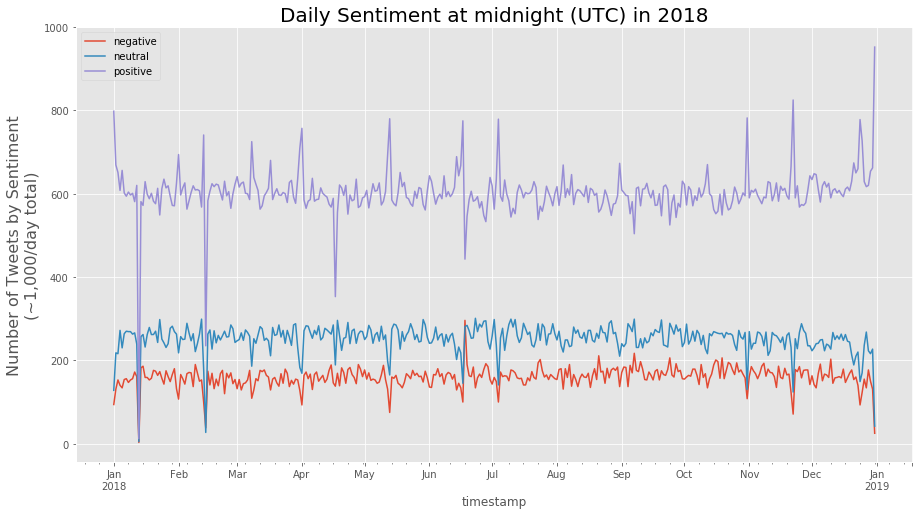

In [83]:
plot_sentiments('tweets_happysad_2018.csv', 2018)

In [16]:
# Make a dictionary for each sentiment
t2018 = {}
for sentiment in grouped.sentiment.unique():
    temp = grouped[grouped.sentiment == sentiment].set_index('timestamp')
    temp.drop('sentiment', axis=1, inplace=True)
    t2018[sentiment] = temp
    
# Log transform the values
t2018_log = {}
for sentiment in t2018.keys():
    t2018_log[sentiment] = np.log(t2018[sentiment])
    
# # Differencing the log-transformed values to remove seasonality
# t2018_log_diff = {}
# for key in list(t2018.keys()):
#     t2018_log_diff[key] = t2018_log[key].diff(periods=7).dropna()
    
# t2018_log_diff['positive'].plot()
# t2018_log_diff['negative'].plot()
# t2018_log_diff['neutral'].plot();

In [17]:
# Define a function to decompose a time series, in order to detect
# trends and seasonality, and allow for examining the residuals
def df_decompose(df):
    # Gather the trend, seasonality and noise of decomposed object
    trend = sd(df).trend
    seasonal = sd(df).seasonal
    residual = sd(df).resid

    # Plot gathered statistics
    plt.figure(figsize=(12,8))
    plt.title(f"Decomposition for {df}")
    plt.subplot(411)
    plt.plot(df, label='Original', color="blue")
    plt.legend(loc='best')
    plt.subplot(412)
    plt.plot(trend, label='Trend', color="blue")
    plt.legend(loc='best')
    plt.subplot(413)
    plt.plot(seasonal, label='Seasonality', color="blue")
    plt.legend(loc='best')
    plt.subplot(414)
    plt.plot(residual, label='Residuals', color="blue")
    plt.legend(loc='best')
    plt.tight_layout();
    
    return residual.dropna()

negative
neutral
positive


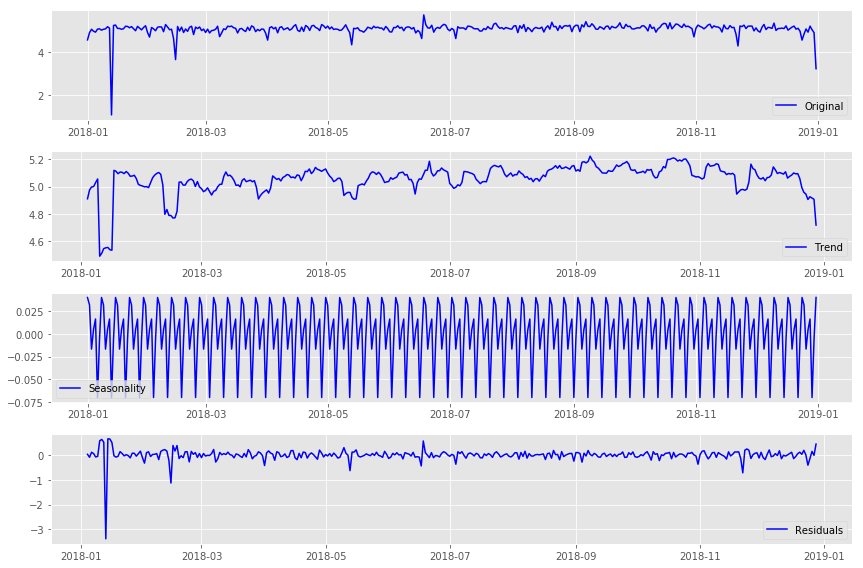

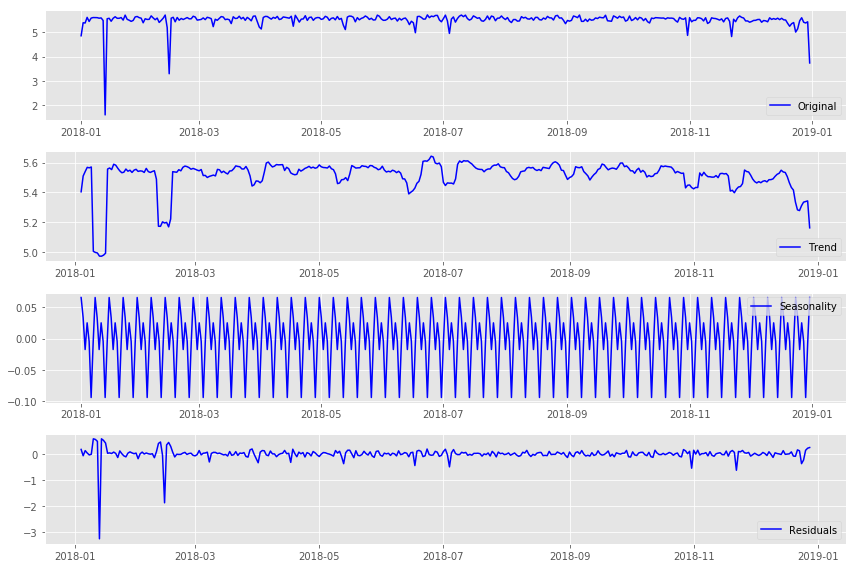

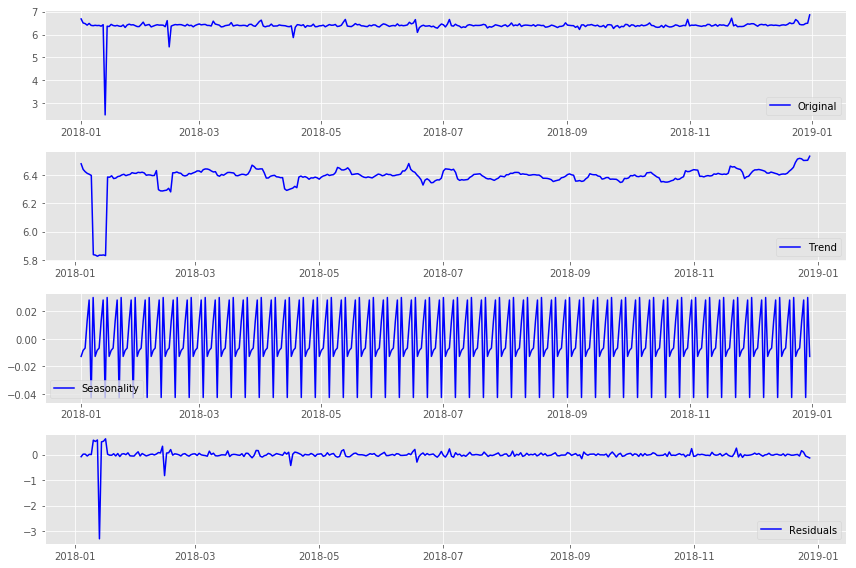

In [18]:
for sentiment in grouped.sentiment.unique():
    print(sentiment)
    df_decompose(t2018_log[sentiment])

**Based on these decomposition graphs, it seems pretty clear that tweet sentiment is subject to seasonality on the scale of about a week.**

However, this presents us with a problem: Is the sentiment seasonality tied to the work week or to the lunar week?

Though lunar weeks are on average 7 days long, this is not an exact number which is why full moons do not occur on the same weekday throughout the year. Bearing this in mind, we need to develop some basic models to see if our data's seasonality is only affected by calendar weeks, only by lunar weeks, or some combination of the two. My preliminary hypothesis going in will be that calendar weeks are the driving force, but that lunar cycles also have a small impact. 

This is a fairly tricky problem to solve, but fortunately Facebook's Prophet library has precisely the features we need to solve it.

# 4. Model

## Using Facebook Prophet to decode multiple seasonalities

https://facebook.github.io/prophet/docs/seasonality,_holiday_effects,_and_regressors.html

In [19]:
#prepare grouped sentiment data for FBProphet processing
grp_pos = grouped[grouped.sentiment == 'positive'].drop('sentiment', axis=1).reset_index(drop=True)
grp_pos.columns = ['ds','y']
display(grp_pos.head())

grp_neg = grouped[grouped.sentiment == 'negative'].drop('sentiment', axis=1).reset_index(drop=True)
grp_neg.columns = ['ds','y']

grp_neut = grouped[grouped.sentiment == 'neutral'].drop('sentiment', axis=1).reset_index(drop=True)
grp_neut.columns = ['ds','y']

,ds,y
0,2018-01-01,798
1,2018-01-02,669
2,2018-01-03,651
3,2018-01-04,608
4,2018-01-05,656


### Using FBProphet to examine tweets with 'positive' sentiment

In [20]:
# Using FBProphet on tweets with 'positive' sentiment
m = Prophet()
m.fit(grp_pos)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


In [21]:
future = m.make_future_dataframe(periods=56)
future.tail()

,ds
416,2019-02-21
417,2019-02-22
418,2019-02-23
419,2019-02-24
420,2019-02-25


In [22]:
forecast = m.predict(future)
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']].tail()

,ds,yhat,yhat_lower,yhat_upper
416,2019-02-21,660.967832,586.886469,735.473255
417,2019-02-22,670.142267,590.675902,742.289109
418,2019-02-23,661.888877,581.788881,734.882743
419,2019-02-24,671.943982,591.856366,750.491043
420,2019-02-25,656.613965,580.607536,726.854360


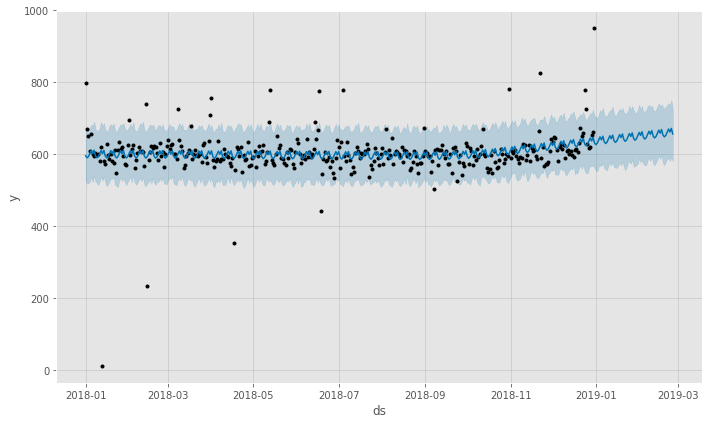

In [23]:
fig1 = m.plot(forecast)

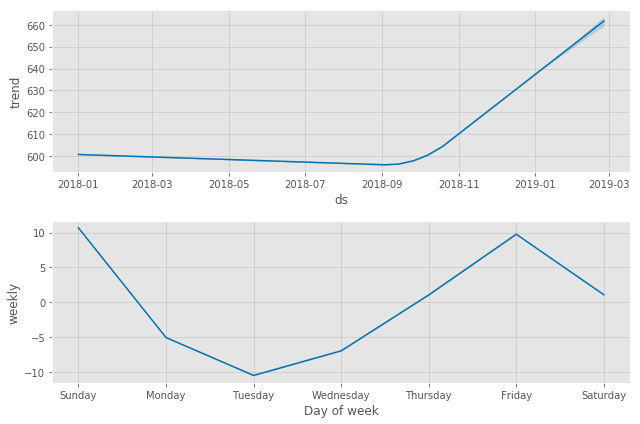

In [24]:
fig2 = m.plot_components(forecast)

In [25]:
# Let's make an interactive graph of this data
py.init_notebook_mode()

fig = plot_plotly(m, forecast)  # This returns a plotly Figure
py.iplot(fig)

#### Now to take the lunar phase dates into account

In [26]:
# Define functions to automate the process of inspecting lunar trends

def get_lunar_phases(year='2018'):
    "Given a year, returns a dataframe of lunar phases, dates, and times (UTC)."
    url = f"https://aa.usno.navy.mil/cgi-bin/aa_phases.pl?year={year}&nump=65&format=t"
    res_page = requests.get(url)
    soup = BeautifulSoup(res_page.content, 'html.parser')
    table_cells = soup.find_all("td")
    output = pd.DataFrame(columns=['phase','date','time'])
    for i in range(len(table_cells)):
        row = np.floor(i/2)
        if i%2 == 0:
            output.at[row,'phase'] = table_cells[i].text
        else:
            output.at[row,'date'] = table_cells[i].text[:12]  #need to grab just beggining of string
            output.at[row,'time'] = table_cells[i].text[-5:]  #need to grab just ending of string
    output.date = pd.to_datetime(output.date)
    output.reset_index(drop=True, inplace=True)
    return output


def lunar_phase_separator(phases_df, lower_window=0, upper_window=1):
    """
    Converts DataFrame of moon phases into FBProphet-friendly format.
    ---------------------
    Inputs:
    phases_df       DataFrame containing lunar phase dates for a given year
                        (the output of the `get_lunar_phases()` function)
    lower_window    (<=0) number of days prior to moon phase to include in 'holiday'
    upper_window    (>=0) number of days after to moon phase to include in 'holiday'
    ---------------------
    Returns:        FBProphet-friendly DataFrame for use in 'holiday' parameter
    """
    # let's separate the different moon phases
    phase_names = ['Full Moon','Last Quarter','New Moon','First Quarter']
    ph_list = []
    for phase in phase_names:
        moons = pd.DataFrame(phases_df.loc[phases_df['phase'] == phase]['date']).reset_index(drop=True)
        moons.columns = ['ds']
        moons['holiday'] = str(phase).lower().replace(" ", "")
        moons['lower_window'] = lower_window
        moons['upper_window'] = upper_window
        ph_list.append(moons)
    phases = pd.concat((ph_list[0], ph_list[1], ph_list[2], ph_list[3]))
    return phases

In [27]:
# create a DataFrame of 2018 lunar phases
phases_2018_df = get_lunar_phases(year='2018')
phases = lunar_phase_separator(phases_2018_df, lower_window=0, upper_window=1)

In [29]:
# again, modeling the 'positive' tweets
m = Prophet(holidays=phases)
forecast = m.fit(grp_pos).predict(future)
forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
          forecast['newmoon'] + forecast['firstquarter']).abs() > 
         0][['ds', 'fullmoon', 'lastquarter', 'newmoon','firstquarter']][:10]

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
1,2018-01-02,6.83402,0.000000,0.000000,0.000000
2,2018-01-03,21.93742,0.000000,0.000000,0.000000
7,2018-01-08,0.00000,25.643439,0.000000,0.000000
8,2018-01-09,0.00000,6.101625,0.000000,0.000000
16,2018-01-17,0.00000,0.000000,6.045544,0.000000
17,2018-01-18,0.00000,0.000000,-18.487607,0.000000
23,2018-01-24,0.00000,0.000000,0.000000,-2.923125
24,2018-01-25,0.00000,0.000000,0.000000,-14.008724
30,2018-01-31,6.83402,0.000000,0.000000,0.000000
31,2018-02-01,21.93742,0.000000,0.000000,0.000000


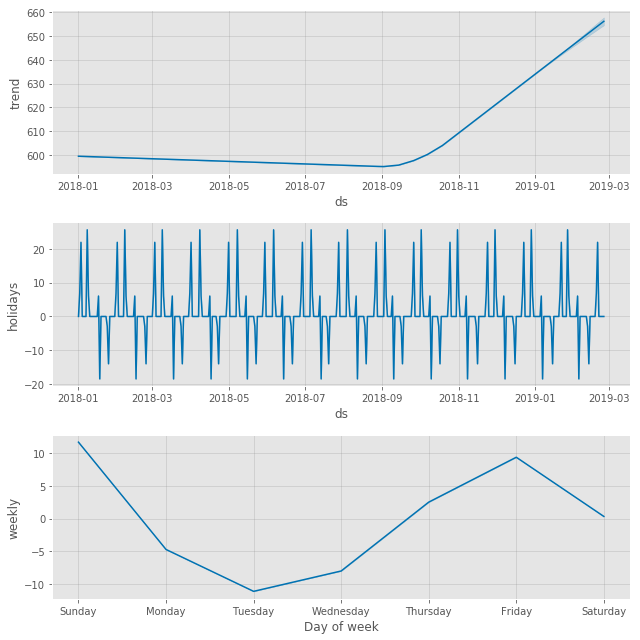

In [30]:
fig = m.plot_components(forecast)

### if you want to just plot only one of the holiday types, run the code below:
# from fbprophet.plot import plot_forecast_component
# plot_forecast_component(m, forecast, 'fullmoon')

**Wow! This is amazing! It sure looks like lunar cycles impact Twitter sentiment, but we should perform some cross validations and look at performance metrics to make sure our eyes aren't deceiving us.**

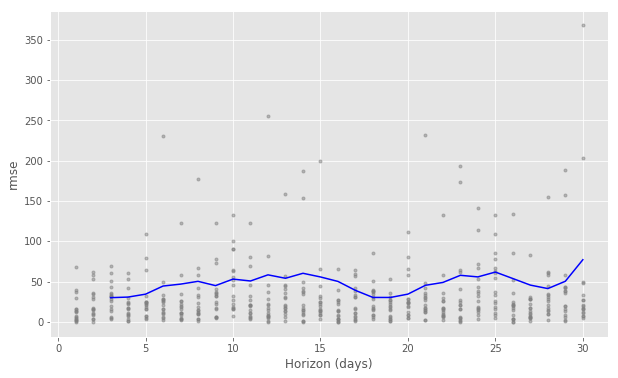

In [44]:
# cross validating using time horizons within the dataset
df_cv = cross_validation(m, initial='90 days', period='15 days', horizon = '30 days')

# performance metrics for the FBProphet model
df_p = performance_metrics(df_cv)
display(df_p.head())

# plotting performance metrics
fig = plot_cross_validation_metric(df_cv, metric='rmse')

The graph imediately above shows that, based on the crossvalidations that were performed, the FBProphet model averages a 5-8% error rate for predictions up to a month into the future.

### It appears that Lunar Cycles have a considerable correlation to Tweet Sentiment shifts!

Looking at the `holidays` graph above, it is apparent that full moon days have the most profound (and positive) correlation on the proportion of tweets that express positive sentiment. Last quarter moons are still positive, new moons have almost no correlation and, surprisingly, first quarter moons actually exhibit a *negative* correlation to positive sentiment!

Let's look at some stock data to see if this trend carries over to financial markets.

fascinating notebook showing how to use FBProphet and multiple regressors (weather conditions, holidays, etc.) to analyze trends: https://nbviewer.jupyter.org/github/nicolasfauchereau/Auckland_Cycling/blob/master/notebooks/Auckland_cycling_and_weather.ipynb

In [84]:
# Define functions to automate the process of inspecting lunar trends
def prep_data_for_FBP(data, column_name):
    """
    Given a DataFrame and the name of the column to be processed, 
    generates a FBProphet-ready DataFrame.
    """
    d = data.reset_index()
    prepped_data = d[['date', column_name]].sort_values(by=['date']).reset_index(drop=True)
    prepped_data.columns = ['ds','y']
    return prepped_data


def cross_val_FBP(model, metric='rmse', show_metric_scores=False):
    # cross validating using time horizons within the dataset
    df_cv = cross_validation(model, initial='90 days', period='15 days', horizon = '30 days')
    # performance metrics for the FBProphet model
    df_p = performance_metrics(df_cv)
    if show_metric_scores == True:
        display(df_p.head())
    # plotting performance metrics
    fig = plot_cross_validation_metric(df_cv, metric)
    pass


def get_weekends(year='2018'):
    weekends_df = pd.DataFrame(columns=['date','day_of_week'])
    weekends_df.date = [date for date in pd.date_range(start=f'1/1/{year}', periods=470)]
    weekends_df.day_of_week = [datetime.datetime(int(str(date)[:4]), 
        int(str(date)[5:7]), int(str(date)[8:10])).weekday() for date in weekends_df.date]
    weekends_df = weekends_df[weekends_df.day_of_week >= 5].reset_index(drop=True)
    return weekends_df


def lunar_stock_trend(df, column_name, phases_df, year='2018', lower_window=0, 
                      upper_window=1, trades_on_weekends=False,
                      cross_val=True, metric='rmse',
                      show_metric_scores=False):
    """
    This function takes in a DataFrame of stock data and the 
    column name for the feature to be examined, a DataFrame of lunar 
    phases for a year, the desired year, and the lower & upper 
    windows for 'holiday' dates.
    
    If the financial data contains values for weekends, set the
    'trades_on_weekends' parameter to 'True'.
    
    Additional option to cross-validate FBProphet model predictions, and
    select from a variety of metrics to use.
    
    ----------------------------------------------------
    
    Returns a list containing the model object, the 'future' dataframe
    used to make predictions, the forecast output DataFrame, a graph
    of the forecast, and a graph of forecast components.
    """
    phases = lunar_phase_separator(phases_df, lower_window, upper_window)
    if trades_on_weekends == False:
        weekends_df = get_weekends(year)
        phases = phases[~phases['ds'].isin(weekends_df.date)]
    data = prep_data_for_FBP(df, column_name)
    m = Prophet(holidays=phases)
    m.fit(data)
    future = m.make_future_dataframe(periods=60, freq='D')
    if trades_on_weekends == False:
        future = future[~future['ds'].isin(weekends_df.date)]
    forecast = m.predict(future)
    disp_length = 4 * (1 + abs(lower_window) + abs(upper_window))
    display(forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
                      forecast['newmoon'] + forecast['firstquarter']).abs() > 
                     0][['ds', 'fullmoon', 'lastquarter', 'newmoon',
                         'firstquarter']][:disp_length])        
    fig1 = m.plot(forecast);
    fig1.set_size_inches(15, 5);
    fig2 = m.plot_components(forecast)
    fig2.set_size_inches(15, 10);
    if cross_val:
        cross_val_FBP(m, metric, show_metric_scores)
        
    return [m, future, forecast, fig1, fig2]

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-01,-0.001112,0.000000,0.000000,0.000000
1,2018-01-02,-0.000852,0.000000,0.000000,0.000000
2,2018-01-03,0.001742,0.000000,0.000000,0.000000
5,2018-01-08,0.000000,-0.001992,0.000000,0.000000
6,2018-01-09,0.000000,-0.000270,0.000000,0.000000
11,2018-01-16,0.000000,0.000000,0.000724,0.000000
12,2018-01-17,0.000000,0.000000,0.000350,0.000000
13,2018-01-18,0.000000,0.000000,-0.003139,0.000000
16,2018-01-23,0.000000,0.000000,0.000000,0.001664
17,2018-01-24,0.000000,0.000000,0.000000,0.000903


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00
INFO:fbprophet:Skipping MAPE because y close to 0


[<fbprophet.forecaster.Prophet at 0x297bdfab390>,             ds
 0   2018-01-01
 1   2018-01-02
 2   2018-01-03
 3   2018-01-04
 4   2018-01-05
 6   2018-01-08
 7   2018-01-09
 8   2018-01-10
 9   2018-01-11
 10  2018-01-12
 12  2018-01-15
 13  2018-01-16
 14  2018-01-17
 15  2018-01-18
 16  2018-01-19
 18  2018-01-22
 19  2018-01-23
 20  2018-01-24
 21  2018-01-25
 22  2018-01-26
 24  2018-01-29
 25  2018-01-30
 26  2018-01-31
 27  2018-02-01
 28  2018-02-02
 30  2018-02-05
 31  2018-02-06
 32  2018-02-07
 33  2018-02-08
 34  2018-02-09
 ..         ...
 334 2019-01-21
 335 2019-01-22
 336 2019-01-23
 337 2019-01-24
 338 2019-01-25
 341 2019-01-28
 342 2019-01-29
 343 2019-01-30
 344 2019-01-31
 345 2019-02-01
 348 2019-02-04
 349 2019-02-05
 350 2019-02-06
 351 2019-02-07
 352 2019-02-08
 355 2019-02-11
 356 2019-02-12
 357 2019-02-13
 358 2019-02-14
 359 2019-02-15
 362 2019-02-18
 363 2019-02-19
 364 2019-02-20
 365 2019-02-21
 366 2019-02-22
 369 2019-02-25
 370 2019-02-26
 371 20

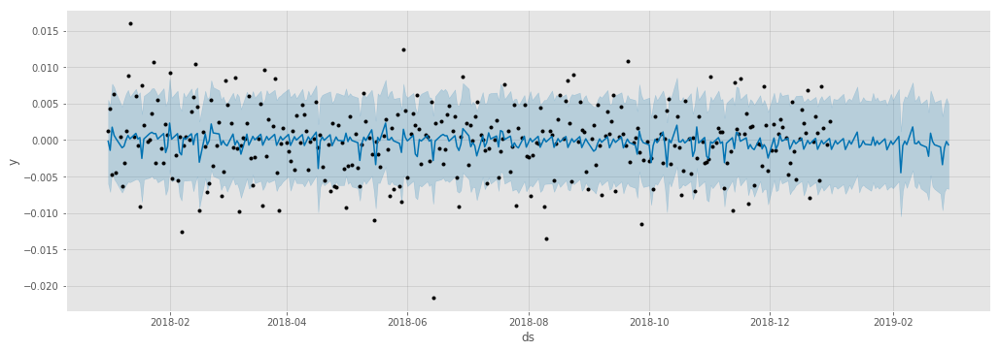

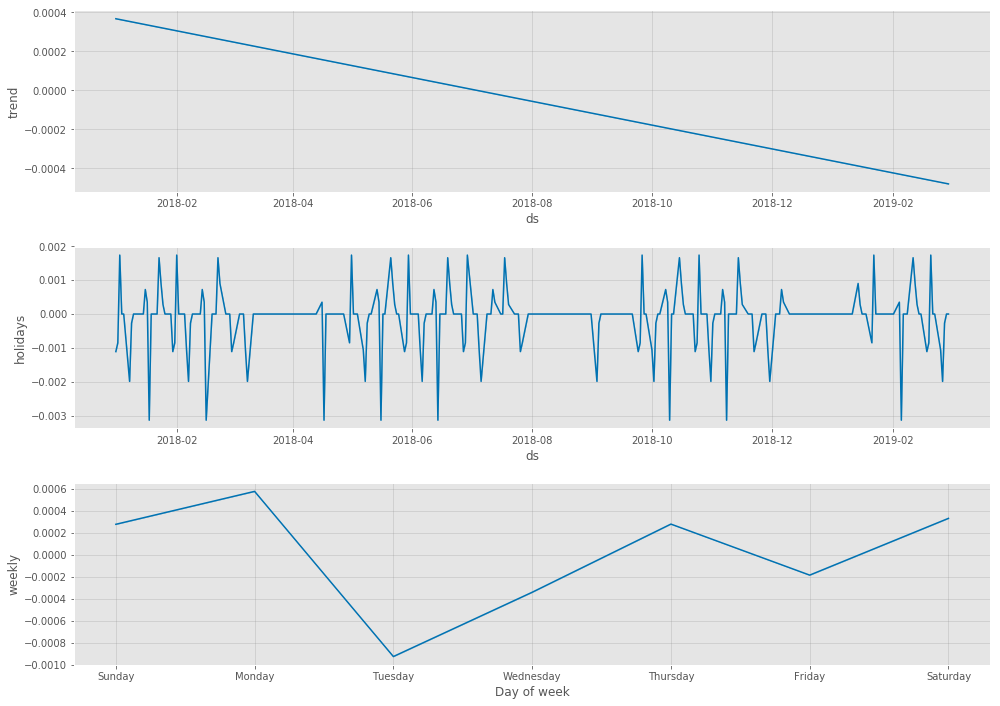

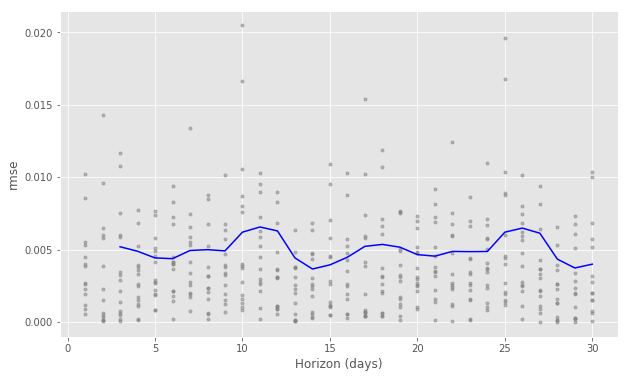

In [33]:
lunar_stock_trend(df=EUR_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-01,-0.001112,0.000000,0.000000,0.000000
1,2018-01-02,-0.000852,0.000000,0.000000,0.000000
2,2018-01-03,0.001742,0.000000,0.000000,0.000000
5,2018-01-08,0.000000,-0.001992,0.000000,0.000000
6,2018-01-09,0.000000,-0.000270,0.000000,0.000000
11,2018-01-16,0.000000,0.000000,0.000724,0.000000
12,2018-01-17,0.000000,0.000000,0.000350,0.000000
13,2018-01-18,0.000000,0.000000,-0.003139,0.000000
16,2018-01-23,0.000000,0.000000,0.000000,0.001664
17,2018-01-24,0.000000,0.000000,0.000000,0.000903


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00
INFO:fbprophet:Skipping MAPE because y close to 0


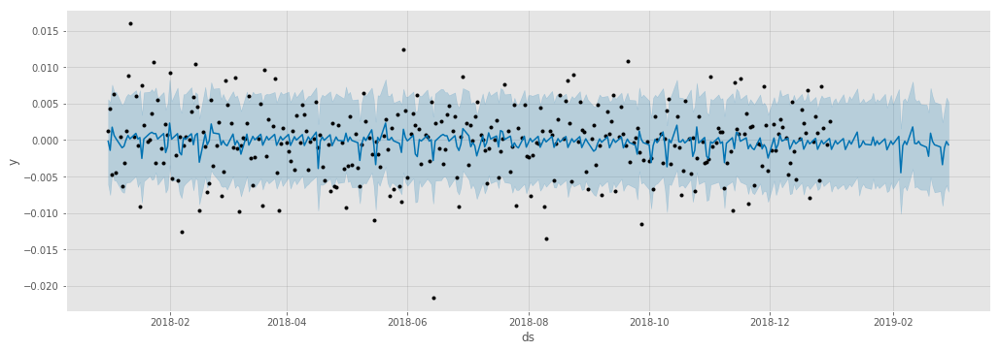

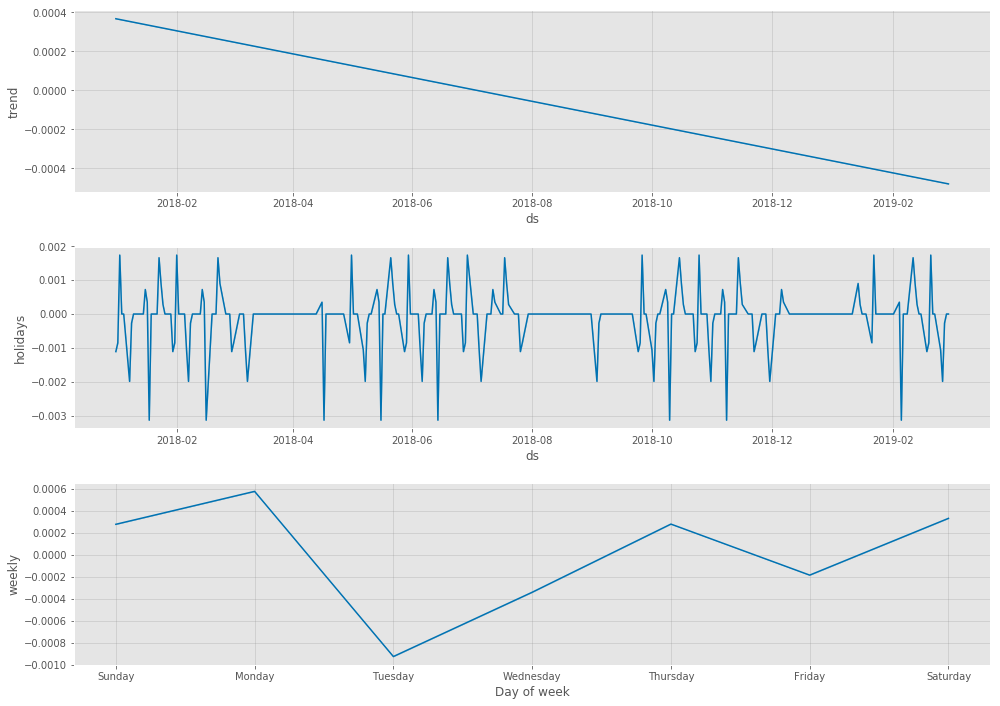

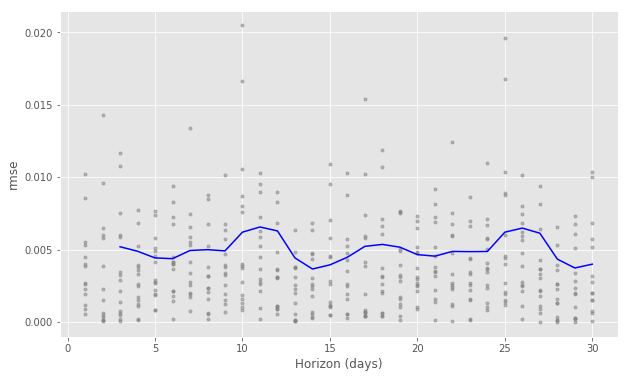

In [34]:
euro_test = lunar_stock_trend(df=EUR_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

In [35]:
fork = euro_test[2]
fork[(fork['fullmoon'] + fork['lastquarter'] + 
      fork['newmoon'] + fork['firstquarter']).abs() > 
     0][['ds', 'fullmoon', 'lastquarter', 'newmoon', 'firstquarter']][:30]

,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-01,-0.001112,0.000000,0.000000,0.000000
1,2018-01-02,-0.000852,0.000000,0.000000,0.000000
2,2018-01-03,0.001742,0.000000,0.000000,0.000000
5,2018-01-08,0.000000,-0.001992,0.000000,0.000000
6,2018-01-09,0.000000,-0.000270,0.000000,0.000000
11,2018-01-16,0.000000,0.000000,0.000724,0.000000
12,2018-01-17,0.000000,0.000000,0.000350,0.000000
13,2018-01-18,0.000000,0.000000,-0.003139,0.000000
16,2018-01-23,0.000000,0.000000,0.000000,0.001664
17,2018-01-24,0.000000,0.000000,0.000000,0.000903


**Wow! Financial markets are also exhibiting lunar cycle influences!** However, in the case of the Euro, it seems the impact is pretty small. Nevertheless, there is a distinct pattern correlating to the four lunar phases. Surprisingly, the *new moon* appears to be the most influential, with influence decreasing throughout the rest of the lunar cycle.

We need to dig in a bit deeper, but the graph of the Euro-USDollar exchange market pretty clearly exhibits responses to lunar cycles. Keep in mind that physical currencies are only traded 6 days a week (approximately), stocks are traded 5 days a week, and digital currencies are traded 24/7/365. 

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-01,-143.410663,0.000000,0.000000,0.000000
1,2018-01-02,131.842945,0.000000,0.000000,0.000000
2,2018-01-03,-51.565888,0.000000,0.000000,0.000000
6,2018-01-07,0.000000,-23.490396,0.000000,0.000000
7,2018-01-08,0.000000,-184.168789,0.000000,0.000000
8,2018-01-09,0.000000,-12.658068,0.000000,0.000000
15,2018-01-16,0.000000,0.000000,-210.323993,0.000000
16,2018-01-17,0.000000,0.000000,-42.432272,0.000000
17,2018-01-18,0.000000,0.000000,64.374361,0.000000
22,2018-01-23,0.000000,0.000000,0.000000,-35.048626


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


[<fbprophet.forecaster.Prophet at 0x297c057af28>,             ds
 0   2018-01-01
 1   2018-01-02
 2   2018-01-03
 3   2018-01-04
 4   2018-01-05
 5   2018-01-06
 6   2018-01-07
 7   2018-01-08
 8   2018-01-09
 9   2018-01-10
 10  2018-01-11
 11  2018-01-12
 12  2018-01-13
 13  2018-01-14
 14  2018-01-15
 15  2018-01-16
 16  2018-01-17
 17  2018-01-18
 18  2018-01-19
 19  2018-01-20
 20  2018-01-21
 21  2018-01-22
 22  2018-01-23
 23  2018-01-24
 24  2018-01-25
 25  2018-01-26
 26  2018-01-27
 27  2018-01-28
 28  2018-01-29
 29  2018-01-30
 ..         ...
 395 2019-01-31
 396 2019-02-01
 397 2019-02-02
 398 2019-02-03
 399 2019-02-04
 400 2019-02-05
 401 2019-02-06
 402 2019-02-07
 403 2019-02-08
 404 2019-02-09
 405 2019-02-10
 406 2019-02-11
 407 2019-02-12
 408 2019-02-13
 409 2019-02-14
 410 2019-02-15
 411 2019-02-16
 412 2019-02-17
 413 2019-02-18
 414 2019-02-19
 415 2019-02-20
 416 2019-02-21
 417 2019-02-22
 418 2019-02-23
 419 2019-02-24
 420 2019-02-25
 421 2019-02-26
 422 20

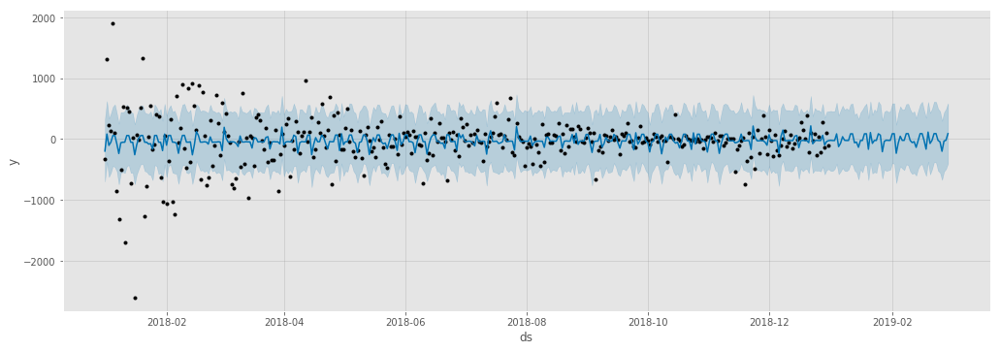

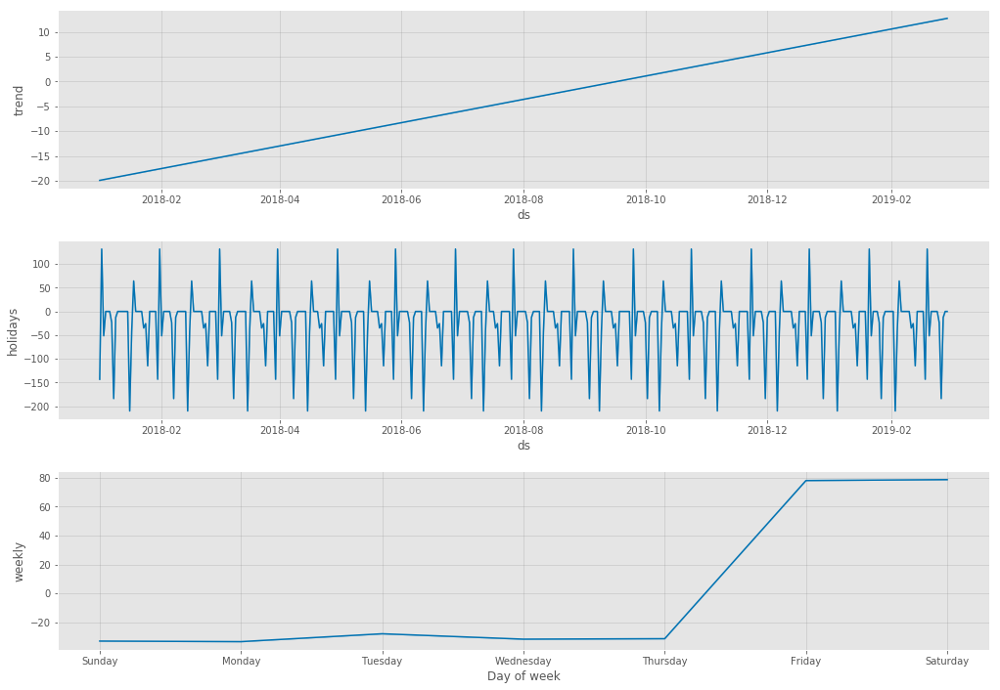

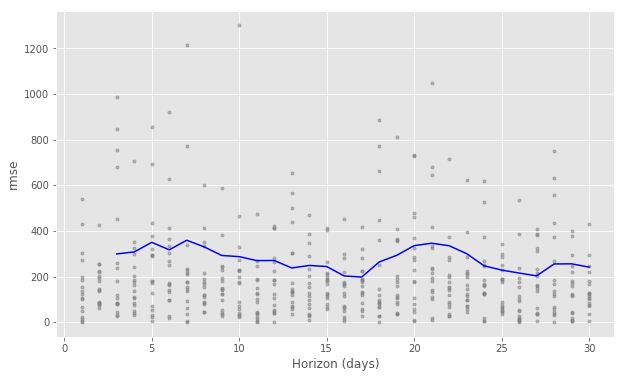

In [41]:
lunar_stock_trend(df=BTC_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=True,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-02,-7.390925,0.000000,0.000000,0.000000
1,2018-01-03,0.359953,0.000000,0.000000,0.000000
4,2018-01-08,0.000000,22.417129,0.000000,0.000000
5,2018-01-09,0.000000,-8.939341,0.000000,0.000000
9,2018-01-16,0.000000,0.000000,17.453645,0.000000
10,2018-01-17,0.000000,0.000000,1.670558,0.000000
11,2018-01-18,0.000000,0.000000,-14.308549,0.000000
14,2018-01-23,0.000000,0.000000,0.000000,0.818174
15,2018-01-24,0.000000,0.000000,0.000000,11.886779
16,2018-01-25,0.000000,0.000000,0.000000,1.489779


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


[<fbprophet.forecaster.Prophet at 0x297c08b32e8>,             ds
 0   2018-01-02
 1   2018-01-03
 2   2018-01-04
 3   2018-01-05
 4   2018-01-08
 5   2018-01-09
 6   2018-01-10
 7   2018-01-11
 8   2018-01-12
 9   2018-01-16
 10  2018-01-17
 11  2018-01-18
 12  2018-01-19
 13  2018-01-22
 14  2018-01-23
 15  2018-01-24
 16  2018-01-25
 17  2018-01-26
 18  2018-01-29
 19  2018-01-30
 20  2018-01-31
 21  2018-02-01
 22  2018-02-02
 23  2018-02-05
 24  2018-02-06
 25  2018-02-07
 26  2018-02-08
 27  2018-02-09
 28  2018-02-12
 29  2018-02-13
 ..         ...
 271 2019-01-21
 272 2019-01-22
 273 2019-01-23
 274 2019-01-24
 275 2019-01-25
 278 2019-01-28
 279 2019-01-29
 280 2019-01-30
 281 2019-01-31
 282 2019-02-01
 285 2019-02-04
 286 2019-02-05
 287 2019-02-06
 288 2019-02-07
 289 2019-02-08
 292 2019-02-11
 293 2019-02-12
 294 2019-02-13
 295 2019-02-14
 296 2019-02-15
 299 2019-02-18
 300 2019-02-19
 301 2019-02-20
 302 2019-02-21
 303 2019-02-22
 306 2019-02-25
 307 2019-02-26
 308 20

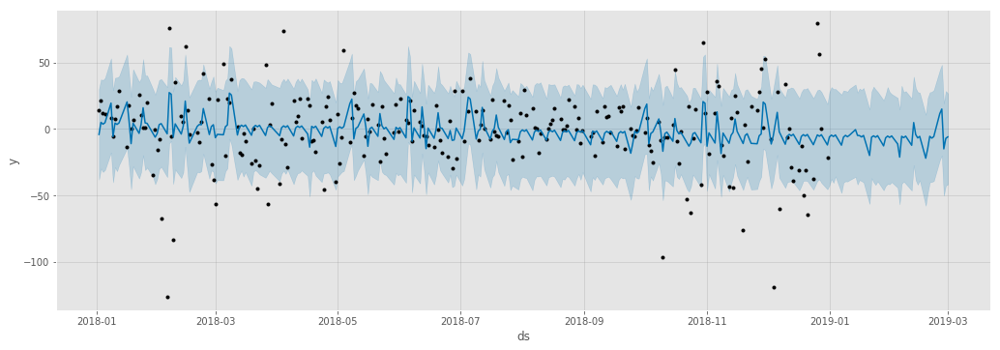

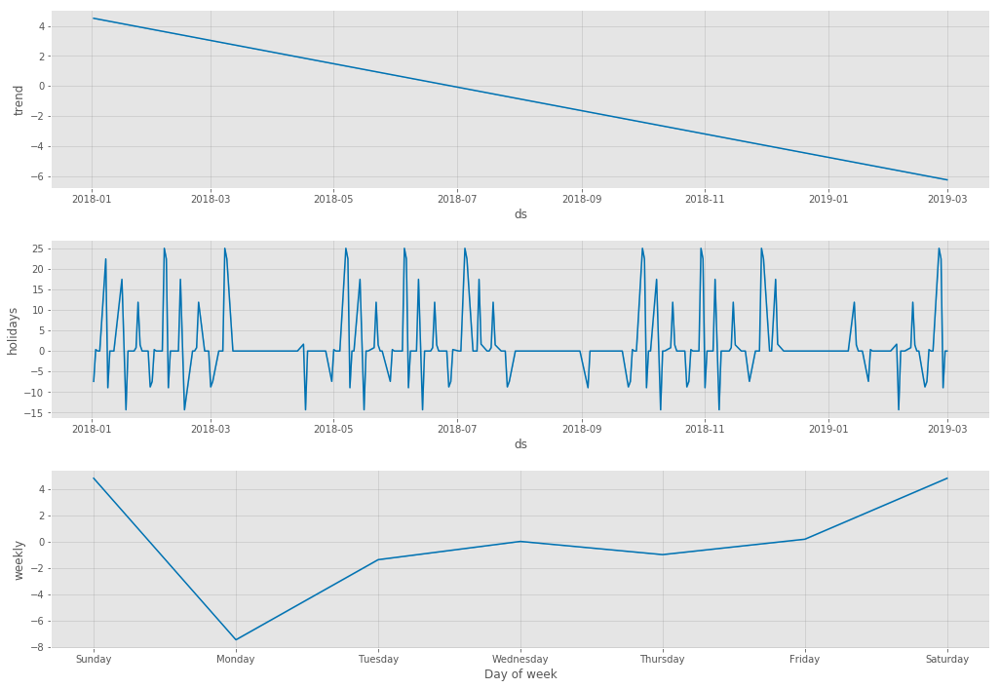

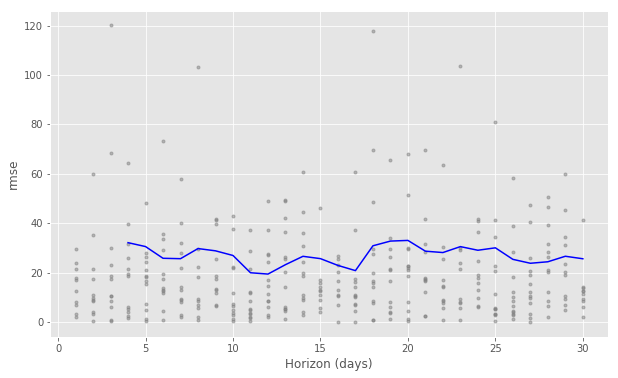

In [42]:
lunar_stock_trend(df=SP500_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-02,-0.311002,0.000000,0.000000,0.000000
1,2018-01-03,-0.048919,0.000000,0.000000,0.000000
4,2018-01-08,0.000000,0.776920,0.000000,0.000000
5,2018-01-09,0.000000,-0.845517,0.000000,0.000000
9,2018-01-16,0.000000,0.000000,0.862165,0.000000
10,2018-01-17,0.000000,0.000000,0.281802,0.000000
11,2018-01-18,0.000000,0.000000,-1.051394,0.000000
14,2018-01-23,0.000000,0.000000,0.000000,-0.005671
15,2018-01-24,0.000000,0.000000,0.000000,1.003441
16,2018-01-25,0.000000,0.000000,0.000000,-0.216457


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


[<fbprophet.forecaster.Prophet at 0x297be7e4ba8>,             ds
 0   2018-01-02
 1   2018-01-03
 2   2018-01-04
 3   2018-01-05
 4   2018-01-08
 5   2018-01-09
 6   2018-01-10
 7   2018-01-11
 8   2018-01-12
 9   2018-01-16
 10  2018-01-17
 11  2018-01-18
 12  2018-01-19
 13  2018-01-22
 14  2018-01-23
 15  2018-01-24
 16  2018-01-25
 17  2018-01-26
 18  2018-01-29
 19  2018-01-30
 20  2018-01-31
 21  2018-02-01
 22  2018-02-02
 23  2018-02-05
 24  2018-02-06
 25  2018-02-07
 26  2018-02-08
 27  2018-02-09
 28  2018-02-12
 29  2018-02-13
 ..         ...
 271 2019-01-21
 272 2019-01-22
 273 2019-01-23
 274 2019-01-24
 275 2019-01-25
 278 2019-01-28
 279 2019-01-29
 280 2019-01-30
 281 2019-01-31
 282 2019-02-01
 285 2019-02-04
 286 2019-02-05
 287 2019-02-06
 288 2019-02-07
 289 2019-02-08
 292 2019-02-11
 293 2019-02-12
 294 2019-02-13
 295 2019-02-14
 296 2019-02-15
 299 2019-02-18
 300 2019-02-19
 301 2019-02-20
 302 2019-02-21
 303 2019-02-22
 306 2019-02-25
 307 2019-02-26
 308 20

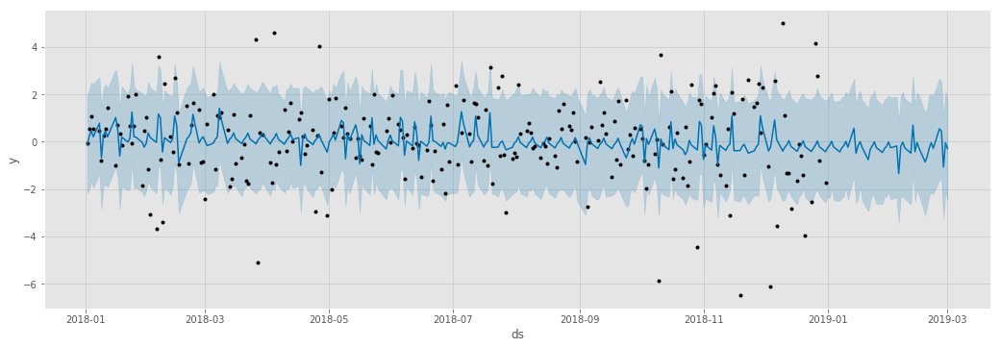

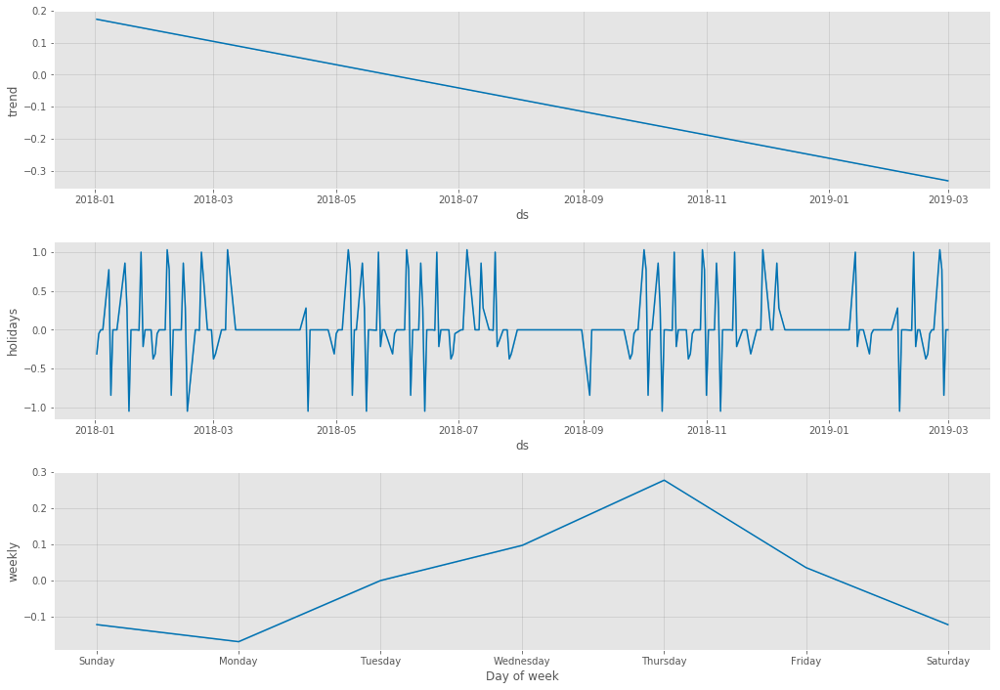

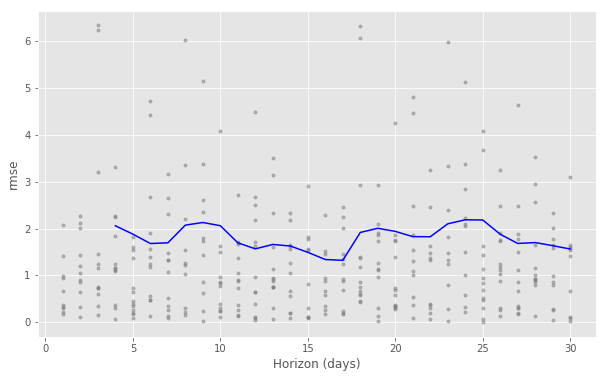

In [43]:
lunar_stock_trend(df=MSFT_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

**Well, after looking at a stock, a market index, a physical currency, and a cryptocurrency, it seems pretty apparent that there is some sort of lunar-phase-seasonality correlation in financial markets of all sorts.** While it may be a relatively small influence in all cases, the regularity in occurence and uniformity in influence strongly suggests that lunar cycles may have a real and quantifiable influence on human behavior (whether in tweets or financial decisions).

200
Request Successful


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


,ds,fullmoon,lastquarter,newmoon,firstquarter
0,2018-01-02,0.302098,0.000000,0.000000,0.000000
1,2018-01-03,-0.622065,0.000000,0.000000,0.000000
4,2018-01-08,0.000000,0.385556,0.000000,0.000000
5,2018-01-09,0.000000,-0.450238,0.000000,0.000000
9,2018-01-16,0.000000,0.000000,1.496809,0.000000
10,2018-01-17,0.000000,0.000000,-0.054908,0.000000
11,2018-01-18,0.000000,0.000000,0.325696,0.000000
14,2018-01-23,0.000000,0.000000,0.000000,0.735116
15,2018-01-24,0.000000,0.000000,0.000000,-0.034799
16,2018-01-25,0.000000,0.000000,0.000000,0.779942


INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00
INFO:fbprophet:Skipping MAPE because y close to 0


[<fbprophet.forecaster.Prophet at 0x297c1b66550>,             ds
 0   2018-01-02
 1   2018-01-03
 2   2018-01-04
 3   2018-01-05
 4   2018-01-08
 5   2018-01-09
 6   2018-01-10
 7   2018-01-11
 8   2018-01-12
 9   2018-01-16
 10  2018-01-17
 11  2018-01-18
 12  2018-01-19
 13  2018-01-22
 14  2018-01-23
 15  2018-01-24
 16  2018-01-25
 17  2018-01-26
 18  2018-01-29
 19  2018-01-30
 20  2018-01-31
 21  2018-02-01
 22  2018-02-02
 23  2018-02-05
 24  2018-02-06
 25  2018-02-07
 26  2018-02-08
 27  2018-02-09
 28  2018-02-12
 29  2018-02-13
 ..         ...
 271 2019-01-21
 272 2019-01-22
 273 2019-01-23
 274 2019-01-24
 275 2019-01-25
 278 2019-01-28
 279 2019-01-29
 280 2019-01-30
 281 2019-01-31
 282 2019-02-01
 285 2019-02-04
 286 2019-02-05
 287 2019-02-06
 288 2019-02-07
 289 2019-02-08
 292 2019-02-11
 293 2019-02-12
 294 2019-02-13
 295 2019-02-14
 296 2019-02-15
 299 2019-02-18
 300 2019-02-19
 301 2019-02-20
 302 2019-02-21
 303 2019-02-22
 306 2019-02-25
 307 2019-02-26
 308 20

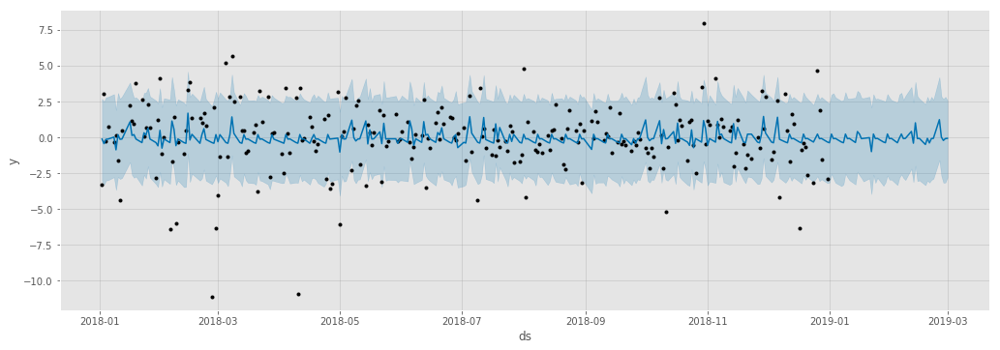

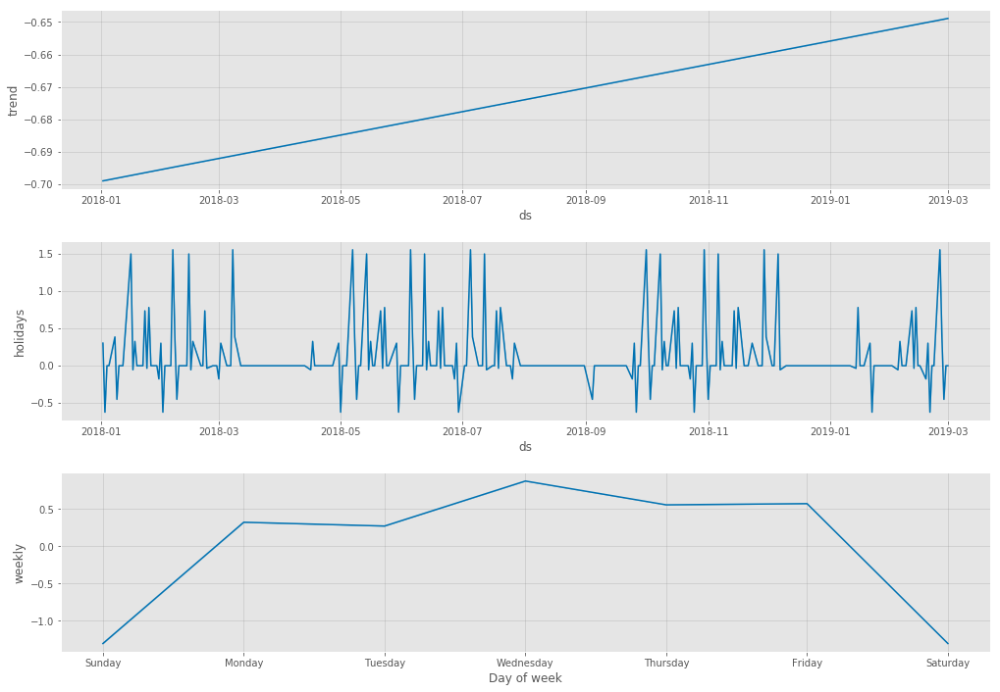

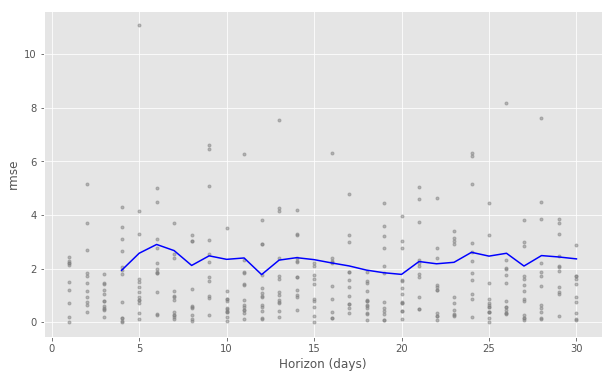

In [50]:
# Finally, let's look at a stock known for its low-volatility
SBAC_2018 = get_financial_data('SBAC', 'stock', 
                               stocks_API_key, year=2018, 
                               verbose=False)

lunar_stock_trend(df=SBAC_2018,
                  column_name='change_24',
                  phases_df=phases_2018_df,
                  year='2018',
                  lower_window=-1,
                  upper_window=1,
                  trades_on_weekends=False,
                  cross_val=True,
                  metric='rmse', 
                  show_metric_scores=False)

# 5. Interpretation

One thing to keep in mind about moon phases is that while scientifically a full moon lasts only an instant, visually it seems to last about three days. This **observational** period of 2-3 days for each moon phase is what I have endeavored to examine in my analysis, as it seems logical that only the perception of a moon phase would affect behavior (or at least correlate to it), not the scientific instant of occurence. 

Generally speaking, it seems that currency exchange rates (e.g. Euro-to-USD exchange) experience positive value spikes on full moons and negative spikes during new moons, while stocks respond in an inverse manner. 

Oddly, it seems that most of the stocks/currencies examined display a particular seasonality behavior for the first half of a moon phase, but then a correction or even a sharp over-correction on the final day of the phase. For instance, the S&P 500 Index (a widely accepted barometer for the U.S. stock market) generally rises by 17.45 USD at the beginning of a new moon, but then generally falls 14.31 USD at the end of the new moon. 




# 6. Bonus Round: NLP Visualizations!

# 1. code for a way to remove outliers automatically

# 2. scrape financial data from a list of stock symbols???

be sure to account for whether it's a stock, a currency, or a cryptocurrency

also, i need to make sure I don't make more than 5 calls per minute (API cap)

# 3. for twitter sentiment, I need to add some nlp visualizations. 

What are people saying on full moons? new moons? etc? That is a great area to investigate and practice nlp techniques to extract meaning

   - check this site for ideas: https://towardsdatascience.com/a-complete-exploratory-data-analysis-and-visualization-for-text-data-29fb1b96fb6a
   - and this one: https://github.com/JasonKessler/scattertext
   - word clouds: https://itnext.io/basics-of-text-analysis-visualization-1978de48af47
   - state of the industry article: https://doc.lagout.org/Others/Data%20Mining/Text%20Mining%20and%20Visualization_%20Case%20Studies%20using%20Open-Source%20Tools%20%5BHofmann%20%26%20Chisholm%202015-12-18%5D.pdf
   
   

# 4. for FBProphet, since RMSE is higher than the seasonality effects...

...should I look at the other way of coding for holidays (using the `.add_regressor()` method)?

see: https://facebook.github.io/prophet/docs/seasonality,_holiday_effects,_and_regressors.html

In [89]:
tweet_csv_files = ['tweets_lovehatewords_2018.csv',
                   'tweets_happysad_2018.csv',
                   'tweets_musicwords_2018.csv',
                   'tweets_moneywords_2018.csv',
                   'tweets_nowords_2018.csv',
                   'tweets_politicwords_2018.csv']

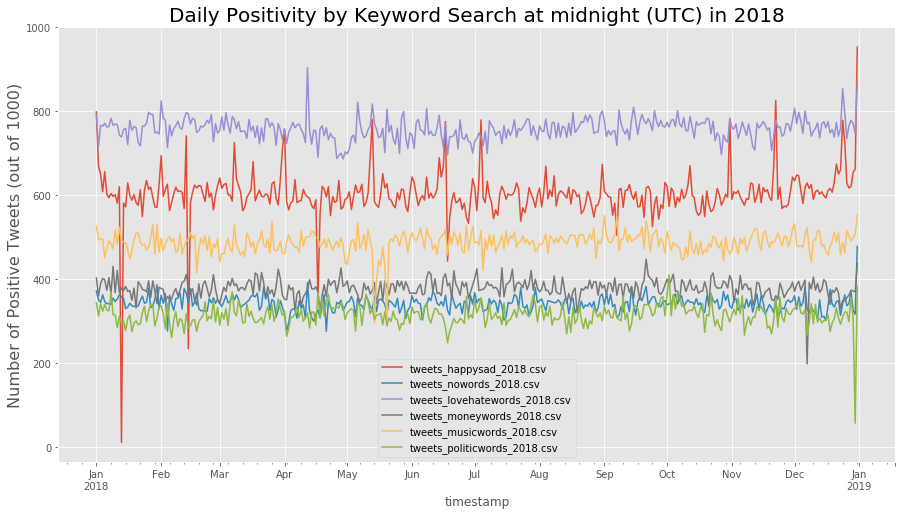

In [67]:
# Exploring daily positivity rates by query phrase
for search in tweet_csv_files:
    plot_sentiments(search, 2018, positive_only=True)

In [ ]:
#     #prepare grouped sentiment data for FBProphet processing
#     grp_pos = grouped[grouped.sentiment == 'positive'].drop('sentiment', axis=1).reset_index(drop=True)
#     grp_pos.columns = ['ds','y']
#     display(grp_pos.head())

#     m = Prophet(holidays=phases)
#     forecast = m.fit(grp_pos).predict(future)
#     forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
#               forecast['newmoon'] + forecast['firstquarter']).abs() > 
#              0][['ds', 'fullmoon', 'lastquarter', 'newmoon','firstquarter']][:10]
#     fig = m.plot_components(forecast)

#     # cross validating using time horizons within the dataset
#     df_cv = cross_validation(m, initial='90 days', period='15 days', horizon = '30 days')

#     # performance metrics for the FBProphet model
#     df_p = performance_metrics(df_cv)
#     display(df_p.head())

#     # plotting performance metrics
#     fig = plot_cross_validation_metric(df_cv, metric='rmse')

In [87]:
def tweet_fbprophet(filename):
    print(filename)
    tweets_df = pd.read_csv(filename)
    tweets_df.timestamp = pd.to_datetime(tw_df.timestamp, format='%Y%m%d')
    grouped = pd.DataFrame(tweets_df.groupby(['timestamp', 'sentiment'])['tally'].sum()).reset_index()

    #prepare grouped sentiment data for FBProphet processing
    #here, positive sentiment only
    grp_pos = grouped[grouped.sentiment == 'positive'].drop('sentiment', axis=1).reset_index(drop=True)
    grp_pos.columns = ['ds','y']

    m = Prophet(holidays=phases)
    forecast = m.fit(grp_pos).predict(future)
    forecast[(forecast['fullmoon'] + forecast['lastquarter'] + 
              forecast['newmoon'] + forecast['firstquarter']).abs() > 
             0][['ds', 'fullmoon', 'lastquarter', 'newmoon','firstquarter']][:10]
    fig1 = m.plot(forecast);
    fig1.set_size_inches(15, 5);
    fig2 = m.plot_components(forecast)
    fig2.set_size_inches(15, 10);
    
    # cross validating using time horizons within the dataset
    df_cv = cross_validation(m, initial='90 days', period='15 days', horizon = '30 days')
#     # performance metrics for the FBProphet model
#     df_p = performance_metrics(df_cv)
#     display(df_p.head())

    # plotting performance metrics
    fig3 = plot_cross_validation_metric(df_cv, metric='rmse')

tweets_happysad_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_nowords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_lovehatewords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_moneywords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_musicwords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


tweets_politicwords_2018.csv


INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:fbprophet:Making 17 forecasts with cutoffs between 2018-04-05 00:00:00 and 2018-12-01 00:00:00


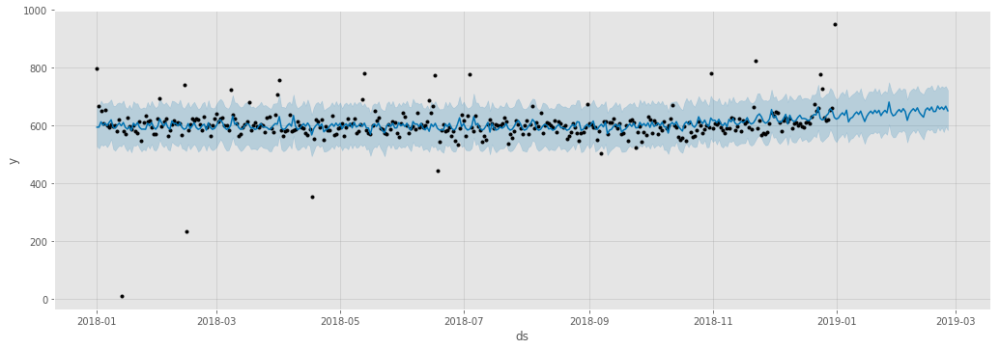

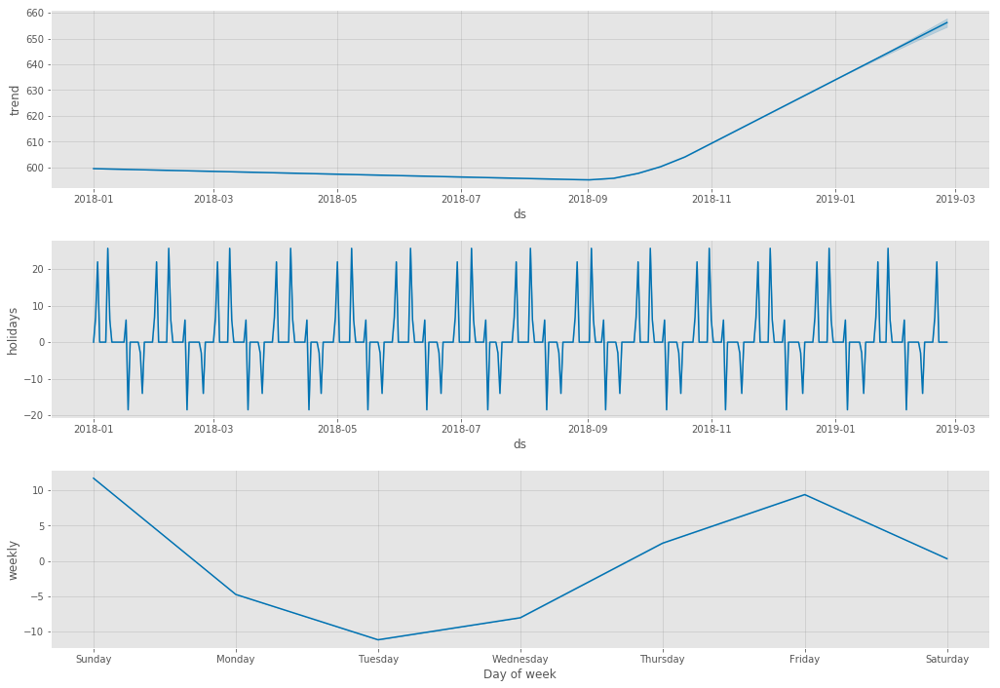

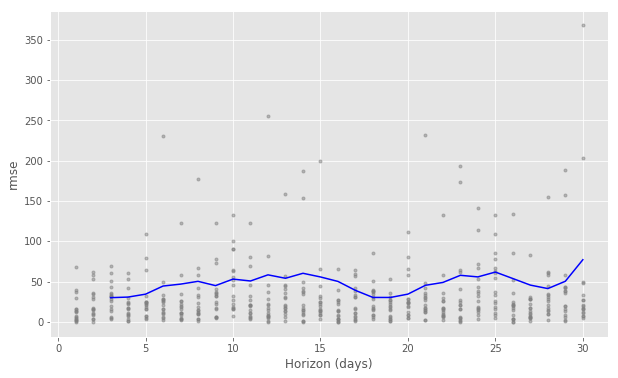

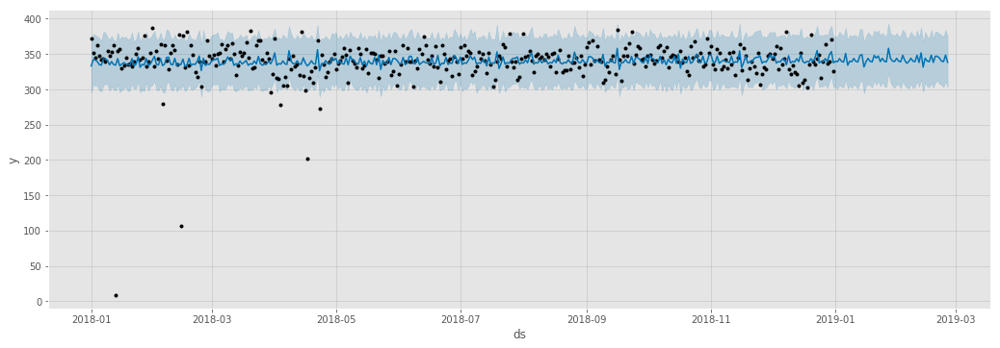

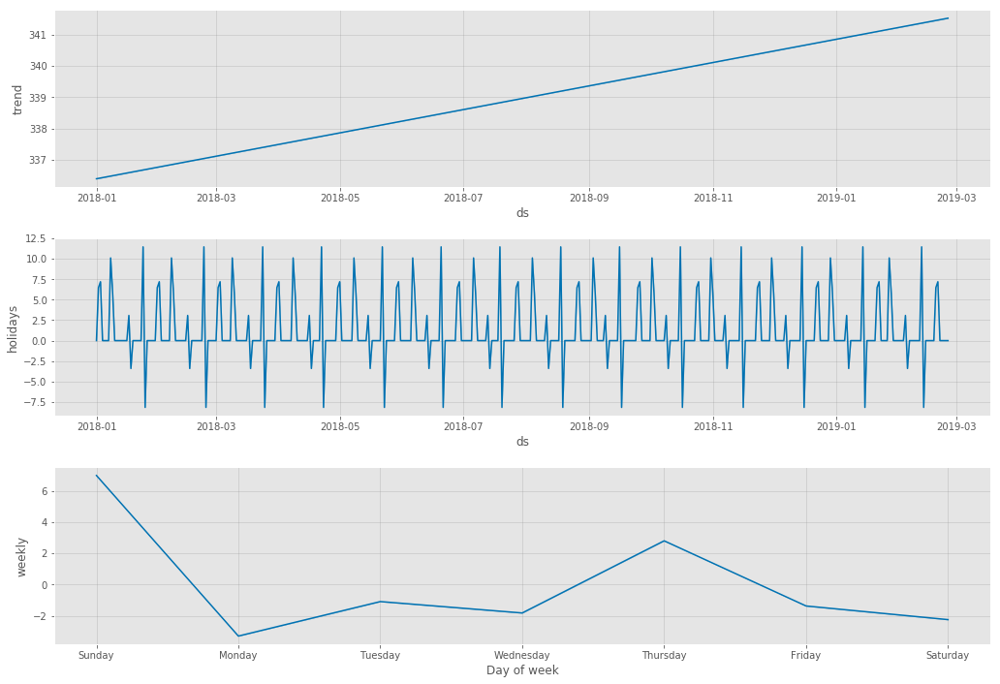

...

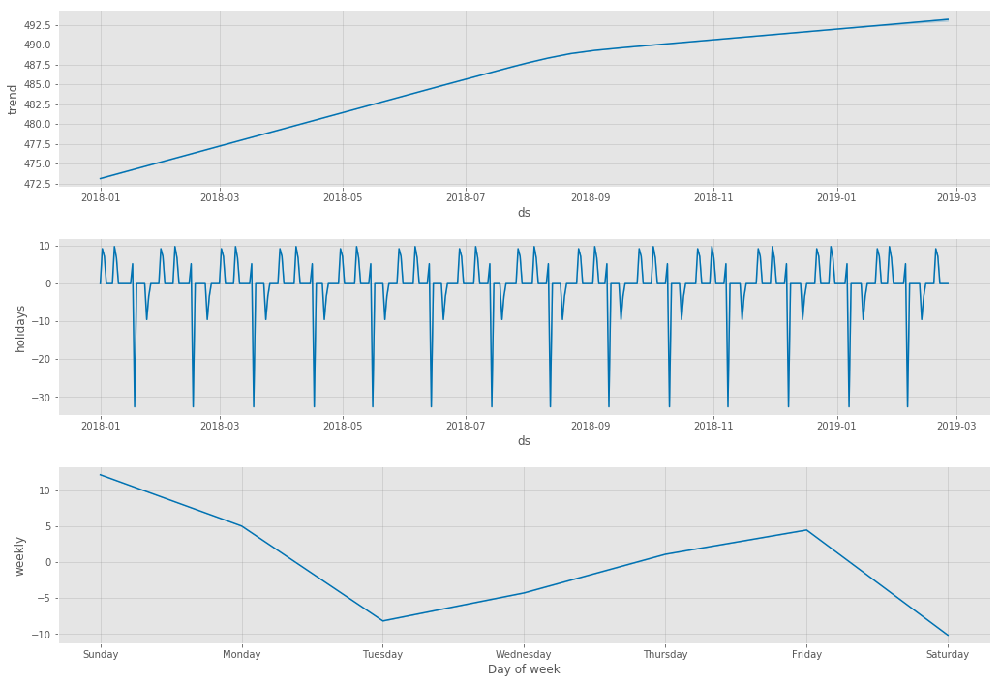

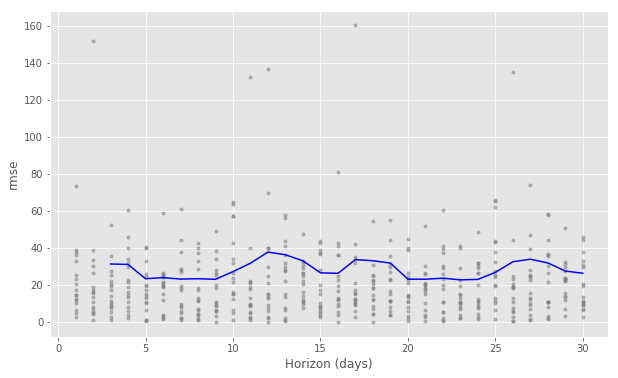

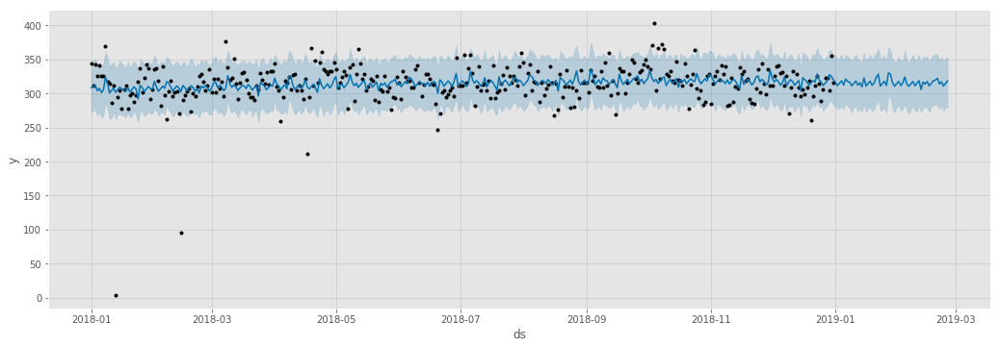

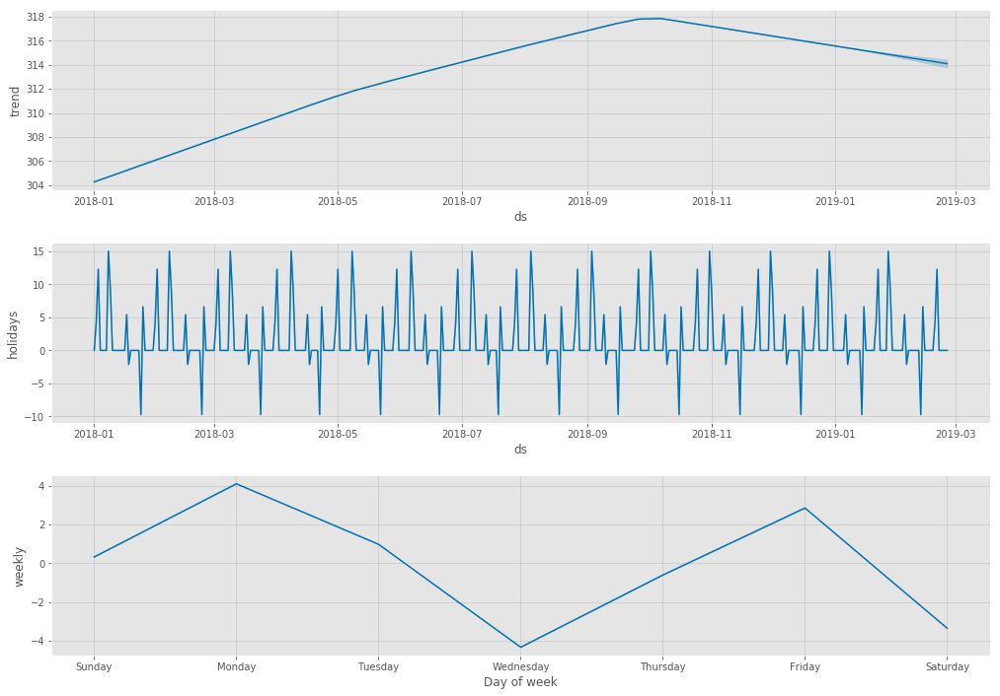

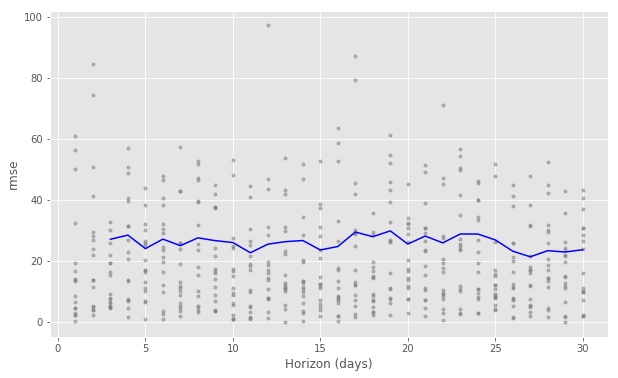

In [88]:
# Running each CSV file through FBPophet

for search in tweet_csv_files:
    tweet_fbprophet(search)

In [94]:
filename = 'tweets_lovehatewords_2018.csv'

In [217]:
# reads in the CSV file as a DataFrame
df = pd.read_csv(filename)
df.timestamp = pd.to_datetime(df.timestamp, format='%Y%m%d')  
comment_words = ' '

In [291]:
# define our list of stop words
stopwords = set(ENGLISH_STOP_WORDS)
# now add extra things to that list that we want to filter out
stopwords.update(['twitter','com','pic','ve','ll','just',
                  'like','don','really','00'])

## WARNING!!!

For over 365,000 lines of text, the code block below can take ***12+ hours*** to execute!!!

In [98]:
# comment out the next line if you wish to run the rest of the code below
break

# iterate through the csv file 
it=0
for val in df.text: 
    val = str(val)          # typecaste each val to string 
    tokens = val.split()    # split the value 
    
    # Convert each token into lowercase 
    for i in range(len(tokens)): 
        tokens[i] = tokens[i].lower() 
    
    for words in tokens: 
        comment_words = comment_words + words + ' '
    it+=1
    print(f"Completed {it} loops")

Completed 1 loops
Completed 2 loops
Completed 3 loops
Completed 4 loops
Completed 5 loops
Completed 6 loops
Completed 7 loops
Completed 8 loops
Completed 9 loops
Completed 10 loops
Completed 11 loops
Completed 12 loops
Completed 13 loops
Completed 14 loops
Completed 15 loops
Completed 16 loops
Completed 17 loops
Completed 18 loops
Completed 19 loops
Completed 20 loops
Completed 21 loops
Completed 22 loops
Completed 23 loops
Completed 24 loops
Completed 25 loops
Completed 26 loops
Completed 27 loops
Completed 28 loops
Completed 29 loops
Completed 30 loops
Completed 31 loops
Completed 32 loops
Completed 33 loops
Completed 34 loops
Completed 35 loops
Completed 36 loops
Completed 37 loops
Completed 38 loops
Completed 39 loops
Completed 40 loops
Completed 41 loops
Completed 42 loops
Completed 43 loops
Completed 44 loops
Completed 45 loops
Completed 46 loops
Completed 47 loops
Completed 48 loops
Completed 49 loops
Completed 50 loops
Completed 51 loops
Completed 52 loops
Completed 53 loops
Co

Completed 419 loops
Completed 420 loops
Completed 421 loops
Completed 422 loops
Completed 423 loops
Completed 424 loops
Completed 425 loops
Completed 426 loops
Completed 427 loops
Completed 428 loops
Completed 429 loops
Completed 430 loops
Completed 431 loops
Completed 432 loops
Completed 433 loops
Completed 434 loops
Completed 435 loops
Completed 436 loops
Completed 437 loops
Completed 438 loops
Completed 439 loops
Completed 440 loops
Completed 441 loops
Completed 442 loops
Completed 443 loops
Completed 444 loops
Completed 445 loops
Completed 446 loops
Completed 447 loops
Completed 448 loops
Completed 449 loops
Completed 450 loops
Completed 451 loops
Completed 452 loops
Completed 453 loops
Completed 454 loops
Completed 455 loops
Completed 456 loops
Completed 457 loops
Completed 458 loops
Completed 459 loops
Completed 460 loops
Completed 461 loops
Completed 462 loops
Completed 463 loops
Completed 464 loops
Completed 465 loops
Completed 466 loops
Completed 467 loops
Completed 468 loops


Completed 843 loops
Completed 844 loops
Completed 845 loops
Completed 846 loops
Completed 847 loops
Completed 848 loops
Completed 849 loops
Completed 850 loops
Completed 851 loops
Completed 852 loops
Completed 853 loops
Completed 854 loops
Completed 855 loops
Completed 856 loops
Completed 857 loops
Completed 858 loops
Completed 859 loops
Completed 860 loops
Completed 861 loops
Completed 862 loops
Completed 863 loops
Completed 864 loops
Completed 865 loops
Completed 866 loops
Completed 867 loops
Completed 868 loops
Completed 869 loops
Completed 870 loops
Completed 871 loops
Completed 872 loops
Completed 873 loops
Completed 874 loops
Completed 875 loops
Completed 876 loops
Completed 877 loops
Completed 878 loops
Completed 879 loops
Completed 880 loops
Completed 881 loops
Completed 882 loops
Completed 883 loops
Completed 884 loops
Completed 885 loops
Completed 886 loops
Completed 887 loops
Completed 888 loops
Completed 889 loops
Completed 890 loops
Completed 891 loops
Completed 892 loops


Completed 1258 loops
Completed 1259 loops
Completed 1260 loops
Completed 1261 loops
Completed 1262 loops
Completed 1263 loops
Completed 1264 loops
Completed 1265 loops
Completed 1266 loops
Completed 1267 loops
Completed 1268 loops
Completed 1269 loops
Completed 1270 loops
Completed 1271 loops
Completed 1272 loops
Completed 1273 loops
Completed 1274 loops
Completed 1275 loops
Completed 1276 loops
Completed 1277 loops
Completed 1278 loops
Completed 1279 loops
Completed 1280 loops
Completed 1281 loops
Completed 1282 loops
Completed 1283 loops
Completed 1284 loops
Completed 1285 loops
Completed 1286 loops
Completed 1287 loops
Completed 1288 loops
Completed 1289 loops
Completed 1290 loops
Completed 1291 loops
Completed 1292 loops
Completed 1293 loops
Completed 1294 loops
Completed 1295 loops
Completed 1296 loops
Completed 1297 loops
Completed 1298 loops
Completed 1299 loops
Completed 1300 loops
Completed 1301 loops
Completed 1302 loops
Completed 1303 loops
Completed 1304 loops
Completed 130

Completed 1650 loops
Completed 1651 loops
Completed 1652 loops
Completed 1653 loops
Completed 1654 loops
Completed 1655 loops
Completed 1656 loops
Completed 1657 loops
Completed 1658 loops
Completed 1659 loops
Completed 1660 loops
Completed 1661 loops
Completed 1662 loops
Completed 1663 loops
Completed 1664 loops
Completed 1665 loops
Completed 1666 loops
Completed 1667 loops
Completed 1668 loops
Completed 1669 loops
Completed 1670 loops
Completed 1671 loops
Completed 1672 loops
Completed 1673 loops
Completed 1674 loops
Completed 1675 loops
Completed 1676 loops
Completed 1677 loops
Completed 1678 loops
Completed 1679 loops
Completed 1680 loops
Completed 1681 loops
Completed 1682 loops
Completed 1683 loops
Completed 1684 loops
Completed 1685 loops
Completed 1686 loops
Completed 1687 loops
Completed 1688 loops
Completed 1689 loops
Completed 1690 loops
Completed 1691 loops
Completed 1692 loops
Completed 1693 loops
Completed 1694 loops
Completed 1695 loops
Completed 1696 loops
Completed 169

Completed 2059 loops
Completed 2060 loops
Completed 2061 loops
Completed 2062 loops
Completed 2063 loops
Completed 2064 loops
Completed 2065 loops
Completed 2066 loops
Completed 2067 loops
Completed 2068 loops
Completed 2069 loops
Completed 2070 loops
Completed 2071 loops
Completed 2072 loops
Completed 2073 loops
Completed 2074 loops
Completed 2075 loops
Completed 2076 loops
Completed 2077 loops
Completed 2078 loops
Completed 2079 loops
Completed 2080 loops
Completed 2081 loops
Completed 2082 loops
Completed 2083 loops
Completed 2084 loops
Completed 2085 loops
Completed 2086 loops
Completed 2087 loops
Completed 2088 loops
Completed 2089 loops
Completed 2090 loops
Completed 2091 loops
Completed 2092 loops
Completed 2093 loops
Completed 2094 loops
Completed 2095 loops
Completed 2096 loops
Completed 2097 loops
Completed 2098 loops
Completed 2099 loops
Completed 2100 loops
Completed 2101 loops
Completed 2102 loops
Completed 2103 loops
Completed 2104 loops
Completed 2105 loops
Completed 210

Completed 2459 loops
Completed 2460 loops
Completed 2461 loops
Completed 2462 loops
Completed 2463 loops
Completed 2464 loops
Completed 2465 loops
Completed 2466 loops
Completed 2467 loops
Completed 2468 loops
Completed 2469 loops
Completed 2470 loops
Completed 2471 loops
Completed 2472 loops
Completed 2473 loops
Completed 2474 loops
Completed 2475 loops
Completed 2476 loops
Completed 2477 loops
Completed 2478 loops
Completed 2479 loops
Completed 2480 loops
Completed 2481 loops
Completed 2482 loops
Completed 2483 loops
Completed 2484 loops
Completed 2485 loops
Completed 2486 loops
Completed 2487 loops
Completed 2488 loops
Completed 2489 loops
Completed 2490 loops
Completed 2491 loops
Completed 2492 loops
Completed 2493 loops
Completed 2494 loops
Completed 2495 loops
Completed 2496 loops
Completed 2497 loops
Completed 2498 loops
Completed 2499 loops
Completed 2500 loops
Completed 2501 loops
Completed 2502 loops
Completed 2503 loops
Completed 2504 loops
Completed 2505 loops
Completed 250

Completed 2857 loops
Completed 2858 loops
Completed 2859 loops
Completed 2860 loops
Completed 2861 loops
Completed 2862 loops
Completed 2863 loops
Completed 2864 loops
Completed 2865 loops
Completed 2866 loops
Completed 2867 loops
Completed 2868 loops
Completed 2869 loops
Completed 2870 loops
Completed 2871 loops
Completed 2872 loops
Completed 2873 loops
Completed 2874 loops
Completed 2875 loops
Completed 2876 loops
Completed 2877 loops
Completed 2878 loops
Completed 2879 loops
Completed 2880 loops
Completed 2881 loops
Completed 2882 loops
Completed 2883 loops
Completed 2884 loops
Completed 2885 loops
Completed 2886 loops
Completed 2887 loops
Completed 2888 loops
Completed 2889 loops
Completed 2890 loops
Completed 2891 loops
Completed 2892 loops
Completed 2893 loops
Completed 2894 loops
Completed 2895 loops
Completed 2896 loops
Completed 2897 loops
Completed 2898 loops
Completed 2899 loops
Completed 2900 loops
Completed 2901 loops
Completed 2902 loops
Completed 2903 loops
Completed 290

Completed 3253 loops
Completed 3254 loops
Completed 3255 loops
Completed 3256 loops
Completed 3257 loops
Completed 3258 loops
Completed 3259 loops
Completed 3260 loops
Completed 3261 loops
Completed 3262 loops
Completed 3263 loops
Completed 3264 loops
Completed 3265 loops
Completed 3266 loops
Completed 3267 loops
Completed 3268 loops
Completed 3269 loops
Completed 3270 loops
Completed 3271 loops
Completed 3272 loops
Completed 3273 loops
Completed 3274 loops
Completed 3275 loops
Completed 3276 loops
Completed 3277 loops
Completed 3278 loops
Completed 3279 loops
Completed 3280 loops
Completed 3281 loops
Completed 3282 loops
Completed 3283 loops
Completed 3284 loops
Completed 3285 loops
Completed 3286 loops
Completed 3287 loops
Completed 3288 loops
Completed 3289 loops
Completed 3290 loops
Completed 3291 loops
Completed 3292 loops
Completed 3293 loops
Completed 3294 loops
Completed 3295 loops
Completed 3296 loops
Completed 3297 loops
Completed 3298 loops
Completed 3299 loops
Completed 330

Completed 3656 loops
Completed 3657 loops
Completed 3658 loops
Completed 3659 loops
Completed 3660 loops
Completed 3661 loops
Completed 3662 loops
Completed 3663 loops
Completed 3664 loops
Completed 3665 loops
Completed 3666 loops
Completed 3667 loops
Completed 3668 loops
Completed 3669 loops
Completed 3670 loops
Completed 3671 loops
Completed 3672 loops
Completed 3673 loops
Completed 3674 loops
Completed 3675 loops
Completed 3676 loops
Completed 3677 loops
Completed 3678 loops
Completed 3679 loops
Completed 3680 loops
Completed 3681 loops
Completed 3682 loops
Completed 3683 loops
Completed 3684 loops
Completed 3685 loops
Completed 3686 loops
Completed 3687 loops
Completed 3688 loops
Completed 3689 loops
Completed 3690 loops
Completed 3691 loops
Completed 3692 loops
Completed 3693 loops
Completed 3694 loops
Completed 3695 loops
Completed 3696 loops
Completed 3697 loops
Completed 3698 loops
Completed 3699 loops
Completed 3700 loops
Completed 3701 loops
Completed 3702 loops
Completed 370

Completed 4070 loops
Completed 4071 loops
Completed 4072 loops
Completed 4073 loops
Completed 4074 loops
Completed 4075 loops
Completed 4076 loops
Completed 4077 loops
Completed 4078 loops
Completed 4079 loops
Completed 4080 loops
Completed 4081 loops
Completed 4082 loops
Completed 4083 loops
Completed 4084 loops
Completed 4085 loops
Completed 4086 loops
Completed 4087 loops
Completed 4088 loops
Completed 4089 loops
Completed 4090 loops
Completed 4091 loops
Completed 4092 loops
Completed 4093 loops
Completed 4094 loops
Completed 4095 loops
Completed 4096 loops
Completed 4097 loops
Completed 4098 loops
Completed 4099 loops
Completed 4100 loops
Completed 4101 loops
Completed 4102 loops
Completed 4103 loops
Completed 4104 loops
Completed 4105 loops
Completed 4106 loops
Completed 4107 loops
Completed 4108 loops
Completed 4109 loops
Completed 4110 loops
Completed 4111 loops
Completed 4112 loops
Completed 4113 loops
Completed 4114 loops
Completed 4115 loops
Completed 4116 loops
Completed 411

Completed 4466 loops
Completed 4467 loops
Completed 4468 loops
Completed 4469 loops
Completed 4470 loops
Completed 4471 loops
Completed 4472 loops
Completed 4473 loops
Completed 4474 loops
Completed 4475 loops
Completed 4476 loops
Completed 4477 loops
Completed 4478 loops
Completed 4479 loops
Completed 4480 loops
Completed 4481 loops
Completed 4482 loops
Completed 4483 loops
Completed 4484 loops
Completed 4485 loops
Completed 4486 loops
Completed 4487 loops
Completed 4488 loops
Completed 4489 loops
Completed 4490 loops
Completed 4491 loops
Completed 4492 loops
Completed 4493 loops
Completed 4494 loops
Completed 4495 loops
Completed 4496 loops
Completed 4497 loops
Completed 4498 loops
Completed 4499 loops
Completed 4500 loops
Completed 4501 loops
Completed 4502 loops
Completed 4503 loops
Completed 4504 loops
Completed 4505 loops
Completed 4506 loops
Completed 4507 loops
Completed 4508 loops
Completed 4509 loops
Completed 4510 loops
Completed 4511 loops
Completed 4512 loops
Completed 451

Completed 4860 loops
Completed 4861 loops
Completed 4862 loops
Completed 4863 loops
Completed 4864 loops
Completed 4865 loops
Completed 4866 loops
Completed 4867 loops
Completed 4868 loops
Completed 4869 loops
Completed 4870 loops
Completed 4871 loops
Completed 4872 loops
Completed 4873 loops
Completed 4874 loops
Completed 4875 loops
Completed 4876 loops
Completed 4877 loops
Completed 4878 loops
Completed 4879 loops
Completed 4880 loops
Completed 4881 loops
Completed 4882 loops
Completed 4883 loops
Completed 4884 loops
Completed 4885 loops
Completed 4886 loops
Completed 4887 loops
Completed 4888 loops
Completed 4889 loops
Completed 4890 loops
Completed 4891 loops
Completed 4892 loops
Completed 4893 loops
Completed 4894 loops
Completed 4895 loops
Completed 4896 loops
Completed 4897 loops
Completed 4898 loops
Completed 4899 loops
Completed 4900 loops
Completed 4901 loops
Completed 4902 loops
Completed 4903 loops
Completed 4904 loops
Completed 4905 loops
Completed 4906 loops
Completed 490

Completed 5253 loops
Completed 5254 loops
Completed 5255 loops
Completed 5256 loops
Completed 5257 loops
Completed 5258 loops
Completed 5259 loops
Completed 5260 loops
Completed 5261 loops
Completed 5262 loops
Completed 5263 loops
Completed 5264 loops
Completed 5265 loops
Completed 5266 loops
Completed 5267 loops
Completed 5268 loops
Completed 5269 loops
Completed 5270 loops
Completed 5271 loops
Completed 5272 loops
Completed 5273 loops
Completed 5274 loops
Completed 5275 loops
Completed 5276 loops
Completed 5277 loops
Completed 5278 loops
Completed 5279 loops
Completed 5280 loops
Completed 5281 loops
Completed 5282 loops
Completed 5283 loops
Completed 5284 loops
Completed 5285 loops
Completed 5286 loops
Completed 5287 loops
Completed 5288 loops
Completed 5289 loops
Completed 5290 loops
Completed 5291 loops
Completed 5292 loops
Completed 5293 loops
Completed 5294 loops
Completed 5295 loops
Completed 5296 loops
Completed 5297 loops
Completed 5298 loops
Completed 5299 loops
Completed 530

Completed 5648 loops
Completed 5649 loops
Completed 5650 loops
Completed 5651 loops
Completed 5652 loops
Completed 5653 loops
Completed 5654 loops
Completed 5655 loops
Completed 5656 loops
Completed 5657 loops
Completed 5658 loops
Completed 5659 loops
Completed 5660 loops
Completed 5661 loops
Completed 5662 loops
Completed 5663 loops
Completed 5664 loops
Completed 5665 loops
Completed 5666 loops
Completed 5667 loops
Completed 5668 loops
Completed 5669 loops
Completed 5670 loops
Completed 5671 loops
Completed 5672 loops
Completed 5673 loops
Completed 5674 loops
Completed 5675 loops
Completed 5676 loops
Completed 5677 loops
Completed 5678 loops
Completed 5679 loops
Completed 5680 loops
Completed 5681 loops
Completed 5682 loops
Completed 5683 loops
Completed 5684 loops
Completed 5685 loops
Completed 5686 loops
Completed 5687 loops
Completed 5688 loops
Completed 5689 loops
Completed 5690 loops
Completed 5691 loops
Completed 5692 loops
Completed 5693 loops
Completed 5694 loops
Completed 569

Completed 6046 loops
Completed 6047 loops
Completed 6048 loops
Completed 6049 loops
Completed 6050 loops
Completed 6051 loops
Completed 6052 loops
Completed 6053 loops
Completed 6054 loops
Completed 6055 loops
Completed 6056 loops
Completed 6057 loops
Completed 6058 loops
Completed 6059 loops
Completed 6060 loops
Completed 6061 loops
Completed 6062 loops
Completed 6063 loops
Completed 6064 loops
Completed 6065 loops
Completed 6066 loops
Completed 6067 loops
Completed 6068 loops
Completed 6069 loops
Completed 6070 loops
Completed 6071 loops
Completed 6072 loops
Completed 6073 loops
Completed 6074 loops
Completed 6075 loops
Completed 6076 loops
Completed 6077 loops
Completed 6078 loops
Completed 6079 loops
Completed 6080 loops
Completed 6081 loops
Completed 6082 loops
Completed 6083 loops
Completed 6084 loops
Completed 6085 loops
Completed 6086 loops
Completed 6087 loops
Completed 6088 loops
Completed 6089 loops
Completed 6090 loops
Completed 6091 loops
Completed 6092 loops
Completed 609

Completed 6451 loops
Completed 6452 loops
Completed 6453 loops
Completed 6454 loops
Completed 6455 loops
Completed 6456 loops
Completed 6457 loops
Completed 6458 loops
Completed 6459 loops
Completed 6460 loops
Completed 6461 loops
Completed 6462 loops
Completed 6463 loops
Completed 6464 loops
Completed 6465 loops
Completed 6466 loops
Completed 6467 loops
Completed 6468 loops
Completed 6469 loops
Completed 6470 loops
Completed 6471 loops
Completed 6472 loops
Completed 6473 loops
Completed 6474 loops
Completed 6475 loops
Completed 6476 loops
Completed 6477 loops
Completed 6478 loops
Completed 6479 loops
Completed 6480 loops
Completed 6481 loops
Completed 6482 loops
Completed 6483 loops
Completed 6484 loops
Completed 6485 loops
Completed 6486 loops
Completed 6487 loops
Completed 6488 loops
Completed 6489 loops
Completed 6490 loops
Completed 6491 loops
Completed 6492 loops
Completed 6493 loops
Completed 6494 loops
Completed 6495 loops
Completed 6496 loops
Completed 6497 loops
Completed 649

Completed 6851 loops
Completed 6852 loops
Completed 6853 loops
Completed 6854 loops
Completed 6855 loops
Completed 6856 loops
Completed 6857 loops
Completed 6858 loops
Completed 6859 loops
Completed 6860 loops
Completed 6861 loops
Completed 6862 loops
Completed 6863 loops
Completed 6864 loops
Completed 6865 loops
Completed 6866 loops
Completed 6867 loops
Completed 6868 loops
Completed 6869 loops
Completed 6870 loops
Completed 6871 loops
Completed 6872 loops
Completed 6873 loops
Completed 6874 loops
Completed 6875 loops
Completed 6876 loops
Completed 6877 loops
Completed 6878 loops
Completed 6879 loops
Completed 6880 loops
Completed 6881 loops
Completed 6882 loops
Completed 6883 loops
Completed 6884 loops
Completed 6885 loops
Completed 6886 loops
Completed 6887 loops
Completed 6888 loops
Completed 6889 loops
Completed 6890 loops
Completed 6891 loops
Completed 6892 loops
Completed 6893 loops
Completed 6894 loops
Completed 6895 loops
Completed 6896 loops
Completed 6897 loops
Completed 689

Completed 7250 loops
Completed 7251 loops
Completed 7252 loops
Completed 7253 loops
Completed 7254 loops
Completed 7255 loops
Completed 7256 loops
Completed 7257 loops
Completed 7258 loops
Completed 7259 loops
Completed 7260 loops
Completed 7261 loops
Completed 7262 loops
Completed 7263 loops
Completed 7264 loops
Completed 7265 loops
Completed 7266 loops
Completed 7267 loops
Completed 7268 loops
Completed 7269 loops
Completed 7270 loops
Completed 7271 loops
Completed 7272 loops
Completed 7273 loops
Completed 7274 loops
Completed 7275 loops
Completed 7276 loops
Completed 7277 loops
Completed 7278 loops
Completed 7279 loops
Completed 7280 loops
Completed 7281 loops
Completed 7282 loops
Completed 7283 loops
Completed 7284 loops
Completed 7285 loops
Completed 7286 loops
Completed 7287 loops
Completed 7288 loops
Completed 7289 loops
Completed 7290 loops
Completed 7291 loops
Completed 7292 loops
Completed 7293 loops
Completed 7294 loops
Completed 7295 loops
Completed 7296 loops
Completed 729

Completed 7654 loops
Completed 7655 loops
Completed 7656 loops
Completed 7657 loops
Completed 7658 loops
Completed 7659 loops
Completed 7660 loops
Completed 7661 loops
Completed 7662 loops
Completed 7663 loops
Completed 7664 loops
Completed 7665 loops
Completed 7666 loops
Completed 7667 loops
Completed 7668 loops
Completed 7669 loops
Completed 7670 loops
Completed 7671 loops
Completed 7672 loops
Completed 7673 loops
Completed 7674 loops
Completed 7675 loops
Completed 7676 loops
Completed 7677 loops
Completed 7678 loops
Completed 7679 loops
Completed 7680 loops
Completed 7681 loops
Completed 7682 loops
Completed 7683 loops
Completed 7684 loops
Completed 7685 loops
Completed 7686 loops
Completed 7687 loops
Completed 7688 loops
Completed 7689 loops
Completed 7690 loops
Completed 7691 loops
Completed 7692 loops
Completed 7693 loops
Completed 7694 loops
Completed 7695 loops
Completed 7696 loops
Completed 7697 loops
Completed 7698 loops
Completed 7699 loops
Completed 7700 loops
Completed 770

Completed 8057 loops
Completed 8058 loops
Completed 8059 loops
Completed 8060 loops
Completed 8061 loops
Completed 8062 loops
Completed 8063 loops
Completed 8064 loops
Completed 8065 loops
Completed 8066 loops
Completed 8067 loops
Completed 8068 loops
Completed 8069 loops
Completed 8070 loops
Completed 8071 loops
Completed 8072 loops
Completed 8073 loops
Completed 8074 loops
Completed 8075 loops
Completed 8076 loops
Completed 8077 loops
Completed 8078 loops
Completed 8079 loops
Completed 8080 loops
Completed 8081 loops
Completed 8082 loops
Completed 8083 loops
Completed 8084 loops
Completed 8085 loops
Completed 8086 loops
Completed 8087 loops
Completed 8088 loops
Completed 8089 loops
Completed 8090 loops
Completed 8091 loops
Completed 8092 loops
Completed 8093 loops
Completed 8094 loops
Completed 8095 loops
Completed 8096 loops
Completed 8097 loops
Completed 8098 loops
Completed 8099 loops
Completed 8100 loops
Completed 8101 loops
Completed 8102 loops
Completed 8103 loops
Completed 810

Completed 8465 loops
Completed 8466 loops
Completed 8467 loops
Completed 8468 loops
Completed 8469 loops
Completed 8470 loops
Completed 8471 loops
Completed 8472 loops
Completed 8473 loops
Completed 8474 loops
Completed 8475 loops
Completed 8476 loops
Completed 8477 loops
Completed 8478 loops
Completed 8479 loops
Completed 8480 loops
Completed 8481 loops
Completed 8482 loops
Completed 8483 loops
Completed 8484 loops
Completed 8485 loops
Completed 8486 loops
Completed 8487 loops
Completed 8488 loops
Completed 8489 loops
Completed 8490 loops
Completed 8491 loops
Completed 8492 loops
Completed 8493 loops
Completed 8494 loops
Completed 8495 loops
Completed 8496 loops
Completed 8497 loops
Completed 8498 loops
Completed 8499 loops
Completed 8500 loops
Completed 8501 loops
Completed 8502 loops
Completed 8503 loops
Completed 8504 loops
Completed 8505 loops
Completed 8506 loops
Completed 8507 loops
Completed 8508 loops
Completed 8509 loops
Completed 8510 loops
Completed 8511 loops
Completed 851

Completed 8868 loops
Completed 8869 loops
Completed 8870 loops
Completed 8871 loops
Completed 8872 loops
Completed 8873 loops
Completed 8874 loops
Completed 8875 loops
Completed 8876 loops
Completed 8877 loops
Completed 8878 loops
Completed 8879 loops
Completed 8880 loops
Completed 8881 loops
Completed 8882 loops
Completed 8883 loops
Completed 8884 loops
Completed 8885 loops
Completed 8886 loops
Completed 8887 loops
Completed 8888 loops
Completed 8889 loops
Completed 8890 loops
Completed 8891 loops
Completed 8892 loops
Completed 8893 loops
Completed 8894 loops
Completed 8895 loops
Completed 8896 loops
Completed 8897 loops
Completed 8898 loops
Completed 8899 loops
Completed 8900 loops
Completed 8901 loops
Completed 8902 loops
Completed 8903 loops
Completed 8904 loops
Completed 8905 loops
Completed 8906 loops
Completed 8907 loops
Completed 8908 loops
Completed 8909 loops
Completed 8910 loops
Completed 8911 loops
Completed 8912 loops
Completed 8913 loops
Completed 8914 loops
Completed 891

Completed 9264 loops
Completed 9265 loops
Completed 9266 loops
Completed 9267 loops
Completed 9268 loops
Completed 9269 loops
Completed 9270 loops
Completed 9271 loops
Completed 9272 loops
Completed 9273 loops
Completed 9274 loops
Completed 9275 loops
Completed 9276 loops
Completed 9277 loops
Completed 9278 loops
Completed 9279 loops
Completed 9280 loops
Completed 9281 loops
Completed 9282 loops
Completed 9283 loops
Completed 9284 loops
Completed 9285 loops
Completed 9286 loops
Completed 9287 loops
Completed 9288 loops
Completed 9289 loops
Completed 9290 loops
Completed 9291 loops
Completed 9292 loops
Completed 9293 loops
Completed 9294 loops
Completed 9295 loops
Completed 9296 loops
Completed 9297 loops
Completed 9298 loops
Completed 9299 loops
Completed 9300 loops
Completed 9301 loops
Completed 9302 loops
Completed 9303 loops
Completed 9304 loops
Completed 9305 loops
Completed 9306 loops
Completed 9307 loops
Completed 9308 loops
Completed 9309 loops
Completed 9310 loops
Completed 931

Completed 9662 loops
Completed 9663 loops
Completed 9664 loops
Completed 9665 loops
Completed 9666 loops
Completed 9667 loops
Completed 9668 loops
Completed 9669 loops
Completed 9670 loops
Completed 9671 loops
Completed 9672 loops
Completed 9673 loops
Completed 9674 loops
Completed 9675 loops
Completed 9676 loops
Completed 9677 loops
Completed 9678 loops
Completed 9679 loops
Completed 9680 loops
Completed 9681 loops
Completed 9682 loops
Completed 9683 loops
Completed 9684 loops
Completed 9685 loops
Completed 9686 loops
Completed 9687 loops
Completed 9688 loops
Completed 9689 loops
Completed 9690 loops
Completed 9691 loops
Completed 9692 loops
Completed 9693 loops
Completed 9694 loops
Completed 9695 loops
Completed 9696 loops
Completed 9697 loops
Completed 9698 loops
Completed 9699 loops
Completed 9700 loops
Completed 9701 loops
Completed 9702 loops
Completed 9703 loops
Completed 9704 loops
Completed 9705 loops
Completed 9706 loops
Completed 9707 loops
Completed 9708 loops
Completed 970

Completed 10055 loops
Completed 10056 loops
Completed 10057 loops
Completed 10058 loops
Completed 10059 loops
Completed 10060 loops
Completed 10061 loops
Completed 10062 loops
Completed 10063 loops
Completed 10064 loops
Completed 10065 loops
Completed 10066 loops
Completed 10067 loops
Completed 10068 loops
Completed 10069 loops
Completed 10070 loops
Completed 10071 loops
Completed 10072 loops
Completed 10073 loops
Completed 10074 loops
Completed 10075 loops
Completed 10076 loops
Completed 10077 loops
Completed 10078 loops
Completed 10079 loops
Completed 10080 loops
Completed 10081 loops
Completed 10082 loops
Completed 10083 loops
Completed 10084 loops
Completed 10085 loops
Completed 10086 loops
Completed 10087 loops
Completed 10088 loops
Completed 10089 loops
Completed 10090 loops
Completed 10091 loops
Completed 10092 loops
Completed 10093 loops
Completed 10094 loops
Completed 10095 loops
Completed 10096 loops
Completed 10097 loops
Completed 10098 loops
Completed 10099 loops
Completed 

Completed 10432 loops
Completed 10433 loops
Completed 10434 loops
Completed 10435 loops
Completed 10436 loops
Completed 10437 loops
Completed 10438 loops
Completed 10439 loops
Completed 10440 loops
Completed 10441 loops
Completed 10442 loops
Completed 10443 loops
Completed 10444 loops
Completed 10445 loops
Completed 10446 loops
Completed 10447 loops
Completed 10448 loops
Completed 10449 loops
Completed 10450 loops
Completed 10451 loops
Completed 10452 loops
Completed 10453 loops
Completed 10454 loops
Completed 10455 loops
Completed 10456 loops
Completed 10457 loops
Completed 10458 loops
Completed 10459 loops
Completed 10460 loops
Completed 10461 loops
Completed 10462 loops
Completed 10463 loops
Completed 10464 loops
Completed 10465 loops
Completed 10466 loops
Completed 10467 loops
Completed 10468 loops
Completed 10469 loops
Completed 10470 loops
Completed 10471 loops
Completed 10472 loops
Completed 10473 loops
Completed 10474 loops
Completed 10475 loops
Completed 10476 loops
Completed 

Completed 10811 loops
Completed 10812 loops
Completed 10813 loops
Completed 10814 loops
Completed 10815 loops
Completed 10816 loops
Completed 10817 loops
Completed 10818 loops
Completed 10819 loops
Completed 10820 loops
Completed 10821 loops
Completed 10822 loops
Completed 10823 loops
Completed 10824 loops
Completed 10825 loops
Completed 10826 loops
Completed 10827 loops
Completed 10828 loops
Completed 10829 loops
Completed 10830 loops
Completed 10831 loops
Completed 10832 loops
Completed 10833 loops
Completed 10834 loops
Completed 10835 loops
Completed 10836 loops
Completed 10837 loops
Completed 10838 loops
Completed 10839 loops
Completed 10840 loops
Completed 10841 loops
Completed 10842 loops
Completed 10843 loops
Completed 10844 loops
Completed 10845 loops
Completed 10846 loops
Completed 10847 loops
Completed 10848 loops
Completed 10849 loops
Completed 10850 loops
Completed 10851 loops
Completed 10852 loops
Completed 10853 loops
Completed 10854 loops
Completed 10855 loops
Completed 

Completed 11190 loops
Completed 11191 loops
Completed 11192 loops
Completed 11193 loops
Completed 11194 loops
Completed 11195 loops
Completed 11196 loops
Completed 11197 loops
Completed 11198 loops
Completed 11199 loops
Completed 11200 loops
Completed 11201 loops
Completed 11202 loops
Completed 11203 loops
Completed 11204 loops
Completed 11205 loops
Completed 11206 loops
Completed 11207 loops
Completed 11208 loops
Completed 11209 loops
Completed 11210 loops
Completed 11211 loops
Completed 11212 loops
Completed 11213 loops
Completed 11214 loops
Completed 11215 loops
Completed 11216 loops
Completed 11217 loops
Completed 11218 loops
Completed 11219 loops
Completed 11220 loops
Completed 11221 loops
Completed 11222 loops
Completed 11223 loops
Completed 11224 loops
Completed 11225 loops
Completed 11226 loops
Completed 11227 loops
Completed 11228 loops
Completed 11229 loops
Completed 11230 loops
Completed 11231 loops
Completed 11232 loops
Completed 11233 loops
Completed 11234 loops
Completed 

Completed 11578 loops
Completed 11579 loops
Completed 11580 loops
Completed 11581 loops
Completed 11582 loops
Completed 11583 loops
Completed 11584 loops
Completed 11585 loops
Completed 11586 loops
Completed 11587 loops
Completed 11588 loops
Completed 11589 loops
Completed 11590 loops
Completed 11591 loops
Completed 11592 loops
Completed 11593 loops
Completed 11594 loops
Completed 11595 loops
Completed 11596 loops
Completed 11597 loops
Completed 11598 loops
Completed 11599 loops
Completed 11600 loops
Completed 11601 loops
Completed 11602 loops
Completed 11603 loops
Completed 11604 loops
Completed 11605 loops
Completed 11606 loops
Completed 11607 loops
Completed 11608 loops
Completed 11609 loops
Completed 11610 loops
Completed 11611 loops
Completed 11612 loops
Completed 11613 loops
Completed 11614 loops
Completed 11615 loops
Completed 11616 loops
Completed 11617 loops
Completed 11618 loops
Completed 11619 loops
Completed 11620 loops
Completed 11621 loops
Completed 11622 loops
Completed 

Completed 11967 loops
Completed 11968 loops
Completed 11969 loops
Completed 11970 loops
Completed 11971 loops
Completed 11972 loops
Completed 11973 loops
Completed 11974 loops
Completed 11975 loops
Completed 11976 loops
Completed 11977 loops
Completed 11978 loops
Completed 11979 loops
Completed 11980 loops
Completed 11981 loops
Completed 11982 loops
Completed 11983 loops
Completed 11984 loops
Completed 11985 loops
Completed 11986 loops
Completed 11987 loops
Completed 11988 loops
Completed 11989 loops
Completed 11990 loops
Completed 11991 loops
Completed 11992 loops
Completed 11993 loops
Completed 11994 loops
Completed 11995 loops
Completed 11996 loops
Completed 11997 loops
Completed 11998 loops
Completed 11999 loops
Completed 12000 loops
Completed 12001 loops
Completed 12002 loops
Completed 12003 loops
Completed 12004 loops
Completed 12005 loops
Completed 12006 loops
Completed 12007 loops
Completed 12008 loops
Completed 12009 loops
Completed 12010 loops
Completed 12011 loops
Completed 

Completed 12348 loops
Completed 12349 loops
Completed 12350 loops
Completed 12351 loops
Completed 12352 loops
Completed 12353 loops
Completed 12354 loops
Completed 12355 loops
Completed 12356 loops
Completed 12357 loops
Completed 12358 loops
Completed 12359 loops
Completed 12360 loops
Completed 12361 loops
Completed 12362 loops
Completed 12363 loops
Completed 12364 loops
Completed 12365 loops
Completed 12366 loops
Completed 12367 loops
Completed 12368 loops
Completed 12369 loops
Completed 12370 loops
Completed 12371 loops
Completed 12372 loops
Completed 12373 loops
Completed 12374 loops
Completed 12375 loops
Completed 12376 loops
Completed 12377 loops
Completed 12378 loops
Completed 12379 loops
Completed 12380 loops
Completed 12381 loops
Completed 12382 loops
Completed 12383 loops
Completed 12384 loops
Completed 12385 loops
Completed 12386 loops
Completed 12387 loops
Completed 12388 loops
Completed 12389 loops
Completed 12390 loops
Completed 12391 loops
Completed 12392 loops
Completed 

Completed 12730 loops
Completed 12731 loops
Completed 12732 loops
Completed 12733 loops
Completed 12734 loops
Completed 12735 loops
Completed 12736 loops
Completed 12737 loops
Completed 12738 loops
Completed 12739 loops
Completed 12740 loops
Completed 12741 loops
Completed 12742 loops
Completed 12743 loops
Completed 12744 loops
Completed 12745 loops
Completed 12746 loops
Completed 12747 loops
Completed 12748 loops
Completed 12749 loops
Completed 12750 loops
Completed 12751 loops
Completed 12752 loops
Completed 12753 loops
Completed 12754 loops
Completed 12755 loops
Completed 12756 loops
Completed 12757 loops
Completed 12758 loops
Completed 12759 loops
Completed 12760 loops
Completed 12761 loops
Completed 12762 loops
Completed 12763 loops
Completed 12764 loops
Completed 12765 loops
Completed 12766 loops
Completed 12767 loops
Completed 12768 loops
Completed 12769 loops
Completed 12770 loops
Completed 12771 loops
Completed 12772 loops
Completed 12773 loops
Completed 12774 loops
Completed 

Completed 13103 loops
Completed 13104 loops
Completed 13105 loops
Completed 13106 loops
Completed 13107 loops
Completed 13108 loops
Completed 13109 loops
Completed 13110 loops
Completed 13111 loops
Completed 13112 loops
Completed 13113 loops
Completed 13114 loops
Completed 13115 loops
Completed 13116 loops
Completed 13117 loops
Completed 13118 loops
Completed 13119 loops
Completed 13120 loops
Completed 13121 loops
Completed 13122 loops
Completed 13123 loops
Completed 13124 loops
Completed 13125 loops
Completed 13126 loops
Completed 13127 loops
Completed 13128 loops
Completed 13129 loops
Completed 13130 loops
Completed 13131 loops
Completed 13132 loops
Completed 13133 loops
Completed 13134 loops
Completed 13135 loops
Completed 13136 loops
Completed 13137 loops
Completed 13138 loops
Completed 13139 loops
Completed 13140 loops
Completed 13141 loops
Completed 13142 loops
Completed 13143 loops
Completed 13144 loops
Completed 13145 loops
Completed 13146 loops
Completed 13147 loops
Completed 

Completed 13478 loops
Completed 13479 loops
Completed 13480 loops
Completed 13481 loops
Completed 13482 loops
Completed 13483 loops
Completed 13484 loops
Completed 13485 loops
Completed 13486 loops
Completed 13487 loops
Completed 13488 loops
Completed 13489 loops
Completed 13490 loops
Completed 13491 loops
Completed 13492 loops
Completed 13493 loops
Completed 13494 loops
Completed 13495 loops
Completed 13496 loops
Completed 13497 loops
Completed 13498 loops
Completed 13499 loops
Completed 13500 loops
Completed 13501 loops
Completed 13502 loops
Completed 13503 loops
Completed 13504 loops
Completed 13505 loops
Completed 13506 loops
Completed 13507 loops
Completed 13508 loops
Completed 13509 loops
Completed 13510 loops
Completed 13511 loops
Completed 13512 loops
Completed 13513 loops
Completed 13514 loops
Completed 13515 loops
Completed 13516 loops
Completed 13517 loops
Completed 13518 loops
Completed 13519 loops
Completed 13520 loops
Completed 13521 loops
Completed 13522 loops
Completed 

Completed 13854 loops
Completed 13855 loops
Completed 13856 loops
Completed 13857 loops
Completed 13858 loops
Completed 13859 loops
Completed 13860 loops
Completed 13861 loops
Completed 13862 loops
Completed 13863 loops
Completed 13864 loops
Completed 13865 loops
Completed 13866 loops
Completed 13867 loops
Completed 13868 loops
Completed 13869 loops
Completed 13870 loops
Completed 13871 loops
Completed 13872 loops
Completed 13873 loops
Completed 13874 loops
Completed 13875 loops
Completed 13876 loops
Completed 13877 loops
Completed 13878 loops
Completed 13879 loops
Completed 13880 loops
Completed 13881 loops
Completed 13882 loops
Completed 13883 loops
Completed 13884 loops
Completed 13885 loops
Completed 13886 loops
Completed 13887 loops
Completed 13888 loops
Completed 13889 loops
Completed 13890 loops
Completed 13891 loops
Completed 13892 loops
Completed 13893 loops
Completed 13894 loops
Completed 13895 loops
Completed 13896 loops
Completed 13897 loops
Completed 13898 loops
Completed 

Completed 14235 loops
Completed 14236 loops
Completed 14237 loops
Completed 14238 loops
Completed 14239 loops
Completed 14240 loops
Completed 14241 loops
Completed 14242 loops
Completed 14243 loops
Completed 14244 loops
Completed 14245 loops
Completed 14246 loops
Completed 14247 loops
Completed 14248 loops
Completed 14249 loops
Completed 14250 loops
Completed 14251 loops
Completed 14252 loops
Completed 14253 loops
Completed 14254 loops
Completed 14255 loops
Completed 14256 loops
Completed 14257 loops
Completed 14258 loops
Completed 14259 loops
Completed 14260 loops
Completed 14261 loops
Completed 14262 loops
Completed 14263 loops
Completed 14264 loops
Completed 14265 loops
Completed 14266 loops
Completed 14267 loops
Completed 14268 loops
Completed 14269 loops
Completed 14270 loops
Completed 14271 loops
Completed 14272 loops
Completed 14273 loops
Completed 14274 loops
Completed 14275 loops
Completed 14276 loops
Completed 14277 loops
Completed 14278 loops
Completed 14279 loops
Completed 

Completed 14619 loops
Completed 14620 loops
Completed 14621 loops
Completed 14622 loops
Completed 14623 loops
Completed 14624 loops
Completed 14625 loops
Completed 14626 loops
Completed 14627 loops
Completed 14628 loops
Completed 14629 loops
Completed 14630 loops
Completed 14631 loops
Completed 14632 loops
Completed 14633 loops
Completed 14634 loops
Completed 14635 loops
Completed 14636 loops
Completed 14637 loops
Completed 14638 loops
Completed 14639 loops
Completed 14640 loops
Completed 14641 loops
Completed 14642 loops
Completed 14643 loops
Completed 14644 loops
Completed 14645 loops
Completed 14646 loops
Completed 14647 loops
Completed 14648 loops
Completed 14649 loops
Completed 14650 loops
Completed 14651 loops
Completed 14652 loops
Completed 14653 loops
Completed 14654 loops
Completed 14655 loops
Completed 14656 loops
Completed 14657 loops
Completed 14658 loops
Completed 14659 loops
Completed 14660 loops
Completed 14661 loops
Completed 14662 loops
Completed 14663 loops
Completed 

Completed 14997 loops
Completed 14998 loops
Completed 14999 loops
Completed 15000 loops
Completed 15001 loops
Completed 15002 loops
Completed 15003 loops
Completed 15004 loops
Completed 15005 loops
Completed 15006 loops
Completed 15007 loops
Completed 15008 loops
Completed 15009 loops
Completed 15010 loops
Completed 15011 loops
Completed 15012 loops
Completed 15013 loops
Completed 15014 loops
Completed 15015 loops
Completed 15016 loops
Completed 15017 loops
Completed 15018 loops
Completed 15019 loops
Completed 15020 loops
Completed 15021 loops
Completed 15022 loops
Completed 15023 loops
Completed 15024 loops
Completed 15025 loops
Completed 15026 loops
Completed 15027 loops
Completed 15028 loops
Completed 15029 loops
Completed 15030 loops
Completed 15031 loops
Completed 15032 loops
Completed 15033 loops
Completed 15034 loops
Completed 15035 loops
Completed 15036 loops
Completed 15037 loops
Completed 15038 loops
Completed 15039 loops
Completed 15040 loops
Completed 15041 loops
Completed 

Completed 15375 loops
Completed 15376 loops
Completed 15377 loops
Completed 15378 loops
Completed 15379 loops
Completed 15380 loops
Completed 15381 loops
Completed 15382 loops
Completed 15383 loops
Completed 15384 loops
Completed 15385 loops
Completed 15386 loops
Completed 15387 loops
Completed 15388 loops
Completed 15389 loops
Completed 15390 loops
Completed 15391 loops
Completed 15392 loops
Completed 15393 loops
Completed 15394 loops
Completed 15395 loops
Completed 15396 loops
Completed 15397 loops
Completed 15398 loops
Completed 15399 loops
Completed 15400 loops
Completed 15401 loops
Completed 15402 loops
Completed 15403 loops
Completed 15404 loops
Completed 15405 loops
Completed 15406 loops
Completed 15407 loops
Completed 15408 loops
Completed 15409 loops
Completed 15410 loops
Completed 15411 loops
Completed 15412 loops
Completed 15413 loops
Completed 15414 loops
Completed 15415 loops
Completed 15416 loops
Completed 15417 loops
Completed 15418 loops
Completed 15419 loops
Completed 

Completed 15754 loops
Completed 15755 loops
Completed 15756 loops
Completed 15757 loops
Completed 15758 loops
Completed 15759 loops
Completed 15760 loops
Completed 15761 loops
Completed 15762 loops
Completed 15763 loops
Completed 15764 loops
Completed 15765 loops
Completed 15766 loops
Completed 15767 loops
Completed 15768 loops
Completed 15769 loops
Completed 15770 loops
Completed 15771 loops
Completed 15772 loops
Completed 15773 loops
Completed 15774 loops
Completed 15775 loops
Completed 15776 loops
Completed 15777 loops
Completed 15778 loops
Completed 15779 loops
Completed 15780 loops
Completed 15781 loops
Completed 15782 loops
Completed 15783 loops
Completed 15784 loops
Completed 15785 loops
Completed 15786 loops
Completed 15787 loops
Completed 15788 loops
Completed 15789 loops
Completed 15790 loops
Completed 15791 loops
Completed 15792 loops
Completed 15793 loops
Completed 15794 loops
Completed 15795 loops
Completed 15796 loops
Completed 15797 loops
Completed 15798 loops
Completed 

Completed 16136 loops
Completed 16137 loops
Completed 16138 loops
Completed 16139 loops
Completed 16140 loops
Completed 16141 loops
Completed 16142 loops
Completed 16143 loops
Completed 16144 loops
Completed 16145 loops
Completed 16146 loops
Completed 16147 loops
Completed 16148 loops
Completed 16149 loops
Completed 16150 loops
Completed 16151 loops
Completed 16152 loops
Completed 16153 loops
Completed 16154 loops
Completed 16155 loops
Completed 16156 loops
Completed 16157 loops
Completed 16158 loops
Completed 16159 loops
Completed 16160 loops
Completed 16161 loops
Completed 16162 loops
Completed 16163 loops
Completed 16164 loops
Completed 16165 loops
Completed 16166 loops
Completed 16167 loops
Completed 16168 loops
Completed 16169 loops
Completed 16170 loops
Completed 16171 loops
Completed 16172 loops
Completed 16173 loops
Completed 16174 loops
Completed 16175 loops
Completed 16176 loops
Completed 16177 loops
Completed 16178 loops
Completed 16179 loops
Completed 16180 loops
Completed 

Completed 16512 loops
Completed 16513 loops
Completed 16514 loops
Completed 16515 loops
Completed 16516 loops
Completed 16517 loops
Completed 16518 loops
Completed 16519 loops
Completed 16520 loops
Completed 16521 loops
Completed 16522 loops
Completed 16523 loops
Completed 16524 loops
Completed 16525 loops
Completed 16526 loops
Completed 16527 loops
Completed 16528 loops
Completed 16529 loops
Completed 16530 loops
Completed 16531 loops
Completed 16532 loops
Completed 16533 loops
Completed 16534 loops
Completed 16535 loops
Completed 16536 loops
Completed 16537 loops
Completed 16538 loops
Completed 16539 loops
Completed 16540 loops
Completed 16541 loops
Completed 16542 loops
Completed 16543 loops
Completed 16544 loops
Completed 16545 loops
Completed 16546 loops
Completed 16547 loops
Completed 16548 loops
Completed 16549 loops
Completed 16550 loops
Completed 16551 loops
Completed 16552 loops
Completed 16553 loops
Completed 16554 loops
Completed 16555 loops
Completed 16556 loops
Completed 

Completed 16892 loops
Completed 16893 loops
Completed 16894 loops
Completed 16895 loops
Completed 16896 loops
Completed 16897 loops
Completed 16898 loops
Completed 16899 loops
Completed 16900 loops
Completed 16901 loops
Completed 16902 loops
Completed 16903 loops
Completed 16904 loops
Completed 16905 loops
Completed 16906 loops
Completed 16907 loops
Completed 16908 loops
Completed 16909 loops
Completed 16910 loops
Completed 16911 loops
Completed 16912 loops
Completed 16913 loops
Completed 16914 loops
Completed 16915 loops
Completed 16916 loops
Completed 16917 loops
Completed 16918 loops
Completed 16919 loops
Completed 16920 loops
Completed 16921 loops
Completed 16922 loops
Completed 16923 loops
Completed 16924 loops
Completed 16925 loops
Completed 16926 loops
Completed 16927 loops
Completed 16928 loops
Completed 16929 loops
Completed 16930 loops
Completed 16931 loops
Completed 16932 loops
Completed 16933 loops
Completed 16934 loops
Completed 16935 loops
Completed 16936 loops
Completed 

Completed 17273 loops
Completed 17274 loops
Completed 17275 loops
Completed 17276 loops
Completed 17277 loops
Completed 17278 loops
Completed 17279 loops
Completed 17280 loops
Completed 17281 loops
Completed 17282 loops
Completed 17283 loops
Completed 17284 loops
Completed 17285 loops
Completed 17286 loops
Completed 17287 loops
Completed 17288 loops
Completed 17289 loops
Completed 17290 loops
Completed 17291 loops
Completed 17292 loops
Completed 17293 loops
Completed 17294 loops
Completed 17295 loops
Completed 17296 loops
Completed 17297 loops
Completed 17298 loops
Completed 17299 loops
Completed 17300 loops
Completed 17301 loops
Completed 17302 loops
Completed 17303 loops
Completed 17304 loops
Completed 17305 loops
Completed 17306 loops
Completed 17307 loops
Completed 17308 loops
Completed 17309 loops
Completed 17310 loops
Completed 17311 loops
Completed 17312 loops
Completed 17313 loops
Completed 17314 loops
Completed 17315 loops
Completed 17316 loops
Completed 17317 loops
Completed 

Completed 17655 loops
Completed 17656 loops
Completed 17657 loops
Completed 17658 loops
Completed 17659 loops
Completed 17660 loops
Completed 17661 loops
Completed 17662 loops
Completed 17663 loops
Completed 17664 loops
Completed 17665 loops
Completed 17666 loops
Completed 17667 loops
Completed 17668 loops
Completed 17669 loops
Completed 17670 loops
Completed 17671 loops
Completed 17672 loops
Completed 17673 loops
Completed 17674 loops
Completed 17675 loops
Completed 17676 loops
Completed 17677 loops
Completed 17678 loops
Completed 17679 loops
Completed 17680 loops
Completed 17681 loops
Completed 17682 loops
Completed 17683 loops
Completed 17684 loops
Completed 17685 loops
Completed 17686 loops
Completed 17687 loops
Completed 17688 loops
Completed 17689 loops
Completed 17690 loops
Completed 17691 loops
Completed 17692 loops
Completed 17693 loops
Completed 17694 loops
Completed 17695 loops
Completed 17696 loops
Completed 17697 loops
Completed 17698 loops
Completed 17699 loops
Completed 

Completed 18037 loops
Completed 18038 loops
Completed 18039 loops
Completed 18040 loops
Completed 18041 loops
Completed 18042 loops
Completed 18043 loops
Completed 18044 loops
Completed 18045 loops
Completed 18046 loops
Completed 18047 loops
Completed 18048 loops
Completed 18049 loops
Completed 18050 loops
Completed 18051 loops
Completed 18052 loops
Completed 18053 loops
Completed 18054 loops
Completed 18055 loops
Completed 18056 loops
Completed 18057 loops
Completed 18058 loops
Completed 18059 loops
Completed 18060 loops
Completed 18061 loops
Completed 18062 loops
Completed 18063 loops
Completed 18064 loops
Completed 18065 loops
Completed 18066 loops
Completed 18067 loops
Completed 18068 loops
Completed 18069 loops
Completed 18070 loops
Completed 18071 loops
Completed 18072 loops
Completed 18073 loops
Completed 18074 loops
Completed 18075 loops
Completed 18076 loops
Completed 18077 loops
Completed 18078 loops
Completed 18079 loops
Completed 18080 loops
Completed 18081 loops
Completed 

Completed 18417 loops
Completed 18418 loops
Completed 18419 loops
Completed 18420 loops
Completed 18421 loops
Completed 18422 loops
Completed 18423 loops
Completed 18424 loops
Completed 18425 loops
Completed 18426 loops
Completed 18427 loops
Completed 18428 loops
Completed 18429 loops
Completed 18430 loops
Completed 18431 loops
Completed 18432 loops
Completed 18433 loops
Completed 18434 loops
Completed 18435 loops
Completed 18436 loops
Completed 18437 loops
Completed 18438 loops
Completed 18439 loops
Completed 18440 loops
Completed 18441 loops
Completed 18442 loops
Completed 18443 loops
Completed 18444 loops
Completed 18445 loops
Completed 18446 loops
Completed 18447 loops
Completed 18448 loops
Completed 18449 loops
Completed 18450 loops
Completed 18451 loops
Completed 18452 loops
Completed 18453 loops
Completed 18454 loops
Completed 18455 loops
Completed 18456 loops
Completed 18457 loops
Completed 18458 loops
Completed 18459 loops
Completed 18460 loops
Completed 18461 loops
Completed 

Completed 18792 loops
Completed 18793 loops
Completed 18794 loops
Completed 18795 loops
Completed 18796 loops
Completed 18797 loops
Completed 18798 loops
Completed 18799 loops
Completed 18800 loops
Completed 18801 loops
Completed 18802 loops
Completed 18803 loops
Completed 18804 loops
Completed 18805 loops
Completed 18806 loops
Completed 18807 loops
Completed 18808 loops
Completed 18809 loops
Completed 18810 loops
Completed 18811 loops
Completed 18812 loops
Completed 18813 loops
Completed 18814 loops
Completed 18815 loops
Completed 18816 loops
Completed 18817 loops
Completed 18818 loops
Completed 18819 loops
Completed 18820 loops
Completed 18821 loops
Completed 18822 loops
Completed 18823 loops
Completed 18824 loops
Completed 18825 loops
Completed 18826 loops
Completed 18827 loops
Completed 18828 loops
Completed 18829 loops
Completed 18830 loops
Completed 18831 loops
Completed 18832 loops
Completed 18833 loops
Completed 18834 loops
Completed 18835 loops
Completed 18836 loops
Completed 

Completed 19169 loops
Completed 19170 loops
Completed 19171 loops
Completed 19172 loops
Completed 19173 loops
Completed 19174 loops
Completed 19175 loops
Completed 19176 loops
Completed 19177 loops
Completed 19178 loops
Completed 19179 loops
Completed 19180 loops
Completed 19181 loops
Completed 19182 loops
Completed 19183 loops
Completed 19184 loops
Completed 19185 loops
Completed 19186 loops
Completed 19187 loops
Completed 19188 loops
Completed 19189 loops
Completed 19190 loops
Completed 19191 loops
Completed 19192 loops
Completed 19193 loops
Completed 19194 loops
Completed 19195 loops
Completed 19196 loops
Completed 19197 loops
Completed 19198 loops
Completed 19199 loops
Completed 19200 loops
Completed 19201 loops
Completed 19202 loops
Completed 19203 loops
Completed 19204 loops
Completed 19205 loops
Completed 19206 loops
Completed 19207 loops
Completed 19208 loops
Completed 19209 loops
Completed 19210 loops
Completed 19211 loops
Completed 19212 loops
Completed 19213 loops
Completed 

Completed 19550 loops
Completed 19551 loops
Completed 19552 loops
Completed 19553 loops
Completed 19554 loops
Completed 19555 loops
Completed 19556 loops
Completed 19557 loops
Completed 19558 loops
Completed 19559 loops
Completed 19560 loops
Completed 19561 loops
Completed 19562 loops
Completed 19563 loops
Completed 19564 loops
Completed 19565 loops
Completed 19566 loops
Completed 19567 loops
Completed 19568 loops
Completed 19569 loops
Completed 19570 loops
Completed 19571 loops
Completed 19572 loops
Completed 19573 loops
Completed 19574 loops
Completed 19575 loops
Completed 19576 loops
Completed 19577 loops
Completed 19578 loops
Completed 19579 loops
Completed 19580 loops
Completed 19581 loops
Completed 19582 loops
Completed 19583 loops
Completed 19584 loops
Completed 19585 loops
Completed 19586 loops
Completed 19587 loops
Completed 19588 loops
Completed 19589 loops
Completed 19590 loops
Completed 19591 loops
Completed 19592 loops
Completed 19593 loops
Completed 19594 loops
Completed 

Completed 19934 loops
Completed 19935 loops
Completed 19936 loops
Completed 19937 loops
Completed 19938 loops
Completed 19939 loops
Completed 19940 loops
Completed 19941 loops
Completed 19942 loops
Completed 19943 loops
Completed 19944 loops
Completed 19945 loops
Completed 19946 loops
Completed 19947 loops
Completed 19948 loops
Completed 19949 loops
Completed 19950 loops
Completed 19951 loops
Completed 19952 loops
Completed 19953 loops
Completed 19954 loops
Completed 19955 loops
Completed 19956 loops
Completed 19957 loops
Completed 19958 loops
Completed 19959 loops
Completed 19960 loops
Completed 19961 loops
Completed 19962 loops
Completed 19963 loops
Completed 19964 loops
Completed 19965 loops
Completed 19966 loops
Completed 19967 loops
Completed 19968 loops
Completed 19969 loops
Completed 19970 loops
Completed 19971 loops
Completed 19972 loops
Completed 19973 loops
Completed 19974 loops
Completed 19975 loops
Completed 19976 loops
Completed 19977 loops
Completed 19978 loops
Completed 

Completed 20311 loops
Completed 20312 loops
Completed 20313 loops
Completed 20314 loops
Completed 20315 loops
Completed 20316 loops
Completed 20317 loops
Completed 20318 loops
Completed 20319 loops
Completed 20320 loops
Completed 20321 loops
Completed 20322 loops
Completed 20323 loops
Completed 20324 loops
Completed 20325 loops
Completed 20326 loops
Completed 20327 loops
Completed 20328 loops
Completed 20329 loops
Completed 20330 loops
Completed 20331 loops
Completed 20332 loops
Completed 20333 loops
Completed 20334 loops
Completed 20335 loops
Completed 20336 loops
Completed 20337 loops
Completed 20338 loops
Completed 20339 loops
Completed 20340 loops
Completed 20341 loops
Completed 20342 loops
Completed 20343 loops
Completed 20344 loops
Completed 20345 loops
Completed 20346 loops
Completed 20347 loops
Completed 20348 loops
Completed 20349 loops
Completed 20350 loops
Completed 20351 loops
Completed 20352 loops
Completed 20353 loops
Completed 20354 loops
Completed 20355 loops
Completed 

Completed 20685 loops
Completed 20686 loops
Completed 20687 loops
Completed 20688 loops
Completed 20689 loops
Completed 20690 loops
Completed 20691 loops
Completed 20692 loops
Completed 20693 loops
Completed 20694 loops
Completed 20695 loops
Completed 20696 loops
Completed 20697 loops
Completed 20698 loops
Completed 20699 loops
Completed 20700 loops
Completed 20701 loops
Completed 20702 loops
Completed 20703 loops
Completed 20704 loops
Completed 20705 loops
Completed 20706 loops
Completed 20707 loops
Completed 20708 loops
Completed 20709 loops
Completed 20710 loops
Completed 20711 loops
Completed 20712 loops
Completed 20713 loops
Completed 20714 loops
Completed 20715 loops
Completed 20716 loops
Completed 20717 loops
Completed 20718 loops
Completed 20719 loops
Completed 20720 loops
Completed 20721 loops
Completed 20722 loops
Completed 20723 loops
Completed 20724 loops
Completed 20725 loops
Completed 20726 loops
Completed 20727 loops
Completed 20728 loops
Completed 20729 loops
Completed 

Completed 21058 loops
Completed 21059 loops
Completed 21060 loops
Completed 21061 loops
Completed 21062 loops
Completed 21063 loops
Completed 21064 loops
Completed 21065 loops
Completed 21066 loops
Completed 21067 loops
Completed 21068 loops
Completed 21069 loops
Completed 21070 loops
Completed 21071 loops
Completed 21072 loops
Completed 21073 loops
Completed 21074 loops
Completed 21075 loops
Completed 21076 loops
Completed 21077 loops
Completed 21078 loops
Completed 21079 loops
Completed 21080 loops
Completed 21081 loops
Completed 21082 loops
Completed 21083 loops
Completed 21084 loops
Completed 21085 loops
Completed 21086 loops
Completed 21087 loops
Completed 21088 loops
Completed 21089 loops
Completed 21090 loops
Completed 21091 loops
Completed 21092 loops
Completed 21093 loops
Completed 21094 loops
Completed 21095 loops
Completed 21096 loops
Completed 21097 loops
Completed 21098 loops
Completed 21099 loops
Completed 21100 loops
Completed 21101 loops
Completed 21102 loops
Completed 

Completed 21433 loops
Completed 21434 loops
Completed 21435 loops
Completed 21436 loops
Completed 21437 loops
Completed 21438 loops
Completed 21439 loops
Completed 21440 loops
Completed 21441 loops
Completed 21442 loops
Completed 21443 loops
Completed 21444 loops
Completed 21445 loops
Completed 21446 loops
Completed 21447 loops
Completed 21448 loops
Completed 21449 loops
Completed 21450 loops
Completed 21451 loops
Completed 21452 loops
Completed 21453 loops
Completed 21454 loops
Completed 21455 loops
Completed 21456 loops
Completed 21457 loops
Completed 21458 loops
Completed 21459 loops
Completed 21460 loops
Completed 21461 loops
Completed 21462 loops
Completed 21463 loops
Completed 21464 loops
Completed 21465 loops
Completed 21466 loops
Completed 21467 loops
Completed 21468 loops
Completed 21469 loops
Completed 21470 loops
Completed 21471 loops
Completed 21472 loops
Completed 21473 loops
Completed 21474 loops
Completed 21475 loops
Completed 21476 loops
Completed 21477 loops
Completed 

Completed 21808 loops
Completed 21809 loops
Completed 21810 loops
Completed 21811 loops
Completed 21812 loops
Completed 21813 loops
Completed 21814 loops
Completed 21815 loops
Completed 21816 loops
Completed 21817 loops
Completed 21818 loops
Completed 21819 loops
Completed 21820 loops
Completed 21821 loops
Completed 21822 loops
Completed 21823 loops
Completed 21824 loops
Completed 21825 loops
Completed 21826 loops
Completed 21827 loops
Completed 21828 loops
Completed 21829 loops
Completed 21830 loops
Completed 21831 loops
Completed 21832 loops
Completed 21833 loops
Completed 21834 loops
Completed 21835 loops
Completed 21836 loops
Completed 21837 loops
Completed 21838 loops
Completed 21839 loops
Completed 21840 loops
Completed 21841 loops
Completed 21842 loops
Completed 21843 loops
Completed 21844 loops
Completed 21845 loops
Completed 21846 loops
Completed 21847 loops
Completed 21848 loops
Completed 21849 loops
Completed 21850 loops
Completed 21851 loops
Completed 21852 loops
Completed 

Completed 22182 loops
Completed 22183 loops
Completed 22184 loops
Completed 22185 loops
Completed 22186 loops
Completed 22187 loops
Completed 22188 loops
Completed 22189 loops
Completed 22190 loops
Completed 22191 loops
Completed 22192 loops
Completed 22193 loops
Completed 22194 loops
Completed 22195 loops
Completed 22196 loops
Completed 22197 loops
Completed 22198 loops
Completed 22199 loops
Completed 22200 loops
Completed 22201 loops
Completed 22202 loops
Completed 22203 loops
Completed 22204 loops
Completed 22205 loops
Completed 22206 loops
Completed 22207 loops
Completed 22208 loops
Completed 22209 loops
Completed 22210 loops
Completed 22211 loops
Completed 22212 loops
Completed 22213 loops
Completed 22214 loops
Completed 22215 loops
Completed 22216 loops
Completed 22217 loops
Completed 22218 loops
Completed 22219 loops
Completed 22220 loops
Completed 22221 loops
Completed 22222 loops
Completed 22223 loops
Completed 22224 loops
Completed 22225 loops
Completed 22226 loops
Completed 

Completed 22559 loops
Completed 22560 loops
Completed 22561 loops
Completed 22562 loops
Completed 22563 loops
Completed 22564 loops
Completed 22565 loops
Completed 22566 loops
Completed 22567 loops
Completed 22568 loops
Completed 22569 loops
Completed 22570 loops
Completed 22571 loops
Completed 22572 loops
Completed 22573 loops
Completed 22574 loops
Completed 22575 loops
Completed 22576 loops
Completed 22577 loops
Completed 22578 loops
Completed 22579 loops
Completed 22580 loops
Completed 22581 loops
Completed 22582 loops
Completed 22583 loops
Completed 22584 loops
Completed 22585 loops
Completed 22586 loops
Completed 22587 loops
Completed 22588 loops
Completed 22589 loops
Completed 22590 loops
Completed 22591 loops
Completed 22592 loops
Completed 22593 loops
Completed 22594 loops
Completed 22595 loops
Completed 22596 loops
Completed 22597 loops
Completed 22598 loops
Completed 22599 loops
Completed 22600 loops
Completed 22601 loops
Completed 22602 loops
Completed 22603 loops
Completed 

Completed 22935 loops
Completed 22936 loops
Completed 22937 loops
Completed 22938 loops
Completed 22939 loops
Completed 22940 loops
Completed 22941 loops
Completed 22942 loops
Completed 22943 loops
Completed 22944 loops
Completed 22945 loops
Completed 22946 loops
Completed 22947 loops
Completed 22948 loops
Completed 22949 loops
Completed 22950 loops
Completed 22951 loops
Completed 22952 loops
Completed 22953 loops
Completed 22954 loops
Completed 22955 loops
Completed 22956 loops
Completed 22957 loops
Completed 22958 loops
Completed 22959 loops
Completed 22960 loops
Completed 22961 loops
Completed 22962 loops
Completed 22963 loops
Completed 22964 loops
Completed 22965 loops
Completed 22966 loops
Completed 22967 loops
Completed 22968 loops
Completed 22969 loops
Completed 22970 loops
Completed 22971 loops
Completed 22972 loops
Completed 22973 loops
Completed 22974 loops
Completed 22975 loops
Completed 22976 loops
Completed 22977 loops
Completed 22978 loops
Completed 22979 loops
Completed 

Completed 23308 loops
Completed 23309 loops
Completed 23310 loops
Completed 23311 loops
Completed 23312 loops
Completed 23313 loops
Completed 23314 loops
Completed 23315 loops
Completed 23316 loops
Completed 23317 loops
Completed 23318 loops
Completed 23319 loops
Completed 23320 loops
Completed 23321 loops
Completed 23322 loops
Completed 23323 loops
Completed 23324 loops
Completed 23325 loops
Completed 23326 loops
Completed 23327 loops
Completed 23328 loops
Completed 23329 loops
Completed 23330 loops
Completed 23331 loops
Completed 23332 loops
Completed 23333 loops
Completed 23334 loops
Completed 23335 loops
Completed 23336 loops
Completed 23337 loops
Completed 23338 loops
Completed 23339 loops
Completed 23340 loops
Completed 23341 loops
Completed 23342 loops
Completed 23343 loops
Completed 23344 loops
Completed 23345 loops
Completed 23346 loops
Completed 23347 loops
Completed 23348 loops
Completed 23349 loops
Completed 23350 loops
Completed 23351 loops
Completed 23352 loops
Completed 

Completed 23682 loops
Completed 23683 loops
Completed 23684 loops
Completed 23685 loops
Completed 23686 loops
Completed 23687 loops
Completed 23688 loops
Completed 23689 loops
Completed 23690 loops
Completed 23691 loops
Completed 23692 loops
Completed 23693 loops
Completed 23694 loops
Completed 23695 loops
Completed 23696 loops
Completed 23697 loops
Completed 23698 loops
Completed 23699 loops
Completed 23700 loops
Completed 23701 loops
Completed 23702 loops
Completed 23703 loops
Completed 23704 loops
Completed 23705 loops
Completed 23706 loops
Completed 23707 loops
Completed 23708 loops
Completed 23709 loops
Completed 23710 loops
Completed 23711 loops
Completed 23712 loops
Completed 23713 loops
Completed 23714 loops
Completed 23715 loops
Completed 23716 loops
Completed 23717 loops
Completed 23718 loops
Completed 23719 loops
Completed 23720 loops
Completed 23721 loops
Completed 23722 loops
Completed 23723 loops
Completed 23724 loops
Completed 23725 loops
Completed 23726 loops
Completed 

Completed 24056 loops
Completed 24057 loops
Completed 24058 loops
Completed 24059 loops
Completed 24060 loops
Completed 24061 loops
Completed 24062 loops
Completed 24063 loops
Completed 24064 loops
Completed 24065 loops
Completed 24066 loops
Completed 24067 loops
Completed 24068 loops
Completed 24069 loops
Completed 24070 loops
Completed 24071 loops
Completed 24072 loops
Completed 24073 loops
Completed 24074 loops
Completed 24075 loops
Completed 24076 loops
Completed 24077 loops
Completed 24078 loops
Completed 24079 loops
Completed 24080 loops
Completed 24081 loops
Completed 24082 loops
Completed 24083 loops
Completed 24084 loops
Completed 24085 loops
Completed 24086 loops
Completed 24087 loops
Completed 24088 loops
Completed 24089 loops
Completed 24090 loops
Completed 24091 loops
Completed 24092 loops
Completed 24093 loops
Completed 24094 loops
Completed 24095 loops
Completed 24096 loops
Completed 24097 loops
Completed 24098 loops
Completed 24099 loops
Completed 24100 loops
Completed 

Completed 24433 loops
Completed 24434 loops
Completed 24435 loops
Completed 24436 loops
Completed 24437 loops
Completed 24438 loops
Completed 24439 loops
Completed 24440 loops
Completed 24441 loops
Completed 24442 loops
Completed 24443 loops
Completed 24444 loops
Completed 24445 loops
Completed 24446 loops
Completed 24447 loops
Completed 24448 loops
Completed 24449 loops
Completed 24450 loops
Completed 24451 loops
Completed 24452 loops
Completed 24453 loops
Completed 24454 loops
Completed 24455 loops
Completed 24456 loops
Completed 24457 loops
Completed 24458 loops
Completed 24459 loops
Completed 24460 loops
Completed 24461 loops
Completed 24462 loops
Completed 24463 loops
Completed 24464 loops
Completed 24465 loops
Completed 24466 loops
Completed 24467 loops
Completed 24468 loops
Completed 24469 loops
Completed 24470 loops
Completed 24471 loops
Completed 24472 loops
Completed 24473 loops
Completed 24474 loops
Completed 24475 loops
Completed 24476 loops
Completed 24477 loops
Completed 

Completed 24814 loops
Completed 24815 loops
Completed 24816 loops
Completed 24817 loops
Completed 24818 loops
Completed 24819 loops
Completed 24820 loops
Completed 24821 loops
Completed 24822 loops
Completed 24823 loops
Completed 24824 loops
Completed 24825 loops
Completed 24826 loops
Completed 24827 loops
Completed 24828 loops
Completed 24829 loops
Completed 24830 loops
Completed 24831 loops
Completed 24832 loops
Completed 24833 loops
Completed 24834 loops
Completed 24835 loops
Completed 24836 loops
Completed 24837 loops
Completed 24838 loops
Completed 24839 loops
Completed 24840 loops
Completed 24841 loops
Completed 24842 loops
Completed 24843 loops
Completed 24844 loops
Completed 24845 loops
Completed 24846 loops
Completed 24847 loops
Completed 24848 loops
Completed 24849 loops
Completed 24850 loops
Completed 24851 loops
Completed 24852 loops
Completed 24853 loops
Completed 24854 loops
Completed 24855 loops
Completed 24856 loops
Completed 24857 loops
Completed 24858 loops
Completed 

Completed 25193 loops
Completed 25194 loops
Completed 25195 loops
Completed 25196 loops
Completed 25197 loops
Completed 25198 loops
Completed 25199 loops
Completed 25200 loops
Completed 25201 loops
Completed 25202 loops
Completed 25203 loops
Completed 25204 loops
Completed 25205 loops
Completed 25206 loops
Completed 25207 loops
Completed 25208 loops
Completed 25209 loops
Completed 25210 loops
Completed 25211 loops
Completed 25212 loops
Completed 25213 loops
Completed 25214 loops
Completed 25215 loops
Completed 25216 loops
Completed 25217 loops
Completed 25218 loops
Completed 25219 loops
Completed 25220 loops
Completed 25221 loops
Completed 25222 loops
Completed 25223 loops
Completed 25224 loops
Completed 25225 loops
Completed 25226 loops
Completed 25227 loops
Completed 25228 loops
Completed 25229 loops
Completed 25230 loops
Completed 25231 loops
Completed 25232 loops
Completed 25233 loops
Completed 25234 loops
Completed 25235 loops
Completed 25236 loops
Completed 25237 loops
Completed 

Completed 25567 loops
Completed 25568 loops
Completed 25569 loops
Completed 25570 loops
Completed 25571 loops
Completed 25572 loops
Completed 25573 loops
Completed 25574 loops
Completed 25575 loops
Completed 25576 loops
Completed 25577 loops
Completed 25578 loops
Completed 25579 loops
Completed 25580 loops
Completed 25581 loops
Completed 25582 loops
Completed 25583 loops
Completed 25584 loops
Completed 25585 loops
Completed 25586 loops
Completed 25587 loops
Completed 25588 loops
Completed 25589 loops
Completed 25590 loops
Completed 25591 loops
Completed 25592 loops
Completed 25593 loops
Completed 25594 loops
Completed 25595 loops
Completed 25596 loops
Completed 25597 loops
Completed 25598 loops
Completed 25599 loops
Completed 25600 loops
Completed 25601 loops
Completed 25602 loops
Completed 25603 loops
Completed 25604 loops
Completed 25605 loops
Completed 25606 loops
Completed 25607 loops
Completed 25608 loops
Completed 25609 loops
Completed 25610 loops
Completed 25611 loops
Completed 

Completed 25944 loops
Completed 25945 loops
Completed 25946 loops
Completed 25947 loops
Completed 25948 loops
Completed 25949 loops
Completed 25950 loops
Completed 25951 loops
Completed 25952 loops
Completed 25953 loops
Completed 25954 loops
Completed 25955 loops
Completed 25956 loops
Completed 25957 loops
Completed 25958 loops
Completed 25959 loops
Completed 25960 loops
Completed 25961 loops
Completed 25962 loops
Completed 25963 loops
Completed 25964 loops
Completed 25965 loops
Completed 25966 loops
Completed 25967 loops
Completed 25968 loops
Completed 25969 loops
Completed 25970 loops
Completed 25971 loops
Completed 25972 loops
Completed 25973 loops
Completed 25974 loops
Completed 25975 loops
Completed 25976 loops
Completed 25977 loops
Completed 25978 loops
Completed 25979 loops
Completed 25980 loops
Completed 25981 loops
Completed 25982 loops
Completed 25983 loops
Completed 25984 loops
Completed 25985 loops
Completed 25986 loops
Completed 25987 loops
Completed 25988 loops
Completed 

Completed 26320 loops
Completed 26321 loops
Completed 26322 loops
Completed 26323 loops
Completed 26324 loops
Completed 26325 loops
Completed 26326 loops
Completed 26327 loops
Completed 26328 loops
Completed 26329 loops
Completed 26330 loops
Completed 26331 loops
Completed 26332 loops
Completed 26333 loops
Completed 26334 loops
Completed 26335 loops
Completed 26336 loops
Completed 26337 loops
Completed 26338 loops
Completed 26339 loops
Completed 26340 loops
Completed 26341 loops
Completed 26342 loops
Completed 26343 loops
Completed 26344 loops
Completed 26345 loops
Completed 26346 loops
Completed 26347 loops
Completed 26348 loops
Completed 26349 loops
Completed 26350 loops
Completed 26351 loops
Completed 26352 loops
Completed 26353 loops
Completed 26354 loops
Completed 26355 loops
Completed 26356 loops
Completed 26357 loops
Completed 26358 loops
Completed 26359 loops
Completed 26360 loops
Completed 26361 loops
Completed 26362 loops
Completed 26363 loops
Completed 26364 loops
Completed 

Completed 26693 loops
Completed 26694 loops
Completed 26695 loops
Completed 26696 loops
Completed 26697 loops
Completed 26698 loops
Completed 26699 loops
Completed 26700 loops
Completed 26701 loops
Completed 26702 loops
Completed 26703 loops
Completed 26704 loops
Completed 26705 loops
Completed 26706 loops
Completed 26707 loops
Completed 26708 loops
Completed 26709 loops
Completed 26710 loops
Completed 26711 loops
Completed 26712 loops
Completed 26713 loops
Completed 26714 loops
Completed 26715 loops
Completed 26716 loops
Completed 26717 loops
Completed 26718 loops
Completed 26719 loops
Completed 26720 loops
Completed 26721 loops
Completed 26722 loops
Completed 26723 loops
Completed 26724 loops
Completed 26725 loops
Completed 26726 loops
Completed 26727 loops
Completed 26728 loops
Completed 26729 loops
Completed 26730 loops
Completed 26731 loops
Completed 26732 loops
Completed 26733 loops
Completed 26734 loops
Completed 26735 loops
Completed 26736 loops
Completed 26737 loops
Completed 

Completed 27075 loops
Completed 27076 loops
Completed 27077 loops
Completed 27078 loops
Completed 27079 loops
Completed 27080 loops
Completed 27081 loops
Completed 27082 loops
Completed 27083 loops
Completed 27084 loops
Completed 27085 loops
Completed 27086 loops
Completed 27087 loops
Completed 27088 loops
Completed 27089 loops
Completed 27090 loops
Completed 27091 loops
Completed 27092 loops
Completed 27093 loops
Completed 27094 loops
Completed 27095 loops
Completed 27096 loops
Completed 27097 loops
Completed 27098 loops
Completed 27099 loops
Completed 27100 loops
Completed 27101 loops
Completed 27102 loops
Completed 27103 loops
Completed 27104 loops
Completed 27105 loops
Completed 27106 loops
Completed 27107 loops
Completed 27108 loops
Completed 27109 loops
Completed 27110 loops
Completed 27111 loops
Completed 27112 loops
Completed 27113 loops
Completed 27114 loops
Completed 27115 loops
Completed 27116 loops
Completed 27117 loops
Completed 27118 loops
Completed 27119 loops
Completed 

Completed 27456 loops
Completed 27457 loops
Completed 27458 loops
Completed 27459 loops
Completed 27460 loops
Completed 27461 loops
Completed 27462 loops
Completed 27463 loops
Completed 27464 loops
Completed 27465 loops
Completed 27466 loops
Completed 27467 loops
Completed 27468 loops
Completed 27469 loops
Completed 27470 loops
Completed 27471 loops
Completed 27472 loops
Completed 27473 loops
Completed 27474 loops
Completed 27475 loops
Completed 27476 loops
Completed 27477 loops
Completed 27478 loops
Completed 27479 loops
Completed 27480 loops
Completed 27481 loops
Completed 27482 loops
Completed 27483 loops
Completed 27484 loops
Completed 27485 loops
Completed 27486 loops
Completed 27487 loops
Completed 27488 loops
Completed 27489 loops
Completed 27490 loops
Completed 27491 loops
Completed 27492 loops
Completed 27493 loops
Completed 27494 loops
Completed 27495 loops
Completed 27496 loops
Completed 27497 loops
Completed 27498 loops
Completed 27499 loops
Completed 27500 loops
Completed 

Completed 27829 loops
Completed 27830 loops
Completed 27831 loops
Completed 27832 loops
Completed 27833 loops
Completed 27834 loops
Completed 27835 loops
Completed 27836 loops
Completed 27837 loops
Completed 27838 loops
Completed 27839 loops
Completed 27840 loops
Completed 27841 loops
Completed 27842 loops
Completed 27843 loops
Completed 27844 loops
Completed 27845 loops
Completed 27846 loops
Completed 27847 loops
Completed 27848 loops
Completed 27849 loops
Completed 27850 loops
Completed 27851 loops
Completed 27852 loops
Completed 27853 loops
Completed 27854 loops
Completed 27855 loops
Completed 27856 loops
Completed 27857 loops
Completed 27858 loops
Completed 27859 loops
Completed 27860 loops
Completed 27861 loops
Completed 27862 loops
Completed 27863 loops
Completed 27864 loops
Completed 27865 loops
Completed 27866 loops
Completed 27867 loops
Completed 27868 loops
Completed 27869 loops
Completed 27870 loops
Completed 27871 loops
Completed 27872 loops
Completed 27873 loops
Completed 

Completed 28209 loops
Completed 28210 loops
Completed 28211 loops
Completed 28212 loops
Completed 28213 loops
Completed 28214 loops
Completed 28215 loops
Completed 28216 loops
Completed 28217 loops
Completed 28218 loops
Completed 28219 loops
Completed 28220 loops
Completed 28221 loops
Completed 28222 loops
Completed 28223 loops
Completed 28224 loops
Completed 28225 loops
Completed 28226 loops
Completed 28227 loops
Completed 28228 loops
Completed 28229 loops
Completed 28230 loops
Completed 28231 loops
Completed 28232 loops
Completed 28233 loops
Completed 28234 loops
Completed 28235 loops
Completed 28236 loops
Completed 28237 loops
Completed 28238 loops
Completed 28239 loops
Completed 28240 loops
Completed 28241 loops
Completed 28242 loops
Completed 28243 loops
Completed 28244 loops
Completed 28245 loops
Completed 28246 loops
Completed 28247 loops
Completed 28248 loops
Completed 28249 loops
Completed 28250 loops
Completed 28251 loops
Completed 28252 loops
Completed 28253 loops
Completed 

Completed 28589 loops
Completed 28590 loops
Completed 28591 loops
Completed 28592 loops
Completed 28593 loops
Completed 28594 loops
Completed 28595 loops
Completed 28596 loops
Completed 28597 loops
Completed 28598 loops
Completed 28599 loops
Completed 28600 loops
Completed 28601 loops
Completed 28602 loops
Completed 28603 loops
Completed 28604 loops
Completed 28605 loops
Completed 28606 loops
Completed 28607 loops
Completed 28608 loops
Completed 28609 loops
Completed 28610 loops
Completed 28611 loops
Completed 28612 loops
Completed 28613 loops
Completed 28614 loops
Completed 28615 loops
Completed 28616 loops
Completed 28617 loops
Completed 28618 loops
Completed 28619 loops
Completed 28620 loops
Completed 28621 loops
Completed 28622 loops
Completed 28623 loops
Completed 28624 loops
Completed 28625 loops
Completed 28626 loops
Completed 28627 loops
Completed 28628 loops
Completed 28629 loops
Completed 28630 loops
Completed 28631 loops
Completed 28632 loops
Completed 28633 loops
Completed 

Completed 28963 loops
Completed 28964 loops
Completed 28965 loops
Completed 28966 loops
Completed 28967 loops
Completed 28968 loops
Completed 28969 loops
Completed 28970 loops
Completed 28971 loops
Completed 28972 loops
Completed 28973 loops
Completed 28974 loops
Completed 28975 loops
Completed 28976 loops
Completed 28977 loops
Completed 28978 loops
Completed 28979 loops
Completed 28980 loops
Completed 28981 loops
Completed 28982 loops
Completed 28983 loops
Completed 28984 loops
Completed 28985 loops
Completed 28986 loops
Completed 28987 loops
Completed 28988 loops
Completed 28989 loops
Completed 28990 loops
Completed 28991 loops
Completed 28992 loops
Completed 28993 loops
Completed 28994 loops
Completed 28995 loops
Completed 28996 loops
Completed 28997 loops
Completed 28998 loops
Completed 28999 loops
Completed 29000 loops
Completed 29001 loops
Completed 29002 loops
Completed 29003 loops
Completed 29004 loops
Completed 29005 loops
Completed 29006 loops
Completed 29007 loops
Completed 

Completed 29337 loops
Completed 29338 loops
Completed 29339 loops
Completed 29340 loops
Completed 29341 loops
Completed 29342 loops
Completed 29343 loops
Completed 29344 loops
Completed 29345 loops
Completed 29346 loops
Completed 29347 loops
Completed 29348 loops
Completed 29349 loops
Completed 29350 loops
Completed 29351 loops
Completed 29352 loops
Completed 29353 loops
Completed 29354 loops
Completed 29355 loops
Completed 29356 loops
Completed 29357 loops
Completed 29358 loops
Completed 29359 loops
Completed 29360 loops
Completed 29361 loops
Completed 29362 loops
Completed 29363 loops
Completed 29364 loops
Completed 29365 loops
Completed 29366 loops
Completed 29367 loops
Completed 29368 loops
Completed 29369 loops
Completed 29370 loops
Completed 29371 loops
Completed 29372 loops
Completed 29373 loops
Completed 29374 loops
Completed 29375 loops
Completed 29376 loops
Completed 29377 loops
Completed 29378 loops
Completed 29379 loops
Completed 29380 loops
Completed 29381 loops
Completed 

Completed 29718 loops
Completed 29719 loops
Completed 29720 loops
Completed 29721 loops
Completed 29722 loops
Completed 29723 loops
Completed 29724 loops
Completed 29725 loops
Completed 29726 loops
Completed 29727 loops
Completed 29728 loops
Completed 29729 loops
Completed 29730 loops
Completed 29731 loops
Completed 29732 loops
Completed 29733 loops
Completed 29734 loops
Completed 29735 loops
Completed 29736 loops
Completed 29737 loops
Completed 29738 loops
Completed 29739 loops
Completed 29740 loops
Completed 29741 loops
Completed 29742 loops
Completed 29743 loops
Completed 29744 loops
Completed 29745 loops
Completed 29746 loops
Completed 29747 loops
Completed 29748 loops
Completed 29749 loops
Completed 29750 loops
Completed 29751 loops
Completed 29752 loops
Completed 29753 loops
Completed 29754 loops
Completed 29755 loops
Completed 29756 loops
Completed 29757 loops
Completed 29758 loops
Completed 29759 loops
Completed 29760 loops
Completed 29761 loops
Completed 29762 loops
Completed 

Completed 30091 loops
Completed 30092 loops
Completed 30093 loops
Completed 30094 loops
Completed 30095 loops
Completed 30096 loops
Completed 30097 loops
Completed 30098 loops
Completed 30099 loops
Completed 30100 loops
Completed 30101 loops
Completed 30102 loops
Completed 30103 loops
Completed 30104 loops
Completed 30105 loops
Completed 30106 loops
Completed 30107 loops
Completed 30108 loops
Completed 30109 loops
Completed 30110 loops
Completed 30111 loops
Completed 30112 loops
Completed 30113 loops
Completed 30114 loops
Completed 30115 loops
Completed 30116 loops
Completed 30117 loops
Completed 30118 loops
Completed 30119 loops
Completed 30120 loops
Completed 30121 loops
Completed 30122 loops
Completed 30123 loops
Completed 30124 loops
Completed 30125 loops
Completed 30126 loops
Completed 30127 loops
Completed 30128 loops
Completed 30129 loops
Completed 30130 loops
Completed 30131 loops
Completed 30132 loops
Completed 30133 loops
Completed 30134 loops
Completed 30135 loops
Completed 

Completed 30464 loops
Completed 30465 loops
Completed 30466 loops
Completed 30467 loops
Completed 30468 loops
Completed 30469 loops
Completed 30470 loops
Completed 30471 loops
Completed 30472 loops
Completed 30473 loops
Completed 30474 loops
Completed 30475 loops
Completed 30476 loops
Completed 30477 loops
Completed 30478 loops
Completed 30479 loops
Completed 30480 loops
Completed 30481 loops
Completed 30482 loops
Completed 30483 loops
Completed 30484 loops
Completed 30485 loops
Completed 30486 loops
Completed 30487 loops
Completed 30488 loops
Completed 30489 loops
Completed 30490 loops
Completed 30491 loops
Completed 30492 loops
Completed 30493 loops
Completed 30494 loops
Completed 30495 loops
Completed 30496 loops
Completed 30497 loops
Completed 30498 loops
Completed 30499 loops
Completed 30500 loops
Completed 30501 loops
Completed 30502 loops
Completed 30503 loops
Completed 30504 loops
Completed 30505 loops
Completed 30506 loops
Completed 30507 loops
Completed 30508 loops
Completed 

Completed 30837 loops
Completed 30838 loops
Completed 30839 loops
Completed 30840 loops
Completed 30841 loops
Completed 30842 loops
Completed 30843 loops
Completed 30844 loops
Completed 30845 loops
Completed 30846 loops
Completed 30847 loops
Completed 30848 loops
Completed 30849 loops
Completed 30850 loops
Completed 30851 loops
Completed 30852 loops
Completed 30853 loops
Completed 30854 loops
Completed 30855 loops
Completed 30856 loops
Completed 30857 loops
Completed 30858 loops
Completed 30859 loops
Completed 30860 loops
Completed 30861 loops
Completed 30862 loops
Completed 30863 loops
Completed 30864 loops
Completed 30865 loops
Completed 30866 loops
Completed 30867 loops
Completed 30868 loops
Completed 30869 loops
Completed 30870 loops
Completed 30871 loops
Completed 30872 loops
Completed 30873 loops
Completed 30874 loops
Completed 30875 loops
Completed 30876 loops
Completed 30877 loops
Completed 30878 loops
Completed 30879 loops
Completed 30880 loops
Completed 30881 loops
Completed 

Completed 31214 loops
Completed 31215 loops
Completed 31216 loops
Completed 31217 loops
Completed 31218 loops
Completed 31219 loops
Completed 31220 loops
Completed 31221 loops
Completed 31222 loops
Completed 31223 loops
Completed 31224 loops
Completed 31225 loops
Completed 31226 loops
Completed 31227 loops
Completed 31228 loops
Completed 31229 loops
Completed 31230 loops
Completed 31231 loops
Completed 31232 loops
Completed 31233 loops
Completed 31234 loops
Completed 31235 loops
Completed 31236 loops
Completed 31237 loops
Completed 31238 loops
Completed 31239 loops
Completed 31240 loops
Completed 31241 loops
Completed 31242 loops
Completed 31243 loops
Completed 31244 loops
Completed 31245 loops
Completed 31246 loops
Completed 31247 loops
Completed 31248 loops
Completed 31249 loops
Completed 31250 loops
Completed 31251 loops
Completed 31252 loops
Completed 31253 loops
Completed 31254 loops
Completed 31255 loops
Completed 31256 loops
Completed 31257 loops
Completed 31258 loops
Completed 

Completed 31591 loops
Completed 31592 loops
Completed 31593 loops
Completed 31594 loops
Completed 31595 loops
Completed 31596 loops
Completed 31597 loops
Completed 31598 loops
Completed 31599 loops
Completed 31600 loops
Completed 31601 loops
Completed 31602 loops
Completed 31603 loops
Completed 31604 loops
Completed 31605 loops
Completed 31606 loops
Completed 31607 loops
Completed 31608 loops
Completed 31609 loops
Completed 31610 loops
Completed 31611 loops
Completed 31612 loops
Completed 31613 loops
Completed 31614 loops
Completed 31615 loops
Completed 31616 loops
Completed 31617 loops
Completed 31618 loops
Completed 31619 loops
Completed 31620 loops
Completed 31621 loops
Completed 31622 loops
Completed 31623 loops
Completed 31624 loops
Completed 31625 loops
Completed 31626 loops
Completed 31627 loops
Completed 31628 loops
Completed 31629 loops
Completed 31630 loops
Completed 31631 loops
Completed 31632 loops
Completed 31633 loops
Completed 31634 loops
Completed 31635 loops
Completed 

Completed 31969 loops
Completed 31970 loops
Completed 31971 loops
Completed 31972 loops
Completed 31973 loops
Completed 31974 loops
Completed 31975 loops
Completed 31976 loops
Completed 31977 loops
Completed 31978 loops
Completed 31979 loops
Completed 31980 loops
Completed 31981 loops
Completed 31982 loops
Completed 31983 loops
Completed 31984 loops
Completed 31985 loops
Completed 31986 loops
Completed 31987 loops
Completed 31988 loops
Completed 31989 loops
Completed 31990 loops
Completed 31991 loops
Completed 31992 loops
Completed 31993 loops
Completed 31994 loops
Completed 31995 loops
Completed 31996 loops
Completed 31997 loops
Completed 31998 loops
Completed 31999 loops
Completed 32000 loops
Completed 32001 loops
Completed 32002 loops
Completed 32003 loops
Completed 32004 loops
Completed 32005 loops
Completed 32006 loops
Completed 32007 loops
Completed 32008 loops
Completed 32009 loops
Completed 32010 loops
Completed 32011 loops
Completed 32012 loops
Completed 32013 loops
Completed 

Completed 32346 loops
Completed 32347 loops
Completed 32348 loops
Completed 32349 loops
Completed 32350 loops
Completed 32351 loops
Completed 32352 loops
Completed 32353 loops
Completed 32354 loops
Completed 32355 loops
Completed 32356 loops
Completed 32357 loops
Completed 32358 loops
Completed 32359 loops
Completed 32360 loops
Completed 32361 loops
Completed 32362 loops
Completed 32363 loops
Completed 32364 loops
Completed 32365 loops
Completed 32366 loops
Completed 32367 loops
Completed 32368 loops
Completed 32369 loops
Completed 32370 loops
Completed 32371 loops
Completed 32372 loops
Completed 32373 loops
Completed 32374 loops
Completed 32375 loops
Completed 32376 loops
Completed 32377 loops
Completed 32378 loops
Completed 32379 loops
Completed 32380 loops
Completed 32381 loops
Completed 32382 loops
Completed 32383 loops
Completed 32384 loops
Completed 32385 loops
Completed 32386 loops
Completed 32387 loops
Completed 32388 loops
Completed 32389 loops
Completed 32390 loops
Completed 

Completed 32722 loops
Completed 32723 loops
Completed 32724 loops
Completed 32725 loops
Completed 32726 loops
Completed 32727 loops
Completed 32728 loops
Completed 32729 loops
Completed 32730 loops
Completed 32731 loops
Completed 32732 loops
Completed 32733 loops
Completed 32734 loops
Completed 32735 loops
Completed 32736 loops
Completed 32737 loops
Completed 32738 loops
Completed 32739 loops
Completed 32740 loops
Completed 32741 loops
Completed 32742 loops
Completed 32743 loops
Completed 32744 loops
Completed 32745 loops
Completed 32746 loops
Completed 32747 loops
Completed 32748 loops
Completed 32749 loops
Completed 32750 loops
Completed 32751 loops
Completed 32752 loops
Completed 32753 loops
Completed 32754 loops
Completed 32755 loops
Completed 32756 loops
Completed 32757 loops
Completed 32758 loops
Completed 32759 loops
Completed 32760 loops
Completed 32761 loops
Completed 32762 loops
Completed 32763 loops
Completed 32764 loops
Completed 32765 loops
Completed 32766 loops
Completed 

Completed 33097 loops
Completed 33098 loops
Completed 33099 loops
Completed 33100 loops
Completed 33101 loops
Completed 33102 loops
Completed 33103 loops
Completed 33104 loops
Completed 33105 loops
Completed 33106 loops
Completed 33107 loops
Completed 33108 loops
Completed 33109 loops
Completed 33110 loops
Completed 33111 loops
Completed 33112 loops
Completed 33113 loops
Completed 33114 loops
Completed 33115 loops
Completed 33116 loops
Completed 33117 loops
Completed 33118 loops
Completed 33119 loops
Completed 33120 loops
Completed 33121 loops
Completed 33122 loops
Completed 33123 loops
Completed 33124 loops
Completed 33125 loops
Completed 33126 loops
Completed 33127 loops
Completed 33128 loops
Completed 33129 loops
Completed 33130 loops
Completed 33131 loops
Completed 33132 loops
Completed 33133 loops
Completed 33134 loops
Completed 33135 loops
Completed 33136 loops
Completed 33137 loops
Completed 33138 loops
Completed 33139 loops
Completed 33140 loops
Completed 33141 loops
Completed 

Completed 33472 loops
Completed 33473 loops
Completed 33474 loops
Completed 33475 loops
Completed 33476 loops
Completed 33477 loops
Completed 33478 loops
Completed 33479 loops
Completed 33480 loops
Completed 33481 loops
Completed 33482 loops
Completed 33483 loops
Completed 33484 loops
Completed 33485 loops
Completed 33486 loops
Completed 33487 loops
Completed 33488 loops
Completed 33489 loops
Completed 33490 loops
Completed 33491 loops
Completed 33492 loops
Completed 33493 loops
Completed 33494 loops
Completed 33495 loops
Completed 33496 loops
Completed 33497 loops
Completed 33498 loops
Completed 33499 loops
Completed 33500 loops
Completed 33501 loops
Completed 33502 loops
Completed 33503 loops
Completed 33504 loops
Completed 33505 loops
Completed 33506 loops
Completed 33507 loops
Completed 33508 loops
Completed 33509 loops
Completed 33510 loops
Completed 33511 loops
Completed 33512 loops
Completed 33513 loops
Completed 33514 loops
Completed 33515 loops
Completed 33516 loops
Completed 

Completed 33849 loops
Completed 33850 loops
Completed 33851 loops
Completed 33852 loops
Completed 33853 loops
Completed 33854 loops
Completed 33855 loops
Completed 33856 loops
Completed 33857 loops
Completed 33858 loops
Completed 33859 loops
Completed 33860 loops
Completed 33861 loops
Completed 33862 loops
Completed 33863 loops
Completed 33864 loops
Completed 33865 loops
Completed 33866 loops
Completed 33867 loops
Completed 33868 loops
Completed 33869 loops
Completed 33870 loops
Completed 33871 loops
Completed 33872 loops
Completed 33873 loops
Completed 33874 loops
Completed 33875 loops
Completed 33876 loops
Completed 33877 loops
Completed 33878 loops
Completed 33879 loops
Completed 33880 loops
Completed 33881 loops
Completed 33882 loops
Completed 33883 loops
Completed 33884 loops
Completed 33885 loops
Completed 33886 loops
Completed 33887 loops
Completed 33888 loops
Completed 33889 loops
Completed 33890 loops
Completed 33891 loops
Completed 33892 loops
Completed 33893 loops
Completed 

Completed 34222 loops
Completed 34223 loops
Completed 34224 loops
Completed 34225 loops
Completed 34226 loops
Completed 34227 loops
Completed 34228 loops
Completed 34229 loops
Completed 34230 loops
Completed 34231 loops
Completed 34232 loops
Completed 34233 loops
Completed 34234 loops
Completed 34235 loops
Completed 34236 loops
Completed 34237 loops
Completed 34238 loops
Completed 34239 loops
Completed 34240 loops
Completed 34241 loops
Completed 34242 loops
Completed 34243 loops
Completed 34244 loops
Completed 34245 loops
Completed 34246 loops
Completed 34247 loops
Completed 34248 loops
Completed 34249 loops
Completed 34250 loops
Completed 34251 loops
Completed 34252 loops
Completed 34253 loops
Completed 34254 loops
Completed 34255 loops
Completed 34256 loops
Completed 34257 loops
Completed 34258 loops
Completed 34259 loops
Completed 34260 loops
Completed 34261 loops
Completed 34262 loops
Completed 34263 loops
Completed 34264 loops
Completed 34265 loops
Completed 34266 loops
Completed 

Completed 34600 loops
Completed 34601 loops
Completed 34602 loops
Completed 34603 loops
Completed 34604 loops
Completed 34605 loops
Completed 34606 loops
Completed 34607 loops
Completed 34608 loops
Completed 34609 loops
Completed 34610 loops
Completed 34611 loops
Completed 34612 loops
Completed 34613 loops
Completed 34614 loops
Completed 34615 loops
Completed 34616 loops
Completed 34617 loops
Completed 34618 loops
Completed 34619 loops
Completed 34620 loops
Completed 34621 loops
Completed 34622 loops
Completed 34623 loops
Completed 34624 loops
Completed 34625 loops
Completed 34626 loops
Completed 34627 loops
Completed 34628 loops
Completed 34629 loops
Completed 34630 loops
Completed 34631 loops
Completed 34632 loops
Completed 34633 loops
Completed 34634 loops
Completed 34635 loops
Completed 34636 loops
Completed 34637 loops
Completed 34638 loops
Completed 34639 loops
Completed 34640 loops
Completed 34641 loops
Completed 34642 loops
Completed 34643 loops
Completed 34644 loops
Completed 

Completed 34981 loops
Completed 34982 loops
Completed 34983 loops
Completed 34984 loops
Completed 34985 loops
Completed 34986 loops
Completed 34987 loops
Completed 34988 loops
Completed 34989 loops
Completed 34990 loops
Completed 34991 loops
Completed 34992 loops
Completed 34993 loops
Completed 34994 loops
Completed 34995 loops
Completed 34996 loops
Completed 34997 loops
Completed 34998 loops
Completed 34999 loops
Completed 35000 loops
Completed 35001 loops
Completed 35002 loops
Completed 35003 loops
Completed 35004 loops
Completed 35005 loops
Completed 35006 loops
Completed 35007 loops
Completed 35008 loops
Completed 35009 loops
Completed 35010 loops
Completed 35011 loops
Completed 35012 loops
Completed 35013 loops
Completed 35014 loops
Completed 35015 loops
Completed 35016 loops
Completed 35017 loops
Completed 35018 loops
Completed 35019 loops
Completed 35020 loops
Completed 35021 loops
Completed 35022 loops
Completed 35023 loops
Completed 35024 loops
Completed 35025 loops
Completed 

Completed 35360 loops
Completed 35361 loops
Completed 35362 loops
Completed 35363 loops
Completed 35364 loops
Completed 35365 loops
Completed 35366 loops
Completed 35367 loops
Completed 35368 loops
Completed 35369 loops
Completed 35370 loops
Completed 35371 loops
Completed 35372 loops
Completed 35373 loops
Completed 35374 loops
Completed 35375 loops
Completed 35376 loops
Completed 35377 loops
Completed 35378 loops
Completed 35379 loops
Completed 35380 loops
Completed 35381 loops
Completed 35382 loops
Completed 35383 loops
Completed 35384 loops
Completed 35385 loops
Completed 35386 loops
Completed 35387 loops
Completed 35388 loops
Completed 35389 loops
Completed 35390 loops
Completed 35391 loops
Completed 35392 loops
Completed 35393 loops
Completed 35394 loops
Completed 35395 loops
Completed 35396 loops
Completed 35397 loops
Completed 35398 loops
Completed 35399 loops
Completed 35400 loops
Completed 35401 loops
Completed 35402 loops
Completed 35403 loops
Completed 35404 loops
Completed 

Completed 35742 loops
Completed 35743 loops
Completed 35744 loops
Completed 35745 loops
Completed 35746 loops
Completed 35747 loops
Completed 35748 loops
Completed 35749 loops
Completed 35750 loops
Completed 35751 loops
Completed 35752 loops
Completed 35753 loops
Completed 35754 loops
Completed 35755 loops
Completed 35756 loops
Completed 35757 loops
Completed 35758 loops
Completed 35759 loops
Completed 35760 loops
Completed 35761 loops
Completed 35762 loops
Completed 35763 loops
Completed 35764 loops
Completed 35765 loops
Completed 35766 loops
Completed 35767 loops
Completed 35768 loops
Completed 35769 loops
Completed 35770 loops
Completed 35771 loops
Completed 35772 loops
Completed 35773 loops
Completed 35774 loops
Completed 35775 loops
Completed 35776 loops
Completed 35777 loops
Completed 35778 loops
Completed 35779 loops
Completed 35780 loops
Completed 35781 loops
Completed 35782 loops
Completed 35783 loops
Completed 35784 loops
Completed 35785 loops
Completed 35786 loops
Completed 

Completed 36120 loops
Completed 36121 loops
Completed 36122 loops
Completed 36123 loops
Completed 36124 loops
Completed 36125 loops
Completed 36126 loops
Completed 36127 loops
Completed 36128 loops
Completed 36129 loops
Completed 36130 loops
Completed 36131 loops
Completed 36132 loops
Completed 36133 loops
Completed 36134 loops
Completed 36135 loops
Completed 36136 loops
Completed 36137 loops
Completed 36138 loops
Completed 36139 loops
Completed 36140 loops
Completed 36141 loops
Completed 36142 loops
Completed 36143 loops
Completed 36144 loops
Completed 36145 loops
Completed 36146 loops
Completed 36147 loops
Completed 36148 loops
Completed 36149 loops
Completed 36150 loops
Completed 36151 loops
Completed 36152 loops
Completed 36153 loops
Completed 36154 loops
Completed 36155 loops
Completed 36156 loops
Completed 36157 loops
Completed 36158 loops
Completed 36159 loops
Completed 36160 loops
Completed 36161 loops
Completed 36162 loops
Completed 36163 loops
Completed 36164 loops
Completed 

Completed 36498 loops
Completed 36499 loops
Completed 36500 loops
Completed 36501 loops
Completed 36502 loops
Completed 36503 loops
Completed 36504 loops
Completed 36505 loops
Completed 36506 loops
Completed 36507 loops
Completed 36508 loops
Completed 36509 loops
Completed 36510 loops
Completed 36511 loops
Completed 36512 loops
Completed 36513 loops
Completed 36514 loops
Completed 36515 loops
Completed 36516 loops
Completed 36517 loops
Completed 36518 loops
Completed 36519 loops
Completed 36520 loops
Completed 36521 loops
Completed 36522 loops
Completed 36523 loops
Completed 36524 loops
Completed 36525 loops
Completed 36526 loops
Completed 36527 loops
Completed 36528 loops
Completed 36529 loops
Completed 36530 loops
Completed 36531 loops
Completed 36532 loops
Completed 36533 loops
Completed 36534 loops
Completed 36535 loops
Completed 36536 loops
Completed 36537 loops
Completed 36538 loops
Completed 36539 loops
Completed 36540 loops
Completed 36541 loops
Completed 36542 loops
Completed 

Completed 36875 loops
Completed 36876 loops
Completed 36877 loops
Completed 36878 loops
Completed 36879 loops
Completed 36880 loops
Completed 36881 loops
Completed 36882 loops
Completed 36883 loops
Completed 36884 loops
Completed 36885 loops
Completed 36886 loops
Completed 36887 loops
Completed 36888 loops
Completed 36889 loops
Completed 36890 loops
Completed 36891 loops
Completed 36892 loops
Completed 36893 loops
Completed 36894 loops
Completed 36895 loops
Completed 36896 loops
Completed 36897 loops
Completed 36898 loops
Completed 36899 loops
Completed 36900 loops
Completed 36901 loops
Completed 36902 loops
Completed 36903 loops
Completed 36904 loops
Completed 36905 loops
Completed 36906 loops
Completed 36907 loops
Completed 36908 loops
Completed 36909 loops
Completed 36910 loops
Completed 36911 loops
Completed 36912 loops
Completed 36913 loops
Completed 36914 loops
Completed 36915 loops
Completed 36916 loops
Completed 36917 loops
Completed 36918 loops
Completed 36919 loops
Completed 

Completed 37248 loops
Completed 37249 loops
Completed 37250 loops
Completed 37251 loops
Completed 37252 loops
Completed 37253 loops
Completed 37254 loops
Completed 37255 loops
Completed 37256 loops
Completed 37257 loops
Completed 37258 loops
Completed 37259 loops
Completed 37260 loops
Completed 37261 loops
Completed 37262 loops
Completed 37263 loops
Completed 37264 loops
Completed 37265 loops
Completed 37266 loops
Completed 37267 loops
Completed 37268 loops
Completed 37269 loops
Completed 37270 loops
Completed 37271 loops
Completed 37272 loops
Completed 37273 loops
Completed 37274 loops
Completed 37275 loops
Completed 37276 loops
Completed 37277 loops
Completed 37278 loops
Completed 37279 loops
Completed 37280 loops
Completed 37281 loops
Completed 37282 loops
Completed 37283 loops
Completed 37284 loops
Completed 37285 loops
Completed 37286 loops
Completed 37287 loops
Completed 37288 loops
Completed 37289 loops
Completed 37290 loops
Completed 37291 loops
Completed 37292 loops
Completed 

Completed 37627 loops
Completed 37628 loops
Completed 37629 loops
Completed 37630 loops
Completed 37631 loops
Completed 37632 loops
Completed 37633 loops
Completed 37634 loops
Completed 37635 loops
Completed 37636 loops
Completed 37637 loops
Completed 37638 loops
Completed 37639 loops
Completed 37640 loops
Completed 37641 loops
Completed 37642 loops
Completed 37643 loops
Completed 37644 loops
Completed 37645 loops
Completed 37646 loops
Completed 37647 loops
Completed 37648 loops
Completed 37649 loops
Completed 37650 loops
Completed 37651 loops
Completed 37652 loops
Completed 37653 loops
Completed 37654 loops
Completed 37655 loops
Completed 37656 loops
Completed 37657 loops
Completed 37658 loops
Completed 37659 loops
Completed 37660 loops
Completed 37661 loops
Completed 37662 loops
Completed 37663 loops
Completed 37664 loops
Completed 37665 loops
Completed 37666 loops
Completed 37667 loops
Completed 37668 loops
Completed 37669 loops
Completed 37670 loops
Completed 37671 loops
Completed 

Completed 38002 loops
Completed 38003 loops
Completed 38004 loops
Completed 38005 loops
Completed 38006 loops
Completed 38007 loops
Completed 38008 loops
Completed 38009 loops
Completed 38010 loops
Completed 38011 loops
Completed 38012 loops
Completed 38013 loops
Completed 38014 loops
Completed 38015 loops
Completed 38016 loops
Completed 38017 loops
Completed 38018 loops
Completed 38019 loops
Completed 38020 loops
Completed 38021 loops
Completed 38022 loops
Completed 38023 loops
Completed 38024 loops
Completed 38025 loops
Completed 38026 loops
Completed 38027 loops
Completed 38028 loops
Completed 38029 loops
Completed 38030 loops
Completed 38031 loops
Completed 38032 loops
Completed 38033 loops
Completed 38034 loops
Completed 38035 loops
Completed 38036 loops
Completed 38037 loops
Completed 38038 loops
Completed 38039 loops
Completed 38040 loops
Completed 38041 loops
Completed 38042 loops
Completed 38043 loops
Completed 38044 loops
Completed 38045 loops
Completed 38046 loops
Completed 

Completed 38384 loops
Completed 38385 loops
Completed 38386 loops
Completed 38387 loops
Completed 38388 loops
Completed 38389 loops
Completed 38390 loops
Completed 38391 loops
Completed 38392 loops
Completed 38393 loops
Completed 38394 loops
Completed 38395 loops
Completed 38396 loops
Completed 38397 loops
Completed 38398 loops
Completed 38399 loops
Completed 38400 loops
Completed 38401 loops
Completed 38402 loops
Completed 38403 loops
Completed 38404 loops
Completed 38405 loops
Completed 38406 loops
Completed 38407 loops
Completed 38408 loops
Completed 38409 loops
Completed 38410 loops
Completed 38411 loops
Completed 38412 loops
Completed 38413 loops
Completed 38414 loops
Completed 38415 loops
Completed 38416 loops
Completed 38417 loops
Completed 38418 loops
Completed 38419 loops
Completed 38420 loops
Completed 38421 loops
Completed 38422 loops
Completed 38423 loops
Completed 38424 loops
Completed 38425 loops
Completed 38426 loops
Completed 38427 loops
Completed 38428 loops
Completed 

Completed 38759 loops
Completed 38760 loops
Completed 38761 loops
Completed 38762 loops
Completed 38763 loops
Completed 38764 loops
Completed 38765 loops
Completed 38766 loops
Completed 38767 loops
Completed 38768 loops
Completed 38769 loops
Completed 38770 loops
Completed 38771 loops
Completed 38772 loops
Completed 38773 loops
Completed 38774 loops
Completed 38775 loops
Completed 38776 loops
Completed 38777 loops
Completed 38778 loops
Completed 38779 loops
Completed 38780 loops
Completed 38781 loops
Completed 38782 loops
Completed 38783 loops
Completed 38784 loops
Completed 38785 loops
Completed 38786 loops
Completed 38787 loops
Completed 38788 loops
Completed 38789 loops
Completed 38790 loops
Completed 38791 loops
Completed 38792 loops
Completed 38793 loops
Completed 38794 loops
Completed 38795 loops
Completed 38796 loops
Completed 38797 loops
Completed 38798 loops
Completed 38799 loops
Completed 38800 loops
Completed 38801 loops
Completed 38802 loops
Completed 38803 loops
Completed 

Completed 39137 loops
Completed 39138 loops
Completed 39139 loops
Completed 39140 loops
Completed 39141 loops
Completed 39142 loops
Completed 39143 loops
Completed 39144 loops
Completed 39145 loops
Completed 39146 loops
Completed 39147 loops
Completed 39148 loops
Completed 39149 loops
Completed 39150 loops
Completed 39151 loops
Completed 39152 loops
Completed 39153 loops
Completed 39154 loops
Completed 39155 loops
Completed 39156 loops
Completed 39157 loops
Completed 39158 loops
Completed 39159 loops
Completed 39160 loops
Completed 39161 loops
Completed 39162 loops
Completed 39163 loops
Completed 39164 loops
Completed 39165 loops
Completed 39166 loops
Completed 39167 loops
Completed 39168 loops
Completed 39169 loops
Completed 39170 loops
Completed 39171 loops
Completed 39172 loops
Completed 39173 loops
Completed 39174 loops
Completed 39175 loops
Completed 39176 loops
Completed 39177 loops
Completed 39178 loops
Completed 39179 loops
Completed 39180 loops
Completed 39181 loops
Completed 

Completed 39512 loops
Completed 39513 loops
Completed 39514 loops
Completed 39515 loops
Completed 39516 loops
Completed 39517 loops
Completed 39518 loops
Completed 39519 loops
Completed 39520 loops
Completed 39521 loops
Completed 39522 loops
Completed 39523 loops
Completed 39524 loops
Completed 39525 loops
Completed 39526 loops
Completed 39527 loops
Completed 39528 loops
Completed 39529 loops
Completed 39530 loops
Completed 39531 loops
Completed 39532 loops
Completed 39533 loops
Completed 39534 loops
Completed 39535 loops
Completed 39536 loops
Completed 39537 loops
Completed 39538 loops
Completed 39539 loops
Completed 39540 loops
Completed 39541 loops
Completed 39542 loops
Completed 39543 loops
Completed 39544 loops
Completed 39545 loops
Completed 39546 loops
Completed 39547 loops
Completed 39548 loops
Completed 39549 loops
Completed 39550 loops
Completed 39551 loops
Completed 39552 loops
Completed 39553 loops
Completed 39554 loops
Completed 39555 loops
Completed 39556 loops
Completed 

Completed 39887 loops
Completed 39888 loops
Completed 39889 loops
Completed 39890 loops
Completed 39891 loops
Completed 39892 loops
Completed 39893 loops
Completed 39894 loops
Completed 39895 loops
Completed 39896 loops
Completed 39897 loops
Completed 39898 loops
Completed 39899 loops
Completed 39900 loops
Completed 39901 loops
Completed 39902 loops
Completed 39903 loops
Completed 39904 loops
Completed 39905 loops
Completed 39906 loops
Completed 39907 loops
Completed 39908 loops
Completed 39909 loops
Completed 39910 loops
Completed 39911 loops
Completed 39912 loops
Completed 39913 loops
Completed 39914 loops
Completed 39915 loops
Completed 39916 loops
Completed 39917 loops
Completed 39918 loops
Completed 39919 loops
Completed 39920 loops
Completed 39921 loops
Completed 39922 loops
Completed 39923 loops
Completed 39924 loops
Completed 39925 loops
Completed 39926 loops
Completed 39927 loops
Completed 39928 loops
Completed 39929 loops
Completed 39930 loops
Completed 39931 loops
Completed 

Completed 40262 loops
Completed 40263 loops
Completed 40264 loops
Completed 40265 loops
Completed 40266 loops
Completed 40267 loops
Completed 40268 loops
Completed 40269 loops
Completed 40270 loops
Completed 40271 loops
Completed 40272 loops
Completed 40273 loops
Completed 40274 loops
Completed 40275 loops
Completed 40276 loops
Completed 40277 loops
Completed 40278 loops
Completed 40279 loops
Completed 40280 loops
Completed 40281 loops
Completed 40282 loops
Completed 40283 loops
Completed 40284 loops
Completed 40285 loops
Completed 40286 loops
Completed 40287 loops
Completed 40288 loops
Completed 40289 loops
Completed 40290 loops
Completed 40291 loops
Completed 40292 loops
Completed 40293 loops
Completed 40294 loops
Completed 40295 loops
Completed 40296 loops
Completed 40297 loops
Completed 40298 loops
Completed 40299 loops
Completed 40300 loops
Completed 40301 loops
Completed 40302 loops
Completed 40303 loops
Completed 40304 loops
Completed 40305 loops
Completed 40306 loops
Completed 

Completed 40638 loops
Completed 40639 loops
Completed 40640 loops
Completed 40641 loops
Completed 40642 loops
Completed 40643 loops
Completed 40644 loops
Completed 40645 loops
Completed 40646 loops
Completed 40647 loops
Completed 40648 loops
Completed 40649 loops
Completed 40650 loops
Completed 40651 loops
Completed 40652 loops
Completed 40653 loops
Completed 40654 loops
Completed 40655 loops
Completed 40656 loops
Completed 40657 loops
Completed 40658 loops
Completed 40659 loops
Completed 40660 loops
Completed 40661 loops
Completed 40662 loops
Completed 40663 loops
Completed 40664 loops
Completed 40665 loops
Completed 40666 loops
Completed 40667 loops
Completed 40668 loops
Completed 40669 loops
Completed 40670 loops
Completed 40671 loops
Completed 40672 loops
Completed 40673 loops
Completed 40674 loops
Completed 40675 loops
Completed 40676 loops
Completed 40677 loops
Completed 40678 loops
Completed 40679 loops
Completed 40680 loops
Completed 40681 loops
Completed 40682 loops
Completed 

Completed 41018 loops
Completed 41019 loops
Completed 41020 loops
Completed 41021 loops
Completed 41022 loops
Completed 41023 loops
Completed 41024 loops
Completed 41025 loops
Completed 41026 loops
Completed 41027 loops
Completed 41028 loops
Completed 41029 loops
Completed 41030 loops
Completed 41031 loops
Completed 41032 loops
Completed 41033 loops
Completed 41034 loops
Completed 41035 loops
Completed 41036 loops
Completed 41037 loops
Completed 41038 loops
Completed 41039 loops
Completed 41040 loops
Completed 41041 loops
Completed 41042 loops
Completed 41043 loops
Completed 41044 loops
Completed 41045 loops
Completed 41046 loops
Completed 41047 loops
Completed 41048 loops
Completed 41049 loops
Completed 41050 loops
Completed 41051 loops
Completed 41052 loops
Completed 41053 loops
Completed 41054 loops
Completed 41055 loops
Completed 41056 loops
Completed 41057 loops
Completed 41058 loops
Completed 41059 loops
Completed 41060 loops
Completed 41061 loops
Completed 41062 loops
Completed 

Completed 41392 loops
Completed 41393 loops
Completed 41394 loops
Completed 41395 loops
Completed 41396 loops
Completed 41397 loops
Completed 41398 loops
Completed 41399 loops
Completed 41400 loops
Completed 41401 loops
Completed 41402 loops
Completed 41403 loops
Completed 41404 loops
Completed 41405 loops
Completed 41406 loops
Completed 41407 loops
Completed 41408 loops
Completed 41409 loops
Completed 41410 loops
Completed 41411 loops
Completed 41412 loops
Completed 41413 loops
Completed 41414 loops
Completed 41415 loops
Completed 41416 loops
Completed 41417 loops
Completed 41418 loops
Completed 41419 loops
Completed 41420 loops
Completed 41421 loops
Completed 41422 loops
Completed 41423 loops
Completed 41424 loops
Completed 41425 loops
Completed 41426 loops
Completed 41427 loops
Completed 41428 loops
Completed 41429 loops
Completed 41430 loops
Completed 41431 loops
Completed 41432 loops
Completed 41433 loops
Completed 41434 loops
Completed 41435 loops
Completed 41436 loops
Completed 

Completed 41771 loops
Completed 41772 loops
Completed 41773 loops
Completed 41774 loops
Completed 41775 loops
Completed 41776 loops
Completed 41777 loops
Completed 41778 loops
Completed 41779 loops
Completed 41780 loops
Completed 41781 loops
Completed 41782 loops
Completed 41783 loops
Completed 41784 loops
Completed 41785 loops
Completed 41786 loops
Completed 41787 loops
Completed 41788 loops
Completed 41789 loops
Completed 41790 loops
Completed 41791 loops
Completed 41792 loops
Completed 41793 loops
Completed 41794 loops
Completed 41795 loops
Completed 41796 loops
Completed 41797 loops
Completed 41798 loops
Completed 41799 loops
Completed 41800 loops
Completed 41801 loops
Completed 41802 loops
Completed 41803 loops
Completed 41804 loops
Completed 41805 loops
Completed 41806 loops
Completed 41807 loops
Completed 41808 loops
Completed 41809 loops
Completed 41810 loops
Completed 41811 loops
Completed 41812 loops
Completed 41813 loops
Completed 41814 loops
Completed 41815 loops
Completed 

Completed 42151 loops
Completed 42152 loops
Completed 42153 loops
Completed 42154 loops
Completed 42155 loops
Completed 42156 loops
Completed 42157 loops
Completed 42158 loops
Completed 42159 loops
Completed 42160 loops
Completed 42161 loops
Completed 42162 loops
Completed 42163 loops
Completed 42164 loops
Completed 42165 loops
Completed 42166 loops
Completed 42167 loops
Completed 42168 loops
Completed 42169 loops
Completed 42170 loops
Completed 42171 loops
Completed 42172 loops
Completed 42173 loops
Completed 42174 loops
Completed 42175 loops
Completed 42176 loops
Completed 42177 loops
Completed 42178 loops
Completed 42179 loops
Completed 42180 loops
Completed 42181 loops
Completed 42182 loops
Completed 42183 loops
Completed 42184 loops
Completed 42185 loops
Completed 42186 loops
Completed 42187 loops
Completed 42188 loops
Completed 42189 loops
Completed 42190 loops
Completed 42191 loops
Completed 42192 loops
Completed 42193 loops
Completed 42194 loops
Completed 42195 loops
Completed 

Completed 42531 loops
Completed 42532 loops
Completed 42533 loops
Completed 42534 loops
Completed 42535 loops
Completed 42536 loops
Completed 42537 loops
Completed 42538 loops
Completed 42539 loops
Completed 42540 loops
Completed 42541 loops
Completed 42542 loops
Completed 42543 loops
Completed 42544 loops
Completed 42545 loops
Completed 42546 loops
Completed 42547 loops
Completed 42548 loops
Completed 42549 loops
Completed 42550 loops
Completed 42551 loops
Completed 42552 loops
Completed 42553 loops
Completed 42554 loops
Completed 42555 loops
Completed 42556 loops
Completed 42557 loops
Completed 42558 loops
Completed 42559 loops
Completed 42560 loops
Completed 42561 loops
Completed 42562 loops
Completed 42563 loops
Completed 42564 loops
Completed 42565 loops
Completed 42566 loops
Completed 42567 loops
Completed 42568 loops
Completed 42569 loops
Completed 42570 loops
Completed 42571 loops
Completed 42572 loops
Completed 42573 loops
Completed 42574 loops
Completed 42575 loops
Completed 

Completed 42907 loops
Completed 42908 loops
Completed 42909 loops
Completed 42910 loops
Completed 42911 loops
Completed 42912 loops
Completed 42913 loops
Completed 42914 loops
Completed 42915 loops
Completed 42916 loops
Completed 42917 loops
Completed 42918 loops
Completed 42919 loops
Completed 42920 loops
Completed 42921 loops
Completed 42922 loops
Completed 42923 loops
Completed 42924 loops
Completed 42925 loops
Completed 42926 loops
Completed 42927 loops
Completed 42928 loops
Completed 42929 loops
Completed 42930 loops
Completed 42931 loops
Completed 42932 loops
Completed 42933 loops
Completed 42934 loops
Completed 42935 loops
Completed 42936 loops
Completed 42937 loops
Completed 42938 loops
Completed 42939 loops
Completed 42940 loops
Completed 42941 loops
Completed 42942 loops
Completed 42943 loops
Completed 42944 loops
Completed 42945 loops
Completed 42946 loops
Completed 42947 loops
Completed 42948 loops
Completed 42949 loops
Completed 42950 loops
Completed 42951 loops
Completed 

Completed 43284 loops
Completed 43285 loops
Completed 43286 loops
Completed 43287 loops
Completed 43288 loops
Completed 43289 loops
Completed 43290 loops
Completed 43291 loops
Completed 43292 loops
Completed 43293 loops
Completed 43294 loops
Completed 43295 loops
Completed 43296 loops
Completed 43297 loops
Completed 43298 loops
Completed 43299 loops
Completed 43300 loops
Completed 43301 loops
Completed 43302 loops
Completed 43303 loops
Completed 43304 loops
Completed 43305 loops
Completed 43306 loops
Completed 43307 loops
Completed 43308 loops
Completed 43309 loops
Completed 43310 loops
Completed 43311 loops
Completed 43312 loops
Completed 43313 loops
Completed 43314 loops
Completed 43315 loops
Completed 43316 loops
Completed 43317 loops
Completed 43318 loops
Completed 43319 loops
Completed 43320 loops
Completed 43321 loops
Completed 43322 loops
Completed 43323 loops
Completed 43324 loops
Completed 43325 loops
Completed 43326 loops
Completed 43327 loops
Completed 43328 loops
Completed 

Completed 43657 loops
Completed 43658 loops
Completed 43659 loops
Completed 43660 loops
Completed 43661 loops
Completed 43662 loops
Completed 43663 loops
Completed 43664 loops
Completed 43665 loops
Completed 43666 loops
Completed 43667 loops
Completed 43668 loops
Completed 43669 loops
Completed 43670 loops
Completed 43671 loops
Completed 43672 loops
Completed 43673 loops
Completed 43674 loops
Completed 43675 loops
Completed 43676 loops
Completed 43677 loops
Completed 43678 loops
Completed 43679 loops
Completed 43680 loops
Completed 43681 loops
Completed 43682 loops
Completed 43683 loops
Completed 43684 loops
Completed 43685 loops
Completed 43686 loops
Completed 43687 loops
Completed 43688 loops
Completed 43689 loops
Completed 43690 loops
Completed 43691 loops
Completed 43692 loops
Completed 43693 loops
Completed 43694 loops
Completed 43695 loops
Completed 43696 loops
Completed 43697 loops
Completed 43698 loops
Completed 43699 loops
Completed 43700 loops
Completed 43701 loops
Completed 

Completed 44033 loops
Completed 44034 loops
Completed 44035 loops
Completed 44036 loops
Completed 44037 loops
Completed 44038 loops
Completed 44039 loops
Completed 44040 loops
Completed 44041 loops
Completed 44042 loops
Completed 44043 loops
Completed 44044 loops
Completed 44045 loops
Completed 44046 loops
Completed 44047 loops
Completed 44048 loops
Completed 44049 loops
Completed 44050 loops
Completed 44051 loops
Completed 44052 loops
Completed 44053 loops
Completed 44054 loops
Completed 44055 loops
Completed 44056 loops
Completed 44057 loops
Completed 44058 loops
Completed 44059 loops
Completed 44060 loops
Completed 44061 loops
Completed 44062 loops
Completed 44063 loops
Completed 44064 loops
Completed 44065 loops
Completed 44066 loops
Completed 44067 loops
Completed 44068 loops
Completed 44069 loops
Completed 44070 loops
Completed 44071 loops
Completed 44072 loops
Completed 44073 loops
Completed 44074 loops
Completed 44075 loops
Completed 44076 loops
Completed 44077 loops
Completed 

Completed 44408 loops
Completed 44409 loops
Completed 44410 loops
Completed 44411 loops
Completed 44412 loops
Completed 44413 loops
Completed 44414 loops
Completed 44415 loops
Completed 44416 loops
Completed 44417 loops
Completed 44418 loops
Completed 44419 loops
Completed 44420 loops
Completed 44421 loops
Completed 44422 loops
Completed 44423 loops
Completed 44424 loops
Completed 44425 loops
Completed 44426 loops
Completed 44427 loops
Completed 44428 loops
Completed 44429 loops
Completed 44430 loops
Completed 44431 loops
Completed 44432 loops
Completed 44433 loops
Completed 44434 loops
Completed 44435 loops
Completed 44436 loops
Completed 44437 loops
Completed 44438 loops
Completed 44439 loops
Completed 44440 loops
Completed 44441 loops
Completed 44442 loops
Completed 44443 loops
Completed 44444 loops
Completed 44445 loops
Completed 44446 loops
Completed 44447 loops
Completed 44448 loops
Completed 44449 loops
Completed 44450 loops
Completed 44451 loops
Completed 44452 loops
Completed 

Completed 44782 loops
Completed 44783 loops
Completed 44784 loops
Completed 44785 loops
Completed 44786 loops
Completed 44787 loops
Completed 44788 loops
Completed 44789 loops
Completed 44790 loops
Completed 44791 loops
Completed 44792 loops
Completed 44793 loops
Completed 44794 loops
Completed 44795 loops
Completed 44796 loops
Completed 44797 loops
Completed 44798 loops
Completed 44799 loops
Completed 44800 loops
Completed 44801 loops
Completed 44802 loops
Completed 44803 loops
Completed 44804 loops
Completed 44805 loops
Completed 44806 loops
Completed 44807 loops
Completed 44808 loops
Completed 44809 loops
Completed 44810 loops
Completed 44811 loops
Completed 44812 loops
Completed 44813 loops
Completed 44814 loops
Completed 44815 loops
Completed 44816 loops
Completed 44817 loops
Completed 44818 loops
Completed 44819 loops
Completed 44820 loops
Completed 44821 loops
Completed 44822 loops
Completed 44823 loops
Completed 44824 loops
Completed 44825 loops
Completed 44826 loops
Completed 

Completed 45158 loops
Completed 45159 loops
Completed 45160 loops
Completed 45161 loops
Completed 45162 loops
Completed 45163 loops
Completed 45164 loops
Completed 45165 loops
Completed 45166 loops
Completed 45167 loops
Completed 45168 loops
Completed 45169 loops
Completed 45170 loops
Completed 45171 loops
Completed 45172 loops
Completed 45173 loops
Completed 45174 loops
Completed 45175 loops
Completed 45176 loops
Completed 45177 loops
Completed 45178 loops
Completed 45179 loops
Completed 45180 loops
Completed 45181 loops
Completed 45182 loops
Completed 45183 loops
Completed 45184 loops
Completed 45185 loops
Completed 45186 loops
Completed 45187 loops
Completed 45188 loops
Completed 45189 loops
Completed 45190 loops
Completed 45191 loops
Completed 45192 loops
Completed 45193 loops
Completed 45194 loops
Completed 45195 loops
Completed 45196 loops
Completed 45197 loops
Completed 45198 loops
Completed 45199 loops
Completed 45200 loops
Completed 45201 loops
Completed 45202 loops
Completed 

Completed 45535 loops
Completed 45536 loops
Completed 45537 loops
Completed 45538 loops
Completed 45539 loops
Completed 45540 loops
Completed 45541 loops
Completed 45542 loops
Completed 45543 loops
Completed 45544 loops
Completed 45545 loops
Completed 45546 loops
Completed 45547 loops
Completed 45548 loops
Completed 45549 loops
Completed 45550 loops
Completed 45551 loops
Completed 45552 loops
Completed 45553 loops
Completed 45554 loops
Completed 45555 loops
Completed 45556 loops
Completed 45557 loops
Completed 45558 loops
Completed 45559 loops
Completed 45560 loops
Completed 45561 loops
Completed 45562 loops
Completed 45563 loops
Completed 45564 loops
Completed 45565 loops
Completed 45566 loops
Completed 45567 loops
Completed 45568 loops
Completed 45569 loops
Completed 45570 loops
Completed 45571 loops
Completed 45572 loops
Completed 45573 loops
Completed 45574 loops
Completed 45575 loops
Completed 45576 loops
Completed 45577 loops
Completed 45578 loops
Completed 45579 loops
Completed 

Completed 45910 loops
Completed 45911 loops
Completed 45912 loops
Completed 45913 loops
Completed 45914 loops
Completed 45915 loops
Completed 45916 loops
Completed 45917 loops
Completed 45918 loops
Completed 45919 loops
Completed 45920 loops
Completed 45921 loops
Completed 45922 loops
Completed 45923 loops
Completed 45924 loops
Completed 45925 loops
Completed 45926 loops
Completed 45927 loops
Completed 45928 loops
Completed 45929 loops
Completed 45930 loops
Completed 45931 loops
Completed 45932 loops
Completed 45933 loops
Completed 45934 loops
Completed 45935 loops
Completed 45936 loops
Completed 45937 loops
Completed 45938 loops
Completed 45939 loops
Completed 45940 loops
Completed 45941 loops
Completed 45942 loops
Completed 45943 loops
Completed 45944 loops
Completed 45945 loops
Completed 45946 loops
Completed 45947 loops
Completed 45948 loops
Completed 45949 loops
Completed 45950 loops
Completed 45951 loops
Completed 45952 loops
Completed 45953 loops
Completed 45954 loops
Completed 

Completed 46283 loops
Completed 46284 loops
Completed 46285 loops
Completed 46286 loops
Completed 46287 loops
Completed 46288 loops
Completed 46289 loops
Completed 46290 loops
Completed 46291 loops
Completed 46292 loops
Completed 46293 loops
Completed 46294 loops
Completed 46295 loops
Completed 46296 loops
Completed 46297 loops
Completed 46298 loops
Completed 46299 loops
Completed 46300 loops
Completed 46301 loops
Completed 46302 loops
Completed 46303 loops
Completed 46304 loops
Completed 46305 loops
Completed 46306 loops
Completed 46307 loops
Completed 46308 loops
Completed 46309 loops
Completed 46310 loops
Completed 46311 loops
Completed 46312 loops
Completed 46313 loops
Completed 46314 loops
Completed 46315 loops
Completed 46316 loops
Completed 46317 loops
Completed 46318 loops
Completed 46319 loops
Completed 46320 loops
Completed 46321 loops
Completed 46322 loops
Completed 46323 loops
Completed 46324 loops
Completed 46325 loops
Completed 46326 loops
Completed 46327 loops
Completed 

Completed 46658 loops
Completed 46659 loops
Completed 46660 loops
Completed 46661 loops
Completed 46662 loops
Completed 46663 loops
Completed 46664 loops
Completed 46665 loops
Completed 46666 loops
Completed 46667 loops
Completed 46668 loops
Completed 46669 loops
Completed 46670 loops
Completed 46671 loops
Completed 46672 loops
Completed 46673 loops
Completed 46674 loops
Completed 46675 loops
Completed 46676 loops
Completed 46677 loops
Completed 46678 loops
Completed 46679 loops
Completed 46680 loops
Completed 46681 loops
Completed 46682 loops
Completed 46683 loops
Completed 46684 loops
Completed 46685 loops
Completed 46686 loops
Completed 46687 loops
Completed 46688 loops
Completed 46689 loops
Completed 46690 loops
Completed 46691 loops
Completed 46692 loops
Completed 46693 loops
Completed 46694 loops
Completed 46695 loops
Completed 46696 loops
Completed 46697 loops
Completed 46698 loops
Completed 46699 loops
Completed 46700 loops
Completed 46701 loops
Completed 46702 loops
Completed 

Completed 47031 loops
Completed 47032 loops
Completed 47033 loops
Completed 47034 loops
Completed 47035 loops
Completed 47036 loops
Completed 47037 loops
Completed 47038 loops
Completed 47039 loops
Completed 47040 loops
Completed 47041 loops
Completed 47042 loops
Completed 47043 loops
Completed 47044 loops
Completed 47045 loops
Completed 47046 loops
Completed 47047 loops
Completed 47048 loops
Completed 47049 loops
Completed 47050 loops
Completed 47051 loops
Completed 47052 loops
Completed 47053 loops
Completed 47054 loops
Completed 47055 loops
Completed 47056 loops
Completed 47057 loops
Completed 47058 loops
Completed 47059 loops
Completed 47060 loops
Completed 47061 loops
Completed 47062 loops
Completed 47063 loops
Completed 47064 loops
Completed 47065 loops
Completed 47066 loops
Completed 47067 loops
Completed 47068 loops
Completed 47069 loops
Completed 47070 loops
Completed 47071 loops
Completed 47072 loops
Completed 47073 loops
Completed 47074 loops
Completed 47075 loops
Completed 

Completed 47404 loops
Completed 47405 loops
Completed 47406 loops
Completed 47407 loops
Completed 47408 loops
Completed 47409 loops
Completed 47410 loops
Completed 47411 loops
Completed 47412 loops
Completed 47413 loops
Completed 47414 loops
Completed 47415 loops
Completed 47416 loops
Completed 47417 loops
Completed 47418 loops
Completed 47419 loops
Completed 47420 loops
Completed 47421 loops
Completed 47422 loops
Completed 47423 loops
Completed 47424 loops
Completed 47425 loops
Completed 47426 loops
Completed 47427 loops
Completed 47428 loops
Completed 47429 loops
Completed 47430 loops
Completed 47431 loops
Completed 47432 loops
Completed 47433 loops
Completed 47434 loops
Completed 47435 loops
Completed 47436 loops
Completed 47437 loops
Completed 47438 loops
Completed 47439 loops
Completed 47440 loops
Completed 47441 loops
Completed 47442 loops
Completed 47443 loops
Completed 47444 loops
Completed 47445 loops
Completed 47446 loops
Completed 47447 loops
Completed 47448 loops
Completed 

Completed 47779 loops
Completed 47780 loops
Completed 47781 loops
Completed 47782 loops
Completed 47783 loops
Completed 47784 loops
Completed 47785 loops
Completed 47786 loops
Completed 47787 loops
Completed 47788 loops
Completed 47789 loops
Completed 47790 loops
Completed 47791 loops
Completed 47792 loops
Completed 47793 loops
Completed 47794 loops
Completed 47795 loops
Completed 47796 loops
Completed 47797 loops
Completed 47798 loops
Completed 47799 loops
Completed 47800 loops
Completed 47801 loops
Completed 47802 loops
Completed 47803 loops
Completed 47804 loops
Completed 47805 loops
Completed 47806 loops
Completed 47807 loops
Completed 47808 loops
Completed 47809 loops
Completed 47810 loops
Completed 47811 loops
Completed 47812 loops
Completed 47813 loops
Completed 47814 loops
Completed 47815 loops
Completed 47816 loops
Completed 47817 loops
Completed 47818 loops
Completed 47819 loops
Completed 47820 loops
Completed 47821 loops
Completed 47822 loops
Completed 47823 loops
Completed 

Completed 48154 loops
Completed 48155 loops
Completed 48156 loops
Completed 48157 loops
Completed 48158 loops
Completed 48159 loops
Completed 48160 loops
Completed 48161 loops
Completed 48162 loops
Completed 48163 loops
Completed 48164 loops
Completed 48165 loops
Completed 48166 loops
Completed 48167 loops
Completed 48168 loops
Completed 48169 loops
Completed 48170 loops
Completed 48171 loops
Completed 48172 loops
Completed 48173 loops
Completed 48174 loops
Completed 48175 loops
Completed 48176 loops
Completed 48177 loops
Completed 48178 loops
Completed 48179 loops
Completed 48180 loops
Completed 48181 loops
Completed 48182 loops
Completed 48183 loops
Completed 48184 loops
Completed 48185 loops
Completed 48186 loops
Completed 48187 loops
Completed 48188 loops
Completed 48189 loops
Completed 48190 loops
Completed 48191 loops
Completed 48192 loops
Completed 48193 loops
Completed 48194 loops
Completed 48195 loops
Completed 48196 loops
Completed 48197 loops
Completed 48198 loops
Completed 

Completed 48528 loops
Completed 48529 loops
Completed 48530 loops
Completed 48531 loops
Completed 48532 loops
Completed 48533 loops
Completed 48534 loops
Completed 48535 loops
Completed 48536 loops
Completed 48537 loops
Completed 48538 loops
Completed 48539 loops
Completed 48540 loops
Completed 48541 loops
Completed 48542 loops
Completed 48543 loops
Completed 48544 loops
Completed 48545 loops
Completed 48546 loops
Completed 48547 loops
Completed 48548 loops
Completed 48549 loops
Completed 48550 loops
Completed 48551 loops
Completed 48552 loops
Completed 48553 loops
Completed 48554 loops
Completed 48555 loops
Completed 48556 loops
Completed 48557 loops
Completed 48558 loops
Completed 48559 loops
Completed 48560 loops
Completed 48561 loops
Completed 48562 loops
Completed 48563 loops
Completed 48564 loops
Completed 48565 loops
Completed 48566 loops
Completed 48567 loops
Completed 48568 loops
Completed 48569 loops
Completed 48570 loops
Completed 48571 loops
Completed 48572 loops
Completed 

Completed 48902 loops
Completed 48903 loops
Completed 48904 loops
Completed 48905 loops
Completed 48906 loops
Completed 48907 loops
Completed 48908 loops
Completed 48909 loops
Completed 48910 loops
Completed 48911 loops
Completed 48912 loops
Completed 48913 loops
Completed 48914 loops
Completed 48915 loops
Completed 48916 loops
Completed 48917 loops
Completed 48918 loops
Completed 48919 loops
Completed 48920 loops
Completed 48921 loops
Completed 48922 loops
Completed 48923 loops
Completed 48924 loops
Completed 48925 loops
Completed 48926 loops
Completed 48927 loops
Completed 48928 loops
Completed 48929 loops
Completed 48930 loops
Completed 48931 loops
Completed 48932 loops
Completed 48933 loops
Completed 48934 loops
Completed 48935 loops
Completed 48936 loops
Completed 48937 loops
Completed 48938 loops
Completed 48939 loops
Completed 48940 loops
Completed 48941 loops
Completed 48942 loops
Completed 48943 loops
Completed 48944 loops
Completed 48945 loops
Completed 48946 loops
Completed 

Completed 49276 loops
Completed 49277 loops
Completed 49278 loops
Completed 49279 loops
Completed 49280 loops
Completed 49281 loops
Completed 49282 loops
Completed 49283 loops
Completed 49284 loops
Completed 49285 loops
Completed 49286 loops
Completed 49287 loops
Completed 49288 loops
Completed 49289 loops
Completed 49290 loops
Completed 49291 loops
Completed 49292 loops
Completed 49293 loops
Completed 49294 loops
Completed 49295 loops
Completed 49296 loops
Completed 49297 loops
Completed 49298 loops
Completed 49299 loops
Completed 49300 loops
Completed 49301 loops
Completed 49302 loops
Completed 49303 loops
Completed 49304 loops
Completed 49305 loops
Completed 49306 loops
Completed 49307 loops
Completed 49308 loops
Completed 49309 loops
Completed 49310 loops
Completed 49311 loops
Completed 49312 loops
Completed 49313 loops
Completed 49314 loops
Completed 49315 loops
Completed 49316 loops
Completed 49317 loops
Completed 49318 loops
Completed 49319 loops
Completed 49320 loops
Completed 

Completed 49649 loops
Completed 49650 loops
Completed 49651 loops
Completed 49652 loops
Completed 49653 loops
Completed 49654 loops
Completed 49655 loops
Completed 49656 loops
Completed 49657 loops
Completed 49658 loops
Completed 49659 loops
Completed 49660 loops
Completed 49661 loops
Completed 49662 loops
Completed 49663 loops
Completed 49664 loops
Completed 49665 loops
Completed 49666 loops
Completed 49667 loops
Completed 49668 loops
Completed 49669 loops
Completed 49670 loops
Completed 49671 loops
Completed 49672 loops
Completed 49673 loops
Completed 49674 loops
Completed 49675 loops
Completed 49676 loops
Completed 49677 loops
Completed 49678 loops
Completed 49679 loops
Completed 49680 loops
Completed 49681 loops
Completed 49682 loops
Completed 49683 loops
Completed 49684 loops
Completed 49685 loops
Completed 49686 loops
Completed 49687 loops
Completed 49688 loops
Completed 49689 loops
Completed 49690 loops
Completed 49691 loops
Completed 49692 loops
Completed 49693 loops
Completed 

Completed 50022 loops
Completed 50023 loops
Completed 50024 loops
Completed 50025 loops
Completed 50026 loops
Completed 50027 loops
Completed 50028 loops
Completed 50029 loops
Completed 50030 loops
Completed 50031 loops
Completed 50032 loops
Completed 50033 loops
Completed 50034 loops
Completed 50035 loops
Completed 50036 loops
Completed 50037 loops
Completed 50038 loops
Completed 50039 loops
Completed 50040 loops
Completed 50041 loops
Completed 50042 loops
Completed 50043 loops
Completed 50044 loops
Completed 50045 loops
Completed 50046 loops
Completed 50047 loops
Completed 50048 loops
Completed 50049 loops
Completed 50050 loops
Completed 50051 loops
Completed 50052 loops
Completed 50053 loops
Completed 50054 loops
Completed 50055 loops
Completed 50056 loops
Completed 50057 loops
Completed 50058 loops
Completed 50059 loops
Completed 50060 loops
Completed 50061 loops
Completed 50062 loops
Completed 50063 loops
Completed 50064 loops
Completed 50065 loops
Completed 50066 loops
Completed 

Completed 50398 loops
Completed 50399 loops
Completed 50400 loops
Completed 50401 loops
Completed 50402 loops
Completed 50403 loops
Completed 50404 loops
Completed 50405 loops
Completed 50406 loops
Completed 50407 loops
Completed 50408 loops
Completed 50409 loops
Completed 50410 loops
Completed 50411 loops
Completed 50412 loops
Completed 50413 loops
Completed 50414 loops
Completed 50415 loops
Completed 50416 loops
Completed 50417 loops
Completed 50418 loops
Completed 50419 loops
Completed 50420 loops
Completed 50421 loops
Completed 50422 loops
Completed 50423 loops
Completed 50424 loops
Completed 50425 loops
Completed 50426 loops
Completed 50427 loops
Completed 50428 loops
Completed 50429 loops
Completed 50430 loops
Completed 50431 loops
Completed 50432 loops
Completed 50433 loops
Completed 50434 loops
Completed 50435 loops
Completed 50436 loops
Completed 50437 loops
Completed 50438 loops
Completed 50439 loops
Completed 50440 loops
Completed 50441 loops
Completed 50442 loops
Completed 

Completed 50771 loops
Completed 50772 loops
Completed 50773 loops
Completed 50774 loops
Completed 50775 loops
Completed 50776 loops
Completed 50777 loops
Completed 50778 loops
Completed 50779 loops
Completed 50780 loops
Completed 50781 loops
Completed 50782 loops
Completed 50783 loops
Completed 50784 loops
Completed 50785 loops
Completed 50786 loops
Completed 50787 loops
Completed 50788 loops
Completed 50789 loops
Completed 50790 loops
Completed 50791 loops
Completed 50792 loops
Completed 50793 loops
Completed 50794 loops
Completed 50795 loops
Completed 50796 loops
Completed 50797 loops
Completed 50798 loops
Completed 50799 loops
Completed 50800 loops
Completed 50801 loops
Completed 50802 loops
Completed 50803 loops
Completed 50804 loops
Completed 50805 loops
Completed 50806 loops
Completed 50807 loops
Completed 50808 loops
Completed 50809 loops
Completed 50810 loops
Completed 50811 loops
Completed 50812 loops
Completed 50813 loops
Completed 50814 loops
Completed 50815 loops
Completed 

Completed 51517 loops
Completed 51518 loops
Completed 51519 loops
Completed 51520 loops
Completed 51521 loops
Completed 51522 loops
Completed 51523 loops
Completed 51524 loops
Completed 51525 loops
Completed 51526 loops
Completed 51527 loops
Completed 51528 loops
Completed 51529 loops
Completed 51530 loops
Completed 51531 loops
Completed 51532 loops
Completed 51533 loops
Completed 51534 loops
Completed 51535 loops
Completed 51536 loops
Completed 51537 loops
Completed 51538 loops
Completed 51539 loops
Completed 51540 loops
Completed 51541 loops
Completed 51542 loops
Completed 51543 loops
Completed 51544 loops
Completed 51545 loops
Completed 51546 loops
Completed 51547 loops
Completed 51548 loops
Completed 51549 loops
Completed 51550 loops
Completed 51551 loops
Completed 51552 loops
Completed 51553 loops
Completed 51554 loops
Completed 51555 loops
Completed 51556 loops
Completed 51557 loops
Completed 51558 loops
Completed 51559 loops
Completed 51560 loops
Completed 51561 loops
Completed 

Completed 51892 loops
Completed 51893 loops
Completed 51894 loops
Completed 51895 loops
Completed 51896 loops
Completed 51897 loops
Completed 51898 loops
Completed 51899 loops
Completed 51900 loops
Completed 51901 loops
Completed 51902 loops
Completed 51903 loops
Completed 51904 loops
Completed 51905 loops
Completed 51906 loops
Completed 51907 loops
Completed 51908 loops
Completed 51909 loops
Completed 51910 loops
Completed 51911 loops
Completed 51912 loops
Completed 51913 loops
Completed 51914 loops
Completed 51915 loops
Completed 51916 loops
Completed 51917 loops
Completed 51918 loops
Completed 51919 loops
Completed 51920 loops
Completed 51921 loops
Completed 51922 loops
Completed 51923 loops
Completed 51924 loops
Completed 51925 loops
Completed 51926 loops
Completed 51927 loops
Completed 51928 loops
Completed 51929 loops
Completed 51930 loops
Completed 51931 loops
Completed 51932 loops
Completed 51933 loops
Completed 51934 loops
Completed 51935 loops
Completed 51936 loops
Completed 

Completed 52269 loops
Completed 52270 loops
Completed 52271 loops
Completed 52272 loops
Completed 52273 loops
Completed 52274 loops
Completed 52275 loops
Completed 52276 loops
Completed 52277 loops
Completed 52278 loops
Completed 52279 loops
Completed 52280 loops
Completed 52281 loops
Completed 52282 loops
Completed 52283 loops
Completed 52284 loops
Completed 52285 loops
Completed 52286 loops
Completed 52287 loops
Completed 52288 loops
Completed 52289 loops
Completed 52290 loops
Completed 52291 loops
Completed 52292 loops
Completed 52293 loops
Completed 52294 loops
Completed 52295 loops
Completed 52296 loops
Completed 52297 loops
Completed 52298 loops
Completed 52299 loops
Completed 52300 loops
Completed 52301 loops
Completed 52302 loops
Completed 52303 loops
Completed 52304 loops
Completed 52305 loops
Completed 52306 loops
Completed 52307 loops
Completed 52308 loops
Completed 52309 loops
Completed 52310 loops
Completed 52311 loops
Completed 52312 loops
Completed 52313 loops
Completed 

Completed 52642 loops
Completed 52643 loops
Completed 52644 loops
Completed 52645 loops
Completed 52646 loops
Completed 52647 loops
Completed 52648 loops
Completed 52649 loops
Completed 52650 loops
Completed 52651 loops
Completed 52652 loops
Completed 52653 loops
Completed 52654 loops
Completed 52655 loops
Completed 52656 loops
Completed 52657 loops
Completed 52658 loops
Completed 52659 loops
Completed 52660 loops
Completed 52661 loops
Completed 52662 loops
Completed 52663 loops
Completed 52664 loops
Completed 52665 loops
Completed 52666 loops
Completed 52667 loops
Completed 52668 loops
Completed 52669 loops
Completed 52670 loops
Completed 52671 loops
Completed 52672 loops
Completed 52673 loops
Completed 52674 loops
Completed 52675 loops
Completed 52676 loops
Completed 52677 loops
Completed 52678 loops
Completed 52679 loops
Completed 52680 loops
Completed 52681 loops
Completed 52682 loops
Completed 52683 loops
Completed 52684 loops
Completed 52685 loops
Completed 52686 loops
Completed 

Completed 53019 loops
Completed 53020 loops
Completed 53021 loops
Completed 53022 loops
Completed 53023 loops
Completed 53024 loops
Completed 53025 loops
Completed 53026 loops
Completed 53027 loops
Completed 53028 loops
Completed 53029 loops
Completed 53030 loops
Completed 53031 loops
Completed 53032 loops
Completed 53033 loops
Completed 53034 loops
Completed 53035 loops
Completed 53036 loops
Completed 53037 loops
Completed 53038 loops
Completed 53039 loops
Completed 53040 loops
Completed 53041 loops
Completed 53042 loops
Completed 53043 loops
Completed 53044 loops
Completed 53045 loops
Completed 53046 loops
Completed 53047 loops
Completed 53048 loops
Completed 53049 loops
Completed 53050 loops
Completed 53051 loops
Completed 53052 loops
Completed 53053 loops
Completed 53054 loops
Completed 53055 loops
Completed 53056 loops
Completed 53057 loops
Completed 53058 loops
Completed 53059 loops
Completed 53060 loops
Completed 53061 loops
Completed 53062 loops
Completed 53063 loops
Completed 

Completed 53395 loops
Completed 53396 loops
Completed 53397 loops
Completed 53398 loops
Completed 53399 loops
Completed 53400 loops
Completed 53401 loops
Completed 53402 loops
Completed 53403 loops
Completed 53404 loops
Completed 53405 loops
Completed 53406 loops
Completed 53407 loops
Completed 53408 loops
Completed 53409 loops
Completed 53410 loops
Completed 53411 loops
Completed 53412 loops
Completed 53413 loops
Completed 53414 loops
Completed 53415 loops
Completed 53416 loops
Completed 53417 loops
Completed 53418 loops
Completed 53419 loops
Completed 53420 loops
Completed 53421 loops
Completed 53422 loops
Completed 53423 loops
Completed 53424 loops
Completed 53425 loops
Completed 53426 loops
Completed 53427 loops
Completed 53428 loops
Completed 53429 loops
Completed 53430 loops
Completed 53431 loops
Completed 53432 loops
Completed 53433 loops
Completed 53434 loops
Completed 53435 loops
Completed 53436 loops
Completed 53437 loops
Completed 53438 loops
Completed 53439 loops
Completed 

Completed 53771 loops
Completed 53772 loops
Completed 53773 loops
Completed 53774 loops
Completed 53775 loops
Completed 53776 loops
Completed 53777 loops
Completed 53778 loops
Completed 53779 loops
Completed 53780 loops
Completed 53781 loops
Completed 53782 loops
Completed 53783 loops
Completed 53784 loops
Completed 53785 loops
Completed 53786 loops
Completed 53787 loops
Completed 53788 loops
Completed 53789 loops
Completed 53790 loops
Completed 53791 loops
Completed 53792 loops
Completed 53793 loops
Completed 53794 loops
Completed 53795 loops
Completed 53796 loops
Completed 53797 loops
Completed 53798 loops
Completed 53799 loops
Completed 53800 loops
Completed 53801 loops
Completed 53802 loops
Completed 53803 loops
Completed 53804 loops
Completed 53805 loops
Completed 53806 loops
Completed 53807 loops
Completed 53808 loops
Completed 53809 loops
Completed 53810 loops
Completed 53811 loops
Completed 53812 loops
Completed 53813 loops
Completed 53814 loops
Completed 53815 loops
Completed 

Completed 54144 loops
Completed 54145 loops
Completed 54146 loops
Completed 54147 loops
Completed 54148 loops
Completed 54149 loops
Completed 54150 loops
Completed 54151 loops
Completed 54152 loops
Completed 54153 loops
Completed 54154 loops
Completed 54155 loops
Completed 54156 loops
Completed 54157 loops
Completed 54158 loops
Completed 54159 loops
Completed 54160 loops
Completed 54161 loops
Completed 54162 loops
Completed 54163 loops
Completed 54164 loops
Completed 54165 loops
Completed 54166 loops
Completed 54167 loops
Completed 54168 loops
Completed 54169 loops
Completed 54170 loops
Completed 54171 loops
Completed 54172 loops
Completed 54173 loops
Completed 54174 loops
Completed 54175 loops
Completed 54176 loops
Completed 54177 loops
Completed 54178 loops
Completed 54179 loops
Completed 54180 loops
Completed 54181 loops
Completed 54182 loops
Completed 54183 loops
Completed 54184 loops
Completed 54185 loops
Completed 54186 loops
Completed 54187 loops
Completed 54188 loops
Completed 

Completed 54520 loops
Completed 54521 loops
Completed 54522 loops
Completed 54523 loops
Completed 54524 loops
Completed 54525 loops
Completed 54526 loops
Completed 54527 loops
Completed 54528 loops
Completed 54529 loops
Completed 54530 loops
Completed 54531 loops
Completed 54532 loops
Completed 54533 loops
Completed 54534 loops
Completed 54535 loops
Completed 54536 loops
Completed 54537 loops
Completed 54538 loops
Completed 54539 loops
Completed 54540 loops
Completed 54541 loops
Completed 54542 loops
Completed 54543 loops
Completed 54544 loops
Completed 54545 loops
Completed 54546 loops
Completed 54547 loops
Completed 54548 loops
Completed 54549 loops
Completed 54550 loops
Completed 54551 loops
Completed 54552 loops
Completed 54553 loops
Completed 54554 loops
Completed 54555 loops
Completed 54556 loops
Completed 54557 loops
Completed 54558 loops
Completed 54559 loops
Completed 54560 loops
Completed 54561 loops
Completed 54562 loops
Completed 54563 loops
Completed 54564 loops
Completed 

Completed 54894 loops
Completed 54895 loops
Completed 54896 loops
Completed 54897 loops
Completed 54898 loops
Completed 54899 loops
Completed 54900 loops
Completed 54901 loops
Completed 54902 loops
Completed 54903 loops
Completed 54904 loops
Completed 54905 loops
Completed 54906 loops
Completed 54907 loops
Completed 54908 loops
Completed 54909 loops
Completed 54910 loops
Completed 54911 loops
Completed 54912 loops
Completed 54913 loops
Completed 54914 loops
Completed 54915 loops
Completed 54916 loops
Completed 54917 loops
Completed 54918 loops
Completed 54919 loops
Completed 54920 loops
Completed 54921 loops
Completed 54922 loops
Completed 54923 loops
Completed 54924 loops
Completed 54925 loops
Completed 54926 loops
Completed 54927 loops
Completed 54928 loops
Completed 54929 loops
Completed 54930 loops
Completed 54931 loops
Completed 54932 loops
Completed 54933 loops
Completed 54934 loops
Completed 54935 loops
Completed 54936 loops
Completed 54937 loops
Completed 54938 loops
Completed 

Completed 55271 loops
Completed 55272 loops
Completed 55273 loops
Completed 55274 loops
Completed 55275 loops
Completed 55276 loops
Completed 55277 loops
Completed 55278 loops
Completed 55279 loops
Completed 55280 loops
Completed 55281 loops
Completed 55282 loops
Completed 55283 loops
Completed 55284 loops
Completed 55285 loops
Completed 55286 loops
Completed 55287 loops
Completed 55288 loops
Completed 55289 loops
Completed 55290 loops
Completed 55291 loops
Completed 55292 loops
Completed 55293 loops
Completed 55294 loops
Completed 55295 loops
Completed 55296 loops
Completed 55297 loops
Completed 55298 loops
Completed 55299 loops
Completed 55300 loops
Completed 55301 loops
Completed 55302 loops
Completed 55303 loops
Completed 55304 loops
Completed 55305 loops
Completed 55306 loops
Completed 55307 loops
Completed 55308 loops
Completed 55309 loops
Completed 55310 loops
Completed 55311 loops
Completed 55312 loops
Completed 55313 loops
Completed 55314 loops
Completed 55315 loops
Completed 

Completed 55645 loops
Completed 55646 loops
Completed 55647 loops
Completed 55648 loops
Completed 55649 loops
Completed 55650 loops
Completed 55651 loops
Completed 55652 loops
Completed 55653 loops
Completed 55654 loops
Completed 55655 loops
Completed 55656 loops
Completed 55657 loops
Completed 55658 loops
Completed 55659 loops
Completed 55660 loops
Completed 55661 loops
Completed 55662 loops
Completed 55663 loops
Completed 55664 loops
Completed 55665 loops
Completed 55666 loops
Completed 55667 loops
Completed 55668 loops
Completed 55669 loops
Completed 55670 loops
Completed 55671 loops
Completed 55672 loops
Completed 55673 loops
Completed 55674 loops
Completed 55675 loops
Completed 55676 loops
Completed 55677 loops
Completed 55678 loops
Completed 55679 loops
Completed 55680 loops
Completed 55681 loops
Completed 55682 loops
Completed 55683 loops
Completed 55684 loops
Completed 55685 loops
Completed 55686 loops
Completed 55687 loops
Completed 55688 loops
Completed 55689 loops
Completed 

Completed 56020 loops
Completed 56021 loops
Completed 56022 loops
Completed 56023 loops
Completed 56024 loops
Completed 56025 loops
Completed 56026 loops
Completed 56027 loops
Completed 56028 loops
Completed 56029 loops
Completed 56030 loops
Completed 56031 loops
Completed 56032 loops
Completed 56033 loops
Completed 56034 loops
Completed 56035 loops
Completed 56036 loops
Completed 56037 loops
Completed 56038 loops
Completed 56039 loops
Completed 56040 loops
Completed 56041 loops
Completed 56042 loops
Completed 56043 loops
Completed 56044 loops
Completed 56045 loops
Completed 56046 loops
Completed 56047 loops
Completed 56048 loops
Completed 56049 loops
Completed 56050 loops
Completed 56051 loops
Completed 56052 loops
Completed 56053 loops
Completed 56054 loops
Completed 56055 loops
Completed 56056 loops
Completed 56057 loops
Completed 56058 loops
Completed 56059 loops
Completed 56060 loops
Completed 56061 loops
Completed 56062 loops
Completed 56063 loops
Completed 56064 loops
Completed 

Completed 56396 loops
Completed 56397 loops
Completed 56398 loops
Completed 56399 loops
Completed 56400 loops
Completed 56401 loops
Completed 56402 loops
Completed 56403 loops
Completed 56404 loops
Completed 56405 loops
Completed 56406 loops
Completed 56407 loops
Completed 56408 loops
Completed 56409 loops
Completed 56410 loops
Completed 56411 loops
Completed 56412 loops
Completed 56413 loops
Completed 56414 loops
Completed 56415 loops
Completed 56416 loops
Completed 56417 loops
Completed 56418 loops
Completed 56419 loops
Completed 56420 loops
Completed 56421 loops
Completed 56422 loops
Completed 56423 loops
Completed 56424 loops
Completed 56425 loops
Completed 56426 loops
Completed 56427 loops
Completed 56428 loops
Completed 56429 loops
Completed 56430 loops
Completed 56431 loops
Completed 56432 loops
Completed 56433 loops
Completed 56434 loops
Completed 56435 loops
Completed 56436 loops
Completed 56437 loops
Completed 56438 loops
Completed 56439 loops
Completed 56440 loops
Completed 

Completed 56770 loops
Completed 56771 loops
Completed 56772 loops
Completed 56773 loops
Completed 56774 loops
Completed 56775 loops
Completed 56776 loops
Completed 56777 loops
Completed 56778 loops
Completed 56779 loops
Completed 56780 loops
Completed 56781 loops
Completed 56782 loops
Completed 56783 loops
Completed 56784 loops
Completed 56785 loops
Completed 56786 loops
Completed 56787 loops
Completed 56788 loops
Completed 56789 loops
Completed 56790 loops
Completed 56791 loops
Completed 56792 loops
Completed 56793 loops
Completed 56794 loops
Completed 56795 loops
Completed 56796 loops
Completed 56797 loops
Completed 56798 loops
Completed 56799 loops
Completed 56800 loops
Completed 56801 loops
Completed 56802 loops
Completed 56803 loops
Completed 56804 loops
Completed 56805 loops
Completed 56806 loops
Completed 56807 loops
Completed 56808 loops
Completed 56809 loops
Completed 56810 loops
Completed 56811 loops
Completed 56812 loops
Completed 56813 loops
Completed 56814 loops
Completed 

Completed 57145 loops
Completed 57146 loops
Completed 57147 loops
Completed 57148 loops
Completed 57149 loops
Completed 57150 loops
Completed 57151 loops
Completed 57152 loops
Completed 57153 loops
Completed 57154 loops
Completed 57155 loops
Completed 57156 loops
Completed 57157 loops
Completed 57158 loops
Completed 57159 loops
Completed 57160 loops
Completed 57161 loops
Completed 57162 loops
Completed 57163 loops
Completed 57164 loops
Completed 57165 loops
Completed 57166 loops
Completed 57167 loops
Completed 57168 loops
Completed 57169 loops
Completed 57170 loops
Completed 57171 loops
Completed 57172 loops
Completed 57173 loops
Completed 57174 loops
Completed 57175 loops
Completed 57176 loops
Completed 57177 loops
Completed 57178 loops
Completed 57179 loops
Completed 57180 loops
Completed 57181 loops
Completed 57182 loops
Completed 57183 loops
Completed 57184 loops
Completed 57185 loops
Completed 57186 loops
Completed 57187 loops
Completed 57188 loops
Completed 57189 loops
Completed 

Completed 57521 loops
Completed 57522 loops
Completed 57523 loops
Completed 57524 loops
Completed 57525 loops
Completed 57526 loops
Completed 57527 loops
Completed 57528 loops
Completed 57529 loops
Completed 57530 loops
Completed 57531 loops
Completed 57532 loops
Completed 57533 loops
Completed 57534 loops
Completed 57535 loops
Completed 57536 loops
Completed 57537 loops
Completed 57538 loops
Completed 57539 loops
Completed 57540 loops
Completed 57541 loops
Completed 57542 loops
Completed 57543 loops
Completed 57544 loops
Completed 57545 loops
Completed 57546 loops
Completed 57547 loops
Completed 57548 loops
Completed 57549 loops
Completed 57550 loops
Completed 57551 loops
Completed 57552 loops
Completed 57553 loops
Completed 57554 loops
Completed 57555 loops
Completed 57556 loops
Completed 57557 loops
Completed 57558 loops
Completed 57559 loops
Completed 57560 loops
Completed 57561 loops
Completed 57562 loops
Completed 57563 loops
Completed 57564 loops
Completed 57565 loops
Completed 

Completed 57895 loops
Completed 57896 loops
Completed 57897 loops
Completed 57898 loops
Completed 57899 loops
Completed 57900 loops
Completed 57901 loops
Completed 57902 loops
Completed 57903 loops
Completed 57904 loops
Completed 57905 loops
Completed 57906 loops
Completed 57907 loops
Completed 57908 loops
Completed 57909 loops
Completed 57910 loops
Completed 57911 loops
Completed 57912 loops
Completed 57913 loops
Completed 57914 loops
Completed 57915 loops
Completed 57916 loops
Completed 57917 loops
Completed 57918 loops
Completed 57919 loops
Completed 57920 loops
Completed 57921 loops
Completed 57922 loops
Completed 57923 loops
Completed 57924 loops
Completed 57925 loops
Completed 57926 loops
Completed 57927 loops
Completed 57928 loops
Completed 57929 loops
Completed 57930 loops
Completed 57931 loops
Completed 57932 loops
Completed 57933 loops
Completed 57934 loops
Completed 57935 loops
Completed 57936 loops
Completed 57937 loops
Completed 57938 loops
Completed 57939 loops
Completed 

Completed 58271 loops
Completed 58272 loops
Completed 58273 loops
Completed 58274 loops
Completed 58275 loops
Completed 58276 loops
Completed 58277 loops
Completed 58278 loops
Completed 58279 loops
Completed 58280 loops
Completed 58281 loops
Completed 58282 loops
Completed 58283 loops
Completed 58284 loops
Completed 58285 loops
Completed 58286 loops
Completed 58287 loops
Completed 58288 loops
Completed 58289 loops
Completed 58290 loops
Completed 58291 loops
Completed 58292 loops
Completed 58293 loops
Completed 58294 loops
Completed 58295 loops
Completed 58296 loops
Completed 58297 loops
Completed 58298 loops
Completed 58299 loops
Completed 58300 loops
Completed 58301 loops
Completed 58302 loops
Completed 58303 loops
Completed 58304 loops
Completed 58305 loops
Completed 58306 loops
Completed 58307 loops
Completed 58308 loops
Completed 58309 loops
Completed 58310 loops
Completed 58311 loops
Completed 58312 loops
Completed 58313 loops
Completed 58314 loops
Completed 58315 loops
Completed 

Completed 58645 loops
Completed 58646 loops
Completed 58647 loops
Completed 58648 loops
Completed 58649 loops
Completed 58650 loops
Completed 58651 loops
Completed 58652 loops
Completed 58653 loops
Completed 58654 loops
Completed 58655 loops
Completed 58656 loops
Completed 58657 loops
Completed 58658 loops
Completed 58659 loops
Completed 58660 loops
Completed 58661 loops
Completed 58662 loops
Completed 58663 loops
Completed 58664 loops
Completed 58665 loops
Completed 58666 loops
Completed 58667 loops
Completed 58668 loops
Completed 58669 loops
Completed 58670 loops
Completed 58671 loops
Completed 58672 loops
Completed 58673 loops
Completed 58674 loops
Completed 58675 loops
Completed 58676 loops
Completed 58677 loops
Completed 58678 loops
Completed 58679 loops
Completed 58680 loops
Completed 58681 loops
Completed 58682 loops
Completed 58683 loops
Completed 58684 loops
Completed 58685 loops
Completed 58686 loops
Completed 58687 loops
Completed 58688 loops
Completed 58689 loops
Completed 

Completed 59020 loops
Completed 59021 loops
Completed 59022 loops
Completed 59023 loops
Completed 59024 loops
Completed 59025 loops
Completed 59026 loops
Completed 59027 loops
Completed 59028 loops
Completed 59029 loops
Completed 59030 loops
Completed 59031 loops
Completed 59032 loops
Completed 59033 loops
Completed 59034 loops
Completed 59035 loops
Completed 59036 loops
Completed 59037 loops
Completed 59038 loops
Completed 59039 loops
Completed 59040 loops
Completed 59041 loops
Completed 59042 loops
Completed 59043 loops
Completed 59044 loops
Completed 59045 loops
Completed 59046 loops
Completed 59047 loops
Completed 59048 loops
Completed 59049 loops
Completed 59050 loops
Completed 59051 loops
Completed 59052 loops
Completed 59053 loops
Completed 59054 loops
Completed 59055 loops
Completed 59056 loops
Completed 59057 loops
Completed 59058 loops
Completed 59059 loops
Completed 59060 loops
Completed 59061 loops
Completed 59062 loops
Completed 59063 loops
Completed 59064 loops
Completed 

Completed 59393 loops
Completed 59394 loops
Completed 59395 loops
Completed 59396 loops
Completed 59397 loops
Completed 59398 loops
Completed 59399 loops
Completed 59400 loops
Completed 59401 loops
Completed 59402 loops
Completed 59403 loops
Completed 59404 loops
Completed 59405 loops
Completed 59406 loops
Completed 59407 loops
Completed 59408 loops
Completed 59409 loops
Completed 59410 loops
Completed 59411 loops
Completed 59412 loops
Completed 59413 loops
Completed 59414 loops
Completed 59415 loops
Completed 59416 loops
Completed 59417 loops
Completed 59418 loops
Completed 59419 loops
Completed 59420 loops
Completed 59421 loops
Completed 59422 loops
Completed 59423 loops
Completed 59424 loops
Completed 59425 loops
Completed 59426 loops
Completed 59427 loops
Completed 59428 loops
Completed 59429 loops
Completed 59430 loops
Completed 59431 loops
Completed 59432 loops
Completed 59433 loops
Completed 59434 loops
Completed 59435 loops
Completed 59436 loops
Completed 59437 loops
Completed 

Completed 59769 loops
Completed 59770 loops
Completed 59771 loops
Completed 59772 loops
Completed 59773 loops
Completed 59774 loops
Completed 59775 loops
Completed 59776 loops
Completed 59777 loops
Completed 59778 loops
Completed 59779 loops
Completed 59780 loops
Completed 59781 loops
Completed 59782 loops
Completed 59783 loops
Completed 59784 loops
Completed 59785 loops
Completed 59786 loops
Completed 59787 loops
Completed 59788 loops
Completed 59789 loops
Completed 59790 loops
Completed 59791 loops
Completed 59792 loops
Completed 59793 loops
Completed 59794 loops
Completed 59795 loops
Completed 59796 loops
Completed 59797 loops
Completed 59798 loops
Completed 59799 loops
Completed 59800 loops
Completed 59801 loops
Completed 59802 loops
Completed 59803 loops
Completed 59804 loops
Completed 59805 loops
Completed 59806 loops
Completed 59807 loops
Completed 59808 loops
Completed 59809 loops
Completed 59810 loops
Completed 59811 loops
Completed 59812 loops
Completed 59813 loops
Completed 

Completed 60143 loops
Completed 60144 loops
Completed 60145 loops
Completed 60146 loops
Completed 60147 loops
Completed 60148 loops
Completed 60149 loops
Completed 60150 loops
Completed 60151 loops
Completed 60152 loops
Completed 60153 loops
Completed 60154 loops
Completed 60155 loops
Completed 60156 loops
Completed 60157 loops
Completed 60158 loops
Completed 60159 loops
Completed 60160 loops
Completed 60161 loops
Completed 60162 loops
Completed 60163 loops
Completed 60164 loops
Completed 60165 loops
Completed 60166 loops
Completed 60167 loops
Completed 60168 loops
Completed 60169 loops
Completed 60170 loops
Completed 60171 loops
Completed 60172 loops
Completed 60173 loops
Completed 60174 loops
Completed 60175 loops
Completed 60176 loops
Completed 60177 loops
Completed 60178 loops
Completed 60179 loops
Completed 60180 loops
Completed 60181 loops
Completed 60182 loops
Completed 60183 loops
Completed 60184 loops
Completed 60185 loops
Completed 60186 loops
Completed 60187 loops
Completed 

Completed 60520 loops
Completed 60521 loops
Completed 60522 loops
Completed 60523 loops
Completed 60524 loops
Completed 60525 loops
Completed 60526 loops
Completed 60527 loops
Completed 60528 loops
Completed 60529 loops
Completed 60530 loops
Completed 60531 loops
Completed 60532 loops
Completed 60533 loops
Completed 60534 loops
Completed 60535 loops
Completed 60536 loops
Completed 60537 loops
Completed 60538 loops
Completed 60539 loops
Completed 60540 loops
Completed 60541 loops
Completed 60542 loops
Completed 60543 loops
Completed 60544 loops
Completed 60545 loops
Completed 60546 loops
Completed 60547 loops
Completed 60548 loops
Completed 60549 loops
Completed 60550 loops
Completed 60551 loops
Completed 60552 loops
Completed 60553 loops
Completed 60554 loops
Completed 60555 loops
Completed 60556 loops
Completed 60557 loops
Completed 60558 loops
Completed 60559 loops
Completed 60560 loops
Completed 60561 loops
Completed 60562 loops
Completed 60563 loops
Completed 60564 loops
Completed 

Completed 60893 loops
Completed 60894 loops
Completed 60895 loops
Completed 60896 loops
Completed 60897 loops
Completed 60898 loops
Completed 60899 loops
Completed 60900 loops
Completed 60901 loops
Completed 60902 loops
Completed 60903 loops
Completed 60904 loops
Completed 60905 loops
Completed 60906 loops
Completed 60907 loops
Completed 60908 loops
Completed 60909 loops
Completed 60910 loops
Completed 60911 loops
Completed 60912 loops
Completed 60913 loops
Completed 60914 loops
Completed 60915 loops
Completed 60916 loops
Completed 60917 loops
Completed 60918 loops
Completed 60919 loops
Completed 60920 loops
Completed 60921 loops
Completed 60922 loops
Completed 60923 loops
Completed 60924 loops
Completed 60925 loops
Completed 60926 loops
Completed 60927 loops
Completed 60928 loops
Completed 60929 loops
Completed 60930 loops
Completed 60931 loops
Completed 60932 loops
Completed 60933 loops
Completed 60934 loops
Completed 60935 loops
Completed 60936 loops
Completed 60937 loops
Completed 

Completed 61268 loops
Completed 61269 loops
Completed 61270 loops
Completed 61271 loops
Completed 61272 loops
Completed 61273 loops
Completed 61274 loops
Completed 61275 loops
Completed 61276 loops
Completed 61277 loops
Completed 61278 loops
Completed 61279 loops
Completed 61280 loops
Completed 61281 loops
Completed 61282 loops
Completed 61283 loops
Completed 61284 loops
Completed 61285 loops
Completed 61286 loops
Completed 61287 loops
Completed 61288 loops
Completed 61289 loops
Completed 61290 loops
Completed 61291 loops
Completed 61292 loops
Completed 61293 loops
Completed 61294 loops
Completed 61295 loops
Completed 61296 loops
Completed 61297 loops
Completed 61298 loops
Completed 61299 loops
Completed 61300 loops
Completed 61301 loops
Completed 61302 loops
Completed 61303 loops
Completed 61304 loops
Completed 61305 loops
Completed 61306 loops
Completed 61307 loops
Completed 61308 loops
Completed 61309 loops
Completed 61310 loops
Completed 61311 loops
Completed 61312 loops
Completed 

Completed 61641 loops
Completed 61642 loops
Completed 61643 loops
Completed 61644 loops
Completed 61645 loops
Completed 61646 loops
Completed 61647 loops
Completed 61648 loops
Completed 61649 loops
Completed 61650 loops
Completed 61651 loops
Completed 61652 loops
Completed 61653 loops
Completed 61654 loops
Completed 61655 loops
Completed 61656 loops
Completed 61657 loops
Completed 61658 loops
Completed 61659 loops
Completed 61660 loops
Completed 61661 loops
Completed 61662 loops
Completed 61663 loops
Completed 61664 loops
Completed 61665 loops
Completed 61666 loops
Completed 61667 loops
Completed 61668 loops
Completed 61669 loops
Completed 61670 loops
Completed 61671 loops
Completed 61672 loops
Completed 61673 loops
Completed 61674 loops
Completed 61675 loops
Completed 61676 loops
Completed 61677 loops
Completed 61678 loops
Completed 61679 loops
Completed 61680 loops
Completed 61681 loops
Completed 61682 loops
Completed 61683 loops
Completed 61684 loops
Completed 61685 loops
Completed 

Completed 62016 loops
Completed 62017 loops
Completed 62018 loops
Completed 62019 loops
Completed 62020 loops
Completed 62021 loops
Completed 62022 loops
Completed 62023 loops
Completed 62024 loops
Completed 62025 loops
Completed 62026 loops
Completed 62027 loops
Completed 62028 loops
Completed 62029 loops
Completed 62030 loops
Completed 62031 loops
Completed 62032 loops
Completed 62033 loops
Completed 62034 loops
Completed 62035 loops
Completed 62036 loops
Completed 62037 loops
Completed 62038 loops
Completed 62039 loops
Completed 62040 loops
Completed 62041 loops
Completed 62042 loops
Completed 62043 loops
Completed 62044 loops
Completed 62045 loops
Completed 62046 loops
Completed 62047 loops
Completed 62048 loops
Completed 62049 loops
Completed 62050 loops
Completed 62051 loops
Completed 62052 loops
Completed 62053 loops
Completed 62054 loops
Completed 62055 loops
Completed 62056 loops
Completed 62057 loops
Completed 62058 loops
Completed 62059 loops
Completed 62060 loops
Completed 

Completed 62392 loops
Completed 62393 loops
Completed 62394 loops
Completed 62395 loops
Completed 62396 loops
Completed 62397 loops
Completed 62398 loops
Completed 62399 loops
Completed 62400 loops
Completed 62401 loops
Completed 62402 loops
Completed 62403 loops
Completed 62404 loops
Completed 62405 loops
Completed 62406 loops
Completed 62407 loops
Completed 62408 loops
Completed 62409 loops
Completed 62410 loops
Completed 62411 loops
Completed 62412 loops
Completed 62413 loops
Completed 62414 loops
Completed 62415 loops
Completed 62416 loops
Completed 62417 loops
Completed 62418 loops
Completed 62419 loops
Completed 62420 loops
Completed 62421 loops
Completed 62422 loops
Completed 62423 loops
Completed 62424 loops
Completed 62425 loops
Completed 62426 loops
Completed 62427 loops
Completed 62428 loops
Completed 62429 loops
Completed 62430 loops
Completed 62431 loops
Completed 62432 loops
Completed 62433 loops
Completed 62434 loops
Completed 62435 loops
Completed 62436 loops
Completed 

Completed 62770 loops
Completed 62771 loops
Completed 62772 loops
Completed 62773 loops
Completed 62774 loops
Completed 62775 loops
Completed 62776 loops
Completed 62777 loops
Completed 62778 loops
Completed 62779 loops
Completed 62780 loops
Completed 62781 loops
Completed 62782 loops
Completed 62783 loops
Completed 62784 loops
Completed 62785 loops
Completed 62786 loops
Completed 62787 loops
Completed 62788 loops
Completed 62789 loops
Completed 62790 loops
Completed 62791 loops
Completed 62792 loops
Completed 62793 loops
Completed 62794 loops
Completed 62795 loops
Completed 62796 loops
Completed 62797 loops
Completed 62798 loops
Completed 62799 loops
Completed 62800 loops
Completed 62801 loops
Completed 62802 loops
Completed 62803 loops
Completed 62804 loops
Completed 62805 loops
Completed 62806 loops
Completed 62807 loops
Completed 62808 loops
Completed 62809 loops
Completed 62810 loops
Completed 62811 loops
Completed 62812 loops
Completed 62813 loops
Completed 62814 loops
Completed 

Completed 63146 loops
Completed 63147 loops
Completed 63148 loops
Completed 63149 loops
Completed 63150 loops
Completed 63151 loops
Completed 63152 loops
Completed 63153 loops
Completed 63154 loops
Completed 63155 loops
Completed 63156 loops
Completed 63157 loops
Completed 63158 loops
Completed 63159 loops
Completed 63160 loops
Completed 63161 loops
Completed 63162 loops
Completed 63163 loops
Completed 63164 loops
Completed 63165 loops
Completed 63166 loops
Completed 63167 loops
Completed 63168 loops
Completed 63169 loops
Completed 63170 loops
Completed 63171 loops
Completed 63172 loops
Completed 63173 loops
Completed 63174 loops
Completed 63175 loops
Completed 63176 loops
Completed 63177 loops
Completed 63178 loops
Completed 63179 loops
Completed 63180 loops
Completed 63181 loops
Completed 63182 loops
Completed 63183 loops
Completed 63184 loops
Completed 63185 loops
Completed 63186 loops
Completed 63187 loops
Completed 63188 loops
Completed 63189 loops
Completed 63190 loops
Completed 

Completed 63521 loops
Completed 63522 loops
Completed 63523 loops
Completed 63524 loops
Completed 63525 loops
Completed 63526 loops
Completed 63527 loops
Completed 63528 loops
Completed 63529 loops
Completed 63530 loops
Completed 63531 loops
Completed 63532 loops
Completed 63533 loops
Completed 63534 loops
Completed 63535 loops
Completed 63536 loops
Completed 63537 loops
Completed 63538 loops
Completed 63539 loops
Completed 63540 loops
Completed 63541 loops
Completed 63542 loops
Completed 63543 loops
Completed 63544 loops
Completed 63545 loops
Completed 63546 loops
Completed 63547 loops
Completed 63548 loops
Completed 63549 loops
Completed 63550 loops
Completed 63551 loops
Completed 63552 loops
Completed 63553 loops
Completed 63554 loops
Completed 63555 loops
Completed 63556 loops
Completed 63557 loops
Completed 63558 loops
Completed 63559 loops
Completed 63560 loops
Completed 63561 loops
Completed 63562 loops
Completed 63563 loops
Completed 63564 loops
Completed 63565 loops
Completed 

Completed 63894 loops
Completed 63895 loops
Completed 63896 loops
Completed 63897 loops
Completed 63898 loops
Completed 63899 loops
Completed 63900 loops
Completed 63901 loops
Completed 63902 loops
Completed 63903 loops
Completed 63904 loops
Completed 63905 loops
Completed 63906 loops
Completed 63907 loops
Completed 63908 loops
Completed 63909 loops
Completed 63910 loops
Completed 63911 loops
Completed 63912 loops
Completed 63913 loops
Completed 63914 loops
Completed 63915 loops
Completed 63916 loops
Completed 63917 loops
Completed 63918 loops
Completed 63919 loops
Completed 63920 loops
Completed 63921 loops
Completed 63922 loops
Completed 63923 loops
Completed 63924 loops
Completed 63925 loops
Completed 63926 loops
Completed 63927 loops
Completed 63928 loops
Completed 63929 loops
Completed 63930 loops
Completed 63931 loops
Completed 63932 loops
Completed 63933 loops
Completed 63934 loops
Completed 63935 loops
Completed 63936 loops
Completed 63937 loops
Completed 63938 loops
Completed 

Completed 64268 loops
Completed 64269 loops
Completed 64270 loops
Completed 64271 loops
Completed 64272 loops
Completed 64273 loops
Completed 64274 loops
Completed 64275 loops
Completed 64276 loops
Completed 64277 loops
Completed 64278 loops
Completed 64279 loops
Completed 64280 loops
Completed 64281 loops
Completed 64282 loops
Completed 64283 loops
Completed 64284 loops
Completed 64285 loops
Completed 64286 loops
Completed 64287 loops
Completed 64288 loops
Completed 64289 loops
Completed 64290 loops
Completed 64291 loops
Completed 64292 loops
Completed 64293 loops
Completed 64294 loops
Completed 64295 loops
Completed 64296 loops
Completed 64297 loops
Completed 64298 loops
Completed 64299 loops
Completed 64300 loops
Completed 64301 loops
Completed 64302 loops
Completed 64303 loops
Completed 64304 loops
Completed 64305 loops
Completed 64306 loops
Completed 64307 loops
Completed 64308 loops
Completed 64309 loops
Completed 64310 loops
Completed 64311 loops
Completed 64312 loops
Completed 

Completed 64641 loops
Completed 64642 loops
Completed 64643 loops
Completed 64644 loops
Completed 64645 loops
Completed 64646 loops
Completed 64647 loops
Completed 64648 loops
Completed 64649 loops
Completed 64650 loops
Completed 64651 loops
Completed 64652 loops
Completed 64653 loops
Completed 64654 loops
Completed 64655 loops
Completed 64656 loops
Completed 64657 loops
Completed 64658 loops
Completed 64659 loops
Completed 64660 loops
Completed 64661 loops
Completed 64662 loops
Completed 64663 loops
Completed 64664 loops
Completed 64665 loops
Completed 64666 loops
Completed 64667 loops
Completed 64668 loops
Completed 64669 loops
Completed 64670 loops
Completed 64671 loops
Completed 64672 loops
Completed 64673 loops
Completed 64674 loops
Completed 64675 loops
Completed 64676 loops
Completed 64677 loops
Completed 64678 loops
Completed 64679 loops
Completed 64680 loops
Completed 64681 loops
Completed 64682 loops
Completed 64683 loops
Completed 64684 loops
Completed 64685 loops
Completed 

Completed 65015 loops
Completed 65016 loops
Completed 65017 loops
Completed 65018 loops
Completed 65019 loops
Completed 65020 loops
Completed 65021 loops
Completed 65022 loops
Completed 65023 loops
Completed 65024 loops
Completed 65025 loops
Completed 65026 loops
Completed 65027 loops
Completed 65028 loops
Completed 65029 loops
Completed 65030 loops
Completed 65031 loops
Completed 65032 loops
Completed 65033 loops
Completed 65034 loops
Completed 65035 loops
Completed 65036 loops
Completed 65037 loops
Completed 65038 loops
Completed 65039 loops
Completed 65040 loops
Completed 65041 loops
Completed 65042 loops
Completed 65043 loops
Completed 65044 loops
Completed 65045 loops
Completed 65046 loops
Completed 65047 loops
Completed 65048 loops
Completed 65049 loops
Completed 65050 loops
Completed 65051 loops
Completed 65052 loops
Completed 65053 loops
Completed 65054 loops
Completed 65055 loops
Completed 65056 loops
Completed 65057 loops
Completed 65058 loops
Completed 65059 loops
Completed 

Completed 65393 loops
Completed 65394 loops
Completed 65395 loops
Completed 65396 loops
Completed 65397 loops
Completed 65398 loops
Completed 65399 loops
Completed 65400 loops
Completed 65401 loops
Completed 65402 loops
Completed 65403 loops
Completed 65404 loops
Completed 65405 loops
Completed 65406 loops
Completed 65407 loops
Completed 65408 loops
Completed 65409 loops
Completed 65410 loops
Completed 65411 loops
Completed 65412 loops
Completed 65413 loops
Completed 65414 loops
Completed 65415 loops
Completed 65416 loops
Completed 65417 loops
Completed 65418 loops
Completed 65419 loops
Completed 65420 loops
Completed 65421 loops
Completed 65422 loops
Completed 65423 loops
Completed 65424 loops
Completed 65425 loops
Completed 65426 loops
Completed 65427 loops
Completed 65428 loops
Completed 65429 loops
Completed 65430 loops
Completed 65431 loops
Completed 65432 loops
Completed 65433 loops
Completed 65434 loops
Completed 65435 loops
Completed 65436 loops
Completed 65437 loops
Completed 

Completed 65769 loops
Completed 65770 loops
Completed 65771 loops
Completed 65772 loops
Completed 65773 loops
Completed 65774 loops
Completed 65775 loops
Completed 65776 loops
Completed 65777 loops
Completed 65778 loops
Completed 65779 loops
Completed 65780 loops
Completed 65781 loops
Completed 65782 loops
Completed 65783 loops
Completed 65784 loops
Completed 65785 loops
Completed 65786 loops
Completed 65787 loops
Completed 65788 loops
Completed 65789 loops
Completed 65790 loops
Completed 65791 loops
Completed 65792 loops
Completed 65793 loops
Completed 65794 loops
Completed 65795 loops
Completed 65796 loops
Completed 65797 loops
Completed 65798 loops
Completed 65799 loops
Completed 65800 loops
Completed 65801 loops
Completed 65802 loops
Completed 65803 loops
Completed 65804 loops
Completed 65805 loops
Completed 65806 loops
Completed 65807 loops
Completed 65808 loops
Completed 65809 loops
Completed 65810 loops
Completed 65811 loops
Completed 65812 loops
Completed 65813 loops
Completed 

Completed 66144 loops
Completed 66145 loops
Completed 66146 loops
Completed 66147 loops
Completed 66148 loops
Completed 66149 loops
Completed 66150 loops
Completed 66151 loops
Completed 66152 loops
Completed 66153 loops
Completed 66154 loops
Completed 66155 loops
Completed 66156 loops
Completed 66157 loops
Completed 66158 loops
Completed 66159 loops
Completed 66160 loops
Completed 66161 loops
Completed 66162 loops
Completed 66163 loops
Completed 66164 loops
Completed 66165 loops
Completed 66166 loops
Completed 66167 loops
Completed 66168 loops
Completed 66169 loops
Completed 66170 loops
Completed 66171 loops
Completed 66172 loops
Completed 66173 loops
Completed 66174 loops
Completed 66175 loops
Completed 66176 loops
Completed 66177 loops
Completed 66178 loops
Completed 66179 loops
Completed 66180 loops
Completed 66181 loops
Completed 66182 loops
Completed 66183 loops
Completed 66184 loops
Completed 66185 loops
Completed 66186 loops
Completed 66187 loops
Completed 66188 loops
Completed 

Completed 66517 loops
Completed 66518 loops
Completed 66519 loops
Completed 66520 loops
Completed 66521 loops
Completed 66522 loops
Completed 66523 loops
Completed 66524 loops
Completed 66525 loops
Completed 66526 loops
Completed 66527 loops
Completed 66528 loops
Completed 66529 loops
Completed 66530 loops
Completed 66531 loops
Completed 66532 loops
Completed 66533 loops
Completed 66534 loops
Completed 66535 loops
Completed 66536 loops
Completed 66537 loops
Completed 66538 loops
Completed 66539 loops
Completed 66540 loops
Completed 66541 loops
Completed 66542 loops
Completed 66543 loops
Completed 66544 loops
Completed 66545 loops
Completed 66546 loops
Completed 66547 loops
Completed 66548 loops
Completed 66549 loops
Completed 66550 loops
Completed 66551 loops
Completed 66552 loops
Completed 66553 loops
Completed 66554 loops
Completed 66555 loops
Completed 66556 loops
Completed 66557 loops
Completed 66558 loops
Completed 66559 loops
Completed 66560 loops
Completed 66561 loops
Completed 

Completed 66891 loops
Completed 66892 loops
Completed 66893 loops
Completed 66894 loops
Completed 66895 loops
Completed 66896 loops
Completed 66897 loops
Completed 66898 loops
Completed 66899 loops
Completed 66900 loops
Completed 66901 loops
Completed 66902 loops
Completed 66903 loops
Completed 66904 loops
Completed 66905 loops
Completed 66906 loops
Completed 66907 loops
Completed 66908 loops
Completed 66909 loops
Completed 66910 loops
Completed 66911 loops
Completed 66912 loops
Completed 66913 loops
Completed 66914 loops
Completed 66915 loops
Completed 66916 loops
Completed 66917 loops
Completed 66918 loops
Completed 66919 loops
Completed 66920 loops
Completed 66921 loops
Completed 66922 loops
Completed 66923 loops
Completed 66924 loops
Completed 66925 loops
Completed 66926 loops
Completed 66927 loops
Completed 66928 loops
Completed 66929 loops
Completed 66930 loops
Completed 66931 loops
Completed 66932 loops
Completed 66933 loops
Completed 66934 loops
Completed 66935 loops
Completed 

Completed 67267 loops
Completed 67268 loops
Completed 67269 loops
Completed 67270 loops
Completed 67271 loops
Completed 67272 loops
Completed 67273 loops
Completed 67274 loops
Completed 67275 loops
Completed 67276 loops
Completed 67277 loops
Completed 67278 loops
Completed 67279 loops
Completed 67280 loops
Completed 67281 loops
Completed 67282 loops
Completed 67283 loops
Completed 67284 loops
Completed 67285 loops
Completed 67286 loops
Completed 67287 loops
Completed 67288 loops
Completed 67289 loops
Completed 67290 loops
Completed 67291 loops
Completed 67292 loops
Completed 67293 loops
Completed 67294 loops
Completed 67295 loops
Completed 67296 loops
Completed 67297 loops
Completed 67298 loops
Completed 67299 loops
Completed 67300 loops
Completed 67301 loops
Completed 67302 loops
Completed 67303 loops
Completed 67304 loops
Completed 67305 loops
Completed 67306 loops
Completed 67307 loops
Completed 67308 loops
Completed 67309 loops
Completed 67310 loops
Completed 67311 loops
Completed 

Completed 67641 loops
Completed 67642 loops
Completed 67643 loops
Completed 67644 loops
Completed 67645 loops
Completed 67646 loops
Completed 67647 loops
Completed 67648 loops
Completed 67649 loops
Completed 67650 loops
Completed 67651 loops
Completed 67652 loops
Completed 67653 loops
Completed 67654 loops
Completed 67655 loops
Completed 67656 loops
Completed 67657 loops
Completed 67658 loops
Completed 67659 loops
Completed 67660 loops
Completed 67661 loops
Completed 67662 loops
Completed 67663 loops
Completed 67664 loops
Completed 67665 loops
Completed 67666 loops
Completed 67667 loops
Completed 67668 loops
Completed 67669 loops
Completed 67670 loops
Completed 67671 loops
Completed 67672 loops
Completed 67673 loops
Completed 67674 loops
Completed 67675 loops
Completed 67676 loops
Completed 67677 loops
Completed 67678 loops
Completed 67679 loops
Completed 67680 loops
Completed 67681 loops
Completed 67682 loops
Completed 67683 loops
Completed 67684 loops
Completed 67685 loops
Completed 

Completed 68015 loops
Completed 68016 loops
Completed 68017 loops
Completed 68018 loops
Completed 68019 loops
Completed 68020 loops
Completed 68021 loops
Completed 68022 loops
Completed 68023 loops
Completed 68024 loops
Completed 68025 loops
Completed 68026 loops
Completed 68027 loops
Completed 68028 loops
Completed 68029 loops
Completed 68030 loops
Completed 68031 loops
Completed 68032 loops
Completed 68033 loops
Completed 68034 loops
Completed 68035 loops
Completed 68036 loops
Completed 68037 loops
Completed 68038 loops
Completed 68039 loops
Completed 68040 loops
Completed 68041 loops
Completed 68042 loops
Completed 68043 loops
Completed 68044 loops
Completed 68045 loops
Completed 68046 loops
Completed 68047 loops
Completed 68048 loops
Completed 68049 loops
Completed 68050 loops
Completed 68051 loops
Completed 68052 loops
Completed 68053 loops
Completed 68054 loops
Completed 68055 loops
Completed 68056 loops
Completed 68057 loops
Completed 68058 loops
Completed 68059 loops
Completed 

Completed 68391 loops
Completed 68392 loops
Completed 68393 loops
Completed 68394 loops
Completed 68395 loops
Completed 68396 loops
Completed 68397 loops
Completed 68398 loops
Completed 68399 loops
Completed 68400 loops
Completed 68401 loops
Completed 68402 loops
Completed 68403 loops
Completed 68404 loops
Completed 68405 loops
Completed 68406 loops
Completed 68407 loops
Completed 68408 loops
Completed 68409 loops
Completed 68410 loops
Completed 68411 loops
Completed 68412 loops
Completed 68413 loops
Completed 68414 loops
Completed 68415 loops
Completed 68416 loops
Completed 68417 loops
Completed 68418 loops
Completed 68419 loops
Completed 68420 loops
Completed 68421 loops
Completed 68422 loops
Completed 68423 loops
Completed 68424 loops
Completed 68425 loops
Completed 68426 loops
Completed 68427 loops
Completed 68428 loops
Completed 68429 loops
Completed 68430 loops
Completed 68431 loops
Completed 68432 loops
Completed 68433 loops
Completed 68434 loops
Completed 68435 loops
Completed 

Completed 68764 loops
Completed 68765 loops
Completed 68766 loops
Completed 68767 loops
Completed 68768 loops
Completed 68769 loops
Completed 68770 loops
Completed 68771 loops
Completed 68772 loops
Completed 68773 loops
Completed 68774 loops
Completed 68775 loops
Completed 68776 loops
Completed 68777 loops
Completed 68778 loops
Completed 68779 loops
Completed 68780 loops
Completed 68781 loops
Completed 68782 loops
Completed 68783 loops
Completed 68784 loops
Completed 68785 loops
Completed 68786 loops
Completed 68787 loops
Completed 68788 loops
Completed 68789 loops
Completed 68790 loops
Completed 68791 loops
Completed 68792 loops
Completed 68793 loops
Completed 68794 loops
Completed 68795 loops
Completed 68796 loops
Completed 68797 loops
Completed 68798 loops
Completed 68799 loops
Completed 68800 loops
Completed 68801 loops
Completed 68802 loops
Completed 68803 loops
Completed 68804 loops
Completed 68805 loops
Completed 68806 loops
Completed 68807 loops
Completed 68808 loops
Completed 

Completed 69137 loops
Completed 69138 loops
Completed 69139 loops
Completed 69140 loops
Completed 69141 loops
Completed 69142 loops
Completed 69143 loops
Completed 69144 loops
Completed 69145 loops
Completed 69146 loops
Completed 69147 loops
Completed 69148 loops
Completed 69149 loops
Completed 69150 loops
Completed 69151 loops
Completed 69152 loops
Completed 69153 loops
Completed 69154 loops
Completed 69155 loops
Completed 69156 loops
Completed 69157 loops
Completed 69158 loops
Completed 69159 loops
Completed 69160 loops
Completed 69161 loops
Completed 69162 loops
Completed 69163 loops
Completed 69164 loops
Completed 69165 loops
Completed 69166 loops
Completed 69167 loops
Completed 69168 loops
Completed 69169 loops
Completed 69170 loops
Completed 69171 loops
Completed 69172 loops
Completed 69173 loops
Completed 69174 loops
Completed 69175 loops
Completed 69176 loops
Completed 69177 loops
Completed 69178 loops
Completed 69179 loops
Completed 69180 loops
Completed 69181 loops
Completed 

Completed 69512 loops
Completed 69513 loops
Completed 69514 loops
Completed 69515 loops
Completed 69516 loops
Completed 69517 loops
Completed 69518 loops
Completed 69519 loops
Completed 69520 loops
Completed 69521 loops
Completed 69522 loops
Completed 69523 loops
Completed 69524 loops
Completed 69525 loops
Completed 69526 loops
Completed 69527 loops
Completed 69528 loops
Completed 69529 loops
Completed 69530 loops
Completed 69531 loops
Completed 69532 loops
Completed 69533 loops
Completed 69534 loops
Completed 69535 loops
Completed 69536 loops
Completed 69537 loops
Completed 69538 loops
Completed 69539 loops
Completed 69540 loops
Completed 69541 loops
Completed 69542 loops
Completed 69543 loops
Completed 69544 loops
Completed 69545 loops
Completed 69546 loops
Completed 69547 loops
Completed 69548 loops
Completed 69549 loops
Completed 69550 loops
Completed 69551 loops
Completed 69552 loops
Completed 69553 loops
Completed 69554 loops
Completed 69555 loops
Completed 69556 loops
Completed 

Completed 69886 loops
Completed 69887 loops
Completed 69888 loops
Completed 69889 loops
Completed 69890 loops
Completed 69891 loops
Completed 69892 loops
Completed 69893 loops
Completed 69894 loops
Completed 69895 loops
Completed 69896 loops
Completed 69897 loops
Completed 69898 loops
Completed 69899 loops
Completed 69900 loops
Completed 69901 loops
Completed 69902 loops
Completed 69903 loops
Completed 69904 loops
Completed 69905 loops
Completed 69906 loops
Completed 69907 loops
Completed 69908 loops
Completed 69909 loops
Completed 69910 loops
Completed 69911 loops
Completed 69912 loops
Completed 69913 loops
Completed 69914 loops
Completed 69915 loops
Completed 69916 loops
Completed 69917 loops
Completed 69918 loops
Completed 69919 loops
Completed 69920 loops
Completed 69921 loops
Completed 69922 loops
Completed 69923 loops
Completed 69924 loops
Completed 69925 loops
Completed 69926 loops
Completed 69927 loops
Completed 69928 loops
Completed 69929 loops
Completed 69930 loops
Completed 

Completed 70260 loops
Completed 70261 loops
Completed 70262 loops
Completed 70263 loops
Completed 70264 loops
Completed 70265 loops
Completed 70266 loops
Completed 70267 loops
Completed 70268 loops
Completed 70269 loops
Completed 70270 loops
Completed 70271 loops
Completed 70272 loops
Completed 70273 loops
Completed 70274 loops
Completed 70275 loops
Completed 70276 loops
Completed 70277 loops
Completed 70278 loops
Completed 70279 loops
Completed 70280 loops
Completed 70281 loops
Completed 70282 loops
Completed 70283 loops
Completed 70284 loops
Completed 70285 loops
Completed 70286 loops
Completed 70287 loops
Completed 70288 loops
Completed 70289 loops
Completed 70290 loops
Completed 70291 loops
Completed 70292 loops
Completed 70293 loops
Completed 70294 loops
Completed 70295 loops
Completed 70296 loops
Completed 70297 loops
Completed 70298 loops
Completed 70299 loops
Completed 70300 loops
Completed 70301 loops
Completed 70302 loops
Completed 70303 loops
Completed 70304 loops
Completed 

Completed 70635 loops
Completed 70636 loops
Completed 70637 loops
Completed 70638 loops
Completed 70639 loops
Completed 70640 loops
Completed 70641 loops
Completed 70642 loops
Completed 70643 loops
Completed 70644 loops
Completed 70645 loops
Completed 70646 loops
Completed 70647 loops
Completed 70648 loops
Completed 70649 loops
Completed 70650 loops
Completed 70651 loops
Completed 70652 loops
Completed 70653 loops
Completed 70654 loops
Completed 70655 loops
Completed 70656 loops
Completed 70657 loops
Completed 70658 loops
Completed 70659 loops
Completed 70660 loops
Completed 70661 loops
Completed 70662 loops
Completed 70663 loops
Completed 70664 loops
Completed 70665 loops
Completed 70666 loops
Completed 70667 loops
Completed 70668 loops
Completed 70669 loops
Completed 70670 loops
Completed 70671 loops
Completed 70672 loops
Completed 70673 loops
Completed 70674 loops
Completed 70675 loops
Completed 70676 loops
Completed 70677 loops
Completed 70678 loops
Completed 70679 loops
Completed 

Completed 71009 loops
Completed 71010 loops
Completed 71011 loops
Completed 71012 loops
Completed 71013 loops
Completed 71014 loops
Completed 71015 loops
Completed 71016 loops
Completed 71017 loops
Completed 71018 loops
Completed 71019 loops
Completed 71020 loops
Completed 71021 loops
Completed 71022 loops
Completed 71023 loops
Completed 71024 loops
Completed 71025 loops
Completed 71026 loops
Completed 71027 loops
Completed 71028 loops
Completed 71029 loops
Completed 71030 loops
Completed 71031 loops
Completed 71032 loops
Completed 71033 loops
Completed 71034 loops
Completed 71035 loops
Completed 71036 loops
Completed 71037 loops
Completed 71038 loops
Completed 71039 loops
Completed 71040 loops
Completed 71041 loops
Completed 71042 loops
Completed 71043 loops
Completed 71044 loops
Completed 71045 loops
Completed 71046 loops
Completed 71047 loops
Completed 71048 loops
Completed 71049 loops
Completed 71050 loops
Completed 71051 loops
Completed 71052 loops
Completed 71053 loops
Completed 

Completed 71382 loops
Completed 71383 loops
Completed 71384 loops
Completed 71385 loops
Completed 71386 loops
Completed 71387 loops
Completed 71388 loops
Completed 71389 loops
Completed 71390 loops
Completed 71391 loops
Completed 71392 loops
Completed 71393 loops
Completed 71394 loops
Completed 71395 loops
Completed 71396 loops
Completed 71397 loops
Completed 71398 loops
Completed 71399 loops
Completed 71400 loops
Completed 71401 loops
Completed 71402 loops
Completed 71403 loops
Completed 71404 loops
Completed 71405 loops
Completed 71406 loops
Completed 71407 loops
Completed 71408 loops
Completed 71409 loops
Completed 71410 loops
Completed 71411 loops
Completed 71412 loops
Completed 71413 loops
Completed 71414 loops
Completed 71415 loops
Completed 71416 loops
Completed 71417 loops
Completed 71418 loops
Completed 71419 loops
Completed 71420 loops
Completed 71421 loops
Completed 71422 loops
Completed 71423 loops
Completed 71424 loops
Completed 71425 loops
Completed 71426 loops
Completed 

Completed 71757 loops
Completed 71758 loops
Completed 71759 loops
Completed 71760 loops
Completed 71761 loops
Completed 71762 loops
Completed 71763 loops
Completed 71764 loops
Completed 71765 loops
Completed 71766 loops
Completed 71767 loops
Completed 71768 loops
Completed 71769 loops
Completed 71770 loops
Completed 71771 loops
Completed 71772 loops
Completed 71773 loops
Completed 71774 loops
Completed 71775 loops
Completed 71776 loops
Completed 71777 loops
Completed 71778 loops
Completed 71779 loops
Completed 71780 loops
Completed 71781 loops
Completed 71782 loops
Completed 71783 loops
Completed 71784 loops
Completed 71785 loops
Completed 71786 loops
Completed 71787 loops
Completed 71788 loops
Completed 71789 loops
Completed 71790 loops
Completed 71791 loops
Completed 71792 loops
Completed 71793 loops
Completed 71794 loops
Completed 71795 loops
Completed 71796 loops
Completed 71797 loops
Completed 71798 loops
Completed 71799 loops
Completed 71800 loops
Completed 71801 loops
Completed 

Completed 72131 loops
Completed 72132 loops
Completed 72133 loops
Completed 72134 loops
Completed 72135 loops
Completed 72136 loops
Completed 72137 loops
Completed 72138 loops
Completed 72139 loops
Completed 72140 loops
Completed 72141 loops
Completed 72142 loops
Completed 72143 loops
Completed 72144 loops
Completed 72145 loops
Completed 72146 loops
Completed 72147 loops
Completed 72148 loops
Completed 72149 loops
Completed 72150 loops
Completed 72151 loops
Completed 72152 loops
Completed 72153 loops
Completed 72154 loops
Completed 72155 loops
Completed 72156 loops
Completed 72157 loops
Completed 72158 loops
Completed 72159 loops
Completed 72160 loops
Completed 72161 loops
Completed 72162 loops
Completed 72163 loops
Completed 72164 loops
Completed 72165 loops
Completed 72166 loops
Completed 72167 loops
Completed 72168 loops
Completed 72169 loops
Completed 72170 loops
Completed 72171 loops
Completed 72172 loops
Completed 72173 loops
Completed 72174 loops
Completed 72175 loops
Completed 

Completed 72508 loops
Completed 72509 loops
Completed 72510 loops
Completed 72511 loops
Completed 72512 loops
Completed 72513 loops
Completed 72514 loops
Completed 72515 loops
Completed 72516 loops
Completed 72517 loops
Completed 72518 loops
Completed 72519 loops
Completed 72520 loops
Completed 72521 loops
Completed 72522 loops
Completed 72523 loops
Completed 72524 loops
Completed 72525 loops
Completed 72526 loops
Completed 72527 loops
Completed 72528 loops
Completed 72529 loops
Completed 72530 loops
Completed 72531 loops
Completed 72532 loops
Completed 72533 loops
Completed 72534 loops
Completed 72535 loops
Completed 72536 loops
Completed 72537 loops
Completed 72538 loops
Completed 72539 loops
Completed 72540 loops
Completed 72541 loops
Completed 72542 loops
Completed 72543 loops
Completed 72544 loops
Completed 72545 loops
Completed 72546 loops
Completed 72547 loops
Completed 72548 loops
Completed 72549 loops
Completed 72550 loops
Completed 72551 loops
Completed 72552 loops
Completed 

Completed 72883 loops
Completed 72884 loops
Completed 72885 loops
Completed 72886 loops
Completed 72887 loops
Completed 72888 loops
Completed 72889 loops
Completed 72890 loops
Completed 72891 loops
Completed 72892 loops
Completed 72893 loops
Completed 72894 loops
Completed 72895 loops
Completed 72896 loops
Completed 72897 loops
Completed 72898 loops
Completed 72899 loops
Completed 72900 loops
Completed 72901 loops
Completed 72902 loops
Completed 72903 loops
Completed 72904 loops
Completed 72905 loops
Completed 72906 loops
Completed 72907 loops
Completed 72908 loops
Completed 72909 loops
Completed 72910 loops
Completed 72911 loops
Completed 72912 loops
Completed 72913 loops
Completed 72914 loops
Completed 72915 loops
Completed 72916 loops
Completed 72917 loops
Completed 72918 loops
Completed 72919 loops
Completed 72920 loops
Completed 72921 loops
Completed 72922 loops
Completed 72923 loops
Completed 72924 loops
Completed 72925 loops
Completed 72926 loops
Completed 72927 loops
Completed 

Completed 73256 loops
Completed 73257 loops
Completed 73258 loops
Completed 73259 loops
Completed 73260 loops
Completed 73261 loops
Completed 73262 loops
Completed 73263 loops
Completed 73264 loops
Completed 73265 loops
Completed 73266 loops
Completed 73267 loops
Completed 73268 loops
Completed 73269 loops
Completed 73270 loops
Completed 73271 loops
Completed 73272 loops
Completed 73273 loops
Completed 73274 loops
Completed 73275 loops
Completed 73276 loops
Completed 73277 loops
Completed 73278 loops
Completed 73279 loops
Completed 73280 loops
Completed 73281 loops
Completed 73282 loops
Completed 73283 loops
Completed 73284 loops
Completed 73285 loops
Completed 73286 loops
Completed 73287 loops
Completed 73288 loops
Completed 73289 loops
Completed 73290 loops
Completed 73291 loops
Completed 73292 loops
Completed 73293 loops
Completed 73294 loops
Completed 73295 loops
Completed 73296 loops
Completed 73297 loops
Completed 73298 loops
Completed 73299 loops
Completed 73300 loops
Completed 

Completed 73633 loops
Completed 73634 loops
Completed 73635 loops
Completed 73636 loops
Completed 73637 loops
Completed 73638 loops
Completed 73639 loops
Completed 73640 loops
Completed 73641 loops
Completed 73642 loops
Completed 73643 loops
Completed 73644 loops
Completed 73645 loops
Completed 73646 loops
Completed 73647 loops
Completed 73648 loops
Completed 73649 loops
Completed 73650 loops
Completed 73651 loops
Completed 73652 loops
Completed 73653 loops
Completed 73654 loops
Completed 73655 loops
Completed 73656 loops
Completed 73657 loops
Completed 73658 loops
Completed 73659 loops
Completed 73660 loops
Completed 73661 loops
Completed 73662 loops
Completed 73663 loops
Completed 73664 loops
Completed 73665 loops
Completed 73666 loops
Completed 73667 loops
Completed 73668 loops
Completed 73669 loops
Completed 73670 loops
Completed 73671 loops
Completed 73672 loops
Completed 73673 loops
Completed 73674 loops
Completed 73675 loops
Completed 73676 loops
Completed 73677 loops
Completed 

Completed 74008 loops
Completed 74009 loops
Completed 74010 loops
Completed 74011 loops
Completed 74012 loops
Completed 74013 loops
Completed 74014 loops
Completed 74015 loops
Completed 74016 loops
Completed 74017 loops
Completed 74018 loops
Completed 74019 loops
Completed 74020 loops
Completed 74021 loops
Completed 74022 loops
Completed 74023 loops
Completed 74024 loops
Completed 74025 loops
Completed 74026 loops
Completed 74027 loops
Completed 74028 loops
Completed 74029 loops
Completed 74030 loops
Completed 74031 loops
Completed 74032 loops
Completed 74033 loops
Completed 74034 loops
Completed 74035 loops
Completed 74036 loops
Completed 74037 loops
Completed 74038 loops
Completed 74039 loops
Completed 74040 loops
Completed 74041 loops
Completed 74042 loops
Completed 74043 loops
Completed 74044 loops
Completed 74045 loops
Completed 74046 loops
Completed 74047 loops
Completed 74048 loops
Completed 74049 loops
Completed 74050 loops
Completed 74051 loops
Completed 74052 loops
Completed 

Completed 74382 loops
Completed 74383 loops
Completed 74384 loops
Completed 74385 loops
Completed 74386 loops
Completed 74387 loops
Completed 74388 loops
Completed 74389 loops
Completed 74390 loops
Completed 74391 loops
Completed 74392 loops
Completed 74393 loops
Completed 74394 loops
Completed 74395 loops
Completed 74396 loops
Completed 74397 loops
Completed 74398 loops
Completed 74399 loops
Completed 74400 loops
Completed 74401 loops
Completed 74402 loops
Completed 74403 loops
Completed 74404 loops
Completed 74405 loops
Completed 74406 loops
Completed 74407 loops
Completed 74408 loops
Completed 74409 loops
Completed 74410 loops
Completed 74411 loops
Completed 74412 loops
Completed 74413 loops
Completed 74414 loops
Completed 74415 loops
Completed 74416 loops
Completed 74417 loops
Completed 74418 loops
Completed 74419 loops
Completed 74420 loops
Completed 74421 loops
Completed 74422 loops
Completed 74423 loops
Completed 74424 loops
Completed 74425 loops
Completed 74426 loops
Completed 

Completed 74757 loops
Completed 74758 loops
Completed 74759 loops
Completed 74760 loops
Completed 74761 loops
Completed 74762 loops
Completed 74763 loops
Completed 74764 loops
Completed 74765 loops
Completed 74766 loops
Completed 74767 loops
Completed 74768 loops
Completed 74769 loops
Completed 74770 loops
Completed 74771 loops
Completed 74772 loops
Completed 74773 loops
Completed 74774 loops
Completed 74775 loops
Completed 74776 loops
Completed 74777 loops
Completed 74778 loops
Completed 74779 loops
Completed 74780 loops
Completed 74781 loops
Completed 74782 loops
Completed 74783 loops
Completed 74784 loops
Completed 74785 loops
Completed 74786 loops
Completed 74787 loops
Completed 74788 loops
Completed 74789 loops
Completed 74790 loops
Completed 74791 loops
Completed 74792 loops
Completed 74793 loops
Completed 74794 loops
Completed 74795 loops
Completed 74796 loops
Completed 74797 loops
Completed 74798 loops
Completed 74799 loops
Completed 74800 loops
Completed 74801 loops
Completed 

Completed 75133 loops
Completed 75134 loops
Completed 75135 loops
Completed 75136 loops
Completed 75137 loops
Completed 75138 loops
Completed 75139 loops
Completed 75140 loops
Completed 75141 loops
Completed 75142 loops
Completed 75143 loops
Completed 75144 loops
Completed 75145 loops
Completed 75146 loops
Completed 75147 loops
Completed 75148 loops
Completed 75149 loops
Completed 75150 loops
Completed 75151 loops
Completed 75152 loops
Completed 75153 loops
Completed 75154 loops
Completed 75155 loops
Completed 75156 loops
Completed 75157 loops
Completed 75158 loops
Completed 75159 loops
Completed 75160 loops
Completed 75161 loops
Completed 75162 loops
Completed 75163 loops
Completed 75164 loops
Completed 75165 loops
Completed 75166 loops
Completed 75167 loops
Completed 75168 loops
Completed 75169 loops
Completed 75170 loops
Completed 75171 loops
Completed 75172 loops
Completed 75173 loops
Completed 75174 loops
Completed 75175 loops
Completed 75176 loops
Completed 75177 loops
Completed 

Completed 75506 loops
Completed 75507 loops
Completed 75508 loops
Completed 75509 loops
Completed 75510 loops
Completed 75511 loops
Completed 75512 loops
Completed 75513 loops
Completed 75514 loops
Completed 75515 loops
Completed 75516 loops
Completed 75517 loops
Completed 75518 loops
Completed 75519 loops
Completed 75520 loops
Completed 75521 loops
Completed 75522 loops
Completed 75523 loops
Completed 75524 loops
Completed 75525 loops
Completed 75526 loops
Completed 75527 loops
Completed 75528 loops
Completed 75529 loops
Completed 75530 loops
Completed 75531 loops
Completed 75532 loops
Completed 75533 loops
Completed 75534 loops
Completed 75535 loops
Completed 75536 loops
Completed 75537 loops
Completed 75538 loops
Completed 75539 loops
Completed 75540 loops
Completed 75541 loops
Completed 75542 loops
Completed 75543 loops
Completed 75544 loops
Completed 75545 loops
Completed 75546 loops
Completed 75547 loops
Completed 75548 loops
Completed 75549 loops
Completed 75550 loops
Completed 

Completed 75881 loops
Completed 75882 loops
Completed 75883 loops
Completed 75884 loops
Completed 75885 loops
Completed 75886 loops
Completed 75887 loops
Completed 75888 loops
Completed 75889 loops
Completed 75890 loops
Completed 75891 loops
Completed 75892 loops
Completed 75893 loops
Completed 75894 loops
Completed 75895 loops
Completed 75896 loops
Completed 75897 loops
Completed 75898 loops
Completed 75899 loops
Completed 75900 loops
Completed 75901 loops
Completed 75902 loops
Completed 75903 loops
Completed 75904 loops
Completed 75905 loops
Completed 75906 loops
Completed 75907 loops
Completed 75908 loops
Completed 75909 loops
Completed 75910 loops
Completed 75911 loops
Completed 75912 loops
Completed 75913 loops
Completed 75914 loops
Completed 75915 loops
Completed 75916 loops
Completed 75917 loops
Completed 75918 loops
Completed 75919 loops
Completed 75920 loops
Completed 75921 loops
Completed 75922 loops
Completed 75923 loops
Completed 75924 loops
Completed 75925 loops
Completed 

Completed 76254 loops
Completed 76255 loops
Completed 76256 loops
Completed 76257 loops
Completed 76258 loops
Completed 76259 loops
Completed 76260 loops
Completed 76261 loops
Completed 76262 loops
Completed 76263 loops
Completed 76264 loops
Completed 76265 loops
Completed 76266 loops
Completed 76267 loops
Completed 76268 loops
Completed 76269 loops
Completed 76270 loops
Completed 76271 loops
Completed 76272 loops
Completed 76273 loops
Completed 76274 loops
Completed 76275 loops
Completed 76276 loops
Completed 76277 loops
Completed 76278 loops
Completed 76279 loops
Completed 76280 loops
Completed 76281 loops
Completed 76282 loops
Completed 76283 loops
Completed 76284 loops
Completed 76285 loops
Completed 76286 loops
Completed 76287 loops
Completed 76288 loops
Completed 76289 loops
Completed 76290 loops
Completed 76291 loops
Completed 76292 loops
Completed 76293 loops
Completed 76294 loops
Completed 76295 loops
Completed 76296 loops
Completed 76297 loops
Completed 76298 loops
Completed 

Completed 76628 loops
Completed 76629 loops
Completed 76630 loops
Completed 76631 loops
Completed 76632 loops
Completed 76633 loops
Completed 76634 loops
Completed 76635 loops
Completed 76636 loops
Completed 76637 loops
Completed 76638 loops
Completed 76639 loops
Completed 76640 loops
Completed 76641 loops
Completed 76642 loops
Completed 76643 loops
Completed 76644 loops
Completed 76645 loops
Completed 76646 loops
Completed 76647 loops
Completed 76648 loops
Completed 76649 loops
Completed 76650 loops
Completed 76651 loops
Completed 76652 loops
Completed 76653 loops
Completed 76654 loops
Completed 76655 loops
Completed 76656 loops
Completed 76657 loops
Completed 76658 loops
Completed 76659 loops
Completed 76660 loops
Completed 76661 loops
Completed 76662 loops
Completed 76663 loops
Completed 76664 loops
Completed 76665 loops
Completed 76666 loops
Completed 76667 loops
Completed 76668 loops
Completed 76669 loops
Completed 76670 loops
Completed 76671 loops
Completed 76672 loops
Completed 

Completed 77005 loops
Completed 77006 loops
Completed 77007 loops
Completed 77008 loops
Completed 77009 loops
Completed 77010 loops
Completed 77011 loops
Completed 77012 loops
Completed 77013 loops
Completed 77014 loops
Completed 77015 loops
Completed 77016 loops
Completed 77017 loops
Completed 77018 loops
Completed 77019 loops
Completed 77020 loops
Completed 77021 loops
Completed 77022 loops
Completed 77023 loops
Completed 77024 loops
Completed 77025 loops
Completed 77026 loops
Completed 77027 loops
Completed 77028 loops
Completed 77029 loops
Completed 77030 loops
Completed 77031 loops
Completed 77032 loops
Completed 77033 loops
Completed 77034 loops
Completed 77035 loops
Completed 77036 loops
Completed 77037 loops
Completed 77038 loops
Completed 77039 loops
Completed 77040 loops
Completed 77041 loops
Completed 77042 loops
Completed 77043 loops
Completed 77044 loops
Completed 77045 loops
Completed 77046 loops
Completed 77047 loops
Completed 77048 loops
Completed 77049 loops
Completed 

Completed 77379 loops
Completed 77380 loops
Completed 77381 loops
Completed 77382 loops
Completed 77383 loops
Completed 77384 loops
Completed 77385 loops
Completed 77386 loops
Completed 77387 loops
Completed 77388 loops
Completed 77389 loops
Completed 77390 loops
Completed 77391 loops
Completed 77392 loops
Completed 77393 loops
Completed 77394 loops
Completed 77395 loops
Completed 77396 loops
Completed 77397 loops
Completed 77398 loops
Completed 77399 loops
Completed 77400 loops
Completed 77401 loops
Completed 77402 loops
Completed 77403 loops
Completed 77404 loops
Completed 77405 loops
Completed 77406 loops
Completed 77407 loops
Completed 77408 loops
Completed 77409 loops
Completed 77410 loops
Completed 77411 loops
Completed 77412 loops
Completed 77413 loops
Completed 77414 loops
Completed 77415 loops
Completed 77416 loops
Completed 77417 loops
Completed 77418 loops
Completed 77419 loops
Completed 77420 loops
Completed 77421 loops
Completed 77422 loops
Completed 77423 loops
Completed 

Completed 77753 loops
Completed 77754 loops
Completed 77755 loops
Completed 77756 loops
Completed 77757 loops
Completed 77758 loops
Completed 77759 loops
Completed 77760 loops
Completed 77761 loops
Completed 77762 loops
Completed 77763 loops
Completed 77764 loops
Completed 77765 loops
Completed 77766 loops
Completed 77767 loops
Completed 77768 loops
Completed 77769 loops
Completed 77770 loops
Completed 77771 loops
Completed 77772 loops
Completed 77773 loops
Completed 77774 loops
Completed 77775 loops
Completed 77776 loops
Completed 77777 loops
Completed 77778 loops
Completed 77779 loops
Completed 77780 loops
Completed 77781 loops
Completed 77782 loops
Completed 77783 loops
Completed 77784 loops
Completed 77785 loops
Completed 77786 loops
Completed 77787 loops
Completed 77788 loops
Completed 77789 loops
Completed 77790 loops
Completed 77791 loops
Completed 77792 loops
Completed 77793 loops
Completed 77794 loops
Completed 77795 loops
Completed 77796 loops
Completed 77797 loops
Completed 

Completed 78128 loops
Completed 78129 loops
Completed 78130 loops
Completed 78131 loops
Completed 78132 loops
Completed 78133 loops
Completed 78134 loops
Completed 78135 loops
Completed 78136 loops
Completed 78137 loops
Completed 78138 loops
Completed 78139 loops
Completed 78140 loops
Completed 78141 loops
Completed 78142 loops
Completed 78143 loops
Completed 78144 loops
Completed 78145 loops
Completed 78146 loops
Completed 78147 loops
Completed 78148 loops
Completed 78149 loops
Completed 78150 loops
Completed 78151 loops
Completed 78152 loops
Completed 78153 loops
Completed 78154 loops
Completed 78155 loops
Completed 78156 loops
Completed 78157 loops
Completed 78158 loops
Completed 78159 loops
Completed 78160 loops
Completed 78161 loops
Completed 78162 loops
Completed 78163 loops
Completed 78164 loops
Completed 78165 loops
Completed 78166 loops
Completed 78167 loops
Completed 78168 loops
Completed 78169 loops
Completed 78170 loops
Completed 78171 loops
Completed 78172 loops
Completed 

Completed 78506 loops
Completed 78507 loops
Completed 78508 loops
Completed 78509 loops
Completed 78510 loops
Completed 78511 loops
Completed 78512 loops
Completed 78513 loops
Completed 78514 loops
Completed 78515 loops
Completed 78516 loops
Completed 78517 loops
Completed 78518 loops
Completed 78519 loops
Completed 78520 loops
Completed 78521 loops
Completed 78522 loops
Completed 78523 loops
Completed 78524 loops
Completed 78525 loops
Completed 78526 loops
Completed 78527 loops
Completed 78528 loops
Completed 78529 loops
Completed 78530 loops
Completed 78531 loops
Completed 78532 loops
Completed 78533 loops
Completed 78534 loops
Completed 78535 loops
Completed 78536 loops
Completed 78537 loops
Completed 78538 loops
Completed 78539 loops
Completed 78540 loops
Completed 78541 loops
Completed 78542 loops
Completed 78543 loops
Completed 78544 loops
Completed 78545 loops
Completed 78546 loops
Completed 78547 loops
Completed 78548 loops
Completed 78549 loops
Completed 78550 loops
Completed 

Completed 78880 loops
Completed 78881 loops
Completed 78882 loops
Completed 78883 loops
Completed 78884 loops
Completed 78885 loops
Completed 78886 loops
Completed 78887 loops
Completed 78888 loops
Completed 78889 loops
Completed 78890 loops
Completed 78891 loops
Completed 78892 loops
Completed 78893 loops
Completed 78894 loops
Completed 78895 loops
Completed 78896 loops
Completed 78897 loops
Completed 78898 loops
Completed 78899 loops
Completed 78900 loops
Completed 78901 loops
Completed 78902 loops
Completed 78903 loops
Completed 78904 loops
Completed 78905 loops
Completed 78906 loops
Completed 78907 loops
Completed 78908 loops
Completed 78909 loops
Completed 78910 loops
Completed 78911 loops
Completed 78912 loops
Completed 78913 loops
Completed 78914 loops
Completed 78915 loops
Completed 78916 loops
Completed 78917 loops
Completed 78918 loops
Completed 78919 loops
Completed 78920 loops
Completed 78921 loops
Completed 78922 loops
Completed 78923 loops
Completed 78924 loops
Completed 

Completed 79255 loops
Completed 79256 loops
Completed 79257 loops
Completed 79258 loops
Completed 79259 loops
Completed 79260 loops
Completed 79261 loops
Completed 79262 loops
Completed 79263 loops
Completed 79264 loops
Completed 79265 loops
Completed 79266 loops
Completed 79267 loops
Completed 79268 loops
Completed 79269 loops
Completed 79270 loops
Completed 79271 loops
Completed 79272 loops
Completed 79273 loops
Completed 79274 loops
Completed 79275 loops
Completed 79276 loops
Completed 79277 loops
Completed 79278 loops
Completed 79279 loops
Completed 79280 loops
Completed 79281 loops
Completed 79282 loops
Completed 79283 loops
Completed 79284 loops
Completed 79285 loops
Completed 79286 loops
Completed 79287 loops
Completed 79288 loops
Completed 79289 loops
Completed 79290 loops
Completed 79291 loops
Completed 79292 loops
Completed 79293 loops
Completed 79294 loops
Completed 79295 loops
Completed 79296 loops
Completed 79297 loops
Completed 79298 loops
Completed 79299 loops
Completed 

Completed 79629 loops
Completed 79630 loops
Completed 79631 loops
Completed 79632 loops
Completed 79633 loops
Completed 79634 loops
Completed 79635 loops
Completed 79636 loops
Completed 79637 loops
Completed 79638 loops
Completed 79639 loops
Completed 79640 loops
Completed 79641 loops
Completed 79642 loops
Completed 79643 loops
Completed 79644 loops
Completed 79645 loops
Completed 79646 loops
Completed 79647 loops
Completed 79648 loops
Completed 79649 loops
Completed 79650 loops
Completed 79651 loops
Completed 79652 loops
Completed 79653 loops
Completed 79654 loops
Completed 79655 loops
Completed 79656 loops
Completed 79657 loops
Completed 79658 loops
Completed 79659 loops
Completed 79660 loops
Completed 79661 loops
Completed 79662 loops
Completed 79663 loops
Completed 79664 loops
Completed 79665 loops
Completed 79666 loops
Completed 79667 loops
Completed 79668 loops
Completed 79669 loops
Completed 79670 loops
Completed 79671 loops
Completed 79672 loops
Completed 79673 loops
Completed 

Completed 80003 loops
Completed 80004 loops
Completed 80005 loops
Completed 80006 loops
Completed 80007 loops
Completed 80008 loops
Completed 80009 loops
Completed 80010 loops
Completed 80011 loops
Completed 80012 loops
Completed 80013 loops
Completed 80014 loops
Completed 80015 loops
Completed 80016 loops
Completed 80017 loops
Completed 80018 loops
Completed 80019 loops
Completed 80020 loops
Completed 80021 loops
Completed 80022 loops
Completed 80023 loops
Completed 80024 loops
Completed 80025 loops
Completed 80026 loops
Completed 80027 loops
Completed 80028 loops
Completed 80029 loops
Completed 80030 loops
Completed 80031 loops
Completed 80032 loops
Completed 80033 loops
Completed 80034 loops
Completed 80035 loops
Completed 80036 loops
Completed 80037 loops
Completed 80038 loops
Completed 80039 loops
Completed 80040 loops
Completed 80041 loops
Completed 80042 loops
Completed 80043 loops
Completed 80044 loops
Completed 80045 loops
Completed 80046 loops
Completed 80047 loops
Completed 

Completed 80378 loops
Completed 80379 loops
Completed 80380 loops
Completed 80381 loops
Completed 80382 loops
Completed 80383 loops
Completed 80384 loops
Completed 80385 loops
Completed 80386 loops
Completed 80387 loops
Completed 80388 loops
Completed 80389 loops
Completed 80390 loops
Completed 80391 loops
Completed 80392 loops
Completed 80393 loops
Completed 80394 loops
Completed 80395 loops
Completed 80396 loops
Completed 80397 loops
Completed 80398 loops
Completed 80399 loops
Completed 80400 loops
Completed 80401 loops
Completed 80402 loops
Completed 80403 loops
Completed 80404 loops
Completed 80405 loops
Completed 80406 loops
Completed 80407 loops
Completed 80408 loops
Completed 80409 loops
Completed 80410 loops
Completed 80411 loops
Completed 80412 loops
Completed 80413 loops
Completed 80414 loops
Completed 80415 loops
Completed 80416 loops
Completed 80417 loops
Completed 80418 loops
Completed 80419 loops
Completed 80420 loops
Completed 80421 loops
Completed 80422 loops
Completed 

Completed 80753 loops
Completed 80754 loops
Completed 80755 loops
Completed 80756 loops
Completed 80757 loops
Completed 80758 loops
Completed 80759 loops
Completed 80760 loops
Completed 80761 loops
Completed 80762 loops
Completed 80763 loops
Completed 80764 loops
Completed 80765 loops
Completed 80766 loops
Completed 80767 loops
Completed 80768 loops
Completed 80769 loops
Completed 80770 loops
Completed 80771 loops
Completed 80772 loops
Completed 80773 loops
Completed 80774 loops
Completed 80775 loops
Completed 80776 loops
Completed 80777 loops
Completed 80778 loops
Completed 80779 loops
Completed 80780 loops
Completed 80781 loops
Completed 80782 loops
Completed 80783 loops
Completed 80784 loops
Completed 80785 loops
Completed 80786 loops
Completed 80787 loops
Completed 80788 loops
Completed 80789 loops
Completed 80790 loops
Completed 80791 loops
Completed 80792 loops
Completed 80793 loops
Completed 80794 loops
Completed 80795 loops
Completed 80796 loops
Completed 80797 loops
Completed 

Completed 81127 loops
Completed 81128 loops
Completed 81129 loops
Completed 81130 loops
Completed 81131 loops
Completed 81132 loops
Completed 81133 loops
Completed 81134 loops
Completed 81135 loops
Completed 81136 loops
Completed 81137 loops
Completed 81138 loops
Completed 81139 loops
Completed 81140 loops
Completed 81141 loops
Completed 81142 loops
Completed 81143 loops
Completed 81144 loops
Completed 81145 loops
Completed 81146 loops
Completed 81147 loops
Completed 81148 loops
Completed 81149 loops
Completed 81150 loops
Completed 81151 loops
Completed 81152 loops
Completed 81153 loops
Completed 81154 loops
Completed 81155 loops
Completed 81156 loops
Completed 81157 loops
Completed 81158 loops
Completed 81159 loops
Completed 81160 loops
Completed 81161 loops
Completed 81162 loops
Completed 81163 loops
Completed 81164 loops
Completed 81165 loops
Completed 81166 loops
Completed 81167 loops
Completed 81168 loops
Completed 81169 loops
Completed 81170 loops
Completed 81171 loops
Completed 

Completed 81500 loops
Completed 81501 loops
Completed 81502 loops
Completed 81503 loops
Completed 81504 loops
Completed 81505 loops
Completed 81506 loops
Completed 81507 loops
Completed 81508 loops
Completed 81509 loops
Completed 81510 loops
Completed 81511 loops
Completed 81512 loops
Completed 81513 loops
Completed 81514 loops
Completed 81515 loops
Completed 81516 loops
Completed 81517 loops
Completed 81518 loops
Completed 81519 loops
Completed 81520 loops
Completed 81521 loops
Completed 81522 loops
Completed 81523 loops
Completed 81524 loops
Completed 81525 loops
Completed 81526 loops
Completed 81527 loops
Completed 81528 loops
Completed 81529 loops
Completed 81530 loops
Completed 81531 loops
Completed 81532 loops
Completed 81533 loops
Completed 81534 loops
Completed 81535 loops
Completed 81536 loops
Completed 81537 loops
Completed 81538 loops
Completed 81539 loops
Completed 81540 loops
Completed 81541 loops
Completed 81542 loops
Completed 81543 loops
Completed 81544 loops
Completed 

Completed 81876 loops
Completed 81877 loops
Completed 81878 loops
Completed 81879 loops
Completed 81880 loops
Completed 81881 loops
Completed 81882 loops
Completed 81883 loops
Completed 81884 loops
Completed 81885 loops
Completed 81886 loops
Completed 81887 loops
Completed 81888 loops
Completed 81889 loops
Completed 81890 loops
Completed 81891 loops
Completed 81892 loops
Completed 81893 loops
Completed 81894 loops
Completed 81895 loops
Completed 81896 loops
Completed 81897 loops
Completed 81898 loops
Completed 81899 loops
Completed 81900 loops
Completed 81901 loops
Completed 81902 loops
Completed 81903 loops
Completed 81904 loops
Completed 81905 loops
Completed 81906 loops
Completed 81907 loops
Completed 81908 loops
Completed 81909 loops
Completed 81910 loops
Completed 81911 loops
Completed 81912 loops
Completed 81913 loops
Completed 81914 loops
Completed 81915 loops
Completed 81916 loops
Completed 81917 loops
Completed 81918 loops
Completed 81919 loops
Completed 81920 loops
Completed 

Completed 82251 loops
Completed 82252 loops
Completed 82253 loops
Completed 82254 loops
Completed 82255 loops
Completed 82256 loops
Completed 82257 loops
Completed 82258 loops
Completed 82259 loops
Completed 82260 loops
Completed 82261 loops
Completed 82262 loops
Completed 82263 loops
Completed 82264 loops
Completed 82265 loops
Completed 82266 loops
Completed 82267 loops
Completed 82268 loops
Completed 82269 loops
Completed 82270 loops
Completed 82271 loops
Completed 82272 loops
Completed 82273 loops
Completed 82274 loops
Completed 82275 loops
Completed 82276 loops
Completed 82277 loops
Completed 82278 loops
Completed 82279 loops
Completed 82280 loops
Completed 82281 loops
Completed 82282 loops
Completed 82283 loops
Completed 82284 loops
Completed 82285 loops
Completed 82286 loops
Completed 82287 loops
Completed 82288 loops
Completed 82289 loops
Completed 82290 loops
Completed 82291 loops
Completed 82292 loops
Completed 82293 loops
Completed 82294 loops
Completed 82295 loops
Completed 

Completed 82624 loops
Completed 82625 loops
Completed 82626 loops
Completed 82627 loops
Completed 82628 loops
Completed 82629 loops
Completed 82630 loops
Completed 82631 loops
Completed 82632 loops
Completed 82633 loops
Completed 82634 loops
Completed 82635 loops
Completed 82636 loops
Completed 82637 loops
Completed 82638 loops
Completed 82639 loops
Completed 82640 loops
Completed 82641 loops
Completed 82642 loops
Completed 82643 loops
Completed 82644 loops
Completed 82645 loops
Completed 82646 loops
Completed 82647 loops
Completed 82648 loops
Completed 82649 loops
Completed 82650 loops
Completed 82651 loops
Completed 82652 loops
Completed 82653 loops
Completed 82654 loops
Completed 82655 loops
Completed 82656 loops
Completed 82657 loops
Completed 82658 loops
Completed 82659 loops
Completed 82660 loops
Completed 82661 loops
Completed 82662 loops
Completed 82663 loops
Completed 82664 loops
Completed 82665 loops
Completed 82666 loops
Completed 82667 loops
Completed 82668 loops
Completed 

Completed 82998 loops
Completed 82999 loops
Completed 83000 loops
Completed 83001 loops
Completed 83002 loops
Completed 83003 loops
Completed 83004 loops
Completed 83005 loops
Completed 83006 loops
Completed 83007 loops
Completed 83008 loops
Completed 83009 loops
Completed 83010 loops
Completed 83011 loops
Completed 83012 loops
Completed 83013 loops
Completed 83014 loops
Completed 83015 loops
Completed 83016 loops
Completed 83017 loops
Completed 83018 loops
Completed 83019 loops
Completed 83020 loops
Completed 83021 loops
Completed 83022 loops
Completed 83023 loops
Completed 83024 loops
Completed 83025 loops
Completed 83026 loops
Completed 83027 loops
Completed 83028 loops
Completed 83029 loops
Completed 83030 loops
Completed 83031 loops
Completed 83032 loops
Completed 83033 loops
Completed 83034 loops
Completed 83035 loops
Completed 83036 loops
Completed 83037 loops
Completed 83038 loops
Completed 83039 loops
Completed 83040 loops
Completed 83041 loops
Completed 83042 loops
Completed 

Completed 83747 loops
Completed 83748 loops
Completed 83749 loops
Completed 83750 loops
Completed 83751 loops
Completed 83752 loops
Completed 83753 loops
Completed 83754 loops
Completed 83755 loops
Completed 83756 loops
Completed 83757 loops
Completed 83758 loops
Completed 83759 loops
Completed 83760 loops
Completed 83761 loops
Completed 83762 loops
Completed 83763 loops
Completed 83764 loops
Completed 83765 loops
Completed 83766 loops
Completed 83767 loops
Completed 83768 loops
Completed 83769 loops
Completed 83770 loops
Completed 83771 loops
Completed 83772 loops
Completed 83773 loops
Completed 83774 loops
Completed 83775 loops
Completed 83776 loops
Completed 83777 loops
Completed 83778 loops
Completed 83779 loops
Completed 83780 loops
Completed 83781 loops
Completed 83782 loops
Completed 83783 loops
Completed 83784 loops
Completed 83785 loops
Completed 83786 loops
Completed 83787 loops
Completed 83788 loops
Completed 83789 loops
Completed 83790 loops
Completed 83791 loops
Completed 

Completed 84121 loops
Completed 84122 loops
Completed 84123 loops
Completed 84124 loops
Completed 84125 loops
Completed 84126 loops
Completed 84127 loops
Completed 84128 loops
Completed 84129 loops
Completed 84130 loops
Completed 84131 loops
Completed 84132 loops
Completed 84133 loops
Completed 84134 loops
Completed 84135 loops
Completed 84136 loops
Completed 84137 loops
Completed 84138 loops
Completed 84139 loops
Completed 84140 loops
Completed 84141 loops
Completed 84142 loops
Completed 84143 loops
Completed 84144 loops
Completed 84145 loops
Completed 84146 loops
Completed 84147 loops
Completed 84148 loops
Completed 84149 loops
Completed 84150 loops
Completed 84151 loops
Completed 84152 loops
Completed 84153 loops
Completed 84154 loops
Completed 84155 loops
Completed 84156 loops
Completed 84157 loops
Completed 84158 loops
Completed 84159 loops
Completed 84160 loops
Completed 84161 loops
Completed 84162 loops
Completed 84163 loops
Completed 84164 loops
Completed 84165 loops
Completed 

Completed 84494 loops
Completed 84495 loops
Completed 84496 loops
Completed 84497 loops
Completed 84498 loops
Completed 84499 loops
Completed 84500 loops
Completed 84501 loops
Completed 84502 loops
Completed 84503 loops
Completed 84504 loops
Completed 84505 loops
Completed 84506 loops
Completed 84507 loops
Completed 84508 loops
Completed 84509 loops
Completed 84510 loops
Completed 84511 loops
Completed 84512 loops
Completed 84513 loops
Completed 84514 loops
Completed 84515 loops
Completed 84516 loops
Completed 84517 loops
Completed 84518 loops
Completed 84519 loops
Completed 84520 loops
Completed 84521 loops
Completed 84522 loops
Completed 84523 loops
Completed 84524 loops
Completed 84525 loops
Completed 84526 loops
Completed 84527 loops
Completed 84528 loops
Completed 84529 loops
Completed 84530 loops
Completed 84531 loops
Completed 84532 loops
Completed 84533 loops
Completed 84534 loops
Completed 84535 loops
Completed 84536 loops
Completed 84537 loops
Completed 84538 loops
Completed 

Completed 84868 loops
Completed 84869 loops
Completed 84870 loops
Completed 84871 loops
Completed 84872 loops
Completed 84873 loops
Completed 84874 loops
Completed 84875 loops
Completed 84876 loops
Completed 84877 loops
Completed 84878 loops
Completed 84879 loops
Completed 84880 loops
Completed 84881 loops
Completed 84882 loops
Completed 84883 loops
Completed 84884 loops
Completed 84885 loops
Completed 84886 loops
Completed 84887 loops
Completed 84888 loops
Completed 84889 loops
Completed 84890 loops
Completed 84891 loops
Completed 84892 loops
Completed 84893 loops
Completed 84894 loops
Completed 84895 loops
Completed 84896 loops
Completed 84897 loops
Completed 84898 loops
Completed 84899 loops
Completed 84900 loops
Completed 84901 loops
Completed 84902 loops
Completed 84903 loops
Completed 84904 loops
Completed 84905 loops
Completed 84906 loops
Completed 84907 loops
Completed 84908 loops
Completed 84909 loops
Completed 84910 loops
Completed 84911 loops
Completed 84912 loops
Completed 

Completed 85241 loops
Completed 85242 loops
Completed 85243 loops
Completed 85244 loops
Completed 85245 loops
Completed 85246 loops
Completed 85247 loops
Completed 85248 loops
Completed 85249 loops
Completed 85250 loops
Completed 85251 loops
Completed 85252 loops
Completed 85253 loops
Completed 85254 loops
Completed 85255 loops
Completed 85256 loops
Completed 85257 loops
Completed 85258 loops
Completed 85259 loops
Completed 85260 loops
Completed 85261 loops
Completed 85262 loops
Completed 85263 loops
Completed 85264 loops
Completed 85265 loops
Completed 85266 loops
Completed 85267 loops
Completed 85268 loops
Completed 85269 loops
Completed 85270 loops
Completed 85271 loops
Completed 85272 loops
Completed 85273 loops
Completed 85274 loops
Completed 85275 loops
Completed 85276 loops
Completed 85277 loops
Completed 85278 loops
Completed 85279 loops
Completed 85280 loops
Completed 85281 loops
Completed 85282 loops
Completed 85283 loops
Completed 85284 loops
Completed 85285 loops
Completed 

Completed 85617 loops
Completed 85618 loops
Completed 85619 loops
Completed 85620 loops
Completed 85621 loops
Completed 85622 loops
Completed 85623 loops
Completed 85624 loops
Completed 85625 loops
Completed 85626 loops
Completed 85627 loops
Completed 85628 loops
Completed 85629 loops
Completed 85630 loops
Completed 85631 loops
Completed 85632 loops
Completed 85633 loops
Completed 85634 loops
Completed 85635 loops
Completed 85636 loops
Completed 85637 loops
Completed 85638 loops
Completed 85639 loops
Completed 85640 loops
Completed 85641 loops
Completed 85642 loops
Completed 85643 loops
Completed 85644 loops
Completed 85645 loops
Completed 85646 loops
Completed 85647 loops
Completed 85648 loops
Completed 85649 loops
Completed 85650 loops
Completed 85651 loops
Completed 85652 loops
Completed 85653 loops
Completed 85654 loops
Completed 85655 loops
Completed 85656 loops
Completed 85657 loops
Completed 85658 loops
Completed 85659 loops
Completed 85660 loops
Completed 85661 loops
Completed 

Completed 85992 loops
Completed 85993 loops
Completed 85994 loops
Completed 85995 loops
Completed 85996 loops
Completed 85997 loops
Completed 85998 loops
Completed 85999 loops
Completed 86000 loops
Completed 86001 loops
Completed 86002 loops
Completed 86003 loops
Completed 86004 loops
Completed 86005 loops
Completed 86006 loops
Completed 86007 loops
Completed 86008 loops
Completed 86009 loops
Completed 86010 loops
Completed 86011 loops
Completed 86012 loops
Completed 86013 loops
Completed 86014 loops
Completed 86015 loops
Completed 86016 loops
Completed 86017 loops
Completed 86018 loops
Completed 86019 loops
Completed 86020 loops
Completed 86021 loops
Completed 86022 loops
Completed 86023 loops
Completed 86024 loops
Completed 86025 loops
Completed 86026 loops
Completed 86027 loops
Completed 86028 loops
Completed 86029 loops
Completed 86030 loops
Completed 86031 loops
Completed 86032 loops
Completed 86033 loops
Completed 86034 loops
Completed 86035 loops
Completed 86036 loops
Completed 

Completed 86367 loops
Completed 86368 loops
Completed 86369 loops
Completed 86370 loops
Completed 86371 loops
Completed 86372 loops
Completed 86373 loops
Completed 86374 loops
Completed 86375 loops
Completed 86376 loops
Completed 86377 loops
Completed 86378 loops
Completed 86379 loops
Completed 86380 loops
Completed 86381 loops
Completed 86382 loops
Completed 86383 loops
Completed 86384 loops
Completed 86385 loops
Completed 86386 loops
Completed 86387 loops
Completed 86388 loops
Completed 86389 loops
Completed 86390 loops
Completed 86391 loops
Completed 86392 loops
Completed 86393 loops
Completed 86394 loops
Completed 86395 loops
Completed 86396 loops
Completed 86397 loops
Completed 86398 loops
Completed 86399 loops
Completed 86400 loops
Completed 86401 loops
Completed 86402 loops
Completed 86403 loops
Completed 86404 loops
Completed 86405 loops
Completed 86406 loops
Completed 86407 loops
Completed 86408 loops
Completed 86409 loops
Completed 86410 loops
Completed 86411 loops
Completed 

Completed 86740 loops
Completed 86741 loops
Completed 86742 loops
Completed 86743 loops
Completed 86744 loops
Completed 86745 loops
Completed 86746 loops
Completed 86747 loops
Completed 86748 loops
Completed 86749 loops
Completed 86750 loops
Completed 86751 loops
Completed 86752 loops
Completed 86753 loops
Completed 86754 loops
Completed 86755 loops
Completed 86756 loops
Completed 86757 loops
Completed 86758 loops
Completed 86759 loops
Completed 86760 loops
Completed 86761 loops
Completed 86762 loops
Completed 86763 loops
Completed 86764 loops
Completed 86765 loops
Completed 86766 loops
Completed 86767 loops
Completed 86768 loops
Completed 86769 loops
Completed 86770 loops
Completed 86771 loops
Completed 86772 loops
Completed 86773 loops
Completed 86774 loops
Completed 86775 loops
Completed 86776 loops
Completed 86777 loops
Completed 86778 loops
Completed 86779 loops
Completed 86780 loops
Completed 86781 loops
Completed 86782 loops
Completed 86783 loops
Completed 86784 loops
Completed 

Completed 87114 loops
Completed 87115 loops
Completed 87116 loops
Completed 87117 loops
Completed 87118 loops
Completed 87119 loops
Completed 87120 loops
Completed 87121 loops
Completed 87122 loops
Completed 87123 loops
Completed 87124 loops
Completed 87125 loops
Completed 87126 loops
Completed 87127 loops
Completed 87128 loops
Completed 87129 loops
Completed 87130 loops
Completed 87131 loops
Completed 87132 loops
Completed 87133 loops
Completed 87134 loops
Completed 87135 loops
Completed 87136 loops
Completed 87137 loops
Completed 87138 loops
Completed 87139 loops
Completed 87140 loops
Completed 87141 loops
Completed 87142 loops
Completed 87143 loops
Completed 87144 loops
Completed 87145 loops
Completed 87146 loops
Completed 87147 loops
Completed 87148 loops
Completed 87149 loops
Completed 87150 loops
Completed 87151 loops
Completed 87152 loops
Completed 87153 loops
Completed 87154 loops
Completed 87155 loops
Completed 87156 loops
Completed 87157 loops
Completed 87158 loops
Completed 

Completed 87487 loops
Completed 87488 loops
Completed 87489 loops
Completed 87490 loops
Completed 87491 loops
Completed 87492 loops
Completed 87493 loops
Completed 87494 loops
Completed 87495 loops
Completed 87496 loops
Completed 87497 loops
Completed 87498 loops
Completed 87499 loops
Completed 87500 loops
Completed 87501 loops
Completed 87502 loops
Completed 87503 loops
Completed 87504 loops
Completed 87505 loops
Completed 87506 loops
Completed 87507 loops
Completed 87508 loops
Completed 87509 loops
Completed 87510 loops
Completed 87511 loops
Completed 87512 loops
Completed 87513 loops
Completed 87514 loops
Completed 87515 loops
Completed 87516 loops
Completed 87517 loops
Completed 87518 loops
Completed 87519 loops
Completed 87520 loops
Completed 87521 loops
Completed 87522 loops
Completed 87523 loops
Completed 87524 loops
Completed 87525 loops
Completed 87526 loops
Completed 87527 loops
Completed 87528 loops
Completed 87529 loops
Completed 87530 loops
Completed 87531 loops
Completed 

Completed 87861 loops
Completed 87862 loops
Completed 87863 loops
Completed 87864 loops
Completed 87865 loops
Completed 87866 loops
Completed 87867 loops
Completed 87868 loops
Completed 87869 loops
Completed 87870 loops
Completed 87871 loops
Completed 87872 loops
Completed 87873 loops
Completed 87874 loops
Completed 87875 loops
Completed 87876 loops
Completed 87877 loops
Completed 87878 loops
Completed 87879 loops
Completed 87880 loops
Completed 87881 loops
Completed 87882 loops
Completed 87883 loops
Completed 87884 loops
Completed 87885 loops
Completed 87886 loops
Completed 87887 loops
Completed 87888 loops
Completed 87889 loops
Completed 87890 loops
Completed 87891 loops
Completed 87892 loops
Completed 87893 loops
Completed 87894 loops
Completed 87895 loops
Completed 87896 loops
Completed 87897 loops
Completed 87898 loops
Completed 87899 loops
Completed 87900 loops
Completed 87901 loops
Completed 87902 loops
Completed 87903 loops
Completed 87904 loops
Completed 87905 loops
Completed 

Completed 88238 loops
Completed 88239 loops
Completed 88240 loops
Completed 88241 loops
Completed 88242 loops
Completed 88243 loops
Completed 88244 loops
Completed 88245 loops
Completed 88246 loops
Completed 88247 loops
Completed 88248 loops
Completed 88249 loops
Completed 88250 loops
Completed 88251 loops
Completed 88252 loops
Completed 88253 loops
Completed 88254 loops
Completed 88255 loops
Completed 88256 loops
Completed 88257 loops
Completed 88258 loops
Completed 88259 loops
Completed 88260 loops
Completed 88261 loops
Completed 88262 loops
Completed 88263 loops
Completed 88264 loops
Completed 88265 loops
Completed 88266 loops
Completed 88267 loops
Completed 88268 loops
Completed 88269 loops
Completed 88270 loops
Completed 88271 loops
Completed 88272 loops
Completed 88273 loops
Completed 88274 loops
Completed 88275 loops
Completed 88276 loops
Completed 88277 loops
Completed 88278 loops
Completed 88279 loops
Completed 88280 loops
Completed 88281 loops
Completed 88282 loops
Completed 

Completed 88612 loops
Completed 88613 loops
Completed 88614 loops
Completed 88615 loops
Completed 88616 loops
Completed 88617 loops
Completed 88618 loops
Completed 88619 loops
Completed 88620 loops
Completed 88621 loops
Completed 88622 loops
Completed 88623 loops
Completed 88624 loops
Completed 88625 loops
Completed 88626 loops
Completed 88627 loops
Completed 88628 loops
Completed 88629 loops
Completed 88630 loops
Completed 88631 loops
Completed 88632 loops
Completed 88633 loops
Completed 88634 loops
Completed 88635 loops
Completed 88636 loops
Completed 88637 loops
Completed 88638 loops
Completed 88639 loops
Completed 88640 loops
Completed 88641 loops
Completed 88642 loops
Completed 88643 loops
Completed 88644 loops
Completed 88645 loops
Completed 88646 loops
Completed 88647 loops
Completed 88648 loops
Completed 88649 loops
Completed 88650 loops
Completed 88651 loops
Completed 88652 loops
Completed 88653 loops
Completed 88654 loops
Completed 88655 loops
Completed 88656 loops
Completed 

Completed 88985 loops
Completed 88986 loops
Completed 88987 loops
Completed 88988 loops
Completed 88989 loops
Completed 88990 loops
Completed 88991 loops
Completed 88992 loops
Completed 88993 loops
Completed 88994 loops
Completed 88995 loops
Completed 88996 loops
Completed 88997 loops
Completed 88998 loops
Completed 88999 loops
Completed 89000 loops
Completed 89001 loops
Completed 89002 loops
Completed 89003 loops
Completed 89004 loops
Completed 89005 loops
Completed 89006 loops
Completed 89007 loops
Completed 89008 loops
Completed 89009 loops
Completed 89010 loops
Completed 89011 loops
Completed 89012 loops
Completed 89013 loops
Completed 89014 loops
Completed 89015 loops
Completed 89016 loops
Completed 89017 loops
Completed 89018 loops
Completed 89019 loops
Completed 89020 loops
Completed 89021 loops
Completed 89022 loops
Completed 89023 loops
Completed 89024 loops
Completed 89025 loops
Completed 89026 loops
Completed 89027 loops
Completed 89028 loops
Completed 89029 loops
Completed 

Completed 89362 loops
Completed 89363 loops
Completed 89364 loops
Completed 89365 loops
Completed 89366 loops
Completed 89367 loops
Completed 89368 loops
Completed 89369 loops
Completed 89370 loops
Completed 89371 loops
Completed 89372 loops
Completed 89373 loops
Completed 89374 loops
Completed 89375 loops
Completed 89376 loops
Completed 89377 loops
Completed 89378 loops
Completed 89379 loops
Completed 89380 loops
Completed 89381 loops
Completed 89382 loops
Completed 89383 loops
Completed 89384 loops
Completed 89385 loops
Completed 89386 loops
Completed 89387 loops
Completed 89388 loops
Completed 89389 loops
Completed 89390 loops
Completed 89391 loops
Completed 89392 loops
Completed 89393 loops
Completed 89394 loops
Completed 89395 loops
Completed 89396 loops
Completed 89397 loops
Completed 89398 loops
Completed 89399 loops
Completed 89400 loops
Completed 89401 loops
Completed 89402 loops
Completed 89403 loops
Completed 89404 loops
Completed 89405 loops
Completed 89406 loops
Completed 

Completed 89736 loops
Completed 89737 loops
Completed 89738 loops
Completed 89739 loops
Completed 89740 loops
Completed 89741 loops
Completed 89742 loops
Completed 89743 loops
Completed 89744 loops
Completed 89745 loops
Completed 89746 loops
Completed 89747 loops
Completed 89748 loops
Completed 89749 loops
Completed 89750 loops
Completed 89751 loops
Completed 89752 loops
Completed 89753 loops
Completed 89754 loops
Completed 89755 loops
Completed 89756 loops
Completed 89757 loops
Completed 89758 loops
Completed 89759 loops
Completed 89760 loops
Completed 89761 loops
Completed 89762 loops
Completed 89763 loops
Completed 89764 loops
Completed 89765 loops
Completed 89766 loops
Completed 89767 loops
Completed 89768 loops
Completed 89769 loops
Completed 89770 loops
Completed 89771 loops
Completed 89772 loops
Completed 89773 loops
Completed 89774 loops
Completed 89775 loops
Completed 89776 loops
Completed 89777 loops
Completed 89778 loops
Completed 89779 loops
Completed 89780 loops
Completed 

Completed 90110 loops
Completed 90111 loops
Completed 90112 loops
Completed 90113 loops
Completed 90114 loops
Completed 90115 loops
Completed 90116 loops
Completed 90117 loops
Completed 90118 loops
Completed 90119 loops
Completed 90120 loops
Completed 90121 loops
Completed 90122 loops
Completed 90123 loops
Completed 90124 loops
Completed 90125 loops
Completed 90126 loops
Completed 90127 loops
Completed 90128 loops
Completed 90129 loops
Completed 90130 loops
Completed 90131 loops
Completed 90132 loops
Completed 90133 loops
Completed 90134 loops
Completed 90135 loops
Completed 90136 loops
Completed 90137 loops
Completed 90138 loops
Completed 90139 loops
Completed 90140 loops
Completed 90141 loops
Completed 90142 loops
Completed 90143 loops
Completed 90144 loops
Completed 90145 loops
Completed 90146 loops
Completed 90147 loops
Completed 90148 loops
Completed 90149 loops
Completed 90150 loops
Completed 90151 loops
Completed 90152 loops
Completed 90153 loops
Completed 90154 loops
Completed 

Completed 90483 loops
Completed 90484 loops
Completed 90485 loops
Completed 90486 loops
Completed 90487 loops
Completed 90488 loops
Completed 90489 loops
Completed 90490 loops
Completed 90491 loops
Completed 90492 loops
Completed 90493 loops
Completed 90494 loops
Completed 90495 loops
Completed 90496 loops
Completed 90497 loops
Completed 90498 loops
Completed 90499 loops
Completed 90500 loops
Completed 90501 loops
Completed 90502 loops
Completed 90503 loops
Completed 90504 loops
Completed 90505 loops
Completed 90506 loops
Completed 90507 loops
Completed 90508 loops
Completed 90509 loops
Completed 90510 loops
Completed 90511 loops
Completed 90512 loops
Completed 90513 loops
Completed 90514 loops
Completed 90515 loops
Completed 90516 loops
Completed 90517 loops
Completed 90518 loops
Completed 90519 loops
Completed 90520 loops
Completed 90521 loops
Completed 90522 loops
Completed 90523 loops
Completed 90524 loops
Completed 90525 loops
Completed 90526 loops
Completed 90527 loops
Completed 

Completed 90858 loops
Completed 90859 loops
Completed 90860 loops
Completed 90861 loops
Completed 90862 loops
Completed 90863 loops
Completed 90864 loops
Completed 90865 loops
Completed 90866 loops
Completed 90867 loops
Completed 90868 loops
Completed 90869 loops
Completed 90870 loops
Completed 90871 loops
Completed 90872 loops
Completed 90873 loops
Completed 90874 loops
Completed 90875 loops
Completed 90876 loops
Completed 90877 loops
Completed 90878 loops
Completed 90879 loops
Completed 90880 loops
Completed 90881 loops
Completed 90882 loops
Completed 90883 loops
Completed 90884 loops
Completed 90885 loops
Completed 90886 loops
Completed 90887 loops
Completed 90888 loops
Completed 90889 loops
Completed 90890 loops
Completed 90891 loops
Completed 90892 loops
Completed 90893 loops
Completed 90894 loops
Completed 90895 loops
Completed 90896 loops
Completed 90897 loops
Completed 90898 loops
Completed 90899 loops
Completed 90900 loops
Completed 90901 loops
Completed 90902 loops
Completed 

Completed 91235 loops
Completed 91236 loops
Completed 91237 loops
Completed 91238 loops
Completed 91239 loops
Completed 91240 loops
Completed 91241 loops
Completed 91242 loops
Completed 91243 loops
Completed 91244 loops
Completed 91245 loops
Completed 91246 loops
Completed 91247 loops
Completed 91248 loops
Completed 91249 loops
Completed 91250 loops
Completed 91251 loops
Completed 91252 loops
Completed 91253 loops
Completed 91254 loops
Completed 91255 loops
Completed 91256 loops
Completed 91257 loops
Completed 91258 loops
Completed 91259 loops
Completed 91260 loops
Completed 91261 loops
Completed 91262 loops
Completed 91263 loops
Completed 91264 loops
Completed 91265 loops
Completed 91266 loops
Completed 91267 loops
Completed 91268 loops
Completed 91269 loops
Completed 91270 loops
Completed 91271 loops
Completed 91272 loops
Completed 91273 loops
Completed 91274 loops
Completed 91275 loops
Completed 91276 loops
Completed 91277 loops
Completed 91278 loops
Completed 91279 loops
Completed 

Completed 91610 loops
Completed 91611 loops
Completed 91612 loops
Completed 91613 loops
Completed 91614 loops
Completed 91615 loops
Completed 91616 loops
Completed 91617 loops
Completed 91618 loops
Completed 91619 loops
Completed 91620 loops
Completed 91621 loops
Completed 91622 loops
Completed 91623 loops
Completed 91624 loops
Completed 91625 loops
Completed 91626 loops
Completed 91627 loops
Completed 91628 loops
Completed 91629 loops
Completed 91630 loops
Completed 91631 loops
Completed 91632 loops
Completed 91633 loops
Completed 91634 loops
Completed 91635 loops
Completed 91636 loops
Completed 91637 loops
Completed 91638 loops
Completed 91639 loops
Completed 91640 loops
Completed 91641 loops
Completed 91642 loops
Completed 91643 loops
Completed 91644 loops
Completed 91645 loops
Completed 91646 loops
Completed 91647 loops
Completed 91648 loops
Completed 91649 loops
Completed 91650 loops
Completed 91651 loops
Completed 91652 loops
Completed 91653 loops
Completed 91654 loops
Completed 

Completed 91983 loops
Completed 91984 loops
Completed 91985 loops
Completed 91986 loops
Completed 91987 loops
Completed 91988 loops
Completed 91989 loops
Completed 91990 loops
Completed 91991 loops
Completed 91992 loops
Completed 91993 loops
Completed 91994 loops
Completed 91995 loops
Completed 91996 loops
Completed 91997 loops
Completed 91998 loops
Completed 91999 loops
Completed 92000 loops
Completed 92001 loops
Completed 92002 loops
Completed 92003 loops
Completed 92004 loops
Completed 92005 loops
Completed 92006 loops
Completed 92007 loops
Completed 92008 loops
Completed 92009 loops
Completed 92010 loops
Completed 92011 loops
Completed 92012 loops
Completed 92013 loops
Completed 92014 loops
Completed 92015 loops
Completed 92016 loops
Completed 92017 loops
Completed 92018 loops
Completed 92019 loops
Completed 92020 loops
Completed 92021 loops
Completed 92022 loops
Completed 92023 loops
Completed 92024 loops
Completed 92025 loops
Completed 92026 loops
Completed 92027 loops
Completed 

Completed 92359 loops
Completed 92360 loops
Completed 92361 loops
Completed 92362 loops
Completed 92363 loops
Completed 92364 loops
Completed 92365 loops
Completed 92366 loops
Completed 92367 loops
Completed 92368 loops
Completed 92369 loops
Completed 92370 loops
Completed 92371 loops
Completed 92372 loops
Completed 92373 loops
Completed 92374 loops
Completed 92375 loops
Completed 92376 loops
Completed 92377 loops
Completed 92378 loops
Completed 92379 loops
Completed 92380 loops
Completed 92381 loops
Completed 92382 loops
Completed 92383 loops
Completed 92384 loops
Completed 92385 loops
Completed 92386 loops
Completed 92387 loops
Completed 92388 loops
Completed 92389 loops
Completed 92390 loops
Completed 92391 loops
Completed 92392 loops
Completed 92393 loops
Completed 92394 loops
Completed 92395 loops
Completed 92396 loops
Completed 92397 loops
Completed 92398 loops
Completed 92399 loops
Completed 92400 loops
Completed 92401 loops
Completed 92402 loops
Completed 92403 loops
Completed 

Completed 92733 loops
Completed 92734 loops
Completed 92735 loops
Completed 92736 loops
Completed 92737 loops
Completed 92738 loops
Completed 92739 loops
Completed 92740 loops
Completed 92741 loops
Completed 92742 loops
Completed 92743 loops
Completed 92744 loops
Completed 92745 loops
Completed 92746 loops
Completed 92747 loops
Completed 92748 loops
Completed 92749 loops
Completed 92750 loops
Completed 92751 loops
Completed 92752 loops
Completed 92753 loops
Completed 92754 loops
Completed 92755 loops
Completed 92756 loops
Completed 92757 loops
Completed 92758 loops
Completed 92759 loops
Completed 92760 loops
Completed 92761 loops
Completed 92762 loops
Completed 92763 loops
Completed 92764 loops
Completed 92765 loops
Completed 92766 loops
Completed 92767 loops
Completed 92768 loops
Completed 92769 loops
Completed 92770 loops
Completed 92771 loops
Completed 92772 loops
Completed 92773 loops
Completed 92774 loops
Completed 92775 loops
Completed 92776 loops
Completed 92777 loops
Completed 

Completed 93111 loops
Completed 93112 loops
Completed 93113 loops
Completed 93114 loops
Completed 93115 loops
Completed 93116 loops
Completed 93117 loops
Completed 93118 loops
Completed 93119 loops
Completed 93120 loops
Completed 93121 loops
Completed 93122 loops
Completed 93123 loops
Completed 93124 loops
Completed 93125 loops
Completed 93126 loops
Completed 93127 loops
Completed 93128 loops
Completed 93129 loops
Completed 93130 loops
Completed 93131 loops
Completed 93132 loops
Completed 93133 loops
Completed 93134 loops
Completed 93135 loops
Completed 93136 loops
Completed 93137 loops
Completed 93138 loops
Completed 93139 loops
Completed 93140 loops
Completed 93141 loops
Completed 93142 loops
Completed 93143 loops
Completed 93144 loops
Completed 93145 loops
Completed 93146 loops
Completed 93147 loops
Completed 93148 loops
Completed 93149 loops
Completed 93150 loops
Completed 93151 loops
Completed 93152 loops
Completed 93153 loops
Completed 93154 loops
Completed 93155 loops
Completed 

Completed 93486 loops
Completed 93487 loops
Completed 93488 loops
Completed 93489 loops
Completed 93490 loops
Completed 93491 loops
Completed 93492 loops
Completed 93493 loops
Completed 93494 loops
Completed 93495 loops
Completed 93496 loops
Completed 93497 loops
Completed 93498 loops
Completed 93499 loops
Completed 93500 loops
Completed 93501 loops
Completed 93502 loops
Completed 93503 loops
Completed 93504 loops
Completed 93505 loops
Completed 93506 loops
Completed 93507 loops
Completed 93508 loops
Completed 93509 loops
Completed 93510 loops
Completed 93511 loops
Completed 93512 loops
Completed 93513 loops
Completed 93514 loops
Completed 93515 loops
Completed 93516 loops
Completed 93517 loops
Completed 93518 loops
Completed 93519 loops
Completed 93520 loops
Completed 93521 loops
Completed 93522 loops
Completed 93523 loops
Completed 93524 loops
Completed 93525 loops
Completed 93526 loops
Completed 93527 loops
Completed 93528 loops
Completed 93529 loops
Completed 93530 loops
Completed 

Completed 93862 loops
Completed 93863 loops
Completed 93864 loops
Completed 93865 loops
Completed 93866 loops
Completed 93867 loops
Completed 93868 loops
Completed 93869 loops
Completed 93870 loops
Completed 93871 loops
Completed 93872 loops
Completed 93873 loops
Completed 93874 loops
Completed 93875 loops
Completed 93876 loops
Completed 93877 loops
Completed 93878 loops
Completed 93879 loops
Completed 93880 loops
Completed 93881 loops
Completed 93882 loops
Completed 93883 loops
Completed 93884 loops
Completed 93885 loops
Completed 93886 loops
Completed 93887 loops
Completed 93888 loops
Completed 93889 loops
Completed 93890 loops
Completed 93891 loops
Completed 93892 loops
Completed 93893 loops
Completed 93894 loops
Completed 93895 loops
Completed 93896 loops
Completed 93897 loops
Completed 93898 loops
Completed 93899 loops
Completed 93900 loops
Completed 93901 loops
Completed 93902 loops
Completed 93903 loops
Completed 93904 loops
Completed 93905 loops
Completed 93906 loops
Completed 

Completed 94236 loops
Completed 94237 loops
Completed 94238 loops
Completed 94239 loops
Completed 94240 loops
Completed 94241 loops
Completed 94242 loops
Completed 94243 loops
Completed 94244 loops
Completed 94245 loops
Completed 94246 loops
Completed 94247 loops
Completed 94248 loops
Completed 94249 loops
Completed 94250 loops
Completed 94251 loops
Completed 94252 loops
Completed 94253 loops
Completed 94254 loops
Completed 94255 loops
Completed 94256 loops
Completed 94257 loops
Completed 94258 loops
Completed 94259 loops
Completed 94260 loops
Completed 94261 loops
Completed 94262 loops
Completed 94263 loops
Completed 94264 loops
Completed 94265 loops
Completed 94266 loops
Completed 94267 loops
Completed 94268 loops
Completed 94269 loops
Completed 94270 loops
Completed 94271 loops
Completed 94272 loops
Completed 94273 loops
Completed 94274 loops
Completed 94275 loops
Completed 94276 loops
Completed 94277 loops
Completed 94278 loops
Completed 94279 loops
Completed 94280 loops
Completed 

Completed 94610 loops
Completed 94611 loops
Completed 94612 loops
Completed 94613 loops
Completed 94614 loops
Completed 94615 loops
Completed 94616 loops
Completed 94617 loops
Completed 94618 loops
Completed 94619 loops
Completed 94620 loops
Completed 94621 loops
Completed 94622 loops
Completed 94623 loops
Completed 94624 loops
Completed 94625 loops
Completed 94626 loops
Completed 94627 loops
Completed 94628 loops
Completed 94629 loops
Completed 94630 loops
Completed 94631 loops
Completed 94632 loops
Completed 94633 loops
Completed 94634 loops
Completed 94635 loops
Completed 94636 loops
Completed 94637 loops
Completed 94638 loops
Completed 94639 loops
Completed 94640 loops
Completed 94641 loops
Completed 94642 loops
Completed 94643 loops
Completed 94644 loops
Completed 94645 loops
Completed 94646 loops
Completed 94647 loops
Completed 94648 loops
Completed 94649 loops
Completed 94650 loops
Completed 94651 loops
Completed 94652 loops
Completed 94653 loops
Completed 94654 loops
Completed 

Completed 94984 loops
Completed 94985 loops
Completed 94986 loops
Completed 94987 loops
Completed 94988 loops
Completed 94989 loops
Completed 94990 loops
Completed 94991 loops
Completed 94992 loops
Completed 94993 loops
Completed 94994 loops
Completed 94995 loops
Completed 94996 loops
Completed 94997 loops
Completed 94998 loops
Completed 94999 loops
Completed 95000 loops
Completed 95001 loops
Completed 95002 loops
Completed 95003 loops
Completed 95004 loops
Completed 95005 loops
Completed 95006 loops
Completed 95007 loops
Completed 95008 loops
Completed 95009 loops
Completed 95010 loops
Completed 95011 loops
Completed 95012 loops
Completed 95013 loops
Completed 95014 loops
Completed 95015 loops
Completed 95016 loops
Completed 95017 loops
Completed 95018 loops
Completed 95019 loops
Completed 95020 loops
Completed 95021 loops
Completed 95022 loops
Completed 95023 loops
Completed 95024 loops
Completed 95025 loops
Completed 95026 loops
Completed 95027 loops
Completed 95028 loops
Completed 

Completed 95358 loops
Completed 95359 loops
Completed 95360 loops
Completed 95361 loops
Completed 95362 loops
Completed 95363 loops
Completed 95364 loops
Completed 95365 loops
Completed 95366 loops
Completed 95367 loops
Completed 95368 loops
Completed 95369 loops
Completed 95370 loops
Completed 95371 loops
Completed 95372 loops
Completed 95373 loops
Completed 95374 loops
Completed 95375 loops
Completed 95376 loops
Completed 95377 loops
Completed 95378 loops
Completed 95379 loops
Completed 95380 loops
Completed 95381 loops
Completed 95382 loops
Completed 95383 loops
Completed 95384 loops
Completed 95385 loops
Completed 95386 loops
Completed 95387 loops
Completed 95388 loops
Completed 95389 loops
Completed 95390 loops
Completed 95391 loops
Completed 95392 loops
Completed 95393 loops
Completed 95394 loops
Completed 95395 loops
Completed 95396 loops
Completed 95397 loops
Completed 95398 loops
Completed 95399 loops
Completed 95400 loops
Completed 95401 loops
Completed 95402 loops
Completed 

Completed 95732 loops
Completed 95733 loops
Completed 95734 loops
Completed 95735 loops
Completed 95736 loops
Completed 95737 loops
Completed 95738 loops
Completed 95739 loops
Completed 95740 loops
Completed 95741 loops
Completed 95742 loops
Completed 95743 loops
Completed 95744 loops
Completed 95745 loops
Completed 95746 loops
Completed 95747 loops
Completed 95748 loops
Completed 95749 loops
Completed 95750 loops
Completed 95751 loops
Completed 95752 loops
Completed 95753 loops
Completed 95754 loops
Completed 95755 loops
Completed 95756 loops
Completed 95757 loops
Completed 95758 loops
Completed 95759 loops
Completed 95760 loops
Completed 95761 loops
Completed 95762 loops
Completed 95763 loops
Completed 95764 loops
Completed 95765 loops
Completed 95766 loops
Completed 95767 loops
Completed 95768 loops
Completed 95769 loops
Completed 95770 loops
Completed 95771 loops
Completed 95772 loops
Completed 95773 loops
Completed 95774 loops
Completed 95775 loops
Completed 95776 loops
Completed 

Completed 96105 loops
Completed 96106 loops
Completed 96107 loops
Completed 96108 loops
Completed 96109 loops
Completed 96110 loops
Completed 96111 loops
Completed 96112 loops
Completed 96113 loops
Completed 96114 loops
Completed 96115 loops
Completed 96116 loops
Completed 96117 loops
Completed 96118 loops
Completed 96119 loops
Completed 96120 loops
Completed 96121 loops
Completed 96122 loops
Completed 96123 loops
Completed 96124 loops
Completed 96125 loops
Completed 96126 loops
Completed 96127 loops
Completed 96128 loops
Completed 96129 loops
Completed 96130 loops
Completed 96131 loops
Completed 96132 loops
Completed 96133 loops
Completed 96134 loops
Completed 96135 loops
Completed 96136 loops
Completed 96137 loops
Completed 96138 loops
Completed 96139 loops
Completed 96140 loops
Completed 96141 loops
Completed 96142 loops
Completed 96143 loops
Completed 96144 loops
Completed 96145 loops
Completed 96146 loops
Completed 96147 loops
Completed 96148 loops
Completed 96149 loops
Completed 

Completed 96479 loops
Completed 96480 loops
Completed 96481 loops
Completed 96482 loops
Completed 96483 loops
Completed 96484 loops
Completed 96485 loops
Completed 96486 loops
Completed 96487 loops
Completed 96488 loops
Completed 96489 loops
Completed 96490 loops
Completed 96491 loops
Completed 96492 loops
Completed 96493 loops
Completed 96494 loops
Completed 96495 loops
Completed 96496 loops
Completed 96497 loops
Completed 96498 loops
Completed 96499 loops
Completed 96500 loops
Completed 96501 loops
Completed 96502 loops
Completed 96503 loops
Completed 96504 loops
Completed 96505 loops
Completed 96506 loops
Completed 96507 loops
Completed 96508 loops
Completed 96509 loops
Completed 96510 loops
Completed 96511 loops
Completed 96512 loops
Completed 96513 loops
Completed 96514 loops
Completed 96515 loops
Completed 96516 loops
Completed 96517 loops
Completed 96518 loops
Completed 96519 loops
Completed 96520 loops
Completed 96521 loops
Completed 96522 loops
Completed 96523 loops
Completed 

Completed 96854 loops
Completed 96855 loops
Completed 96856 loops
Completed 96857 loops
Completed 96858 loops
Completed 96859 loops
Completed 96860 loops
Completed 96861 loops
Completed 96862 loops
Completed 96863 loops
Completed 96864 loops
Completed 96865 loops
Completed 96866 loops
Completed 96867 loops
Completed 96868 loops
Completed 96869 loops
Completed 96870 loops
Completed 96871 loops
Completed 96872 loops
Completed 96873 loops
Completed 96874 loops
Completed 96875 loops
Completed 96876 loops
Completed 96877 loops
Completed 96878 loops
Completed 96879 loops
Completed 96880 loops
Completed 96881 loops
Completed 96882 loops
Completed 96883 loops
Completed 96884 loops
Completed 96885 loops
Completed 96886 loops
Completed 96887 loops
Completed 96888 loops
Completed 96889 loops
Completed 96890 loops
Completed 96891 loops
Completed 96892 loops
Completed 96893 loops
Completed 96894 loops
Completed 96895 loops
Completed 96896 loops
Completed 96897 loops
Completed 96898 loops
Completed 

Completed 97227 loops
Completed 97228 loops
Completed 97229 loops
Completed 97230 loops
Completed 97231 loops
Completed 97232 loops
Completed 97233 loops
Completed 97234 loops
Completed 97235 loops
Completed 97236 loops
Completed 97237 loops
Completed 97238 loops
Completed 97239 loops
Completed 97240 loops
Completed 97241 loops
Completed 97242 loops
Completed 97243 loops
Completed 97244 loops
Completed 97245 loops
Completed 97246 loops
Completed 97247 loops
Completed 97248 loops
Completed 97249 loops
Completed 97250 loops
Completed 97251 loops
Completed 97252 loops
Completed 97253 loops
Completed 97254 loops
Completed 97255 loops
Completed 97256 loops
Completed 97257 loops
Completed 97258 loops
Completed 97259 loops
Completed 97260 loops
Completed 97261 loops
Completed 97262 loops
Completed 97263 loops
Completed 97264 loops
Completed 97265 loops
Completed 97266 loops
Completed 97267 loops
Completed 97268 loops
Completed 97269 loops
Completed 97270 loops
Completed 97271 loops
Completed 

Completed 97600 loops
Completed 97601 loops
Completed 97602 loops
Completed 97603 loops
Completed 97604 loops
Completed 97605 loops
Completed 97606 loops
Completed 97607 loops
Completed 97608 loops
Completed 97609 loops
Completed 97610 loops
Completed 97611 loops
Completed 97612 loops
Completed 97613 loops
Completed 97614 loops
Completed 97615 loops
Completed 97616 loops
Completed 97617 loops
Completed 97618 loops
Completed 97619 loops
Completed 97620 loops
Completed 97621 loops
Completed 97622 loops
Completed 97623 loops
Completed 97624 loops
Completed 97625 loops
Completed 97626 loops
Completed 97627 loops
Completed 97628 loops
Completed 97629 loops
Completed 97630 loops
Completed 97631 loops
Completed 97632 loops
Completed 97633 loops
Completed 97634 loops
Completed 97635 loops
Completed 97636 loops
Completed 97637 loops
Completed 97638 loops
Completed 97639 loops
Completed 97640 loops
Completed 97641 loops
Completed 97642 loops
Completed 97643 loops
Completed 97644 loops
Completed 

Completed 97974 loops
Completed 97975 loops
Completed 97976 loops
Completed 97977 loops
Completed 97978 loops
Completed 97979 loops
Completed 97980 loops
Completed 97981 loops
Completed 97982 loops
Completed 97983 loops
Completed 97984 loops
Completed 97985 loops
Completed 97986 loops
Completed 97987 loops
Completed 97988 loops
Completed 97989 loops
Completed 97990 loops
Completed 97991 loops
Completed 97992 loops
Completed 97993 loops
Completed 97994 loops
Completed 97995 loops
Completed 97996 loops
Completed 97997 loops
Completed 97998 loops
Completed 97999 loops
Completed 98000 loops
Completed 98001 loops
Completed 98002 loops
Completed 98003 loops
Completed 98004 loops
Completed 98005 loops
Completed 98006 loops
Completed 98007 loops
Completed 98008 loops
Completed 98009 loops
Completed 98010 loops
Completed 98011 loops
Completed 98012 loops
Completed 98013 loops
Completed 98014 loops
Completed 98015 loops
Completed 98016 loops
Completed 98017 loops
Completed 98018 loops
Completed 

Completed 98350 loops
Completed 98351 loops
Completed 98352 loops
Completed 98353 loops
Completed 98354 loops
Completed 98355 loops
Completed 98356 loops
Completed 98357 loops
Completed 98358 loops
Completed 98359 loops
Completed 98360 loops
Completed 98361 loops
Completed 98362 loops
Completed 98363 loops
Completed 98364 loops
Completed 98365 loops
Completed 98366 loops
Completed 98367 loops
Completed 98368 loops
Completed 98369 loops
Completed 98370 loops
Completed 98371 loops
Completed 98372 loops
Completed 98373 loops
Completed 98374 loops
Completed 98375 loops
Completed 98376 loops
Completed 98377 loops
Completed 98378 loops
Completed 98379 loops
Completed 98380 loops
Completed 98381 loops
Completed 98382 loops
Completed 98383 loops
Completed 98384 loops
Completed 98385 loops
Completed 98386 loops
Completed 98387 loops
Completed 98388 loops
Completed 98389 loops
Completed 98390 loops
Completed 98391 loops
Completed 98392 loops
Completed 98393 loops
Completed 98394 loops
Completed 

Completed 98725 loops
Completed 98726 loops
Completed 98727 loops
Completed 98728 loops
Completed 98729 loops
Completed 98730 loops
Completed 98731 loops
Completed 98732 loops
Completed 98733 loops
Completed 98734 loops
Completed 98735 loops
Completed 98736 loops
Completed 98737 loops
Completed 98738 loops
Completed 98739 loops
Completed 98740 loops
Completed 98741 loops
Completed 98742 loops
Completed 98743 loops
Completed 98744 loops
Completed 98745 loops
Completed 98746 loops
Completed 98747 loops
Completed 98748 loops
Completed 98749 loops
Completed 98750 loops
Completed 98751 loops
Completed 98752 loops
Completed 98753 loops
Completed 98754 loops
Completed 98755 loops
Completed 98756 loops
Completed 98757 loops
Completed 98758 loops
Completed 98759 loops
Completed 98760 loops
Completed 98761 loops
Completed 98762 loops
Completed 98763 loops
Completed 98764 loops
Completed 98765 loops
Completed 98766 loops
Completed 98767 loops
Completed 98768 loops
Completed 98769 loops
Completed 

Completed 99099 loops
Completed 99100 loops
Completed 99101 loops
Completed 99102 loops
Completed 99103 loops
Completed 99104 loops
Completed 99105 loops
Completed 99106 loops
Completed 99107 loops
Completed 99108 loops
Completed 99109 loops
Completed 99110 loops
Completed 99111 loops
Completed 99112 loops
Completed 99113 loops
Completed 99114 loops
Completed 99115 loops
Completed 99116 loops
Completed 99117 loops
Completed 99118 loops
Completed 99119 loops
Completed 99120 loops
Completed 99121 loops
Completed 99122 loops
Completed 99123 loops
Completed 99124 loops
Completed 99125 loops
Completed 99126 loops
Completed 99127 loops
Completed 99128 loops
Completed 99129 loops
Completed 99130 loops
Completed 99131 loops
Completed 99132 loops
Completed 99133 loops
Completed 99134 loops
Completed 99135 loops
Completed 99136 loops
Completed 99137 loops
Completed 99138 loops
Completed 99139 loops
Completed 99140 loops
Completed 99141 loops
Completed 99142 loops
Completed 99143 loops
Completed 

Completed 99473 loops
Completed 99474 loops
Completed 99475 loops
Completed 99476 loops
Completed 99477 loops
Completed 99478 loops
Completed 99479 loops
Completed 99480 loops
Completed 99481 loops
Completed 99482 loops
Completed 99483 loops
Completed 99484 loops
Completed 99485 loops
Completed 99486 loops
Completed 99487 loops
Completed 99488 loops
Completed 99489 loops
Completed 99490 loops
Completed 99491 loops
Completed 99492 loops
Completed 99493 loops
Completed 99494 loops
Completed 99495 loops
Completed 99496 loops
Completed 99497 loops
Completed 99498 loops
Completed 99499 loops
Completed 99500 loops
Completed 99501 loops
Completed 99502 loops
Completed 99503 loops
Completed 99504 loops
Completed 99505 loops
Completed 99506 loops
Completed 99507 loops
Completed 99508 loops
Completed 99509 loops
Completed 99510 loops
Completed 99511 loops
Completed 99512 loops
Completed 99513 loops
Completed 99514 loops
Completed 99515 loops
Completed 99516 loops
Completed 99517 loops
Completed 

Completed 99846 loops
Completed 99847 loops
Completed 99848 loops
Completed 99849 loops
Completed 99850 loops
Completed 99851 loops
Completed 99852 loops
Completed 99853 loops
Completed 99854 loops
Completed 99855 loops
Completed 99856 loops
Completed 99857 loops
Completed 99858 loops
Completed 99859 loops
Completed 99860 loops
Completed 99861 loops
Completed 99862 loops
Completed 99863 loops
Completed 99864 loops
Completed 99865 loops
Completed 99866 loops
Completed 99867 loops
Completed 99868 loops
Completed 99869 loops
Completed 99870 loops
Completed 99871 loops
Completed 99872 loops
Completed 99873 loops
Completed 99874 loops
Completed 99875 loops
Completed 99876 loops
Completed 99877 loops
Completed 99878 loops
Completed 99879 loops
Completed 99880 loops
Completed 99881 loops
Completed 99882 loops
Completed 99883 loops
Completed 99884 loops
Completed 99885 loops
Completed 99886 loops
Completed 99887 loops
Completed 99888 loops
Completed 99889 loops
Completed 99890 loops
Completed 

Completed 100212 loops
Completed 100213 loops
Completed 100214 loops
Completed 100215 loops
Completed 100216 loops
Completed 100217 loops
Completed 100218 loops
Completed 100219 loops
Completed 100220 loops
Completed 100221 loops
Completed 100222 loops
Completed 100223 loops
Completed 100224 loops
Completed 100225 loops
Completed 100226 loops
Completed 100227 loops
Completed 100228 loops
Completed 100229 loops
Completed 100230 loops
Completed 100231 loops
Completed 100232 loops
Completed 100233 loops
Completed 100234 loops
Completed 100235 loops
Completed 100236 loops
Completed 100237 loops
Completed 100238 loops
Completed 100239 loops
Completed 100240 loops
Completed 100241 loops
Completed 100242 loops
Completed 100243 loops
Completed 100244 loops
Completed 100245 loops
Completed 100246 loops
Completed 100247 loops
Completed 100248 loops
Completed 100249 loops
Completed 100250 loops
Completed 100251 loops
Completed 100252 loops
Completed 100253 loops
Completed 100254 loops
Completed 1

Completed 100569 loops
Completed 100570 loops
Completed 100571 loops
Completed 100572 loops
Completed 100573 loops
Completed 100574 loops
Completed 100575 loops
Completed 100576 loops
Completed 100577 loops
Completed 100578 loops
Completed 100579 loops
Completed 100580 loops
Completed 100581 loops
Completed 100582 loops
Completed 100583 loops
Completed 100584 loops
Completed 100585 loops
Completed 100586 loops
Completed 100587 loops
Completed 100588 loops
Completed 100589 loops
Completed 100590 loops
Completed 100591 loops
Completed 100592 loops
Completed 100593 loops
Completed 100594 loops
Completed 100595 loops
Completed 100596 loops
Completed 100597 loops
Completed 100598 loops
Completed 100599 loops
Completed 100600 loops
Completed 100601 loops
Completed 100602 loops
Completed 100603 loops
Completed 100604 loops
Completed 100605 loops
Completed 100606 loops
Completed 100607 loops
Completed 100608 loops
Completed 100609 loops
Completed 100610 loops
Completed 100611 loops
Completed 1

Completed 100929 loops
Completed 100930 loops
Completed 100931 loops
Completed 100932 loops
Completed 100933 loops
Completed 100934 loops
Completed 100935 loops
Completed 100936 loops
Completed 100937 loops
Completed 100938 loops
Completed 100939 loops
Completed 100940 loops
Completed 100941 loops
Completed 100942 loops
Completed 100943 loops
Completed 100944 loops
Completed 100945 loops
Completed 100946 loops
Completed 100947 loops
Completed 100948 loops
Completed 100949 loops
Completed 100950 loops
Completed 100951 loops
Completed 100952 loops
Completed 100953 loops
Completed 100954 loops
Completed 100955 loops
Completed 100956 loops
Completed 100957 loops
Completed 100958 loops
Completed 100959 loops
Completed 100960 loops
Completed 100961 loops
Completed 100962 loops
Completed 100963 loops
Completed 100964 loops
Completed 100965 loops
Completed 100966 loops
Completed 100967 loops
Completed 100968 loops
Completed 100969 loops
Completed 100970 loops
Completed 100971 loops
Completed 1

Completed 101287 loops
Completed 101288 loops
Completed 101289 loops
Completed 101290 loops
Completed 101291 loops
Completed 101292 loops
Completed 101293 loops
Completed 101294 loops
Completed 101295 loops
Completed 101296 loops
Completed 101297 loops
Completed 101298 loops
Completed 101299 loops
Completed 101300 loops
Completed 101301 loops
Completed 101302 loops
Completed 101303 loops
Completed 101304 loops
Completed 101305 loops
Completed 101306 loops
Completed 101307 loops
Completed 101308 loops
Completed 101309 loops
Completed 101310 loops
Completed 101311 loops
Completed 101312 loops
Completed 101313 loops
Completed 101314 loops
Completed 101315 loops
Completed 101316 loops
Completed 101317 loops
Completed 101318 loops
Completed 101319 loops
Completed 101320 loops
Completed 101321 loops
Completed 101322 loops
Completed 101323 loops
Completed 101324 loops
Completed 101325 loops
Completed 101326 loops
Completed 101327 loops
Completed 101328 loops
Completed 101329 loops
Completed 1

Completed 101644 loops
Completed 101645 loops
Completed 101646 loops
Completed 101647 loops
Completed 101648 loops
Completed 101649 loops
Completed 101650 loops
Completed 101651 loops
Completed 101652 loops
Completed 101653 loops
Completed 101654 loops
Completed 101655 loops
Completed 101656 loops
Completed 101657 loops
Completed 101658 loops
Completed 101659 loops
Completed 101660 loops
Completed 101661 loops
Completed 101662 loops
Completed 101663 loops
Completed 101664 loops
Completed 101665 loops
Completed 101666 loops
Completed 101667 loops
Completed 101668 loops
Completed 101669 loops
Completed 101670 loops
Completed 101671 loops
Completed 101672 loops
Completed 101673 loops
Completed 101674 loops
Completed 101675 loops
Completed 101676 loops
Completed 101677 loops
Completed 101678 loops
Completed 101679 loops
Completed 101680 loops
Completed 101681 loops
Completed 101682 loops
Completed 101683 loops
Completed 101684 loops
Completed 101685 loops
Completed 101686 loops
Completed 1

Completed 102002 loops
Completed 102003 loops
Completed 102004 loops
Completed 102005 loops
Completed 102006 loops
Completed 102007 loops
Completed 102008 loops
Completed 102009 loops
Completed 102010 loops
Completed 102011 loops
Completed 102012 loops
Completed 102013 loops
Completed 102014 loops
Completed 102015 loops
Completed 102016 loops
Completed 102017 loops
Completed 102018 loops
Completed 102019 loops
Completed 102020 loops
Completed 102021 loops
Completed 102022 loops
Completed 102023 loops
Completed 102024 loops
Completed 102025 loops
Completed 102026 loops
Completed 102027 loops
Completed 102028 loops
Completed 102029 loops
Completed 102030 loops
Completed 102031 loops
Completed 102032 loops
Completed 102033 loops
Completed 102034 loops
Completed 102035 loops
Completed 102036 loops
Completed 102037 loops
Completed 102038 loops
Completed 102039 loops
Completed 102040 loops
Completed 102041 loops
Completed 102042 loops
Completed 102043 loops
Completed 102044 loops
Completed 1

Completed 102359 loops
Completed 102360 loops
Completed 102361 loops
Completed 102362 loops
Completed 102363 loops
Completed 102364 loops
Completed 102365 loops
Completed 102366 loops
Completed 102367 loops
Completed 102368 loops
Completed 102369 loops
Completed 102370 loops
Completed 102371 loops
Completed 102372 loops
Completed 102373 loops
Completed 102374 loops
Completed 102375 loops
Completed 102376 loops
Completed 102377 loops
Completed 102378 loops
Completed 102379 loops
Completed 102380 loops
Completed 102381 loops
Completed 102382 loops
Completed 102383 loops
Completed 102384 loops
Completed 102385 loops
Completed 102386 loops
Completed 102387 loops
Completed 102388 loops
Completed 102389 loops
Completed 102390 loops
Completed 102391 loops
Completed 102392 loops
Completed 102393 loops
Completed 102394 loops
Completed 102395 loops
Completed 102396 loops
Completed 102397 loops
Completed 102398 loops
Completed 102399 loops
Completed 102400 loops
Completed 102401 loops
Completed 1

Completed 102718 loops
Completed 102719 loops
Completed 102720 loops
Completed 102721 loops
Completed 102722 loops
Completed 102723 loops
Completed 102724 loops
Completed 102725 loops
Completed 102726 loops
Completed 102727 loops
Completed 102728 loops
Completed 102729 loops
Completed 102730 loops
Completed 102731 loops
Completed 102732 loops
Completed 102733 loops
Completed 102734 loops
Completed 102735 loops
Completed 102736 loops
Completed 102737 loops
Completed 102738 loops
Completed 102739 loops
Completed 102740 loops
Completed 102741 loops
Completed 102742 loops
Completed 102743 loops
Completed 102744 loops
Completed 102745 loops
Completed 102746 loops
Completed 102747 loops
Completed 102748 loops
Completed 102749 loops
Completed 102750 loops
Completed 102751 loops
Completed 102752 loops
Completed 102753 loops
Completed 102754 loops
Completed 102755 loops
Completed 102756 loops
Completed 102757 loops
Completed 102758 loops
Completed 102759 loops
Completed 102760 loops
Completed 1

Completed 103075 loops
Completed 103076 loops
Completed 103077 loops
Completed 103078 loops
Completed 103079 loops
Completed 103080 loops
Completed 103081 loops
Completed 103082 loops
Completed 103083 loops
Completed 103084 loops
Completed 103085 loops
Completed 103086 loops
Completed 103087 loops
Completed 103088 loops
Completed 103089 loops
Completed 103090 loops
Completed 103091 loops
Completed 103092 loops
Completed 103093 loops
Completed 103094 loops
Completed 103095 loops
Completed 103096 loops
Completed 103097 loops
Completed 103098 loops
Completed 103099 loops
Completed 103100 loops
Completed 103101 loops
Completed 103102 loops
Completed 103103 loops
Completed 103104 loops
Completed 103105 loops
Completed 103106 loops
Completed 103107 loops
Completed 103108 loops
Completed 103109 loops
Completed 103110 loops
Completed 103111 loops
Completed 103112 loops
Completed 103113 loops
Completed 103114 loops
Completed 103115 loops
Completed 103116 loops
Completed 103117 loops
Completed 1

Completed 103432 loops
Completed 103433 loops
Completed 103434 loops
Completed 103435 loops
Completed 103436 loops
Completed 103437 loops
Completed 103438 loops
Completed 103439 loops
Completed 103440 loops
Completed 103441 loops
Completed 103442 loops
Completed 103443 loops
Completed 103444 loops
Completed 103445 loops
Completed 103446 loops
Completed 103447 loops
Completed 103448 loops
Completed 103449 loops
Completed 103450 loops
Completed 103451 loops
Completed 103452 loops
Completed 103453 loops
Completed 103454 loops
Completed 103455 loops
Completed 103456 loops
Completed 103457 loops
Completed 103458 loops
Completed 103459 loops
Completed 103460 loops
Completed 103461 loops
Completed 103462 loops
Completed 103463 loops
Completed 103464 loops
Completed 103465 loops
Completed 103466 loops
Completed 103467 loops
Completed 103468 loops
Completed 103469 loops
Completed 103470 loops
Completed 103471 loops
Completed 103472 loops
Completed 103473 loops
Completed 103474 loops
Completed 1

Completed 103793 loops
Completed 103794 loops
Completed 103795 loops
Completed 103796 loops
Completed 103797 loops
Completed 103798 loops
Completed 103799 loops
Completed 103800 loops
Completed 103801 loops
Completed 103802 loops
Completed 103803 loops
Completed 103804 loops
Completed 103805 loops
Completed 103806 loops
Completed 103807 loops
Completed 103808 loops
Completed 103809 loops
Completed 103810 loops
Completed 103811 loops
Completed 103812 loops
Completed 103813 loops
Completed 103814 loops
Completed 103815 loops
Completed 103816 loops
Completed 103817 loops
Completed 103818 loops
Completed 103819 loops
Completed 103820 loops
Completed 103821 loops
Completed 103822 loops
Completed 103823 loops
Completed 103824 loops
Completed 103825 loops
Completed 103826 loops
Completed 103827 loops
Completed 103828 loops
Completed 103829 loops
Completed 103830 loops
Completed 103831 loops
Completed 103832 loops
Completed 103833 loops
Completed 103834 loops
Completed 103835 loops
Completed 1

Completed 104151 loops
Completed 104152 loops
Completed 104153 loops
Completed 104154 loops
Completed 104155 loops
Completed 104156 loops
Completed 104157 loops
Completed 104158 loops
Completed 104159 loops
Completed 104160 loops
Completed 104161 loops
Completed 104162 loops
Completed 104163 loops
Completed 104164 loops
Completed 104165 loops
Completed 104166 loops
Completed 104167 loops
Completed 104168 loops
Completed 104169 loops
Completed 104170 loops
Completed 104171 loops
Completed 104172 loops
Completed 104173 loops
Completed 104174 loops
Completed 104175 loops
Completed 104176 loops
Completed 104177 loops
Completed 104178 loops
Completed 104179 loops
Completed 104180 loops
Completed 104181 loops
Completed 104182 loops
Completed 104183 loops
Completed 104184 loops
Completed 104185 loops
Completed 104186 loops
Completed 104187 loops
Completed 104188 loops
Completed 104189 loops
Completed 104190 loops
Completed 104191 loops
Completed 104192 loops
Completed 104193 loops
Completed 1

Completed 104508 loops
Completed 104509 loops
Completed 104510 loops
Completed 104511 loops
Completed 104512 loops
Completed 104513 loops
Completed 104514 loops
Completed 104515 loops
Completed 104516 loops
Completed 104517 loops
Completed 104518 loops
Completed 104519 loops
Completed 104520 loops
Completed 104521 loops
Completed 104522 loops
Completed 104523 loops
Completed 104524 loops
Completed 104525 loops
Completed 104526 loops
Completed 104527 loops
Completed 104528 loops
Completed 104529 loops
Completed 104530 loops
Completed 104531 loops
Completed 104532 loops
Completed 104533 loops
Completed 104534 loops
Completed 104535 loops
Completed 104536 loops
Completed 104537 loops
Completed 104538 loops
Completed 104539 loops
Completed 104540 loops
Completed 104541 loops
Completed 104542 loops
Completed 104543 loops
Completed 104544 loops
Completed 104545 loops
Completed 104546 loops
Completed 104547 loops
Completed 104548 loops
Completed 104549 loops
Completed 104550 loops
Completed 1

Completed 104868 loops
Completed 104869 loops
Completed 104870 loops
Completed 104871 loops
Completed 104872 loops
Completed 104873 loops
Completed 104874 loops
Completed 104875 loops
Completed 104876 loops
Completed 104877 loops
Completed 104878 loops
Completed 104879 loops
Completed 104880 loops
Completed 104881 loops
Completed 104882 loops
Completed 104883 loops
Completed 104884 loops
Completed 104885 loops
Completed 104886 loops
Completed 104887 loops
Completed 104888 loops
Completed 104889 loops
Completed 104890 loops
Completed 104891 loops
Completed 104892 loops
Completed 104893 loops
Completed 104894 loops
Completed 104895 loops
Completed 104896 loops
Completed 104897 loops
Completed 104898 loops
Completed 104899 loops
Completed 104900 loops
Completed 104901 loops
Completed 104902 loops
Completed 104903 loops
Completed 104904 loops
Completed 104905 loops
Completed 104906 loops
Completed 104907 loops
Completed 104908 loops
Completed 104909 loops
Completed 104910 loops
Completed 1

Completed 105228 loops
Completed 105229 loops
Completed 105230 loops
Completed 105231 loops
Completed 105232 loops
Completed 105233 loops
Completed 105234 loops
Completed 105235 loops
Completed 105236 loops
Completed 105237 loops
Completed 105238 loops
Completed 105239 loops
Completed 105240 loops
Completed 105241 loops
Completed 105242 loops
Completed 105243 loops
Completed 105244 loops
Completed 105245 loops
Completed 105246 loops
Completed 105247 loops
Completed 105248 loops
Completed 105249 loops
Completed 105250 loops
Completed 105251 loops
Completed 105252 loops
Completed 105253 loops
Completed 105254 loops
Completed 105255 loops
Completed 105256 loops
Completed 105257 loops
Completed 105258 loops
Completed 105259 loops
Completed 105260 loops
Completed 105261 loops
Completed 105262 loops
Completed 105263 loops
Completed 105264 loops
Completed 105265 loops
Completed 105266 loops
Completed 105267 loops
Completed 105268 loops
Completed 105269 loops
Completed 105270 loops
Completed 1

Completed 105585 loops
Completed 105586 loops
Completed 105587 loops
Completed 105588 loops
Completed 105589 loops
Completed 105590 loops
Completed 105591 loops
Completed 105592 loops
Completed 105593 loops
Completed 105594 loops
Completed 105595 loops
Completed 105596 loops
Completed 105597 loops
Completed 105598 loops
Completed 105599 loops
Completed 105600 loops
Completed 105601 loops
Completed 105602 loops
Completed 105603 loops
Completed 105604 loops
Completed 105605 loops
Completed 105606 loops
Completed 105607 loops
Completed 105608 loops
Completed 105609 loops
Completed 105610 loops
Completed 105611 loops
Completed 105612 loops
Completed 105613 loops
Completed 105614 loops
Completed 105615 loops
Completed 105616 loops
Completed 105617 loops
Completed 105618 loops
Completed 105619 loops
Completed 105620 loops
Completed 105621 loops
Completed 105622 loops
Completed 105623 loops
Completed 105624 loops
Completed 105625 loops
Completed 105626 loops
Completed 105627 loops
Completed 1

Completed 105944 loops
Completed 105945 loops
Completed 105946 loops
Completed 105947 loops
Completed 105948 loops
Completed 105949 loops
Completed 105950 loops
Completed 105951 loops
Completed 105952 loops
Completed 105953 loops
Completed 105954 loops
Completed 105955 loops
Completed 105956 loops
Completed 105957 loops
Completed 105958 loops
Completed 105959 loops
Completed 105960 loops
Completed 105961 loops
Completed 105962 loops
Completed 105963 loops
Completed 105964 loops
Completed 105965 loops
Completed 105966 loops
Completed 105967 loops
Completed 105968 loops
Completed 105969 loops
Completed 105970 loops
Completed 105971 loops
Completed 105972 loops
Completed 105973 loops
Completed 105974 loops
Completed 105975 loops
Completed 105976 loops
Completed 105977 loops
Completed 105978 loops
Completed 105979 loops
Completed 105980 loops
Completed 105981 loops
Completed 105982 loops
Completed 105983 loops
Completed 105984 loops
Completed 105985 loops
Completed 105986 loops
Completed 1

Completed 106303 loops
Completed 106304 loops
Completed 106305 loops
Completed 106306 loops
Completed 106307 loops
Completed 106308 loops
Completed 106309 loops
Completed 106310 loops
Completed 106311 loops
Completed 106312 loops
Completed 106313 loops
Completed 106314 loops
Completed 106315 loops
Completed 106316 loops
Completed 106317 loops
Completed 106318 loops
Completed 106319 loops
Completed 106320 loops
Completed 106321 loops
Completed 106322 loops
Completed 106323 loops
Completed 106324 loops
Completed 106325 loops
Completed 106326 loops
Completed 106327 loops
Completed 106328 loops
Completed 106329 loops
Completed 106330 loops
Completed 106331 loops
Completed 106332 loops
Completed 106333 loops
Completed 106334 loops
Completed 106335 loops
Completed 106336 loops
Completed 106337 loops
Completed 106338 loops
Completed 106339 loops
Completed 106340 loops
Completed 106341 loops
Completed 106342 loops
Completed 106343 loops
Completed 106344 loops
Completed 106345 loops
Completed 1

Completed 106660 loops
Completed 106661 loops
Completed 106662 loops
Completed 106663 loops
Completed 106664 loops
Completed 106665 loops
Completed 106666 loops
Completed 106667 loops
Completed 106668 loops
Completed 106669 loops
Completed 106670 loops
Completed 106671 loops
Completed 106672 loops
Completed 106673 loops
Completed 106674 loops
Completed 106675 loops
Completed 106676 loops
Completed 106677 loops
Completed 106678 loops
Completed 106679 loops
Completed 106680 loops
Completed 106681 loops
Completed 106682 loops
Completed 106683 loops
Completed 106684 loops
Completed 106685 loops
Completed 106686 loops
Completed 106687 loops
Completed 106688 loops
Completed 106689 loops
Completed 106690 loops
Completed 106691 loops
Completed 106692 loops
Completed 106693 loops
Completed 106694 loops
Completed 106695 loops
Completed 106696 loops
Completed 106697 loops
Completed 106698 loops
Completed 106699 loops
Completed 106700 loops
Completed 106701 loops
Completed 106702 loops
Completed 1

Completed 107021 loops
Completed 107022 loops
Completed 107023 loops
Completed 107024 loops
Completed 107025 loops
Completed 107026 loops
Completed 107027 loops
Completed 107028 loops
Completed 107029 loops
Completed 107030 loops
Completed 107031 loops
Completed 107032 loops
Completed 107033 loops
Completed 107034 loops
Completed 107035 loops
Completed 107036 loops
Completed 107037 loops
Completed 107038 loops
Completed 107039 loops
Completed 107040 loops
Completed 107041 loops
Completed 107042 loops
Completed 107043 loops
Completed 107044 loops
Completed 107045 loops
Completed 107046 loops
Completed 107047 loops
Completed 107048 loops
Completed 107049 loops
Completed 107050 loops
Completed 107051 loops
Completed 107052 loops
Completed 107053 loops
Completed 107054 loops
Completed 107055 loops
Completed 107056 loops
Completed 107057 loops
Completed 107058 loops
Completed 107059 loops
Completed 107060 loops
Completed 107061 loops
Completed 107062 loops
Completed 107063 loops
Completed 1

Completed 107378 loops
Completed 107379 loops
Completed 107380 loops
Completed 107381 loops
Completed 107382 loops
Completed 107383 loops
Completed 107384 loops
Completed 107385 loops
Completed 107386 loops
Completed 107387 loops
Completed 107388 loops
Completed 107389 loops
Completed 107390 loops
Completed 107391 loops
Completed 107392 loops
Completed 107393 loops
Completed 107394 loops
Completed 107395 loops
Completed 107396 loops
Completed 107397 loops
Completed 107398 loops
Completed 107399 loops
Completed 107400 loops
Completed 107401 loops
Completed 107402 loops
Completed 107403 loops
Completed 107404 loops
Completed 107405 loops
Completed 107406 loops
Completed 107407 loops
Completed 107408 loops
Completed 107409 loops
Completed 107410 loops
Completed 107411 loops
Completed 107412 loops
Completed 107413 loops
Completed 107414 loops
Completed 107415 loops
Completed 107416 loops
Completed 107417 loops
Completed 107418 loops
Completed 107419 loops
Completed 107420 loops
Completed 1

Completed 107735 loops
Completed 107736 loops
Completed 107737 loops
Completed 107738 loops
Completed 107739 loops
Completed 107740 loops
Completed 107741 loops
Completed 107742 loops
Completed 107743 loops
Completed 107744 loops
Completed 107745 loops
Completed 107746 loops
Completed 107747 loops
Completed 107748 loops
Completed 107749 loops
Completed 107750 loops
Completed 107751 loops
Completed 107752 loops
Completed 107753 loops
Completed 107754 loops
Completed 107755 loops
Completed 107756 loops
Completed 107757 loops
Completed 107758 loops
Completed 107759 loops
Completed 107760 loops
Completed 107761 loops
Completed 107762 loops
Completed 107763 loops
Completed 107764 loops
Completed 107765 loops
Completed 107766 loops
Completed 107767 loops
Completed 107768 loops
Completed 107769 loops
Completed 107770 loops
Completed 107771 loops
Completed 107772 loops
Completed 107773 loops
Completed 107774 loops
Completed 107775 loops
Completed 107776 loops
Completed 107777 loops
Completed 1

Completed 108093 loops
Completed 108094 loops
Completed 108095 loops
Completed 108096 loops
Completed 108097 loops
Completed 108098 loops
Completed 108099 loops
Completed 108100 loops
Completed 108101 loops
Completed 108102 loops
Completed 108103 loops
Completed 108104 loops
Completed 108105 loops
Completed 108106 loops
Completed 108107 loops
Completed 108108 loops
Completed 108109 loops
Completed 108110 loops
Completed 108111 loops
Completed 108112 loops
Completed 108113 loops
Completed 108114 loops
Completed 108115 loops
Completed 108116 loops
Completed 108117 loops
Completed 108118 loops
Completed 108119 loops
Completed 108120 loops
Completed 108121 loops
Completed 108122 loops
Completed 108123 loops
Completed 108124 loops
Completed 108125 loops
Completed 108126 loops
Completed 108127 loops
Completed 108128 loops
Completed 108129 loops
Completed 108130 loops
Completed 108131 loops
Completed 108132 loops
Completed 108133 loops
Completed 108134 loops
Completed 108135 loops
Completed 1

Completed 108450 loops
Completed 108451 loops
Completed 108452 loops
Completed 108453 loops
Completed 108454 loops
Completed 108455 loops
Completed 108456 loops
Completed 108457 loops
Completed 108458 loops
Completed 108459 loops
Completed 108460 loops
Completed 108461 loops
Completed 108462 loops
Completed 108463 loops
Completed 108464 loops
Completed 108465 loops
Completed 108466 loops
Completed 108467 loops
Completed 108468 loops
Completed 108469 loops
Completed 108470 loops
Completed 108471 loops
Completed 108472 loops
Completed 108473 loops
Completed 108474 loops
Completed 108475 loops
Completed 108476 loops
Completed 108477 loops
Completed 108478 loops
Completed 108479 loops
Completed 108480 loops
Completed 108481 loops
Completed 108482 loops
Completed 108483 loops
Completed 108484 loops
Completed 108485 loops
Completed 108486 loops
Completed 108487 loops
Completed 108488 loops
Completed 108489 loops
Completed 108490 loops
Completed 108491 loops
Completed 108492 loops
Completed 1

Completed 108811 loops
Completed 108812 loops
Completed 108813 loops
Completed 108814 loops
Completed 108815 loops
Completed 108816 loops
Completed 108817 loops
Completed 108818 loops
Completed 108819 loops
Completed 108820 loops
Completed 108821 loops
Completed 108822 loops
Completed 108823 loops
Completed 108824 loops
Completed 108825 loops
Completed 108826 loops
Completed 108827 loops
Completed 108828 loops
Completed 108829 loops
Completed 108830 loops
Completed 108831 loops
Completed 108832 loops
Completed 108833 loops
Completed 108834 loops
Completed 108835 loops
Completed 108836 loops
Completed 108837 loops
Completed 108838 loops
Completed 108839 loops
Completed 108840 loops
Completed 108841 loops
Completed 108842 loops
Completed 108843 loops
Completed 108844 loops
Completed 108845 loops
Completed 108846 loops
Completed 108847 loops
Completed 108848 loops
Completed 108849 loops
Completed 108850 loops
Completed 108851 loops
Completed 108852 loops
Completed 108853 loops
Completed 1

Completed 109169 loops
Completed 109170 loops
Completed 109171 loops
Completed 109172 loops
Completed 109173 loops
Completed 109174 loops
Completed 109175 loops
Completed 109176 loops
Completed 109177 loops
Completed 109178 loops
Completed 109179 loops
Completed 109180 loops
Completed 109181 loops
Completed 109182 loops
Completed 109183 loops
Completed 109184 loops
Completed 109185 loops
Completed 109186 loops
Completed 109187 loops
Completed 109188 loops
Completed 109189 loops
Completed 109190 loops
Completed 109191 loops
Completed 109192 loops
Completed 109193 loops
Completed 109194 loops
Completed 109195 loops
Completed 109196 loops
Completed 109197 loops
Completed 109198 loops
Completed 109199 loops
Completed 109200 loops
Completed 109201 loops
Completed 109202 loops
Completed 109203 loops
Completed 109204 loops
Completed 109205 loops
Completed 109206 loops
Completed 109207 loops
Completed 109208 loops
Completed 109209 loops
Completed 109210 loops
Completed 109211 loops
Completed 1

Completed 109532 loops
Completed 109533 loops
Completed 109534 loops
Completed 109535 loops
Completed 109536 loops
Completed 109537 loops
Completed 109538 loops
Completed 109539 loops
Completed 109540 loops
Completed 109541 loops
Completed 109542 loops
Completed 109543 loops
Completed 109544 loops
Completed 109545 loops
Completed 109546 loops
Completed 109547 loops
Completed 109548 loops
Completed 109549 loops
Completed 109550 loops
Completed 109551 loops
Completed 109552 loops
Completed 109553 loops
Completed 109554 loops
Completed 109555 loops
Completed 109556 loops
Completed 109557 loops
Completed 109558 loops
Completed 109559 loops
Completed 109560 loops
Completed 109561 loops
Completed 109562 loops
Completed 109563 loops
Completed 109564 loops
Completed 109565 loops
Completed 109566 loops
Completed 109567 loops
Completed 109568 loops
Completed 109569 loops
Completed 109570 loops
Completed 109571 loops
Completed 109572 loops
Completed 109573 loops
Completed 109574 loops
Completed 1

Completed 109891 loops
Completed 109892 loops
Completed 109893 loops
Completed 109894 loops
Completed 109895 loops
Completed 109896 loops
Completed 109897 loops
Completed 109898 loops
Completed 109899 loops
Completed 109900 loops
Completed 109901 loops
Completed 109902 loops
Completed 109903 loops
Completed 109904 loops
Completed 109905 loops
Completed 109906 loops
Completed 109907 loops
Completed 109908 loops
Completed 109909 loops
Completed 109910 loops
Completed 109911 loops
Completed 109912 loops
Completed 109913 loops
Completed 109914 loops
Completed 109915 loops
Completed 109916 loops
Completed 109917 loops
Completed 109918 loops
Completed 109919 loops
Completed 109920 loops
Completed 109921 loops
Completed 109922 loops
Completed 109923 loops
Completed 109924 loops
Completed 109925 loops
Completed 109926 loops
Completed 109927 loops
Completed 109928 loops
Completed 109929 loops
Completed 109930 loops
Completed 109931 loops
Completed 109932 loops
Completed 109933 loops
Completed 1

Completed 110248 loops
Completed 110249 loops
Completed 110250 loops
Completed 110251 loops
Completed 110252 loops
Completed 110253 loops
Completed 110254 loops
Completed 110255 loops
Completed 110256 loops
Completed 110257 loops
Completed 110258 loops
Completed 110259 loops
Completed 110260 loops
Completed 110261 loops
Completed 110262 loops
Completed 110263 loops
Completed 110264 loops
Completed 110265 loops
Completed 110266 loops
Completed 110267 loops
Completed 110268 loops
Completed 110269 loops
Completed 110270 loops
Completed 110271 loops
Completed 110272 loops
Completed 110273 loops
Completed 110274 loops
Completed 110275 loops
Completed 110276 loops
Completed 110277 loops
Completed 110278 loops
Completed 110279 loops
Completed 110280 loops
Completed 110281 loops
Completed 110282 loops
Completed 110283 loops
Completed 110284 loops
Completed 110285 loops
Completed 110286 loops
Completed 110287 loops
Completed 110288 loops
Completed 110289 loops
Completed 110290 loops
Completed 1

Completed 110607 loops
Completed 110608 loops
Completed 110609 loops
Completed 110610 loops
Completed 110611 loops
Completed 110612 loops
Completed 110613 loops
Completed 110614 loops
Completed 110615 loops
Completed 110616 loops
Completed 110617 loops
Completed 110618 loops
Completed 110619 loops
Completed 110620 loops
Completed 110621 loops
Completed 110622 loops
Completed 110623 loops
Completed 110624 loops
Completed 110625 loops
Completed 110626 loops
Completed 110627 loops
Completed 110628 loops
Completed 110629 loops
Completed 110630 loops
Completed 110631 loops
Completed 110632 loops
Completed 110633 loops
Completed 110634 loops
Completed 110635 loops
Completed 110636 loops
Completed 110637 loops
Completed 110638 loops
Completed 110639 loops
Completed 110640 loops
Completed 110641 loops
Completed 110642 loops
Completed 110643 loops
Completed 110644 loops
Completed 110645 loops
Completed 110646 loops
Completed 110647 loops
Completed 110648 loops
Completed 110649 loops
Completed 1

Completed 110967 loops
Completed 110968 loops
Completed 110969 loops
Completed 110970 loops
Completed 110971 loops
Completed 110972 loops
Completed 110973 loops
Completed 110974 loops
Completed 110975 loops
Completed 110976 loops
Completed 110977 loops
Completed 110978 loops
Completed 110979 loops
Completed 110980 loops
Completed 110981 loops
Completed 110982 loops
Completed 110983 loops
Completed 110984 loops
Completed 110985 loops
Completed 110986 loops
Completed 110987 loops
Completed 110988 loops
Completed 110989 loops
Completed 110990 loops
Completed 110991 loops
Completed 110992 loops
Completed 110993 loops
Completed 110994 loops
Completed 110995 loops
Completed 110996 loops
Completed 110997 loops
Completed 110998 loops
Completed 110999 loops
Completed 111000 loops
Completed 111001 loops
Completed 111002 loops
Completed 111003 loops
Completed 111004 loops
Completed 111005 loops
Completed 111006 loops
Completed 111007 loops
Completed 111008 loops
Completed 111009 loops
Completed 1

Completed 111324 loops
Completed 111325 loops
Completed 111326 loops
Completed 111327 loops
Completed 111328 loops
Completed 111329 loops
Completed 111330 loops
Completed 111331 loops
Completed 111332 loops
Completed 111333 loops
Completed 111334 loops
Completed 111335 loops
Completed 111336 loops
Completed 111337 loops
Completed 111338 loops
Completed 111339 loops
Completed 111340 loops
Completed 111341 loops
Completed 111342 loops
Completed 111343 loops
Completed 111344 loops
Completed 111345 loops
Completed 111346 loops
Completed 111347 loops
Completed 111348 loops
Completed 111349 loops
Completed 111350 loops
Completed 111351 loops
Completed 111352 loops
Completed 111353 loops
Completed 111354 loops
Completed 111355 loops
Completed 111356 loops
Completed 111357 loops
Completed 111358 loops
Completed 111359 loops
Completed 111360 loops
Completed 111361 loops
Completed 111362 loops
Completed 111363 loops
Completed 111364 loops
Completed 111365 loops
Completed 111366 loops
Completed 1

Completed 111686 loops
Completed 111687 loops
Completed 111688 loops
Completed 111689 loops
Completed 111690 loops
Completed 111691 loops
Completed 111692 loops
Completed 111693 loops
Completed 111694 loops
Completed 111695 loops
Completed 111696 loops
Completed 111697 loops
Completed 111698 loops
Completed 111699 loops
Completed 111700 loops
Completed 111701 loops
Completed 111702 loops
Completed 111703 loops
Completed 111704 loops
Completed 111705 loops
Completed 111706 loops
Completed 111707 loops
Completed 111708 loops
Completed 111709 loops
Completed 111710 loops
Completed 111711 loops
Completed 111712 loops
Completed 111713 loops
Completed 111714 loops
Completed 111715 loops
Completed 111716 loops
Completed 111717 loops
Completed 111718 loops
Completed 111719 loops
Completed 111720 loops
Completed 111721 loops
Completed 111722 loops
Completed 111723 loops
Completed 111724 loops
Completed 111725 loops
Completed 111726 loops
Completed 111727 loops
Completed 111728 loops
Completed 1

Completed 112046 loops
Completed 112047 loops
Completed 112048 loops
Completed 112049 loops
Completed 112050 loops
Completed 112051 loops
Completed 112052 loops
Completed 112053 loops
Completed 112054 loops
Completed 112055 loops
Completed 112056 loops
Completed 112057 loops
Completed 112058 loops
Completed 112059 loops
Completed 112060 loops
Completed 112061 loops
Completed 112062 loops
Completed 112063 loops
Completed 112064 loops
Completed 112065 loops
Completed 112066 loops
Completed 112067 loops
Completed 112068 loops
Completed 112069 loops
Completed 112070 loops
Completed 112071 loops
Completed 112072 loops
Completed 112073 loops
Completed 112074 loops
Completed 112075 loops
Completed 112076 loops
Completed 112077 loops
Completed 112078 loops
Completed 112079 loops
Completed 112080 loops
Completed 112081 loops
Completed 112082 loops
Completed 112083 loops
Completed 112084 loops
Completed 112085 loops
Completed 112086 loops
Completed 112087 loops
Completed 112088 loops
Completed 1

Completed 112403 loops
Completed 112404 loops
Completed 112405 loops
Completed 112406 loops
Completed 112407 loops
Completed 112408 loops
Completed 112409 loops
Completed 112410 loops
Completed 112411 loops
Completed 112412 loops
Completed 112413 loops
Completed 112414 loops
Completed 112415 loops
Completed 112416 loops
Completed 112417 loops
Completed 112418 loops
Completed 112419 loops
Completed 112420 loops
Completed 112421 loops
Completed 112422 loops
Completed 112423 loops
Completed 112424 loops
Completed 112425 loops
Completed 112426 loops
Completed 112427 loops
Completed 112428 loops
Completed 112429 loops
Completed 112430 loops
Completed 112431 loops
Completed 112432 loops
Completed 112433 loops
Completed 112434 loops
Completed 112435 loops
Completed 112436 loops
Completed 112437 loops
Completed 112438 loops
Completed 112439 loops
Completed 112440 loops
Completed 112441 loops
Completed 112442 loops
Completed 112443 loops
Completed 112444 loops
Completed 112445 loops
Completed 1

Completed 112761 loops
Completed 112762 loops
Completed 112763 loops
Completed 112764 loops
Completed 112765 loops
Completed 112766 loops
Completed 112767 loops
Completed 112768 loops
Completed 112769 loops
Completed 112770 loops
Completed 112771 loops
Completed 112772 loops
Completed 112773 loops
Completed 112774 loops
Completed 112775 loops
Completed 112776 loops
Completed 112777 loops
Completed 112778 loops
Completed 112779 loops
Completed 112780 loops
Completed 112781 loops
Completed 112782 loops
Completed 112783 loops
Completed 112784 loops
Completed 112785 loops
Completed 112786 loops
Completed 112787 loops
Completed 112788 loops
Completed 112789 loops
Completed 112790 loops
Completed 112791 loops
Completed 112792 loops
Completed 112793 loops
Completed 112794 loops
Completed 112795 loops
Completed 112796 loops
Completed 112797 loops
Completed 112798 loops
Completed 112799 loops
Completed 112800 loops
Completed 112801 loops
Completed 112802 loops
Completed 112803 loops
Completed 1

Completed 113119 loops
Completed 113120 loops
Completed 113121 loops
Completed 113122 loops
Completed 113123 loops
Completed 113124 loops
Completed 113125 loops
Completed 113126 loops
Completed 113127 loops
Completed 113128 loops
Completed 113129 loops
Completed 113130 loops
Completed 113131 loops
Completed 113132 loops
Completed 113133 loops
Completed 113134 loops
Completed 113135 loops
Completed 113136 loops
Completed 113137 loops
Completed 113138 loops
Completed 113139 loops
Completed 113140 loops
Completed 113141 loops
Completed 113142 loops
Completed 113143 loops
Completed 113144 loops
Completed 113145 loops
Completed 113146 loops
Completed 113147 loops
Completed 113148 loops
Completed 113149 loops
Completed 113150 loops
Completed 113151 loops
Completed 113152 loops
Completed 113153 loops
Completed 113154 loops
Completed 113155 loops
Completed 113156 loops
Completed 113157 loops
Completed 113158 loops
Completed 113159 loops
Completed 113160 loops
Completed 113161 loops
Completed 1

Completed 113476 loops
Completed 113477 loops
Completed 113478 loops
Completed 113479 loops
Completed 113480 loops
Completed 113481 loops
Completed 113482 loops
Completed 113483 loops
Completed 113484 loops
Completed 113485 loops
Completed 113486 loops
Completed 113487 loops
Completed 113488 loops
Completed 113489 loops
Completed 113490 loops
Completed 113491 loops
Completed 113492 loops
Completed 113493 loops
Completed 113494 loops
Completed 113495 loops
Completed 113496 loops
Completed 113497 loops
Completed 113498 loops
Completed 113499 loops
Completed 113500 loops
Completed 113501 loops
Completed 113502 loops
Completed 113503 loops
Completed 113504 loops
Completed 113505 loops
Completed 113506 loops
Completed 113507 loops
Completed 113508 loops
Completed 113509 loops
Completed 113510 loops
Completed 113511 loops
Completed 113512 loops
Completed 113513 loops
Completed 113514 loops
Completed 113515 loops
Completed 113516 loops
Completed 113517 loops
Completed 113518 loops
Completed 1

Completed 113835 loops
Completed 113836 loops
Completed 113837 loops
Completed 113838 loops
Completed 113839 loops
Completed 113840 loops
Completed 113841 loops
Completed 113842 loops
Completed 113843 loops
Completed 113844 loops
Completed 113845 loops
Completed 113846 loops
Completed 113847 loops
Completed 113848 loops
Completed 113849 loops
Completed 113850 loops
Completed 113851 loops
Completed 113852 loops
Completed 113853 loops
Completed 113854 loops
Completed 113855 loops
Completed 113856 loops
Completed 113857 loops
Completed 113858 loops
Completed 113859 loops
Completed 113860 loops
Completed 113861 loops
Completed 113862 loops
Completed 113863 loops
Completed 113864 loops
Completed 113865 loops
Completed 113866 loops
Completed 113867 loops
Completed 113868 loops
Completed 113869 loops
Completed 113870 loops
Completed 113871 loops
Completed 113872 loops
Completed 113873 loops
Completed 113874 loops
Completed 113875 loops
Completed 113876 loops
Completed 113877 loops
Completed 1

Completed 114192 loops
Completed 114193 loops
Completed 114194 loops
Completed 114195 loops
Completed 114196 loops
Completed 114197 loops
Completed 114198 loops
Completed 114199 loops
Completed 114200 loops
Completed 114201 loops
Completed 114202 loops
Completed 114203 loops
Completed 114204 loops
Completed 114205 loops
Completed 114206 loops
Completed 114207 loops
Completed 114208 loops
Completed 114209 loops
Completed 114210 loops
Completed 114211 loops
Completed 114212 loops
Completed 114213 loops
Completed 114214 loops
Completed 114215 loops
Completed 114216 loops
Completed 114217 loops
Completed 114218 loops
Completed 114219 loops
Completed 114220 loops
Completed 114221 loops
Completed 114222 loops
Completed 114223 loops
Completed 114224 loops
Completed 114225 loops
Completed 114226 loops
Completed 114227 loops
Completed 114228 loops
Completed 114229 loops
Completed 114230 loops
Completed 114231 loops
Completed 114232 loops
Completed 114233 loops
Completed 114234 loops
Completed 1

Completed 114552 loops
Completed 114553 loops
Completed 114554 loops
Completed 114555 loops
Completed 114556 loops
Completed 114557 loops
Completed 114558 loops
Completed 114559 loops
Completed 114560 loops
Completed 114561 loops
Completed 114562 loops
Completed 114563 loops
Completed 114564 loops
Completed 114565 loops
Completed 114566 loops
Completed 114567 loops
Completed 114568 loops
Completed 114569 loops
Completed 114570 loops
Completed 114571 loops
Completed 114572 loops
Completed 114573 loops
Completed 114574 loops
Completed 114575 loops
Completed 114576 loops
Completed 114577 loops
Completed 114578 loops
Completed 114579 loops
Completed 114580 loops
Completed 114581 loops
Completed 114582 loops
Completed 114583 loops
Completed 114584 loops
Completed 114585 loops
Completed 114586 loops
Completed 114587 loops
Completed 114588 loops
Completed 114589 loops
Completed 114590 loops
Completed 114591 loops
Completed 114592 loops
Completed 114593 loops
Completed 114594 loops
Completed 1

Completed 114909 loops
Completed 114910 loops
Completed 114911 loops
Completed 114912 loops
Completed 114913 loops
Completed 114914 loops
Completed 114915 loops
Completed 114916 loops
Completed 114917 loops
Completed 114918 loops
Completed 114919 loops
Completed 114920 loops
Completed 114921 loops
Completed 114922 loops
Completed 114923 loops
Completed 114924 loops
Completed 114925 loops
Completed 114926 loops
Completed 114927 loops
Completed 114928 loops
Completed 114929 loops
Completed 114930 loops
Completed 114931 loops
Completed 114932 loops
Completed 114933 loops
Completed 114934 loops
Completed 114935 loops
Completed 114936 loops
Completed 114937 loops
Completed 114938 loops
Completed 114939 loops
Completed 114940 loops
Completed 114941 loops
Completed 114942 loops
Completed 114943 loops
Completed 114944 loops
Completed 114945 loops
Completed 114946 loops
Completed 114947 loops
Completed 114948 loops
Completed 114949 loops
Completed 114950 loops
Completed 114951 loops
Completed 1

Completed 115267 loops
Completed 115268 loops
Completed 115269 loops
Completed 115270 loops
Completed 115271 loops
Completed 115272 loops
Completed 115273 loops
Completed 115274 loops
Completed 115275 loops
Completed 115276 loops
Completed 115277 loops
Completed 115278 loops
Completed 115279 loops
Completed 115280 loops
Completed 115281 loops
Completed 115282 loops
Completed 115283 loops
Completed 115284 loops
Completed 115285 loops
Completed 115286 loops
Completed 115287 loops
Completed 115288 loops
Completed 115289 loops
Completed 115290 loops
Completed 115291 loops
Completed 115292 loops
Completed 115293 loops
Completed 115294 loops
Completed 115295 loops
Completed 115296 loops
Completed 115297 loops
Completed 115298 loops
Completed 115299 loops
Completed 115300 loops
Completed 115301 loops
Completed 115302 loops
Completed 115303 loops
Completed 115304 loops
Completed 115305 loops
Completed 115306 loops
Completed 115307 loops
Completed 115308 loops
Completed 115309 loops
Completed 1

Completed 115626 loops
Completed 115627 loops
Completed 115628 loops
Completed 115629 loops
Completed 115630 loops
Completed 115631 loops
Completed 115632 loops
Completed 115633 loops
Completed 115634 loops
Completed 115635 loops
Completed 115636 loops
Completed 115637 loops
Completed 115638 loops
Completed 115639 loops
Completed 115640 loops
Completed 115641 loops
Completed 115642 loops
Completed 115643 loops
Completed 115644 loops
Completed 115645 loops
Completed 115646 loops
Completed 115647 loops
Completed 115648 loops
Completed 115649 loops
Completed 115650 loops
Completed 115651 loops
Completed 115652 loops
Completed 115653 loops
Completed 115654 loops
Completed 115655 loops
Completed 115656 loops
Completed 115657 loops
Completed 115658 loops
Completed 115659 loops
Completed 115660 loops
Completed 115661 loops
Completed 115662 loops
Completed 115663 loops
Completed 115664 loops
Completed 115665 loops
Completed 115666 loops
Completed 115667 loops
Completed 115668 loops
Completed 1

Completed 115986 loops
Completed 115987 loops
Completed 115988 loops
Completed 115989 loops
Completed 115990 loops
Completed 115991 loops
Completed 115992 loops
Completed 115993 loops
Completed 115994 loops
Completed 115995 loops
Completed 115996 loops
Completed 115997 loops
Completed 115998 loops
Completed 115999 loops
Completed 116000 loops
Completed 116001 loops
Completed 116002 loops
Completed 116003 loops
Completed 116004 loops
Completed 116005 loops
Completed 116006 loops
Completed 116007 loops
Completed 116008 loops
Completed 116009 loops
Completed 116010 loops
Completed 116011 loops
Completed 116012 loops
Completed 116013 loops
Completed 116014 loops
Completed 116015 loops
Completed 116016 loops
Completed 116017 loops
Completed 116018 loops
Completed 116019 loops
Completed 116020 loops
Completed 116021 loops
Completed 116022 loops
Completed 116023 loops
Completed 116024 loops
Completed 116025 loops
Completed 116026 loops
Completed 116027 loops
Completed 116028 loops
Completed 1

Completed 116343 loops
Completed 116344 loops
Completed 116345 loops
Completed 116346 loops
Completed 116347 loops
Completed 116348 loops
Completed 116349 loops
Completed 116350 loops
Completed 116351 loops
Completed 116352 loops
Completed 116353 loops
Completed 116354 loops
Completed 116355 loops
Completed 116356 loops
Completed 116357 loops
Completed 116358 loops
Completed 116359 loops
Completed 116360 loops
Completed 116361 loops
Completed 116362 loops
Completed 116363 loops
Completed 116364 loops
Completed 116365 loops
Completed 116366 loops
Completed 116367 loops
Completed 116368 loops
Completed 116369 loops
Completed 116370 loops
Completed 116371 loops
Completed 116372 loops
Completed 116373 loops
Completed 116374 loops
Completed 116375 loops
Completed 116376 loops
Completed 116377 loops
Completed 116378 loops
Completed 116379 loops
Completed 116380 loops
Completed 116381 loops
Completed 116382 loops
Completed 116383 loops
Completed 116384 loops
Completed 116385 loops
Completed 1

Completed 116702 loops
Completed 116703 loops
Completed 116704 loops
Completed 116705 loops
Completed 116706 loops
Completed 116707 loops
Completed 116708 loops
Completed 116709 loops
Completed 116710 loops
Completed 116711 loops
Completed 116712 loops
Completed 116713 loops
Completed 116714 loops
Completed 116715 loops
Completed 116716 loops
Completed 116717 loops
Completed 116718 loops
Completed 116719 loops
Completed 116720 loops
Completed 116721 loops
Completed 116722 loops
Completed 116723 loops
Completed 116724 loops
Completed 116725 loops
Completed 116726 loops
Completed 116727 loops
Completed 116728 loops
Completed 116729 loops
Completed 116730 loops
Completed 116731 loops
Completed 116732 loops
Completed 116733 loops
Completed 116734 loops
Completed 116735 loops
Completed 116736 loops
Completed 116737 loops
Completed 116738 loops
Completed 116739 loops
Completed 116740 loops
Completed 116741 loops
Completed 116742 loops
Completed 116743 loops
Completed 116744 loops
Completed 1

Completed 117060 loops
Completed 117061 loops
Completed 117062 loops
Completed 117063 loops
Completed 117064 loops
Completed 117065 loops
Completed 117066 loops
Completed 117067 loops
Completed 117068 loops
Completed 117069 loops
Completed 117070 loops
Completed 117071 loops
Completed 117072 loops
Completed 117073 loops
Completed 117074 loops
Completed 117075 loops
Completed 117076 loops
Completed 117077 loops
Completed 117078 loops
Completed 117079 loops
Completed 117080 loops
Completed 117081 loops
Completed 117082 loops
Completed 117083 loops
Completed 117084 loops
Completed 117085 loops
Completed 117086 loops
Completed 117087 loops
Completed 117088 loops
Completed 117089 loops
Completed 117090 loops
Completed 117091 loops
Completed 117092 loops
Completed 117093 loops
Completed 117094 loops
Completed 117095 loops
Completed 117096 loops
Completed 117097 loops
Completed 117098 loops
Completed 117099 loops
Completed 117100 loops
Completed 117101 loops
Completed 117102 loops
Completed 1

Completed 117418 loops
Completed 117419 loops
Completed 117420 loops
Completed 117421 loops
Completed 117422 loops
Completed 117423 loops
Completed 117424 loops
Completed 117425 loops
Completed 117426 loops
Completed 117427 loops
Completed 117428 loops
Completed 117429 loops
Completed 117430 loops
Completed 117431 loops
Completed 117432 loops
Completed 117433 loops
Completed 117434 loops
Completed 117435 loops
Completed 117436 loops
Completed 117437 loops
Completed 117438 loops
Completed 117439 loops
Completed 117440 loops
Completed 117441 loops
Completed 117442 loops
Completed 117443 loops
Completed 117444 loops
Completed 117445 loops
Completed 117446 loops
Completed 117447 loops
Completed 117448 loops
Completed 117449 loops
Completed 117450 loops
Completed 117451 loops
Completed 117452 loops
Completed 117453 loops
Completed 117454 loops
Completed 117455 loops
Completed 117456 loops
Completed 117457 loops
Completed 117458 loops
Completed 117459 loops
Completed 117460 loops
Completed 1

Completed 117776 loops
Completed 117777 loops
Completed 117778 loops
Completed 117779 loops
Completed 117780 loops
Completed 117781 loops
Completed 117782 loops
Completed 117783 loops
Completed 117784 loops
Completed 117785 loops
Completed 117786 loops
Completed 117787 loops
Completed 117788 loops
Completed 117789 loops
Completed 117790 loops
Completed 117791 loops
Completed 117792 loops
Completed 117793 loops
Completed 117794 loops
Completed 117795 loops
Completed 117796 loops
Completed 117797 loops
Completed 117798 loops
Completed 117799 loops
Completed 117800 loops
Completed 117801 loops
Completed 117802 loops
Completed 117803 loops
Completed 117804 loops
Completed 117805 loops
Completed 117806 loops
Completed 117807 loops
Completed 117808 loops
Completed 117809 loops
Completed 117810 loops
Completed 117811 loops
Completed 117812 loops
Completed 117813 loops
Completed 117814 loops
Completed 117815 loops
Completed 117816 loops
Completed 117817 loops
Completed 117818 loops
Completed 1

Completed 118134 loops
Completed 118135 loops
Completed 118136 loops
Completed 118137 loops
Completed 118138 loops
Completed 118139 loops
Completed 118140 loops
Completed 118141 loops
Completed 118142 loops
Completed 118143 loops
Completed 118144 loops
Completed 118145 loops
Completed 118146 loops
Completed 118147 loops
Completed 118148 loops
Completed 118149 loops
Completed 118150 loops
Completed 118151 loops
Completed 118152 loops
Completed 118153 loops
Completed 118154 loops
Completed 118155 loops
Completed 118156 loops
Completed 118157 loops
Completed 118158 loops
Completed 118159 loops
Completed 118160 loops
Completed 118161 loops
Completed 118162 loops
Completed 118163 loops
Completed 118164 loops
Completed 118165 loops
Completed 118166 loops
Completed 118167 loops
Completed 118168 loops
Completed 118169 loops
Completed 118170 loops
Completed 118171 loops
Completed 118172 loops
Completed 118173 loops
Completed 118174 loops
Completed 118175 loops
Completed 118176 loops
Completed 1

Completed 118492 loops
Completed 118493 loops
Completed 118494 loops
Completed 118495 loops
Completed 118496 loops
Completed 118497 loops
Completed 118498 loops
Completed 118499 loops
Completed 118500 loops
Completed 118501 loops
Completed 118502 loops
Completed 118503 loops
Completed 118504 loops
Completed 118505 loops
Completed 118506 loops
Completed 118507 loops
Completed 118508 loops
Completed 118509 loops
Completed 118510 loops
Completed 118511 loops
Completed 118512 loops
Completed 118513 loops
Completed 118514 loops
Completed 118515 loops
Completed 118516 loops
Completed 118517 loops
Completed 118518 loops
Completed 118519 loops
Completed 118520 loops
Completed 118521 loops
Completed 118522 loops
Completed 118523 loops
Completed 118524 loops
Completed 118525 loops
Completed 118526 loops
Completed 118527 loops
Completed 118528 loops
Completed 118529 loops
Completed 118530 loops
Completed 118531 loops
Completed 118532 loops
Completed 118533 loops
Completed 118534 loops
Completed 1

Completed 118852 loops
Completed 118853 loops
Completed 118854 loops
Completed 118855 loops
Completed 118856 loops
Completed 118857 loops
Completed 118858 loops
Completed 118859 loops
Completed 118860 loops
Completed 118861 loops
Completed 118862 loops
Completed 118863 loops
Completed 118864 loops
Completed 118865 loops
Completed 118866 loops
Completed 118867 loops
Completed 118868 loops
Completed 118869 loops
Completed 118870 loops
Completed 118871 loops
Completed 118872 loops
Completed 118873 loops
Completed 118874 loops
Completed 118875 loops
Completed 118876 loops
Completed 118877 loops
Completed 118878 loops
Completed 118879 loops
Completed 118880 loops
Completed 118881 loops
Completed 118882 loops
Completed 118883 loops
Completed 118884 loops
Completed 118885 loops
Completed 118886 loops
Completed 118887 loops
Completed 118888 loops
Completed 118889 loops
Completed 118890 loops
Completed 118891 loops
Completed 118892 loops
Completed 118893 loops
Completed 118894 loops
Completed 1

Completed 119212 loops
Completed 119213 loops
Completed 119214 loops
Completed 119215 loops
Completed 119216 loops
Completed 119217 loops
Completed 119218 loops
Completed 119219 loops
Completed 119220 loops
Completed 119221 loops
Completed 119222 loops
Completed 119223 loops
Completed 119224 loops
Completed 119225 loops
Completed 119226 loops
Completed 119227 loops
Completed 119228 loops
Completed 119229 loops
Completed 119230 loops
Completed 119231 loops
Completed 119232 loops
Completed 119233 loops
Completed 119234 loops
Completed 119235 loops
Completed 119236 loops
Completed 119237 loops
Completed 119238 loops
Completed 119239 loops
Completed 119240 loops
Completed 119241 loops
Completed 119242 loops
Completed 119243 loops
Completed 119244 loops
Completed 119245 loops
Completed 119246 loops
Completed 119247 loops
Completed 119248 loops
Completed 119249 loops
Completed 119250 loops
Completed 119251 loops
Completed 119252 loops
Completed 119253 loops
Completed 119254 loops
Completed 1

Completed 119573 loops
Completed 119574 loops
Completed 119575 loops
Completed 119576 loops
Completed 119577 loops
Completed 119578 loops
Completed 119579 loops
Completed 119580 loops
Completed 119581 loops
Completed 119582 loops
Completed 119583 loops
Completed 119584 loops
Completed 119585 loops
Completed 119586 loops
Completed 119587 loops
Completed 119588 loops
Completed 119589 loops
Completed 119590 loops
Completed 119591 loops
Completed 119592 loops
Completed 119593 loops
Completed 119594 loops
Completed 119595 loops
Completed 119596 loops
Completed 119597 loops
Completed 119598 loops
Completed 119599 loops
Completed 119600 loops
Completed 119601 loops
Completed 119602 loops
Completed 119603 loops
Completed 119604 loops
Completed 119605 loops
Completed 119606 loops
Completed 119607 loops
Completed 119608 loops
Completed 119609 loops
Completed 119610 loops
Completed 119611 loops
Completed 119612 loops
Completed 119613 loops
Completed 119614 loops
Completed 119615 loops
Completed 1

Completed 119932 loops
Completed 119933 loops
Completed 119934 loops
Completed 119935 loops
Completed 119936 loops
Completed 119937 loops
Completed 119938 loops
Completed 119939 loops
Completed 119940 loops
Completed 119941 loops
Completed 119942 loops
Completed 119943 loops
Completed 119944 loops
Completed 119945 loops
Completed 119946 loops
Completed 119947 loops
Completed 119948 loops
Completed 119949 loops
Completed 119950 loops
Completed 119951 loops
Completed 119952 loops
Completed 119953 loops
Completed 119954 loops
Completed 119955 loops
Completed 119956 loops
Completed 119957 loops
Completed 119958 loops
Completed 119959 loops
Completed 119960 loops
Completed 119961 loops
Completed 119962 loops
Completed 119963 loops
Completed 119964 loops
Completed 119965 loops
Completed 119966 loops
Completed 119967 loops
Completed 119968 loops
Completed 119969 loops
Completed 119970 loops
Completed 119971 loops
Completed 119972 loops
Completed 119973 loops
Completed 119974 loops
Completed 1

Completed 120289 loops
Completed 120290 loops
Completed 120291 loops
Completed 120292 loops
Completed 120293 loops
Completed 120294 loops
Completed 120295 loops
Completed 120296 loops
Completed 120297 loops
Completed 120298 loops
Completed 120299 loops
Completed 120300 loops
Completed 120301 loops
Completed 120302 loops
Completed 120303 loops
Completed 120304 loops
Completed 120305 loops
Completed 120306 loops
Completed 120307 loops
Completed 120308 loops
Completed 120309 loops
Completed 120310 loops
Completed 120311 loops
Completed 120312 loops
Completed 120313 loops
Completed 120314 loops
Completed 120315 loops
Completed 120316 loops
Completed 120317 loops
Completed 120318 loops
Completed 120319 loops
Completed 120320 loops
Completed 120321 loops
Completed 120322 loops
Completed 120323 loops
Completed 120324 loops
Completed 120325 loops
Completed 120326 loops
Completed 120327 loops
Completed 120328 loops
Completed 120329 loops
Completed 120330 loops
Completed 120331 loops
Completed 1

Completed 120647 loops
Completed 120648 loops
Completed 120649 loops
Completed 120650 loops
Completed 120651 loops
Completed 120652 loops
Completed 120653 loops
Completed 120654 loops
Completed 120655 loops
Completed 120656 loops
Completed 120657 loops
Completed 120658 loops
Completed 120659 loops
Completed 120660 loops
Completed 120661 loops
Completed 120662 loops
Completed 120663 loops
Completed 120664 loops
Completed 120665 loops
Completed 120666 loops
Completed 120667 loops
Completed 120668 loops
Completed 120669 loops
Completed 120670 loops
Completed 120671 loops
Completed 120672 loops
Completed 120673 loops
Completed 120674 loops
Completed 120675 loops
Completed 120676 loops
Completed 120677 loops
Completed 120678 loops
Completed 120679 loops
Completed 120680 loops
Completed 120681 loops
Completed 120682 loops
Completed 120683 loops
Completed 120684 loops
Completed 120685 loops
Completed 120686 loops
Completed 120687 loops
Completed 120688 loops
Completed 120689 loops
Completed 1

Completed 121007 loops
Completed 121008 loops
Completed 121009 loops
Completed 121010 loops
Completed 121011 loops
Completed 121012 loops
Completed 121013 loops
Completed 121014 loops
Completed 121015 loops
Completed 121016 loops
Completed 121017 loops
Completed 121018 loops
Completed 121019 loops
Completed 121020 loops
Completed 121021 loops
Completed 121022 loops
Completed 121023 loops
Completed 121024 loops
Completed 121025 loops
Completed 121026 loops
Completed 121027 loops
Completed 121028 loops
Completed 121029 loops
Completed 121030 loops
Completed 121031 loops
Completed 121032 loops
Completed 121033 loops
Completed 121034 loops
Completed 121035 loops
Completed 121036 loops
Completed 121037 loops
Completed 121038 loops
Completed 121039 loops
Completed 121040 loops
Completed 121041 loops
Completed 121042 loops
Completed 121043 loops
Completed 121044 loops
Completed 121045 loops
Completed 121046 loops
Completed 121047 loops
Completed 121048 loops
Completed 121049 loops
Completed 1

Completed 121364 loops
Completed 121365 loops
Completed 121366 loops
Completed 121367 loops
Completed 121368 loops
Completed 121369 loops
Completed 121370 loops
Completed 121371 loops
Completed 121372 loops
Completed 121373 loops
Completed 121374 loops
Completed 121375 loops
Completed 121376 loops
Completed 121377 loops
Completed 121378 loops
Completed 121379 loops
Completed 121380 loops
Completed 121381 loops
Completed 121382 loops
Completed 121383 loops
Completed 121384 loops
Completed 121385 loops
Completed 121386 loops
Completed 121387 loops
Completed 121388 loops
Completed 121389 loops
Completed 121390 loops
Completed 121391 loops
Completed 121392 loops
Completed 121393 loops
Completed 121394 loops
Completed 121395 loops
Completed 121396 loops
Completed 121397 loops
Completed 121398 loops
Completed 121399 loops
Completed 121400 loops
Completed 121401 loops
Completed 121402 loops
Completed 121403 loops
Completed 121404 loops
Completed 121405 loops
Completed 121406 loops
Completed 1

Completed 121721 loops
Completed 121722 loops
Completed 121723 loops
Completed 121724 loops
Completed 121725 loops
Completed 121726 loops
Completed 121727 loops
Completed 121728 loops
Completed 121729 loops
Completed 121730 loops
Completed 121731 loops
Completed 121732 loops
Completed 121733 loops
Completed 121734 loops
Completed 121735 loops
Completed 121736 loops
Completed 121737 loops
Completed 121738 loops
Completed 121739 loops
Completed 121740 loops
Completed 121741 loops
Completed 121742 loops
Completed 121743 loops
Completed 121744 loops
Completed 121745 loops
Completed 121746 loops
Completed 121747 loops
Completed 121748 loops
Completed 121749 loops
Completed 121750 loops
Completed 121751 loops
Completed 121752 loops
Completed 121753 loops
Completed 121754 loops
Completed 121755 loops
Completed 121756 loops
Completed 121757 loops
Completed 121758 loops
Completed 121759 loops
Completed 121760 loops
Completed 121761 loops
Completed 121762 loops
Completed 121763 loops
Completed 1

Completed 122079 loops
Completed 122080 loops
Completed 122081 loops
Completed 122082 loops
Completed 122083 loops
Completed 122084 loops
Completed 122085 loops
Completed 122086 loops
Completed 122087 loops
Completed 122088 loops
Completed 122089 loops
Completed 122090 loops
Completed 122091 loops
Completed 122092 loops
Completed 122093 loops
Completed 122094 loops
Completed 122095 loops
Completed 122096 loops
Completed 122097 loops
Completed 122098 loops
Completed 122099 loops
Completed 122100 loops
Completed 122101 loops
Completed 122102 loops
Completed 122103 loops
Completed 122104 loops
Completed 122105 loops
Completed 122106 loops
Completed 122107 loops
Completed 122108 loops
Completed 122109 loops
Completed 122110 loops
Completed 122111 loops
Completed 122112 loops
Completed 122113 loops
Completed 122114 loops
Completed 122115 loops
Completed 122116 loops
Completed 122117 loops
Completed 122118 loops
Completed 122119 loops
Completed 122120 loops
Completed 122121 loops
Completed 1

Completed 122437 loops
Completed 122438 loops
Completed 122439 loops
Completed 122440 loops
Completed 122441 loops
Completed 122442 loops
Completed 122443 loops
Completed 122444 loops
Completed 122445 loops
Completed 122446 loops
Completed 122447 loops
Completed 122448 loops
Completed 122449 loops
Completed 122450 loops
Completed 122451 loops
Completed 122452 loops
Completed 122453 loops
Completed 122454 loops
Completed 122455 loops
Completed 122456 loops
Completed 122457 loops
Completed 122458 loops
Completed 122459 loops
Completed 122460 loops
Completed 122461 loops
Completed 122462 loops
Completed 122463 loops
Completed 122464 loops
Completed 122465 loops
Completed 122466 loops
Completed 122467 loops
Completed 122468 loops
Completed 122469 loops
Completed 122470 loops
Completed 122471 loops
Completed 122472 loops
Completed 122473 loops
Completed 122474 loops
Completed 122475 loops
Completed 122476 loops
Completed 122477 loops
Completed 122478 loops
Completed 122479 loops
Completed 1

Completed 122794 loops
Completed 122795 loops
Completed 122796 loops
Completed 122797 loops
Completed 122798 loops
Completed 122799 loops
Completed 122800 loops
Completed 122801 loops
Completed 122802 loops
Completed 122803 loops
Completed 122804 loops
Completed 122805 loops
Completed 122806 loops
Completed 122807 loops
Completed 122808 loops
Completed 122809 loops
Completed 122810 loops
Completed 122811 loops
Completed 122812 loops
Completed 122813 loops
Completed 122814 loops
Completed 122815 loops
Completed 122816 loops
Completed 122817 loops
Completed 122818 loops
Completed 122819 loops
Completed 122820 loops
Completed 122821 loops
Completed 122822 loops
Completed 122823 loops
Completed 122824 loops
Completed 122825 loops
Completed 122826 loops
Completed 122827 loops
Completed 122828 loops
Completed 122829 loops
Completed 122830 loops
Completed 122831 loops
Completed 122832 loops
Completed 122833 loops
Completed 122834 loops
Completed 122835 loops
Completed 122836 loops
Completed 1

Completed 123151 loops
Completed 123152 loops
Completed 123153 loops
Completed 123154 loops
Completed 123155 loops
Completed 123156 loops
Completed 123157 loops
Completed 123158 loops
Completed 123159 loops
Completed 123160 loops
Completed 123161 loops
Completed 123162 loops
Completed 123163 loops
Completed 123164 loops
Completed 123165 loops
Completed 123166 loops
Completed 123167 loops
Completed 123168 loops
Completed 123169 loops
Completed 123170 loops
Completed 123171 loops
Completed 123172 loops
Completed 123173 loops
Completed 123174 loops
Completed 123175 loops
Completed 123176 loops
Completed 123177 loops
Completed 123178 loops
Completed 123179 loops
Completed 123180 loops
Completed 123181 loops
Completed 123182 loops
Completed 123183 loops
Completed 123184 loops
Completed 123185 loops
Completed 123186 loops
Completed 123187 loops
Completed 123188 loops
Completed 123189 loops
Completed 123190 loops
Completed 123191 loops
Completed 123192 loops
Completed 123193 loops
Completed 1

Completed 123510 loops
Completed 123511 loops
Completed 123512 loops
Completed 123513 loops
Completed 123514 loops
Completed 123515 loops
Completed 123516 loops
Completed 123517 loops
Completed 123518 loops
Completed 123519 loops
Completed 123520 loops
Completed 123521 loops
Completed 123522 loops
Completed 123523 loops
Completed 123524 loops
Completed 123525 loops
Completed 123526 loops
Completed 123527 loops
Completed 123528 loops
Completed 123529 loops
Completed 123530 loops
Completed 123531 loops
Completed 123532 loops
Completed 123533 loops
Completed 123534 loops
Completed 123535 loops
Completed 123536 loops
Completed 123537 loops
Completed 123538 loops
Completed 123539 loops
Completed 123540 loops
Completed 123541 loops
Completed 123542 loops
Completed 123543 loops
Completed 123544 loops
Completed 123545 loops
Completed 123546 loops
Completed 123547 loops
Completed 123548 loops
Completed 123549 loops
Completed 123550 loops
Completed 123551 loops
Completed 123552 loops
Completed 1

Completed 123867 loops
Completed 123868 loops
Completed 123869 loops
Completed 123870 loops
Completed 123871 loops
Completed 123872 loops
Completed 123873 loops
Completed 123874 loops
Completed 123875 loops
Completed 123876 loops
Completed 123877 loops
Completed 123878 loops
Completed 123879 loops
Completed 123880 loops
Completed 123881 loops
Completed 123882 loops
Completed 123883 loops
Completed 123884 loops
Completed 123885 loops
Completed 123886 loops
Completed 123887 loops
Completed 123888 loops
Completed 123889 loops
Completed 123890 loops
Completed 123891 loops
Completed 123892 loops
Completed 123893 loops
Completed 123894 loops
Completed 123895 loops
Completed 123896 loops
Completed 123897 loops
Completed 123898 loops
Completed 123899 loops
Completed 123900 loops
Completed 123901 loops
Completed 123902 loops
Completed 123903 loops
Completed 123904 loops
Completed 123905 loops
Completed 123906 loops
Completed 123907 loops
Completed 123908 loops
Completed 123909 loops
Completed 1

Completed 124225 loops
Completed 124226 loops
Completed 124227 loops
Completed 124228 loops
Completed 124229 loops
Completed 124230 loops
Completed 124231 loops
Completed 124232 loops
Completed 124233 loops
Completed 124234 loops
Completed 124235 loops
Completed 124236 loops
Completed 124237 loops
Completed 124238 loops
Completed 124239 loops
Completed 124240 loops
Completed 124241 loops
Completed 124242 loops
Completed 124243 loops
Completed 124244 loops
Completed 124245 loops
Completed 124246 loops
Completed 124247 loops
Completed 124248 loops
Completed 124249 loops
Completed 124250 loops
Completed 124251 loops
Completed 124252 loops
Completed 124253 loops
Completed 124254 loops
Completed 124255 loops
Completed 124256 loops
Completed 124257 loops
Completed 124258 loops
Completed 124259 loops
Completed 124260 loops
Completed 124261 loops
Completed 124262 loops
Completed 124263 loops
Completed 124264 loops
Completed 124265 loops
Completed 124266 loops
Completed 124267 loops
Completed 1

Completed 124583 loops
Completed 124584 loops
Completed 124585 loops
Completed 124586 loops
Completed 124587 loops
Completed 124588 loops
Completed 124589 loops
Completed 124590 loops
Completed 124591 loops
Completed 124592 loops
Completed 124593 loops
Completed 124594 loops
Completed 124595 loops
Completed 124596 loops
Completed 124597 loops
Completed 124598 loops
Completed 124599 loops
Completed 124600 loops
Completed 124601 loops
Completed 124602 loops
Completed 124603 loops
Completed 124604 loops
Completed 124605 loops
Completed 124606 loops
Completed 124607 loops
Completed 124608 loops
Completed 124609 loops
Completed 124610 loops
Completed 124611 loops
Completed 124612 loops
Completed 124613 loops
Completed 124614 loops
Completed 124615 loops
Completed 124616 loops
Completed 124617 loops
Completed 124618 loops
Completed 124619 loops
Completed 124620 loops
Completed 124621 loops
Completed 124622 loops
Completed 124623 loops
Completed 124624 loops
Completed 124625 loops
Completed 1

Completed 124940 loops
Completed 124941 loops
Completed 124942 loops
Completed 124943 loops
Completed 124944 loops
Completed 124945 loops
Completed 124946 loops
Completed 124947 loops
Completed 124948 loops
Completed 124949 loops
Completed 124950 loops
Completed 124951 loops
Completed 124952 loops
Completed 124953 loops
Completed 124954 loops
Completed 124955 loops
Completed 124956 loops
Completed 124957 loops
Completed 124958 loops
Completed 124959 loops
Completed 124960 loops
Completed 124961 loops
Completed 124962 loops
Completed 124963 loops
Completed 124964 loops
Completed 124965 loops
Completed 124966 loops
Completed 124967 loops
Completed 124968 loops
Completed 124969 loops
Completed 124970 loops
Completed 124971 loops
Completed 124972 loops
Completed 124973 loops
Completed 124974 loops
Completed 124975 loops
Completed 124976 loops
Completed 124977 loops
Completed 124978 loops
Completed 124979 loops
Completed 124980 loops
Completed 124981 loops
Completed 124982 loops
Completed 1

Completed 125297 loops
Completed 125298 loops
Completed 125299 loops
Completed 125300 loops
Completed 125301 loops
Completed 125302 loops
Completed 125303 loops
Completed 125304 loops
Completed 125305 loops
Completed 125306 loops
Completed 125307 loops
Completed 125308 loops
Completed 125309 loops
Completed 125310 loops
Completed 125311 loops
Completed 125312 loops
Completed 125313 loops
Completed 125314 loops
Completed 125315 loops
Completed 125316 loops
Completed 125317 loops
Completed 125318 loops
Completed 125319 loops
Completed 125320 loops
Completed 125321 loops
Completed 125322 loops
Completed 125323 loops
Completed 125324 loops
Completed 125325 loops
Completed 125326 loops
Completed 125327 loops
Completed 125328 loops
Completed 125329 loops
Completed 125330 loops
Completed 125331 loops
Completed 125332 loops
Completed 125333 loops
Completed 125334 loops
Completed 125335 loops
Completed 125336 loops
Completed 125337 loops
Completed 125338 loops
Completed 125339 loops
Completed 1

Completed 125656 loops
Completed 125657 loops
Completed 125658 loops
Completed 125659 loops
Completed 125660 loops
Completed 125661 loops
Completed 125662 loops
Completed 125663 loops
Completed 125664 loops
Completed 125665 loops
Completed 125666 loops
Completed 125667 loops
Completed 125668 loops
Completed 125669 loops
Completed 125670 loops
Completed 125671 loops
Completed 125672 loops
Completed 125673 loops
Completed 125674 loops
Completed 125675 loops
Completed 125676 loops
Completed 125677 loops
Completed 125678 loops
Completed 125679 loops
Completed 125680 loops
Completed 125681 loops
Completed 125682 loops
Completed 125683 loops
Completed 125684 loops
Completed 125685 loops
Completed 125686 loops
Completed 125687 loops
Completed 125688 loops
Completed 125689 loops
Completed 125690 loops
Completed 125691 loops
Completed 125692 loops
Completed 125693 loops
Completed 125694 loops
Completed 125695 loops
Completed 125696 loops
Completed 125697 loops
Completed 125698 loops
Completed 1

Completed 126013 loops
Completed 126014 loops
Completed 126015 loops
Completed 126016 loops
Completed 126017 loops
Completed 126018 loops
Completed 126019 loops
Completed 126020 loops
Completed 126021 loops
Completed 126022 loops
Completed 126023 loops
Completed 126024 loops
Completed 126025 loops
Completed 126026 loops
Completed 126027 loops
Completed 126028 loops
Completed 126029 loops
Completed 126030 loops
Completed 126031 loops
Completed 126032 loops
Completed 126033 loops
Completed 126034 loops
Completed 126035 loops
Completed 126036 loops
Completed 126037 loops
Completed 126038 loops
Completed 126039 loops
Completed 126040 loops
Completed 126041 loops
Completed 126042 loops
Completed 126043 loops
Completed 126044 loops
Completed 126045 loops
Completed 126046 loops
Completed 126047 loops
Completed 126048 loops
Completed 126049 loops
Completed 126050 loops
Completed 126051 loops
Completed 126052 loops
Completed 126053 loops
Completed 126054 loops
Completed 126055 loops
Completed 1

Completed 126370 loops
Completed 126371 loops
Completed 126372 loops
Completed 126373 loops
Completed 126374 loops
Completed 126375 loops
Completed 126376 loops
Completed 126377 loops
Completed 126378 loops
Completed 126379 loops
Completed 126380 loops
Completed 126381 loops
Completed 126382 loops
Completed 126383 loops
Completed 126384 loops
Completed 126385 loops
Completed 126386 loops
Completed 126387 loops
Completed 126388 loops
Completed 126389 loops
Completed 126390 loops
Completed 126391 loops
Completed 126392 loops
Completed 126393 loops
Completed 126394 loops
Completed 126395 loops
Completed 126396 loops
Completed 126397 loops
Completed 126398 loops
Completed 126399 loops
Completed 126400 loops
Completed 126401 loops
Completed 126402 loops
Completed 126403 loops
Completed 126404 loops
Completed 126405 loops
Completed 126406 loops
Completed 126407 loops
Completed 126408 loops
Completed 126409 loops
Completed 126410 loops
Completed 126411 loops
Completed 126412 loops
Completed 1

Completed 126730 loops
Completed 126731 loops
Completed 126732 loops
Completed 126733 loops
Completed 126734 loops
Completed 126735 loops
Completed 126736 loops
Completed 126737 loops
Completed 126738 loops
Completed 126739 loops
Completed 126740 loops
Completed 126741 loops
Completed 126742 loops
Completed 126743 loops
Completed 126744 loops
Completed 126745 loops
Completed 126746 loops
Completed 126747 loops
Completed 126748 loops
Completed 126749 loops
Completed 126750 loops
Completed 126751 loops
Completed 126752 loops
Completed 126753 loops
Completed 126754 loops
Completed 126755 loops
Completed 126756 loops
Completed 126757 loops
Completed 126758 loops
Completed 126759 loops
Completed 126760 loops
Completed 126761 loops
Completed 126762 loops
Completed 126763 loops
Completed 126764 loops
Completed 126765 loops
Completed 126766 loops
Completed 126767 loops
Completed 126768 loops
Completed 126769 loops
Completed 126770 loops
Completed 126771 loops
Completed 126772 loops
Completed 1

Completed 127087 loops
Completed 127088 loops
Completed 127089 loops
Completed 127090 loops
Completed 127091 loops
Completed 127092 loops
Completed 127093 loops
Completed 127094 loops
Completed 127095 loops
Completed 127096 loops
Completed 127097 loops
Completed 127098 loops
Completed 127099 loops
Completed 127100 loops
Completed 127101 loops
Completed 127102 loops
Completed 127103 loops
Completed 127104 loops
Completed 127105 loops
Completed 127106 loops
Completed 127107 loops
Completed 127108 loops
Completed 127109 loops
Completed 127110 loops
Completed 127111 loops
Completed 127112 loops
Completed 127113 loops
Completed 127114 loops
Completed 127115 loops
Completed 127116 loops
Completed 127117 loops
Completed 127118 loops
Completed 127119 loops
Completed 127120 loops
Completed 127121 loops
Completed 127122 loops
Completed 127123 loops
Completed 127124 loops
Completed 127125 loops
Completed 127126 loops
Completed 127127 loops
Completed 127128 loops
Completed 127129 loops
Completed 1

Completed 127447 loops
Completed 127448 loops
Completed 127449 loops
Completed 127450 loops
Completed 127451 loops
Completed 127452 loops
Completed 127453 loops
Completed 127454 loops
Completed 127455 loops
Completed 127456 loops
Completed 127457 loops
Completed 127458 loops
Completed 127459 loops
Completed 127460 loops
Completed 127461 loops
Completed 127462 loops
Completed 127463 loops
Completed 127464 loops
Completed 127465 loops
Completed 127466 loops
Completed 127467 loops
Completed 127468 loops
Completed 127469 loops
Completed 127470 loops
Completed 127471 loops
Completed 127472 loops
Completed 127473 loops
Completed 127474 loops
Completed 127475 loops
Completed 127476 loops
Completed 127477 loops
Completed 127478 loops
Completed 127479 loops
Completed 127480 loops
Completed 127481 loops
Completed 127482 loops
Completed 127483 loops
Completed 127484 loops
Completed 127485 loops
Completed 127486 loops
Completed 127487 loops
Completed 127488 loops
Completed 127489 loops
Completed 1

Completed 127807 loops
Completed 127808 loops
Completed 127809 loops
Completed 127810 loops
Completed 127811 loops
Completed 127812 loops
Completed 127813 loops
Completed 127814 loops
Completed 127815 loops
Completed 127816 loops
Completed 127817 loops
Completed 127818 loops
Completed 127819 loops
Completed 127820 loops
Completed 127821 loops
Completed 127822 loops
Completed 127823 loops
Completed 127824 loops
Completed 127825 loops
Completed 127826 loops
Completed 127827 loops
Completed 127828 loops
Completed 127829 loops
Completed 127830 loops
Completed 127831 loops
Completed 127832 loops
Completed 127833 loops
Completed 127834 loops
Completed 127835 loops
Completed 127836 loops
Completed 127837 loops
Completed 127838 loops
Completed 127839 loops
Completed 127840 loops
Completed 127841 loops
Completed 127842 loops
Completed 127843 loops
Completed 127844 loops
Completed 127845 loops
Completed 127846 loops
Completed 127847 loops
Completed 127848 loops
Completed 127849 loops
Completed 1

Completed 128165 loops
Completed 128166 loops
Completed 128167 loops
Completed 128168 loops
Completed 128169 loops
Completed 128170 loops
Completed 128171 loops
Completed 128172 loops
Completed 128173 loops
Completed 128174 loops
Completed 128175 loops
Completed 128176 loops
Completed 128177 loops
Completed 128178 loops
Completed 128179 loops
Completed 128180 loops
Completed 128181 loops
Completed 128182 loops
Completed 128183 loops
Completed 128184 loops
Completed 128185 loops
Completed 128186 loops
Completed 128187 loops
Completed 128188 loops
Completed 128189 loops
Completed 128190 loops
Completed 128191 loops
Completed 128192 loops
Completed 128193 loops
Completed 128194 loops
Completed 128195 loops
Completed 128196 loops
Completed 128197 loops
Completed 128198 loops
Completed 128199 loops
Completed 128200 loops
Completed 128201 loops
Completed 128202 loops
Completed 128203 loops
Completed 128204 loops
Completed 128205 loops
Completed 128206 loops
Completed 128207 loops
Completed 1

Completed 128522 loops
Completed 128523 loops
Completed 128524 loops
Completed 128525 loops
Completed 128526 loops
Completed 128527 loops
Completed 128528 loops
Completed 128529 loops
Completed 128530 loops
Completed 128531 loops
Completed 128532 loops
Completed 128533 loops
Completed 128534 loops
Completed 128535 loops
Completed 128536 loops
Completed 128537 loops
Completed 128538 loops
Completed 128539 loops
Completed 128540 loops
Completed 128541 loops
Completed 128542 loops
Completed 128543 loops
Completed 128544 loops
Completed 128545 loops
Completed 128546 loops
Completed 128547 loops
Completed 128548 loops
Completed 128549 loops
Completed 128550 loops
Completed 128551 loops
Completed 128552 loops
Completed 128553 loops
Completed 128554 loops
Completed 128555 loops
Completed 128556 loops
Completed 128557 loops
Completed 128558 loops
Completed 128559 loops
Completed 128560 loops
Completed 128561 loops
Completed 128562 loops
Completed 128563 loops
Completed 128564 loops
Completed 1

Completed 128880 loops
Completed 128881 loops
Completed 128882 loops
Completed 128883 loops
Completed 128884 loops
Completed 128885 loops
Completed 128886 loops
Completed 128887 loops
Completed 128888 loops
Completed 128889 loops
Completed 128890 loops
Completed 128891 loops
Completed 128892 loops
Completed 128893 loops
Completed 128894 loops
Completed 128895 loops
Completed 128896 loops
Completed 128897 loops
Completed 128898 loops
Completed 128899 loops
Completed 128900 loops
Completed 128901 loops
Completed 128902 loops
Completed 128903 loops
Completed 128904 loops
Completed 128905 loops
Completed 128906 loops
Completed 128907 loops
Completed 128908 loops
Completed 128909 loops
Completed 128910 loops
Completed 128911 loops
Completed 128912 loops
Completed 128913 loops
Completed 128914 loops
Completed 128915 loops
Completed 128916 loops
Completed 128917 loops
Completed 128918 loops
Completed 128919 loops
Completed 128920 loops
Completed 128921 loops
Completed 128922 loops
Completed 1

Completed 129237 loops
Completed 129238 loops
Completed 129239 loops
Completed 129240 loops
Completed 129241 loops
Completed 129242 loops
Completed 129243 loops
Completed 129244 loops
Completed 129245 loops
Completed 129246 loops
Completed 129247 loops
Completed 129248 loops
Completed 129249 loops
Completed 129250 loops
Completed 129251 loops
Completed 129252 loops
Completed 129253 loops
Completed 129254 loops
Completed 129255 loops
Completed 129256 loops
Completed 129257 loops
Completed 129258 loops
Completed 129259 loops
Completed 129260 loops
Completed 129261 loops
Completed 129262 loops
Completed 129263 loops
Completed 129264 loops
Completed 129265 loops
Completed 129266 loops
Completed 129267 loops
Completed 129268 loops
Completed 129269 loops
Completed 129270 loops
Completed 129271 loops
Completed 129272 loops
Completed 129273 loops
Completed 129274 loops
Completed 129275 loops
Completed 129276 loops
Completed 129277 loops
Completed 129278 loops
Completed 129279 loops
Completed 1

Completed 129597 loops
Completed 129598 loops
Completed 129599 loops
Completed 129600 loops
Completed 129601 loops
Completed 129602 loops
Completed 129603 loops
Completed 129604 loops
Completed 129605 loops
Completed 129606 loops
Completed 129607 loops
Completed 129608 loops
Completed 129609 loops
Completed 129610 loops
Completed 129611 loops
Completed 129612 loops
Completed 129613 loops
Completed 129614 loops
Completed 129615 loops
Completed 129616 loops
Completed 129617 loops
Completed 129618 loops
Completed 129619 loops
Completed 129620 loops
Completed 129621 loops
Completed 129622 loops
Completed 129623 loops
Completed 129624 loops
Completed 129625 loops
Completed 129626 loops
Completed 129627 loops
Completed 129628 loops
Completed 129629 loops
Completed 129630 loops
Completed 129631 loops
Completed 129632 loops
Completed 129633 loops
Completed 129634 loops
Completed 129635 loops
Completed 129636 loops
Completed 129637 loops
Completed 129638 loops
Completed 129639 loops
Completed 1

Completed 129958 loops
Completed 129959 loops
Completed 129960 loops
Completed 129961 loops
Completed 129962 loops
Completed 129963 loops
Completed 129964 loops
Completed 129965 loops
Completed 129966 loops
Completed 129967 loops
Completed 129968 loops
Completed 129969 loops
Completed 129970 loops
Completed 129971 loops
Completed 129972 loops
Completed 129973 loops
Completed 129974 loops
Completed 129975 loops
Completed 129976 loops
Completed 129977 loops
Completed 129978 loops
Completed 129979 loops
Completed 129980 loops
Completed 129981 loops
Completed 129982 loops
Completed 129983 loops
Completed 129984 loops
Completed 129985 loops
Completed 129986 loops
Completed 129987 loops
Completed 129988 loops
Completed 129989 loops
Completed 129990 loops
Completed 129991 loops
Completed 129992 loops
Completed 129993 loops
Completed 129994 loops
Completed 129995 loops
Completed 129996 loops
Completed 129997 loops
Completed 129998 loops
Completed 129999 loops
Completed 130000 loops
Completed 1

Completed 130315 loops
Completed 130316 loops
Completed 130317 loops
Completed 130318 loops
Completed 130319 loops
Completed 130320 loops
Completed 130321 loops
Completed 130322 loops
Completed 130323 loops
Completed 130324 loops
Completed 130325 loops
Completed 130326 loops
Completed 130327 loops
Completed 130328 loops
Completed 130329 loops
Completed 130330 loops
Completed 130331 loops
Completed 130332 loops
Completed 130333 loops
Completed 130334 loops
Completed 130335 loops
Completed 130336 loops
Completed 130337 loops
Completed 130338 loops
Completed 130339 loops
Completed 130340 loops
Completed 130341 loops
Completed 130342 loops
Completed 130343 loops
Completed 130344 loops
Completed 130345 loops
Completed 130346 loops
Completed 130347 loops
Completed 130348 loops
Completed 130349 loops
Completed 130350 loops
Completed 130351 loops
Completed 130352 loops
Completed 130353 loops
Completed 130354 loops
Completed 130355 loops
Completed 130356 loops
Completed 130357 loops
Completed 1

Completed 130673 loops
Completed 130674 loops
Completed 130675 loops
Completed 130676 loops
Completed 130677 loops
Completed 130678 loops
Completed 130679 loops
Completed 130680 loops
Completed 130681 loops
Completed 130682 loops
Completed 130683 loops
Completed 130684 loops
Completed 130685 loops
Completed 130686 loops
Completed 130687 loops
Completed 130688 loops
Completed 130689 loops
Completed 130690 loops
Completed 130691 loops
Completed 130692 loops
Completed 130693 loops
Completed 130694 loops
Completed 130695 loops
Completed 130696 loops
Completed 130697 loops
Completed 130698 loops
Completed 130699 loops
Completed 130700 loops
Completed 130701 loops
Completed 130702 loops
Completed 130703 loops
Completed 130704 loops
Completed 130705 loops
Completed 130706 loops
Completed 130707 loops
Completed 130708 loops
Completed 130709 loops
Completed 130710 loops
Completed 130711 loops
Completed 130712 loops
Completed 130713 loops
Completed 130714 loops
Completed 130715 loops
Completed 1

Completed 131031 loops
Completed 131032 loops
Completed 131033 loops
Completed 131034 loops
Completed 131035 loops
Completed 131036 loops
Completed 131037 loops
Completed 131038 loops
Completed 131039 loops
Completed 131040 loops
Completed 131041 loops
Completed 131042 loops
Completed 131043 loops
Completed 131044 loops
Completed 131045 loops
Completed 131046 loops
Completed 131047 loops
Completed 131048 loops
Completed 131049 loops
Completed 131050 loops
Completed 131051 loops
Completed 131052 loops
Completed 131053 loops
Completed 131054 loops
Completed 131055 loops
Completed 131056 loops
Completed 131057 loops
Completed 131058 loops
Completed 131059 loops
Completed 131060 loops
Completed 131061 loops
Completed 131062 loops
Completed 131063 loops
Completed 131064 loops
Completed 131065 loops
Completed 131066 loops
Completed 131067 loops
Completed 131068 loops
Completed 131069 loops
Completed 131070 loops
Completed 131071 loops
Completed 131072 loops
Completed 131073 loops
Completed 1

Completed 131388 loops
Completed 131389 loops
Completed 131390 loops
Completed 131391 loops
Completed 131392 loops
Completed 131393 loops
Completed 131394 loops
Completed 131395 loops
Completed 131396 loops
Completed 131397 loops
Completed 131398 loops
Completed 131399 loops
Completed 131400 loops
Completed 131401 loops
Completed 131402 loops
Completed 131403 loops
Completed 131404 loops
Completed 131405 loops
Completed 131406 loops
Completed 131407 loops
Completed 131408 loops
Completed 131409 loops
Completed 131410 loops
Completed 131411 loops
Completed 131412 loops
Completed 131413 loops
Completed 131414 loops
Completed 131415 loops
Completed 131416 loops
Completed 131417 loops
Completed 131418 loops
Completed 131419 loops
Completed 131420 loops
Completed 131421 loops
Completed 131422 loops
Completed 131423 loops
Completed 131424 loops
Completed 131425 loops
Completed 131426 loops
Completed 131427 loops
Completed 131428 loops
Completed 131429 loops
Completed 131430 loops
Completed 1

Completed 131747 loops
Completed 131748 loops
Completed 131749 loops
Completed 131750 loops
Completed 131751 loops
Completed 131752 loops
Completed 131753 loops
Completed 131754 loops
Completed 131755 loops
Completed 131756 loops
Completed 131757 loops
Completed 131758 loops
Completed 131759 loops
Completed 131760 loops
Completed 131761 loops
Completed 131762 loops
Completed 131763 loops
Completed 131764 loops
Completed 131765 loops
Completed 131766 loops
Completed 131767 loops
Completed 131768 loops
Completed 131769 loops
Completed 131770 loops
Completed 131771 loops
Completed 131772 loops
Completed 131773 loops
Completed 131774 loops
Completed 131775 loops
Completed 131776 loops
Completed 131777 loops
Completed 131778 loops
Completed 131779 loops
Completed 131780 loops
Completed 131781 loops
Completed 131782 loops
Completed 131783 loops
Completed 131784 loops
Completed 131785 loops
Completed 131786 loops
Completed 131787 loops
Completed 131788 loops
Completed 131789 loops
Completed 1

Completed 132105 loops
Completed 132106 loops
Completed 132107 loops
Completed 132108 loops
Completed 132109 loops
Completed 132110 loops
Completed 132111 loops
Completed 132112 loops
Completed 132113 loops
Completed 132114 loops
Completed 132115 loops
Completed 132116 loops
Completed 132117 loops
Completed 132118 loops
Completed 132119 loops
Completed 132120 loops
Completed 132121 loops
Completed 132122 loops
Completed 132123 loops
Completed 132124 loops
Completed 132125 loops
Completed 132126 loops
Completed 132127 loops
Completed 132128 loops
Completed 132129 loops
Completed 132130 loops
Completed 132131 loops
Completed 132132 loops
Completed 132133 loops
Completed 132134 loops
Completed 132135 loops
Completed 132136 loops
Completed 132137 loops
Completed 132138 loops
Completed 132139 loops
Completed 132140 loops
Completed 132141 loops
Completed 132142 loops
Completed 132143 loops
Completed 132144 loops
Completed 132145 loops
Completed 132146 loops
Completed 132147 loops
Completed 1

Completed 132466 loops
Completed 132467 loops
Completed 132468 loops
Completed 132469 loops
Completed 132470 loops
Completed 132471 loops
Completed 132472 loops
Completed 132473 loops
Completed 132474 loops
Completed 132475 loops
Completed 132476 loops
Completed 132477 loops
Completed 132478 loops
Completed 132479 loops
Completed 132480 loops
Completed 132481 loops
Completed 132482 loops
Completed 132483 loops
Completed 132484 loops
Completed 132485 loops
Completed 132486 loops
Completed 132487 loops
Completed 132488 loops
Completed 132489 loops
Completed 132490 loops
Completed 132491 loops
Completed 132492 loops
Completed 132493 loops
Completed 132494 loops
Completed 132495 loops
Completed 132496 loops
Completed 132497 loops
Completed 132498 loops
Completed 132499 loops
Completed 132500 loops
Completed 132501 loops
Completed 132502 loops
Completed 132503 loops
Completed 132504 loops
Completed 132505 loops
Completed 132506 loops
Completed 132507 loops
Completed 132508 loops
Completed 1

Completed 132823 loops
Completed 132824 loops
Completed 132825 loops
Completed 132826 loops
Completed 132827 loops
Completed 132828 loops
Completed 132829 loops
Completed 132830 loops
Completed 132831 loops
Completed 132832 loops
Completed 132833 loops
Completed 132834 loops
Completed 132835 loops
Completed 132836 loops
Completed 132837 loops
Completed 132838 loops
Completed 132839 loops
Completed 132840 loops
Completed 132841 loops
Completed 132842 loops
Completed 132843 loops
Completed 132844 loops
Completed 132845 loops
Completed 132846 loops
Completed 132847 loops
Completed 132848 loops
Completed 132849 loops
Completed 132850 loops
Completed 132851 loops
Completed 132852 loops
Completed 132853 loops
Completed 132854 loops
Completed 132855 loops
Completed 132856 loops
Completed 132857 loops
Completed 132858 loops
Completed 132859 loops
Completed 132860 loops
Completed 132861 loops
Completed 132862 loops
Completed 132863 loops
Completed 132864 loops
Completed 132865 loops
Completed 1

Completed 133180 loops
Completed 133181 loops
Completed 133182 loops
Completed 133183 loops
Completed 133184 loops
Completed 133185 loops
Completed 133186 loops
Completed 133187 loops
Completed 133188 loops
Completed 133189 loops
Completed 133190 loops
Completed 133191 loops
Completed 133192 loops
Completed 133193 loops
Completed 133194 loops
Completed 133195 loops
Completed 133196 loops
Completed 133197 loops
Completed 133198 loops
Completed 133199 loops
Completed 133200 loops
Completed 133201 loops
Completed 133202 loops
Completed 133203 loops
Completed 133204 loops
Completed 133205 loops
Completed 133206 loops
Completed 133207 loops
Completed 133208 loops
Completed 133209 loops
Completed 133210 loops
Completed 133211 loops
Completed 133212 loops
Completed 133213 loops
Completed 133214 loops
Completed 133215 loops
Completed 133216 loops
Completed 133217 loops
Completed 133218 loops
Completed 133219 loops
Completed 133220 loops
Completed 133221 loops
Completed 133222 loops
Completed 1

Completed 133538 loops
Completed 133539 loops
Completed 133540 loops
Completed 133541 loops
Completed 133542 loops
Completed 133543 loops
Completed 133544 loops
Completed 133545 loops
Completed 133546 loops
Completed 133547 loops
Completed 133548 loops
Completed 133549 loops
Completed 133550 loops
Completed 133551 loops
Completed 133552 loops
Completed 133553 loops
Completed 133554 loops
Completed 133555 loops
Completed 133556 loops
Completed 133557 loops
Completed 133558 loops
Completed 133559 loops
Completed 133560 loops
Completed 133561 loops
Completed 133562 loops
Completed 133563 loops
Completed 133564 loops
Completed 133565 loops
Completed 133566 loops
Completed 133567 loops
Completed 133568 loops
Completed 133569 loops
Completed 133570 loops
Completed 133571 loops
Completed 133572 loops
Completed 133573 loops
Completed 133574 loops
Completed 133575 loops
Completed 133576 loops
Completed 133577 loops
Completed 133578 loops
Completed 133579 loops
Completed 133580 loops
Completed 1

Completed 133895 loops
Completed 133896 loops
Completed 133897 loops
Completed 133898 loops
Completed 133899 loops
Completed 133900 loops
Completed 133901 loops
Completed 133902 loops
Completed 133903 loops
Completed 133904 loops
Completed 133905 loops
Completed 133906 loops
Completed 133907 loops
Completed 133908 loops
Completed 133909 loops
Completed 133910 loops
Completed 133911 loops
Completed 133912 loops
Completed 133913 loops
Completed 133914 loops
Completed 133915 loops
Completed 133916 loops
Completed 133917 loops
Completed 133918 loops
Completed 133919 loops
Completed 133920 loops
Completed 133921 loops
Completed 133922 loops
Completed 133923 loops
Completed 133924 loops
Completed 133925 loops
Completed 133926 loops
Completed 133927 loops
Completed 133928 loops
Completed 133929 loops
Completed 133930 loops
Completed 133931 loops
Completed 133932 loops
Completed 133933 loops
Completed 133934 loops
Completed 133935 loops
Completed 133936 loops
Completed 133937 loops
Completed 1

Completed 134252 loops
Completed 134253 loops
Completed 134254 loops
Completed 134255 loops
Completed 134256 loops
Completed 134257 loops
Completed 134258 loops
Completed 134259 loops
Completed 134260 loops
Completed 134261 loops
Completed 134262 loops
Completed 134263 loops
Completed 134264 loops
Completed 134265 loops
Completed 134266 loops
Completed 134267 loops
Completed 134268 loops
Completed 134269 loops
Completed 134270 loops
Completed 134271 loops
Completed 134272 loops
Completed 134273 loops
Completed 134274 loops
Completed 134275 loops
Completed 134276 loops
Completed 134277 loops
Completed 134278 loops
Completed 134279 loops
Completed 134280 loops
Completed 134281 loops
Completed 134282 loops
Completed 134283 loops
Completed 134284 loops
Completed 134285 loops
Completed 134286 loops
Completed 134287 loops
Completed 134288 loops
Completed 134289 loops
Completed 134290 loops
Completed 134291 loops
Completed 134292 loops
Completed 134293 loops
Completed 134294 loops
Completed 1

Completed 134610 loops
Completed 134611 loops
Completed 134612 loops
Completed 134613 loops
Completed 134614 loops
Completed 134615 loops
Completed 134616 loops
Completed 134617 loops
Completed 134618 loops
Completed 134619 loops
Completed 134620 loops
Completed 134621 loops
Completed 134622 loops
Completed 134623 loops
Completed 134624 loops
Completed 134625 loops
Completed 134626 loops
Completed 134627 loops
Completed 134628 loops
Completed 134629 loops
Completed 134630 loops
Completed 134631 loops
Completed 134632 loops
Completed 134633 loops
Completed 134634 loops
Completed 134635 loops
Completed 134636 loops
Completed 134637 loops
Completed 134638 loops
Completed 134639 loops
Completed 134640 loops
Completed 134641 loops
Completed 134642 loops
Completed 134643 loops
Completed 134644 loops
Completed 134645 loops
Completed 134646 loops
Completed 134647 loops
Completed 134648 loops
Completed 134649 loops
Completed 134650 loops
Completed 134651 loops
Completed 134652 loops
Completed 1

Completed 134969 loops
Completed 134970 loops
Completed 134971 loops
Completed 134972 loops
Completed 134973 loops
Completed 134974 loops
Completed 134975 loops
Completed 134976 loops
Completed 134977 loops
Completed 134978 loops
Completed 134979 loops
Completed 134980 loops
Completed 134981 loops
Completed 134982 loops
Completed 134983 loops
Completed 134984 loops
Completed 134985 loops
Completed 134986 loops
Completed 134987 loops
Completed 134988 loops
Completed 134989 loops
Completed 134990 loops
Completed 134991 loops
Completed 134992 loops
Completed 134993 loops
Completed 134994 loops
Completed 134995 loops
Completed 134996 loops
Completed 134997 loops
Completed 134998 loops
Completed 134999 loops
Completed 135000 loops
Completed 135001 loops
Completed 135002 loops
Completed 135003 loops
Completed 135004 loops
Completed 135005 loops
Completed 135006 loops
Completed 135007 loops
Completed 135008 loops
Completed 135009 loops
Completed 135010 loops
Completed 135011 loops
Completed 1

Completed 135328 loops
Completed 135329 loops
Completed 135330 loops
Completed 135331 loops
Completed 135332 loops
Completed 135333 loops
Completed 135334 loops
Completed 135335 loops
Completed 135336 loops
Completed 135337 loops
Completed 135338 loops
Completed 135339 loops
Completed 135340 loops
Completed 135341 loops
Completed 135342 loops
Completed 135343 loops
Completed 135344 loops
Completed 135345 loops
Completed 135346 loops
Completed 135347 loops
Completed 135348 loops
Completed 135349 loops
Completed 135350 loops
Completed 135351 loops
Completed 135352 loops
Completed 135353 loops
Completed 135354 loops
Completed 135355 loops
Completed 135356 loops
Completed 135357 loops
Completed 135358 loops
Completed 135359 loops
Completed 135360 loops
Completed 135361 loops
Completed 135362 loops
Completed 135363 loops
Completed 135364 loops
Completed 135365 loops
Completed 135366 loops
Completed 135367 loops
Completed 135368 loops
Completed 135369 loops
Completed 135370 loops
Completed 1

Completed 135686 loops
Completed 135687 loops
Completed 135688 loops
Completed 135689 loops
Completed 135690 loops
Completed 135691 loops
Completed 135692 loops
Completed 135693 loops
Completed 135694 loops
Completed 135695 loops
Completed 135696 loops
Completed 135697 loops
Completed 135698 loops
Completed 135699 loops
Completed 135700 loops
Completed 135701 loops
Completed 135702 loops
Completed 135703 loops
Completed 135704 loops
Completed 135705 loops
Completed 135706 loops
Completed 135707 loops
Completed 135708 loops
Completed 135709 loops
Completed 135710 loops
Completed 135711 loops
Completed 135712 loops
Completed 135713 loops
Completed 135714 loops
Completed 135715 loops
Completed 135716 loops
Completed 135717 loops
Completed 135718 loops
Completed 135719 loops
Completed 135720 loops
Completed 135721 loops
Completed 135722 loops
Completed 135723 loops
Completed 135724 loops
Completed 135725 loops
Completed 135726 loops
Completed 135727 loops
Completed 135728 loops
Completed 1

Completed 136044 loops
Completed 136045 loops
Completed 136046 loops
Completed 136047 loops
Completed 136048 loops
Completed 136049 loops
Completed 136050 loops
Completed 136051 loops
Completed 136052 loops
Completed 136053 loops
Completed 136054 loops
Completed 136055 loops
Completed 136056 loops
Completed 136057 loops
Completed 136058 loops
Completed 136059 loops
Completed 136060 loops
Completed 136061 loops
Completed 136062 loops
Completed 136063 loops
Completed 136064 loops
Completed 136065 loops
Completed 136066 loops
Completed 136067 loops
Completed 136068 loops
Completed 136069 loops
Completed 136070 loops
Completed 136071 loops
Completed 136072 loops
Completed 136073 loops
Completed 136074 loops
Completed 136075 loops
Completed 136076 loops
Completed 136077 loops
Completed 136078 loops
Completed 136079 loops
Completed 136080 loops
Completed 136081 loops
Completed 136082 loops
Completed 136083 loops
Completed 136084 loops
Completed 136085 loops
Completed 136086 loops
Completed 1

Completed 136402 loops
Completed 136403 loops
Completed 136404 loops
Completed 136405 loops
Completed 136406 loops
Completed 136407 loops
Completed 136408 loops
Completed 136409 loops
Completed 136410 loops
Completed 136411 loops
Completed 136412 loops
Completed 136413 loops
Completed 136414 loops
Completed 136415 loops
Completed 136416 loops
Completed 136417 loops
Completed 136418 loops
Completed 136419 loops
Completed 136420 loops
Completed 136421 loops
Completed 136422 loops
Completed 136423 loops
Completed 136424 loops
Completed 136425 loops
Completed 136426 loops
Completed 136427 loops
Completed 136428 loops
Completed 136429 loops
Completed 136430 loops
Completed 136431 loops
Completed 136432 loops
Completed 136433 loops
Completed 136434 loops
Completed 136435 loops
Completed 136436 loops
Completed 136437 loops
Completed 136438 loops
Completed 136439 loops
Completed 136440 loops
Completed 136441 loops
Completed 136442 loops
Completed 136443 loops
Completed 136444 loops
Completed 1

Completed 136759 loops
Completed 136760 loops
Completed 136761 loops
Completed 136762 loops
Completed 136763 loops
Completed 136764 loops
Completed 136765 loops
Completed 136766 loops
Completed 136767 loops
Completed 136768 loops
Completed 136769 loops
Completed 136770 loops
Completed 136771 loops
Completed 136772 loops
Completed 136773 loops
Completed 136774 loops
Completed 136775 loops
Completed 136776 loops
Completed 136777 loops
Completed 136778 loops
Completed 136779 loops
Completed 136780 loops
Completed 136781 loops
Completed 136782 loops
Completed 136783 loops
Completed 136784 loops
Completed 136785 loops
Completed 136786 loops
Completed 136787 loops
Completed 136788 loops
Completed 136789 loops
Completed 136790 loops
Completed 136791 loops
Completed 136792 loops
Completed 136793 loops
Completed 136794 loops
Completed 136795 loops
Completed 136796 loops
Completed 136797 loops
Completed 136798 loops
Completed 136799 loops
Completed 136800 loops
Completed 136801 loops
Completed 1

Completed 137116 loops
Completed 137117 loops
Completed 137118 loops
Completed 137119 loops
Completed 137120 loops
Completed 137121 loops
Completed 137122 loops
Completed 137123 loops
Completed 137124 loops
Completed 137125 loops
Completed 137126 loops
Completed 137127 loops
Completed 137128 loops
Completed 137129 loops
Completed 137130 loops
Completed 137131 loops
Completed 137132 loops
Completed 137133 loops
Completed 137134 loops
Completed 137135 loops
Completed 137136 loops
Completed 137137 loops
Completed 137138 loops
Completed 137139 loops
Completed 137140 loops
Completed 137141 loops
Completed 137142 loops
Completed 137143 loops
Completed 137144 loops
Completed 137145 loops
Completed 137146 loops
Completed 137147 loops
Completed 137148 loops
Completed 137149 loops
Completed 137150 loops
Completed 137151 loops
Completed 137152 loops
Completed 137153 loops
Completed 137154 loops
Completed 137155 loops
Completed 137156 loops
Completed 137157 loops
Completed 137158 loops
Completed 1

Completed 137474 loops
Completed 137475 loops
Completed 137476 loops
Completed 137477 loops
Completed 137478 loops
Completed 137479 loops
Completed 137480 loops
Completed 137481 loops
Completed 137482 loops
Completed 137483 loops
Completed 137484 loops
Completed 137485 loops
Completed 137486 loops
Completed 137487 loops
Completed 137488 loops
Completed 137489 loops
Completed 137490 loops
Completed 137491 loops
Completed 137492 loops
Completed 137493 loops
Completed 137494 loops
Completed 137495 loops
Completed 137496 loops
Completed 137497 loops
Completed 137498 loops
Completed 137499 loops
Completed 137500 loops
Completed 137501 loops
Completed 137502 loops
Completed 137503 loops
Completed 137504 loops
Completed 137505 loops
Completed 137506 loops
Completed 137507 loops
Completed 137508 loops
Completed 137509 loops
Completed 137510 loops
Completed 137511 loops
Completed 137512 loops
Completed 137513 loops
Completed 137514 loops
Completed 137515 loops
Completed 137516 loops
Completed 1

Completed 137832 loops
Completed 137833 loops
Completed 137834 loops
Completed 137835 loops
Completed 137836 loops
Completed 137837 loops
Completed 137838 loops
Completed 137839 loops
Completed 137840 loops
Completed 137841 loops
Completed 137842 loops
Completed 137843 loops
Completed 137844 loops
Completed 137845 loops
Completed 137846 loops
Completed 137847 loops
Completed 137848 loops
Completed 137849 loops
Completed 137850 loops
Completed 137851 loops
Completed 137852 loops
Completed 137853 loops
Completed 137854 loops
Completed 137855 loops
Completed 137856 loops
Completed 137857 loops
Completed 137858 loops
Completed 137859 loops
Completed 137860 loops
Completed 137861 loops
Completed 137862 loops
Completed 137863 loops
Completed 137864 loops
Completed 137865 loops
Completed 137866 loops
Completed 137867 loops
Completed 137868 loops
Completed 137869 loops
Completed 137870 loops
Completed 137871 loops
Completed 137872 loops
Completed 137873 loops
Completed 137874 loops
Completed 1

Completed 138189 loops
Completed 138190 loops
Completed 138191 loops
Completed 138192 loops
Completed 138193 loops
Completed 138194 loops
Completed 138195 loops
Completed 138196 loops
Completed 138197 loops
Completed 138198 loops
Completed 138199 loops
Completed 138200 loops
Completed 138201 loops
Completed 138202 loops
Completed 138203 loops
Completed 138204 loops
Completed 138205 loops
Completed 138206 loops
Completed 138207 loops
Completed 138208 loops
Completed 138209 loops
Completed 138210 loops
Completed 138211 loops
Completed 138212 loops
Completed 138213 loops
Completed 138214 loops
Completed 138215 loops
Completed 138216 loops
Completed 138217 loops
Completed 138218 loops
Completed 138219 loops
Completed 138220 loops
Completed 138221 loops
Completed 138222 loops
Completed 138223 loops
Completed 138224 loops
Completed 138225 loops
Completed 138226 loops
Completed 138227 loops
Completed 138228 loops
Completed 138229 loops
Completed 138230 loops
Completed 138231 loops
Completed 1

Completed 138546 loops
Completed 138547 loops
Completed 138548 loops
Completed 138549 loops
Completed 138550 loops
Completed 138551 loops
Completed 138552 loops
Completed 138553 loops
Completed 138554 loops
Completed 138555 loops
Completed 138556 loops
Completed 138557 loops
Completed 138558 loops
Completed 138559 loops
Completed 138560 loops
Completed 138561 loops
Completed 138562 loops
Completed 138563 loops
Completed 138564 loops
Completed 138565 loops
Completed 138566 loops
Completed 138567 loops
Completed 138568 loops
Completed 138569 loops
Completed 138570 loops
Completed 138571 loops
Completed 138572 loops
Completed 138573 loops
Completed 138574 loops
Completed 138575 loops
Completed 138576 loops
Completed 138577 loops
Completed 138578 loops
Completed 138579 loops
Completed 138580 loops
Completed 138581 loops
Completed 138582 loops
Completed 138583 loops
Completed 138584 loops
Completed 138585 loops
Completed 138586 loops
Completed 138587 loops
Completed 138588 loops
Completed 1

Completed 138904 loops
Completed 138905 loops
Completed 138906 loops
Completed 138907 loops
Completed 138908 loops
Completed 138909 loops
Completed 138910 loops
Completed 138911 loops
Completed 138912 loops
Completed 138913 loops
Completed 138914 loops
Completed 138915 loops
Completed 138916 loops
Completed 138917 loops
Completed 138918 loops
Completed 138919 loops
Completed 138920 loops
Completed 138921 loops
Completed 138922 loops
Completed 138923 loops
Completed 138924 loops
Completed 138925 loops
Completed 138926 loops
Completed 138927 loops
Completed 138928 loops
Completed 138929 loops
Completed 138930 loops
Completed 138931 loops
Completed 138932 loops
Completed 138933 loops
Completed 138934 loops
Completed 138935 loops
Completed 138936 loops
Completed 138937 loops
Completed 138938 loops
Completed 138939 loops
Completed 138940 loops
Completed 138941 loops
Completed 138942 loops
Completed 138943 loops
Completed 138944 loops
Completed 138945 loops
Completed 138946 loops
Completed 1

Completed 139264 loops
Completed 139265 loops
Completed 139266 loops
Completed 139267 loops
Completed 139268 loops
Completed 139269 loops
Completed 139270 loops
Completed 139271 loops
Completed 139272 loops
Completed 139273 loops
Completed 139274 loops
Completed 139275 loops
Completed 139276 loops
Completed 139277 loops
Completed 139278 loops
Completed 139279 loops
Completed 139280 loops
Completed 139281 loops
Completed 139282 loops
Completed 139283 loops
Completed 139284 loops
Completed 139285 loops
Completed 139286 loops
Completed 139287 loops
Completed 139288 loops
Completed 139289 loops
Completed 139290 loops
Completed 139291 loops
Completed 139292 loops
Completed 139293 loops
Completed 139294 loops
Completed 139295 loops
Completed 139296 loops
Completed 139297 loops
Completed 139298 loops
Completed 139299 loops
Completed 139300 loops
Completed 139301 loops
Completed 139302 loops
Completed 139303 loops
Completed 139304 loops
Completed 139305 loops
Completed 139306 loops
Completed 1

Completed 139622 loops
Completed 139623 loops
Completed 139624 loops
Completed 139625 loops
Completed 139626 loops
Completed 139627 loops
Completed 139628 loops
Completed 139629 loops
Completed 139630 loops
Completed 139631 loops
Completed 139632 loops
Completed 139633 loops
Completed 139634 loops
Completed 139635 loops
Completed 139636 loops
Completed 139637 loops
Completed 139638 loops
Completed 139639 loops
Completed 139640 loops
Completed 139641 loops
Completed 139642 loops
Completed 139643 loops
Completed 139644 loops
Completed 139645 loops
Completed 139646 loops
Completed 139647 loops
Completed 139648 loops
Completed 139649 loops
Completed 139650 loops
Completed 139651 loops
Completed 139652 loops
Completed 139653 loops
Completed 139654 loops
Completed 139655 loops
Completed 139656 loops
Completed 139657 loops
Completed 139658 loops
Completed 139659 loops
Completed 139660 loops
Completed 139661 loops
Completed 139662 loops
Completed 139663 loops
Completed 139664 loops
Completed 1

Completed 139980 loops
Completed 139981 loops
Completed 139982 loops
Completed 139983 loops
Completed 139984 loops
Completed 139985 loops
Completed 139986 loops
Completed 139987 loops
Completed 139988 loops
Completed 139989 loops
Completed 139990 loops
Completed 139991 loops
Completed 139992 loops
Completed 139993 loops
Completed 139994 loops
Completed 139995 loops
Completed 139996 loops
Completed 139997 loops
Completed 139998 loops
Completed 139999 loops
Completed 140000 loops
Completed 140001 loops
Completed 140002 loops
Completed 140003 loops
Completed 140004 loops
Completed 140005 loops
Completed 140006 loops
Completed 140007 loops
Completed 140008 loops
Completed 140009 loops
Completed 140010 loops
Completed 140011 loops
Completed 140012 loops
Completed 140013 loops
Completed 140014 loops
Completed 140015 loops
Completed 140016 loops
Completed 140017 loops
Completed 140018 loops
Completed 140019 loops
Completed 140020 loops
Completed 140021 loops
Completed 140022 loops
Completed 1

Completed 140338 loops
Completed 140339 loops
Completed 140340 loops
Completed 140341 loops
Completed 140342 loops
Completed 140343 loops
Completed 140344 loops
Completed 140345 loops
Completed 140346 loops
Completed 140347 loops
Completed 140348 loops
Completed 140349 loops
Completed 140350 loops
Completed 140351 loops
Completed 140352 loops
Completed 140353 loops
Completed 140354 loops
Completed 140355 loops
Completed 140356 loops
Completed 140357 loops
Completed 140358 loops
Completed 140359 loops
Completed 140360 loops
Completed 140361 loops
Completed 140362 loops
Completed 140363 loops
Completed 140364 loops
Completed 140365 loops
Completed 140366 loops
Completed 140367 loops
Completed 140368 loops
Completed 140369 loops
Completed 140370 loops
Completed 140371 loops
Completed 140372 loops
Completed 140373 loops
Completed 140374 loops
Completed 140375 loops
Completed 140376 loops
Completed 140377 loops
Completed 140378 loops
Completed 140379 loops
Completed 140380 loops
Completed 1

Completed 140696 loops
Completed 140697 loops
Completed 140698 loops
Completed 140699 loops
Completed 140700 loops
Completed 140701 loops
Completed 140702 loops
Completed 140703 loops
Completed 140704 loops
Completed 140705 loops
Completed 140706 loops
Completed 140707 loops
Completed 140708 loops
Completed 140709 loops
Completed 140710 loops
Completed 140711 loops
Completed 140712 loops
Completed 140713 loops
Completed 140714 loops
Completed 140715 loops
Completed 140716 loops
Completed 140717 loops
Completed 140718 loops
Completed 140719 loops
Completed 140720 loops
Completed 140721 loops
Completed 140722 loops
Completed 140723 loops
Completed 140724 loops
Completed 140725 loops
Completed 140726 loops
Completed 140727 loops
Completed 140728 loops
Completed 140729 loops
Completed 140730 loops
Completed 140731 loops
Completed 140732 loops
Completed 140733 loops
Completed 140734 loops
Completed 140735 loops
Completed 140736 loops
Completed 140737 loops
Completed 140738 loops
Completed 1

Completed 141054 loops
Completed 141055 loops
Completed 141056 loops
Completed 141057 loops
Completed 141058 loops
Completed 141059 loops
Completed 141060 loops
Completed 141061 loops
Completed 141062 loops
Completed 141063 loops
Completed 141064 loops
Completed 141065 loops
Completed 141066 loops
Completed 141067 loops
Completed 141068 loops
Completed 141069 loops
Completed 141070 loops
Completed 141071 loops
Completed 141072 loops
Completed 141073 loops
Completed 141074 loops
Completed 141075 loops
Completed 141076 loops
Completed 141077 loops
Completed 141078 loops
Completed 141079 loops
Completed 141080 loops
Completed 141081 loops
Completed 141082 loops
Completed 141083 loops
Completed 141084 loops
Completed 141085 loops
Completed 141086 loops
Completed 141087 loops
Completed 141088 loops
Completed 141089 loops
Completed 141090 loops
Completed 141091 loops
Completed 141092 loops
Completed 141093 loops
Completed 141094 loops
Completed 141095 loops
Completed 141096 loops
Completed 1

Completed 141413 loops
Completed 141414 loops
Completed 141415 loops
Completed 141416 loops
Completed 141417 loops
Completed 141418 loops
Completed 141419 loops
Completed 141420 loops
Completed 141421 loops
Completed 141422 loops
Completed 141423 loops
Completed 141424 loops
Completed 141425 loops
Completed 141426 loops
Completed 141427 loops
Completed 141428 loops
Completed 141429 loops
Completed 141430 loops
Completed 141431 loops
Completed 141432 loops
Completed 141433 loops
Completed 141434 loops
Completed 141435 loops
Completed 141436 loops
Completed 141437 loops
Completed 141438 loops
Completed 141439 loops
Completed 141440 loops
Completed 141441 loops
Completed 141442 loops
Completed 141443 loops
Completed 141444 loops
Completed 141445 loops
Completed 141446 loops
Completed 141447 loops
Completed 141448 loops
Completed 141449 loops
Completed 141450 loops
Completed 141451 loops
Completed 141452 loops
Completed 141453 loops
Completed 141454 loops
Completed 141455 loops
Completed 1

Completed 141772 loops
Completed 141773 loops
Completed 141774 loops
Completed 141775 loops
Completed 141776 loops
Completed 141777 loops
Completed 141778 loops
Completed 141779 loops
Completed 141780 loops
Completed 141781 loops
Completed 141782 loops
Completed 141783 loops
Completed 141784 loops
Completed 141785 loops
Completed 141786 loops
Completed 141787 loops
Completed 141788 loops
Completed 141789 loops
Completed 141790 loops
Completed 141791 loops
Completed 141792 loops
Completed 141793 loops
Completed 141794 loops
Completed 141795 loops
Completed 141796 loops
Completed 141797 loops
Completed 141798 loops
Completed 141799 loops
Completed 141800 loops
Completed 141801 loops
Completed 141802 loops
Completed 141803 loops
Completed 141804 loops
Completed 141805 loops
Completed 141806 loops
Completed 141807 loops
Completed 141808 loops
Completed 141809 loops
Completed 141810 loops
Completed 141811 loops
Completed 141812 loops
Completed 141813 loops
Completed 141814 loops
Completed 1

Completed 142131 loops
Completed 142132 loops
Completed 142133 loops
Completed 142134 loops
Completed 142135 loops
Completed 142136 loops
Completed 142137 loops
Completed 142138 loops
Completed 142139 loops
Completed 142140 loops
Completed 142141 loops
Completed 142142 loops
Completed 142143 loops
Completed 142144 loops
Completed 142145 loops
Completed 142146 loops
Completed 142147 loops
Completed 142148 loops
Completed 142149 loops
Completed 142150 loops
Completed 142151 loops
Completed 142152 loops
Completed 142153 loops
Completed 142154 loops
Completed 142155 loops
Completed 142156 loops
Completed 142157 loops
Completed 142158 loops
Completed 142159 loops
Completed 142160 loops
Completed 142161 loops
Completed 142162 loops
Completed 142163 loops
Completed 142164 loops
Completed 142165 loops
Completed 142166 loops
Completed 142167 loops
Completed 142168 loops
Completed 142169 loops
Completed 142170 loops
Completed 142171 loops
Completed 142172 loops
Completed 142173 loops
Completed 1

Completed 142488 loops
Completed 142489 loops
Completed 142490 loops
Completed 142491 loops
Completed 142492 loops
Completed 142493 loops
Completed 142494 loops
Completed 142495 loops
Completed 142496 loops
Completed 142497 loops
Completed 142498 loops
Completed 142499 loops
Completed 142500 loops
Completed 142501 loops
Completed 142502 loops
Completed 142503 loops
Completed 142504 loops
Completed 142505 loops
Completed 142506 loops
Completed 142507 loops
Completed 142508 loops
Completed 142509 loops
Completed 142510 loops
Completed 142511 loops
Completed 142512 loops
Completed 142513 loops
Completed 142514 loops
Completed 142515 loops
Completed 142516 loops
Completed 142517 loops
Completed 142518 loops
Completed 142519 loops
Completed 142520 loops
Completed 142521 loops
Completed 142522 loops
Completed 142523 loops
Completed 142524 loops
Completed 142525 loops
Completed 142526 loops
Completed 142527 loops
Completed 142528 loops
Completed 142529 loops
Completed 142530 loops
Completed 1

Completed 142845 loops
Completed 142846 loops
Completed 142847 loops
Completed 142848 loops
Completed 142849 loops
Completed 142850 loops
Completed 142851 loops
Completed 142852 loops
Completed 142853 loops
Completed 142854 loops
Completed 142855 loops
Completed 142856 loops
Completed 142857 loops
Completed 142858 loops
Completed 142859 loops
Completed 142860 loops
Completed 142861 loops
Completed 142862 loops
Completed 142863 loops
Completed 142864 loops
Completed 142865 loops
Completed 142866 loops
Completed 142867 loops
Completed 142868 loops
Completed 142869 loops
Completed 142870 loops
Completed 142871 loops
Completed 142872 loops
Completed 142873 loops
Completed 142874 loops
Completed 142875 loops
Completed 142876 loops
Completed 142877 loops
Completed 142878 loops
Completed 142879 loops
Completed 142880 loops
Completed 142881 loops
Completed 142882 loops
Completed 142883 loops
Completed 142884 loops
Completed 142885 loops
Completed 142886 loops
Completed 142887 loops
Completed 1

Completed 143202 loops
Completed 143203 loops
Completed 143204 loops
Completed 143205 loops
Completed 143206 loops
Completed 143207 loops
Completed 143208 loops
Completed 143209 loops
Completed 143210 loops
Completed 143211 loops
Completed 143212 loops
Completed 143213 loops
Completed 143214 loops
Completed 143215 loops
Completed 143216 loops
Completed 143217 loops
Completed 143218 loops
Completed 143219 loops
Completed 143220 loops
Completed 143221 loops
Completed 143222 loops
Completed 143223 loops
Completed 143224 loops
Completed 143225 loops
Completed 143226 loops
Completed 143227 loops
Completed 143228 loops
Completed 143229 loops
Completed 143230 loops
Completed 143231 loops
Completed 143232 loops
Completed 143233 loops
Completed 143234 loops
Completed 143235 loops
Completed 143236 loops
Completed 143237 loops
Completed 143238 loops
Completed 143239 loops
Completed 143240 loops
Completed 143241 loops
Completed 143242 loops
Completed 143243 loops
Completed 143244 loops
Completed 1

Completed 143561 loops
Completed 143562 loops
Completed 143563 loops
Completed 143564 loops
Completed 143565 loops
Completed 143566 loops
Completed 143567 loops
Completed 143568 loops
Completed 143569 loops
Completed 143570 loops
Completed 143571 loops
Completed 143572 loops
Completed 143573 loops
Completed 143574 loops
Completed 143575 loops
Completed 143576 loops
Completed 143577 loops
Completed 143578 loops
Completed 143579 loops
Completed 143580 loops
Completed 143581 loops
Completed 143582 loops
Completed 143583 loops
Completed 143584 loops
Completed 143585 loops
Completed 143586 loops
Completed 143587 loops
Completed 143588 loops
Completed 143589 loops
Completed 143590 loops
Completed 143591 loops
Completed 143592 loops
Completed 143593 loops
Completed 143594 loops
Completed 143595 loops
Completed 143596 loops
Completed 143597 loops
Completed 143598 loops
Completed 143599 loops
Completed 143600 loops
Completed 143601 loops
Completed 143602 loops
Completed 143603 loops
Completed 1

Completed 143919 loops
Completed 143920 loops
Completed 143921 loops
Completed 143922 loops
Completed 143923 loops
Completed 143924 loops
Completed 143925 loops
Completed 143926 loops
Completed 143927 loops
Completed 143928 loops
Completed 143929 loops
Completed 143930 loops
Completed 143931 loops
Completed 143932 loops
Completed 143933 loops
Completed 143934 loops
Completed 143935 loops
Completed 143936 loops
Completed 143937 loops
Completed 143938 loops
Completed 143939 loops
Completed 143940 loops
Completed 143941 loops
Completed 143942 loops
Completed 143943 loops
Completed 143944 loops
Completed 143945 loops
Completed 143946 loops
Completed 143947 loops
Completed 143948 loops
Completed 143949 loops
Completed 143950 loops
Completed 143951 loops
Completed 143952 loops
Completed 143953 loops
Completed 143954 loops
Completed 143955 loops
Completed 143956 loops
Completed 143957 loops
Completed 143958 loops
Completed 143959 loops
Completed 143960 loops
Completed 143961 loops
Completed 1

Completed 144277 loops
Completed 144278 loops
Completed 144279 loops
Completed 144280 loops
Completed 144281 loops
Completed 144282 loops
Completed 144283 loops
Completed 144284 loops
Completed 144285 loops
Completed 144286 loops
Completed 144287 loops
Completed 144288 loops
Completed 144289 loops
Completed 144290 loops
Completed 144291 loops
Completed 144292 loops
Completed 144293 loops
Completed 144294 loops
Completed 144295 loops
Completed 144296 loops
Completed 144297 loops
Completed 144298 loops
Completed 144299 loops
Completed 144300 loops
Completed 144301 loops
Completed 144302 loops
Completed 144303 loops
Completed 144304 loops
Completed 144305 loops
Completed 144306 loops
Completed 144307 loops
Completed 144308 loops
Completed 144309 loops
Completed 144310 loops
Completed 144311 loops
Completed 144312 loops
Completed 144313 loops
Completed 144314 loops
Completed 144315 loops
Completed 144316 loops
Completed 144317 loops
Completed 144318 loops
Completed 144319 loops
Completed 1

Completed 144634 loops
Completed 144635 loops
Completed 144636 loops
Completed 144637 loops
Completed 144638 loops
Completed 144639 loops
Completed 144640 loops
Completed 144641 loops
Completed 144642 loops
Completed 144643 loops
Completed 144644 loops
Completed 144645 loops
Completed 144646 loops
Completed 144647 loops
Completed 144648 loops
Completed 144649 loops
Completed 144650 loops
Completed 144651 loops
Completed 144652 loops
Completed 144653 loops
Completed 144654 loops
Completed 144655 loops
Completed 144656 loops
Completed 144657 loops
Completed 144658 loops
Completed 144659 loops
Completed 144660 loops
Completed 144661 loops
Completed 144662 loops
Completed 144663 loops
Completed 144664 loops
Completed 144665 loops
Completed 144666 loops
Completed 144667 loops
Completed 144668 loops
Completed 144669 loops
Completed 144670 loops
Completed 144671 loops
Completed 144672 loops
Completed 144673 loops
Completed 144674 loops
Completed 144675 loops
Completed 144676 loops
Completed 1

Completed 144992 loops
Completed 144993 loops
Completed 144994 loops
Completed 144995 loops
Completed 144996 loops
Completed 144997 loops
Completed 144998 loops
Completed 144999 loops
Completed 145000 loops
Completed 145001 loops
Completed 145002 loops
Completed 145003 loops
Completed 145004 loops
Completed 145005 loops
Completed 145006 loops
Completed 145007 loops
Completed 145008 loops
Completed 145009 loops
Completed 145010 loops
Completed 145011 loops
Completed 145012 loops
Completed 145013 loops
Completed 145014 loops
Completed 145015 loops
Completed 145016 loops
Completed 145017 loops
Completed 145018 loops
Completed 145019 loops
Completed 145020 loops
Completed 145021 loops
Completed 145022 loops
Completed 145023 loops
Completed 145024 loops
Completed 145025 loops
Completed 145026 loops
Completed 145027 loops
Completed 145028 loops
Completed 145029 loops
Completed 145030 loops
Completed 145031 loops
Completed 145032 loops
Completed 145033 loops
Completed 145034 loops
Completed 1

Completed 145349 loops
Completed 145350 loops
Completed 145351 loops
Completed 145352 loops
Completed 145353 loops
Completed 145354 loops
Completed 145355 loops
Completed 145356 loops
Completed 145357 loops
Completed 145358 loops
Completed 145359 loops
Completed 145360 loops
Completed 145361 loops
Completed 145362 loops
Completed 145363 loops
Completed 145364 loops
Completed 145365 loops
Completed 145366 loops
Completed 145367 loops
Completed 145368 loops
Completed 145369 loops
Completed 145370 loops
Completed 145371 loops
Completed 145372 loops
Completed 145373 loops
Completed 145374 loops
Completed 145375 loops
Completed 145376 loops
Completed 145377 loops
Completed 145378 loops
Completed 145379 loops
Completed 145380 loops
Completed 145381 loops
Completed 145382 loops
Completed 145383 loops
Completed 145384 loops
Completed 145385 loops
Completed 145386 loops
Completed 145387 loops
Completed 145388 loops
Completed 145389 loops
Completed 145390 loops
Completed 145391 loops
Completed 1

Completed 145706 loops
Completed 145707 loops
Completed 145708 loops
Completed 145709 loops
Completed 145710 loops
Completed 145711 loops
Completed 145712 loops
Completed 145713 loops
Completed 145714 loops
Completed 145715 loops
Completed 145716 loops
Completed 145717 loops
Completed 145718 loops
Completed 145719 loops
Completed 145720 loops
Completed 145721 loops
Completed 145722 loops
Completed 145723 loops
Completed 145724 loops
Completed 145725 loops
Completed 145726 loops
Completed 145727 loops
Completed 145728 loops
Completed 145729 loops
Completed 145730 loops
Completed 145731 loops
Completed 145732 loops
Completed 145733 loops
Completed 145734 loops
Completed 145735 loops
Completed 145736 loops
Completed 145737 loops
Completed 145738 loops
Completed 145739 loops
Completed 145740 loops
Completed 145741 loops
Completed 145742 loops
Completed 145743 loops
Completed 145744 loops
Completed 145745 loops
Completed 145746 loops
Completed 145747 loops
Completed 145748 loops
Completed 1

Completed 146063 loops
Completed 146064 loops
Completed 146065 loops
Completed 146066 loops
Completed 146067 loops
Completed 146068 loops
Completed 146069 loops
Completed 146070 loops
Completed 146071 loops
Completed 146072 loops
Completed 146073 loops
Completed 146074 loops
Completed 146075 loops
Completed 146076 loops
Completed 146077 loops
Completed 146078 loops
Completed 146079 loops
Completed 146080 loops
Completed 146081 loops
Completed 146082 loops
Completed 146083 loops
Completed 146084 loops
Completed 146085 loops
Completed 146086 loops
Completed 146087 loops
Completed 146088 loops
Completed 146089 loops
Completed 146090 loops
Completed 146091 loops
Completed 146092 loops
Completed 146093 loops
Completed 146094 loops
Completed 146095 loops
Completed 146096 loops
Completed 146097 loops
Completed 146098 loops
Completed 146099 loops
Completed 146100 loops
Completed 146101 loops
Completed 146102 loops
Completed 146103 loops
Completed 146104 loops
Completed 146105 loops
Completed 1

Completed 146420 loops
Completed 146421 loops
Completed 146422 loops
Completed 146423 loops
Completed 146424 loops
Completed 146425 loops
Completed 146426 loops
Completed 146427 loops
Completed 146428 loops
Completed 146429 loops
Completed 146430 loops
Completed 146431 loops
Completed 146432 loops
Completed 146433 loops
Completed 146434 loops
Completed 146435 loops
Completed 146436 loops
Completed 146437 loops
Completed 146438 loops
Completed 146439 loops
Completed 146440 loops
Completed 146441 loops
Completed 146442 loops
Completed 146443 loops
Completed 146444 loops
Completed 146445 loops
Completed 146446 loops
Completed 146447 loops
Completed 146448 loops
Completed 146449 loops
Completed 146450 loops
Completed 146451 loops
Completed 146452 loops
Completed 146453 loops
Completed 146454 loops
Completed 146455 loops
Completed 146456 loops
Completed 146457 loops
Completed 146458 loops
Completed 146459 loops
Completed 146460 loops
Completed 146461 loops
Completed 146462 loops
Completed 1

Completed 146778 loops
Completed 146779 loops
Completed 146780 loops
Completed 146781 loops
Completed 146782 loops
Completed 146783 loops
Completed 146784 loops
Completed 146785 loops
Completed 146786 loops
Completed 146787 loops
Completed 146788 loops
Completed 146789 loops
Completed 146790 loops
Completed 146791 loops
Completed 146792 loops
Completed 146793 loops
Completed 146794 loops
Completed 146795 loops
Completed 146796 loops
Completed 146797 loops
Completed 146798 loops
Completed 146799 loops
Completed 146800 loops
Completed 146801 loops
Completed 146802 loops
Completed 146803 loops
Completed 146804 loops
Completed 146805 loops
Completed 146806 loops
Completed 146807 loops
Completed 146808 loops
Completed 146809 loops
Completed 146810 loops
Completed 146811 loops
Completed 146812 loops
Completed 146813 loops
Completed 146814 loops
Completed 146815 loops
Completed 146816 loops
Completed 146817 loops
Completed 146818 loops
Completed 146819 loops
Completed 146820 loops
Completed 1

Completed 147140 loops
Completed 147141 loops
Completed 147142 loops
Completed 147143 loops
Completed 147144 loops
Completed 147145 loops
Completed 147146 loops
Completed 147147 loops
Completed 147148 loops
Completed 147149 loops
Completed 147150 loops
Completed 147151 loops
Completed 147152 loops
Completed 147153 loops
Completed 147154 loops
Completed 147155 loops
Completed 147156 loops
Completed 147157 loops
Completed 147158 loops
Completed 147159 loops
Completed 147160 loops
Completed 147161 loops
Completed 147162 loops
Completed 147163 loops
Completed 147164 loops
Completed 147165 loops
Completed 147166 loops
Completed 147167 loops
Completed 147168 loops
Completed 147169 loops
Completed 147170 loops
Completed 147171 loops
Completed 147172 loops
Completed 147173 loops
Completed 147174 loops
Completed 147175 loops
Completed 147176 loops
Completed 147177 loops
Completed 147178 loops
Completed 147179 loops
Completed 147180 loops
Completed 147181 loops
Completed 147182 loops
Completed 1

Completed 147498 loops
Completed 147499 loops
Completed 147500 loops
Completed 147501 loops
Completed 147502 loops
Completed 147503 loops
Completed 147504 loops
Completed 147505 loops
Completed 147506 loops
Completed 147507 loops
Completed 147508 loops
Completed 147509 loops
Completed 147510 loops
Completed 147511 loops
Completed 147512 loops
Completed 147513 loops
Completed 147514 loops
Completed 147515 loops
Completed 147516 loops
Completed 147517 loops
Completed 147518 loops
Completed 147519 loops
Completed 147520 loops
Completed 147521 loops
Completed 147522 loops
Completed 147523 loops
Completed 147524 loops
Completed 147525 loops
Completed 147526 loops
Completed 147527 loops
Completed 147528 loops
Completed 147529 loops
Completed 147530 loops
Completed 147531 loops
Completed 147532 loops
Completed 147533 loops
Completed 147534 loops
Completed 147535 loops
Completed 147536 loops
Completed 147537 loops
Completed 147538 loops
Completed 147539 loops
Completed 147540 loops
Completed 1

Completed 147855 loops
Completed 147856 loops
Completed 147857 loops
Completed 147858 loops
Completed 147859 loops
Completed 147860 loops
Completed 147861 loops
Completed 147862 loops
Completed 147863 loops
Completed 147864 loops
Completed 147865 loops
Completed 147866 loops
Completed 147867 loops
Completed 147868 loops
Completed 147869 loops
Completed 147870 loops
Completed 147871 loops
Completed 147872 loops
Completed 147873 loops
Completed 147874 loops
Completed 147875 loops
Completed 147876 loops
Completed 147877 loops
Completed 147878 loops
Completed 147879 loops
Completed 147880 loops
Completed 147881 loops
Completed 147882 loops
Completed 147883 loops
Completed 147884 loops
Completed 147885 loops
Completed 147886 loops
Completed 147887 loops
Completed 147888 loops
Completed 147889 loops
Completed 147890 loops
Completed 147891 loops
Completed 147892 loops
Completed 147893 loops
Completed 147894 loops
Completed 147895 loops
Completed 147896 loops
Completed 147897 loops
Completed 1

Completed 148212 loops
Completed 148213 loops
Completed 148214 loops
Completed 148215 loops
Completed 148216 loops
Completed 148217 loops
Completed 148218 loops
Completed 148219 loops
Completed 148220 loops
Completed 148221 loops
Completed 148222 loops
Completed 148223 loops
Completed 148224 loops
Completed 148225 loops
Completed 148226 loops
Completed 148227 loops
Completed 148228 loops
Completed 148229 loops
Completed 148230 loops
Completed 148231 loops
Completed 148232 loops
Completed 148233 loops
Completed 148234 loops
Completed 148235 loops
Completed 148236 loops
Completed 148237 loops
Completed 148238 loops
Completed 148239 loops
Completed 148240 loops
Completed 148241 loops
Completed 148242 loops
Completed 148243 loops
Completed 148244 loops
Completed 148245 loops
Completed 148246 loops
Completed 148247 loops
Completed 148248 loops
Completed 148249 loops
Completed 148250 loops
Completed 148251 loops
Completed 148252 loops
Completed 148253 loops
Completed 148254 loops
Completed 1

Completed 148570 loops
Completed 148571 loops
Completed 148572 loops
Completed 148573 loops
Completed 148574 loops
Completed 148575 loops
Completed 148576 loops
Completed 148577 loops
Completed 148578 loops
Completed 148579 loops
Completed 148580 loops
Completed 148581 loops
Completed 148582 loops
Completed 148583 loops
Completed 148584 loops
Completed 148585 loops
Completed 148586 loops
Completed 148587 loops
Completed 148588 loops
Completed 148589 loops
Completed 148590 loops
Completed 148591 loops
Completed 148592 loops
Completed 148593 loops
Completed 148594 loops
Completed 148595 loops
Completed 148596 loops
Completed 148597 loops
Completed 148598 loops
Completed 148599 loops
Completed 148600 loops
Completed 148601 loops
Completed 148602 loops
Completed 148603 loops
Completed 148604 loops
Completed 148605 loops
Completed 148606 loops
Completed 148607 loops
Completed 148608 loops
Completed 148609 loops
Completed 148610 loops
Completed 148611 loops
Completed 148612 loops
Completed 1

Completed 148928 loops
Completed 148929 loops
Completed 148930 loops
Completed 148931 loops
Completed 148932 loops
Completed 148933 loops
Completed 148934 loops
Completed 148935 loops
Completed 148936 loops
Completed 148937 loops
Completed 148938 loops
Completed 148939 loops
Completed 148940 loops
Completed 148941 loops
Completed 148942 loops
Completed 148943 loops
Completed 148944 loops
Completed 148945 loops
Completed 148946 loops
Completed 148947 loops
Completed 148948 loops
Completed 148949 loops
Completed 148950 loops
Completed 148951 loops
Completed 148952 loops
Completed 148953 loops
Completed 148954 loops
Completed 148955 loops
Completed 148956 loops
Completed 148957 loops
Completed 148958 loops
Completed 148959 loops
Completed 148960 loops
Completed 148961 loops
Completed 148962 loops
Completed 148963 loops
Completed 148964 loops
Completed 148965 loops
Completed 148966 loops
Completed 148967 loops
Completed 148968 loops
Completed 148969 loops
Completed 148970 loops
Completed 1

Completed 149287 loops
Completed 149288 loops
Completed 149289 loops
Completed 149290 loops
Completed 149291 loops
Completed 149292 loops
Completed 149293 loops
Completed 149294 loops
Completed 149295 loops
Completed 149296 loops
Completed 149297 loops
Completed 149298 loops
Completed 149299 loops
Completed 149300 loops
Completed 149301 loops
Completed 149302 loops
Completed 149303 loops
Completed 149304 loops
Completed 149305 loops
Completed 149306 loops
Completed 149307 loops
Completed 149308 loops
Completed 149309 loops
Completed 149310 loops
Completed 149311 loops
Completed 149312 loops
Completed 149313 loops
Completed 149314 loops
Completed 149315 loops
Completed 149316 loops
Completed 149317 loops
Completed 149318 loops
Completed 149319 loops
Completed 149320 loops
Completed 149321 loops
Completed 149322 loops
Completed 149323 loops
Completed 149324 loops
Completed 149325 loops
Completed 149326 loops
Completed 149327 loops
Completed 149328 loops
Completed 149329 loops
Completed 1

Completed 149646 loops
Completed 149647 loops
Completed 149648 loops
Completed 149649 loops
Completed 149650 loops
Completed 149651 loops
Completed 149652 loops
Completed 149653 loops
Completed 149654 loops
Completed 149655 loops
Completed 149656 loops
Completed 149657 loops
Completed 149658 loops
Completed 149659 loops
Completed 149660 loops
Completed 149661 loops
Completed 149662 loops
Completed 149663 loops
Completed 149664 loops
Completed 149665 loops
Completed 149666 loops
Completed 149667 loops
Completed 149668 loops
Completed 149669 loops
Completed 149670 loops
Completed 149671 loops
Completed 149672 loops
Completed 149673 loops
Completed 149674 loops
Completed 149675 loops
Completed 149676 loops
Completed 149677 loops
Completed 149678 loops
Completed 149679 loops
Completed 149680 loops
Completed 149681 loops
Completed 149682 loops
Completed 149683 loops
Completed 149684 loops
Completed 149685 loops
Completed 149686 loops
Completed 149687 loops
Completed 149688 loops
Completed 1

Completed 150004 loops
Completed 150005 loops
Completed 150006 loops
Completed 150007 loops
Completed 150008 loops
Completed 150009 loops
Completed 150010 loops
Completed 150011 loops
Completed 150012 loops
Completed 150013 loops
Completed 150014 loops
Completed 150015 loops
Completed 150016 loops
Completed 150017 loops
Completed 150018 loops
Completed 150019 loops
Completed 150020 loops
Completed 150021 loops
Completed 150022 loops
Completed 150023 loops
Completed 150024 loops
Completed 150025 loops
Completed 150026 loops
Completed 150027 loops
Completed 150028 loops
Completed 150029 loops
Completed 150030 loops
Completed 150031 loops
Completed 150032 loops
Completed 150033 loops
Completed 150034 loops
Completed 150035 loops
Completed 150036 loops
Completed 150037 loops
Completed 150038 loops
Completed 150039 loops
Completed 150040 loops
Completed 150041 loops
Completed 150042 loops
Completed 150043 loops
Completed 150044 loops
Completed 150045 loops
Completed 150046 loops
Completed 1

Completed 150363 loops
Completed 150364 loops
Completed 150365 loops
Completed 150366 loops
Completed 150367 loops
Completed 150368 loops
Completed 150369 loops
Completed 150370 loops
Completed 150371 loops
Completed 150372 loops
Completed 150373 loops
Completed 150374 loops
Completed 150375 loops
Completed 150376 loops
Completed 150377 loops
Completed 150378 loops
Completed 150379 loops
Completed 150380 loops
Completed 150381 loops
Completed 150382 loops
Completed 150383 loops
Completed 150384 loops
Completed 150385 loops
Completed 150386 loops
Completed 150387 loops
Completed 150388 loops
Completed 150389 loops
Completed 150390 loops
Completed 150391 loops
Completed 150392 loops
Completed 150393 loops
Completed 150394 loops
Completed 150395 loops
Completed 150396 loops
Completed 150397 loops
Completed 150398 loops
Completed 150399 loops
Completed 150400 loops
Completed 150401 loops
Completed 150402 loops
Completed 150403 loops
Completed 150404 loops
Completed 150405 loops
Completed 1

Completed 150720 loops
Completed 150721 loops
Completed 150722 loops
Completed 150723 loops
Completed 150724 loops
Completed 150725 loops
Completed 150726 loops
Completed 150727 loops
Completed 150728 loops
Completed 150729 loops
Completed 150730 loops
Completed 150731 loops
Completed 150732 loops
Completed 150733 loops
Completed 150734 loops
Completed 150735 loops
Completed 150736 loops
Completed 150737 loops
Completed 150738 loops
Completed 150739 loops
Completed 150740 loops
Completed 150741 loops
Completed 150742 loops
Completed 150743 loops
Completed 150744 loops
Completed 150745 loops
Completed 150746 loops
Completed 150747 loops
Completed 150748 loops
Completed 150749 loops
Completed 150750 loops
Completed 150751 loops
Completed 150752 loops
Completed 150753 loops
Completed 150754 loops
Completed 150755 loops
Completed 150756 loops
Completed 150757 loops
Completed 150758 loops
Completed 150759 loops
Completed 150760 loops
Completed 150761 loops
Completed 150762 loops
Completed 1

Completed 151079 loops
Completed 151080 loops
Completed 151081 loops
Completed 151082 loops
Completed 151083 loops
Completed 151084 loops
Completed 151085 loops
Completed 151086 loops
Completed 151087 loops
Completed 151088 loops
Completed 151089 loops
Completed 151090 loops
Completed 151091 loops
Completed 151092 loops
Completed 151093 loops
Completed 151094 loops
Completed 151095 loops
Completed 151096 loops
Completed 151097 loops
Completed 151098 loops
Completed 151099 loops
Completed 151100 loops
Completed 151101 loops
Completed 151102 loops
Completed 151103 loops
Completed 151104 loops
Completed 151105 loops
Completed 151106 loops
Completed 151107 loops
Completed 151108 loops
Completed 151109 loops
Completed 151110 loops
Completed 151111 loops
Completed 151112 loops
Completed 151113 loops
Completed 151114 loops
Completed 151115 loops
Completed 151116 loops
Completed 151117 loops
Completed 151118 loops
Completed 151119 loops
Completed 151120 loops
Completed 151121 loops
Completed 1

Completed 151438 loops
Completed 151439 loops
Completed 151440 loops
Completed 151441 loops
Completed 151442 loops
Completed 151443 loops
Completed 151444 loops
Completed 151445 loops
Completed 151446 loops
Completed 151447 loops
Completed 151448 loops
Completed 151449 loops
Completed 151450 loops
Completed 151451 loops
Completed 151452 loops
Completed 151453 loops
Completed 151454 loops
Completed 151455 loops
Completed 151456 loops
Completed 151457 loops
Completed 151458 loops
Completed 151459 loops
Completed 151460 loops
Completed 151461 loops
Completed 151462 loops
Completed 151463 loops
Completed 151464 loops
Completed 151465 loops
Completed 151466 loops
Completed 151467 loops
Completed 151468 loops
Completed 151469 loops
Completed 151470 loops
Completed 151471 loops
Completed 151472 loops
Completed 151473 loops
Completed 151474 loops
Completed 151475 loops
Completed 151476 loops
Completed 151477 loops
Completed 151478 loops
Completed 151479 loops
Completed 151480 loops
Completed 1

Completed 151796 loops
Completed 151797 loops
Completed 151798 loops
Completed 151799 loops
Completed 151800 loops
Completed 151801 loops
Completed 151802 loops
Completed 151803 loops
Completed 151804 loops
Completed 151805 loops
Completed 151806 loops
Completed 151807 loops
Completed 151808 loops
Completed 151809 loops
Completed 151810 loops
Completed 151811 loops
Completed 151812 loops
Completed 151813 loops
Completed 151814 loops
Completed 151815 loops
Completed 151816 loops
Completed 151817 loops
Completed 151818 loops
Completed 151819 loops
Completed 151820 loops
Completed 151821 loops
Completed 151822 loops
Completed 151823 loops
Completed 151824 loops
Completed 151825 loops
Completed 151826 loops
Completed 151827 loops
Completed 151828 loops
Completed 151829 loops
Completed 151830 loops
Completed 151831 loops
Completed 151832 loops
Completed 151833 loops
Completed 151834 loops
Completed 151835 loops
Completed 151836 loops
Completed 151837 loops
Completed 151838 loops
Completed 1

Completed 152155 loops
Completed 152156 loops
Completed 152157 loops
Completed 152158 loops
Completed 152159 loops
Completed 152160 loops
Completed 152161 loops
Completed 152162 loops
Completed 152163 loops
Completed 152164 loops
Completed 152165 loops
Completed 152166 loops
Completed 152167 loops
Completed 152168 loops
Completed 152169 loops
Completed 152170 loops
Completed 152171 loops
Completed 152172 loops
Completed 152173 loops
Completed 152174 loops
Completed 152175 loops
Completed 152176 loops
Completed 152177 loops
Completed 152178 loops
Completed 152179 loops
Completed 152180 loops
Completed 152181 loops
Completed 152182 loops
Completed 152183 loops
Completed 152184 loops
Completed 152185 loops
Completed 152186 loops
Completed 152187 loops
Completed 152188 loops
Completed 152189 loops
Completed 152190 loops
Completed 152191 loops
Completed 152192 loops
Completed 152193 loops
Completed 152194 loops
Completed 152195 loops
Completed 152196 loops
Completed 152197 loops
Completed 1

Completed 152512 loops
Completed 152513 loops
Completed 152514 loops
Completed 152515 loops
Completed 152516 loops
Completed 152517 loops
Completed 152518 loops
Completed 152519 loops
Completed 152520 loops
Completed 152521 loops
Completed 152522 loops
Completed 152523 loops
Completed 152524 loops
Completed 152525 loops
Completed 152526 loops
Completed 152527 loops
Completed 152528 loops
Completed 152529 loops
Completed 152530 loops
Completed 152531 loops
Completed 152532 loops
Completed 152533 loops
Completed 152534 loops
Completed 152535 loops
Completed 152536 loops
Completed 152537 loops
Completed 152538 loops
Completed 152539 loops
Completed 152540 loops
Completed 152541 loops
Completed 152542 loops
Completed 152543 loops
Completed 152544 loops
Completed 152545 loops
Completed 152546 loops
Completed 152547 loops
Completed 152548 loops
Completed 152549 loops
Completed 152550 loops
Completed 152551 loops
Completed 152552 loops
Completed 152553 loops
Completed 152554 loops
Completed 1

Completed 152869 loops
Completed 152870 loops
Completed 152871 loops
Completed 152872 loops
Completed 152873 loops
Completed 152874 loops
Completed 152875 loops
Completed 152876 loops
Completed 152877 loops
Completed 152878 loops
Completed 152879 loops
Completed 152880 loops
Completed 152881 loops
Completed 152882 loops
Completed 152883 loops
Completed 152884 loops
Completed 152885 loops
Completed 152886 loops
Completed 152887 loops
Completed 152888 loops
Completed 152889 loops
Completed 152890 loops
Completed 152891 loops
Completed 152892 loops
Completed 152893 loops
Completed 152894 loops
Completed 152895 loops
Completed 152896 loops
Completed 152897 loops
Completed 152898 loops
Completed 152899 loops
Completed 152900 loops
Completed 152901 loops
Completed 152902 loops
Completed 152903 loops
Completed 152904 loops
Completed 152905 loops
Completed 152906 loops
Completed 152907 loops
Completed 152908 loops
Completed 152909 loops
Completed 152910 loops
Completed 152911 loops
Completed 1

Completed 153228 loops
Completed 153229 loops
Completed 153230 loops
Completed 153231 loops
Completed 153232 loops
Completed 153233 loops
Completed 153234 loops
Completed 153235 loops
Completed 153236 loops
Completed 153237 loops
Completed 153238 loops
Completed 153239 loops
Completed 153240 loops
Completed 153241 loops
Completed 153242 loops
Completed 153243 loops
Completed 153244 loops
Completed 153245 loops
Completed 153246 loops
Completed 153247 loops
Completed 153248 loops
Completed 153249 loops
Completed 153250 loops
Completed 153251 loops
Completed 153252 loops
Completed 153253 loops
Completed 153254 loops
Completed 153255 loops
Completed 153256 loops
Completed 153257 loops
Completed 153258 loops
Completed 153259 loops
Completed 153260 loops
Completed 153261 loops
Completed 153262 loops
Completed 153263 loops
Completed 153264 loops
Completed 153265 loops
Completed 153266 loops
Completed 153267 loops
Completed 153268 loops
Completed 153269 loops
Completed 153270 loops
Completed 1

Completed 153586 loops
Completed 153587 loops
Completed 153588 loops
Completed 153589 loops
Completed 153590 loops
Completed 153591 loops
Completed 153592 loops
Completed 153593 loops
Completed 153594 loops
Completed 153595 loops
Completed 153596 loops
Completed 153597 loops
Completed 153598 loops
Completed 153599 loops
Completed 153600 loops
Completed 153601 loops
Completed 153602 loops
Completed 153603 loops
Completed 153604 loops
Completed 153605 loops
Completed 153606 loops
Completed 153607 loops
Completed 153608 loops
Completed 153609 loops
Completed 153610 loops
Completed 153611 loops
Completed 153612 loops
Completed 153613 loops
Completed 153614 loops
Completed 153615 loops
Completed 153616 loops
Completed 153617 loops
Completed 153618 loops
Completed 153619 loops
Completed 153620 loops
Completed 153621 loops
Completed 153622 loops
Completed 153623 loops
Completed 153624 loops
Completed 153625 loops
Completed 153626 loops
Completed 153627 loops
Completed 153628 loops
Completed 1

Completed 153943 loops
Completed 153944 loops
Completed 153945 loops
Completed 153946 loops
Completed 153947 loops
Completed 153948 loops
Completed 153949 loops
Completed 153950 loops
Completed 153951 loops
Completed 153952 loops
Completed 153953 loops
Completed 153954 loops
Completed 153955 loops
Completed 153956 loops
Completed 153957 loops
Completed 153958 loops
Completed 153959 loops
Completed 153960 loops
Completed 153961 loops
Completed 153962 loops
Completed 153963 loops
Completed 153964 loops
Completed 153965 loops
Completed 153966 loops
Completed 153967 loops
Completed 153968 loops
Completed 153969 loops
Completed 153970 loops
Completed 153971 loops
Completed 153972 loops
Completed 153973 loops
Completed 153974 loops
Completed 153975 loops
Completed 153976 loops
Completed 153977 loops
Completed 153978 loops
Completed 153979 loops
Completed 153980 loops
Completed 153981 loops
Completed 153982 loops
Completed 153983 loops
Completed 153984 loops
Completed 153985 loops
Completed 1

Completed 154300 loops
Completed 154301 loops
Completed 154302 loops
Completed 154303 loops
Completed 154304 loops
Completed 154305 loops
Completed 154306 loops
Completed 154307 loops
Completed 154308 loops
Completed 154309 loops
Completed 154310 loops
Completed 154311 loops
Completed 154312 loops
Completed 154313 loops
Completed 154314 loops
Completed 154315 loops
Completed 154316 loops
Completed 154317 loops
Completed 154318 loops
Completed 154319 loops
Completed 154320 loops
Completed 154321 loops
Completed 154322 loops
Completed 154323 loops
Completed 154324 loops
Completed 154325 loops
Completed 154326 loops
Completed 154327 loops
Completed 154328 loops
Completed 154329 loops
Completed 154330 loops
Completed 154331 loops
Completed 154332 loops
Completed 154333 loops
Completed 154334 loops
Completed 154335 loops
Completed 154336 loops
Completed 154337 loops
Completed 154338 loops
Completed 154339 loops
Completed 154340 loops
Completed 154341 loops
Completed 154342 loops
Completed 1

Completed 154658 loops
Completed 154659 loops
Completed 154660 loops
Completed 154661 loops
Completed 154662 loops
Completed 154663 loops
Completed 154664 loops
Completed 154665 loops
Completed 154666 loops
Completed 154667 loops
Completed 154668 loops
Completed 154669 loops
Completed 154670 loops
Completed 154671 loops
Completed 154672 loops
Completed 154673 loops
Completed 154674 loops
Completed 154675 loops
Completed 154676 loops
Completed 154677 loops
Completed 154678 loops
Completed 154679 loops
Completed 154680 loops
Completed 154681 loops
Completed 154682 loops
Completed 154683 loops
Completed 154684 loops
Completed 154685 loops
Completed 154686 loops
Completed 154687 loops
Completed 154688 loops
Completed 154689 loops
Completed 154690 loops
Completed 154691 loops
Completed 154692 loops
Completed 154693 loops
Completed 154694 loops
Completed 154695 loops
Completed 154696 loops
Completed 154697 loops
Completed 154698 loops
Completed 154699 loops
Completed 154700 loops
Completed 1

Completed 155017 loops
Completed 155018 loops
Completed 155019 loops
Completed 155020 loops
Completed 155021 loops
Completed 155022 loops
Completed 155023 loops
Completed 155024 loops
Completed 155025 loops
Completed 155026 loops
Completed 155027 loops
Completed 155028 loops
Completed 155029 loops
Completed 155030 loops
Completed 155031 loops
Completed 155032 loops
Completed 155033 loops
Completed 155034 loops
Completed 155035 loops
Completed 155036 loops
Completed 155037 loops
Completed 155038 loops
Completed 155039 loops
Completed 155040 loops
Completed 155041 loops
Completed 155042 loops
Completed 155043 loops
Completed 155044 loops
Completed 155045 loops
Completed 155046 loops
Completed 155047 loops
Completed 155048 loops
Completed 155049 loops
Completed 155050 loops
Completed 155051 loops
Completed 155052 loops
Completed 155053 loops
Completed 155054 loops
Completed 155055 loops
Completed 155056 loops
Completed 155057 loops
Completed 155058 loops
Completed 155059 loops
Completed 1

Completed 155374 loops
Completed 155375 loops
Completed 155376 loops
Completed 155377 loops
Completed 155378 loops
Completed 155379 loops
Completed 155380 loops
Completed 155381 loops
Completed 155382 loops
Completed 155383 loops
Completed 155384 loops
Completed 155385 loops
Completed 155386 loops
Completed 155387 loops
Completed 155388 loops
Completed 155389 loops
Completed 155390 loops
Completed 155391 loops
Completed 155392 loops
Completed 155393 loops
Completed 155394 loops
Completed 155395 loops
Completed 155396 loops
Completed 155397 loops
Completed 155398 loops
Completed 155399 loops
Completed 155400 loops
Completed 155401 loops
Completed 155402 loops
Completed 155403 loops
Completed 155404 loops
Completed 155405 loops
Completed 155406 loops
Completed 155407 loops
Completed 155408 loops
Completed 155409 loops
Completed 155410 loops
Completed 155411 loops
Completed 155412 loops
Completed 155413 loops
Completed 155414 loops
Completed 155415 loops
Completed 155416 loops
Completed 1

Completed 155732 loops
Completed 155733 loops
Completed 155734 loops
Completed 155735 loops
Completed 155736 loops
Completed 155737 loops
Completed 155738 loops
Completed 155739 loops
Completed 155740 loops
Completed 155741 loops
Completed 155742 loops
Completed 155743 loops
Completed 155744 loops
Completed 155745 loops
Completed 155746 loops
Completed 155747 loops
Completed 155748 loops
Completed 155749 loops
Completed 155750 loops
Completed 155751 loops
Completed 155752 loops
Completed 155753 loops
Completed 155754 loops
Completed 155755 loops
Completed 155756 loops
Completed 155757 loops
Completed 155758 loops
Completed 155759 loops
Completed 155760 loops
Completed 155761 loops
Completed 155762 loops
Completed 155763 loops
Completed 155764 loops
Completed 155765 loops
Completed 155766 loops
Completed 155767 loops
Completed 155768 loops
Completed 155769 loops
Completed 155770 loops
Completed 155771 loops
Completed 155772 loops
Completed 155773 loops
Completed 155774 loops
Completed 1

Completed 156090 loops
Completed 156091 loops
Completed 156092 loops
Completed 156093 loops
Completed 156094 loops
Completed 156095 loops
Completed 156096 loops
Completed 156097 loops
Completed 156098 loops
Completed 156099 loops
Completed 156100 loops
Completed 156101 loops
Completed 156102 loops
Completed 156103 loops
Completed 156104 loops
Completed 156105 loops
Completed 156106 loops
Completed 156107 loops
Completed 156108 loops
Completed 156109 loops
Completed 156110 loops
Completed 156111 loops
Completed 156112 loops
Completed 156113 loops
Completed 156114 loops
Completed 156115 loops
Completed 156116 loops
Completed 156117 loops
Completed 156118 loops
Completed 156119 loops
Completed 156120 loops
Completed 156121 loops
Completed 156122 loops
Completed 156123 loops
Completed 156124 loops
Completed 156125 loops
Completed 156126 loops
Completed 156127 loops
Completed 156128 loops
Completed 156129 loops
Completed 156130 loops
Completed 156131 loops
Completed 156132 loops
Completed 1

Completed 156447 loops
Completed 156448 loops
Completed 156449 loops
Completed 156450 loops
Completed 156451 loops
Completed 156452 loops
Completed 156453 loops
Completed 156454 loops
Completed 156455 loops
Completed 156456 loops
Completed 156457 loops
Completed 156458 loops
Completed 156459 loops
Completed 156460 loops
Completed 156461 loops
Completed 156462 loops
Completed 156463 loops
Completed 156464 loops
Completed 156465 loops
Completed 156466 loops
Completed 156467 loops
Completed 156468 loops
Completed 156469 loops
Completed 156470 loops
Completed 156471 loops
Completed 156472 loops
Completed 156473 loops
Completed 156474 loops
Completed 156475 loops
Completed 156476 loops
Completed 156477 loops
Completed 156478 loops
Completed 156479 loops
Completed 156480 loops
Completed 156481 loops
Completed 156482 loops
Completed 156483 loops
Completed 156484 loops
Completed 156485 loops
Completed 156486 loops
Completed 156487 loops
Completed 156488 loops
Completed 156489 loops
Completed 1

Completed 157160 loops
Completed 157161 loops
Completed 157162 loops
Completed 157163 loops
Completed 157164 loops
Completed 157165 loops
Completed 157166 loops
Completed 157167 loops
Completed 157168 loops
Completed 157169 loops
Completed 157170 loops
Completed 157171 loops
Completed 157172 loops
Completed 157173 loops
Completed 157174 loops
Completed 157175 loops
Completed 157176 loops
Completed 157177 loops
Completed 157178 loops
Completed 157179 loops
Completed 157180 loops
Completed 157181 loops
Completed 157182 loops
Completed 157183 loops
Completed 157184 loops
Completed 157185 loops
Completed 157186 loops
Completed 157187 loops
Completed 157188 loops
Completed 157189 loops
Completed 157190 loops
Completed 157191 loops
Completed 157192 loops
Completed 157193 loops
Completed 157194 loops
Completed 157195 loops
Completed 157196 loops
Completed 157197 loops
Completed 157198 loops
Completed 157199 loops
Completed 157200 loops
Completed 157201 loops
Completed 157202 loops
Completed 1

Completed 157517 loops
Completed 157518 loops
Completed 157519 loops
Completed 157520 loops
Completed 157521 loops
Completed 157522 loops
Completed 157523 loops
Completed 157524 loops
Completed 157525 loops
Completed 157526 loops
Completed 157527 loops
Completed 157528 loops
Completed 157529 loops
Completed 157530 loops
Completed 157531 loops
Completed 157532 loops
Completed 157533 loops
Completed 157534 loops
Completed 157535 loops
Completed 157536 loops
Completed 157537 loops
Completed 157538 loops
Completed 157539 loops
Completed 157540 loops
Completed 157541 loops
Completed 157542 loops
Completed 157543 loops
Completed 157544 loops
Completed 157545 loops
Completed 157546 loops
Completed 157547 loops
Completed 157548 loops
Completed 157549 loops
Completed 157550 loops
Completed 157551 loops
Completed 157552 loops
Completed 157553 loops
Completed 157554 loops
Completed 157555 loops
Completed 157556 loops
Completed 157557 loops
Completed 157558 loops
Completed 157559 loops
Completed 1

Completed 157874 loops
Completed 157875 loops
Completed 157876 loops
Completed 157877 loops
Completed 157878 loops
Completed 157879 loops
Completed 157880 loops
Completed 157881 loops
Completed 157882 loops
Completed 157883 loops
Completed 157884 loops
Completed 157885 loops
Completed 157886 loops
Completed 157887 loops
Completed 157888 loops
Completed 157889 loops
Completed 157890 loops
Completed 157891 loops
Completed 157892 loops
Completed 157893 loops
Completed 157894 loops
Completed 157895 loops
Completed 157896 loops
Completed 157897 loops
Completed 157898 loops
Completed 157899 loops
Completed 157900 loops
Completed 157901 loops
Completed 157902 loops
Completed 157903 loops
Completed 157904 loops
Completed 157905 loops
Completed 157906 loops
Completed 157907 loops
Completed 157908 loops
Completed 157909 loops
Completed 157910 loops
Completed 157911 loops
Completed 157912 loops
Completed 157913 loops
Completed 157914 loops
Completed 157915 loops
Completed 157916 loops
Completed 1

Completed 158233 loops
Completed 158234 loops
Completed 158235 loops
Completed 158236 loops
Completed 158237 loops
Completed 158238 loops
Completed 158239 loops
Completed 158240 loops
Completed 158241 loops
Completed 158242 loops
Completed 158243 loops
Completed 158244 loops
Completed 158245 loops
Completed 158246 loops
Completed 158247 loops
Completed 158248 loops
Completed 158249 loops
Completed 158250 loops
Completed 158251 loops
Completed 158252 loops
Completed 158253 loops
Completed 158254 loops
Completed 158255 loops
Completed 158256 loops
Completed 158257 loops
Completed 158258 loops
Completed 158259 loops
Completed 158260 loops
Completed 158261 loops
Completed 158262 loops
Completed 158263 loops
Completed 158264 loops
Completed 158265 loops
Completed 158266 loops
Completed 158267 loops
Completed 158268 loops
Completed 158269 loops
Completed 158270 loops
Completed 158271 loops
Completed 158272 loops
Completed 158273 loops
Completed 158274 loops
Completed 158275 loops
Completed 1

Completed 158591 loops
Completed 158592 loops
Completed 158593 loops
Completed 158594 loops
Completed 158595 loops
Completed 158596 loops
Completed 158597 loops
Completed 158598 loops
Completed 158599 loops
Completed 158600 loops
Completed 158601 loops
Completed 158602 loops
Completed 158603 loops
Completed 158604 loops
Completed 158605 loops
Completed 158606 loops
Completed 158607 loops
Completed 158608 loops
Completed 158609 loops
Completed 158610 loops
Completed 158611 loops
Completed 158612 loops
Completed 158613 loops
Completed 158614 loops
Completed 158615 loops
Completed 158616 loops
Completed 158617 loops
Completed 158618 loops
Completed 158619 loops
Completed 158620 loops
Completed 158621 loops
Completed 158622 loops
Completed 158623 loops
Completed 158624 loops
Completed 158625 loops
Completed 158626 loops
Completed 158627 loops
Completed 158628 loops
Completed 158629 loops
Completed 158630 loops
Completed 158631 loops
Completed 158632 loops
Completed 158633 loops
Completed 1

Completed 158948 loops
Completed 158949 loops
Completed 158950 loops
Completed 158951 loops
Completed 158952 loops
Completed 158953 loops
Completed 158954 loops
Completed 158955 loops
Completed 158956 loops
Completed 158957 loops
Completed 158958 loops
Completed 158959 loops
Completed 158960 loops
Completed 158961 loops
Completed 158962 loops
Completed 158963 loops
Completed 158964 loops
Completed 158965 loops
Completed 158966 loops
Completed 158967 loops
Completed 158968 loops
Completed 158969 loops
Completed 158970 loops
Completed 158971 loops
Completed 158972 loops
Completed 158973 loops
Completed 158974 loops
Completed 158975 loops
Completed 158976 loops
Completed 158977 loops
Completed 158978 loops
Completed 158979 loops
Completed 158980 loops
Completed 158981 loops
Completed 158982 loops
Completed 158983 loops
Completed 158984 loops
Completed 158985 loops
Completed 158986 loops
Completed 158987 loops
Completed 158988 loops
Completed 158989 loops
Completed 158990 loops
Completed 1

Completed 159307 loops
Completed 159308 loops
Completed 159309 loops
Completed 159310 loops
Completed 159311 loops
Completed 159312 loops
Completed 159313 loops
Completed 159314 loops
Completed 159315 loops
Completed 159316 loops
Completed 159317 loops
Completed 159318 loops
Completed 159319 loops
Completed 159320 loops
Completed 159321 loops
Completed 159322 loops
Completed 159323 loops
Completed 159324 loops
Completed 159325 loops
Completed 159326 loops
Completed 159327 loops
Completed 159328 loops
Completed 159329 loops
Completed 159330 loops
Completed 159331 loops
Completed 159332 loops
Completed 159333 loops
Completed 159334 loops
Completed 159335 loops
Completed 159336 loops
Completed 159337 loops
Completed 159338 loops
Completed 159339 loops
Completed 159340 loops
Completed 159341 loops
Completed 159342 loops
Completed 159343 loops
Completed 159344 loops
Completed 159345 loops
Completed 159346 loops
Completed 159347 loops
Completed 159348 loops
Completed 159349 loops
Completed 1

Completed 159664 loops
Completed 159665 loops
Completed 159666 loops
Completed 159667 loops
Completed 159668 loops
Completed 159669 loops
Completed 159670 loops
Completed 159671 loops
Completed 159672 loops
Completed 159673 loops
Completed 159674 loops
Completed 159675 loops
Completed 159676 loops
Completed 159677 loops
Completed 159678 loops
Completed 159679 loops
Completed 159680 loops
Completed 159681 loops
Completed 159682 loops
Completed 159683 loops
Completed 159684 loops
Completed 159685 loops
Completed 159686 loops
Completed 159687 loops
Completed 159688 loops
Completed 159689 loops
Completed 159690 loops
Completed 159691 loops
Completed 159692 loops
Completed 159693 loops
Completed 159694 loops
Completed 159695 loops
Completed 159696 loops
Completed 159697 loops
Completed 159698 loops
Completed 159699 loops
Completed 159700 loops
Completed 159701 loops
Completed 159702 loops
Completed 159703 loops
Completed 159704 loops
Completed 159705 loops
Completed 159706 loops
Completed 1

Completed 160021 loops
Completed 160022 loops
Completed 160023 loops
Completed 160024 loops
Completed 160025 loops
Completed 160026 loops
Completed 160027 loops
Completed 160028 loops
Completed 160029 loops
Completed 160030 loops
Completed 160031 loops
Completed 160032 loops
Completed 160033 loops
Completed 160034 loops
Completed 160035 loops
Completed 160036 loops
Completed 160037 loops
Completed 160038 loops
Completed 160039 loops
Completed 160040 loops
Completed 160041 loops
Completed 160042 loops
Completed 160043 loops
Completed 160044 loops
Completed 160045 loops
Completed 160046 loops
Completed 160047 loops
Completed 160048 loops
Completed 160049 loops
Completed 160050 loops
Completed 160051 loops
Completed 160052 loops
Completed 160053 loops
Completed 160054 loops
Completed 160055 loops
Completed 160056 loops
Completed 160057 loops
Completed 160058 loops
Completed 160059 loops
Completed 160060 loops
Completed 160061 loops
Completed 160062 loops
Completed 160063 loops
Completed 1

Completed 160379 loops
Completed 160380 loops
Completed 160381 loops
Completed 160382 loops
Completed 160383 loops
Completed 160384 loops
Completed 160385 loops
Completed 160386 loops
Completed 160387 loops
Completed 160388 loops
Completed 160389 loops
Completed 160390 loops
Completed 160391 loops
Completed 160392 loops
Completed 160393 loops
Completed 160394 loops
Completed 160395 loops
Completed 160396 loops
Completed 160397 loops
Completed 160398 loops
Completed 160399 loops
Completed 160400 loops
Completed 160401 loops
Completed 160402 loops
Completed 160403 loops
Completed 160404 loops
Completed 160405 loops
Completed 160406 loops
Completed 160407 loops
Completed 160408 loops
Completed 160409 loops
Completed 160410 loops
Completed 160411 loops
Completed 160412 loops
Completed 160413 loops
Completed 160414 loops
Completed 160415 loops
Completed 160416 loops
Completed 160417 loops
Completed 160418 loops
Completed 160419 loops
Completed 160420 loops
Completed 160421 loops
Completed 1

Completed 160739 loops
Completed 160740 loops
Completed 160741 loops
Completed 160742 loops
Completed 160743 loops
Completed 160744 loops
Completed 160745 loops
Completed 160746 loops
Completed 160747 loops
Completed 160748 loops
Completed 160749 loops
Completed 160750 loops
Completed 160751 loops
Completed 160752 loops
Completed 160753 loops
Completed 160754 loops
Completed 160755 loops
Completed 160756 loops
Completed 160757 loops
Completed 160758 loops
Completed 160759 loops
Completed 160760 loops
Completed 160761 loops
Completed 160762 loops
Completed 160763 loops
Completed 160764 loops
Completed 160765 loops
Completed 160766 loops
Completed 160767 loops
Completed 160768 loops
Completed 160769 loops
Completed 160770 loops
Completed 160771 loops
Completed 160772 loops
Completed 160773 loops
Completed 160774 loops
Completed 160775 loops
Completed 160776 loops
Completed 160777 loops
Completed 160778 loops
Completed 160779 loops
Completed 160780 loops
Completed 160781 loops
Completed 1

Completed 161096 loops
Completed 161097 loops
Completed 161098 loops
Completed 161099 loops
Completed 161100 loops
Completed 161101 loops
Completed 161102 loops
Completed 161103 loops
Completed 161104 loops
Completed 161105 loops
Completed 161106 loops
Completed 161107 loops
Completed 161108 loops
Completed 161109 loops
Completed 161110 loops
Completed 161111 loops
Completed 161112 loops
Completed 161113 loops
Completed 161114 loops
Completed 161115 loops
Completed 161116 loops
Completed 161117 loops
Completed 161118 loops
Completed 161119 loops
Completed 161120 loops
Completed 161121 loops
Completed 161122 loops
Completed 161123 loops
Completed 161124 loops
Completed 161125 loops
Completed 161126 loops
Completed 161127 loops
Completed 161128 loops
Completed 161129 loops
Completed 161130 loops
Completed 161131 loops
Completed 161132 loops
Completed 161133 loops
Completed 161134 loops
Completed 161135 loops
Completed 161136 loops
Completed 161137 loops
Completed 161138 loops
Completed 1

Completed 161454 loops
Completed 161455 loops
Completed 161456 loops
Completed 161457 loops
Completed 161458 loops
Completed 161459 loops
Completed 161460 loops
Completed 161461 loops
Completed 161462 loops
Completed 161463 loops
Completed 161464 loops
Completed 161465 loops
Completed 161466 loops
Completed 161467 loops
Completed 161468 loops
Completed 161469 loops
Completed 161470 loops
Completed 161471 loops
Completed 161472 loops
Completed 161473 loops
Completed 161474 loops
Completed 161475 loops
Completed 161476 loops
Completed 161477 loops
Completed 161478 loops
Completed 161479 loops
Completed 161480 loops
Completed 161481 loops
Completed 161482 loops
Completed 161483 loops
Completed 161484 loops
Completed 161485 loops
Completed 161486 loops
Completed 161487 loops
Completed 161488 loops
Completed 161489 loops
Completed 161490 loops
Completed 161491 loops
Completed 161492 loops
Completed 161493 loops
Completed 161494 loops
Completed 161495 loops
Completed 161496 loops
Completed 1

Completed 161813 loops
Completed 161814 loops
Completed 161815 loops
Completed 161816 loops
Completed 161817 loops
Completed 161818 loops
Completed 161819 loops
Completed 161820 loops
Completed 161821 loops
Completed 161822 loops
Completed 161823 loops
Completed 161824 loops
Completed 161825 loops
Completed 161826 loops
Completed 161827 loops
Completed 161828 loops
Completed 161829 loops
Completed 161830 loops
Completed 161831 loops
Completed 161832 loops
Completed 161833 loops
Completed 161834 loops
Completed 161835 loops
Completed 161836 loops
Completed 161837 loops
Completed 161838 loops
Completed 161839 loops
Completed 161840 loops
Completed 161841 loops
Completed 161842 loops
Completed 161843 loops
Completed 161844 loops
Completed 161845 loops
Completed 161846 loops
Completed 161847 loops
Completed 161848 loops
Completed 161849 loops
Completed 161850 loops
Completed 161851 loops
Completed 161852 loops
Completed 161853 loops
Completed 161854 loops
Completed 161855 loops
Completed 1

Completed 162172 loops
Completed 162173 loops
Completed 162174 loops
Completed 162175 loops
Completed 162176 loops
Completed 162177 loops
Completed 162178 loops
Completed 162179 loops
Completed 162180 loops
Completed 162181 loops
Completed 162182 loops
Completed 162183 loops
Completed 162184 loops
Completed 162185 loops
Completed 162186 loops
Completed 162187 loops
Completed 162188 loops
Completed 162189 loops
Completed 162190 loops
Completed 162191 loops
Completed 162192 loops
Completed 162193 loops
Completed 162194 loops
Completed 162195 loops
Completed 162196 loops
Completed 162197 loops
Completed 162198 loops
Completed 162199 loops
Completed 162200 loops
Completed 162201 loops
Completed 162202 loops
Completed 162203 loops
Completed 162204 loops
Completed 162205 loops
Completed 162206 loops
Completed 162207 loops
Completed 162208 loops
Completed 162209 loops
Completed 162210 loops
Completed 162211 loops
Completed 162212 loops
Completed 162213 loops
Completed 162214 loops
Completed 1

Completed 162530 loops
Completed 162531 loops
Completed 162532 loops
Completed 162533 loops
Completed 162534 loops
Completed 162535 loops
Completed 162536 loops
Completed 162537 loops
Completed 162538 loops
Completed 162539 loops
Completed 162540 loops
Completed 162541 loops
Completed 162542 loops
Completed 162543 loops
Completed 162544 loops
Completed 162545 loops
Completed 162546 loops
Completed 162547 loops
Completed 162548 loops
Completed 162549 loops
Completed 162550 loops
Completed 162551 loops
Completed 162552 loops
Completed 162553 loops
Completed 162554 loops
Completed 162555 loops
Completed 162556 loops
Completed 162557 loops
Completed 162558 loops
Completed 162559 loops
Completed 162560 loops
Completed 162561 loops
Completed 162562 loops
Completed 162563 loops
Completed 162564 loops
Completed 162565 loops
Completed 162566 loops
Completed 162567 loops
Completed 162568 loops
Completed 162569 loops
Completed 162570 loops
Completed 162571 loops
Completed 162572 loops
Completed 1

Completed 162888 loops
Completed 162889 loops
Completed 162890 loops
Completed 162891 loops
Completed 162892 loops
Completed 162893 loops
Completed 162894 loops
Completed 162895 loops
Completed 162896 loops
Completed 162897 loops
Completed 162898 loops
Completed 162899 loops
Completed 162900 loops
Completed 162901 loops
Completed 162902 loops
Completed 162903 loops
Completed 162904 loops
Completed 162905 loops
Completed 162906 loops
Completed 162907 loops
Completed 162908 loops
Completed 162909 loops
Completed 162910 loops
Completed 162911 loops
Completed 162912 loops
Completed 162913 loops
Completed 162914 loops
Completed 162915 loops
Completed 162916 loops
Completed 162917 loops
Completed 162918 loops
Completed 162919 loops
Completed 162920 loops
Completed 162921 loops
Completed 162922 loops
Completed 162923 loops
Completed 162924 loops
Completed 162925 loops
Completed 162926 loops
Completed 162927 loops
Completed 162928 loops
Completed 162929 loops
Completed 162930 loops
Completed 1

Completed 163248 loops
Completed 163249 loops
Completed 163250 loops
Completed 163251 loops
Completed 163252 loops
Completed 163253 loops
Completed 163254 loops
Completed 163255 loops
Completed 163256 loops
Completed 163257 loops
Completed 163258 loops
Completed 163259 loops
Completed 163260 loops
Completed 163261 loops
Completed 163262 loops
Completed 163263 loops
Completed 163264 loops
Completed 163265 loops
Completed 163266 loops
Completed 163267 loops
Completed 163268 loops
Completed 163269 loops
Completed 163270 loops
Completed 163271 loops
Completed 163272 loops
Completed 163273 loops
Completed 163274 loops
Completed 163275 loops
Completed 163276 loops
Completed 163277 loops
Completed 163278 loops
Completed 163279 loops
Completed 163280 loops
Completed 163281 loops
Completed 163282 loops
Completed 163283 loops
Completed 163284 loops
Completed 163285 loops
Completed 163286 loops
Completed 163287 loops
Completed 163288 loops
Completed 163289 loops
Completed 163290 loops
Completed 1

Completed 163605 loops
Completed 163606 loops
Completed 163607 loops
Completed 163608 loops
Completed 163609 loops
Completed 163610 loops
Completed 163611 loops
Completed 163612 loops
Completed 163613 loops
Completed 163614 loops
Completed 163615 loops
Completed 163616 loops
Completed 163617 loops
Completed 163618 loops
Completed 163619 loops
Completed 163620 loops
Completed 163621 loops
Completed 163622 loops
Completed 163623 loops
Completed 163624 loops
Completed 163625 loops
Completed 163626 loops
Completed 163627 loops
Completed 163628 loops
Completed 163629 loops
Completed 163630 loops
Completed 163631 loops
Completed 163632 loops
Completed 163633 loops
Completed 163634 loops
Completed 163635 loops
Completed 163636 loops
Completed 163637 loops
Completed 163638 loops
Completed 163639 loops
Completed 163640 loops
Completed 163641 loops
Completed 163642 loops
Completed 163643 loops
Completed 163644 loops
Completed 163645 loops
Completed 163646 loops
Completed 163647 loops
Completed 1

Completed 163962 loops
Completed 163963 loops
Completed 163964 loops
Completed 163965 loops
Completed 163966 loops
Completed 163967 loops
Completed 163968 loops
Completed 163969 loops
Completed 163970 loops
Completed 163971 loops
Completed 163972 loops
Completed 163973 loops
Completed 163974 loops
Completed 163975 loops
Completed 163976 loops
Completed 163977 loops
Completed 163978 loops
Completed 163979 loops
Completed 163980 loops
Completed 163981 loops
Completed 163982 loops
Completed 163983 loops
Completed 163984 loops
Completed 163985 loops
Completed 163986 loops
Completed 163987 loops
Completed 163988 loops
Completed 163989 loops
Completed 163990 loops
Completed 163991 loops
Completed 163992 loops
Completed 163993 loops
Completed 163994 loops
Completed 163995 loops
Completed 163996 loops
Completed 163997 loops
Completed 163998 loops
Completed 163999 loops
Completed 164000 loops
Completed 164001 loops
Completed 164002 loops
Completed 164003 loops
Completed 164004 loops
Completed 1

Completed 164319 loops
Completed 164320 loops
Completed 164321 loops
Completed 164322 loops
Completed 164323 loops
Completed 164324 loops
Completed 164325 loops
Completed 164326 loops
Completed 164327 loops
Completed 164328 loops
Completed 164329 loops
Completed 164330 loops
Completed 164331 loops
Completed 164332 loops
Completed 164333 loops
Completed 164334 loops
Completed 164335 loops
Completed 164336 loops
Completed 164337 loops
Completed 164338 loops
Completed 164339 loops
Completed 164340 loops
Completed 164341 loops
Completed 164342 loops
Completed 164343 loops
Completed 164344 loops
Completed 164345 loops
Completed 164346 loops
Completed 164347 loops
Completed 164348 loops
Completed 164349 loops
Completed 164350 loops
Completed 164351 loops
Completed 164352 loops
Completed 164353 loops
Completed 164354 loops
Completed 164355 loops
Completed 164356 loops
Completed 164357 loops
Completed 164358 loops
Completed 164359 loops
Completed 164360 loops
Completed 164361 loops
Completed 1

Completed 164676 loops
Completed 164677 loops
Completed 164678 loops
Completed 164679 loops
Completed 164680 loops
Completed 164681 loops
Completed 164682 loops
Completed 164683 loops
Completed 164684 loops
Completed 164685 loops
Completed 164686 loops
Completed 164687 loops
Completed 164688 loops
Completed 164689 loops
Completed 164690 loops
Completed 164691 loops
Completed 164692 loops
Completed 164693 loops
Completed 164694 loops
Completed 164695 loops
Completed 164696 loops
Completed 164697 loops
Completed 164698 loops
Completed 164699 loops
Completed 164700 loops
Completed 164701 loops
Completed 164702 loops
Completed 164703 loops
Completed 164704 loops
Completed 164705 loops
Completed 164706 loops
Completed 164707 loops
Completed 164708 loops
Completed 164709 loops
Completed 164710 loops
Completed 164711 loops
Completed 164712 loops
Completed 164713 loops
Completed 164714 loops
Completed 164715 loops
Completed 164716 loops
Completed 164717 loops
Completed 164718 loops
Completed 1

Completed 165033 loops
Completed 165034 loops
Completed 165035 loops
Completed 165036 loops
Completed 165037 loops
Completed 165038 loops
Completed 165039 loops
Completed 165040 loops
Completed 165041 loops
Completed 165042 loops
Completed 165043 loops
Completed 165044 loops
Completed 165045 loops
Completed 165046 loops
Completed 165047 loops
Completed 165048 loops
Completed 165049 loops
Completed 165050 loops
Completed 165051 loops
Completed 165052 loops
Completed 165053 loops
Completed 165054 loops
Completed 165055 loops
Completed 165056 loops
Completed 165057 loops
Completed 165058 loops
Completed 165059 loops
Completed 165060 loops
Completed 165061 loops
Completed 165062 loops
Completed 165063 loops
Completed 165064 loops
Completed 165065 loops
Completed 165066 loops
Completed 165067 loops
Completed 165068 loops
Completed 165069 loops
Completed 165070 loops
Completed 165071 loops
Completed 165072 loops
Completed 165073 loops
Completed 165074 loops
Completed 165075 loops
Completed 1

Completed 165390 loops
Completed 165391 loops
Completed 165392 loops
Completed 165393 loops
Completed 165394 loops
Completed 165395 loops
Completed 165396 loops
Completed 165397 loops
Completed 165398 loops
Completed 165399 loops
Completed 165400 loops
Completed 165401 loops
Completed 165402 loops
Completed 165403 loops
Completed 165404 loops
Completed 165405 loops
Completed 165406 loops
Completed 165407 loops
Completed 165408 loops
Completed 165409 loops
Completed 165410 loops
Completed 165411 loops
Completed 165412 loops
Completed 165413 loops
Completed 165414 loops
Completed 165415 loops
Completed 165416 loops
Completed 165417 loops
Completed 165418 loops
Completed 165419 loops
Completed 165420 loops
Completed 165421 loops
Completed 165422 loops
Completed 165423 loops
Completed 165424 loops
Completed 165425 loops
Completed 165426 loops
Completed 165427 loops
Completed 165428 loops
Completed 165429 loops
Completed 165430 loops
Completed 165431 loops
Completed 165432 loops
Completed 1

Completed 165748 loops
Completed 165749 loops
Completed 165750 loops
Completed 165751 loops
Completed 165752 loops
Completed 165753 loops
Completed 165754 loops
Completed 165755 loops
Completed 165756 loops
Completed 165757 loops
Completed 165758 loops
Completed 165759 loops
Completed 165760 loops
Completed 165761 loops
Completed 165762 loops
Completed 165763 loops
Completed 165764 loops
Completed 165765 loops
Completed 165766 loops
Completed 165767 loops
Completed 165768 loops
Completed 165769 loops
Completed 165770 loops
Completed 165771 loops
Completed 165772 loops
Completed 165773 loops
Completed 165774 loops
Completed 165775 loops
Completed 165776 loops
Completed 165777 loops
Completed 165778 loops
Completed 165779 loops
Completed 165780 loops
Completed 165781 loops
Completed 165782 loops
Completed 165783 loops
Completed 165784 loops
Completed 165785 loops
Completed 165786 loops
Completed 165787 loops
Completed 165788 loops
Completed 165789 loops
Completed 165790 loops
Completed 1

Completed 166106 loops
Completed 166107 loops
Completed 166108 loops
Completed 166109 loops
Completed 166110 loops
Completed 166111 loops
Completed 166112 loops
Completed 166113 loops
Completed 166114 loops
Completed 166115 loops
Completed 166116 loops
Completed 166117 loops
Completed 166118 loops
Completed 166119 loops
Completed 166120 loops
Completed 166121 loops
Completed 166122 loops
Completed 166123 loops
Completed 166124 loops
Completed 166125 loops
Completed 166126 loops
Completed 166127 loops
Completed 166128 loops
Completed 166129 loops
Completed 166130 loops
Completed 166131 loops
Completed 166132 loops
Completed 166133 loops
Completed 166134 loops
Completed 166135 loops
Completed 166136 loops
Completed 166137 loops
Completed 166138 loops
Completed 166139 loops
Completed 166140 loops
Completed 166141 loops
Completed 166142 loops
Completed 166143 loops
Completed 166144 loops
Completed 166145 loops
Completed 166146 loops
Completed 166147 loops
Completed 166148 loops
Completed 1

Completed 166463 loops
Completed 166464 loops
Completed 166465 loops
Completed 166466 loops
Completed 166467 loops
Completed 166468 loops
Completed 166469 loops
Completed 166470 loops
Completed 166471 loops
Completed 166472 loops
Completed 166473 loops
Completed 166474 loops
Completed 166475 loops
Completed 166476 loops
Completed 166477 loops
Completed 166478 loops
Completed 166479 loops
Completed 166480 loops
Completed 166481 loops
Completed 166482 loops
Completed 166483 loops
Completed 166484 loops
Completed 166485 loops
Completed 166486 loops
Completed 166487 loops
Completed 166488 loops
Completed 166489 loops
Completed 166490 loops
Completed 166491 loops
Completed 166492 loops
Completed 166493 loops
Completed 166494 loops
Completed 166495 loops
Completed 166496 loops
Completed 166497 loops
Completed 166498 loops
Completed 166499 loops
Completed 166500 loops
Completed 166501 loops
Completed 166502 loops
Completed 166503 loops
Completed 166504 loops
Completed 166505 loops
Completed 1

Completed 166820 loops
Completed 166821 loops
Completed 166822 loops
Completed 166823 loops
Completed 166824 loops
Completed 166825 loops
Completed 166826 loops
Completed 166827 loops
Completed 166828 loops
Completed 166829 loops
Completed 166830 loops
Completed 166831 loops
Completed 166832 loops
Completed 166833 loops
Completed 166834 loops
Completed 166835 loops
Completed 166836 loops
Completed 166837 loops
Completed 166838 loops
Completed 166839 loops
Completed 166840 loops
Completed 166841 loops
Completed 166842 loops
Completed 166843 loops
Completed 166844 loops
Completed 166845 loops
Completed 166846 loops
Completed 166847 loops
Completed 166848 loops
Completed 166849 loops
Completed 166850 loops
Completed 166851 loops
Completed 166852 loops
Completed 166853 loops
Completed 166854 loops
Completed 166855 loops
Completed 166856 loops
Completed 166857 loops
Completed 166858 loops
Completed 166859 loops
Completed 166860 loops
Completed 166861 loops
Completed 166862 loops
Completed 1

Completed 167179 loops
Completed 167180 loops
Completed 167181 loops
Completed 167182 loops
Completed 167183 loops
Completed 167184 loops
Completed 167185 loops
Completed 167186 loops
Completed 167187 loops
Completed 167188 loops
Completed 167189 loops
Completed 167190 loops
Completed 167191 loops
Completed 167192 loops
Completed 167193 loops
Completed 167194 loops
Completed 167195 loops
Completed 167196 loops
Completed 167197 loops
Completed 167198 loops
Completed 167199 loops
Completed 167200 loops
Completed 167201 loops
Completed 167202 loops
Completed 167203 loops
Completed 167204 loops
Completed 167205 loops
Completed 167206 loops
Completed 167207 loops
Completed 167208 loops
Completed 167209 loops
Completed 167210 loops
Completed 167211 loops
Completed 167212 loops
Completed 167213 loops
Completed 167214 loops
Completed 167215 loops
Completed 167216 loops
Completed 167217 loops
Completed 167218 loops
Completed 167219 loops
Completed 167220 loops
Completed 167221 loops
Completed 1

Completed 167536 loops
Completed 167537 loops
Completed 167538 loops
Completed 167539 loops
Completed 167540 loops
Completed 167541 loops
Completed 167542 loops
Completed 167543 loops
Completed 167544 loops
Completed 167545 loops
Completed 167546 loops
Completed 167547 loops
Completed 167548 loops
Completed 167549 loops
Completed 167550 loops
Completed 167551 loops
Completed 167552 loops
Completed 167553 loops
Completed 167554 loops
Completed 167555 loops
Completed 167556 loops
Completed 167557 loops
Completed 167558 loops
Completed 167559 loops
Completed 167560 loops
Completed 167561 loops
Completed 167562 loops
Completed 167563 loops
Completed 167564 loops
Completed 167565 loops
Completed 167566 loops
Completed 167567 loops
Completed 167568 loops
Completed 167569 loops
Completed 167570 loops
Completed 167571 loops
Completed 167572 loops
Completed 167573 loops
Completed 167574 loops
Completed 167575 loops
Completed 167576 loops
Completed 167577 loops
Completed 167578 loops
Completed 1

Completed 167893 loops
Completed 167894 loops
Completed 167895 loops
Completed 167896 loops
Completed 167897 loops
Completed 167898 loops
Completed 167899 loops
Completed 167900 loops
Completed 167901 loops
Completed 167902 loops
Completed 167903 loops
Completed 167904 loops
Completed 167905 loops
Completed 167906 loops
Completed 167907 loops
Completed 167908 loops
Completed 167909 loops
Completed 167910 loops
Completed 167911 loops
Completed 167912 loops
Completed 167913 loops
Completed 167914 loops
Completed 167915 loops
Completed 167916 loops
Completed 167917 loops
Completed 167918 loops
Completed 167919 loops
Completed 167920 loops
Completed 167921 loops
Completed 167922 loops
Completed 167923 loops
Completed 167924 loops
Completed 167925 loops
Completed 167926 loops
Completed 167927 loops
Completed 167928 loops
Completed 167929 loops
Completed 167930 loops
Completed 167931 loops
Completed 167932 loops
Completed 167933 loops
Completed 167934 loops
Completed 167935 loops
Completed 1

Completed 168250 loops
Completed 168251 loops
Completed 168252 loops
Completed 168253 loops
Completed 168254 loops
Completed 168255 loops
Completed 168256 loops
Completed 168257 loops
Completed 168258 loops
Completed 168259 loops
Completed 168260 loops
Completed 168261 loops
Completed 168262 loops
Completed 168263 loops
Completed 168264 loops
Completed 168265 loops
Completed 168266 loops
Completed 168267 loops
Completed 168268 loops
Completed 168269 loops
Completed 168270 loops
Completed 168271 loops
Completed 168272 loops
Completed 168273 loops
Completed 168274 loops
Completed 168275 loops
Completed 168276 loops
Completed 168277 loops
Completed 168278 loops
Completed 168279 loops
Completed 168280 loops
Completed 168281 loops
Completed 168282 loops
Completed 168283 loops
Completed 168284 loops
Completed 168285 loops
Completed 168286 loops
Completed 168287 loops
Completed 168288 loops
Completed 168289 loops
Completed 168290 loops
Completed 168291 loops
Completed 168292 loops
Completed 1

Completed 168607 loops
Completed 168608 loops
Completed 168609 loops
Completed 168610 loops
Completed 168611 loops
Completed 168612 loops
Completed 168613 loops
Completed 168614 loops
Completed 168615 loops
Completed 168616 loops
Completed 168617 loops
Completed 168618 loops
Completed 168619 loops
Completed 168620 loops
Completed 168621 loops
Completed 168622 loops
Completed 168623 loops
Completed 168624 loops
Completed 168625 loops
Completed 168626 loops
Completed 168627 loops
Completed 168628 loops
Completed 168629 loops
Completed 168630 loops
Completed 168631 loops
Completed 168632 loops
Completed 168633 loops
Completed 168634 loops
Completed 168635 loops
Completed 168636 loops
Completed 168637 loops
Completed 168638 loops
Completed 168639 loops
Completed 168640 loops
Completed 168641 loops
Completed 168642 loops
Completed 168643 loops
Completed 168644 loops
Completed 168645 loops
Completed 168646 loops
Completed 168647 loops
Completed 168648 loops
Completed 168649 loops
Completed 1

Completed 168964 loops
Completed 168965 loops
Completed 168966 loops
Completed 168967 loops
Completed 168968 loops
Completed 168969 loops
Completed 168970 loops
Completed 168971 loops
Completed 168972 loops
Completed 168973 loops
Completed 168974 loops
Completed 168975 loops
Completed 168976 loops
Completed 168977 loops
Completed 168978 loops
Completed 168979 loops
Completed 168980 loops
Completed 168981 loops
Completed 168982 loops
Completed 168983 loops
Completed 168984 loops
Completed 168985 loops
Completed 168986 loops
Completed 168987 loops
Completed 168988 loops
Completed 168989 loops
Completed 168990 loops
Completed 168991 loops
Completed 168992 loops
Completed 168993 loops
Completed 168994 loops
Completed 168995 loops
Completed 168996 loops
Completed 168997 loops
Completed 168998 loops
Completed 168999 loops
Completed 169000 loops
Completed 169001 loops
Completed 169002 loops
Completed 169003 loops
Completed 169004 loops
Completed 169005 loops
Completed 169006 loops
Completed 1

Completed 169322 loops
Completed 169323 loops
Completed 169324 loops
Completed 169325 loops
Completed 169326 loops
Completed 169327 loops
Completed 169328 loops
Completed 169329 loops
Completed 169330 loops
Completed 169331 loops
Completed 169332 loops
Completed 169333 loops
Completed 169334 loops
Completed 169335 loops
Completed 169336 loops
Completed 169337 loops
Completed 169338 loops
Completed 169339 loops
Completed 169340 loops
Completed 169341 loops
Completed 169342 loops
Completed 169343 loops
Completed 169344 loops
Completed 169345 loops
Completed 169346 loops
Completed 169347 loops
Completed 169348 loops
Completed 169349 loops
Completed 169350 loops
Completed 169351 loops
Completed 169352 loops
Completed 169353 loops
Completed 169354 loops
Completed 169355 loops
Completed 169356 loops
Completed 169357 loops
Completed 169358 loops
Completed 169359 loops
Completed 169360 loops
Completed 169361 loops
Completed 169362 loops
Completed 169363 loops
Completed 169364 loops
Completed 1

Completed 169682 loops
Completed 169683 loops
Completed 169684 loops
Completed 169685 loops
Completed 169686 loops
Completed 169687 loops
Completed 169688 loops
Completed 169689 loops
Completed 169690 loops
Completed 169691 loops
Completed 169692 loops
Completed 169693 loops
Completed 169694 loops
Completed 169695 loops
Completed 169696 loops
Completed 169697 loops
Completed 169698 loops
Completed 169699 loops
Completed 169700 loops
Completed 169701 loops
Completed 169702 loops
Completed 169703 loops
Completed 169704 loops
Completed 169705 loops
Completed 169706 loops
Completed 169707 loops
Completed 169708 loops
Completed 169709 loops
Completed 169710 loops
Completed 169711 loops
Completed 169712 loops
Completed 169713 loops
Completed 169714 loops
Completed 169715 loops
Completed 169716 loops
Completed 169717 loops
Completed 169718 loops
Completed 169719 loops
Completed 169720 loops
Completed 169721 loops
Completed 169722 loops
Completed 169723 loops
Completed 169724 loops
Completed 1

Completed 170039 loops
Completed 170040 loops
Completed 170041 loops
Completed 170042 loops
Completed 170043 loops
Completed 170044 loops
Completed 170045 loops
Completed 170046 loops
Completed 170047 loops
Completed 170048 loops
Completed 170049 loops
Completed 170050 loops
Completed 170051 loops
Completed 170052 loops
Completed 170053 loops
Completed 170054 loops
Completed 170055 loops
Completed 170056 loops
Completed 170057 loops
Completed 170058 loops
Completed 170059 loops
Completed 170060 loops
Completed 170061 loops
Completed 170062 loops
Completed 170063 loops
Completed 170064 loops
Completed 170065 loops
Completed 170066 loops
Completed 170067 loops
Completed 170068 loops
Completed 170069 loops
Completed 170070 loops
Completed 170071 loops
Completed 170072 loops
Completed 170073 loops
Completed 170074 loops
Completed 170075 loops
Completed 170076 loops
Completed 170077 loops
Completed 170078 loops
Completed 170079 loops
Completed 170080 loops
Completed 170081 loops
Completed 1

Completed 170397 loops
Completed 170398 loops
Completed 170399 loops
Completed 170400 loops
Completed 170401 loops
Completed 170402 loops
Completed 170403 loops
Completed 170404 loops
Completed 170405 loops
Completed 170406 loops
Completed 170407 loops
Completed 170408 loops
Completed 170409 loops
Completed 170410 loops
Completed 170411 loops
Completed 170412 loops
Completed 170413 loops
Completed 170414 loops
Completed 170415 loops
Completed 170416 loops
Completed 170417 loops
Completed 170418 loops
Completed 170419 loops
Completed 170420 loops
Completed 170421 loops
Completed 170422 loops
Completed 170423 loops
Completed 170424 loops
Completed 170425 loops
Completed 170426 loops
Completed 170427 loops
Completed 170428 loops
Completed 170429 loops
Completed 170430 loops
Completed 170431 loops
Completed 170432 loops
Completed 170433 loops
Completed 170434 loops
Completed 170435 loops
Completed 170436 loops
Completed 170437 loops
Completed 170438 loops
Completed 170439 loops
Completed 1

Completed 170755 loops
Completed 170756 loops
Completed 170757 loops
Completed 170758 loops
Completed 170759 loops
Completed 170760 loops
Completed 170761 loops
Completed 170762 loops
Completed 170763 loops
Completed 170764 loops
Completed 170765 loops
Completed 170766 loops
Completed 170767 loops
Completed 170768 loops
Completed 170769 loops
Completed 170770 loops
Completed 170771 loops
Completed 170772 loops
Completed 170773 loops
Completed 170774 loops
Completed 170775 loops
Completed 170776 loops
Completed 170777 loops
Completed 170778 loops
Completed 170779 loops
Completed 170780 loops
Completed 170781 loops
Completed 170782 loops
Completed 170783 loops
Completed 170784 loops
Completed 170785 loops
Completed 170786 loops
Completed 170787 loops
Completed 170788 loops
Completed 170789 loops
Completed 170790 loops
Completed 170791 loops
Completed 170792 loops
Completed 170793 loops
Completed 170794 loops
Completed 170795 loops
Completed 170796 loops
Completed 170797 loops
Completed 1

Completed 171112 loops
Completed 171113 loops
Completed 171114 loops
Completed 171115 loops
Completed 171116 loops
Completed 171117 loops
Completed 171118 loops
Completed 171119 loops
Completed 171120 loops
Completed 171121 loops
Completed 171122 loops
Completed 171123 loops
Completed 171124 loops
Completed 171125 loops
Completed 171126 loops
Completed 171127 loops
Completed 171128 loops
Completed 171129 loops
Completed 171130 loops
Completed 171131 loops
Completed 171132 loops
Completed 171133 loops
Completed 171134 loops
Completed 171135 loops
Completed 171136 loops
Completed 171137 loops
Completed 171138 loops
Completed 171139 loops
Completed 171140 loops
Completed 171141 loops
Completed 171142 loops
Completed 171143 loops
Completed 171144 loops
Completed 171145 loops
Completed 171146 loops
Completed 171147 loops
Completed 171148 loops
Completed 171149 loops
Completed 171150 loops
Completed 171151 loops
Completed 171152 loops
Completed 171153 loops
Completed 171154 loops
Completed 1

Completed 171470 loops
Completed 171471 loops
Completed 171472 loops
Completed 171473 loops
Completed 171474 loops
Completed 171475 loops
Completed 171476 loops
Completed 171477 loops
Completed 171478 loops
Completed 171479 loops
Completed 171480 loops
Completed 171481 loops
Completed 171482 loops
Completed 171483 loops
Completed 171484 loops
Completed 171485 loops
Completed 171486 loops
Completed 171487 loops
Completed 171488 loops
Completed 171489 loops
Completed 171490 loops
Completed 171491 loops
Completed 171492 loops
Completed 171493 loops
Completed 171494 loops
Completed 171495 loops
Completed 171496 loops
Completed 171497 loops
Completed 171498 loops
Completed 171499 loops
Completed 171500 loops
Completed 171501 loops
Completed 171502 loops
Completed 171503 loops
Completed 171504 loops
Completed 171505 loops
Completed 171506 loops
Completed 171507 loops
Completed 171508 loops
Completed 171509 loops
Completed 171510 loops
Completed 171511 loops
Completed 171512 loops
Completed 1

Completed 171827 loops
Completed 171828 loops
Completed 171829 loops
Completed 171830 loops
Completed 171831 loops
Completed 171832 loops
Completed 171833 loops
Completed 171834 loops
Completed 171835 loops
Completed 171836 loops
Completed 171837 loops
Completed 171838 loops
Completed 171839 loops
Completed 171840 loops
Completed 171841 loops
Completed 171842 loops
Completed 171843 loops
Completed 171844 loops
Completed 171845 loops
Completed 171846 loops
Completed 171847 loops
Completed 171848 loops
Completed 171849 loops
Completed 171850 loops
Completed 171851 loops
Completed 171852 loops
Completed 171853 loops
Completed 171854 loops
Completed 171855 loops
Completed 171856 loops
Completed 171857 loops
Completed 171858 loops
Completed 171859 loops
Completed 171860 loops
Completed 171861 loops
Completed 171862 loops
Completed 171863 loops
Completed 171864 loops
Completed 171865 loops
Completed 171866 loops
Completed 171867 loops
Completed 171868 loops
Completed 171869 loops
Completed 1

Completed 172184 loops
Completed 172185 loops
Completed 172186 loops
Completed 172187 loops
Completed 172188 loops
Completed 172189 loops
Completed 172190 loops
Completed 172191 loops
Completed 172192 loops
Completed 172193 loops
Completed 172194 loops
Completed 172195 loops
Completed 172196 loops
Completed 172197 loops
Completed 172198 loops
Completed 172199 loops
Completed 172200 loops
Completed 172201 loops
Completed 172202 loops
Completed 172203 loops
Completed 172204 loops
Completed 172205 loops
Completed 172206 loops
Completed 172207 loops
Completed 172208 loops
Completed 172209 loops
Completed 172210 loops
Completed 172211 loops
Completed 172212 loops
Completed 172213 loops
Completed 172214 loops
Completed 172215 loops
Completed 172216 loops
Completed 172217 loops
Completed 172218 loops
Completed 172219 loops
Completed 172220 loops
Completed 172221 loops
Completed 172222 loops
Completed 172223 loops
Completed 172224 loops
Completed 172225 loops
Completed 172226 loops
Completed 1

Completed 172541 loops
Completed 172542 loops
Completed 172543 loops
Completed 172544 loops
Completed 172545 loops
Completed 172546 loops
Completed 172547 loops
Completed 172548 loops
Completed 172549 loops
Completed 172550 loops
Completed 172551 loops
Completed 172552 loops
Completed 172553 loops
Completed 172554 loops
Completed 172555 loops
Completed 172556 loops
Completed 172557 loops
Completed 172558 loops
Completed 172559 loops
Completed 172560 loops
Completed 172561 loops
Completed 172562 loops
Completed 172563 loops
Completed 172564 loops
Completed 172565 loops
Completed 172566 loops
Completed 172567 loops
Completed 172568 loops
Completed 172569 loops
Completed 172570 loops
Completed 172571 loops
Completed 172572 loops
Completed 172573 loops
Completed 172574 loops
Completed 172575 loops
Completed 172576 loops
Completed 172577 loops
Completed 172578 loops
Completed 172579 loops
Completed 172580 loops
Completed 172581 loops
Completed 172582 loops
Completed 172583 loops
Completed 1

Completed 172899 loops
Completed 172900 loops
Completed 172901 loops
Completed 172902 loops
Completed 172903 loops
Completed 172904 loops
Completed 172905 loops
Completed 172906 loops
Completed 172907 loops
Completed 172908 loops
Completed 172909 loops
Completed 172910 loops
Completed 172911 loops
Completed 172912 loops
Completed 172913 loops
Completed 172914 loops
Completed 172915 loops
Completed 172916 loops
Completed 172917 loops
Completed 172918 loops
Completed 172919 loops
Completed 172920 loops
Completed 172921 loops
Completed 172922 loops
Completed 172923 loops
Completed 172924 loops
Completed 172925 loops
Completed 172926 loops
Completed 172927 loops
Completed 172928 loops
Completed 172929 loops
Completed 172930 loops
Completed 172931 loops
Completed 172932 loops
Completed 172933 loops
Completed 172934 loops
Completed 172935 loops
Completed 172936 loops
Completed 172937 loops
Completed 172938 loops
Completed 172939 loops
Completed 172940 loops
Completed 172941 loops
Completed 1

Completed 173256 loops
Completed 173257 loops
Completed 173258 loops
Completed 173259 loops
Completed 173260 loops
Completed 173261 loops
Completed 173262 loops
Completed 173263 loops
Completed 173264 loops
Completed 173265 loops
Completed 173266 loops
Completed 173267 loops
Completed 173268 loops
Completed 173269 loops
Completed 173270 loops
Completed 173271 loops
Completed 173272 loops
Completed 173273 loops
Completed 173274 loops
Completed 173275 loops
Completed 173276 loops
Completed 173277 loops
Completed 173278 loops
Completed 173279 loops
Completed 173280 loops
Completed 173281 loops
Completed 173282 loops
Completed 173283 loops
Completed 173284 loops
Completed 173285 loops
Completed 173286 loops
Completed 173287 loops
Completed 173288 loops
Completed 173289 loops
Completed 173290 loops
Completed 173291 loops
Completed 173292 loops
Completed 173293 loops
Completed 173294 loops
Completed 173295 loops
Completed 173296 loops
Completed 173297 loops
Completed 173298 loops
Completed 1

Completed 173613 loops
Completed 173614 loops
Completed 173615 loops
Completed 173616 loops
Completed 173617 loops
Completed 173618 loops
Completed 173619 loops
Completed 173620 loops
Completed 173621 loops
Completed 173622 loops
Completed 173623 loops
Completed 173624 loops
Completed 173625 loops
Completed 173626 loops
Completed 173627 loops
Completed 173628 loops
Completed 173629 loops
Completed 173630 loops
Completed 173631 loops
Completed 173632 loops
Completed 173633 loops
Completed 173634 loops
Completed 173635 loops
Completed 173636 loops
Completed 173637 loops
Completed 173638 loops
Completed 173639 loops
Completed 173640 loops
Completed 173641 loops
Completed 173642 loops
Completed 173643 loops
Completed 173644 loops
Completed 173645 loops
Completed 173646 loops
Completed 173647 loops
Completed 173648 loops
Completed 173649 loops
Completed 173650 loops
Completed 173651 loops
Completed 173652 loops
Completed 173653 loops
Completed 173654 loops
Completed 173655 loops
Completed 1

Completed 173971 loops
Completed 173972 loops
Completed 173973 loops
Completed 173974 loops
Completed 173975 loops
Completed 173976 loops
Completed 173977 loops
Completed 173978 loops
Completed 173979 loops
Completed 173980 loops
Completed 173981 loops
Completed 173982 loops
Completed 173983 loops
Completed 173984 loops
Completed 173985 loops
Completed 173986 loops
Completed 173987 loops
Completed 173988 loops
Completed 173989 loops
Completed 173990 loops
Completed 173991 loops
Completed 173992 loops
Completed 173993 loops
Completed 173994 loops
Completed 173995 loops
Completed 173996 loops
Completed 173997 loops
Completed 173998 loops
Completed 173999 loops
Completed 174000 loops
Completed 174001 loops
Completed 174002 loops
Completed 174003 loops
Completed 174004 loops
Completed 174005 loops
Completed 174006 loops
Completed 174007 loops
Completed 174008 loops
Completed 174009 loops
Completed 174010 loops
Completed 174011 loops
Completed 174012 loops
Completed 174013 loops
Completed 1

Completed 174330 loops
Completed 174331 loops
Completed 174332 loops
Completed 174333 loops
Completed 174334 loops
Completed 174335 loops
Completed 174336 loops
Completed 174337 loops
Completed 174338 loops
Completed 174339 loops
Completed 174340 loops
Completed 174341 loops
Completed 174342 loops
Completed 174343 loops
Completed 174344 loops
Completed 174345 loops
Completed 174346 loops
Completed 174347 loops
Completed 174348 loops
Completed 174349 loops
Completed 174350 loops
Completed 174351 loops
Completed 174352 loops
Completed 174353 loops
Completed 174354 loops
Completed 174355 loops
Completed 174356 loops
Completed 174357 loops
Completed 174358 loops
Completed 174359 loops
Completed 174360 loops
Completed 174361 loops
Completed 174362 loops
Completed 174363 loops
Completed 174364 loops
Completed 174365 loops
Completed 174366 loops
Completed 174367 loops
Completed 174368 loops
Completed 174369 loops
Completed 174370 loops
Completed 174371 loops
Completed 174372 loops
Completed 1

Completed 174688 loops
Completed 174689 loops
Completed 174690 loops
Completed 174691 loops
Completed 174692 loops
Completed 174693 loops
Completed 174694 loops
Completed 174695 loops
Completed 174696 loops
Completed 174697 loops
Completed 174698 loops
Completed 174699 loops
Completed 174700 loops
Completed 174701 loops
Completed 174702 loops
Completed 174703 loops
Completed 174704 loops
Completed 174705 loops
Completed 174706 loops
Completed 174707 loops
Completed 174708 loops
Completed 174709 loops
Completed 174710 loops
Completed 174711 loops
Completed 174712 loops
Completed 174713 loops
Completed 174714 loops
Completed 174715 loops
Completed 174716 loops
Completed 174717 loops
Completed 174718 loops
Completed 174719 loops
Completed 174720 loops
Completed 174721 loops
Completed 174722 loops
Completed 174723 loops
Completed 174724 loops
Completed 174725 loops
Completed 174726 loops
Completed 174727 loops
Completed 174728 loops
Completed 174729 loops
Completed 174730 loops
Completed 1

Completed 175045 loops
Completed 175046 loops
Completed 175047 loops
Completed 175048 loops
Completed 175049 loops
Completed 175050 loops
Completed 175051 loops
Completed 175052 loops
Completed 175053 loops
Completed 175054 loops
Completed 175055 loops
Completed 175056 loops
Completed 175057 loops
Completed 175058 loops
Completed 175059 loops
Completed 175060 loops
Completed 175061 loops
Completed 175062 loops
Completed 175063 loops
Completed 175064 loops
Completed 175065 loops
Completed 175066 loops
Completed 175067 loops
Completed 175068 loops
Completed 175069 loops
Completed 175070 loops
Completed 175071 loops
Completed 175072 loops
Completed 175073 loops
Completed 175074 loops
Completed 175075 loops
Completed 175076 loops
Completed 175077 loops
Completed 175078 loops
Completed 175079 loops
Completed 175080 loops
Completed 175081 loops
Completed 175082 loops
Completed 175083 loops
Completed 175084 loops
Completed 175085 loops
Completed 175086 loops
Completed 175087 loops
Completed 1

Completed 175403 loops
Completed 175404 loops
Completed 175405 loops
Completed 175406 loops
Completed 175407 loops
Completed 175408 loops
Completed 175409 loops
Completed 175410 loops
Completed 175411 loops
Completed 175412 loops
Completed 175413 loops
Completed 175414 loops
Completed 175415 loops
Completed 175416 loops
Completed 175417 loops
Completed 175418 loops
Completed 175419 loops
Completed 175420 loops
Completed 175421 loops
Completed 175422 loops
Completed 175423 loops
Completed 175424 loops
Completed 175425 loops
Completed 175426 loops
Completed 175427 loops
Completed 175428 loops
Completed 175429 loops
Completed 175430 loops
Completed 175431 loops
Completed 175432 loops
Completed 175433 loops
Completed 175434 loops
Completed 175435 loops
Completed 175436 loops
Completed 175437 loops
Completed 175438 loops
Completed 175439 loops
Completed 175440 loops
Completed 175441 loops
Completed 175442 loops
Completed 175443 loops
Completed 175444 loops
Completed 175445 loops
Completed 1

Completed 175761 loops
Completed 175762 loops
Completed 175763 loops
Completed 175764 loops
Completed 175765 loops
Completed 175766 loops
Completed 175767 loops
Completed 175768 loops
Completed 175769 loops
Completed 175770 loops
Completed 175771 loops
Completed 175772 loops
Completed 175773 loops
Completed 175774 loops
Completed 175775 loops
Completed 175776 loops
Completed 175777 loops
Completed 175778 loops
Completed 175779 loops
Completed 175780 loops
Completed 175781 loops
Completed 175782 loops
Completed 175783 loops
Completed 175784 loops
Completed 175785 loops
Completed 175786 loops
Completed 175787 loops
Completed 175788 loops
Completed 175789 loops
Completed 175790 loops
Completed 175791 loops
Completed 175792 loops
Completed 175793 loops
Completed 175794 loops
Completed 175795 loops
Completed 175796 loops
Completed 175797 loops
Completed 175798 loops
Completed 175799 loops
Completed 175800 loops
Completed 175801 loops
Completed 175802 loops
Completed 175803 loops
Completed 1

Completed 176119 loops
Completed 176120 loops
Completed 176121 loops
Completed 176122 loops
Completed 176123 loops
Completed 176124 loops
Completed 176125 loops
Completed 176126 loops
Completed 176127 loops
Completed 176128 loops
Completed 176129 loops
Completed 176130 loops
Completed 176131 loops
Completed 176132 loops
Completed 176133 loops
Completed 176134 loops
Completed 176135 loops
Completed 176136 loops
Completed 176137 loops
Completed 176138 loops
Completed 176139 loops
Completed 176140 loops
Completed 176141 loops
Completed 176142 loops
Completed 176143 loops
Completed 176144 loops
Completed 176145 loops
Completed 176146 loops
Completed 176147 loops
Completed 176148 loops
Completed 176149 loops
Completed 176150 loops
Completed 176151 loops
Completed 176152 loops
Completed 176153 loops
Completed 176154 loops
Completed 176155 loops
Completed 176156 loops
Completed 176157 loops
Completed 176158 loops
Completed 176159 loops
Completed 176160 loops
Completed 176161 loops
Completed 1

Completed 176476 loops
Completed 176477 loops
Completed 176478 loops
Completed 176479 loops
Completed 176480 loops
Completed 176481 loops
Completed 176482 loops
Completed 176483 loops
Completed 176484 loops
Completed 176485 loops
Completed 176486 loops
Completed 176487 loops
Completed 176488 loops
Completed 176489 loops
Completed 176490 loops
Completed 176491 loops
Completed 176492 loops
Completed 176493 loops
Completed 176494 loops
Completed 176495 loops
Completed 176496 loops
Completed 176497 loops
Completed 176498 loops
Completed 176499 loops
Completed 176500 loops
Completed 176501 loops
Completed 176502 loops
Completed 176503 loops
Completed 176504 loops
Completed 176505 loops
Completed 176506 loops
Completed 176507 loops
Completed 176508 loops
Completed 176509 loops
Completed 176510 loops
Completed 176511 loops
Completed 176512 loops
Completed 176513 loops
Completed 176514 loops
Completed 176515 loops
Completed 176516 loops
Completed 176517 loops
Completed 176518 loops
Completed 1

Completed 176833 loops
Completed 176834 loops
Completed 176835 loops
Completed 176836 loops
Completed 176837 loops
Completed 176838 loops
Completed 176839 loops
Completed 176840 loops
Completed 176841 loops
Completed 176842 loops
Completed 176843 loops
Completed 176844 loops
Completed 176845 loops
Completed 176846 loops
Completed 176847 loops
Completed 176848 loops
Completed 176849 loops
Completed 176850 loops
Completed 176851 loops
Completed 176852 loops
Completed 176853 loops
Completed 176854 loops
Completed 176855 loops
Completed 176856 loops
Completed 176857 loops
Completed 176858 loops
Completed 176859 loops
Completed 176860 loops
Completed 176861 loops
Completed 176862 loops
Completed 176863 loops
Completed 176864 loops
Completed 176865 loops
Completed 176866 loops
Completed 176867 loops
Completed 176868 loops
Completed 176869 loops
Completed 176870 loops
Completed 176871 loops
Completed 176872 loops
Completed 176873 loops
Completed 176874 loops
Completed 176875 loops
Completed 1

Completed 177192 loops
Completed 177193 loops
Completed 177194 loops
Completed 177195 loops
Completed 177196 loops
Completed 177197 loops
Completed 177198 loops
Completed 177199 loops
Completed 177200 loops
Completed 177201 loops
Completed 177202 loops
Completed 177203 loops
Completed 177204 loops
Completed 177205 loops
Completed 177206 loops
Completed 177207 loops
Completed 177208 loops
Completed 177209 loops
Completed 177210 loops
Completed 177211 loops
Completed 177212 loops
Completed 177213 loops
Completed 177214 loops
Completed 177215 loops
Completed 177216 loops
Completed 177217 loops
Completed 177218 loops
Completed 177219 loops
Completed 177220 loops
Completed 177221 loops
Completed 177222 loops
Completed 177223 loops
Completed 177224 loops
Completed 177225 loops
Completed 177226 loops
Completed 177227 loops
Completed 177228 loops
Completed 177229 loops
Completed 177230 loops
Completed 177231 loops
Completed 177232 loops
Completed 177233 loops
Completed 177234 loops
Completed 1

Completed 177550 loops
Completed 177551 loops
Completed 177552 loops
Completed 177553 loops
Completed 177554 loops
Completed 177555 loops
Completed 177556 loops
Completed 177557 loops
Completed 177558 loops
Completed 177559 loops
Completed 177560 loops
Completed 177561 loops
Completed 177562 loops
Completed 177563 loops
Completed 177564 loops
Completed 177565 loops
Completed 177566 loops
Completed 177567 loops
Completed 177568 loops
Completed 177569 loops
Completed 177570 loops
Completed 177571 loops
Completed 177572 loops
Completed 177573 loops
Completed 177574 loops
Completed 177575 loops
Completed 177576 loops
Completed 177577 loops
Completed 177578 loops
Completed 177579 loops
Completed 177580 loops
Completed 177581 loops
Completed 177582 loops
Completed 177583 loops
Completed 177584 loops
Completed 177585 loops
Completed 177586 loops
Completed 177587 loops
Completed 177588 loops
Completed 177589 loops
Completed 177590 loops
Completed 177591 loops
Completed 177592 loops
Completed 1

Completed 177909 loops
Completed 177910 loops
Completed 177911 loops
Completed 177912 loops
Completed 177913 loops
Completed 177914 loops
Completed 177915 loops
Completed 177916 loops
Completed 177917 loops
Completed 177918 loops
Completed 177919 loops
Completed 177920 loops
Completed 177921 loops
Completed 177922 loops
Completed 177923 loops
Completed 177924 loops
Completed 177925 loops
Completed 177926 loops
Completed 177927 loops
Completed 177928 loops
Completed 177929 loops
Completed 177930 loops
Completed 177931 loops
Completed 177932 loops
Completed 177933 loops
Completed 177934 loops
Completed 177935 loops
Completed 177936 loops
Completed 177937 loops
Completed 177938 loops
Completed 177939 loops
Completed 177940 loops
Completed 177941 loops
Completed 177942 loops
Completed 177943 loops
Completed 177944 loops
Completed 177945 loops
Completed 177946 loops
Completed 177947 loops
Completed 177948 loops
Completed 177949 loops
Completed 177950 loops
Completed 177951 loops
Completed 1

Completed 178267 loops
Completed 178268 loops
Completed 178269 loops
Completed 178270 loops
Completed 178271 loops
Completed 178272 loops
Completed 178273 loops
Completed 178274 loops
Completed 178275 loops
Completed 178276 loops
Completed 178277 loops
Completed 178278 loops
Completed 178279 loops
Completed 178280 loops
Completed 178281 loops
Completed 178282 loops
Completed 178283 loops
Completed 178284 loops
Completed 178285 loops
Completed 178286 loops
Completed 178287 loops
Completed 178288 loops
Completed 178289 loops
Completed 178290 loops
Completed 178291 loops
Completed 178292 loops
Completed 178293 loops
Completed 178294 loops
Completed 178295 loops
Completed 178296 loops
Completed 178297 loops
Completed 178298 loops
Completed 178299 loops
Completed 178300 loops
Completed 178301 loops
Completed 178302 loops
Completed 178303 loops
Completed 178304 loops
Completed 178305 loops
Completed 178306 loops
Completed 178307 loops
Completed 178308 loops
Completed 178309 loops
Completed 1

Completed 178624 loops
Completed 178625 loops
Completed 178626 loops
Completed 178627 loops
Completed 178628 loops
Completed 178629 loops
Completed 178630 loops
Completed 178631 loops
Completed 178632 loops
Completed 178633 loops
Completed 178634 loops
Completed 178635 loops
Completed 178636 loops
Completed 178637 loops
Completed 178638 loops
Completed 178639 loops
Completed 178640 loops
Completed 178641 loops
Completed 178642 loops
Completed 178643 loops
Completed 178644 loops
Completed 178645 loops
Completed 178646 loops
Completed 178647 loops
Completed 178648 loops
Completed 178649 loops
Completed 178650 loops
Completed 178651 loops
Completed 178652 loops
Completed 178653 loops
Completed 178654 loops
Completed 178655 loops
Completed 178656 loops
Completed 178657 loops
Completed 178658 loops
Completed 178659 loops
Completed 178660 loops
Completed 178661 loops
Completed 178662 loops
Completed 178663 loops
Completed 178664 loops
Completed 178665 loops
Completed 178666 loops
Completed 1

Completed 178981 loops
Completed 178982 loops
Completed 178983 loops
Completed 178984 loops
Completed 178985 loops
Completed 178986 loops
Completed 178987 loops
Completed 178988 loops
Completed 178989 loops
Completed 178990 loops
Completed 178991 loops
Completed 178992 loops
Completed 178993 loops
Completed 178994 loops
Completed 178995 loops
Completed 178996 loops
Completed 178997 loops
Completed 178998 loops
Completed 178999 loops
Completed 179000 loops
Completed 179001 loops
Completed 179002 loops
Completed 179003 loops
Completed 179004 loops
Completed 179005 loops
Completed 179006 loops
Completed 179007 loops
Completed 179008 loops
Completed 179009 loops
Completed 179010 loops
Completed 179011 loops
Completed 179012 loops
Completed 179013 loops
Completed 179014 loops
Completed 179015 loops
Completed 179016 loops
Completed 179017 loops
Completed 179018 loops
Completed 179019 loops
Completed 179020 loops
Completed 179021 loops
Completed 179022 loops
Completed 179023 loops
Completed 1

Completed 179338 loops
Completed 179339 loops
Completed 179340 loops
Completed 179341 loops
Completed 179342 loops
Completed 179343 loops
Completed 179344 loops
Completed 179345 loops
Completed 179346 loops
Completed 179347 loops
Completed 179348 loops
Completed 179349 loops
Completed 179350 loops
Completed 179351 loops
Completed 179352 loops
Completed 179353 loops
Completed 179354 loops
Completed 179355 loops
Completed 179356 loops
Completed 179357 loops
Completed 179358 loops
Completed 179359 loops
Completed 179360 loops
Completed 179361 loops
Completed 179362 loops
Completed 179363 loops
Completed 179364 loops
Completed 179365 loops
Completed 179366 loops
Completed 179367 loops
Completed 179368 loops
Completed 179369 loops
Completed 179370 loops
Completed 179371 loops
Completed 179372 loops
Completed 179373 loops
Completed 179374 loops
Completed 179375 loops
Completed 179376 loops
Completed 179377 loops
Completed 179378 loops
Completed 179379 loops
Completed 179380 loops
Completed 1

Completed 179696 loops
Completed 179697 loops
Completed 179698 loops
Completed 179699 loops
Completed 179700 loops
Completed 179701 loops
Completed 179702 loops
Completed 179703 loops
Completed 179704 loops
Completed 179705 loops
Completed 179706 loops
Completed 179707 loops
Completed 179708 loops
Completed 179709 loops
Completed 179710 loops
Completed 179711 loops
Completed 179712 loops
Completed 179713 loops
Completed 179714 loops
Completed 179715 loops
Completed 179716 loops
Completed 179717 loops
Completed 179718 loops
Completed 179719 loops
Completed 179720 loops
Completed 179721 loops
Completed 179722 loops
Completed 179723 loops
Completed 179724 loops
Completed 179725 loops
Completed 179726 loops
Completed 179727 loops
Completed 179728 loops
Completed 179729 loops
Completed 179730 loops
Completed 179731 loops
Completed 179732 loops
Completed 179733 loops
Completed 179734 loops
Completed 179735 loops
Completed 179736 loops
Completed 179737 loops
Completed 179738 loops
Completed 1

Completed 180053 loops
Completed 180054 loops
Completed 180055 loops
Completed 180056 loops
Completed 180057 loops
Completed 180058 loops
Completed 180059 loops
Completed 180060 loops
Completed 180061 loops
Completed 180062 loops
Completed 180063 loops
Completed 180064 loops
Completed 180065 loops
Completed 180066 loops
Completed 180067 loops
Completed 180068 loops
Completed 180069 loops
Completed 180070 loops
Completed 180071 loops
Completed 180072 loops
Completed 180073 loops
Completed 180074 loops
Completed 180075 loops
Completed 180076 loops
Completed 180077 loops
Completed 180078 loops
Completed 180079 loops
Completed 180080 loops
Completed 180081 loops
Completed 180082 loops
Completed 180083 loops
Completed 180084 loops
Completed 180085 loops
Completed 180086 loops
Completed 180087 loops
Completed 180088 loops
Completed 180089 loops
Completed 180090 loops
Completed 180091 loops
Completed 180092 loops
Completed 180093 loops
Completed 180094 loops
Completed 180095 loops
Completed 1

Completed 180410 loops
Completed 180411 loops
Completed 180412 loops
Completed 180413 loops
Completed 180414 loops
Completed 180415 loops
Completed 180416 loops
Completed 180417 loops
Completed 180418 loops
Completed 180419 loops
Completed 180420 loops
Completed 180421 loops
Completed 180422 loops
Completed 180423 loops
Completed 180424 loops
Completed 180425 loops
Completed 180426 loops
Completed 180427 loops
Completed 180428 loops
Completed 180429 loops
Completed 180430 loops
Completed 180431 loops
Completed 180432 loops
Completed 180433 loops
Completed 180434 loops
Completed 180435 loops
Completed 180436 loops
Completed 180437 loops
Completed 180438 loops
Completed 180439 loops
Completed 180440 loops
Completed 180441 loops
Completed 180442 loops
Completed 180443 loops
Completed 180444 loops
Completed 180445 loops
Completed 180446 loops
Completed 180447 loops
Completed 180448 loops
Completed 180449 loops
Completed 180450 loops
Completed 180451 loops
Completed 180452 loops
Completed 1

Completed 180767 loops
Completed 180768 loops
Completed 180769 loops
Completed 180770 loops
Completed 180771 loops
Completed 180772 loops
Completed 180773 loops
Completed 180774 loops
Completed 180775 loops
Completed 180776 loops
Completed 180777 loops
Completed 180778 loops
Completed 180779 loops
Completed 180780 loops
Completed 180781 loops
Completed 180782 loops
Completed 180783 loops
Completed 180784 loops
Completed 180785 loops
Completed 180786 loops
Completed 180787 loops
Completed 180788 loops
Completed 180789 loops
Completed 180790 loops
Completed 180791 loops
Completed 180792 loops
Completed 180793 loops
Completed 180794 loops
Completed 180795 loops
Completed 180796 loops
Completed 180797 loops
Completed 180798 loops
Completed 180799 loops
Completed 180800 loops
Completed 180801 loops
Completed 180802 loops
Completed 180803 loops
Completed 180804 loops
Completed 180805 loops
Completed 180806 loops
Completed 180807 loops
Completed 180808 loops
Completed 180809 loops
Completed 1

Completed 181125 loops
Completed 181126 loops
Completed 181127 loops
Completed 181128 loops
Completed 181129 loops
Completed 181130 loops
Completed 181131 loops
Completed 181132 loops
Completed 181133 loops
Completed 181134 loops
Completed 181135 loops
Completed 181136 loops
Completed 181137 loops
Completed 181138 loops
Completed 181139 loops
Completed 181140 loops
Completed 181141 loops
Completed 181142 loops
Completed 181143 loops
Completed 181144 loops
Completed 181145 loops
Completed 181146 loops
Completed 181147 loops
Completed 181148 loops
Completed 181149 loops
Completed 181150 loops
Completed 181151 loops
Completed 181152 loops
Completed 181153 loops
Completed 181154 loops
Completed 181155 loops
Completed 181156 loops
Completed 181157 loops
Completed 181158 loops
Completed 181159 loops
Completed 181160 loops
Completed 181161 loops
Completed 181162 loops
Completed 181163 loops
Completed 181164 loops
Completed 181165 loops
Completed 181166 loops
Completed 181167 loops
Completed 1

Completed 181483 loops
Completed 181484 loops
Completed 181485 loops
Completed 181486 loops
Completed 181487 loops
Completed 181488 loops
Completed 181489 loops
Completed 181490 loops
Completed 181491 loops
Completed 181492 loops
Completed 181493 loops
Completed 181494 loops
Completed 181495 loops
Completed 181496 loops
Completed 181497 loops
Completed 181498 loops
Completed 181499 loops
Completed 181500 loops
Completed 181501 loops
Completed 181502 loops
Completed 181503 loops
Completed 181504 loops
Completed 181505 loops
Completed 181506 loops
Completed 181507 loops
Completed 181508 loops
Completed 181509 loops
Completed 181510 loops
Completed 181511 loops
Completed 181512 loops
Completed 181513 loops
Completed 181514 loops
Completed 181515 loops
Completed 181516 loops
Completed 181517 loops
Completed 181518 loops
Completed 181519 loops
Completed 181520 loops
Completed 181521 loops
Completed 181522 loops
Completed 181523 loops
Completed 181524 loops
Completed 181525 loops
Completed 1

Completed 181840 loops
Completed 181841 loops
Completed 181842 loops
Completed 181843 loops
Completed 181844 loops
Completed 181845 loops
Completed 181846 loops
Completed 181847 loops
Completed 181848 loops
Completed 181849 loops
Completed 181850 loops
Completed 181851 loops
Completed 181852 loops
Completed 181853 loops
Completed 181854 loops
Completed 181855 loops
Completed 181856 loops
Completed 181857 loops
Completed 181858 loops
Completed 181859 loops
Completed 181860 loops
Completed 181861 loops
Completed 181862 loops
Completed 181863 loops
Completed 181864 loops
Completed 181865 loops
Completed 181866 loops
Completed 181867 loops
Completed 181868 loops
Completed 181869 loops
Completed 181870 loops
Completed 181871 loops
Completed 181872 loops
Completed 181873 loops
Completed 181874 loops
Completed 181875 loops
Completed 181876 loops
Completed 181877 loops
Completed 181878 loops
Completed 181879 loops
Completed 181880 loops
Completed 181881 loops
Completed 181882 loops
Completed 1

Completed 182197 loops
Completed 182198 loops
Completed 182199 loops
Completed 182200 loops
Completed 182201 loops
Completed 182202 loops
Completed 182203 loops
Completed 182204 loops
Completed 182205 loops
Completed 182206 loops
Completed 182207 loops
Completed 182208 loops
Completed 182209 loops
Completed 182210 loops
Completed 182211 loops
Completed 182212 loops
Completed 182213 loops
Completed 182214 loops
Completed 182215 loops
Completed 182216 loops
Completed 182217 loops
Completed 182218 loops
Completed 182219 loops
Completed 182220 loops
Completed 182221 loops
Completed 182222 loops
Completed 182223 loops
Completed 182224 loops
Completed 182225 loops
Completed 182226 loops
Completed 182227 loops
Completed 182228 loops
Completed 182229 loops
Completed 182230 loops
Completed 182231 loops
Completed 182232 loops
Completed 182233 loops
Completed 182234 loops
Completed 182235 loops
Completed 182236 loops
Completed 182237 loops
Completed 182238 loops
Completed 182239 loops
Completed 1

Completed 182554 loops
Completed 182555 loops
Completed 182556 loops
Completed 182557 loops
Completed 182558 loops
Completed 182559 loops
Completed 182560 loops
Completed 182561 loops
Completed 182562 loops
Completed 182563 loops
Completed 182564 loops
Completed 182565 loops
Completed 182566 loops
Completed 182567 loops
Completed 182568 loops
Completed 182569 loops
Completed 182570 loops
Completed 182571 loops
Completed 182572 loops
Completed 182573 loops
Completed 182574 loops
Completed 182575 loops
Completed 182576 loops
Completed 182577 loops
Completed 182578 loops
Completed 182579 loops
Completed 182580 loops
Completed 182581 loops
Completed 182582 loops
Completed 182583 loops
Completed 182584 loops
Completed 182585 loops
Completed 182586 loops
Completed 182587 loops
Completed 182588 loops
Completed 182589 loops
Completed 182590 loops
Completed 182591 loops
Completed 182592 loops
Completed 182593 loops
Completed 182594 loops
Completed 182595 loops
Completed 182596 loops
Completed 1

Completed 182911 loops
Completed 182912 loops
Completed 182913 loops
Completed 182914 loops
Completed 182915 loops
Completed 182916 loops
Completed 182917 loops
Completed 182918 loops
Completed 182919 loops
Completed 182920 loops
Completed 182921 loops
Completed 182922 loops
Completed 182923 loops
Completed 182924 loops
Completed 182925 loops
Completed 182926 loops
Completed 182927 loops
Completed 182928 loops
Completed 182929 loops
Completed 182930 loops
Completed 182931 loops
Completed 182932 loops
Completed 182933 loops
Completed 182934 loops
Completed 182935 loops
Completed 182936 loops
Completed 182937 loops
Completed 182938 loops
Completed 182939 loops
Completed 182940 loops
Completed 182941 loops
Completed 182942 loops
Completed 182943 loops
Completed 182944 loops
Completed 182945 loops
Completed 182946 loops
Completed 182947 loops
Completed 182948 loops
Completed 182949 loops
Completed 182950 loops
Completed 182951 loops
Completed 182952 loops
Completed 182953 loops
Completed 1

Completed 183269 loops
Completed 183270 loops
Completed 183271 loops
Completed 183272 loops
Completed 183273 loops
Completed 183274 loops
Completed 183275 loops
Completed 183276 loops
Completed 183277 loops
Completed 183278 loops
Completed 183279 loops
Completed 183280 loops
Completed 183281 loops
Completed 183282 loops
Completed 183283 loops
Completed 183284 loops
Completed 183285 loops
Completed 183286 loops
Completed 183287 loops
Completed 183288 loops
Completed 183289 loops
Completed 183290 loops
Completed 183291 loops
Completed 183292 loops
Completed 183293 loops
Completed 183294 loops
Completed 183295 loops
Completed 183296 loops
Completed 183297 loops
Completed 183298 loops
Completed 183299 loops
Completed 183300 loops
Completed 183301 loops
Completed 183302 loops
Completed 183303 loops
Completed 183304 loops
Completed 183305 loops
Completed 183306 loops
Completed 183307 loops
Completed 183308 loops
Completed 183309 loops
Completed 183310 loops
Completed 183311 loops
Completed 1

Completed 183626 loops
Completed 183627 loops
Completed 183628 loops
Completed 183629 loops
Completed 183630 loops
Completed 183631 loops
Completed 183632 loops
Completed 183633 loops
Completed 183634 loops
Completed 183635 loops
Completed 183636 loops
Completed 183637 loops
Completed 183638 loops
Completed 183639 loops
Completed 183640 loops
Completed 183641 loops
Completed 183642 loops
Completed 183643 loops
Completed 183644 loops
Completed 183645 loops
Completed 183646 loops
Completed 183647 loops
Completed 183648 loops
Completed 183649 loops
Completed 183650 loops
Completed 183651 loops
Completed 183652 loops
Completed 183653 loops
Completed 183654 loops
Completed 183655 loops
Completed 183656 loops
Completed 183657 loops
Completed 183658 loops
Completed 183659 loops
Completed 183660 loops
Completed 183661 loops
Completed 183662 loops
Completed 183663 loops
Completed 183664 loops
Completed 183665 loops
Completed 183666 loops
Completed 183667 loops
Completed 183668 loops
Completed 1

Completed 183983 loops
Completed 183984 loops
Completed 183985 loops
Completed 183986 loops
Completed 183987 loops
Completed 183988 loops
Completed 183989 loops
Completed 183990 loops
Completed 183991 loops
Completed 183992 loops
Completed 183993 loops
Completed 183994 loops
Completed 183995 loops
Completed 183996 loops
Completed 183997 loops
Completed 183998 loops
Completed 183999 loops
Completed 184000 loops
Completed 184001 loops
Completed 184002 loops
Completed 184003 loops
Completed 184004 loops
Completed 184005 loops
Completed 184006 loops
Completed 184007 loops
Completed 184008 loops
Completed 184009 loops
Completed 184010 loops
Completed 184011 loops
Completed 184012 loops
Completed 184013 loops
Completed 184014 loops
Completed 184015 loops
Completed 184016 loops
Completed 184017 loops
Completed 184018 loops
Completed 184019 loops
Completed 184020 loops
Completed 184021 loops
Completed 184022 loops
Completed 184023 loops
Completed 184024 loops
Completed 184025 loops
Completed 1

Completed 184341 loops
Completed 184342 loops
Completed 184343 loops
Completed 184344 loops
Completed 184345 loops
Completed 184346 loops
Completed 184347 loops
Completed 184348 loops
Completed 184349 loops
Completed 184350 loops
Completed 184351 loops
Completed 184352 loops
Completed 184353 loops
Completed 184354 loops
Completed 184355 loops
Completed 184356 loops
Completed 184357 loops
Completed 184358 loops
Completed 184359 loops
Completed 184360 loops
Completed 184361 loops
Completed 184362 loops
Completed 184363 loops
Completed 184364 loops
Completed 184365 loops
Completed 184366 loops
Completed 184367 loops
Completed 184368 loops
Completed 184369 loops
Completed 184370 loops
Completed 184371 loops
Completed 184372 loops
Completed 184373 loops
Completed 184374 loops
Completed 184375 loops
Completed 184376 loops
Completed 184377 loops
Completed 184378 loops
Completed 184379 loops
Completed 184380 loops
Completed 184381 loops
Completed 184382 loops
Completed 184383 loops
Completed 1

Completed 184698 loops
Completed 184699 loops
Completed 184700 loops
Completed 184701 loops
Completed 184702 loops
Completed 184703 loops
Completed 184704 loops
Completed 184705 loops
Completed 184706 loops
Completed 184707 loops
Completed 184708 loops
Completed 184709 loops
Completed 184710 loops
Completed 184711 loops
Completed 184712 loops
Completed 184713 loops
Completed 184714 loops
Completed 184715 loops
Completed 184716 loops
Completed 184717 loops
Completed 184718 loops
Completed 184719 loops
Completed 184720 loops
Completed 184721 loops
Completed 184722 loops
Completed 184723 loops
Completed 184724 loops
Completed 184725 loops
Completed 184726 loops
Completed 184727 loops
Completed 184728 loops
Completed 184729 loops
Completed 184730 loops
Completed 184731 loops
Completed 184732 loops
Completed 184733 loops
Completed 184734 loops
Completed 184735 loops
Completed 184736 loops
Completed 184737 loops
Completed 184738 loops
Completed 184739 loops
Completed 184740 loops
Completed 1

Completed 185055 loops
Completed 185056 loops
Completed 185057 loops
Completed 185058 loops
Completed 185059 loops
Completed 185060 loops
Completed 185061 loops
Completed 185062 loops
Completed 185063 loops
Completed 185064 loops
Completed 185065 loops
Completed 185066 loops
Completed 185067 loops
Completed 185068 loops
Completed 185069 loops
Completed 185070 loops
Completed 185071 loops
Completed 185072 loops
Completed 185073 loops
Completed 185074 loops
Completed 185075 loops
Completed 185076 loops
Completed 185077 loops
Completed 185078 loops
Completed 185079 loops
Completed 185080 loops
Completed 185081 loops
Completed 185082 loops
Completed 185083 loops
Completed 185084 loops
Completed 185085 loops
Completed 185086 loops
Completed 185087 loops
Completed 185088 loops
Completed 185089 loops
Completed 185090 loops
Completed 185091 loops
Completed 185092 loops
Completed 185093 loops
Completed 185094 loops
Completed 185095 loops
Completed 185096 loops
Completed 185097 loops
Completed 1

Completed 185412 loops
Completed 185413 loops
Completed 185414 loops
Completed 185415 loops
Completed 185416 loops
Completed 185417 loops
Completed 185418 loops
Completed 185419 loops
Completed 185420 loops
Completed 185421 loops
Completed 185422 loops
Completed 185423 loops
Completed 185424 loops
Completed 185425 loops
Completed 185426 loops
Completed 185427 loops
Completed 185428 loops
Completed 185429 loops
Completed 185430 loops
Completed 185431 loops
Completed 185432 loops
Completed 185433 loops
Completed 185434 loops
Completed 185435 loops
Completed 185436 loops
Completed 185437 loops
Completed 185438 loops
Completed 185439 loops
Completed 185440 loops
Completed 185441 loops
Completed 185442 loops
Completed 185443 loops
Completed 185444 loops
Completed 185445 loops
Completed 185446 loops
Completed 185447 loops
Completed 185448 loops
Completed 185449 loops
Completed 185450 loops
Completed 185451 loops
Completed 185452 loops
Completed 185453 loops
Completed 185454 loops
Completed 1

Completed 185769 loops
Completed 185770 loops
Completed 185771 loops
Completed 185772 loops
Completed 185773 loops
Completed 185774 loops
Completed 185775 loops
Completed 185776 loops
Completed 185777 loops
Completed 185778 loops
Completed 185779 loops
Completed 185780 loops
Completed 185781 loops
Completed 185782 loops
Completed 185783 loops
Completed 185784 loops
Completed 185785 loops
Completed 185786 loops
Completed 185787 loops
Completed 185788 loops
Completed 185789 loops
Completed 185790 loops
Completed 185791 loops
Completed 185792 loops
Completed 185793 loops
Completed 185794 loops
Completed 185795 loops
Completed 185796 loops
Completed 185797 loops
Completed 185798 loops
Completed 185799 loops
Completed 185800 loops
Completed 185801 loops
Completed 185802 loops
Completed 185803 loops
Completed 185804 loops
Completed 185805 loops
Completed 185806 loops
Completed 185807 loops
Completed 185808 loops
Completed 185809 loops
Completed 185810 loops
Completed 185811 loops
Completed 1

Completed 186128 loops
Completed 186129 loops
Completed 186130 loops
Completed 186131 loops
Completed 186132 loops
Completed 186133 loops
Completed 186134 loops
Completed 186135 loops
Completed 186136 loops
Completed 186137 loops
Completed 186138 loops
Completed 186139 loops
Completed 186140 loops
Completed 186141 loops
Completed 186142 loops
Completed 186143 loops
Completed 186144 loops
Completed 186145 loops
Completed 186146 loops
Completed 186147 loops
Completed 186148 loops
Completed 186149 loops
Completed 186150 loops
Completed 186151 loops
Completed 186152 loops
Completed 186153 loops
Completed 186154 loops
Completed 186155 loops
Completed 186156 loops
Completed 186157 loops
Completed 186158 loops
Completed 186159 loops
Completed 186160 loops
Completed 186161 loops
Completed 186162 loops
Completed 186163 loops
Completed 186164 loops
Completed 186165 loops
Completed 186166 loops
Completed 186167 loops
Completed 186168 loops
Completed 186169 loops
Completed 186170 loops
Completed 1

Completed 186486 loops
Completed 186487 loops
Completed 186488 loops
Completed 186489 loops
Completed 186490 loops
Completed 186491 loops
Completed 186492 loops
Completed 186493 loops
Completed 186494 loops
Completed 186495 loops
Completed 186496 loops
Completed 186497 loops
Completed 186498 loops
Completed 186499 loops
Completed 186500 loops
Completed 186501 loops
Completed 186502 loops
Completed 186503 loops
Completed 186504 loops
Completed 186505 loops
Completed 186506 loops
Completed 186507 loops
Completed 186508 loops
Completed 186509 loops
Completed 186510 loops
Completed 186511 loops
Completed 186512 loops
Completed 186513 loops
Completed 186514 loops
Completed 186515 loops
Completed 186516 loops
Completed 186517 loops
Completed 186518 loops
Completed 186519 loops
Completed 186520 loops
Completed 186521 loops
Completed 186522 loops
Completed 186523 loops
Completed 186524 loops
Completed 186525 loops
Completed 186526 loops
Completed 186527 loops
Completed 186528 loops
Completed 1

Completed 186844 loops
Completed 186845 loops
Completed 186846 loops
Completed 186847 loops
Completed 186848 loops
Completed 186849 loops
Completed 186850 loops
Completed 186851 loops
Completed 186852 loops
Completed 186853 loops
Completed 186854 loops
Completed 186855 loops
Completed 186856 loops
Completed 186857 loops
Completed 186858 loops
Completed 186859 loops
Completed 186860 loops
Completed 186861 loops
Completed 186862 loops
Completed 186863 loops
Completed 186864 loops
Completed 186865 loops
Completed 186866 loops
Completed 186867 loops
Completed 186868 loops
Completed 186869 loops
Completed 186870 loops
Completed 186871 loops
Completed 186872 loops
Completed 186873 loops
Completed 186874 loops
Completed 186875 loops
Completed 186876 loops
Completed 186877 loops
Completed 186878 loops
Completed 186879 loops
Completed 186880 loops
Completed 186881 loops
Completed 186882 loops
Completed 186883 loops
Completed 186884 loops
Completed 186885 loops
Completed 186886 loops
Completed 1

Completed 187202 loops
Completed 187203 loops
Completed 187204 loops
Completed 187205 loops
Completed 187206 loops
Completed 187207 loops
Completed 187208 loops
Completed 187209 loops
Completed 187210 loops
Completed 187211 loops
Completed 187212 loops
Completed 187213 loops
Completed 187214 loops
Completed 187215 loops
Completed 187216 loops
Completed 187217 loops
Completed 187218 loops
Completed 187219 loops
Completed 187220 loops
Completed 187221 loops
Completed 187222 loops
Completed 187223 loops
Completed 187224 loops
Completed 187225 loops
Completed 187226 loops
Completed 187227 loops
Completed 187228 loops
Completed 187229 loops
Completed 187230 loops
Completed 187231 loops
Completed 187232 loops
Completed 187233 loops
Completed 187234 loops
Completed 187235 loops
Completed 187236 loops
Completed 187237 loops
Completed 187238 loops
Completed 187239 loops
Completed 187240 loops
Completed 187241 loops
Completed 187242 loops
Completed 187243 loops
Completed 187244 loops
Completed 1

Completed 187561 loops
Completed 187562 loops
Completed 187563 loops
Completed 187564 loops
Completed 187565 loops
Completed 187566 loops
Completed 187567 loops
Completed 187568 loops
Completed 187569 loops
Completed 187570 loops
Completed 187571 loops
Completed 187572 loops
Completed 187573 loops
Completed 187574 loops
Completed 187575 loops
Completed 187576 loops
Completed 187577 loops
Completed 187578 loops
Completed 187579 loops
Completed 187580 loops
Completed 187581 loops
Completed 187582 loops
Completed 187583 loops
Completed 187584 loops
Completed 187585 loops
Completed 187586 loops
Completed 187587 loops
Completed 187588 loops
Completed 187589 loops
Completed 187590 loops
Completed 187591 loops
Completed 187592 loops
Completed 187593 loops
Completed 187594 loops
Completed 187595 loops
Completed 187596 loops
Completed 187597 loops
Completed 187598 loops
Completed 187599 loops
Completed 187600 loops
Completed 187601 loops
Completed 187602 loops
Completed 187603 loops
Completed 1

Completed 187920 loops
Completed 187921 loops
Completed 187922 loops
Completed 187923 loops
Completed 187924 loops
Completed 187925 loops
Completed 187926 loops
Completed 187927 loops
Completed 187928 loops
Completed 187929 loops
Completed 187930 loops
Completed 187931 loops
Completed 187932 loops
Completed 187933 loops
Completed 187934 loops
Completed 187935 loops
Completed 187936 loops
Completed 187937 loops
Completed 187938 loops
Completed 187939 loops
Completed 187940 loops
Completed 187941 loops
Completed 187942 loops
Completed 187943 loops
Completed 187944 loops
Completed 187945 loops
Completed 187946 loops
Completed 187947 loops
Completed 187948 loops
Completed 187949 loops
Completed 187950 loops
Completed 187951 loops
Completed 187952 loops
Completed 187953 loops
Completed 187954 loops
Completed 187955 loops
Completed 187956 loops
Completed 187957 loops
Completed 187958 loops
Completed 187959 loops
Completed 187960 loops
Completed 187961 loops
Completed 187962 loops
Completed 1

Completed 188277 loops
Completed 188278 loops
Completed 188279 loops
Completed 188280 loops
Completed 188281 loops
Completed 188282 loops
Completed 188283 loops
Completed 188284 loops
Completed 188285 loops
Completed 188286 loops
Completed 188287 loops
Completed 188288 loops
Completed 188289 loops
Completed 188290 loops
Completed 188291 loops
Completed 188292 loops
Completed 188293 loops
Completed 188294 loops
Completed 188295 loops
Completed 188296 loops
Completed 188297 loops
Completed 188298 loops
Completed 188299 loops
Completed 188300 loops
Completed 188301 loops
Completed 188302 loops
Completed 188303 loops
Completed 188304 loops
Completed 188305 loops
Completed 188306 loops
Completed 188307 loops
Completed 188308 loops
Completed 188309 loops
Completed 188310 loops
Completed 188311 loops
Completed 188312 loops
Completed 188313 loops
Completed 188314 loops
Completed 188315 loops
Completed 188316 loops
Completed 188317 loops
Completed 188318 loops
Completed 188319 loops
Completed 1

Completed 188634 loops
Completed 188635 loops
Completed 188636 loops
Completed 188637 loops
Completed 188638 loops
Completed 188639 loops
Completed 188640 loops
Completed 188641 loops
Completed 188642 loops
Completed 188643 loops
Completed 188644 loops
Completed 188645 loops
Completed 188646 loops
Completed 188647 loops
Completed 188648 loops
Completed 188649 loops
Completed 188650 loops
Completed 188651 loops
Completed 188652 loops
Completed 188653 loops
Completed 188654 loops
Completed 188655 loops
Completed 188656 loops
Completed 188657 loops
Completed 188658 loops
Completed 188659 loops
Completed 188660 loops
Completed 188661 loops
Completed 188662 loops
Completed 188663 loops
Completed 188664 loops
Completed 188665 loops
Completed 188666 loops
Completed 188667 loops
Completed 188668 loops
Completed 188669 loops
Completed 188670 loops
Completed 188671 loops
Completed 188672 loops
Completed 188673 loops
Completed 188674 loops
Completed 188675 loops
Completed 188676 loops
Completed 1

Completed 188993 loops
Completed 188994 loops
Completed 188995 loops
Completed 188996 loops
Completed 188997 loops
Completed 188998 loops
Completed 188999 loops
Completed 189000 loops
Completed 189001 loops
Completed 189002 loops
Completed 189003 loops
Completed 189004 loops
Completed 189005 loops
Completed 189006 loops
Completed 189007 loops
Completed 189008 loops
Completed 189009 loops
Completed 189010 loops
Completed 189011 loops
Completed 189012 loops
Completed 189013 loops
Completed 189014 loops
Completed 189015 loops
Completed 189016 loops
Completed 189017 loops
Completed 189018 loops
Completed 189019 loops
Completed 189020 loops
Completed 189021 loops
Completed 189022 loops
Completed 189023 loops
Completed 189024 loops
Completed 189025 loops
Completed 189026 loops
Completed 189027 loops
Completed 189028 loops
Completed 189029 loops
Completed 189030 loops
Completed 189031 loops
Completed 189032 loops
Completed 189033 loops
Completed 189034 loops
Completed 189035 loops
Completed 1

Completed 189350 loops
Completed 189351 loops
Completed 189352 loops
Completed 189353 loops
Completed 189354 loops
Completed 189355 loops
Completed 189356 loops
Completed 189357 loops
Completed 189358 loops
Completed 189359 loops
Completed 189360 loops
Completed 189361 loops
Completed 189362 loops
Completed 189363 loops
Completed 189364 loops
Completed 189365 loops
Completed 189366 loops
Completed 189367 loops
Completed 189368 loops
Completed 189369 loops
Completed 189370 loops
Completed 189371 loops
Completed 189372 loops
Completed 189373 loops
Completed 189374 loops
Completed 189375 loops
Completed 189376 loops
Completed 189377 loops
Completed 189378 loops
Completed 189379 loops
Completed 189380 loops
Completed 189381 loops
Completed 189382 loops
Completed 189383 loops
Completed 189384 loops
Completed 189385 loops
Completed 189386 loops
Completed 189387 loops
Completed 189388 loops
Completed 189389 loops
Completed 189390 loops
Completed 189391 loops
Completed 189392 loops
Completed 1

Completed 189707 loops
Completed 189708 loops
Completed 189709 loops
Completed 189710 loops
Completed 189711 loops
Completed 189712 loops
Completed 189713 loops
Completed 189714 loops
Completed 189715 loops
Completed 189716 loops
Completed 189717 loops
Completed 189718 loops
Completed 189719 loops
Completed 189720 loops
Completed 189721 loops
Completed 189722 loops
Completed 189723 loops
Completed 189724 loops
Completed 189725 loops
Completed 189726 loops
Completed 189727 loops
Completed 189728 loops
Completed 189729 loops
Completed 189730 loops
Completed 189731 loops
Completed 189732 loops
Completed 189733 loops
Completed 189734 loops
Completed 189735 loops
Completed 189736 loops
Completed 189737 loops
Completed 189738 loops
Completed 189739 loops
Completed 189740 loops
Completed 189741 loops
Completed 189742 loops
Completed 189743 loops
Completed 189744 loops
Completed 189745 loops
Completed 189746 loops
Completed 189747 loops
Completed 189748 loops
Completed 189749 loops
Completed 1

Completed 190064 loops
Completed 190065 loops
Completed 190066 loops
Completed 190067 loops
Completed 190068 loops
Completed 190069 loops
Completed 190070 loops
Completed 190071 loops
Completed 190072 loops
Completed 190073 loops
Completed 190074 loops
Completed 190075 loops
Completed 190076 loops
Completed 190077 loops
Completed 190078 loops
Completed 190079 loops
Completed 190080 loops
Completed 190081 loops
Completed 190082 loops
Completed 190083 loops
Completed 190084 loops
Completed 190085 loops
Completed 190086 loops
Completed 190087 loops
Completed 190088 loops
Completed 190089 loops
Completed 190090 loops
Completed 190091 loops
Completed 190092 loops
Completed 190093 loops
Completed 190094 loops
Completed 190095 loops
Completed 190096 loops
Completed 190097 loops
Completed 190098 loops
Completed 190099 loops
Completed 190100 loops
Completed 190101 loops
Completed 190102 loops
Completed 190103 loops
Completed 190104 loops
Completed 190105 loops
Completed 190106 loops
Completed 1

Completed 190424 loops
Completed 190425 loops
Completed 190426 loops
Completed 190427 loops
Completed 190428 loops
Completed 190429 loops
Completed 190430 loops
Completed 190431 loops
Completed 190432 loops
Completed 190433 loops
Completed 190434 loops
Completed 190435 loops
Completed 190436 loops
Completed 190437 loops
Completed 190438 loops
Completed 190439 loops
Completed 190440 loops
Completed 190441 loops
Completed 190442 loops
Completed 190443 loops
Completed 190444 loops
Completed 190445 loops
Completed 190446 loops
Completed 190447 loops
Completed 190448 loops
Completed 190449 loops
Completed 190450 loops
Completed 190451 loops
Completed 190452 loops
Completed 190453 loops
Completed 190454 loops
Completed 190455 loops
Completed 190456 loops
Completed 190457 loops
Completed 190458 loops
Completed 190459 loops
Completed 190460 loops
Completed 190461 loops
Completed 190462 loops
Completed 190463 loops
Completed 190464 loops
Completed 190465 loops
Completed 190466 loops
Completed 1

Completed 190782 loops
Completed 190783 loops
Completed 190784 loops
Completed 190785 loops
Completed 190786 loops
Completed 190787 loops
Completed 190788 loops
Completed 190789 loops
Completed 190790 loops
Completed 190791 loops
Completed 190792 loops
Completed 190793 loops
Completed 190794 loops
Completed 190795 loops
Completed 190796 loops
Completed 190797 loops
Completed 190798 loops
Completed 190799 loops
Completed 190800 loops
Completed 190801 loops
Completed 190802 loops
Completed 190803 loops
Completed 190804 loops
Completed 190805 loops
Completed 190806 loops
Completed 190807 loops
Completed 190808 loops
Completed 190809 loops
Completed 190810 loops
Completed 190811 loops
Completed 190812 loops
Completed 190813 loops
Completed 190814 loops
Completed 190815 loops
Completed 190816 loops
Completed 190817 loops
Completed 190818 loops
Completed 190819 loops
Completed 190820 loops
Completed 190821 loops
Completed 190822 loops
Completed 190823 loops
Completed 190824 loops
Completed 1

Completed 191140 loops
Completed 191141 loops
Completed 191142 loops
Completed 191143 loops
Completed 191144 loops
Completed 191145 loops
Completed 191146 loops
Completed 191147 loops
Completed 191148 loops
Completed 191149 loops
Completed 191150 loops
Completed 191151 loops
Completed 191152 loops
Completed 191153 loops
Completed 191154 loops
Completed 191155 loops
Completed 191156 loops
Completed 191157 loops
Completed 191158 loops
Completed 191159 loops
Completed 191160 loops
Completed 191161 loops
Completed 191162 loops
Completed 191163 loops
Completed 191164 loops
Completed 191165 loops
Completed 191166 loops
Completed 191167 loops
Completed 191168 loops
Completed 191169 loops
Completed 191170 loops
Completed 191171 loops
Completed 191172 loops
Completed 191173 loops
Completed 191174 loops
Completed 191175 loops
Completed 191176 loops
Completed 191177 loops
Completed 191178 loops
Completed 191179 loops
Completed 191180 loops
Completed 191181 loops
Completed 191182 loops
Completed 1

Completed 191497 loops
Completed 191498 loops
Completed 191499 loops
Completed 191500 loops
Completed 191501 loops
Completed 191502 loops
Completed 191503 loops
Completed 191504 loops
Completed 191505 loops
Completed 191506 loops
Completed 191507 loops
Completed 191508 loops
Completed 191509 loops
Completed 191510 loops
Completed 191511 loops
Completed 191512 loops
Completed 191513 loops
Completed 191514 loops
Completed 191515 loops
Completed 191516 loops
Completed 191517 loops
Completed 191518 loops
Completed 191519 loops
Completed 191520 loops
Completed 191521 loops
Completed 191522 loops
Completed 191523 loops
Completed 191524 loops
Completed 191525 loops
Completed 191526 loops
Completed 191527 loops
Completed 191528 loops
Completed 191529 loops
Completed 191530 loops
Completed 191531 loops
Completed 191532 loops
Completed 191533 loops
Completed 191534 loops
Completed 191535 loops
Completed 191536 loops
Completed 191537 loops
Completed 191538 loops
Completed 191539 loops
Completed 1

Completed 191855 loops
Completed 191856 loops
Completed 191857 loops
Completed 191858 loops
Completed 191859 loops
Completed 191860 loops
Completed 191861 loops
Completed 191862 loops
Completed 191863 loops
Completed 191864 loops
Completed 191865 loops
Completed 191866 loops
Completed 191867 loops
Completed 191868 loops
Completed 191869 loops
Completed 191870 loops
Completed 191871 loops
Completed 191872 loops
Completed 191873 loops
Completed 191874 loops
Completed 191875 loops
Completed 191876 loops
Completed 191877 loops
Completed 191878 loops
Completed 191879 loops
Completed 191880 loops
Completed 191881 loops
Completed 191882 loops
Completed 191883 loops
Completed 191884 loops
Completed 191885 loops
Completed 191886 loops
Completed 191887 loops
Completed 191888 loops
Completed 191889 loops
Completed 191890 loops
Completed 191891 loops
Completed 191892 loops
Completed 191893 loops
Completed 191894 loops
Completed 191895 loops
Completed 191896 loops
Completed 191897 loops
Completed 1

Completed 192212 loops
Completed 192213 loops
Completed 192214 loops
Completed 192215 loops
Completed 192216 loops
Completed 192217 loops
Completed 192218 loops
Completed 192219 loops
Completed 192220 loops
Completed 192221 loops
Completed 192222 loops
Completed 192223 loops
Completed 192224 loops
Completed 192225 loops
Completed 192226 loops
Completed 192227 loops
Completed 192228 loops
Completed 192229 loops
Completed 192230 loops
Completed 192231 loops
Completed 192232 loops
Completed 192233 loops
Completed 192234 loops
Completed 192235 loops
Completed 192236 loops
Completed 192237 loops
Completed 192238 loops
Completed 192239 loops
Completed 192240 loops
Completed 192241 loops
Completed 192242 loops
Completed 192243 loops
Completed 192244 loops
Completed 192245 loops
Completed 192246 loops
Completed 192247 loops
Completed 192248 loops
Completed 192249 loops
Completed 192250 loops
Completed 192251 loops
Completed 192252 loops
Completed 192253 loops
Completed 192254 loops
Completed 1

Completed 192570 loops
Completed 192571 loops
Completed 192572 loops
Completed 192573 loops
Completed 192574 loops
Completed 192575 loops
Completed 192576 loops
Completed 192577 loops
Completed 192578 loops
Completed 192579 loops
Completed 192580 loops
Completed 192581 loops
Completed 192582 loops
Completed 192583 loops
Completed 192584 loops
Completed 192585 loops
Completed 192586 loops
Completed 192587 loops
Completed 192588 loops
Completed 192589 loops
Completed 192590 loops
Completed 192591 loops
Completed 192592 loops
Completed 192593 loops
Completed 192594 loops
Completed 192595 loops
Completed 192596 loops
Completed 192597 loops
Completed 192598 loops
Completed 192599 loops
Completed 192600 loops
Completed 192601 loops
Completed 192602 loops
Completed 192603 loops
Completed 192604 loops
Completed 192605 loops
Completed 192606 loops
Completed 192607 loops
Completed 192608 loops
Completed 192609 loops
Completed 192610 loops
Completed 192611 loops
Completed 192612 loops
Completed 1

Completed 192927 loops
Completed 192928 loops
Completed 192929 loops
Completed 192930 loops
Completed 192931 loops
Completed 192932 loops
Completed 192933 loops
Completed 192934 loops
Completed 192935 loops
Completed 192936 loops
Completed 192937 loops
Completed 192938 loops
Completed 192939 loops
Completed 192940 loops
Completed 192941 loops
Completed 192942 loops
Completed 192943 loops
Completed 192944 loops
Completed 192945 loops
Completed 192946 loops
Completed 192947 loops
Completed 192948 loops
Completed 192949 loops
Completed 192950 loops
Completed 192951 loops
Completed 192952 loops
Completed 192953 loops
Completed 192954 loops
Completed 192955 loops
Completed 192956 loops
Completed 192957 loops
Completed 192958 loops
Completed 192959 loops
Completed 192960 loops
Completed 192961 loops
Completed 192962 loops
Completed 192963 loops
Completed 192964 loops
Completed 192965 loops
Completed 192966 loops
Completed 192967 loops
Completed 192968 loops
Completed 192969 loops
Completed 1

Completed 193285 loops
Completed 193286 loops
Completed 193287 loops
Completed 193288 loops
Completed 193289 loops
Completed 193290 loops
Completed 193291 loops
Completed 193292 loops
Completed 193293 loops
Completed 193294 loops
Completed 193295 loops
Completed 193296 loops
Completed 193297 loops
Completed 193298 loops
Completed 193299 loops
Completed 193300 loops
Completed 193301 loops
Completed 193302 loops
Completed 193303 loops
Completed 193304 loops
Completed 193305 loops
Completed 193306 loops
Completed 193307 loops
Completed 193308 loops
Completed 193309 loops
Completed 193310 loops
Completed 193311 loops
Completed 193312 loops
Completed 193313 loops
Completed 193314 loops
Completed 193315 loops
Completed 193316 loops
Completed 193317 loops
Completed 193318 loops
Completed 193319 loops
Completed 193320 loops
Completed 193321 loops
Completed 193322 loops
Completed 193323 loops
Completed 193324 loops
Completed 193325 loops
Completed 193326 loops
Completed 193327 loops
Completed 1

Completed 193643 loops
Completed 193644 loops
Completed 193645 loops
Completed 193646 loops
Completed 193647 loops
Completed 193648 loops
Completed 193649 loops
Completed 193650 loops
Completed 193651 loops
Completed 193652 loops
Completed 193653 loops
Completed 193654 loops
Completed 193655 loops
Completed 193656 loops
Completed 193657 loops
Completed 193658 loops
Completed 193659 loops
Completed 193660 loops
Completed 193661 loops
Completed 193662 loops
Completed 193663 loops
Completed 193664 loops
Completed 193665 loops
Completed 193666 loops
Completed 193667 loops
Completed 193668 loops
Completed 193669 loops
Completed 193670 loops
Completed 193671 loops
Completed 193672 loops
Completed 193673 loops
Completed 193674 loops
Completed 193675 loops
Completed 193676 loops
Completed 193677 loops
Completed 193678 loops
Completed 193679 loops
Completed 193680 loops
Completed 193681 loops
Completed 193682 loops
Completed 193683 loops
Completed 193684 loops
Completed 193685 loops
Completed 1

Completed 194001 loops
Completed 194002 loops
Completed 194003 loops
Completed 194004 loops
Completed 194005 loops
Completed 194006 loops
Completed 194007 loops
Completed 194008 loops
Completed 194009 loops
Completed 194010 loops
Completed 194011 loops
Completed 194012 loops
Completed 194013 loops
Completed 194014 loops
Completed 194015 loops
Completed 194016 loops
Completed 194017 loops
Completed 194018 loops
Completed 194019 loops
Completed 194020 loops
Completed 194021 loops
Completed 194022 loops
Completed 194023 loops
Completed 194024 loops
Completed 194025 loops
Completed 194026 loops
Completed 194027 loops
Completed 194028 loops
Completed 194029 loops
Completed 194030 loops
Completed 194031 loops
Completed 194032 loops
Completed 194033 loops
Completed 194034 loops
Completed 194035 loops
Completed 194036 loops
Completed 194037 loops
Completed 194038 loops
Completed 194039 loops
Completed 194040 loops
Completed 194041 loops
Completed 194042 loops
Completed 194043 loops
Completed 1

Completed 194359 loops
Completed 194360 loops
Completed 194361 loops
Completed 194362 loops
Completed 194363 loops
Completed 194364 loops
Completed 194365 loops
Completed 194366 loops
Completed 194367 loops
Completed 194368 loops
Completed 194369 loops
Completed 194370 loops
Completed 194371 loops
Completed 194372 loops
Completed 194373 loops
Completed 194374 loops
Completed 194375 loops
Completed 194376 loops
Completed 194377 loops
Completed 194378 loops
Completed 194379 loops
Completed 194380 loops
Completed 194381 loops
Completed 194382 loops
Completed 194383 loops
Completed 194384 loops
Completed 194385 loops
Completed 194386 loops
Completed 194387 loops
Completed 194388 loops
Completed 194389 loops
Completed 194390 loops
Completed 194391 loops
Completed 194392 loops
Completed 194393 loops
Completed 194394 loops
Completed 194395 loops
Completed 194396 loops
Completed 194397 loops
Completed 194398 loops
Completed 194399 loops
Completed 194400 loops
Completed 194401 loops
Completed 1

Completed 194717 loops
Completed 194718 loops
Completed 194719 loops
Completed 194720 loops
Completed 194721 loops
Completed 194722 loops
Completed 194723 loops
Completed 194724 loops
Completed 194725 loops
Completed 194726 loops
Completed 194727 loops
Completed 194728 loops
Completed 194729 loops
Completed 194730 loops
Completed 194731 loops
Completed 194732 loops
Completed 194733 loops
Completed 194734 loops
Completed 194735 loops
Completed 194736 loops
Completed 194737 loops
Completed 194738 loops
Completed 194739 loops
Completed 194740 loops
Completed 194741 loops
Completed 194742 loops
Completed 194743 loops
Completed 194744 loops
Completed 194745 loops
Completed 194746 loops
Completed 194747 loops
Completed 194748 loops
Completed 194749 loops
Completed 194750 loops
Completed 194751 loops
Completed 194752 loops
Completed 194753 loops
Completed 194754 loops
Completed 194755 loops
Completed 194756 loops
Completed 194757 loops
Completed 194758 loops
Completed 194759 loops
Completed 1

Completed 195074 loops
Completed 195075 loops
Completed 195076 loops
Completed 195077 loops
Completed 195078 loops
Completed 195079 loops
Completed 195080 loops
Completed 195081 loops
Completed 195082 loops
Completed 195083 loops
Completed 195084 loops
Completed 195085 loops
Completed 195086 loops
Completed 195087 loops
Completed 195088 loops
Completed 195089 loops
Completed 195090 loops
Completed 195091 loops
Completed 195092 loops
Completed 195093 loops
Completed 195094 loops
Completed 195095 loops
Completed 195096 loops
Completed 195097 loops
Completed 195098 loops
Completed 195099 loops
Completed 195100 loops
Completed 195101 loops
Completed 195102 loops
Completed 195103 loops
Completed 195104 loops
Completed 195105 loops
Completed 195106 loops
Completed 195107 loops
Completed 195108 loops
Completed 195109 loops
Completed 195110 loops
Completed 195111 loops
Completed 195112 loops
Completed 195113 loops
Completed 195114 loops
Completed 195115 loops
Completed 195116 loops
Completed 1

Completed 195433 loops
Completed 195434 loops
Completed 195435 loops
Completed 195436 loops
Completed 195437 loops
Completed 195438 loops
Completed 195439 loops
Completed 195440 loops
Completed 195441 loops
Completed 195442 loops
Completed 195443 loops
Completed 195444 loops
Completed 195445 loops
Completed 195446 loops
Completed 195447 loops
Completed 195448 loops
Completed 195449 loops
Completed 195450 loops
Completed 195451 loops
Completed 195452 loops
Completed 195453 loops
Completed 195454 loops
Completed 195455 loops
Completed 195456 loops
Completed 195457 loops
Completed 195458 loops
Completed 195459 loops
Completed 195460 loops
Completed 195461 loops
Completed 195462 loops
Completed 195463 loops
Completed 195464 loops
Completed 195465 loops
Completed 195466 loops
Completed 195467 loops
Completed 195468 loops
Completed 195469 loops
Completed 195470 loops
Completed 195471 loops
Completed 195472 loops
Completed 195473 loops
Completed 195474 loops
Completed 195475 loops
Completed 1

Completed 195790 loops
Completed 195791 loops
Completed 195792 loops
Completed 195793 loops
Completed 195794 loops
Completed 195795 loops
Completed 195796 loops
Completed 195797 loops
Completed 195798 loops
Completed 195799 loops
Completed 195800 loops
Completed 195801 loops
Completed 195802 loops
Completed 195803 loops
Completed 195804 loops
Completed 195805 loops
Completed 195806 loops
Completed 195807 loops
Completed 195808 loops
Completed 195809 loops
Completed 195810 loops
Completed 195811 loops
Completed 195812 loops
Completed 195813 loops
Completed 195814 loops
Completed 195815 loops
Completed 195816 loops
Completed 195817 loops
Completed 195818 loops
Completed 195819 loops
Completed 195820 loops
Completed 195821 loops
Completed 195822 loops
Completed 195823 loops
Completed 195824 loops
Completed 195825 loops
Completed 195826 loops
Completed 195827 loops
Completed 195828 loops
Completed 195829 loops
Completed 195830 loops
Completed 195831 loops
Completed 195832 loops
Completed 1

Completed 196147 loops
Completed 196148 loops
Completed 196149 loops
Completed 196150 loops
Completed 196151 loops
Completed 196152 loops
Completed 196153 loops
Completed 196154 loops
Completed 196155 loops
Completed 196156 loops
Completed 196157 loops
Completed 196158 loops
Completed 196159 loops
Completed 196160 loops
Completed 196161 loops
Completed 196162 loops
Completed 196163 loops
Completed 196164 loops
Completed 196165 loops
Completed 196166 loops
Completed 196167 loops
Completed 196168 loops
Completed 196169 loops
Completed 196170 loops
Completed 196171 loops
Completed 196172 loops
Completed 196173 loops
Completed 196174 loops
Completed 196175 loops
Completed 196176 loops
Completed 196177 loops
Completed 196178 loops
Completed 196179 loops
Completed 196180 loops
Completed 196181 loops
Completed 196182 loops
Completed 196183 loops
Completed 196184 loops
Completed 196185 loops
Completed 196186 loops
Completed 196187 loops
Completed 196188 loops
Completed 196189 loops
Completed 1

Completed 196504 loops
Completed 196505 loops
Completed 196506 loops
Completed 196507 loops
Completed 196508 loops
Completed 196509 loops
Completed 196510 loops
Completed 196511 loops
Completed 196512 loops
Completed 196513 loops
Completed 196514 loops
Completed 196515 loops
Completed 196516 loops
Completed 196517 loops
Completed 196518 loops
Completed 196519 loops
Completed 196520 loops
Completed 196521 loops
Completed 196522 loops
Completed 196523 loops
Completed 196524 loops
Completed 196525 loops
Completed 196526 loops
Completed 196527 loops
Completed 196528 loops
Completed 196529 loops
Completed 196530 loops
Completed 196531 loops
Completed 196532 loops
Completed 196533 loops
Completed 196534 loops
Completed 196535 loops
Completed 196536 loops
Completed 196537 loops
Completed 196538 loops
Completed 196539 loops
Completed 196540 loops
Completed 196541 loops
Completed 196542 loops
Completed 196543 loops
Completed 196544 loops
Completed 196545 loops
Completed 196546 loops
Completed 1

Completed 196861 loops
Completed 196862 loops
Completed 196863 loops
Completed 196864 loops
Completed 196865 loops
Completed 196866 loops
Completed 196867 loops
Completed 196868 loops
Completed 196869 loops
Completed 196870 loops
Completed 196871 loops
Completed 196872 loops
Completed 196873 loops
Completed 196874 loops
Completed 196875 loops
Completed 196876 loops
Completed 196877 loops
Completed 196878 loops
Completed 196879 loops
Completed 196880 loops
Completed 196881 loops
Completed 196882 loops
Completed 196883 loops
Completed 196884 loops
Completed 196885 loops
Completed 196886 loops
Completed 196887 loops
Completed 196888 loops
Completed 196889 loops
Completed 196890 loops
Completed 196891 loops
Completed 196892 loops
Completed 196893 loops
Completed 196894 loops
Completed 196895 loops
Completed 196896 loops
Completed 196897 loops
Completed 196898 loops
Completed 196899 loops
Completed 196900 loops
Completed 196901 loops
Completed 196902 loops
Completed 196903 loops
Completed 1

Completed 197221 loops
Completed 197222 loops
Completed 197223 loops
Completed 197224 loops
Completed 197225 loops
Completed 197226 loops
Completed 197227 loops
Completed 197228 loops
Completed 197229 loops
Completed 197230 loops
Completed 197231 loops
Completed 197232 loops
Completed 197233 loops
Completed 197234 loops
Completed 197235 loops
Completed 197236 loops
Completed 197237 loops
Completed 197238 loops
Completed 197239 loops
Completed 197240 loops
Completed 197241 loops
Completed 197242 loops
Completed 197243 loops
Completed 197244 loops
Completed 197245 loops
Completed 197246 loops
Completed 197247 loops
Completed 197248 loops
Completed 197249 loops
Completed 197250 loops
Completed 197251 loops
Completed 197252 loops
Completed 197253 loops
Completed 197254 loops
Completed 197255 loops
Completed 197256 loops
Completed 197257 loops
Completed 197258 loops
Completed 197259 loops
Completed 197260 loops
Completed 197261 loops
Completed 197262 loops
Completed 197263 loops
Completed 1

Completed 197579 loops
Completed 197580 loops
Completed 197581 loops
Completed 197582 loops
Completed 197583 loops
Completed 197584 loops
Completed 197585 loops
Completed 197586 loops
Completed 197587 loops
Completed 197588 loops
Completed 197589 loops
Completed 197590 loops
Completed 197591 loops
Completed 197592 loops
Completed 197593 loops
Completed 197594 loops
Completed 197595 loops
Completed 197596 loops
Completed 197597 loops
Completed 197598 loops
Completed 197599 loops
Completed 197600 loops
Completed 197601 loops
Completed 197602 loops
Completed 197603 loops
Completed 197604 loops
Completed 197605 loops
Completed 197606 loops
Completed 197607 loops
Completed 197608 loops
Completed 197609 loops
Completed 197610 loops
Completed 197611 loops
Completed 197612 loops
Completed 197613 loops
Completed 197614 loops
Completed 197615 loops
Completed 197616 loops
Completed 197617 loops
Completed 197618 loops
Completed 197619 loops
Completed 197620 loops
Completed 197621 loops
Completed 1

Completed 197937 loops
Completed 197938 loops
Completed 197939 loops
Completed 197940 loops
Completed 197941 loops
Completed 197942 loops
Completed 197943 loops
Completed 197944 loops
Completed 197945 loops
Completed 197946 loops
Completed 197947 loops
Completed 197948 loops
Completed 197949 loops
Completed 197950 loops
Completed 197951 loops
Completed 197952 loops
Completed 197953 loops
Completed 197954 loops
Completed 197955 loops
Completed 197956 loops
Completed 197957 loops
Completed 197958 loops
Completed 197959 loops
Completed 197960 loops
Completed 197961 loops
Completed 197962 loops
Completed 197963 loops
Completed 197964 loops
Completed 197965 loops
Completed 197966 loops
Completed 197967 loops
Completed 197968 loops
Completed 197969 loops
Completed 197970 loops
Completed 197971 loops
Completed 197972 loops
Completed 197973 loops
Completed 197974 loops
Completed 197975 loops
Completed 197976 loops
Completed 197977 loops
Completed 197978 loops
Completed 197979 loops
Completed 1

Completed 198295 loops
Completed 198296 loops
Completed 198297 loops
Completed 198298 loops
Completed 198299 loops
Completed 198300 loops
Completed 198301 loops
Completed 198302 loops
Completed 198303 loops
Completed 198304 loops
Completed 198305 loops
Completed 198306 loops
Completed 198307 loops
Completed 198308 loops
Completed 198309 loops
Completed 198310 loops
Completed 198311 loops
Completed 198312 loops
Completed 198313 loops
Completed 198314 loops
Completed 198315 loops
Completed 198316 loops
Completed 198317 loops
Completed 198318 loops
Completed 198319 loops
Completed 198320 loops
Completed 198321 loops
Completed 198322 loops
Completed 198323 loops
Completed 198324 loops
Completed 198325 loops
Completed 198326 loops
Completed 198327 loops
Completed 198328 loops
Completed 198329 loops
Completed 198330 loops
Completed 198331 loops
Completed 198332 loops
Completed 198333 loops
Completed 198334 loops
Completed 198335 loops
Completed 198336 loops
Completed 198337 loops
Completed 1

Completed 198653 loops
Completed 198654 loops
Completed 198655 loops
Completed 198656 loops
Completed 198657 loops
Completed 198658 loops
Completed 198659 loops
Completed 198660 loops
Completed 198661 loops
Completed 198662 loops
Completed 198663 loops
Completed 198664 loops
Completed 198665 loops
Completed 198666 loops
Completed 198667 loops
Completed 198668 loops
Completed 198669 loops
Completed 198670 loops
Completed 198671 loops
Completed 198672 loops
Completed 198673 loops
Completed 198674 loops
Completed 198675 loops
Completed 198676 loops
Completed 198677 loops
Completed 198678 loops
Completed 198679 loops
Completed 198680 loops
Completed 198681 loops
Completed 198682 loops
Completed 198683 loops
Completed 198684 loops
Completed 198685 loops
Completed 198686 loops
Completed 198687 loops
Completed 198688 loops
Completed 198689 loops
Completed 198690 loops
Completed 198691 loops
Completed 198692 loops
Completed 198693 loops
Completed 198694 loops
Completed 198695 loops
Completed 1

Completed 199010 loops
Completed 199011 loops
Completed 199012 loops
Completed 199013 loops
Completed 199014 loops
Completed 199015 loops
Completed 199016 loops
Completed 199017 loops
Completed 199018 loops
Completed 199019 loops
Completed 199020 loops
Completed 199021 loops
Completed 199022 loops
Completed 199023 loops
Completed 199024 loops
Completed 199025 loops
Completed 199026 loops
Completed 199027 loops
Completed 199028 loops
Completed 199029 loops
Completed 199030 loops
Completed 199031 loops
Completed 199032 loops
Completed 199033 loops
Completed 199034 loops
Completed 199035 loops
Completed 199036 loops
Completed 199037 loops
Completed 199038 loops
Completed 199039 loops
Completed 199040 loops
Completed 199041 loops
Completed 199042 loops
Completed 199043 loops
Completed 199044 loops
Completed 199045 loops
Completed 199046 loops
Completed 199047 loops
Completed 199048 loops
Completed 199049 loops
Completed 199050 loops
Completed 199051 loops
Completed 199052 loops
Completed 1

Completed 199367 loops
Completed 199368 loops
Completed 199369 loops
Completed 199370 loops
Completed 199371 loops
Completed 199372 loops
Completed 199373 loops
Completed 199374 loops
Completed 199375 loops
Completed 199376 loops
Completed 199377 loops
Completed 199378 loops
Completed 199379 loops
Completed 199380 loops
Completed 199381 loops
Completed 199382 loops
Completed 199383 loops
Completed 199384 loops
Completed 199385 loops
Completed 199386 loops
Completed 199387 loops
Completed 199388 loops
Completed 199389 loops
Completed 199390 loops
Completed 199391 loops
Completed 199392 loops
Completed 199393 loops
Completed 199394 loops
Completed 199395 loops
Completed 199396 loops
Completed 199397 loops
Completed 199398 loops
Completed 199399 loops
Completed 199400 loops
Completed 199401 loops
Completed 199402 loops
Completed 199403 loops
Completed 199404 loops
Completed 199405 loops
Completed 199406 loops
Completed 199407 loops
Completed 199408 loops
Completed 199409 loops
Completed 1

Completed 199727 loops
Completed 199728 loops
Completed 199729 loops
Completed 199730 loops
Completed 199731 loops
Completed 199732 loops
Completed 199733 loops
Completed 199734 loops
Completed 199735 loops
Completed 199736 loops
Completed 199737 loops
Completed 199738 loops
Completed 199739 loops
Completed 199740 loops
Completed 199741 loops
Completed 199742 loops
Completed 199743 loops
Completed 199744 loops
Completed 199745 loops
Completed 199746 loops
Completed 199747 loops
Completed 199748 loops
Completed 199749 loops
Completed 199750 loops
Completed 199751 loops
Completed 199752 loops
Completed 199753 loops
Completed 199754 loops
Completed 199755 loops
Completed 199756 loops
Completed 199757 loops
Completed 199758 loops
Completed 199759 loops
Completed 199760 loops
Completed 199761 loops
Completed 199762 loops
Completed 199763 loops
Completed 199764 loops
Completed 199765 loops
Completed 199766 loops
Completed 199767 loops
Completed 199768 loops
Completed 199769 loops
Completed 1

Completed 200084 loops
Completed 200085 loops
Completed 200086 loops
Completed 200087 loops
Completed 200088 loops
Completed 200089 loops
Completed 200090 loops
Completed 200091 loops
Completed 200092 loops
Completed 200093 loops
Completed 200094 loops
Completed 200095 loops
Completed 200096 loops
Completed 200097 loops
Completed 200098 loops
Completed 200099 loops
Completed 200100 loops
Completed 200101 loops
Completed 200102 loops
Completed 200103 loops
Completed 200104 loops
Completed 200105 loops
Completed 200106 loops
Completed 200107 loops
Completed 200108 loops
Completed 200109 loops
Completed 200110 loops
Completed 200111 loops
Completed 200112 loops
Completed 200113 loops
Completed 200114 loops
Completed 200115 loops
Completed 200116 loops
Completed 200117 loops
Completed 200118 loops
Completed 200119 loops
Completed 200120 loops
Completed 200121 loops
Completed 200122 loops
Completed 200123 loops
Completed 200124 loops
Completed 200125 loops
Completed 200126 loops
Completed 2

Completed 200441 loops
Completed 200442 loops
Completed 200443 loops
Completed 200444 loops
Completed 200445 loops
Completed 200446 loops
Completed 200447 loops
Completed 200448 loops
Completed 200449 loops
Completed 200450 loops
Completed 200451 loops
Completed 200452 loops
Completed 200453 loops
Completed 200454 loops
Completed 200455 loops
Completed 200456 loops
Completed 200457 loops
Completed 200458 loops
Completed 200459 loops
Completed 200460 loops
Completed 200461 loops
Completed 200462 loops
Completed 200463 loops
Completed 200464 loops
Completed 200465 loops
Completed 200466 loops
Completed 200467 loops
Completed 200468 loops
Completed 200469 loops
Completed 200470 loops
Completed 200471 loops
Completed 200472 loops
Completed 200473 loops
Completed 200474 loops
Completed 200475 loops
Completed 200476 loops
Completed 200477 loops
Completed 200478 loops
Completed 200479 loops
Completed 200480 loops
Completed 200481 loops
Completed 200482 loops
Completed 200483 loops
Completed 2

Completed 200799 loops
Completed 200800 loops
Completed 200801 loops
Completed 200802 loops
Completed 200803 loops
Completed 200804 loops
Completed 200805 loops
Completed 200806 loops
Completed 200807 loops
Completed 200808 loops
Completed 200809 loops
Completed 200810 loops
Completed 200811 loops
Completed 200812 loops
Completed 200813 loops
Completed 200814 loops
Completed 200815 loops
Completed 200816 loops
Completed 200817 loops
Completed 200818 loops
Completed 200819 loops
Completed 200820 loops
Completed 200821 loops
Completed 200822 loops
Completed 200823 loops
Completed 200824 loops
Completed 200825 loops
Completed 200826 loops
Completed 200827 loops
Completed 200828 loops
Completed 200829 loops
Completed 200830 loops
Completed 200831 loops
Completed 200832 loops
Completed 200833 loops
Completed 200834 loops
Completed 200835 loops
Completed 200836 loops
Completed 200837 loops
Completed 200838 loops
Completed 200839 loops
Completed 200840 loops
Completed 200841 loops
Completed 2

Completed 201156 loops
Completed 201157 loops
Completed 201158 loops
Completed 201159 loops
Completed 201160 loops
Completed 201161 loops
Completed 201162 loops
Completed 201163 loops
Completed 201164 loops
Completed 201165 loops
Completed 201166 loops
Completed 201167 loops
Completed 201168 loops
Completed 201169 loops
Completed 201170 loops
Completed 201171 loops
Completed 201172 loops
Completed 201173 loops
Completed 201174 loops
Completed 201175 loops
Completed 201176 loops
Completed 201177 loops
Completed 201178 loops
Completed 201179 loops
Completed 201180 loops
Completed 201181 loops
Completed 201182 loops
Completed 201183 loops
Completed 201184 loops
Completed 201185 loops
Completed 201186 loops
Completed 201187 loops
Completed 201188 loops
Completed 201189 loops
Completed 201190 loops
Completed 201191 loops
Completed 201192 loops
Completed 201193 loops
Completed 201194 loops
Completed 201195 loops
Completed 201196 loops
Completed 201197 loops
Completed 201198 loops
Completed 2

Completed 201514 loops
Completed 201515 loops
Completed 201516 loops
Completed 201517 loops
Completed 201518 loops
Completed 201519 loops
Completed 201520 loops
Completed 201521 loops
Completed 201522 loops
Completed 201523 loops
Completed 201524 loops
Completed 201525 loops
Completed 201526 loops
Completed 201527 loops
Completed 201528 loops
Completed 201529 loops
Completed 201530 loops
Completed 201531 loops
Completed 201532 loops
Completed 201533 loops
Completed 201534 loops
Completed 201535 loops
Completed 201536 loops
Completed 201537 loops
Completed 201538 loops
Completed 201539 loops
Completed 201540 loops
Completed 201541 loops
Completed 201542 loops
Completed 201543 loops
Completed 201544 loops
Completed 201545 loops
Completed 201546 loops
Completed 201547 loops
Completed 201548 loops
Completed 201549 loops
Completed 201550 loops
Completed 201551 loops
Completed 201552 loops
Completed 201553 loops
Completed 201554 loops
Completed 201555 loops
Completed 201556 loops
Completed 2

Completed 201872 loops
Completed 201873 loops
Completed 201874 loops
Completed 201875 loops
Completed 201876 loops
Completed 201877 loops
Completed 201878 loops
Completed 201879 loops
Completed 201880 loops
Completed 201881 loops
Completed 201882 loops
Completed 201883 loops
Completed 201884 loops
Completed 201885 loops
Completed 201886 loops
Completed 201887 loops
Completed 201888 loops
Completed 201889 loops
Completed 201890 loops
Completed 201891 loops
Completed 201892 loops
Completed 201893 loops
Completed 201894 loops
Completed 201895 loops
Completed 201896 loops
Completed 201897 loops
Completed 201898 loops
Completed 201899 loops
Completed 201900 loops
Completed 201901 loops
Completed 201902 loops
Completed 201903 loops
Completed 201904 loops
Completed 201905 loops
Completed 201906 loops
Completed 201907 loops
Completed 201908 loops
Completed 201909 loops
Completed 201910 loops
Completed 201911 loops
Completed 201912 loops
Completed 201913 loops
Completed 201914 loops
Completed 2

Completed 202229 loops
Completed 202230 loops
Completed 202231 loops
Completed 202232 loops
Completed 202233 loops
Completed 202234 loops
Completed 202235 loops
Completed 202236 loops
Completed 202237 loops
Completed 202238 loops
Completed 202239 loops
Completed 202240 loops
Completed 202241 loops
Completed 202242 loops
Completed 202243 loops
Completed 202244 loops
Completed 202245 loops
Completed 202246 loops
Completed 202247 loops
Completed 202248 loops
Completed 202249 loops
Completed 202250 loops
Completed 202251 loops
Completed 202252 loops
Completed 202253 loops
Completed 202254 loops
Completed 202255 loops
Completed 202256 loops
Completed 202257 loops
Completed 202258 loops
Completed 202259 loops
Completed 202260 loops
Completed 202261 loops
Completed 202262 loops
Completed 202263 loops
Completed 202264 loops
Completed 202265 loops
Completed 202266 loops
Completed 202267 loops
Completed 202268 loops
Completed 202269 loops
Completed 202270 loops
Completed 202271 loops
Completed 2

Completed 202587 loops
Completed 202588 loops
Completed 202589 loops
Completed 202590 loops
Completed 202591 loops
Completed 202592 loops
Completed 202593 loops
Completed 202594 loops
Completed 202595 loops
Completed 202596 loops
Completed 202597 loops
Completed 202598 loops
Completed 202599 loops
Completed 202600 loops
Completed 202601 loops
Completed 202602 loops
Completed 202603 loops
Completed 202604 loops
Completed 202605 loops
Completed 202606 loops
Completed 202607 loops
Completed 202608 loops
Completed 202609 loops
Completed 202610 loops
Completed 202611 loops
Completed 202612 loops
Completed 202613 loops
Completed 202614 loops
Completed 202615 loops
Completed 202616 loops
Completed 202617 loops
Completed 202618 loops
Completed 202619 loops
Completed 202620 loops
Completed 202621 loops
Completed 202622 loops
Completed 202623 loops
Completed 202624 loops
Completed 202625 loops
Completed 202626 loops
Completed 202627 loops
Completed 202628 loops
Completed 202629 loops
Completed 2

Completed 202945 loops
Completed 202946 loops
Completed 202947 loops
Completed 202948 loops
Completed 202949 loops
Completed 202950 loops
Completed 202951 loops
Completed 202952 loops
Completed 202953 loops
Completed 202954 loops
Completed 202955 loops
Completed 202956 loops
Completed 202957 loops
Completed 202958 loops
Completed 202959 loops
Completed 202960 loops
Completed 202961 loops
Completed 202962 loops
Completed 202963 loops
Completed 202964 loops
Completed 202965 loops
Completed 202966 loops
Completed 202967 loops
Completed 202968 loops
Completed 202969 loops
Completed 202970 loops
Completed 202971 loops
Completed 202972 loops
Completed 202973 loops
Completed 202974 loops
Completed 202975 loops
Completed 202976 loops
Completed 202977 loops
Completed 202978 loops
Completed 202979 loops
Completed 202980 loops
Completed 202981 loops
Completed 202982 loops
Completed 202983 loops
Completed 202984 loops
Completed 202985 loops
Completed 202986 loops
Completed 202987 loops
Completed 2

Completed 203303 loops
Completed 203304 loops
Completed 203305 loops
Completed 203306 loops
Completed 203307 loops
Completed 203308 loops
Completed 203309 loops
Completed 203310 loops
Completed 203311 loops
Completed 203312 loops
Completed 203313 loops
Completed 203314 loops
Completed 203315 loops
Completed 203316 loops
Completed 203317 loops
Completed 203318 loops
Completed 203319 loops
Completed 203320 loops
Completed 203321 loops
Completed 203322 loops
Completed 203323 loops
Completed 203324 loops
Completed 203325 loops
Completed 203326 loops
Completed 203327 loops
Completed 203328 loops
Completed 203329 loops
Completed 203330 loops
Completed 203331 loops
Completed 203332 loops
Completed 203333 loops
Completed 203334 loops
Completed 203335 loops
Completed 203336 loops
Completed 203337 loops
Completed 203338 loops
Completed 203339 loops
Completed 203340 loops
Completed 203341 loops
Completed 203342 loops
Completed 203343 loops
Completed 203344 loops
Completed 203345 loops
Completed 2

Completed 203661 loops
Completed 203662 loops
Completed 203663 loops
Completed 203664 loops
Completed 203665 loops
Completed 203666 loops
Completed 203667 loops
Completed 203668 loops
Completed 203669 loops
Completed 203670 loops
Completed 203671 loops
Completed 203672 loops
Completed 203673 loops
Completed 203674 loops
Completed 203675 loops
Completed 203676 loops
Completed 203677 loops
Completed 203678 loops
Completed 203679 loops
Completed 203680 loops
Completed 203681 loops
Completed 203682 loops
Completed 203683 loops
Completed 203684 loops
Completed 203685 loops
Completed 203686 loops
Completed 203687 loops
Completed 203688 loops
Completed 203689 loops
Completed 203690 loops
Completed 203691 loops
Completed 203692 loops
Completed 203693 loops
Completed 203694 loops
Completed 203695 loops
Completed 203696 loops
Completed 203697 loops
Completed 203698 loops
Completed 203699 loops
Completed 203700 loops
Completed 203701 loops
Completed 203702 loops
Completed 203703 loops
Completed 2

Completed 204019 loops
Completed 204020 loops
Completed 204021 loops
Completed 204022 loops
Completed 204023 loops
Completed 204024 loops
Completed 204025 loops
Completed 204026 loops
Completed 204027 loops
Completed 204028 loops
Completed 204029 loops
Completed 204030 loops
Completed 204031 loops
Completed 204032 loops
Completed 204033 loops
Completed 204034 loops
Completed 204035 loops
Completed 204036 loops
Completed 204037 loops
Completed 204038 loops
Completed 204039 loops
Completed 204040 loops
Completed 204041 loops
Completed 204042 loops
Completed 204043 loops
Completed 204044 loops
Completed 204045 loops
Completed 204046 loops
Completed 204047 loops
Completed 204048 loops
Completed 204049 loops
Completed 204050 loops
Completed 204051 loops
Completed 204052 loops
Completed 204053 loops
Completed 204054 loops
Completed 204055 loops
Completed 204056 loops
Completed 204057 loops
Completed 204058 loops
Completed 204059 loops
Completed 204060 loops
Completed 204061 loops
Completed 2

Completed 204378 loops
Completed 204379 loops
Completed 204380 loops
Completed 204381 loops
Completed 204382 loops
Completed 204383 loops
Completed 204384 loops
Completed 204385 loops
Completed 204386 loops
Completed 204387 loops
Completed 204388 loops
Completed 204389 loops
Completed 204390 loops
Completed 204391 loops
Completed 204392 loops
Completed 204393 loops
Completed 204394 loops
Completed 204395 loops
Completed 204396 loops
Completed 204397 loops
Completed 204398 loops
Completed 204399 loops
Completed 204400 loops
Completed 204401 loops
Completed 204402 loops
Completed 204403 loops
Completed 204404 loops
Completed 204405 loops
Completed 204406 loops
Completed 204407 loops
Completed 204408 loops
Completed 204409 loops
Completed 204410 loops
Completed 204411 loops
Completed 204412 loops
Completed 204413 loops
Completed 204414 loops
Completed 204415 loops
Completed 204416 loops
Completed 204417 loops
Completed 204418 loops
Completed 204419 loops
Completed 204420 loops
Completed 2

Completed 204736 loops
Completed 204737 loops
Completed 204738 loops
Completed 204739 loops
Completed 204740 loops
Completed 204741 loops
Completed 204742 loops
Completed 204743 loops
Completed 204744 loops
Completed 204745 loops
Completed 204746 loops
Completed 204747 loops
Completed 204748 loops
Completed 204749 loops
Completed 204750 loops
Completed 204751 loops
Completed 204752 loops
Completed 204753 loops
Completed 204754 loops
Completed 204755 loops
Completed 204756 loops
Completed 204757 loops
Completed 204758 loops
Completed 204759 loops
Completed 204760 loops
Completed 204761 loops
Completed 204762 loops
Completed 204763 loops
Completed 204764 loops
Completed 204765 loops
Completed 204766 loops
Completed 204767 loops
Completed 204768 loops
Completed 204769 loops
Completed 204770 loops
Completed 204771 loops
Completed 204772 loops
Completed 204773 loops
Completed 204774 loops
Completed 204775 loops
Completed 204776 loops
Completed 204777 loops
Completed 204778 loops
Completed 2

Completed 205093 loops
Completed 205094 loops
Completed 205095 loops
Completed 205096 loops
Completed 205097 loops
Completed 205098 loops
Completed 205099 loops
Completed 205100 loops
Completed 205101 loops
Completed 205102 loops
Completed 205103 loops
Completed 205104 loops
Completed 205105 loops
Completed 205106 loops
Completed 205107 loops
Completed 205108 loops
Completed 205109 loops
Completed 205110 loops
Completed 205111 loops
Completed 205112 loops
Completed 205113 loops
Completed 205114 loops
Completed 205115 loops
Completed 205116 loops
Completed 205117 loops
Completed 205118 loops
Completed 205119 loops
Completed 205120 loops
Completed 205121 loops
Completed 205122 loops
Completed 205123 loops
Completed 205124 loops
Completed 205125 loops
Completed 205126 loops
Completed 205127 loops
Completed 205128 loops
Completed 205129 loops
Completed 205130 loops
Completed 205131 loops
Completed 205132 loops
Completed 205133 loops
Completed 205134 loops
Completed 205135 loops
Completed 2

Completed 205450 loops
Completed 205451 loops
Completed 205452 loops
Completed 205453 loops
Completed 205454 loops
Completed 205455 loops
Completed 205456 loops
Completed 205457 loops
Completed 205458 loops
Completed 205459 loops
Completed 205460 loops
Completed 205461 loops
Completed 205462 loops
Completed 205463 loops
Completed 205464 loops
Completed 205465 loops
Completed 205466 loops
Completed 205467 loops
Completed 205468 loops
Completed 205469 loops
Completed 205470 loops
Completed 205471 loops
Completed 205472 loops
Completed 205473 loops
Completed 205474 loops
Completed 205475 loops
Completed 205476 loops
Completed 205477 loops
Completed 205478 loops
Completed 205479 loops
Completed 205480 loops
Completed 205481 loops
Completed 205482 loops
Completed 205483 loops
Completed 205484 loops
Completed 205485 loops
Completed 205486 loops
Completed 205487 loops
Completed 205488 loops
Completed 205489 loops
Completed 205490 loops
Completed 205491 loops
Completed 205492 loops
Completed 2

Completed 205807 loops
Completed 205808 loops
Completed 205809 loops
Completed 205810 loops
Completed 205811 loops
Completed 205812 loops
Completed 205813 loops
Completed 205814 loops
Completed 205815 loops
Completed 205816 loops
Completed 205817 loops
Completed 205818 loops
Completed 205819 loops
Completed 205820 loops
Completed 205821 loops
Completed 205822 loops
Completed 205823 loops
Completed 205824 loops
Completed 205825 loops
Completed 205826 loops
Completed 205827 loops
Completed 205828 loops
Completed 205829 loops
Completed 205830 loops
Completed 205831 loops
Completed 205832 loops
Completed 205833 loops
Completed 205834 loops
Completed 205835 loops
Completed 205836 loops
Completed 205837 loops
Completed 205838 loops
Completed 205839 loops
Completed 205840 loops
Completed 205841 loops
Completed 205842 loops
Completed 205843 loops
Completed 205844 loops
Completed 205845 loops
Completed 205846 loops
Completed 205847 loops
Completed 205848 loops
Completed 205849 loops
Completed 2

Completed 206164 loops
Completed 206165 loops
Completed 206166 loops
Completed 206167 loops
Completed 206168 loops
Completed 206169 loops
Completed 206170 loops
Completed 206171 loops
Completed 206172 loops
Completed 206173 loops
Completed 206174 loops
Completed 206175 loops
Completed 206176 loops
Completed 206177 loops
Completed 206178 loops
Completed 206179 loops
Completed 206180 loops
Completed 206181 loops
Completed 206182 loops
Completed 206183 loops
Completed 206184 loops
Completed 206185 loops
Completed 206186 loops
Completed 206187 loops
Completed 206188 loops
Completed 206189 loops
Completed 206190 loops
Completed 206191 loops
Completed 206192 loops
Completed 206193 loops
Completed 206194 loops
Completed 206195 loops
Completed 206196 loops
Completed 206197 loops
Completed 206198 loops
Completed 206199 loops
Completed 206200 loops
Completed 206201 loops
Completed 206202 loops
Completed 206203 loops
Completed 206204 loops
Completed 206205 loops
Completed 206206 loops
Completed 2

Completed 206521 loops
Completed 206522 loops
Completed 206523 loops
Completed 206524 loops
Completed 206525 loops
Completed 206526 loops
Completed 206527 loops
Completed 206528 loops
Completed 206529 loops
Completed 206530 loops
Completed 206531 loops
Completed 206532 loops
Completed 206533 loops
Completed 206534 loops
Completed 206535 loops
Completed 206536 loops
Completed 206537 loops
Completed 206538 loops
Completed 206539 loops
Completed 206540 loops
Completed 206541 loops
Completed 206542 loops
Completed 206543 loops
Completed 206544 loops
Completed 206545 loops
Completed 206546 loops
Completed 206547 loops
Completed 206548 loops
Completed 206549 loops
Completed 206550 loops
Completed 206551 loops
Completed 206552 loops
Completed 206553 loops
Completed 206554 loops
Completed 206555 loops
Completed 206556 loops
Completed 206557 loops
Completed 206558 loops
Completed 206559 loops
Completed 206560 loops
Completed 206561 loops
Completed 206562 loops
Completed 206563 loops
Completed 2

Completed 206878 loops
Completed 206879 loops
Completed 206880 loops
Completed 206881 loops
Completed 206882 loops
Completed 206883 loops
Completed 206884 loops
Completed 206885 loops
Completed 206886 loops
Completed 206887 loops
Completed 206888 loops
Completed 206889 loops
Completed 206890 loops
Completed 206891 loops
Completed 206892 loops
Completed 206893 loops
Completed 206894 loops
Completed 206895 loops
Completed 206896 loops
Completed 206897 loops
Completed 206898 loops
Completed 206899 loops
Completed 206900 loops
Completed 206901 loops
Completed 206902 loops
Completed 206903 loops
Completed 206904 loops
Completed 206905 loops
Completed 206906 loops
Completed 206907 loops
Completed 206908 loops
Completed 206909 loops
Completed 206910 loops
Completed 206911 loops
Completed 206912 loops
Completed 206913 loops
Completed 206914 loops
Completed 206915 loops
Completed 206916 loops
Completed 206917 loops
Completed 206918 loops
Completed 206919 loops
Completed 206920 loops
Completed 2

Completed 207593 loops
Completed 207594 loops
Completed 207595 loops
Completed 207596 loops
Completed 207597 loops
Completed 207598 loops
Completed 207599 loops
Completed 207600 loops
Completed 207601 loops
Completed 207602 loops
Completed 207603 loops
Completed 207604 loops
Completed 207605 loops
Completed 207606 loops
Completed 207607 loops
Completed 207608 loops
Completed 207609 loops
Completed 207610 loops
Completed 207611 loops
Completed 207612 loops
Completed 207613 loops
Completed 207614 loops
Completed 207615 loops
Completed 207616 loops
Completed 207617 loops
Completed 207618 loops
Completed 207619 loops
Completed 207620 loops
Completed 207621 loops
Completed 207622 loops
Completed 207623 loops
Completed 207624 loops
Completed 207625 loops
Completed 207626 loops
Completed 207627 loops
Completed 207628 loops
Completed 207629 loops
Completed 207630 loops
Completed 207631 loops
Completed 207632 loops
Completed 207633 loops
Completed 207634 loops
Completed 207635 loops
Completed 2

Completed 207951 loops
Completed 207952 loops
Completed 207953 loops
Completed 207954 loops
Completed 207955 loops
Completed 207956 loops
Completed 207957 loops
Completed 207958 loops
Completed 207959 loops
Completed 207960 loops
Completed 207961 loops
Completed 207962 loops
Completed 207963 loops
Completed 207964 loops
Completed 207965 loops
Completed 207966 loops
Completed 207967 loops
Completed 207968 loops
Completed 207969 loops
Completed 207970 loops
Completed 207971 loops
Completed 207972 loops
Completed 207973 loops
Completed 207974 loops
Completed 207975 loops
Completed 207976 loops
Completed 207977 loops
Completed 207978 loops
Completed 207979 loops
Completed 207980 loops
Completed 207981 loops
Completed 207982 loops
Completed 207983 loops
Completed 207984 loops
Completed 207985 loops
Completed 207986 loops
Completed 207987 loops
Completed 207988 loops
Completed 207989 loops
Completed 207990 loops
Completed 207991 loops
Completed 207992 loops
Completed 207993 loops
Completed 2

Completed 208309 loops
Completed 208310 loops
Completed 208311 loops
Completed 208312 loops
Completed 208313 loops
Completed 208314 loops
Completed 208315 loops
Completed 208316 loops
Completed 208317 loops
Completed 208318 loops
Completed 208319 loops
Completed 208320 loops
Completed 208321 loops
Completed 208322 loops
Completed 208323 loops
Completed 208324 loops
Completed 208325 loops
Completed 208326 loops
Completed 208327 loops
Completed 208328 loops
Completed 208329 loops
Completed 208330 loops
Completed 208331 loops
Completed 208332 loops
Completed 208333 loops
Completed 208334 loops
Completed 208335 loops
Completed 208336 loops
Completed 208337 loops
Completed 208338 loops
Completed 208339 loops
Completed 208340 loops
Completed 208341 loops
Completed 208342 loops
Completed 208343 loops
Completed 208344 loops
Completed 208345 loops
Completed 208346 loops
Completed 208347 loops
Completed 208348 loops
Completed 208349 loops
Completed 208350 loops
Completed 208351 loops
Completed 2

Completed 208667 loops
Completed 208668 loops
Completed 208669 loops
Completed 208670 loops
Completed 208671 loops
Completed 208672 loops
Completed 208673 loops
Completed 208674 loops
Completed 208675 loops
Completed 208676 loops
Completed 208677 loops
Completed 208678 loops
Completed 208679 loops
Completed 208680 loops
Completed 208681 loops
Completed 208682 loops
Completed 208683 loops
Completed 208684 loops
Completed 208685 loops
Completed 208686 loops
Completed 208687 loops
Completed 208688 loops
Completed 208689 loops
Completed 208690 loops
Completed 208691 loops
Completed 208692 loops
Completed 208693 loops
Completed 208694 loops
Completed 208695 loops
Completed 208696 loops
Completed 208697 loops
Completed 208698 loops
Completed 208699 loops
Completed 208700 loops
Completed 208701 loops
Completed 208702 loops
Completed 208703 loops
Completed 208704 loops
Completed 208705 loops
Completed 208706 loops
Completed 208707 loops
Completed 208708 loops
Completed 208709 loops
Completed 2

Completed 209024 loops
Completed 209025 loops
Completed 209026 loops
Completed 209027 loops
Completed 209028 loops
Completed 209029 loops
Completed 209030 loops
Completed 209031 loops
Completed 209032 loops
Completed 209033 loops
Completed 209034 loops
Completed 209035 loops
Completed 209036 loops
Completed 209037 loops
Completed 209038 loops
Completed 209039 loops
Completed 209040 loops
Completed 209041 loops
Completed 209042 loops
Completed 209043 loops
Completed 209044 loops
Completed 209045 loops
Completed 209046 loops
Completed 209047 loops
Completed 209048 loops
Completed 209049 loops
Completed 209050 loops
Completed 209051 loops
Completed 209052 loops
Completed 209053 loops
Completed 209054 loops
Completed 209055 loops
Completed 209056 loops
Completed 209057 loops
Completed 209058 loops
Completed 209059 loops
Completed 209060 loops
Completed 209061 loops
Completed 209062 loops
Completed 209063 loops
Completed 209064 loops
Completed 209065 loops
Completed 209066 loops
Completed 2

Completed 209381 loops
Completed 209382 loops
Completed 209383 loops
Completed 209384 loops
Completed 209385 loops
Completed 209386 loops
Completed 209387 loops
Completed 209388 loops
Completed 209389 loops
Completed 209390 loops
Completed 209391 loops
Completed 209392 loops
Completed 209393 loops
Completed 209394 loops
Completed 209395 loops
Completed 209396 loops
Completed 209397 loops
Completed 209398 loops
Completed 209399 loops
Completed 209400 loops
Completed 209401 loops
Completed 209402 loops
Completed 209403 loops
Completed 209404 loops
Completed 209405 loops
Completed 209406 loops
Completed 209407 loops
Completed 209408 loops
Completed 209409 loops
Completed 209410 loops
Completed 209411 loops
Completed 209412 loops
Completed 209413 loops
Completed 209414 loops
Completed 209415 loops
Completed 209416 loops
Completed 209417 loops
Completed 209418 loops
Completed 209419 loops
Completed 209420 loops
Completed 209421 loops
Completed 209422 loops
Completed 209423 loops
Completed 2

Completed 209738 loops
Completed 209739 loops
Completed 209740 loops
Completed 209741 loops
Completed 209742 loops
Completed 209743 loops
Completed 209744 loops
Completed 209745 loops
Completed 209746 loops
Completed 209747 loops
Completed 209748 loops
Completed 209749 loops
Completed 209750 loops
Completed 209751 loops
Completed 209752 loops
Completed 209753 loops
Completed 209754 loops
Completed 209755 loops
Completed 209756 loops
Completed 209757 loops
Completed 209758 loops
Completed 209759 loops
Completed 209760 loops
Completed 209761 loops
Completed 209762 loops
Completed 209763 loops
Completed 209764 loops
Completed 209765 loops
Completed 209766 loops
Completed 209767 loops
Completed 209768 loops
Completed 209769 loops
Completed 209770 loops
Completed 209771 loops
Completed 209772 loops
Completed 209773 loops
Completed 209774 loops
Completed 209775 loops
Completed 209776 loops
Completed 209777 loops
Completed 209778 loops
Completed 209779 loops
Completed 209780 loops
Completed 2

Completed 210096 loops
Completed 210097 loops
Completed 210098 loops
Completed 210099 loops
Completed 210100 loops
Completed 210101 loops
Completed 210102 loops
Completed 210103 loops
Completed 210104 loops
Completed 210105 loops
Completed 210106 loops
Completed 210107 loops
Completed 210108 loops
Completed 210109 loops
Completed 210110 loops
Completed 210111 loops
Completed 210112 loops
Completed 210113 loops
Completed 210114 loops
Completed 210115 loops
Completed 210116 loops
Completed 210117 loops
Completed 210118 loops
Completed 210119 loops
Completed 210120 loops
Completed 210121 loops
Completed 210122 loops
Completed 210123 loops
Completed 210124 loops
Completed 210125 loops
Completed 210126 loops
Completed 210127 loops
Completed 210128 loops
Completed 210129 loops
Completed 210130 loops
Completed 210131 loops
Completed 210132 loops
Completed 210133 loops
Completed 210134 loops
Completed 210135 loops
Completed 210136 loops
Completed 210137 loops
Completed 210138 loops
Completed 2

Completed 210454 loops
Completed 210455 loops
Completed 210456 loops
Completed 210457 loops
Completed 210458 loops
Completed 210459 loops
Completed 210460 loops
Completed 210461 loops
Completed 210462 loops
Completed 210463 loops
Completed 210464 loops
Completed 210465 loops
Completed 210466 loops
Completed 210467 loops
Completed 210468 loops
Completed 210469 loops
Completed 210470 loops
Completed 210471 loops
Completed 210472 loops
Completed 210473 loops
Completed 210474 loops
Completed 210475 loops
Completed 210476 loops
Completed 210477 loops
Completed 210478 loops
Completed 210479 loops
Completed 210480 loops
Completed 210481 loops
Completed 210482 loops
Completed 210483 loops
Completed 210484 loops
Completed 210485 loops
Completed 210486 loops
Completed 210487 loops
Completed 210488 loops
Completed 210489 loops
Completed 210490 loops
Completed 210491 loops
Completed 210492 loops
Completed 210493 loops
Completed 210494 loops
Completed 210495 loops
Completed 210496 loops
Completed 2

Completed 210811 loops
Completed 210812 loops
Completed 210813 loops
Completed 210814 loops
Completed 210815 loops
Completed 210816 loops
Completed 210817 loops
Completed 210818 loops
Completed 210819 loops
Completed 210820 loops
Completed 210821 loops
Completed 210822 loops
Completed 210823 loops
Completed 210824 loops
Completed 210825 loops
Completed 210826 loops
Completed 210827 loops
Completed 210828 loops
Completed 210829 loops
Completed 210830 loops
Completed 210831 loops
Completed 210832 loops
Completed 210833 loops
Completed 210834 loops
Completed 210835 loops
Completed 210836 loops
Completed 210837 loops
Completed 210838 loops
Completed 210839 loops
Completed 210840 loops
Completed 210841 loops
Completed 210842 loops
Completed 210843 loops
Completed 210844 loops
Completed 210845 loops
Completed 210846 loops
Completed 210847 loops
Completed 210848 loops
Completed 210849 loops
Completed 210850 loops
Completed 210851 loops
Completed 210852 loops
Completed 210853 loops
Completed 2

Completed 211168 loops
Completed 211169 loops
Completed 211170 loops
Completed 211171 loops
Completed 211172 loops
Completed 211173 loops
Completed 211174 loops
Completed 211175 loops
Completed 211176 loops
Completed 211177 loops
Completed 211178 loops
Completed 211179 loops
Completed 211180 loops
Completed 211181 loops
Completed 211182 loops
Completed 211183 loops
Completed 211184 loops
Completed 211185 loops
Completed 211186 loops
Completed 211187 loops
Completed 211188 loops
Completed 211189 loops
Completed 211190 loops
Completed 211191 loops
Completed 211192 loops
Completed 211193 loops
Completed 211194 loops
Completed 211195 loops
Completed 211196 loops
Completed 211197 loops
Completed 211198 loops
Completed 211199 loops
Completed 211200 loops
Completed 211201 loops
Completed 211202 loops
Completed 211203 loops
Completed 211204 loops
Completed 211205 loops
Completed 211206 loops
Completed 211207 loops
Completed 211208 loops
Completed 211209 loops
Completed 211210 loops
Completed 2

Completed 211525 loops
Completed 211526 loops
Completed 211527 loops
Completed 211528 loops
Completed 211529 loops
Completed 211530 loops
Completed 211531 loops
Completed 211532 loops
Completed 211533 loops
Completed 211534 loops
Completed 211535 loops
Completed 211536 loops
Completed 211537 loops
Completed 211538 loops
Completed 211539 loops
Completed 211540 loops
Completed 211541 loops
Completed 211542 loops
Completed 211543 loops
Completed 211544 loops
Completed 211545 loops
Completed 211546 loops
Completed 211547 loops
Completed 211548 loops
Completed 211549 loops
Completed 211550 loops
Completed 211551 loops
Completed 211552 loops
Completed 211553 loops
Completed 211554 loops
Completed 211555 loops
Completed 211556 loops
Completed 211557 loops
Completed 211558 loops
Completed 211559 loops
Completed 211560 loops
Completed 211561 loops
Completed 211562 loops
Completed 211563 loops
Completed 211564 loops
Completed 211565 loops
Completed 211566 loops
Completed 211567 loops
Completed 2

Completed 211882 loops
Completed 211883 loops
Completed 211884 loops
Completed 211885 loops
Completed 211886 loops
Completed 211887 loops
Completed 211888 loops
Completed 211889 loops
Completed 211890 loops
Completed 211891 loops
Completed 211892 loops
Completed 211893 loops
Completed 211894 loops
Completed 211895 loops
Completed 211896 loops
Completed 211897 loops
Completed 211898 loops
Completed 211899 loops
Completed 211900 loops
Completed 211901 loops
Completed 211902 loops
Completed 211903 loops
Completed 211904 loops
Completed 211905 loops
Completed 211906 loops
Completed 211907 loops
Completed 211908 loops
Completed 211909 loops
Completed 211910 loops
Completed 211911 loops
Completed 211912 loops
Completed 211913 loops
Completed 211914 loops
Completed 211915 loops
Completed 211916 loops
Completed 211917 loops
Completed 211918 loops
Completed 211919 loops
Completed 211920 loops
Completed 211921 loops
Completed 211922 loops
Completed 211923 loops
Completed 211924 loops
Completed 2

Completed 212239 loops
Completed 212240 loops
Completed 212241 loops
Completed 212242 loops
Completed 212243 loops
Completed 212244 loops
Completed 212245 loops
Completed 212246 loops
Completed 212247 loops
Completed 212248 loops
Completed 212249 loops
Completed 212250 loops
Completed 212251 loops
Completed 212252 loops
Completed 212253 loops
Completed 212254 loops
Completed 212255 loops
Completed 212256 loops
Completed 212257 loops
Completed 212258 loops
Completed 212259 loops
Completed 212260 loops
Completed 212261 loops
Completed 212262 loops
Completed 212263 loops
Completed 212264 loops
Completed 212265 loops
Completed 212266 loops
Completed 212267 loops
Completed 212268 loops
Completed 212269 loops
Completed 212270 loops
Completed 212271 loops
Completed 212272 loops
Completed 212273 loops
Completed 212274 loops
Completed 212275 loops
Completed 212276 loops
Completed 212277 loops
Completed 212278 loops
Completed 212279 loops
Completed 212280 loops
Completed 212281 loops
Completed 2

Completed 212596 loops
Completed 212597 loops
Completed 212598 loops
Completed 212599 loops
Completed 212600 loops
Completed 212601 loops
Completed 212602 loops
Completed 212603 loops
Completed 212604 loops
Completed 212605 loops
Completed 212606 loops
Completed 212607 loops
Completed 212608 loops
Completed 212609 loops
Completed 212610 loops
Completed 212611 loops
Completed 212612 loops
Completed 212613 loops
Completed 212614 loops
Completed 212615 loops
Completed 212616 loops
Completed 212617 loops
Completed 212618 loops
Completed 212619 loops
Completed 212620 loops
Completed 212621 loops
Completed 212622 loops
Completed 212623 loops
Completed 212624 loops
Completed 212625 loops
Completed 212626 loops
Completed 212627 loops
Completed 212628 loops
Completed 212629 loops
Completed 212630 loops
Completed 212631 loops
Completed 212632 loops
Completed 212633 loops
Completed 212634 loops
Completed 212635 loops
Completed 212636 loops
Completed 212637 loops
Completed 212638 loops
Completed 2

Completed 212955 loops
Completed 212956 loops
Completed 212957 loops
Completed 212958 loops
Completed 212959 loops
Completed 212960 loops
Completed 212961 loops
Completed 212962 loops
Completed 212963 loops
Completed 212964 loops
Completed 212965 loops
Completed 212966 loops
Completed 212967 loops
Completed 212968 loops
Completed 212969 loops
Completed 212970 loops
Completed 212971 loops
Completed 212972 loops
Completed 212973 loops
Completed 212974 loops
Completed 212975 loops
Completed 212976 loops
Completed 212977 loops
Completed 212978 loops
Completed 212979 loops
Completed 212980 loops
Completed 212981 loops
Completed 212982 loops
Completed 212983 loops
Completed 212984 loops
Completed 212985 loops
Completed 212986 loops
Completed 212987 loops
Completed 212988 loops
Completed 212989 loops
Completed 212990 loops
Completed 212991 loops
Completed 212992 loops
Completed 212993 loops
Completed 212994 loops
Completed 212995 loops
Completed 212996 loops
Completed 212997 loops
Completed 2

Completed 213312 loops
Completed 213313 loops
Completed 213314 loops
Completed 213315 loops
Completed 213316 loops
Completed 213317 loops
Completed 213318 loops
Completed 213319 loops
Completed 213320 loops
Completed 213321 loops
Completed 213322 loops
Completed 213323 loops
Completed 213324 loops
Completed 213325 loops
Completed 213326 loops
Completed 213327 loops
Completed 213328 loops
Completed 213329 loops
Completed 213330 loops
Completed 213331 loops
Completed 213332 loops
Completed 213333 loops
Completed 213334 loops
Completed 213335 loops
Completed 213336 loops
Completed 213337 loops
Completed 213338 loops
Completed 213339 loops
Completed 213340 loops
Completed 213341 loops
Completed 213342 loops
Completed 213343 loops
Completed 213344 loops
Completed 213345 loops
Completed 213346 loops
Completed 213347 loops
Completed 213348 loops
Completed 213349 loops
Completed 213350 loops
Completed 213351 loops
Completed 213352 loops
Completed 213353 loops
Completed 213354 loops
Completed 2

Completed 213669 loops
Completed 213670 loops
Completed 213671 loops
Completed 213672 loops
Completed 213673 loops
Completed 213674 loops
Completed 213675 loops
Completed 213676 loops
Completed 213677 loops
Completed 213678 loops
Completed 213679 loops
Completed 213680 loops
Completed 213681 loops
Completed 213682 loops
Completed 213683 loops
Completed 213684 loops
Completed 213685 loops
Completed 213686 loops
Completed 213687 loops
Completed 213688 loops
Completed 213689 loops
Completed 213690 loops
Completed 213691 loops
Completed 213692 loops
Completed 213693 loops
Completed 213694 loops
Completed 213695 loops
Completed 213696 loops
Completed 213697 loops
Completed 213698 loops
Completed 213699 loops
Completed 213700 loops
Completed 213701 loops
Completed 213702 loops
Completed 213703 loops
Completed 213704 loops
Completed 213705 loops
Completed 213706 loops
Completed 213707 loops
Completed 213708 loops
Completed 213709 loops
Completed 213710 loops
Completed 213711 loops
Completed 2

Completed 214028 loops
Completed 214029 loops
Completed 214030 loops
Completed 214031 loops
Completed 214032 loops
Completed 214033 loops
Completed 214034 loops
Completed 214035 loops
Completed 214036 loops
Completed 214037 loops
Completed 214038 loops
Completed 214039 loops
Completed 214040 loops
Completed 214041 loops
Completed 214042 loops
Completed 214043 loops
Completed 214044 loops
Completed 214045 loops
Completed 214046 loops
Completed 214047 loops
Completed 214048 loops
Completed 214049 loops
Completed 214050 loops
Completed 214051 loops
Completed 214052 loops
Completed 214053 loops
Completed 214054 loops
Completed 214055 loops
Completed 214056 loops
Completed 214057 loops
Completed 214058 loops
Completed 214059 loops
Completed 214060 loops
Completed 214061 loops
Completed 214062 loops
Completed 214063 loops
Completed 214064 loops
Completed 214065 loops
Completed 214066 loops
Completed 214067 loops
Completed 214068 loops
Completed 214069 loops
Completed 214070 loops
Completed 2

Completed 214386 loops
Completed 214387 loops
Completed 214388 loops
Completed 214389 loops
Completed 214390 loops
Completed 214391 loops
Completed 214392 loops
Completed 214393 loops
Completed 214394 loops
Completed 214395 loops
Completed 214396 loops
Completed 214397 loops
Completed 214398 loops
Completed 214399 loops
Completed 214400 loops
Completed 214401 loops
Completed 214402 loops
Completed 214403 loops
Completed 214404 loops
Completed 214405 loops
Completed 214406 loops
Completed 214407 loops
Completed 214408 loops
Completed 214409 loops
Completed 214410 loops
Completed 214411 loops
Completed 214412 loops
Completed 214413 loops
Completed 214414 loops
Completed 214415 loops
Completed 214416 loops
Completed 214417 loops
Completed 214418 loops
Completed 214419 loops
Completed 214420 loops
Completed 214421 loops
Completed 214422 loops
Completed 214423 loops
Completed 214424 loops
Completed 214425 loops
Completed 214426 loops
Completed 214427 loops
Completed 214428 loops
Completed 2

Completed 214743 loops
Completed 214744 loops
Completed 214745 loops
Completed 214746 loops
Completed 214747 loops
Completed 214748 loops
Completed 214749 loops
Completed 214750 loops
Completed 214751 loops
Completed 214752 loops
Completed 214753 loops
Completed 214754 loops
Completed 214755 loops
Completed 214756 loops
Completed 214757 loops
Completed 214758 loops
Completed 214759 loops
Completed 214760 loops
Completed 214761 loops
Completed 214762 loops
Completed 214763 loops
Completed 214764 loops
Completed 214765 loops
Completed 214766 loops
Completed 214767 loops
Completed 214768 loops
Completed 214769 loops
Completed 214770 loops
Completed 214771 loops
Completed 214772 loops
Completed 214773 loops
Completed 214774 loops
Completed 214775 loops
Completed 214776 loops
Completed 214777 loops
Completed 214778 loops
Completed 214779 loops
Completed 214780 loops
Completed 214781 loops
Completed 214782 loops
Completed 214783 loops
Completed 214784 loops
Completed 214785 loops
Completed 2

Completed 215100 loops
Completed 215101 loops
Completed 215102 loops
Completed 215103 loops
Completed 215104 loops
Completed 215105 loops
Completed 215106 loops
Completed 215107 loops
Completed 215108 loops
Completed 215109 loops
Completed 215110 loops
Completed 215111 loops
Completed 215112 loops
Completed 215113 loops
Completed 215114 loops
Completed 215115 loops
Completed 215116 loops
Completed 215117 loops
Completed 215118 loops
Completed 215119 loops
Completed 215120 loops
Completed 215121 loops
Completed 215122 loops
Completed 215123 loops
Completed 215124 loops
Completed 215125 loops
Completed 215126 loops
Completed 215127 loops
Completed 215128 loops
Completed 215129 loops
Completed 215130 loops
Completed 215131 loops
Completed 215132 loops
Completed 215133 loops
Completed 215134 loops
Completed 215135 loops
Completed 215136 loops
Completed 215137 loops
Completed 215138 loops
Completed 215139 loops
Completed 215140 loops
Completed 215141 loops
Completed 215142 loops
Completed 2

Completed 215457 loops
Completed 215458 loops
Completed 215459 loops
Completed 215460 loops
Completed 215461 loops
Completed 215462 loops
Completed 215463 loops
Completed 215464 loops
Completed 215465 loops
Completed 215466 loops
Completed 215467 loops
Completed 215468 loops
Completed 215469 loops
Completed 215470 loops
Completed 215471 loops
Completed 215472 loops
Completed 215473 loops
Completed 215474 loops
Completed 215475 loops
Completed 215476 loops
Completed 215477 loops
Completed 215478 loops
Completed 215479 loops
Completed 215480 loops
Completed 215481 loops
Completed 215482 loops
Completed 215483 loops
Completed 215484 loops
Completed 215485 loops
Completed 215486 loops
Completed 215487 loops
Completed 215488 loops
Completed 215489 loops
Completed 215490 loops
Completed 215491 loops
Completed 215492 loops
Completed 215493 loops
Completed 215494 loops
Completed 215495 loops
Completed 215496 loops
Completed 215497 loops
Completed 215498 loops
Completed 215499 loops
Completed 2

Completed 215815 loops
Completed 215816 loops
Completed 215817 loops
Completed 215818 loops
Completed 215819 loops
Completed 215820 loops
Completed 215821 loops
Completed 215822 loops
Completed 215823 loops
Completed 215824 loops
Completed 215825 loops
Completed 215826 loops
Completed 215827 loops
Completed 215828 loops
Completed 215829 loops
Completed 215830 loops
Completed 215831 loops
Completed 215832 loops
Completed 215833 loops
Completed 215834 loops
Completed 215835 loops
Completed 215836 loops
Completed 215837 loops
Completed 215838 loops
Completed 215839 loops
Completed 215840 loops
Completed 215841 loops
Completed 215842 loops
Completed 215843 loops
Completed 215844 loops
Completed 215845 loops
Completed 215846 loops
Completed 215847 loops
Completed 215848 loops
Completed 215849 loops
Completed 215850 loops
Completed 215851 loops
Completed 215852 loops
Completed 215853 loops
Completed 215854 loops
Completed 215855 loops
Completed 215856 loops
Completed 215857 loops
Completed 2

Completed 216174 loops
Completed 216175 loops
Completed 216176 loops
Completed 216177 loops
Completed 216178 loops
Completed 216179 loops
Completed 216180 loops
Completed 216181 loops
Completed 216182 loops
Completed 216183 loops
Completed 216184 loops
Completed 216185 loops
Completed 216186 loops
Completed 216187 loops
Completed 216188 loops
Completed 216189 loops
Completed 216190 loops
Completed 216191 loops
Completed 216192 loops
Completed 216193 loops
Completed 216194 loops
Completed 216195 loops
Completed 216196 loops
Completed 216197 loops
Completed 216198 loops
Completed 216199 loops
Completed 216200 loops
Completed 216201 loops
Completed 216202 loops
Completed 216203 loops
Completed 216204 loops
Completed 216205 loops
Completed 216206 loops
Completed 216207 loops
Completed 216208 loops
Completed 216209 loops
Completed 216210 loops
Completed 216211 loops
Completed 216212 loops
Completed 216213 loops
Completed 216214 loops
Completed 216215 loops
Completed 216216 loops
Completed 2

Completed 216531 loops
Completed 216532 loops
Completed 216533 loops
Completed 216534 loops
Completed 216535 loops
Completed 216536 loops
Completed 216537 loops
Completed 216538 loops
Completed 216539 loops
Completed 216540 loops
Completed 216541 loops
Completed 216542 loops
Completed 216543 loops
Completed 216544 loops
Completed 216545 loops
Completed 216546 loops
Completed 216547 loops
Completed 216548 loops
Completed 216549 loops
Completed 216550 loops
Completed 216551 loops
Completed 216552 loops
Completed 216553 loops
Completed 216554 loops
Completed 216555 loops
Completed 216556 loops
Completed 216557 loops
Completed 216558 loops
Completed 216559 loops
Completed 216560 loops
Completed 216561 loops
Completed 216562 loops
Completed 216563 loops
Completed 216564 loops
Completed 216565 loops
Completed 216566 loops
Completed 216567 loops
Completed 216568 loops
Completed 216569 loops
Completed 216570 loops
Completed 216571 loops
Completed 216572 loops
Completed 216573 loops
Completed 2

Completed 216888 loops
Completed 216889 loops
Completed 216890 loops
Completed 216891 loops
Completed 216892 loops
Completed 216893 loops
Completed 216894 loops
Completed 216895 loops
Completed 216896 loops
Completed 216897 loops
Completed 216898 loops
Completed 216899 loops
Completed 216900 loops
Completed 216901 loops
Completed 216902 loops
Completed 216903 loops
Completed 216904 loops
Completed 216905 loops
Completed 216906 loops
Completed 216907 loops
Completed 216908 loops
Completed 216909 loops
Completed 216910 loops
Completed 216911 loops
Completed 216912 loops
Completed 216913 loops
Completed 216914 loops
Completed 216915 loops
Completed 216916 loops
Completed 216917 loops
Completed 216918 loops
Completed 216919 loops
Completed 216920 loops
Completed 216921 loops
Completed 216922 loops
Completed 216923 loops
Completed 216924 loops
Completed 216925 loops
Completed 216926 loops
Completed 216927 loops
Completed 216928 loops
Completed 216929 loops
Completed 216930 loops
Completed 2

Completed 217245 loops
Completed 217246 loops
Completed 217247 loops
Completed 217248 loops
Completed 217249 loops
Completed 217250 loops
Completed 217251 loops
Completed 217252 loops
Completed 217253 loops
Completed 217254 loops
Completed 217255 loops
Completed 217256 loops
Completed 217257 loops
Completed 217258 loops
Completed 217259 loops
Completed 217260 loops
Completed 217261 loops
Completed 217262 loops
Completed 217263 loops
Completed 217264 loops
Completed 217265 loops
Completed 217266 loops
Completed 217267 loops
Completed 217268 loops
Completed 217269 loops
Completed 217270 loops
Completed 217271 loops
Completed 217272 loops
Completed 217273 loops
Completed 217274 loops
Completed 217275 loops
Completed 217276 loops
Completed 217277 loops
Completed 217278 loops
Completed 217279 loops
Completed 217280 loops
Completed 217281 loops
Completed 217282 loops
Completed 217283 loops
Completed 217284 loops
Completed 217285 loops
Completed 217286 loops
Completed 217287 loops
Completed 2

Completed 217602 loops
Completed 217603 loops
Completed 217604 loops
Completed 217605 loops
Completed 217606 loops
Completed 217607 loops
Completed 217608 loops
Completed 217609 loops
Completed 217610 loops
Completed 217611 loops
Completed 217612 loops
Completed 217613 loops
Completed 217614 loops
Completed 217615 loops
Completed 217616 loops
Completed 217617 loops
Completed 217618 loops
Completed 217619 loops
Completed 217620 loops
Completed 217621 loops
Completed 217622 loops
Completed 217623 loops
Completed 217624 loops
Completed 217625 loops
Completed 217626 loops
Completed 217627 loops
Completed 217628 loops
Completed 217629 loops
Completed 217630 loops
Completed 217631 loops
Completed 217632 loops
Completed 217633 loops
Completed 217634 loops
Completed 217635 loops
Completed 217636 loops
Completed 217637 loops
Completed 217638 loops
Completed 217639 loops
Completed 217640 loops
Completed 217641 loops
Completed 217642 loops
Completed 217643 loops
Completed 217644 loops
Completed 2

Completed 217960 loops
Completed 217961 loops
Completed 217962 loops
Completed 217963 loops
Completed 217964 loops
Completed 217965 loops
Completed 217966 loops
Completed 217967 loops
Completed 217968 loops
Completed 217969 loops
Completed 217970 loops
Completed 217971 loops
Completed 217972 loops
Completed 217973 loops
Completed 217974 loops
Completed 217975 loops
Completed 217976 loops
Completed 217977 loops
Completed 217978 loops
Completed 217979 loops
Completed 217980 loops
Completed 217981 loops
Completed 217982 loops
Completed 217983 loops
Completed 217984 loops
Completed 217985 loops
Completed 217986 loops
Completed 217987 loops
Completed 217988 loops
Completed 217989 loops
Completed 217990 loops
Completed 217991 loops
Completed 217992 loops
Completed 217993 loops
Completed 217994 loops
Completed 217995 loops
Completed 217996 loops
Completed 217997 loops
Completed 217998 loops
Completed 217999 loops
Completed 218000 loops
Completed 218001 loops
Completed 218002 loops
Completed 2

Completed 218317 loops
Completed 218318 loops
Completed 218319 loops
Completed 218320 loops
Completed 218321 loops
Completed 218322 loops
Completed 218323 loops
Completed 218324 loops
Completed 218325 loops
Completed 218326 loops
Completed 218327 loops
Completed 218328 loops
Completed 218329 loops
Completed 218330 loops
Completed 218331 loops
Completed 218332 loops
Completed 218333 loops
Completed 218334 loops
Completed 218335 loops
Completed 218336 loops
Completed 218337 loops
Completed 218338 loops
Completed 218339 loops
Completed 218340 loops
Completed 218341 loops
Completed 218342 loops
Completed 218343 loops
Completed 218344 loops
Completed 218345 loops
Completed 218346 loops
Completed 218347 loops
Completed 218348 loops
Completed 218349 loops
Completed 218350 loops
Completed 218351 loops
Completed 218352 loops
Completed 218353 loops
Completed 218354 loops
Completed 218355 loops
Completed 218356 loops
Completed 218357 loops
Completed 218358 loops
Completed 218359 loops
Completed 2

Completed 218674 loops
Completed 218675 loops
Completed 218676 loops
Completed 218677 loops
Completed 218678 loops
Completed 218679 loops
Completed 218680 loops
Completed 218681 loops
Completed 218682 loops
Completed 218683 loops
Completed 218684 loops
Completed 218685 loops
Completed 218686 loops
Completed 218687 loops
Completed 218688 loops
Completed 218689 loops
Completed 218690 loops
Completed 218691 loops
Completed 218692 loops
Completed 218693 loops
Completed 218694 loops
Completed 218695 loops
Completed 218696 loops
Completed 218697 loops
Completed 218698 loops
Completed 218699 loops
Completed 218700 loops
Completed 218701 loops
Completed 218702 loops
Completed 218703 loops
Completed 218704 loops
Completed 218705 loops
Completed 218706 loops
Completed 218707 loops
Completed 218708 loops
Completed 218709 loops
Completed 218710 loops
Completed 218711 loops
Completed 218712 loops
Completed 218713 loops
Completed 218714 loops
Completed 218715 loops
Completed 218716 loops
Completed 2

Completed 219032 loops
Completed 219033 loops
Completed 219034 loops
Completed 219035 loops
Completed 219036 loops
Completed 219037 loops
Completed 219038 loops
Completed 219039 loops
Completed 219040 loops
Completed 219041 loops
Completed 219042 loops
Completed 219043 loops
Completed 219044 loops
Completed 219045 loops
Completed 219046 loops
Completed 219047 loops
Completed 219048 loops
Completed 219049 loops
Completed 219050 loops
Completed 219051 loops
Completed 219052 loops
Completed 219053 loops
Completed 219054 loops
Completed 219055 loops
Completed 219056 loops
Completed 219057 loops
Completed 219058 loops
Completed 219059 loops
Completed 219060 loops
Completed 219061 loops
Completed 219062 loops
Completed 219063 loops
Completed 219064 loops
Completed 219065 loops
Completed 219066 loops
Completed 219067 loops
Completed 219068 loops
Completed 219069 loops
Completed 219070 loops
Completed 219071 loops
Completed 219072 loops
Completed 219073 loops
Completed 219074 loops
Completed 2

Completed 219389 loops
Completed 219390 loops
Completed 219391 loops
Completed 219392 loops
Completed 219393 loops
Completed 219394 loops
Completed 219395 loops
Completed 219396 loops
Completed 219397 loops
Completed 219398 loops
Completed 219399 loops
Completed 219400 loops
Completed 219401 loops
Completed 219402 loops
Completed 219403 loops
Completed 219404 loops
Completed 219405 loops
Completed 219406 loops
Completed 219407 loops
Completed 219408 loops
Completed 219409 loops
Completed 219410 loops
Completed 219411 loops
Completed 219412 loops
Completed 219413 loops
Completed 219414 loops
Completed 219415 loops
Completed 219416 loops
Completed 219417 loops
Completed 219418 loops
Completed 219419 loops
Completed 219420 loops
Completed 219421 loops
Completed 219422 loops
Completed 219423 loops
Completed 219424 loops
Completed 219425 loops
Completed 219426 loops
Completed 219427 loops
Completed 219428 loops
Completed 219429 loops
Completed 219430 loops
Completed 219431 loops
Completed 2

Completed 219747 loops
Completed 219748 loops
Completed 219749 loops
Completed 219750 loops
Completed 219751 loops
Completed 219752 loops
Completed 219753 loops
Completed 219754 loops
Completed 219755 loops
Completed 219756 loops
Completed 219757 loops
Completed 219758 loops
Completed 219759 loops
Completed 219760 loops
Completed 219761 loops
Completed 219762 loops
Completed 219763 loops
Completed 219764 loops
Completed 219765 loops
Completed 219766 loops
Completed 219767 loops
Completed 219768 loops
Completed 219769 loops
Completed 219770 loops
Completed 219771 loops
Completed 219772 loops
Completed 219773 loops
Completed 219774 loops
Completed 219775 loops
Completed 219776 loops
Completed 219777 loops
Completed 219778 loops
Completed 219779 loops
Completed 219780 loops
Completed 219781 loops
Completed 219782 loops
Completed 219783 loops
Completed 219784 loops
Completed 219785 loops
Completed 219786 loops
Completed 219787 loops
Completed 219788 loops
Completed 219789 loops
Completed 2

Completed 220105 loops
Completed 220106 loops
Completed 220107 loops
Completed 220108 loops
Completed 220109 loops
Completed 220110 loops
Completed 220111 loops
Completed 220112 loops
Completed 220113 loops
Completed 220114 loops
Completed 220115 loops
Completed 220116 loops
Completed 220117 loops
Completed 220118 loops
Completed 220119 loops
Completed 220120 loops
Completed 220121 loops
Completed 220122 loops
Completed 220123 loops
Completed 220124 loops
Completed 220125 loops
Completed 220126 loops
Completed 220127 loops
Completed 220128 loops
Completed 220129 loops
Completed 220130 loops
Completed 220131 loops
Completed 220132 loops
Completed 220133 loops
Completed 220134 loops
Completed 220135 loops
Completed 220136 loops
Completed 220137 loops
Completed 220138 loops
Completed 220139 loops
Completed 220140 loops
Completed 220141 loops
Completed 220142 loops
Completed 220143 loops
Completed 220144 loops
Completed 220145 loops
Completed 220146 loops
Completed 220147 loops
Completed 2

Completed 220462 loops
Completed 220463 loops
Completed 220464 loops
Completed 220465 loops
Completed 220466 loops
Completed 220467 loops
Completed 220468 loops
Completed 220469 loops
Completed 220470 loops
Completed 220471 loops
Completed 220472 loops
Completed 220473 loops
Completed 220474 loops
Completed 220475 loops
Completed 220476 loops
Completed 220477 loops
Completed 220478 loops
Completed 220479 loops
Completed 220480 loops
Completed 220481 loops
Completed 220482 loops
Completed 220483 loops
Completed 220484 loops
Completed 220485 loops
Completed 220486 loops
Completed 220487 loops
Completed 220488 loops
Completed 220489 loops
Completed 220490 loops
Completed 220491 loops
Completed 220492 loops
Completed 220493 loops
Completed 220494 loops
Completed 220495 loops
Completed 220496 loops
Completed 220497 loops
Completed 220498 loops
Completed 220499 loops
Completed 220500 loops
Completed 220501 loops
Completed 220502 loops
Completed 220503 loops
Completed 220504 loops
Completed 2

Completed 220819 loops
Completed 220820 loops
Completed 220821 loops
Completed 220822 loops
Completed 220823 loops
Completed 220824 loops
Completed 220825 loops
Completed 220826 loops
Completed 220827 loops
Completed 220828 loops
Completed 220829 loops
Completed 220830 loops
Completed 220831 loops
Completed 220832 loops
Completed 220833 loops
Completed 220834 loops
Completed 220835 loops
Completed 220836 loops
Completed 220837 loops
Completed 220838 loops
Completed 220839 loops
Completed 220840 loops
Completed 220841 loops
Completed 220842 loops
Completed 220843 loops
Completed 220844 loops
Completed 220845 loops
Completed 220846 loops
Completed 220847 loops
Completed 220848 loops
Completed 220849 loops
Completed 220850 loops
Completed 220851 loops
Completed 220852 loops
Completed 220853 loops
Completed 220854 loops
Completed 220855 loops
Completed 220856 loops
Completed 220857 loops
Completed 220858 loops
Completed 220859 loops
Completed 220860 loops
Completed 220861 loops
Completed 2

Completed 221176 loops
Completed 221177 loops
Completed 221178 loops
Completed 221179 loops
Completed 221180 loops
Completed 221181 loops
Completed 221182 loops
Completed 221183 loops
Completed 221184 loops
Completed 221185 loops
Completed 221186 loops
Completed 221187 loops
Completed 221188 loops
Completed 221189 loops
Completed 221190 loops
Completed 221191 loops
Completed 221192 loops
Completed 221193 loops
Completed 221194 loops
Completed 221195 loops
Completed 221196 loops
Completed 221197 loops
Completed 221198 loops
Completed 221199 loops
Completed 221200 loops
Completed 221201 loops
Completed 221202 loops
Completed 221203 loops
Completed 221204 loops
Completed 221205 loops
Completed 221206 loops
Completed 221207 loops
Completed 221208 loops
Completed 221209 loops
Completed 221210 loops
Completed 221211 loops
Completed 221212 loops
Completed 221213 loops
Completed 221214 loops
Completed 221215 loops
Completed 221216 loops
Completed 221217 loops
Completed 221218 loops
Completed 2

Completed 221533 loops
Completed 221534 loops
Completed 221535 loops
Completed 221536 loops
Completed 221537 loops
Completed 221538 loops
Completed 221539 loops
Completed 221540 loops
Completed 221541 loops
Completed 221542 loops
Completed 221543 loops
Completed 221544 loops
Completed 221545 loops
Completed 221546 loops
Completed 221547 loops
Completed 221548 loops
Completed 221549 loops
Completed 221550 loops
Completed 221551 loops
Completed 221552 loops
Completed 221553 loops
Completed 221554 loops
Completed 221555 loops
Completed 221556 loops
Completed 221557 loops
Completed 221558 loops
Completed 221559 loops
Completed 221560 loops
Completed 221561 loops
Completed 221562 loops
Completed 221563 loops
Completed 221564 loops
Completed 221565 loops
Completed 221566 loops
Completed 221567 loops
Completed 221568 loops
Completed 221569 loops
Completed 221570 loops
Completed 221571 loops
Completed 221572 loops
Completed 221573 loops
Completed 221574 loops
Completed 221575 loops
Completed 2

Completed 221891 loops
Completed 221892 loops
Completed 221893 loops
Completed 221894 loops
Completed 221895 loops
Completed 221896 loops
Completed 221897 loops
Completed 221898 loops
Completed 221899 loops
Completed 221900 loops
Completed 221901 loops
Completed 221902 loops
Completed 221903 loops
Completed 221904 loops
Completed 221905 loops
Completed 221906 loops
Completed 221907 loops
Completed 221908 loops
Completed 221909 loops
Completed 221910 loops
Completed 221911 loops
Completed 221912 loops
Completed 221913 loops
Completed 221914 loops
Completed 221915 loops
Completed 221916 loops
Completed 221917 loops
Completed 221918 loops
Completed 221919 loops
Completed 221920 loops
Completed 221921 loops
Completed 221922 loops
Completed 221923 loops
Completed 221924 loops
Completed 221925 loops
Completed 221926 loops
Completed 221927 loops
Completed 221928 loops
Completed 221929 loops
Completed 221930 loops
Completed 221931 loops
Completed 221932 loops
Completed 221933 loops
Completed 2

Completed 222248 loops
Completed 222249 loops
Completed 222250 loops
Completed 222251 loops
Completed 222252 loops
Completed 222253 loops
Completed 222254 loops
Completed 222255 loops
Completed 222256 loops
Completed 222257 loops
Completed 222258 loops
Completed 222259 loops
Completed 222260 loops
Completed 222261 loops
Completed 222262 loops
Completed 222263 loops
Completed 222264 loops
Completed 222265 loops
Completed 222266 loops
Completed 222267 loops
Completed 222268 loops
Completed 222269 loops
Completed 222270 loops
Completed 222271 loops
Completed 222272 loops
Completed 222273 loops
Completed 222274 loops
Completed 222275 loops
Completed 222276 loops
Completed 222277 loops
Completed 222278 loops
Completed 222279 loops
Completed 222280 loops
Completed 222281 loops
Completed 222282 loops
Completed 222283 loops
Completed 222284 loops
Completed 222285 loops
Completed 222286 loops
Completed 222287 loops
Completed 222288 loops
Completed 222289 loops
Completed 222290 loops
Completed 2

Completed 222605 loops
Completed 222606 loops
Completed 222607 loops
Completed 222608 loops
Completed 222609 loops
Completed 222610 loops
Completed 222611 loops
Completed 222612 loops
Completed 222613 loops
Completed 222614 loops
Completed 222615 loops
Completed 222616 loops
Completed 222617 loops
Completed 222618 loops
Completed 222619 loops
Completed 222620 loops
Completed 222621 loops
Completed 222622 loops
Completed 222623 loops
Completed 222624 loops
Completed 222625 loops
Completed 222626 loops
Completed 222627 loops
Completed 222628 loops
Completed 222629 loops
Completed 222630 loops
Completed 222631 loops
Completed 222632 loops
Completed 222633 loops
Completed 222634 loops
Completed 222635 loops
Completed 222636 loops
Completed 222637 loops
Completed 222638 loops
Completed 222639 loops
Completed 222640 loops
Completed 222641 loops
Completed 222642 loops
Completed 222643 loops
Completed 222644 loops
Completed 222645 loops
Completed 222646 loops
Completed 222647 loops
Completed 2

Completed 222962 loops
Completed 222963 loops
Completed 222964 loops
Completed 222965 loops
Completed 222966 loops
Completed 222967 loops
Completed 222968 loops
Completed 222969 loops
Completed 222970 loops
Completed 222971 loops
Completed 222972 loops
Completed 222973 loops
Completed 222974 loops
Completed 222975 loops
Completed 222976 loops
Completed 222977 loops
Completed 222978 loops
Completed 222979 loops
Completed 222980 loops
Completed 222981 loops
Completed 222982 loops
Completed 222983 loops
Completed 222984 loops
Completed 222985 loops
Completed 222986 loops
Completed 222987 loops
Completed 222988 loops
Completed 222989 loops
Completed 222990 loops
Completed 222991 loops
Completed 222992 loops
Completed 222993 loops
Completed 222994 loops
Completed 222995 loops
Completed 222996 loops
Completed 222997 loops
Completed 222998 loops
Completed 222999 loops
Completed 223000 loops
Completed 223001 loops
Completed 223002 loops
Completed 223003 loops
Completed 223004 loops
Completed 2

Completed 223319 loops
Completed 223320 loops
Completed 223321 loops
Completed 223322 loops
Completed 223323 loops
Completed 223324 loops
Completed 223325 loops
Completed 223326 loops
Completed 223327 loops
Completed 223328 loops
Completed 223329 loops
Completed 223330 loops
Completed 223331 loops
Completed 223332 loops
Completed 223333 loops
Completed 223334 loops
Completed 223335 loops
Completed 223336 loops
Completed 223337 loops
Completed 223338 loops
Completed 223339 loops
Completed 223340 loops
Completed 223341 loops
Completed 223342 loops
Completed 223343 loops
Completed 223344 loops
Completed 223345 loops
Completed 223346 loops
Completed 223347 loops
Completed 223348 loops
Completed 223349 loops
Completed 223350 loops
Completed 223351 loops
Completed 223352 loops
Completed 223353 loops
Completed 223354 loops
Completed 223355 loops
Completed 223356 loops
Completed 223357 loops
Completed 223358 loops
Completed 223359 loops
Completed 223360 loops
Completed 223361 loops
Completed 2

Completed 223677 loops
Completed 223678 loops
Completed 223679 loops
Completed 223680 loops
Completed 223681 loops
Completed 223682 loops
Completed 223683 loops
Completed 223684 loops
Completed 223685 loops
Completed 223686 loops
Completed 223687 loops
Completed 223688 loops
Completed 223689 loops
Completed 223690 loops
Completed 223691 loops
Completed 223692 loops
Completed 223693 loops
Completed 223694 loops
Completed 223695 loops
Completed 223696 loops
Completed 223697 loops
Completed 223698 loops
Completed 223699 loops
Completed 223700 loops
Completed 223701 loops
Completed 223702 loops
Completed 223703 loops
Completed 223704 loops
Completed 223705 loops
Completed 223706 loops
Completed 223707 loops
Completed 223708 loops
Completed 223709 loops
Completed 223710 loops
Completed 223711 loops
Completed 223712 loops
Completed 223713 loops
Completed 223714 loops
Completed 223715 loops
Completed 223716 loops
Completed 223717 loops
Completed 223718 loops
Completed 223719 loops
Completed 2

Completed 224034 loops
Completed 224035 loops
Completed 224036 loops
Completed 224037 loops
Completed 224038 loops
Completed 224039 loops
Completed 224040 loops
Completed 224041 loops
Completed 224042 loops
Completed 224043 loops
Completed 224044 loops
Completed 224045 loops
Completed 224046 loops
Completed 224047 loops
Completed 224048 loops
Completed 224049 loops
Completed 224050 loops
Completed 224051 loops
Completed 224052 loops
Completed 224053 loops
Completed 224054 loops
Completed 224055 loops
Completed 224056 loops
Completed 224057 loops
Completed 224058 loops
Completed 224059 loops
Completed 224060 loops
Completed 224061 loops
Completed 224062 loops
Completed 224063 loops
Completed 224064 loops
Completed 224065 loops
Completed 224066 loops
Completed 224067 loops
Completed 224068 loops
Completed 224069 loops
Completed 224070 loops
Completed 224071 loops
Completed 224072 loops
Completed 224073 loops
Completed 224074 loops
Completed 224075 loops
Completed 224076 loops
Completed 2

Completed 224391 loops
Completed 224392 loops
Completed 224393 loops
Completed 224394 loops
Completed 224395 loops
Completed 224396 loops
Completed 224397 loops
Completed 224398 loops
Completed 224399 loops
Completed 224400 loops
Completed 224401 loops
Completed 224402 loops
Completed 224403 loops
Completed 224404 loops
Completed 224405 loops
Completed 224406 loops
Completed 224407 loops
Completed 224408 loops
Completed 224409 loops
Completed 224410 loops
Completed 224411 loops
Completed 224412 loops
Completed 224413 loops
Completed 224414 loops
Completed 224415 loops
Completed 224416 loops
Completed 224417 loops
Completed 224418 loops
Completed 224419 loops
Completed 224420 loops
Completed 224421 loops
Completed 224422 loops
Completed 224423 loops
Completed 224424 loops
Completed 224425 loops
Completed 224426 loops
Completed 224427 loops
Completed 224428 loops
Completed 224429 loops
Completed 224430 loops
Completed 224431 loops
Completed 224432 loops
Completed 224433 loops
Completed 2

Completed 224750 loops
Completed 224751 loops
Completed 224752 loops
Completed 224753 loops
Completed 224754 loops
Completed 224755 loops
Completed 224756 loops
Completed 224757 loops
Completed 224758 loops
Completed 224759 loops
Completed 224760 loops
Completed 224761 loops
Completed 224762 loops
Completed 224763 loops
Completed 224764 loops
Completed 224765 loops
Completed 224766 loops
Completed 224767 loops
Completed 224768 loops
Completed 224769 loops
Completed 224770 loops
Completed 224771 loops
Completed 224772 loops
Completed 224773 loops
Completed 224774 loops
Completed 224775 loops
Completed 224776 loops
Completed 224777 loops
Completed 224778 loops
Completed 224779 loops
Completed 224780 loops
Completed 224781 loops
Completed 224782 loops
Completed 224783 loops
Completed 224784 loops
Completed 224785 loops
Completed 224786 loops
Completed 224787 loops
Completed 224788 loops
Completed 224789 loops
Completed 224790 loops
Completed 224791 loops
Completed 224792 loops
Completed 2

Completed 225107 loops
Completed 225108 loops
Completed 225109 loops
Completed 225110 loops
Completed 225111 loops
Completed 225112 loops
Completed 225113 loops
Completed 225114 loops
Completed 225115 loops
Completed 225116 loops
Completed 225117 loops
Completed 225118 loops
Completed 225119 loops
Completed 225120 loops
Completed 225121 loops
Completed 225122 loops
Completed 225123 loops
Completed 225124 loops
Completed 225125 loops
Completed 225126 loops
Completed 225127 loops
Completed 225128 loops
Completed 225129 loops
Completed 225130 loops
Completed 225131 loops
Completed 225132 loops
Completed 225133 loops
Completed 225134 loops
Completed 225135 loops
Completed 225136 loops
Completed 225137 loops
Completed 225138 loops
Completed 225139 loops
Completed 225140 loops
Completed 225141 loops
Completed 225142 loops
Completed 225143 loops
Completed 225144 loops
Completed 225145 loops
Completed 225146 loops
Completed 225147 loops
Completed 225148 loops
Completed 225149 loops
Completed 2

Completed 225464 loops
Completed 225465 loops
Completed 225466 loops
Completed 225467 loops
Completed 225468 loops
Completed 225469 loops
Completed 225470 loops
Completed 225471 loops
Completed 225472 loops
Completed 225473 loops
Completed 225474 loops
Completed 225475 loops
Completed 225476 loops
Completed 225477 loops
Completed 225478 loops
Completed 225479 loops
Completed 225480 loops
Completed 225481 loops
Completed 225482 loops
Completed 225483 loops
Completed 225484 loops
Completed 225485 loops
Completed 225486 loops
Completed 225487 loops
Completed 225488 loops
Completed 225489 loops
Completed 225490 loops
Completed 225491 loops
Completed 225492 loops
Completed 225493 loops
Completed 225494 loops
Completed 225495 loops
Completed 225496 loops
Completed 225497 loops
Completed 225498 loops
Completed 225499 loops
Completed 225500 loops
Completed 225501 loops
Completed 225502 loops
Completed 225503 loops
Completed 225504 loops
Completed 225505 loops
Completed 225506 loops
Completed 2

Completed 225822 loops
Completed 225823 loops
Completed 225824 loops
Completed 225825 loops
Completed 225826 loops
Completed 225827 loops
Completed 225828 loops
Completed 225829 loops
Completed 225830 loops
Completed 225831 loops
Completed 225832 loops
Completed 225833 loops
Completed 225834 loops
Completed 225835 loops
Completed 225836 loops
Completed 225837 loops
Completed 225838 loops
Completed 225839 loops
Completed 225840 loops
Completed 225841 loops
Completed 225842 loops
Completed 225843 loops
Completed 225844 loops
Completed 225845 loops
Completed 225846 loops
Completed 225847 loops
Completed 225848 loops
Completed 225849 loops
Completed 225850 loops
Completed 225851 loops
Completed 225852 loops
Completed 225853 loops
Completed 225854 loops
Completed 225855 loops
Completed 225856 loops
Completed 225857 loops
Completed 225858 loops
Completed 225859 loops
Completed 225860 loops
Completed 225861 loops
Completed 225862 loops
Completed 225863 loops
Completed 225864 loops
Completed 2

Completed 226179 loops
Completed 226180 loops
Completed 226181 loops
Completed 226182 loops
Completed 226183 loops
Completed 226184 loops
Completed 226185 loops
Completed 226186 loops
Completed 226187 loops
Completed 226188 loops
Completed 226189 loops
Completed 226190 loops
Completed 226191 loops
Completed 226192 loops
Completed 226193 loops
Completed 226194 loops
Completed 226195 loops
Completed 226196 loops
Completed 226197 loops
Completed 226198 loops
Completed 226199 loops
Completed 226200 loops
Completed 226201 loops
Completed 226202 loops
Completed 226203 loops
Completed 226204 loops
Completed 226205 loops
Completed 226206 loops
Completed 226207 loops
Completed 226208 loops
Completed 226209 loops
Completed 226210 loops
Completed 226211 loops
Completed 226212 loops
Completed 226213 loops
Completed 226214 loops
Completed 226215 loops
Completed 226216 loops
Completed 226217 loops
Completed 226218 loops
Completed 226219 loops
Completed 226220 loops
Completed 226221 loops
Completed 2

Completed 226536 loops
Completed 226537 loops
Completed 226538 loops
Completed 226539 loops
Completed 226540 loops
Completed 226541 loops
Completed 226542 loops
Completed 226543 loops
Completed 226544 loops
Completed 226545 loops
Completed 226546 loops
Completed 226547 loops
Completed 226548 loops
Completed 226549 loops
Completed 226550 loops
Completed 226551 loops
Completed 226552 loops
Completed 226553 loops
Completed 226554 loops
Completed 226555 loops
Completed 226556 loops
Completed 226557 loops
Completed 226558 loops
Completed 226559 loops
Completed 226560 loops
Completed 226561 loops
Completed 226562 loops
Completed 226563 loops
Completed 226564 loops
Completed 226565 loops
Completed 226566 loops
Completed 226567 loops
Completed 226568 loops
Completed 226569 loops
Completed 226570 loops
Completed 226571 loops
Completed 226572 loops
Completed 226573 loops
Completed 226574 loops
Completed 226575 loops
Completed 226576 loops
Completed 226577 loops
Completed 226578 loops
Completed 2

Completed 226893 loops
Completed 226894 loops
Completed 226895 loops
Completed 226896 loops
Completed 226897 loops
Completed 226898 loops
Completed 226899 loops
Completed 226900 loops
Completed 226901 loops
Completed 226902 loops
Completed 226903 loops
Completed 226904 loops
Completed 226905 loops
Completed 226906 loops
Completed 226907 loops
Completed 226908 loops
Completed 226909 loops
Completed 226910 loops
Completed 226911 loops
Completed 226912 loops
Completed 226913 loops
Completed 226914 loops
Completed 226915 loops
Completed 226916 loops
Completed 226917 loops
Completed 226918 loops
Completed 226919 loops
Completed 226920 loops
Completed 226921 loops
Completed 226922 loops
Completed 226923 loops
Completed 226924 loops
Completed 226925 loops
Completed 226926 loops
Completed 226927 loops
Completed 226928 loops
Completed 226929 loops
Completed 226930 loops
Completed 226931 loops
Completed 226932 loops
Completed 226933 loops
Completed 226934 loops
Completed 226935 loops
Completed 2

Completed 227252 loops
Completed 227253 loops
Completed 227254 loops
Completed 227255 loops
Completed 227256 loops
Completed 227257 loops
Completed 227258 loops
Completed 227259 loops
Completed 227260 loops
Completed 227261 loops
Completed 227262 loops
Completed 227263 loops
Completed 227264 loops
Completed 227265 loops
Completed 227266 loops
Completed 227267 loops
Completed 227268 loops
Completed 227269 loops
Completed 227270 loops
Completed 227271 loops
Completed 227272 loops
Completed 227273 loops
Completed 227274 loops
Completed 227275 loops
Completed 227276 loops
Completed 227277 loops
Completed 227278 loops
Completed 227279 loops
Completed 227280 loops
Completed 227281 loops
Completed 227282 loops
Completed 227283 loops
Completed 227284 loops
Completed 227285 loops
Completed 227286 loops
Completed 227287 loops
Completed 227288 loops
Completed 227289 loops
Completed 227290 loops
Completed 227291 loops
Completed 227292 loops
Completed 227293 loops
Completed 227294 loops
Completed 2

Completed 227609 loops
Completed 227610 loops
Completed 227611 loops
Completed 227612 loops
Completed 227613 loops
Completed 227614 loops
Completed 227615 loops
Completed 227616 loops
Completed 227617 loops
Completed 227618 loops
Completed 227619 loops
Completed 227620 loops
Completed 227621 loops
Completed 227622 loops
Completed 227623 loops
Completed 227624 loops
Completed 227625 loops
Completed 227626 loops
Completed 227627 loops
Completed 227628 loops
Completed 227629 loops
Completed 227630 loops
Completed 227631 loops
Completed 227632 loops
Completed 227633 loops
Completed 227634 loops
Completed 227635 loops
Completed 227636 loops
Completed 227637 loops
Completed 227638 loops
Completed 227639 loops
Completed 227640 loops
Completed 227641 loops
Completed 227642 loops
Completed 227643 loops
Completed 227644 loops
Completed 227645 loops
Completed 227646 loops
Completed 227647 loops
Completed 227648 loops
Completed 227649 loops
Completed 227650 loops
Completed 227651 loops
Completed 2

Completed 227967 loops
Completed 227968 loops
Completed 227969 loops
Completed 227970 loops
Completed 227971 loops
Completed 227972 loops
Completed 227973 loops
Completed 227974 loops
Completed 227975 loops
Completed 227976 loops
Completed 227977 loops
Completed 227978 loops
Completed 227979 loops
Completed 227980 loops
Completed 227981 loops
Completed 227982 loops
Completed 227983 loops
Completed 227984 loops
Completed 227985 loops
Completed 227986 loops
Completed 227987 loops
Completed 227988 loops
Completed 227989 loops
Completed 227990 loops
Completed 227991 loops
Completed 227992 loops
Completed 227993 loops
Completed 227994 loops
Completed 227995 loops
Completed 227996 loops
Completed 227997 loops
Completed 227998 loops
Completed 227999 loops
Completed 228000 loops
Completed 228001 loops
Completed 228002 loops
Completed 228003 loops
Completed 228004 loops
Completed 228005 loops
Completed 228006 loops
Completed 228007 loops
Completed 228008 loops
Completed 228009 loops
Completed 2

Completed 228324 loops
Completed 228325 loops
Completed 228326 loops
Completed 228327 loops
Completed 228328 loops
Completed 228329 loops
Completed 228330 loops
Completed 228331 loops
Completed 228332 loops
Completed 228333 loops
Completed 228334 loops
Completed 228335 loops
Completed 228336 loops
Completed 228337 loops
Completed 228338 loops
Completed 228339 loops
Completed 228340 loops
Completed 228341 loops
Completed 228342 loops
Completed 228343 loops
Completed 228344 loops
Completed 228345 loops
Completed 228346 loops
Completed 228347 loops
Completed 228348 loops
Completed 228349 loops
Completed 228350 loops
Completed 228351 loops
Completed 228352 loops
Completed 228353 loops
Completed 228354 loops
Completed 228355 loops
Completed 228356 loops
Completed 228357 loops
Completed 228358 loops
Completed 228359 loops
Completed 228360 loops
Completed 228361 loops
Completed 228362 loops
Completed 228363 loops
Completed 228364 loops
Completed 228365 loops
Completed 228366 loops
Completed 2

Completed 228681 loops
Completed 228682 loops
Completed 228683 loops
Completed 228684 loops
Completed 228685 loops
Completed 228686 loops
Completed 228687 loops
Completed 228688 loops
Completed 228689 loops
Completed 228690 loops
Completed 228691 loops
Completed 228692 loops
Completed 228693 loops
Completed 228694 loops
Completed 228695 loops
Completed 228696 loops
Completed 228697 loops
Completed 228698 loops
Completed 228699 loops
Completed 228700 loops
Completed 228701 loops
Completed 228702 loops
Completed 228703 loops
Completed 228704 loops
Completed 228705 loops
Completed 228706 loops
Completed 228707 loops
Completed 228708 loops
Completed 228709 loops
Completed 228710 loops
Completed 228711 loops
Completed 228712 loops
Completed 228713 loops
Completed 228714 loops
Completed 228715 loops
Completed 228716 loops
Completed 228717 loops
Completed 228718 loops
Completed 228719 loops
Completed 228720 loops
Completed 228721 loops
Completed 228722 loops
Completed 228723 loops
Completed 2

Completed 229040 loops
Completed 229041 loops
Completed 229042 loops
Completed 229043 loops
Completed 229044 loops
Completed 229045 loops
Completed 229046 loops
Completed 229047 loops
Completed 229048 loops
Completed 229049 loops
Completed 229050 loops
Completed 229051 loops
Completed 229052 loops
Completed 229053 loops
Completed 229054 loops
Completed 229055 loops
Completed 229056 loops
Completed 229057 loops
Completed 229058 loops
Completed 229059 loops
Completed 229060 loops
Completed 229061 loops
Completed 229062 loops
Completed 229063 loops
Completed 229064 loops
Completed 229065 loops
Completed 229066 loops
Completed 229067 loops
Completed 229068 loops
Completed 229069 loops
Completed 229070 loops
Completed 229071 loops
Completed 229072 loops
Completed 229073 loops
Completed 229074 loops
Completed 229075 loops
Completed 229076 loops
Completed 229077 loops
Completed 229078 loops
Completed 229079 loops
Completed 229080 loops
Completed 229081 loops
Completed 229082 loops
Completed 2

Completed 229397 loops
Completed 229398 loops
Completed 229399 loops
Completed 229400 loops
Completed 229401 loops
Completed 229402 loops
Completed 229403 loops
Completed 229404 loops
Completed 229405 loops
Completed 229406 loops
Completed 229407 loops
Completed 229408 loops
Completed 229409 loops
Completed 229410 loops
Completed 229411 loops
Completed 229412 loops
Completed 229413 loops
Completed 229414 loops
Completed 229415 loops
Completed 229416 loops
Completed 229417 loops
Completed 229418 loops
Completed 229419 loops
Completed 229420 loops
Completed 229421 loops
Completed 229422 loops
Completed 229423 loops
Completed 229424 loops
Completed 229425 loops
Completed 229426 loops
Completed 229427 loops
Completed 229428 loops
Completed 229429 loops
Completed 229430 loops
Completed 229431 loops
Completed 229432 loops
Completed 229433 loops
Completed 229434 loops
Completed 229435 loops
Completed 229436 loops
Completed 229437 loops
Completed 229438 loops
Completed 229439 loops
Completed 2

Completed 229754 loops
Completed 229755 loops
Completed 229756 loops
Completed 229757 loops
Completed 229758 loops
Completed 229759 loops
Completed 229760 loops
Completed 229761 loops
Completed 229762 loops
Completed 229763 loops
Completed 229764 loops
Completed 229765 loops
Completed 229766 loops
Completed 229767 loops
Completed 229768 loops
Completed 229769 loops
Completed 229770 loops
Completed 229771 loops
Completed 229772 loops
Completed 229773 loops
Completed 229774 loops
Completed 229775 loops
Completed 229776 loops
Completed 229777 loops
Completed 229778 loops
Completed 229779 loops
Completed 229780 loops
Completed 229781 loops
Completed 229782 loops
Completed 229783 loops
Completed 229784 loops
Completed 229785 loops
Completed 229786 loops
Completed 229787 loops
Completed 229788 loops
Completed 229789 loops
Completed 229790 loops
Completed 229791 loops
Completed 229792 loops
Completed 229793 loops
Completed 229794 loops
Completed 229795 loops
Completed 229796 loops
Completed 2

Completed 230111 loops
Completed 230112 loops
Completed 230113 loops
Completed 230114 loops
Completed 230115 loops
Completed 230116 loops
Completed 230117 loops
Completed 230118 loops
Completed 230119 loops
Completed 230120 loops
Completed 230121 loops
Completed 230122 loops
Completed 230123 loops
Completed 230124 loops
Completed 230125 loops
Completed 230126 loops
Completed 230127 loops
Completed 230128 loops
Completed 230129 loops
Completed 230130 loops
Completed 230131 loops
Completed 230132 loops
Completed 230133 loops
Completed 230134 loops
Completed 230135 loops
Completed 230136 loops
Completed 230137 loops
Completed 230138 loops
Completed 230139 loops
Completed 230140 loops
Completed 230141 loops
Completed 230142 loops
Completed 230143 loops
Completed 230144 loops
Completed 230145 loops
Completed 230146 loops
Completed 230147 loops
Completed 230148 loops
Completed 230149 loops
Completed 230150 loops
Completed 230151 loops
Completed 230152 loops
Completed 230153 loops
Completed 2

Completed 230470 loops
Completed 230471 loops
Completed 230472 loops
Completed 230473 loops
Completed 230474 loops
Completed 230475 loops
Completed 230476 loops
Completed 230477 loops
Completed 230478 loops
Completed 230479 loops
Completed 230480 loops
Completed 230481 loops
Completed 230482 loops
Completed 230483 loops
Completed 230484 loops
Completed 230485 loops
Completed 230486 loops
Completed 230487 loops
Completed 230488 loops
Completed 230489 loops
Completed 230490 loops
Completed 230491 loops
Completed 230492 loops
Completed 230493 loops
Completed 230494 loops
Completed 230495 loops
Completed 230496 loops
Completed 230497 loops
Completed 230498 loops
Completed 230499 loops
Completed 230500 loops
Completed 230501 loops
Completed 230502 loops
Completed 230503 loops
Completed 230504 loops
Completed 230505 loops
Completed 230506 loops
Completed 230507 loops
Completed 230508 loops
Completed 230509 loops
Completed 230510 loops
Completed 230511 loops
Completed 230512 loops
Completed 2

Completed 230827 loops
Completed 230828 loops
Completed 230829 loops
Completed 230830 loops
Completed 230831 loops
Completed 230832 loops
Completed 230833 loops
Completed 230834 loops
Completed 230835 loops
Completed 230836 loops
Completed 230837 loops
Completed 230838 loops
Completed 230839 loops
Completed 230840 loops
Completed 230841 loops
Completed 230842 loops
Completed 230843 loops
Completed 230844 loops
Completed 230845 loops
Completed 230846 loops
Completed 230847 loops
Completed 230848 loops
Completed 230849 loops
Completed 230850 loops
Completed 230851 loops
Completed 230852 loops
Completed 230853 loops
Completed 230854 loops
Completed 230855 loops
Completed 230856 loops
Completed 230857 loops
Completed 230858 loops
Completed 230859 loops
Completed 230860 loops
Completed 230861 loops
Completed 230862 loops
Completed 230863 loops
Completed 230864 loops
Completed 230865 loops
Completed 230866 loops
Completed 230867 loops
Completed 230868 loops
Completed 230869 loops
Completed 2

Completed 231184 loops
Completed 231185 loops
Completed 231186 loops
Completed 231187 loops
Completed 231188 loops
Completed 231189 loops
Completed 231190 loops
Completed 231191 loops
Completed 231192 loops
Completed 231193 loops
Completed 231194 loops
Completed 231195 loops
Completed 231196 loops
Completed 231197 loops
Completed 231198 loops
Completed 231199 loops
Completed 231200 loops
Completed 231201 loops
Completed 231202 loops
Completed 231203 loops
Completed 231204 loops
Completed 231205 loops
Completed 231206 loops
Completed 231207 loops
Completed 231208 loops
Completed 231209 loops
Completed 231210 loops
Completed 231211 loops
Completed 231212 loops
Completed 231213 loops
Completed 231214 loops
Completed 231215 loops
Completed 231216 loops
Completed 231217 loops
Completed 231218 loops
Completed 231219 loops
Completed 231220 loops
Completed 231221 loops
Completed 231222 loops
Completed 231223 loops
Completed 231224 loops
Completed 231225 loops
Completed 231226 loops
Completed 2

Completed 231542 loops
Completed 231543 loops
Completed 231544 loops
Completed 231545 loops
Completed 231546 loops
Completed 231547 loops
Completed 231548 loops
Completed 231549 loops
Completed 231550 loops
Completed 231551 loops
Completed 231552 loops
Completed 231553 loops
Completed 231554 loops
Completed 231555 loops
Completed 231556 loops
Completed 231557 loops
Completed 231558 loops
Completed 231559 loops
Completed 231560 loops
Completed 231561 loops
Completed 231562 loops
Completed 231563 loops
Completed 231564 loops
Completed 231565 loops
Completed 231566 loops
Completed 231567 loops
Completed 231568 loops
Completed 231569 loops
Completed 231570 loops
Completed 231571 loops
Completed 231572 loops
Completed 231573 loops
Completed 231574 loops
Completed 231575 loops
Completed 231576 loops
Completed 231577 loops
Completed 231578 loops
Completed 231579 loops
Completed 231580 loops
Completed 231581 loops
Completed 231582 loops
Completed 231583 loops
Completed 231584 loops
Completed 2

Completed 231899 loops
Completed 231900 loops
Completed 231901 loops
Completed 231902 loops
Completed 231903 loops
Completed 231904 loops
Completed 231905 loops
Completed 231906 loops
Completed 231907 loops
Completed 231908 loops
Completed 231909 loops
Completed 231910 loops
Completed 231911 loops
Completed 231912 loops
Completed 231913 loops
Completed 231914 loops
Completed 231915 loops
Completed 231916 loops
Completed 231917 loops
Completed 231918 loops
Completed 231919 loops
Completed 231920 loops
Completed 231921 loops
Completed 231922 loops
Completed 231923 loops
Completed 231924 loops
Completed 231925 loops
Completed 231926 loops
Completed 231927 loops
Completed 231928 loops
Completed 231929 loops
Completed 231930 loops
Completed 231931 loops
Completed 231932 loops
Completed 231933 loops
Completed 231934 loops
Completed 231935 loops
Completed 231936 loops
Completed 231937 loops
Completed 231938 loops
Completed 231939 loops
Completed 231940 loops
Completed 231941 loops
Completed 2

Completed 232256 loops
Completed 232257 loops
Completed 232258 loops
Completed 232259 loops
Completed 232260 loops
Completed 232261 loops
Completed 232262 loops
Completed 232263 loops
Completed 232264 loops
Completed 232265 loops
Completed 232266 loops
Completed 232267 loops
Completed 232268 loops
Completed 232269 loops
Completed 232270 loops
Completed 232271 loops
Completed 232272 loops
Completed 232273 loops
Completed 232274 loops
Completed 232275 loops
Completed 232276 loops
Completed 232277 loops
Completed 232278 loops
Completed 232279 loops
Completed 232280 loops
Completed 232281 loops
Completed 232282 loops
Completed 232283 loops
Completed 232284 loops
Completed 232285 loops
Completed 232286 loops
Completed 232287 loops
Completed 232288 loops
Completed 232289 loops
Completed 232290 loops
Completed 232291 loops
Completed 232292 loops
Completed 232293 loops
Completed 232294 loops
Completed 232295 loops
Completed 232296 loops
Completed 232297 loops
Completed 232298 loops
Completed 2

Completed 232613 loops
Completed 232614 loops
Completed 232615 loops
Completed 232616 loops
Completed 232617 loops
Completed 232618 loops
Completed 232619 loops
Completed 232620 loops
Completed 232621 loops
Completed 232622 loops
Completed 232623 loops
Completed 232624 loops
Completed 232625 loops
Completed 232626 loops
Completed 232627 loops
Completed 232628 loops
Completed 232629 loops
Completed 232630 loops
Completed 232631 loops
Completed 232632 loops
Completed 232633 loops
Completed 232634 loops
Completed 232635 loops
Completed 232636 loops
Completed 232637 loops
Completed 232638 loops
Completed 232639 loops
Completed 232640 loops
Completed 232641 loops
Completed 232642 loops
Completed 232643 loops
Completed 232644 loops
Completed 232645 loops
Completed 232646 loops
Completed 232647 loops
Completed 232648 loops
Completed 232649 loops
Completed 232650 loops
Completed 232651 loops
Completed 232652 loops
Completed 232653 loops
Completed 232654 loops
Completed 232655 loops
Completed 2

Completed 232970 loops
Completed 232971 loops
Completed 232972 loops
Completed 232973 loops
Completed 232974 loops
Completed 232975 loops
Completed 232976 loops
Completed 232977 loops
Completed 232978 loops
Completed 232979 loops
Completed 232980 loops
Completed 232981 loops
Completed 232982 loops
Completed 232983 loops
Completed 232984 loops
Completed 232985 loops
Completed 232986 loops
Completed 232987 loops
Completed 232988 loops
Completed 232989 loops
Completed 232990 loops
Completed 232991 loops
Completed 232992 loops
Completed 232993 loops
Completed 232994 loops
Completed 232995 loops
Completed 232996 loops
Completed 232997 loops
Completed 232998 loops
Completed 232999 loops
Completed 233000 loops
Completed 233001 loops
Completed 233002 loops
Completed 233003 loops
Completed 233004 loops
Completed 233005 loops
Completed 233006 loops
Completed 233007 loops
Completed 233008 loops
Completed 233009 loops
Completed 233010 loops
Completed 233011 loops
Completed 233012 loops
Completed 2

Completed 233327 loops
Completed 233328 loops
Completed 233329 loops
Completed 233330 loops
Completed 233331 loops
Completed 233332 loops
Completed 233333 loops
Completed 233334 loops
Completed 233335 loops
Completed 233336 loops
Completed 233337 loops
Completed 233338 loops
Completed 233339 loops
Completed 233340 loops
Completed 233341 loops
Completed 233342 loops
Completed 233343 loops
Completed 233344 loops
Completed 233345 loops
Completed 233346 loops
Completed 233347 loops
Completed 233348 loops
Completed 233349 loops
Completed 233350 loops
Completed 233351 loops
Completed 233352 loops
Completed 233353 loops
Completed 233354 loops
Completed 233355 loops
Completed 233356 loops
Completed 233357 loops
Completed 233358 loops
Completed 233359 loops
Completed 233360 loops
Completed 233361 loops
Completed 233362 loops
Completed 233363 loops
Completed 233364 loops
Completed 233365 loops
Completed 233366 loops
Completed 233367 loops
Completed 233368 loops
Completed 233369 loops
Completed 2

Completed 233685 loops
Completed 233686 loops
Completed 233687 loops
Completed 233688 loops
Completed 233689 loops
Completed 233690 loops
Completed 233691 loops
Completed 233692 loops
Completed 233693 loops
Completed 233694 loops
Completed 233695 loops
Completed 233696 loops
Completed 233697 loops
Completed 233698 loops
Completed 233699 loops
Completed 233700 loops
Completed 233701 loops
Completed 233702 loops
Completed 233703 loops
Completed 233704 loops
Completed 233705 loops
Completed 233706 loops
Completed 233707 loops
Completed 233708 loops
Completed 233709 loops
Completed 233710 loops
Completed 233711 loops
Completed 233712 loops
Completed 233713 loops
Completed 233714 loops
Completed 233715 loops
Completed 233716 loops
Completed 233717 loops
Completed 233718 loops
Completed 233719 loops
Completed 233720 loops
Completed 233721 loops
Completed 233722 loops
Completed 233723 loops
Completed 233724 loops
Completed 233725 loops
Completed 233726 loops
Completed 233727 loops
Completed 2

Completed 234042 loops
Completed 234043 loops
Completed 234044 loops
Completed 234045 loops
Completed 234046 loops
Completed 234047 loops
Completed 234048 loops
Completed 234049 loops
Completed 234050 loops
Completed 234051 loops
Completed 234052 loops
Completed 234053 loops
Completed 234054 loops
Completed 234055 loops
Completed 234056 loops
Completed 234057 loops
Completed 234058 loops
Completed 234059 loops
Completed 234060 loops
Completed 234061 loops
Completed 234062 loops
Completed 234063 loops
Completed 234064 loops
Completed 234065 loops
Completed 234066 loops
Completed 234067 loops
Completed 234068 loops
Completed 234069 loops
Completed 234070 loops
Completed 234071 loops
Completed 234072 loops
Completed 234073 loops
Completed 234074 loops
Completed 234075 loops
Completed 234076 loops
Completed 234077 loops
Completed 234078 loops
Completed 234079 loops
Completed 234080 loops
Completed 234081 loops
Completed 234082 loops
Completed 234083 loops
Completed 234084 loops
Completed 2

Completed 234401 loops
Completed 234402 loops
Completed 234403 loops
Completed 234404 loops
Completed 234405 loops
Completed 234406 loops
Completed 234407 loops
Completed 234408 loops
Completed 234409 loops
Completed 234410 loops
Completed 234411 loops
Completed 234412 loops
Completed 234413 loops
Completed 234414 loops
Completed 234415 loops
Completed 234416 loops
Completed 234417 loops
Completed 234418 loops
Completed 234419 loops
Completed 234420 loops
Completed 234421 loops
Completed 234422 loops
Completed 234423 loops
Completed 234424 loops
Completed 234425 loops
Completed 234426 loops
Completed 234427 loops
Completed 234428 loops
Completed 234429 loops
Completed 234430 loops
Completed 234431 loops
Completed 234432 loops
Completed 234433 loops
Completed 234434 loops
Completed 234435 loops
Completed 234436 loops
Completed 234437 loops
Completed 234438 loops
Completed 234439 loops
Completed 234440 loops
Completed 234441 loops
Completed 234442 loops
Completed 234443 loops
Completed 2

Completed 234758 loops
Completed 234759 loops
Completed 234760 loops
Completed 234761 loops
Completed 234762 loops
Completed 234763 loops
Completed 234764 loops
Completed 234765 loops
Completed 234766 loops
Completed 234767 loops
Completed 234768 loops
Completed 234769 loops
Completed 234770 loops
Completed 234771 loops
Completed 234772 loops
Completed 234773 loops
Completed 234774 loops
Completed 234775 loops
Completed 234776 loops
Completed 234777 loops
Completed 234778 loops
Completed 234779 loops
Completed 234780 loops
Completed 234781 loops
Completed 234782 loops
Completed 234783 loops
Completed 234784 loops
Completed 234785 loops
Completed 234786 loops
Completed 234787 loops
Completed 234788 loops
Completed 234789 loops
Completed 234790 loops
Completed 234791 loops
Completed 234792 loops
Completed 234793 loops
Completed 234794 loops
Completed 234795 loops
Completed 234796 loops
Completed 234797 loops
Completed 234798 loops
Completed 234799 loops
Completed 234800 loops
Completed 2

Completed 235116 loops
Completed 235117 loops
Completed 235118 loops
Completed 235119 loops
Completed 235120 loops
Completed 235121 loops
Completed 235122 loops
Completed 235123 loops
Completed 235124 loops
Completed 235125 loops
Completed 235126 loops
Completed 235127 loops
Completed 235128 loops
Completed 235129 loops
Completed 235130 loops
Completed 235131 loops
Completed 235132 loops
Completed 235133 loops
Completed 235134 loops
Completed 235135 loops
Completed 235136 loops
Completed 235137 loops
Completed 235138 loops
Completed 235139 loops
Completed 235140 loops
Completed 235141 loops
Completed 235142 loops
Completed 235143 loops
Completed 235144 loops
Completed 235145 loops
Completed 235146 loops
Completed 235147 loops
Completed 235148 loops
Completed 235149 loops
Completed 235150 loops
Completed 235151 loops
Completed 235152 loops
Completed 235153 loops
Completed 235154 loops
Completed 235155 loops
Completed 235156 loops
Completed 235157 loops
Completed 235158 loops
Completed 2

Completed 235473 loops
Completed 235474 loops
Completed 235475 loops
Completed 235476 loops
Completed 235477 loops
Completed 235478 loops
Completed 235479 loops
Completed 235480 loops
Completed 235481 loops
Completed 235482 loops
Completed 235483 loops
Completed 235484 loops
Completed 235485 loops
Completed 235486 loops
Completed 235487 loops
Completed 235488 loops
Completed 235489 loops
Completed 235490 loops
Completed 235491 loops
Completed 235492 loops
Completed 235493 loops
Completed 235494 loops
Completed 235495 loops
Completed 235496 loops
Completed 235497 loops
Completed 235498 loops
Completed 235499 loops
Completed 235500 loops
Completed 235501 loops
Completed 235502 loops
Completed 235503 loops
Completed 235504 loops
Completed 235505 loops
Completed 235506 loops
Completed 235507 loops
Completed 235508 loops
Completed 235509 loops
Completed 235510 loops
Completed 235511 loops
Completed 235512 loops
Completed 235513 loops
Completed 235514 loops
Completed 235515 loops
Completed 2

Completed 235830 loops
Completed 235831 loops
Completed 235832 loops
Completed 235833 loops
Completed 235834 loops
Completed 235835 loops
Completed 235836 loops
Completed 235837 loops
Completed 235838 loops
Completed 235839 loops
Completed 235840 loops
Completed 235841 loops
Completed 235842 loops
Completed 235843 loops
Completed 235844 loops
Completed 235845 loops
Completed 235846 loops
Completed 235847 loops
Completed 235848 loops
Completed 235849 loops
Completed 235850 loops
Completed 235851 loops
Completed 235852 loops
Completed 235853 loops
Completed 235854 loops
Completed 235855 loops
Completed 235856 loops
Completed 235857 loops
Completed 235858 loops
Completed 235859 loops
Completed 235860 loops
Completed 235861 loops
Completed 235862 loops
Completed 235863 loops
Completed 235864 loops
Completed 235865 loops
Completed 235866 loops
Completed 235867 loops
Completed 235868 loops
Completed 235869 loops
Completed 235870 loops
Completed 235871 loops
Completed 235872 loops
Completed 2

Completed 236188 loops
Completed 236189 loops
Completed 236190 loops
Completed 236191 loops
Completed 236192 loops
Completed 236193 loops
Completed 236194 loops
Completed 236195 loops
Completed 236196 loops
Completed 236197 loops
Completed 236198 loops
Completed 236199 loops
Completed 236200 loops
Completed 236201 loops
Completed 236202 loops
Completed 236203 loops
Completed 236204 loops
Completed 236205 loops
Completed 236206 loops
Completed 236207 loops
Completed 236208 loops
Completed 236209 loops
Completed 236210 loops
Completed 236211 loops
Completed 236212 loops
Completed 236213 loops
Completed 236214 loops
Completed 236215 loops
Completed 236216 loops
Completed 236217 loops
Completed 236218 loops
Completed 236219 loops
Completed 236220 loops
Completed 236221 loops
Completed 236222 loops
Completed 236223 loops
Completed 236224 loops
Completed 236225 loops
Completed 236226 loops
Completed 236227 loops
Completed 236228 loops
Completed 236229 loops
Completed 236230 loops
Completed 2

Completed 236545 loops
Completed 236546 loops
Completed 236547 loops
Completed 236548 loops
Completed 236549 loops
Completed 236550 loops
Completed 236551 loops
Completed 236552 loops
Completed 236553 loops
Completed 236554 loops
Completed 236555 loops
Completed 236556 loops
Completed 236557 loops
Completed 236558 loops
Completed 236559 loops
Completed 236560 loops
Completed 236561 loops
Completed 236562 loops
Completed 236563 loops
Completed 236564 loops
Completed 236565 loops
Completed 236566 loops
Completed 236567 loops
Completed 236568 loops
Completed 236569 loops
Completed 236570 loops
Completed 236571 loops
Completed 236572 loops
Completed 236573 loops
Completed 236574 loops
Completed 236575 loops
Completed 236576 loops
Completed 236577 loops
Completed 236578 loops
Completed 236579 loops
Completed 236580 loops
Completed 236581 loops
Completed 236582 loops
Completed 236583 loops
Completed 236584 loops
Completed 236585 loops
Completed 236586 loops
Completed 236587 loops
Completed 2

Completed 236903 loops
Completed 236904 loops
Completed 236905 loops
Completed 236906 loops
Completed 236907 loops
Completed 236908 loops
Completed 236909 loops
Completed 236910 loops
Completed 236911 loops
Completed 236912 loops
Completed 236913 loops
Completed 236914 loops
Completed 236915 loops
Completed 236916 loops
Completed 236917 loops
Completed 236918 loops
Completed 236919 loops
Completed 236920 loops
Completed 236921 loops
Completed 236922 loops
Completed 236923 loops
Completed 236924 loops
Completed 236925 loops
Completed 236926 loops
Completed 236927 loops
Completed 236928 loops
Completed 236929 loops
Completed 236930 loops
Completed 236931 loops
Completed 236932 loops
Completed 236933 loops
Completed 236934 loops
Completed 236935 loops
Completed 236936 loops
Completed 236937 loops
Completed 236938 loops
Completed 236939 loops
Completed 236940 loops
Completed 236941 loops
Completed 236942 loops
Completed 236943 loops
Completed 236944 loops
Completed 236945 loops
Completed 2

Completed 237260 loops
Completed 237261 loops
Completed 237262 loops
Completed 237263 loops
Completed 237264 loops
Completed 237265 loops
Completed 237266 loops
Completed 237267 loops
Completed 237268 loops
Completed 237269 loops
Completed 237270 loops
Completed 237271 loops
Completed 237272 loops
Completed 237273 loops
Completed 237274 loops
Completed 237275 loops
Completed 237276 loops
Completed 237277 loops
Completed 237278 loops
Completed 237279 loops
Completed 237280 loops
Completed 237281 loops
Completed 237282 loops
Completed 237283 loops
Completed 237284 loops
Completed 237285 loops
Completed 237286 loops
Completed 237287 loops
Completed 237288 loops
Completed 237289 loops
Completed 237290 loops
Completed 237291 loops
Completed 237292 loops
Completed 237293 loops
Completed 237294 loops
Completed 237295 loops
Completed 237296 loops
Completed 237297 loops
Completed 237298 loops
Completed 237299 loops
Completed 237300 loops
Completed 237301 loops
Completed 237302 loops
Completed 2

Completed 237617 loops
Completed 237618 loops
Completed 237619 loops
Completed 237620 loops
Completed 237621 loops
Completed 237622 loops
Completed 237623 loops
Completed 237624 loops
Completed 237625 loops
Completed 237626 loops
Completed 237627 loops
Completed 237628 loops
Completed 237629 loops
Completed 237630 loops
Completed 237631 loops
Completed 237632 loops
Completed 237633 loops
Completed 237634 loops
Completed 237635 loops
Completed 237636 loops
Completed 237637 loops
Completed 237638 loops
Completed 237639 loops
Completed 237640 loops
Completed 237641 loops
Completed 237642 loops
Completed 237643 loops
Completed 237644 loops
Completed 237645 loops
Completed 237646 loops
Completed 237647 loops
Completed 237648 loops
Completed 237649 loops
Completed 237650 loops
Completed 237651 loops
Completed 237652 loops
Completed 237653 loops
Completed 237654 loops
Completed 237655 loops
Completed 237656 loops
Completed 237657 loops
Completed 237658 loops
Completed 237659 loops
Completed 2

Completed 237974 loops
Completed 237975 loops
Completed 237976 loops
Completed 237977 loops
Completed 237978 loops
Completed 237979 loops
Completed 237980 loops
Completed 237981 loops
Completed 237982 loops
Completed 237983 loops
Completed 237984 loops
Completed 237985 loops
Completed 237986 loops
Completed 237987 loops
Completed 237988 loops
Completed 237989 loops
Completed 237990 loops
Completed 237991 loops
Completed 237992 loops
Completed 237993 loops
Completed 237994 loops
Completed 237995 loops
Completed 237996 loops
Completed 237997 loops
Completed 237998 loops
Completed 237999 loops
Completed 238000 loops
Completed 238001 loops
Completed 238002 loops
Completed 238003 loops
Completed 238004 loops
Completed 238005 loops
Completed 238006 loops
Completed 238007 loops
Completed 238008 loops
Completed 238009 loops
Completed 238010 loops
Completed 238011 loops
Completed 238012 loops
Completed 238013 loops
Completed 238014 loops
Completed 238015 loops
Completed 238016 loops
Completed 2

Completed 238331 loops
Completed 238332 loops
Completed 238333 loops
Completed 238334 loops
Completed 238335 loops
Completed 238336 loops
Completed 238337 loops
Completed 238338 loops
Completed 238339 loops
Completed 238340 loops
Completed 238341 loops
Completed 238342 loops
Completed 238343 loops
Completed 238344 loops
Completed 238345 loops
Completed 238346 loops
Completed 238347 loops
Completed 238348 loops
Completed 238349 loops
Completed 238350 loops
Completed 238351 loops
Completed 238352 loops
Completed 238353 loops
Completed 238354 loops
Completed 238355 loops
Completed 238356 loops
Completed 238357 loops
Completed 238358 loops
Completed 238359 loops
Completed 238360 loops
Completed 238361 loops
Completed 238362 loops
Completed 238363 loops
Completed 238364 loops
Completed 238365 loops
Completed 238366 loops
Completed 238367 loops
Completed 238368 loops
Completed 238369 loops
Completed 238370 loops
Completed 238371 loops
Completed 238372 loops
Completed 238373 loops
Completed 2

Completed 238689 loops
Completed 238690 loops
Completed 238691 loops
Completed 238692 loops
Completed 238693 loops
Completed 238694 loops
Completed 238695 loops
Completed 238696 loops
Completed 238697 loops
Completed 238698 loops
Completed 238699 loops
Completed 238700 loops
Completed 238701 loops
Completed 238702 loops
Completed 238703 loops
Completed 238704 loops
Completed 238705 loops
Completed 238706 loops
Completed 238707 loops
Completed 238708 loops
Completed 238709 loops
Completed 238710 loops
Completed 238711 loops
Completed 238712 loops
Completed 238713 loops
Completed 238714 loops
Completed 238715 loops
Completed 238716 loops
Completed 238717 loops
Completed 238718 loops
Completed 238719 loops
Completed 238720 loops
Completed 238721 loops
Completed 238722 loops
Completed 238723 loops
Completed 238724 loops
Completed 238725 loops
Completed 238726 loops
Completed 238727 loops
Completed 238728 loops
Completed 238729 loops
Completed 238730 loops
Completed 238731 loops
Completed 2

Completed 239046 loops
Completed 239047 loops
Completed 239048 loops
Completed 239049 loops
Completed 239050 loops
Completed 239051 loops
Completed 239052 loops
Completed 239053 loops
Completed 239054 loops
Completed 239055 loops
Completed 239056 loops
Completed 239057 loops
Completed 239058 loops
Completed 239059 loops
Completed 239060 loops
Completed 239061 loops
Completed 239062 loops
Completed 239063 loops
Completed 239064 loops
Completed 239065 loops
Completed 239066 loops
Completed 239067 loops
Completed 239068 loops
Completed 239069 loops
Completed 239070 loops
Completed 239071 loops
Completed 239072 loops
Completed 239073 loops
Completed 239074 loops
Completed 239075 loops
Completed 239076 loops
Completed 239077 loops
Completed 239078 loops
Completed 239079 loops
Completed 239080 loops
Completed 239081 loops
Completed 239082 loops
Completed 239083 loops
Completed 239084 loops
Completed 239085 loops
Completed 239086 loops
Completed 239087 loops
Completed 239088 loops
Completed 2

Completed 239404 loops
Completed 239405 loops
Completed 239406 loops
Completed 239407 loops
Completed 239408 loops
Completed 239409 loops
Completed 239410 loops
Completed 239411 loops
Completed 239412 loops
Completed 239413 loops
Completed 239414 loops
Completed 239415 loops
Completed 239416 loops
Completed 239417 loops
Completed 239418 loops
Completed 239419 loops
Completed 239420 loops
Completed 239421 loops
Completed 239422 loops
Completed 239423 loops
Completed 239424 loops
Completed 239425 loops
Completed 239426 loops
Completed 239427 loops
Completed 239428 loops
Completed 239429 loops
Completed 239430 loops
Completed 239431 loops
Completed 239432 loops
Completed 239433 loops
Completed 239434 loops
Completed 239435 loops
Completed 239436 loops
Completed 239437 loops
Completed 239438 loops
Completed 239439 loops
Completed 239440 loops
Completed 239441 loops
Completed 239442 loops
Completed 239443 loops
Completed 239444 loops
Completed 239445 loops
Completed 239446 loops
Completed 2

Completed 239761 loops
Completed 239762 loops
Completed 239763 loops
Completed 239764 loops
Completed 239765 loops
Completed 239766 loops
Completed 239767 loops
Completed 239768 loops
Completed 239769 loops
Completed 239770 loops
Completed 239771 loops
Completed 239772 loops
Completed 239773 loops
Completed 239774 loops
Completed 239775 loops
Completed 239776 loops
Completed 239777 loops
Completed 239778 loops
Completed 239779 loops
Completed 239780 loops
Completed 239781 loops
Completed 239782 loops
Completed 239783 loops
Completed 239784 loops
Completed 239785 loops
Completed 239786 loops
Completed 239787 loops
Completed 239788 loops
Completed 239789 loops
Completed 239790 loops
Completed 239791 loops
Completed 239792 loops
Completed 239793 loops
Completed 239794 loops
Completed 239795 loops
Completed 239796 loops
Completed 239797 loops
Completed 239798 loops
Completed 239799 loops
Completed 239800 loops
Completed 239801 loops
Completed 239802 loops
Completed 239803 loops
Completed 2

Completed 240119 loops
Completed 240120 loops
Completed 240121 loops
Completed 240122 loops
Completed 240123 loops
Completed 240124 loops
Completed 240125 loops
Completed 240126 loops
Completed 240127 loops
Completed 240128 loops
Completed 240129 loops
Completed 240130 loops
Completed 240131 loops
Completed 240132 loops
Completed 240133 loops
Completed 240134 loops
Completed 240135 loops
Completed 240136 loops
Completed 240137 loops
Completed 240138 loops
Completed 240139 loops
Completed 240140 loops
Completed 240141 loops
Completed 240142 loops
Completed 240143 loops
Completed 240144 loops
Completed 240145 loops
Completed 240146 loops
Completed 240147 loops
Completed 240148 loops
Completed 240149 loops
Completed 240150 loops
Completed 240151 loops
Completed 240152 loops
Completed 240153 loops
Completed 240154 loops
Completed 240155 loops
Completed 240156 loops
Completed 240157 loops
Completed 240158 loops
Completed 240159 loops
Completed 240160 loops
Completed 240161 loops
Completed 2

Completed 240477 loops
Completed 240478 loops
Completed 240479 loops
Completed 240480 loops
Completed 240481 loops
Completed 240482 loops
Completed 240483 loops
Completed 240484 loops
Completed 240485 loops
Completed 240486 loops
Completed 240487 loops
Completed 240488 loops
Completed 240489 loops
Completed 240490 loops
Completed 240491 loops
Completed 240492 loops
Completed 240493 loops
Completed 240494 loops
Completed 240495 loops
Completed 240496 loops
Completed 240497 loops
Completed 240498 loops
Completed 240499 loops
Completed 240500 loops
Completed 240501 loops
Completed 240502 loops
Completed 240503 loops
Completed 240504 loops
Completed 240505 loops
Completed 240506 loops
Completed 240507 loops
Completed 240508 loops
Completed 240509 loops
Completed 240510 loops
Completed 240511 loops
Completed 240512 loops
Completed 240513 loops
Completed 240514 loops
Completed 240515 loops
Completed 240516 loops
Completed 240517 loops
Completed 240518 loops
Completed 240519 loops
Completed 2

Completed 240834 loops
Completed 240835 loops
Completed 240836 loops
Completed 240837 loops
Completed 240838 loops
Completed 240839 loops
Completed 240840 loops
Completed 240841 loops
Completed 240842 loops
Completed 240843 loops
Completed 240844 loops
Completed 240845 loops
Completed 240846 loops
Completed 240847 loops
Completed 240848 loops
Completed 240849 loops
Completed 240850 loops
Completed 240851 loops
Completed 240852 loops
Completed 240853 loops
Completed 240854 loops
Completed 240855 loops
Completed 240856 loops
Completed 240857 loops
Completed 240858 loops
Completed 240859 loops
Completed 240860 loops
Completed 240861 loops
Completed 240862 loops
Completed 240863 loops
Completed 240864 loops
Completed 240865 loops
Completed 240866 loops
Completed 240867 loops
Completed 240868 loops
Completed 240869 loops
Completed 240870 loops
Completed 240871 loops
Completed 240872 loops
Completed 240873 loops
Completed 240874 loops
Completed 240875 loops
Completed 240876 loops
Completed 2

Completed 241191 loops
Completed 241192 loops
Completed 241193 loops
Completed 241194 loops
Completed 241195 loops
Completed 241196 loops
Completed 241197 loops
Completed 241198 loops
Completed 241199 loops
Completed 241200 loops
Completed 241201 loops
Completed 241202 loops
Completed 241203 loops
Completed 241204 loops
Completed 241205 loops
Completed 241206 loops
Completed 241207 loops
Completed 241208 loops
Completed 241209 loops
Completed 241210 loops
Completed 241211 loops
Completed 241212 loops
Completed 241213 loops
Completed 241214 loops
Completed 241215 loops
Completed 241216 loops
Completed 241217 loops
Completed 241218 loops
Completed 241219 loops
Completed 241220 loops
Completed 241221 loops
Completed 241222 loops
Completed 241223 loops
Completed 241224 loops
Completed 241225 loops
Completed 241226 loops
Completed 241227 loops
Completed 241228 loops
Completed 241229 loops
Completed 241230 loops
Completed 241231 loops
Completed 241232 loops
Completed 241233 loops
Completed 2

Completed 241548 loops
Completed 241549 loops
Completed 241550 loops
Completed 241551 loops
Completed 241552 loops
Completed 241553 loops
Completed 241554 loops
Completed 241555 loops
Completed 241556 loops
Completed 241557 loops
Completed 241558 loops
Completed 241559 loops
Completed 241560 loops
Completed 241561 loops
Completed 241562 loops
Completed 241563 loops
Completed 241564 loops
Completed 241565 loops
Completed 241566 loops
Completed 241567 loops
Completed 241568 loops
Completed 241569 loops
Completed 241570 loops
Completed 241571 loops
Completed 241572 loops
Completed 241573 loops
Completed 241574 loops
Completed 241575 loops
Completed 241576 loops
Completed 241577 loops
Completed 241578 loops
Completed 241579 loops
Completed 241580 loops
Completed 241581 loops
Completed 241582 loops
Completed 241583 loops
Completed 241584 loops
Completed 241585 loops
Completed 241586 loops
Completed 241587 loops
Completed 241588 loops
Completed 241589 loops
Completed 241590 loops
Completed 2

Completed 241907 loops
Completed 241908 loops
Completed 241909 loops
Completed 241910 loops
Completed 241911 loops
Completed 241912 loops
Completed 241913 loops
Completed 241914 loops
Completed 241915 loops
Completed 241916 loops
Completed 241917 loops
Completed 241918 loops
Completed 241919 loops
Completed 241920 loops
Completed 241921 loops
Completed 241922 loops
Completed 241923 loops
Completed 241924 loops
Completed 241925 loops
Completed 241926 loops
Completed 241927 loops
Completed 241928 loops
Completed 241929 loops
Completed 241930 loops
Completed 241931 loops
Completed 241932 loops
Completed 241933 loops
Completed 241934 loops
Completed 241935 loops
Completed 241936 loops
Completed 241937 loops
Completed 241938 loops
Completed 241939 loops
Completed 241940 loops
Completed 241941 loops
Completed 241942 loops
Completed 241943 loops
Completed 241944 loops
Completed 241945 loops
Completed 241946 loops
Completed 241947 loops
Completed 241948 loops
Completed 241949 loops
Completed 2

Completed 242264 loops
Completed 242265 loops
Completed 242266 loops
Completed 242267 loops
Completed 242268 loops
Completed 242269 loops
Completed 242270 loops
Completed 242271 loops
Completed 242272 loops
Completed 242273 loops
Completed 242274 loops
Completed 242275 loops
Completed 242276 loops
Completed 242277 loops
Completed 242278 loops
Completed 242279 loops
Completed 242280 loops
Completed 242281 loops
Completed 242282 loops
Completed 242283 loops
Completed 242284 loops
Completed 242285 loops
Completed 242286 loops
Completed 242287 loops
Completed 242288 loops
Completed 242289 loops
Completed 242290 loops
Completed 242291 loops
Completed 242292 loops
Completed 242293 loops
Completed 242294 loops
Completed 242295 loops
Completed 242296 loops
Completed 242297 loops
Completed 242298 loops
Completed 242299 loops
Completed 242300 loops
Completed 242301 loops
Completed 242302 loops
Completed 242303 loops
Completed 242304 loops
Completed 242305 loops
Completed 242306 loops
Completed 2

Completed 242623 loops
Completed 242624 loops
Completed 242625 loops
Completed 242626 loops
Completed 242627 loops
Completed 242628 loops
Completed 242629 loops
Completed 242630 loops
Completed 242631 loops
Completed 242632 loops
Completed 242633 loops
Completed 242634 loops
Completed 242635 loops
Completed 242636 loops
Completed 242637 loops
Completed 242638 loops
Completed 242639 loops
Completed 242640 loops
Completed 242641 loops
Completed 242642 loops
Completed 242643 loops
Completed 242644 loops
Completed 242645 loops
Completed 242646 loops
Completed 242647 loops
Completed 242648 loops
Completed 242649 loops
Completed 242650 loops
Completed 242651 loops
Completed 242652 loops
Completed 242653 loops
Completed 242654 loops
Completed 242655 loops
Completed 242656 loops
Completed 242657 loops
Completed 242658 loops
Completed 242659 loops
Completed 242660 loops
Completed 242661 loops
Completed 242662 loops
Completed 242663 loops
Completed 242664 loops
Completed 242665 loops
Completed 2

Completed 242981 loops
Completed 242982 loops
Completed 242983 loops
Completed 242984 loops
Completed 242985 loops
Completed 242986 loops
Completed 242987 loops
Completed 242988 loops
Completed 242989 loops
Completed 242990 loops
Completed 242991 loops
Completed 242992 loops
Completed 242993 loops
Completed 242994 loops
Completed 242995 loops
Completed 242996 loops
Completed 242997 loops
Completed 242998 loops
Completed 242999 loops
Completed 243000 loops
Completed 243001 loops
Completed 243002 loops
Completed 243003 loops
Completed 243004 loops
Completed 243005 loops
Completed 243006 loops
Completed 243007 loops
Completed 243008 loops
Completed 243009 loops
Completed 243010 loops
Completed 243011 loops
Completed 243012 loops
Completed 243013 loops
Completed 243014 loops
Completed 243015 loops
Completed 243016 loops
Completed 243017 loops
Completed 243018 loops
Completed 243019 loops
Completed 243020 loops
Completed 243021 loops
Completed 243022 loops
Completed 243023 loops
Completed 2

Completed 243338 loops
Completed 243339 loops
Completed 243340 loops
Completed 243341 loops
Completed 243342 loops
Completed 243343 loops
Completed 243344 loops
Completed 243345 loops
Completed 243346 loops
Completed 243347 loops
Completed 243348 loops
Completed 243349 loops
Completed 243350 loops
Completed 243351 loops
Completed 243352 loops
Completed 243353 loops
Completed 243354 loops
Completed 243355 loops
Completed 243356 loops
Completed 243357 loops
Completed 243358 loops
Completed 243359 loops
Completed 243360 loops
Completed 243361 loops
Completed 243362 loops
Completed 243363 loops
Completed 243364 loops
Completed 243365 loops
Completed 243366 loops
Completed 243367 loops
Completed 243368 loops
Completed 243369 loops
Completed 243370 loops
Completed 243371 loops
Completed 243372 loops
Completed 243373 loops
Completed 243374 loops
Completed 243375 loops
Completed 243376 loops
Completed 243377 loops
Completed 243378 loops
Completed 243379 loops
Completed 243380 loops
Completed 2

Completed 243697 loops
Completed 243698 loops
Completed 243699 loops
Completed 243700 loops
Completed 243701 loops
Completed 243702 loops
Completed 243703 loops
Completed 243704 loops
Completed 243705 loops
Completed 243706 loops
Completed 243707 loops
Completed 243708 loops
Completed 243709 loops
Completed 243710 loops
Completed 243711 loops
Completed 243712 loops
Completed 243713 loops
Completed 243714 loops
Completed 243715 loops
Completed 243716 loops
Completed 243717 loops
Completed 243718 loops
Completed 243719 loops
Completed 243720 loops
Completed 243721 loops
Completed 243722 loops
Completed 243723 loops
Completed 243724 loops
Completed 243725 loops
Completed 243726 loops
Completed 243727 loops
Completed 243728 loops
Completed 243729 loops
Completed 243730 loops
Completed 243731 loops
Completed 243732 loops
Completed 243733 loops
Completed 243734 loops
Completed 243735 loops
Completed 243736 loops
Completed 243737 loops
Completed 243738 loops
Completed 243739 loops
Completed 2

Completed 244054 loops
Completed 244055 loops
Completed 244056 loops
Completed 244057 loops
Completed 244058 loops
Completed 244059 loops
Completed 244060 loops
Completed 244061 loops
Completed 244062 loops
Completed 244063 loops
Completed 244064 loops
Completed 244065 loops
Completed 244066 loops
Completed 244067 loops
Completed 244068 loops
Completed 244069 loops
Completed 244070 loops
Completed 244071 loops
Completed 244072 loops
Completed 244073 loops
Completed 244074 loops
Completed 244075 loops
Completed 244076 loops
Completed 244077 loops
Completed 244078 loops
Completed 244079 loops
Completed 244080 loops
Completed 244081 loops
Completed 244082 loops
Completed 244083 loops
Completed 244084 loops
Completed 244085 loops
Completed 244086 loops
Completed 244087 loops
Completed 244088 loops
Completed 244089 loops
Completed 244090 loops
Completed 244091 loops
Completed 244092 loops
Completed 244093 loops
Completed 244094 loops
Completed 244095 loops
Completed 244096 loops
Completed 2

Completed 244412 loops
Completed 244413 loops
Completed 244414 loops
Completed 244415 loops
Completed 244416 loops
Completed 244417 loops
Completed 244418 loops
Completed 244419 loops
Completed 244420 loops
Completed 244421 loops
Completed 244422 loops
Completed 244423 loops
Completed 244424 loops
Completed 244425 loops
Completed 244426 loops
Completed 244427 loops
Completed 244428 loops
Completed 244429 loops
Completed 244430 loops
Completed 244431 loops
Completed 244432 loops
Completed 244433 loops
Completed 244434 loops
Completed 244435 loops
Completed 244436 loops
Completed 244437 loops
Completed 244438 loops
Completed 244439 loops
Completed 244440 loops
Completed 244441 loops
Completed 244442 loops
Completed 244443 loops
Completed 244444 loops
Completed 244445 loops
Completed 244446 loops
Completed 244447 loops
Completed 244448 loops
Completed 244449 loops
Completed 244450 loops
Completed 244451 loops
Completed 244452 loops
Completed 244453 loops
Completed 244454 loops
Completed 2

Completed 244771 loops
Completed 244772 loops
Completed 244773 loops
Completed 244774 loops
Completed 244775 loops
Completed 244776 loops
Completed 244777 loops
Completed 244778 loops
Completed 244779 loops
Completed 244780 loops
Completed 244781 loops
Completed 244782 loops
Completed 244783 loops
Completed 244784 loops
Completed 244785 loops
Completed 244786 loops
Completed 244787 loops
Completed 244788 loops
Completed 244789 loops
Completed 244790 loops
Completed 244791 loops
Completed 244792 loops
Completed 244793 loops
Completed 244794 loops
Completed 244795 loops
Completed 244796 loops
Completed 244797 loops
Completed 244798 loops
Completed 244799 loops
Completed 244800 loops
Completed 244801 loops
Completed 244802 loops
Completed 244803 loops
Completed 244804 loops
Completed 244805 loops
Completed 244806 loops
Completed 244807 loops
Completed 244808 loops
Completed 244809 loops
Completed 244810 loops
Completed 244811 loops
Completed 244812 loops
Completed 244813 loops
Completed 2

Completed 245128 loops
Completed 245129 loops
Completed 245130 loops
Completed 245131 loops
Completed 245132 loops
Completed 245133 loops
Completed 245134 loops
Completed 245135 loops
Completed 245136 loops
Completed 245137 loops
Completed 245138 loops
Completed 245139 loops
Completed 245140 loops
Completed 245141 loops
Completed 245142 loops
Completed 245143 loops
Completed 245144 loops
Completed 245145 loops
Completed 245146 loops
Completed 245147 loops
Completed 245148 loops
Completed 245149 loops
Completed 245150 loops
Completed 245151 loops
Completed 245152 loops
Completed 245153 loops
Completed 245154 loops
Completed 245155 loops
Completed 245156 loops
Completed 245157 loops
Completed 245158 loops
Completed 245159 loops
Completed 245160 loops
Completed 245161 loops
Completed 245162 loops
Completed 245163 loops
Completed 245164 loops
Completed 245165 loops
Completed 245166 loops
Completed 245167 loops
Completed 245168 loops
Completed 245169 loops
Completed 245170 loops
Completed 2

Completed 245488 loops
Completed 245489 loops
Completed 245490 loops
Completed 245491 loops
Completed 245492 loops
Completed 245493 loops
Completed 245494 loops
Completed 245495 loops
Completed 245496 loops
Completed 245497 loops
Completed 245498 loops
Completed 245499 loops
Completed 245500 loops
Completed 245501 loops
Completed 245502 loops
Completed 245503 loops
Completed 245504 loops
Completed 245505 loops
Completed 245506 loops
Completed 245507 loops
Completed 245508 loops
Completed 245509 loops
Completed 245510 loops
Completed 245511 loops
Completed 245512 loops
Completed 245513 loops
Completed 245514 loops
Completed 245515 loops
Completed 245516 loops
Completed 245517 loops
Completed 245518 loops
Completed 245519 loops
Completed 245520 loops
Completed 245521 loops
Completed 245522 loops
Completed 245523 loops
Completed 245524 loops
Completed 245525 loops
Completed 245526 loops
Completed 245527 loops
Completed 245528 loops
Completed 245529 loops
Completed 245530 loops
Completed 2

Completed 245845 loops
Completed 245846 loops
Completed 245847 loops
Completed 245848 loops
Completed 245849 loops
Completed 245850 loops
Completed 245851 loops
Completed 245852 loops
Completed 245853 loops
Completed 245854 loops
Completed 245855 loops
Completed 245856 loops
Completed 245857 loops
Completed 245858 loops
Completed 245859 loops
Completed 245860 loops
Completed 245861 loops
Completed 245862 loops
Completed 245863 loops
Completed 245864 loops
Completed 245865 loops
Completed 245866 loops
Completed 245867 loops
Completed 245868 loops
Completed 245869 loops
Completed 245870 loops
Completed 245871 loops
Completed 245872 loops
Completed 245873 loops
Completed 245874 loops
Completed 245875 loops
Completed 245876 loops
Completed 245877 loops
Completed 245878 loops
Completed 245879 loops
Completed 245880 loops
Completed 245881 loops
Completed 245882 loops
Completed 245883 loops
Completed 245884 loops
Completed 245885 loops
Completed 245886 loops
Completed 245887 loops
Completed 2

Completed 246202 loops
Completed 246203 loops
Completed 246204 loops
Completed 246205 loops
Completed 246206 loops
Completed 246207 loops
Completed 246208 loops
Completed 246209 loops
Completed 246210 loops
Completed 246211 loops
Completed 246212 loops
Completed 246213 loops
Completed 246214 loops
Completed 246215 loops
Completed 246216 loops
Completed 246217 loops
Completed 246218 loops
Completed 246219 loops
Completed 246220 loops
Completed 246221 loops
Completed 246222 loops
Completed 246223 loops
Completed 246224 loops
Completed 246225 loops
Completed 246226 loops
Completed 246227 loops
Completed 246228 loops
Completed 246229 loops
Completed 246230 loops
Completed 246231 loops
Completed 246232 loops
Completed 246233 loops
Completed 246234 loops
Completed 246235 loops
Completed 246236 loops
Completed 246237 loops
Completed 246238 loops
Completed 246239 loops
Completed 246240 loops
Completed 246241 loops
Completed 246242 loops
Completed 246243 loops
Completed 246244 loops
Completed 2

Completed 246561 loops
Completed 246562 loops
Completed 246563 loops
Completed 246564 loops
Completed 246565 loops
Completed 246566 loops
Completed 246567 loops
Completed 246568 loops
Completed 246569 loops
Completed 246570 loops
Completed 246571 loops
Completed 246572 loops
Completed 246573 loops
Completed 246574 loops
Completed 246575 loops
Completed 246576 loops
Completed 246577 loops
Completed 246578 loops
Completed 246579 loops
Completed 246580 loops
Completed 246581 loops
Completed 246582 loops
Completed 246583 loops
Completed 246584 loops
Completed 246585 loops
Completed 246586 loops
Completed 246587 loops
Completed 246588 loops
Completed 246589 loops
Completed 246590 loops
Completed 246591 loops
Completed 246592 loops
Completed 246593 loops
Completed 246594 loops
Completed 246595 loops
Completed 246596 loops
Completed 246597 loops
Completed 246598 loops
Completed 246599 loops
Completed 246600 loops
Completed 246601 loops
Completed 246602 loops
Completed 246603 loops
Completed 2

Completed 246920 loops
Completed 246921 loops
Completed 246922 loops
Completed 246923 loops
Completed 246924 loops
Completed 246925 loops
Completed 246926 loops
Completed 246927 loops
Completed 246928 loops
Completed 246929 loops
Completed 246930 loops
Completed 246931 loops
Completed 246932 loops
Completed 246933 loops
Completed 246934 loops
Completed 246935 loops
Completed 246936 loops
Completed 246937 loops
Completed 246938 loops
Completed 246939 loops
Completed 246940 loops
Completed 246941 loops
Completed 246942 loops
Completed 246943 loops
Completed 246944 loops
Completed 246945 loops
Completed 246946 loops
Completed 246947 loops
Completed 246948 loops
Completed 246949 loops
Completed 246950 loops
Completed 246951 loops
Completed 246952 loops
Completed 246953 loops
Completed 246954 loops
Completed 246955 loops
Completed 246956 loops
Completed 246957 loops
Completed 246958 loops
Completed 246959 loops
Completed 246960 loops
Completed 246961 loops
Completed 246962 loops
Completed 2

Completed 247278 loops
Completed 247279 loops
Completed 247280 loops
Completed 247281 loops
Completed 247282 loops
Completed 247283 loops
Completed 247284 loops
Completed 247285 loops
Completed 247286 loops
Completed 247287 loops
Completed 247288 loops
Completed 247289 loops
Completed 247290 loops
Completed 247291 loops
Completed 247292 loops
Completed 247293 loops
Completed 247294 loops
Completed 247295 loops
Completed 247296 loops
Completed 247297 loops
Completed 247298 loops
Completed 247299 loops
Completed 247300 loops
Completed 247301 loops
Completed 247302 loops
Completed 247303 loops
Completed 247304 loops
Completed 247305 loops
Completed 247306 loops
Completed 247307 loops
Completed 247308 loops
Completed 247309 loops
Completed 247310 loops
Completed 247311 loops
Completed 247312 loops
Completed 247313 loops
Completed 247314 loops
Completed 247315 loops
Completed 247316 loops
Completed 247317 loops
Completed 247318 loops
Completed 247319 loops
Completed 247320 loops
Completed 2

Completed 247635 loops
Completed 247636 loops
Completed 247637 loops
Completed 247638 loops
Completed 247639 loops
Completed 247640 loops
Completed 247641 loops
Completed 247642 loops
Completed 247643 loops
Completed 247644 loops
Completed 247645 loops
Completed 247646 loops
Completed 247647 loops
Completed 247648 loops
Completed 247649 loops
Completed 247650 loops
Completed 247651 loops
Completed 247652 loops
Completed 247653 loops
Completed 247654 loops
Completed 247655 loops
Completed 247656 loops
Completed 247657 loops
Completed 247658 loops
Completed 247659 loops
Completed 247660 loops
Completed 247661 loops
Completed 247662 loops
Completed 247663 loops
Completed 247664 loops
Completed 247665 loops
Completed 247666 loops
Completed 247667 loops
Completed 247668 loops
Completed 247669 loops
Completed 247670 loops
Completed 247671 loops
Completed 247672 loops
Completed 247673 loops
Completed 247674 loops
Completed 247675 loops
Completed 247676 loops
Completed 247677 loops
Completed 2

Completed 247994 loops
Completed 247995 loops
Completed 247996 loops
Completed 247997 loops
Completed 247998 loops
Completed 247999 loops
Completed 248000 loops
Completed 248001 loops
Completed 248002 loops
Completed 248003 loops
Completed 248004 loops
Completed 248005 loops
Completed 248006 loops
Completed 248007 loops
Completed 248008 loops
Completed 248009 loops
Completed 248010 loops
Completed 248011 loops
Completed 248012 loops
Completed 248013 loops
Completed 248014 loops
Completed 248015 loops
Completed 248016 loops
Completed 248017 loops
Completed 248018 loops
Completed 248019 loops
Completed 248020 loops
Completed 248021 loops
Completed 248022 loops
Completed 248023 loops
Completed 248024 loops
Completed 248025 loops
Completed 248026 loops
Completed 248027 loops
Completed 248028 loops
Completed 248029 loops
Completed 248030 loops
Completed 248031 loops
Completed 248032 loops
Completed 248033 loops
Completed 248034 loops
Completed 248035 loops
Completed 248036 loops
Completed 2

Completed 248352 loops
Completed 248353 loops
Completed 248354 loops
Completed 248355 loops
Completed 248356 loops
Completed 248357 loops
Completed 248358 loops
Completed 248359 loops
Completed 248360 loops
Completed 248361 loops
Completed 248362 loops
Completed 248363 loops
Completed 248364 loops
Completed 248365 loops
Completed 248366 loops
Completed 248367 loops
Completed 248368 loops
Completed 248369 loops
Completed 248370 loops
Completed 248371 loops
Completed 248372 loops
Completed 248373 loops
Completed 248374 loops
Completed 248375 loops
Completed 248376 loops
Completed 248377 loops
Completed 248378 loops
Completed 248379 loops
Completed 248380 loops
Completed 248381 loops
Completed 248382 loops
Completed 248383 loops
Completed 248384 loops
Completed 248385 loops
Completed 248386 loops
Completed 248387 loops
Completed 248388 loops
Completed 248389 loops
Completed 248390 loops
Completed 248391 loops
Completed 248392 loops
Completed 248393 loops
Completed 248394 loops
Completed 2

Completed 248711 loops
Completed 248712 loops
Completed 248713 loops
Completed 248714 loops
Completed 248715 loops
Completed 248716 loops
Completed 248717 loops
Completed 248718 loops
Completed 248719 loops
Completed 248720 loops
Completed 248721 loops
Completed 248722 loops
Completed 248723 loops
Completed 248724 loops
Completed 248725 loops
Completed 248726 loops
Completed 248727 loops
Completed 248728 loops
Completed 248729 loops
Completed 248730 loops
Completed 248731 loops
Completed 248732 loops
Completed 248733 loops
Completed 248734 loops
Completed 248735 loops
Completed 248736 loops
Completed 248737 loops
Completed 248738 loops
Completed 248739 loops
Completed 248740 loops
Completed 248741 loops
Completed 248742 loops
Completed 248743 loops
Completed 248744 loops
Completed 248745 loops
Completed 248746 loops
Completed 248747 loops
Completed 248748 loops
Completed 248749 loops
Completed 248750 loops
Completed 248751 loops
Completed 248752 loops
Completed 248753 loops
Completed 2

Completed 249068 loops
Completed 249069 loops
Completed 249070 loops
Completed 249071 loops
Completed 249072 loops
Completed 249073 loops
Completed 249074 loops
Completed 249075 loops
Completed 249076 loops
Completed 249077 loops
Completed 249078 loops
Completed 249079 loops
Completed 249080 loops
Completed 249081 loops
Completed 249082 loops
Completed 249083 loops
Completed 249084 loops
Completed 249085 loops
Completed 249086 loops
Completed 249087 loops
Completed 249088 loops
Completed 249089 loops
Completed 249090 loops
Completed 249091 loops
Completed 249092 loops
Completed 249093 loops
Completed 249094 loops
Completed 249095 loops
Completed 249096 loops
Completed 249097 loops
Completed 249098 loops
Completed 249099 loops
Completed 249100 loops
Completed 249101 loops
Completed 249102 loops
Completed 249103 loops
Completed 249104 loops
Completed 249105 loops
Completed 249106 loops
Completed 249107 loops
Completed 249108 loops
Completed 249109 loops
Completed 249110 loops
Completed 2

Completed 249425 loops
Completed 249426 loops
Completed 249427 loops
Completed 249428 loops
Completed 249429 loops
Completed 249430 loops
Completed 249431 loops
Completed 249432 loops
Completed 249433 loops
Completed 249434 loops
Completed 249435 loops
Completed 249436 loops
Completed 249437 loops
Completed 249438 loops
Completed 249439 loops
Completed 249440 loops
Completed 249441 loops
Completed 249442 loops
Completed 249443 loops
Completed 249444 loops
Completed 249445 loops
Completed 249446 loops
Completed 249447 loops
Completed 249448 loops
Completed 249449 loops
Completed 249450 loops
Completed 249451 loops
Completed 249452 loops
Completed 249453 loops
Completed 249454 loops
Completed 249455 loops
Completed 249456 loops
Completed 249457 loops
Completed 249458 loops
Completed 249459 loops
Completed 249460 loops
Completed 249461 loops
Completed 249462 loops
Completed 249463 loops
Completed 249464 loops
Completed 249465 loops
Completed 249466 loops
Completed 249467 loops
Completed 2

Completed 249783 loops
Completed 249784 loops
Completed 249785 loops
Completed 249786 loops
Completed 249787 loops
Completed 249788 loops
Completed 249789 loops
Completed 249790 loops
Completed 249791 loops
Completed 249792 loops
Completed 249793 loops
Completed 249794 loops
Completed 249795 loops
Completed 249796 loops
Completed 249797 loops
Completed 249798 loops
Completed 249799 loops
Completed 249800 loops
Completed 249801 loops
Completed 249802 loops
Completed 249803 loops
Completed 249804 loops
Completed 249805 loops
Completed 249806 loops
Completed 249807 loops
Completed 249808 loops
Completed 249809 loops
Completed 249810 loops
Completed 249811 loops
Completed 249812 loops
Completed 249813 loops
Completed 249814 loops
Completed 249815 loops
Completed 249816 loops
Completed 249817 loops
Completed 249818 loops
Completed 249819 loops
Completed 249820 loops
Completed 249821 loops
Completed 249822 loops
Completed 249823 loops
Completed 249824 loops
Completed 249825 loops
Completed 2

Completed 250141 loops
Completed 250142 loops
Completed 250143 loops
Completed 250144 loops
Completed 250145 loops
Completed 250146 loops
Completed 250147 loops
Completed 250148 loops
Completed 250149 loops
Completed 250150 loops
Completed 250151 loops
Completed 250152 loops
Completed 250153 loops
Completed 250154 loops
Completed 250155 loops
Completed 250156 loops
Completed 250157 loops
Completed 250158 loops
Completed 250159 loops
Completed 250160 loops
Completed 250161 loops
Completed 250162 loops
Completed 250163 loops
Completed 250164 loops
Completed 250165 loops
Completed 250166 loops
Completed 250167 loops
Completed 250168 loops
Completed 250169 loops
Completed 250170 loops
Completed 250171 loops
Completed 250172 loops
Completed 250173 loops
Completed 250174 loops
Completed 250175 loops
Completed 250176 loops
Completed 250177 loops
Completed 250178 loops
Completed 250179 loops
Completed 250180 loops
Completed 250181 loops
Completed 250182 loops
Completed 250183 loops
Completed 2

Completed 250498 loops
Completed 250499 loops
Completed 250500 loops
Completed 250501 loops
Completed 250502 loops
Completed 250503 loops
Completed 250504 loops
Completed 250505 loops
Completed 250506 loops
Completed 250507 loops
Completed 250508 loops
Completed 250509 loops
Completed 250510 loops
Completed 250511 loops
Completed 250512 loops
Completed 250513 loops
Completed 250514 loops
Completed 250515 loops
Completed 250516 loops
Completed 250517 loops
Completed 250518 loops
Completed 250519 loops
Completed 250520 loops
Completed 250521 loops
Completed 250522 loops
Completed 250523 loops
Completed 250524 loops
Completed 250525 loops
Completed 250526 loops
Completed 250527 loops
Completed 250528 loops
Completed 250529 loops
Completed 250530 loops
Completed 250531 loops
Completed 250532 loops
Completed 250533 loops
Completed 250534 loops
Completed 250535 loops
Completed 250536 loops
Completed 250537 loops
Completed 250538 loops
Completed 250539 loops
Completed 250540 loops
Completed 2

Completed 250855 loops
Completed 250856 loops
Completed 250857 loops
Completed 250858 loops
Completed 250859 loops
Completed 250860 loops
Completed 250861 loops
Completed 250862 loops
Completed 250863 loops
Completed 250864 loops
Completed 250865 loops
Completed 250866 loops
Completed 250867 loops
Completed 250868 loops
Completed 250869 loops
Completed 250870 loops
Completed 250871 loops
Completed 250872 loops
Completed 250873 loops
Completed 250874 loops
Completed 250875 loops
Completed 250876 loops
Completed 250877 loops
Completed 250878 loops
Completed 250879 loops
Completed 250880 loops
Completed 250881 loops
Completed 250882 loops
Completed 250883 loops
Completed 250884 loops
Completed 250885 loops
Completed 250886 loops
Completed 250887 loops
Completed 250888 loops
Completed 250889 loops
Completed 250890 loops
Completed 250891 loops
Completed 250892 loops
Completed 250893 loops
Completed 250894 loops
Completed 250895 loops
Completed 250896 loops
Completed 250897 loops
Completed 2

Completed 251213 loops
Completed 251214 loops
Completed 251215 loops
Completed 251216 loops
Completed 251217 loops
Completed 251218 loops
Completed 251219 loops
Completed 251220 loops
Completed 251221 loops
Completed 251222 loops
Completed 251223 loops
Completed 251224 loops
Completed 251225 loops
Completed 251226 loops
Completed 251227 loops
Completed 251228 loops
Completed 251229 loops
Completed 251230 loops
Completed 251231 loops
Completed 251232 loops
Completed 251233 loops
Completed 251234 loops
Completed 251235 loops
Completed 251236 loops
Completed 251237 loops
Completed 251238 loops
Completed 251239 loops
Completed 251240 loops
Completed 251241 loops
Completed 251242 loops
Completed 251243 loops
Completed 251244 loops
Completed 251245 loops
Completed 251246 loops
Completed 251247 loops
Completed 251248 loops
Completed 251249 loops
Completed 251250 loops
Completed 251251 loops
Completed 251252 loops
Completed 251253 loops
Completed 251254 loops
Completed 251255 loops
Completed 2

Completed 251570 loops
Completed 251571 loops
Completed 251572 loops
Completed 251573 loops
Completed 251574 loops
Completed 251575 loops
Completed 251576 loops
Completed 251577 loops
Completed 251578 loops
Completed 251579 loops
Completed 251580 loops
Completed 251581 loops
Completed 251582 loops
Completed 251583 loops
Completed 251584 loops
Completed 251585 loops
Completed 251586 loops
Completed 251587 loops
Completed 251588 loops
Completed 251589 loops
Completed 251590 loops
Completed 251591 loops
Completed 251592 loops
Completed 251593 loops
Completed 251594 loops
Completed 251595 loops
Completed 251596 loops
Completed 251597 loops
Completed 251598 loops
Completed 251599 loops
Completed 251600 loops
Completed 251601 loops
Completed 251602 loops
Completed 251603 loops
Completed 251604 loops
Completed 251605 loops
Completed 251606 loops
Completed 251607 loops
Completed 251608 loops
Completed 251609 loops
Completed 251610 loops
Completed 251611 loops
Completed 251612 loops
Completed 2

Completed 251928 loops
Completed 251929 loops
Completed 251930 loops
Completed 251931 loops
Completed 251932 loops
Completed 251933 loops
Completed 251934 loops
Completed 251935 loops
Completed 251936 loops
Completed 251937 loops
Completed 251938 loops
Completed 251939 loops
Completed 251940 loops
Completed 251941 loops
Completed 251942 loops
Completed 251943 loops
Completed 251944 loops
Completed 251945 loops
Completed 251946 loops
Completed 251947 loops
Completed 251948 loops
Completed 251949 loops
Completed 251950 loops
Completed 251951 loops
Completed 251952 loops
Completed 251953 loops
Completed 251954 loops
Completed 251955 loops
Completed 251956 loops
Completed 251957 loops
Completed 251958 loops
Completed 251959 loops
Completed 251960 loops
Completed 251961 loops
Completed 251962 loops
Completed 251963 loops
Completed 251964 loops
Completed 251965 loops
Completed 251966 loops
Completed 251967 loops
Completed 251968 loops
Completed 251969 loops
Completed 251970 loops
Completed 2

Completed 252285 loops
Completed 252286 loops
Completed 252287 loops
Completed 252288 loops
Completed 252289 loops
Completed 252290 loops
Completed 252291 loops
Completed 252292 loops
Completed 252293 loops
Completed 252294 loops
Completed 252295 loops
Completed 252296 loops
Completed 252297 loops
Completed 252298 loops
Completed 252299 loops
Completed 252300 loops
Completed 252301 loops
Completed 252302 loops
Completed 252303 loops
Completed 252304 loops
Completed 252305 loops
Completed 252306 loops
Completed 252307 loops
Completed 252308 loops
Completed 252309 loops
Completed 252310 loops
Completed 252311 loops
Completed 252312 loops
Completed 252313 loops
Completed 252314 loops
Completed 252315 loops
Completed 252316 loops
Completed 252317 loops
Completed 252318 loops
Completed 252319 loops
Completed 252320 loops
Completed 252321 loops
Completed 252322 loops
Completed 252323 loops
Completed 252324 loops
Completed 252325 loops
Completed 252326 loops
Completed 252327 loops
Completed 2

Completed 252642 loops
Completed 252643 loops
Completed 252644 loops
Completed 252645 loops
Completed 252646 loops
Completed 252647 loops
Completed 252648 loops
Completed 252649 loops
Completed 252650 loops
Completed 252651 loops
Completed 252652 loops
Completed 252653 loops
Completed 252654 loops
Completed 252655 loops
Completed 252656 loops
Completed 252657 loops
Completed 252658 loops
Completed 252659 loops
Completed 252660 loops
Completed 252661 loops
Completed 252662 loops
Completed 252663 loops
Completed 252664 loops
Completed 252665 loops
Completed 252666 loops
Completed 252667 loops
Completed 252668 loops
Completed 252669 loops
Completed 252670 loops
Completed 252671 loops
Completed 252672 loops
Completed 252673 loops
Completed 252674 loops
Completed 252675 loops
Completed 252676 loops
Completed 252677 loops
Completed 252678 loops
Completed 252679 loops
Completed 252680 loops
Completed 252681 loops
Completed 252682 loops
Completed 252683 loops
Completed 252684 loops
Completed 2

Completed 253002 loops
Completed 253003 loops
Completed 253004 loops
Completed 253005 loops
Completed 253006 loops
Completed 253007 loops
Completed 253008 loops
Completed 253009 loops
Completed 253010 loops
Completed 253011 loops
Completed 253012 loops
Completed 253013 loops
Completed 253014 loops
Completed 253015 loops
Completed 253016 loops
Completed 253017 loops
Completed 253018 loops
Completed 253019 loops
Completed 253020 loops
Completed 253021 loops
Completed 253022 loops
Completed 253023 loops
Completed 253024 loops
Completed 253025 loops
Completed 253026 loops
Completed 253027 loops
Completed 253028 loops
Completed 253029 loops
Completed 253030 loops
Completed 253031 loops
Completed 253032 loops
Completed 253033 loops
Completed 253034 loops
Completed 253035 loops
Completed 253036 loops
Completed 253037 loops
Completed 253038 loops
Completed 253039 loops
Completed 253040 loops
Completed 253041 loops
Completed 253042 loops
Completed 253043 loops
Completed 253044 loops
Completed 2

Completed 253360 loops
Completed 253361 loops
Completed 253362 loops
Completed 253363 loops
Completed 253364 loops
Completed 253365 loops
Completed 253366 loops
Completed 253367 loops
Completed 253368 loops
Completed 253369 loops
Completed 253370 loops
Completed 253371 loops
Completed 253372 loops
Completed 253373 loops
Completed 253374 loops
Completed 253375 loops
Completed 253376 loops
Completed 253377 loops
Completed 253378 loops
Completed 253379 loops
Completed 253380 loops
Completed 253381 loops
Completed 253382 loops
Completed 253383 loops
Completed 253384 loops
Completed 253385 loops
Completed 253386 loops
Completed 253387 loops
Completed 253388 loops
Completed 253389 loops
Completed 253390 loops
Completed 253391 loops
Completed 253392 loops
Completed 253393 loops
Completed 253394 loops
Completed 253395 loops
Completed 253396 loops
Completed 253397 loops
Completed 253398 loops
Completed 253399 loops
Completed 253400 loops
Completed 253401 loops
Completed 253402 loops
Completed 2

Completed 253717 loops
Completed 253718 loops
Completed 253719 loops
Completed 253720 loops
Completed 253721 loops
Completed 253722 loops
Completed 253723 loops
Completed 253724 loops
Completed 253725 loops
Completed 253726 loops
Completed 253727 loops
Completed 253728 loops
Completed 253729 loops
Completed 253730 loops
Completed 253731 loops
Completed 253732 loops
Completed 253733 loops
Completed 253734 loops
Completed 253735 loops
Completed 253736 loops
Completed 253737 loops
Completed 253738 loops
Completed 253739 loops
Completed 253740 loops
Completed 253741 loops
Completed 253742 loops
Completed 253743 loops
Completed 253744 loops
Completed 253745 loops
Completed 253746 loops
Completed 253747 loops
Completed 253748 loops
Completed 253749 loops
Completed 253750 loops
Completed 253751 loops
Completed 253752 loops
Completed 253753 loops
Completed 253754 loops
Completed 253755 loops
Completed 253756 loops
Completed 253757 loops
Completed 253758 loops
Completed 253759 loops
Completed 2

Completed 254075 loops
Completed 254076 loops
Completed 254077 loops
Completed 254078 loops
Completed 254079 loops
Completed 254080 loops
Completed 254081 loops
Completed 254082 loops
Completed 254083 loops
Completed 254084 loops
Completed 254085 loops
Completed 254086 loops
Completed 254087 loops
Completed 254088 loops
Completed 254089 loops
Completed 254090 loops
Completed 254091 loops
Completed 254092 loops
Completed 254093 loops
Completed 254094 loops
Completed 254095 loops
Completed 254096 loops
Completed 254097 loops
Completed 254098 loops
Completed 254099 loops
Completed 254100 loops
Completed 254101 loops
Completed 254102 loops
Completed 254103 loops
Completed 254104 loops
Completed 254105 loops
Completed 254106 loops
Completed 254107 loops
Completed 254108 loops
Completed 254109 loops
Completed 254110 loops
Completed 254111 loops
Completed 254112 loops
Completed 254113 loops
Completed 254114 loops
Completed 254115 loops
Completed 254116 loops
Completed 254117 loops
Completed 2

Completed 254433 loops
Completed 254434 loops
Completed 254435 loops
Completed 254436 loops
Completed 254437 loops
Completed 254438 loops
Completed 254439 loops
Completed 254440 loops
Completed 254441 loops
Completed 254442 loops
Completed 254443 loops
Completed 254444 loops
Completed 254445 loops
Completed 254446 loops
Completed 254447 loops
Completed 254448 loops
Completed 254449 loops
Completed 254450 loops
Completed 254451 loops
Completed 254452 loops
Completed 254453 loops
Completed 254454 loops
Completed 254455 loops
Completed 254456 loops
Completed 254457 loops
Completed 254458 loops
Completed 254459 loops
Completed 254460 loops
Completed 254461 loops
Completed 254462 loops
Completed 254463 loops
Completed 254464 loops
Completed 254465 loops
Completed 254466 loops
Completed 254467 loops
Completed 254468 loops
Completed 254469 loops
Completed 254470 loops
Completed 254471 loops
Completed 254472 loops
Completed 254473 loops
Completed 254474 loops
Completed 254475 loops
Completed 2

Completed 254792 loops
Completed 254793 loops
Completed 254794 loops
Completed 254795 loops
Completed 254796 loops
Completed 254797 loops
Completed 254798 loops
Completed 254799 loops
Completed 254800 loops
Completed 254801 loops
Completed 254802 loops
Completed 254803 loops
Completed 254804 loops
Completed 254805 loops
Completed 254806 loops
Completed 254807 loops
Completed 254808 loops
Completed 254809 loops
Completed 254810 loops
Completed 254811 loops
Completed 254812 loops
Completed 254813 loops
Completed 254814 loops
Completed 254815 loops
Completed 254816 loops
Completed 254817 loops
Completed 254818 loops
Completed 254819 loops
Completed 254820 loops
Completed 254821 loops
Completed 254822 loops
Completed 254823 loops
Completed 254824 loops
Completed 254825 loops
Completed 254826 loops
Completed 254827 loops
Completed 254828 loops
Completed 254829 loops
Completed 254830 loops
Completed 254831 loops
Completed 254832 loops
Completed 254833 loops
Completed 254834 loops
Completed 2

Completed 255149 loops
Completed 255150 loops
Completed 255151 loops
Completed 255152 loops
Completed 255153 loops
Completed 255154 loops
Completed 255155 loops
Completed 255156 loops
Completed 255157 loops
Completed 255158 loops
Completed 255159 loops
Completed 255160 loops
Completed 255161 loops
Completed 255162 loops
Completed 255163 loops
Completed 255164 loops
Completed 255165 loops
Completed 255166 loops
Completed 255167 loops
Completed 255168 loops
Completed 255169 loops
Completed 255170 loops
Completed 255171 loops
Completed 255172 loops
Completed 255173 loops
Completed 255174 loops
Completed 255175 loops
Completed 255176 loops
Completed 255177 loops
Completed 255178 loops
Completed 255179 loops
Completed 255180 loops
Completed 255181 loops
Completed 255182 loops
Completed 255183 loops
Completed 255184 loops
Completed 255185 loops
Completed 255186 loops
Completed 255187 loops
Completed 255188 loops
Completed 255189 loops
Completed 255190 loops
Completed 255191 loops
Completed 2

Completed 255506 loops
Completed 255507 loops
Completed 255508 loops
Completed 255509 loops
Completed 255510 loops
Completed 255511 loops
Completed 255512 loops
Completed 255513 loops
Completed 255514 loops
Completed 255515 loops
Completed 255516 loops
Completed 255517 loops
Completed 255518 loops
Completed 255519 loops
Completed 255520 loops
Completed 255521 loops
Completed 255522 loops
Completed 255523 loops
Completed 255524 loops
Completed 255525 loops
Completed 255526 loops
Completed 255527 loops
Completed 255528 loops
Completed 255529 loops
Completed 255530 loops
Completed 255531 loops
Completed 255532 loops
Completed 255533 loops
Completed 255534 loops
Completed 255535 loops
Completed 255536 loops
Completed 255537 loops
Completed 255538 loops
Completed 255539 loops
Completed 255540 loops
Completed 255541 loops
Completed 255542 loops
Completed 255543 loops
Completed 255544 loops
Completed 255545 loops
Completed 255546 loops
Completed 255547 loops
Completed 255548 loops
Completed 2

Completed 255864 loops
Completed 255865 loops
Completed 255866 loops
Completed 255867 loops
Completed 255868 loops
Completed 255869 loops
Completed 255870 loops
Completed 255871 loops
Completed 255872 loops
Completed 255873 loops
Completed 255874 loops
Completed 255875 loops
Completed 255876 loops
Completed 255877 loops
Completed 255878 loops
Completed 255879 loops
Completed 255880 loops
Completed 255881 loops
Completed 255882 loops
Completed 255883 loops
Completed 255884 loops
Completed 255885 loops
Completed 255886 loops
Completed 255887 loops
Completed 255888 loops
Completed 255889 loops
Completed 255890 loops
Completed 255891 loops
Completed 255892 loops
Completed 255893 loops
Completed 255894 loops
Completed 255895 loops
Completed 255896 loops
Completed 255897 loops
Completed 255898 loops
Completed 255899 loops
Completed 255900 loops
Completed 255901 loops
Completed 255902 loops
Completed 255903 loops
Completed 255904 loops
Completed 255905 loops
Completed 255906 loops
Completed 2

Completed 256222 loops
Completed 256223 loops
Completed 256224 loops
Completed 256225 loops
Completed 256226 loops
Completed 256227 loops
Completed 256228 loops
Completed 256229 loops
Completed 256230 loops
Completed 256231 loops
Completed 256232 loops
Completed 256233 loops
Completed 256234 loops
Completed 256235 loops
Completed 256236 loops
Completed 256237 loops
Completed 256238 loops
Completed 256239 loops
Completed 256240 loops
Completed 256241 loops
Completed 256242 loops
Completed 256243 loops
Completed 256244 loops
Completed 256245 loops
Completed 256246 loops
Completed 256247 loops
Completed 256248 loops
Completed 256249 loops
Completed 256250 loops
Completed 256251 loops
Completed 256252 loops
Completed 256253 loops
Completed 256254 loops
Completed 256255 loops
Completed 256256 loops
Completed 256257 loops
Completed 256258 loops
Completed 256259 loops
Completed 256260 loops
Completed 256261 loops
Completed 256262 loops
Completed 256263 loops
Completed 256264 loops
Completed 2

Completed 256579 loops
Completed 256580 loops
Completed 256581 loops
Completed 256582 loops
Completed 256583 loops
Completed 256584 loops
Completed 256585 loops
Completed 256586 loops
Completed 256587 loops
Completed 256588 loops
Completed 256589 loops
Completed 256590 loops
Completed 256591 loops
Completed 256592 loops
Completed 256593 loops
Completed 256594 loops
Completed 256595 loops
Completed 256596 loops
Completed 256597 loops
Completed 256598 loops
Completed 256599 loops
Completed 256600 loops
Completed 256601 loops
Completed 256602 loops
Completed 256603 loops
Completed 256604 loops
Completed 256605 loops
Completed 256606 loops
Completed 256607 loops
Completed 256608 loops
Completed 256609 loops
Completed 256610 loops
Completed 256611 loops
Completed 256612 loops
Completed 256613 loops
Completed 256614 loops
Completed 256615 loops
Completed 256616 loops
Completed 256617 loops
Completed 256618 loops
Completed 256619 loops
Completed 256620 loops
Completed 256621 loops
Completed 2

Completed 256936 loops
Completed 256937 loops
Completed 256938 loops
Completed 256939 loops
Completed 256940 loops
Completed 256941 loops
Completed 256942 loops
Completed 256943 loops
Completed 256944 loops
Completed 256945 loops
Completed 256946 loops
Completed 256947 loops
Completed 256948 loops
Completed 256949 loops
Completed 256950 loops
Completed 256951 loops
Completed 256952 loops
Completed 256953 loops
Completed 256954 loops
Completed 256955 loops
Completed 256956 loops
Completed 256957 loops
Completed 256958 loops
Completed 256959 loops
Completed 256960 loops
Completed 256961 loops
Completed 256962 loops
Completed 256963 loops
Completed 256964 loops
Completed 256965 loops
Completed 256966 loops
Completed 256967 loops
Completed 256968 loops
Completed 256969 loops
Completed 256970 loops
Completed 256971 loops
Completed 256972 loops
Completed 256973 loops
Completed 256974 loops
Completed 256975 loops
Completed 256976 loops
Completed 256977 loops
Completed 256978 loops
Completed 2

Completed 257294 loops
Completed 257295 loops
Completed 257296 loops
Completed 257297 loops
Completed 257298 loops
Completed 257299 loops
Completed 257300 loops
Completed 257301 loops
Completed 257302 loops
Completed 257303 loops
Completed 257304 loops
Completed 257305 loops
Completed 257306 loops
Completed 257307 loops
Completed 257308 loops
Completed 257309 loops
Completed 257310 loops
Completed 257311 loops
Completed 257312 loops
Completed 257313 loops
Completed 257314 loops
Completed 257315 loops
Completed 257316 loops
Completed 257317 loops
Completed 257318 loops
Completed 257319 loops
Completed 257320 loops
Completed 257321 loops
Completed 257322 loops
Completed 257323 loops
Completed 257324 loops
Completed 257325 loops
Completed 257326 loops
Completed 257327 loops
Completed 257328 loops
Completed 257329 loops
Completed 257330 loops
Completed 257331 loops
Completed 257332 loops
Completed 257333 loops
Completed 257334 loops
Completed 257335 loops
Completed 257336 loops
Completed 2

Completed 257652 loops
Completed 257653 loops
Completed 257654 loops
Completed 257655 loops
Completed 257656 loops
Completed 257657 loops
Completed 257658 loops
Completed 257659 loops
Completed 257660 loops
Completed 257661 loops
Completed 257662 loops
Completed 257663 loops
Completed 257664 loops
Completed 257665 loops
Completed 257666 loops
Completed 257667 loops
Completed 257668 loops
Completed 257669 loops
Completed 257670 loops
Completed 257671 loops
Completed 257672 loops
Completed 257673 loops
Completed 257674 loops
Completed 257675 loops
Completed 257676 loops
Completed 257677 loops
Completed 257678 loops
Completed 257679 loops
Completed 257680 loops
Completed 257681 loops
Completed 257682 loops
Completed 257683 loops
Completed 257684 loops
Completed 257685 loops
Completed 257686 loops
Completed 257687 loops
Completed 257688 loops
Completed 257689 loops
Completed 257690 loops
Completed 257691 loops
Completed 257692 loops
Completed 257693 loops
Completed 257694 loops
Completed 2

Completed 258010 loops
Completed 258011 loops
Completed 258012 loops
Completed 258013 loops
Completed 258014 loops
Completed 258015 loops
Completed 258016 loops
Completed 258017 loops
Completed 258018 loops
Completed 258019 loops
Completed 258020 loops
Completed 258021 loops
Completed 258022 loops
Completed 258023 loops
Completed 258024 loops
Completed 258025 loops
Completed 258026 loops
Completed 258027 loops
Completed 258028 loops
Completed 258029 loops
Completed 258030 loops
Completed 258031 loops
Completed 258032 loops
Completed 258033 loops
Completed 258034 loops
Completed 258035 loops
Completed 258036 loops
Completed 258037 loops
Completed 258038 loops
Completed 258039 loops
Completed 258040 loops
Completed 258041 loops
Completed 258042 loops
Completed 258043 loops
Completed 258044 loops
Completed 258045 loops
Completed 258046 loops
Completed 258047 loops
Completed 258048 loops
Completed 258049 loops
Completed 258050 loops
Completed 258051 loops
Completed 258052 loops
Completed 2

Completed 258368 loops
Completed 258369 loops
Completed 258370 loops
Completed 258371 loops
Completed 258372 loops
Completed 258373 loops
Completed 258374 loops
Completed 258375 loops
Completed 258376 loops
Completed 258377 loops
Completed 258378 loops
Completed 258379 loops
Completed 258380 loops
Completed 258381 loops
Completed 258382 loops
Completed 258383 loops
Completed 258384 loops
Completed 258385 loops
Completed 258386 loops
Completed 258387 loops
Completed 258388 loops
Completed 258389 loops
Completed 258390 loops
Completed 258391 loops
Completed 258392 loops
Completed 258393 loops
Completed 258394 loops
Completed 258395 loops
Completed 258396 loops
Completed 258397 loops
Completed 258398 loops
Completed 258399 loops
Completed 258400 loops
Completed 258401 loops
Completed 258402 loops
Completed 258403 loops
Completed 258404 loops
Completed 258405 loops
Completed 258406 loops
Completed 258407 loops
Completed 258408 loops
Completed 258409 loops
Completed 258410 loops
Completed 2

Completed 258725 loops
Completed 258726 loops
Completed 258727 loops
Completed 258728 loops
Completed 258729 loops
Completed 258730 loops
Completed 258731 loops
Completed 258732 loops
Completed 258733 loops
Completed 258734 loops
Completed 258735 loops
Completed 258736 loops
Completed 258737 loops
Completed 258738 loops
Completed 258739 loops
Completed 258740 loops
Completed 258741 loops
Completed 258742 loops
Completed 258743 loops
Completed 258744 loops
Completed 258745 loops
Completed 258746 loops
Completed 258747 loops
Completed 258748 loops
Completed 258749 loops
Completed 258750 loops
Completed 258751 loops
Completed 258752 loops
Completed 258753 loops
Completed 258754 loops
Completed 258755 loops
Completed 258756 loops
Completed 258757 loops
Completed 258758 loops
Completed 258759 loops
Completed 258760 loops
Completed 258761 loops
Completed 258762 loops
Completed 258763 loops
Completed 258764 loops
Completed 258765 loops
Completed 258766 loops
Completed 258767 loops
Completed 2

Completed 259082 loops
Completed 259083 loops
Completed 259084 loops
Completed 259085 loops
Completed 259086 loops
Completed 259087 loops
Completed 259088 loops
Completed 259089 loops
Completed 259090 loops
Completed 259091 loops
Completed 259092 loops
Completed 259093 loops
Completed 259094 loops
Completed 259095 loops
Completed 259096 loops
Completed 259097 loops
Completed 259098 loops
Completed 259099 loops
Completed 259100 loops
Completed 259101 loops
Completed 259102 loops
Completed 259103 loops
Completed 259104 loops
Completed 259105 loops
Completed 259106 loops
Completed 259107 loops
Completed 259108 loops
Completed 259109 loops
Completed 259110 loops
Completed 259111 loops
Completed 259112 loops
Completed 259113 loops
Completed 259114 loops
Completed 259115 loops
Completed 259116 loops
Completed 259117 loops
Completed 259118 loops
Completed 259119 loops
Completed 259120 loops
Completed 259121 loops
Completed 259122 loops
Completed 259123 loops
Completed 259124 loops
Completed 2

Completed 259439 loops
Completed 259440 loops
Completed 259441 loops
Completed 259442 loops
Completed 259443 loops
Completed 259444 loops
Completed 259445 loops
Completed 259446 loops
Completed 259447 loops
Completed 259448 loops
Completed 259449 loops
Completed 259450 loops
Completed 259451 loops
Completed 259452 loops
Completed 259453 loops
Completed 259454 loops
Completed 259455 loops
Completed 259456 loops
Completed 259457 loops
Completed 259458 loops
Completed 259459 loops
Completed 259460 loops
Completed 259461 loops
Completed 259462 loops
Completed 259463 loops
Completed 259464 loops
Completed 259465 loops
Completed 259466 loops
Completed 259467 loops
Completed 259468 loops
Completed 259469 loops
Completed 259470 loops
Completed 259471 loops
Completed 259472 loops
Completed 259473 loops
Completed 259474 loops
Completed 259475 loops
Completed 259476 loops
Completed 259477 loops
Completed 259478 loops
Completed 259479 loops
Completed 259480 loops
Completed 259481 loops
Completed 2

Completed 259797 loops
Completed 259798 loops
Completed 259799 loops
Completed 259800 loops
Completed 259801 loops
Completed 259802 loops
Completed 259803 loops
Completed 259804 loops
Completed 259805 loops
Completed 259806 loops
Completed 259807 loops
Completed 259808 loops
Completed 259809 loops
Completed 259810 loops
Completed 259811 loops
Completed 259812 loops
Completed 259813 loops
Completed 259814 loops
Completed 259815 loops
Completed 259816 loops
Completed 259817 loops
Completed 259818 loops
Completed 259819 loops
Completed 259820 loops
Completed 259821 loops
Completed 259822 loops
Completed 259823 loops
Completed 259824 loops
Completed 259825 loops
Completed 259826 loops
Completed 259827 loops
Completed 259828 loops
Completed 259829 loops
Completed 259830 loops
Completed 259831 loops
Completed 259832 loops
Completed 259833 loops
Completed 259834 loops
Completed 259835 loops
Completed 259836 loops
Completed 259837 loops
Completed 259838 loops
Completed 259839 loops
Completed 2

Completed 260155 loops
Completed 260156 loops
Completed 260157 loops
Completed 260158 loops
Completed 260159 loops
Completed 260160 loops
Completed 260161 loops
Completed 260162 loops
Completed 260163 loops
Completed 260164 loops
Completed 260165 loops
Completed 260166 loops
Completed 260167 loops
Completed 260168 loops
Completed 260169 loops
Completed 260170 loops
Completed 260171 loops
Completed 260172 loops
Completed 260173 loops
Completed 260174 loops
Completed 260175 loops
Completed 260176 loops
Completed 260177 loops
Completed 260178 loops
Completed 260179 loops
Completed 260180 loops
Completed 260181 loops
Completed 260182 loops
Completed 260183 loops
Completed 260184 loops
Completed 260185 loops
Completed 260186 loops
Completed 260187 loops
Completed 260188 loops
Completed 260189 loops
Completed 260190 loops
Completed 260191 loops
Completed 260192 loops
Completed 260193 loops
Completed 260194 loops
Completed 260195 loops
Completed 260196 loops
Completed 260197 loops
Completed 2

Completed 260513 loops
Completed 260514 loops
Completed 260515 loops
Completed 260516 loops
Completed 260517 loops
Completed 260518 loops
Completed 260519 loops
Completed 260520 loops
Completed 260521 loops
Completed 260522 loops
Completed 260523 loops
Completed 260524 loops
Completed 260525 loops
Completed 260526 loops
Completed 260527 loops
Completed 260528 loops
Completed 260529 loops
Completed 260530 loops
Completed 260531 loops
Completed 260532 loops
Completed 260533 loops
Completed 260534 loops
Completed 260535 loops
Completed 260536 loops
Completed 260537 loops
Completed 260538 loops
Completed 260539 loops
Completed 260540 loops
Completed 260541 loops
Completed 260542 loops
Completed 260543 loops
Completed 260544 loops
Completed 260545 loops
Completed 260546 loops
Completed 260547 loops
Completed 260548 loops
Completed 260549 loops
Completed 260550 loops
Completed 260551 loops
Completed 260552 loops
Completed 260553 loops
Completed 260554 loops
Completed 260555 loops
Completed 2

Completed 260871 loops
Completed 260872 loops
Completed 260873 loops
Completed 260874 loops
Completed 260875 loops
Completed 260876 loops
Completed 260877 loops
Completed 260878 loops
Completed 260879 loops
Completed 260880 loops
Completed 260881 loops
Completed 260882 loops
Completed 260883 loops
Completed 260884 loops
Completed 260885 loops
Completed 260886 loops
Completed 260887 loops
Completed 260888 loops
Completed 260889 loops
Completed 260890 loops
Completed 260891 loops
Completed 260892 loops
Completed 260893 loops
Completed 260894 loops
Completed 260895 loops
Completed 260896 loops
Completed 260897 loops
Completed 260898 loops
Completed 260899 loops
Completed 260900 loops
Completed 260901 loops
Completed 260902 loops
Completed 260903 loops
Completed 260904 loops
Completed 260905 loops
Completed 260906 loops
Completed 260907 loops
Completed 260908 loops
Completed 260909 loops
Completed 260910 loops
Completed 260911 loops
Completed 260912 loops
Completed 260913 loops
Completed 2

Completed 261228 loops
Completed 261229 loops
Completed 261230 loops
Completed 261231 loops
Completed 261232 loops
Completed 261233 loops
Completed 261234 loops
Completed 261235 loops
Completed 261236 loops
Completed 261237 loops
Completed 261238 loops
Completed 261239 loops
Completed 261240 loops
Completed 261241 loops
Completed 261242 loops
Completed 261243 loops
Completed 261244 loops
Completed 261245 loops
Completed 261246 loops
Completed 261247 loops
Completed 261248 loops
Completed 261249 loops
Completed 261250 loops
Completed 261251 loops
Completed 261252 loops
Completed 261253 loops
Completed 261254 loops
Completed 261255 loops
Completed 261256 loops
Completed 261257 loops
Completed 261258 loops
Completed 261259 loops
Completed 261260 loops
Completed 261261 loops
Completed 261262 loops
Completed 261263 loops
Completed 261264 loops
Completed 261265 loops
Completed 261266 loops
Completed 261267 loops
Completed 261268 loops
Completed 261269 loops
Completed 261270 loops
Completed 2

Completed 261585 loops
Completed 261586 loops
Completed 261587 loops
Completed 261588 loops
Completed 261589 loops
Completed 261590 loops
Completed 261591 loops
Completed 261592 loops
Completed 261593 loops
Completed 261594 loops
Completed 261595 loops
Completed 261596 loops
Completed 261597 loops
Completed 261598 loops
Completed 261599 loops
Completed 261600 loops
Completed 261601 loops
Completed 261602 loops
Completed 261603 loops
Completed 261604 loops
Completed 261605 loops
Completed 261606 loops
Completed 261607 loops
Completed 261608 loops
Completed 261609 loops
Completed 261610 loops
Completed 261611 loops
Completed 261612 loops
Completed 261613 loops
Completed 261614 loops
Completed 261615 loops
Completed 261616 loops
Completed 261617 loops
Completed 261618 loops
Completed 261619 loops
Completed 261620 loops
Completed 261621 loops
Completed 261622 loops
Completed 261623 loops
Completed 261624 loops
Completed 261625 loops
Completed 261626 loops
Completed 261627 loops
Completed 2

Completed 261942 loops
Completed 261943 loops
Completed 261944 loops
Completed 261945 loops
Completed 261946 loops
Completed 261947 loops
Completed 261948 loops
Completed 261949 loops
Completed 261950 loops
Completed 261951 loops
Completed 261952 loops
Completed 261953 loops
Completed 261954 loops
Completed 261955 loops
Completed 261956 loops
Completed 261957 loops
Completed 261958 loops
Completed 261959 loops
Completed 261960 loops
Completed 261961 loops
Completed 261962 loops
Completed 261963 loops
Completed 261964 loops
Completed 261965 loops
Completed 261966 loops
Completed 261967 loops
Completed 261968 loops
Completed 261969 loops
Completed 261970 loops
Completed 261971 loops
Completed 261972 loops
Completed 261973 loops
Completed 261974 loops
Completed 261975 loops
Completed 261976 loops
Completed 261977 loops
Completed 261978 loops
Completed 261979 loops
Completed 261980 loops
Completed 261981 loops
Completed 261982 loops
Completed 261983 loops
Completed 261984 loops
Completed 2

Completed 262300 loops
Completed 262301 loops
Completed 262302 loops
Completed 262303 loops
Completed 262304 loops
Completed 262305 loops
Completed 262306 loops
Completed 262307 loops
Completed 262308 loops
Completed 262309 loops
Completed 262310 loops
Completed 262311 loops
Completed 262312 loops
Completed 262313 loops
Completed 262314 loops
Completed 262315 loops
Completed 262316 loops
Completed 262317 loops
Completed 262318 loops
Completed 262319 loops
Completed 262320 loops
Completed 262321 loops
Completed 262322 loops
Completed 262323 loops
Completed 262324 loops
Completed 262325 loops
Completed 262326 loops
Completed 262327 loops
Completed 262328 loops
Completed 262329 loops
Completed 262330 loops
Completed 262331 loops
Completed 262332 loops
Completed 262333 loops
Completed 262334 loops
Completed 262335 loops
Completed 262336 loops
Completed 262337 loops
Completed 262338 loops
Completed 262339 loops
Completed 262340 loops
Completed 262341 loops
Completed 262342 loops
Completed 2

Completed 262658 loops
Completed 262659 loops
Completed 262660 loops
Completed 262661 loops
Completed 262662 loops
Completed 262663 loops
Completed 262664 loops
Completed 262665 loops
Completed 262666 loops
Completed 262667 loops
Completed 262668 loops
Completed 262669 loops
Completed 262670 loops
Completed 262671 loops
Completed 262672 loops
Completed 262673 loops
Completed 262674 loops
Completed 262675 loops
Completed 262676 loops
Completed 262677 loops
Completed 262678 loops
Completed 262679 loops
Completed 262680 loops
Completed 262681 loops
Completed 262682 loops
Completed 262683 loops
Completed 262684 loops
Completed 262685 loops
Completed 262686 loops
Completed 262687 loops
Completed 262688 loops
Completed 262689 loops
Completed 262690 loops
Completed 262691 loops
Completed 262692 loops
Completed 262693 loops
Completed 262694 loops
Completed 262695 loops
Completed 262696 loops
Completed 262697 loops
Completed 262698 loops
Completed 262699 loops
Completed 262700 loops
Completed 2

Completed 263015 loops
Completed 263016 loops
Completed 263017 loops
Completed 263018 loops
Completed 263019 loops
Completed 263020 loops
Completed 263021 loops
Completed 263022 loops
Completed 263023 loops
Completed 263024 loops
Completed 263025 loops
Completed 263026 loops
Completed 263027 loops
Completed 263028 loops
Completed 263029 loops
Completed 263030 loops
Completed 263031 loops
Completed 263032 loops
Completed 263033 loops
Completed 263034 loops
Completed 263035 loops
Completed 263036 loops
Completed 263037 loops
Completed 263038 loops
Completed 263039 loops
Completed 263040 loops
Completed 263041 loops
Completed 263042 loops
Completed 263043 loops
Completed 263044 loops
Completed 263045 loops
Completed 263046 loops
Completed 263047 loops
Completed 263048 loops
Completed 263049 loops
Completed 263050 loops
Completed 263051 loops
Completed 263052 loops
Completed 263053 loops
Completed 263054 loops
Completed 263055 loops
Completed 263056 loops
Completed 263057 loops
Completed 2

Completed 263373 loops
Completed 263374 loops
Completed 263375 loops
Completed 263376 loops
Completed 263377 loops
Completed 263378 loops
Completed 263379 loops
Completed 263380 loops
Completed 263381 loops
Completed 263382 loops
Completed 263383 loops
Completed 263384 loops
Completed 263385 loops
Completed 263386 loops
Completed 263387 loops
Completed 263388 loops
Completed 263389 loops
Completed 263390 loops
Completed 263391 loops
Completed 263392 loops
Completed 263393 loops
Completed 263394 loops
Completed 263395 loops
Completed 263396 loops
Completed 263397 loops
Completed 263398 loops
Completed 263399 loops
Completed 263400 loops
Completed 263401 loops
Completed 263402 loops
Completed 263403 loops
Completed 263404 loops
Completed 263405 loops
Completed 263406 loops
Completed 263407 loops
Completed 263408 loops
Completed 263409 loops
Completed 263410 loops
Completed 263411 loops
Completed 263412 loops
Completed 263413 loops
Completed 263414 loops
Completed 263415 loops
Completed 2

Completed 263731 loops
Completed 263732 loops
Completed 263733 loops
Completed 263734 loops
Completed 263735 loops
Completed 263736 loops
Completed 263737 loops
Completed 263738 loops
Completed 263739 loops
Completed 263740 loops
Completed 263741 loops
Completed 263742 loops
Completed 263743 loops
Completed 263744 loops
Completed 263745 loops
Completed 263746 loops
Completed 263747 loops
Completed 263748 loops
Completed 263749 loops
Completed 263750 loops
Completed 263751 loops
Completed 263752 loops
Completed 263753 loops
Completed 263754 loops
Completed 263755 loops
Completed 263756 loops
Completed 263757 loops
Completed 263758 loops
Completed 263759 loops
Completed 263760 loops
Completed 263761 loops
Completed 263762 loops
Completed 263763 loops
Completed 263764 loops
Completed 263765 loops
Completed 263766 loops
Completed 263767 loops
Completed 263768 loops
Completed 263769 loops
Completed 263770 loops
Completed 263771 loops
Completed 263772 loops
Completed 263773 loops
Completed 2

Completed 264088 loops
Completed 264089 loops
Completed 264090 loops
Completed 264091 loops
Completed 264092 loops
Completed 264093 loops
Completed 264094 loops
Completed 264095 loops
Completed 264096 loops
Completed 264097 loops
Completed 264098 loops
Completed 264099 loops
Completed 264100 loops
Completed 264101 loops
Completed 264102 loops
Completed 264103 loops
Completed 264104 loops
Completed 264105 loops
Completed 264106 loops
Completed 264107 loops
Completed 264108 loops
Completed 264109 loops
Completed 264110 loops
Completed 264111 loops
Completed 264112 loops
Completed 264113 loops
Completed 264114 loops
Completed 264115 loops
Completed 264116 loops
Completed 264117 loops
Completed 264118 loops
Completed 264119 loops
Completed 264120 loops
Completed 264121 loops
Completed 264122 loops
Completed 264123 loops
Completed 264124 loops
Completed 264125 loops
Completed 264126 loops
Completed 264127 loops
Completed 264128 loops
Completed 264129 loops
Completed 264130 loops
Completed 2

Completed 264446 loops
Completed 264447 loops
Completed 264448 loops
Completed 264449 loops
Completed 264450 loops
Completed 264451 loops
Completed 264452 loops
Completed 264453 loops
Completed 264454 loops
Completed 264455 loops
Completed 264456 loops
Completed 264457 loops
Completed 264458 loops
Completed 264459 loops
Completed 264460 loops
Completed 264461 loops
Completed 264462 loops
Completed 264463 loops
Completed 264464 loops
Completed 264465 loops
Completed 264466 loops
Completed 264467 loops
Completed 264468 loops
Completed 264469 loops
Completed 264470 loops
Completed 264471 loops
Completed 264472 loops
Completed 264473 loops
Completed 264474 loops
Completed 264475 loops
Completed 264476 loops
Completed 264477 loops
Completed 264478 loops
Completed 264479 loops
Completed 264480 loops
Completed 264481 loops
Completed 264482 loops
Completed 264483 loops
Completed 264484 loops
Completed 264485 loops
Completed 264486 loops
Completed 264487 loops
Completed 264488 loops
Completed 2

Completed 264803 loops
Completed 264804 loops
Completed 264805 loops
Completed 264806 loops
Completed 264807 loops
Completed 264808 loops
Completed 264809 loops
Completed 264810 loops
Completed 264811 loops
Completed 264812 loops
Completed 264813 loops
Completed 264814 loops
Completed 264815 loops
Completed 264816 loops
Completed 264817 loops
Completed 264818 loops
Completed 264819 loops
Completed 264820 loops
Completed 264821 loops
Completed 264822 loops
Completed 264823 loops
Completed 264824 loops
Completed 264825 loops
Completed 264826 loops
Completed 264827 loops
Completed 264828 loops
Completed 264829 loops
Completed 264830 loops
Completed 264831 loops
Completed 264832 loops
Completed 264833 loops
Completed 264834 loops
Completed 264835 loops
Completed 264836 loops
Completed 264837 loops
Completed 264838 loops
Completed 264839 loops
Completed 264840 loops
Completed 264841 loops
Completed 264842 loops
Completed 264843 loops
Completed 264844 loops
Completed 264845 loops
Completed 2

Completed 265161 loops
Completed 265162 loops
Completed 265163 loops
Completed 265164 loops
Completed 265165 loops
Completed 265166 loops
Completed 265167 loops
Completed 265168 loops
Completed 265169 loops
Completed 265170 loops
Completed 265171 loops
Completed 265172 loops
Completed 265173 loops
Completed 265174 loops
Completed 265175 loops
Completed 265176 loops
Completed 265177 loops
Completed 265178 loops
Completed 265179 loops
Completed 265180 loops
Completed 265181 loops
Completed 265182 loops
Completed 265183 loops
Completed 265184 loops
Completed 265185 loops
Completed 265186 loops
Completed 265187 loops
Completed 265188 loops
Completed 265189 loops
Completed 265190 loops
Completed 265191 loops
Completed 265192 loops
Completed 265193 loops
Completed 265194 loops
Completed 265195 loops
Completed 265196 loops
Completed 265197 loops
Completed 265198 loops
Completed 265199 loops
Completed 265200 loops
Completed 265201 loops
Completed 265202 loops
Completed 265203 loops
Completed 2

Completed 265518 loops
Completed 265519 loops
Completed 265520 loops
Completed 265521 loops
Completed 265522 loops
Completed 265523 loops
Completed 265524 loops
Completed 265525 loops
Completed 265526 loops
Completed 265527 loops
Completed 265528 loops
Completed 265529 loops
Completed 265530 loops
Completed 265531 loops
Completed 265532 loops
Completed 265533 loops
Completed 265534 loops
Completed 265535 loops
Completed 265536 loops
Completed 265537 loops
Completed 265538 loops
Completed 265539 loops
Completed 265540 loops
Completed 265541 loops
Completed 265542 loops
Completed 265543 loops
Completed 265544 loops
Completed 265545 loops
Completed 265546 loops
Completed 265547 loops
Completed 265548 loops
Completed 265549 loops
Completed 265550 loops
Completed 265551 loops
Completed 265552 loops
Completed 265553 loops
Completed 265554 loops
Completed 265555 loops
Completed 265556 loops
Completed 265557 loops
Completed 265558 loops
Completed 265559 loops
Completed 265560 loops
Completed 2

Completed 265876 loops
Completed 265877 loops
Completed 265878 loops
Completed 265879 loops
Completed 265880 loops
Completed 265881 loops
Completed 265882 loops
Completed 265883 loops
Completed 265884 loops
Completed 265885 loops
Completed 265886 loops
Completed 265887 loops
Completed 265888 loops
Completed 265889 loops
Completed 265890 loops
Completed 265891 loops
Completed 265892 loops
Completed 265893 loops
Completed 265894 loops
Completed 265895 loops
Completed 265896 loops
Completed 265897 loops
Completed 265898 loops
Completed 265899 loops
Completed 265900 loops
Completed 265901 loops
Completed 265902 loops
Completed 265903 loops
Completed 265904 loops
Completed 265905 loops
Completed 265906 loops
Completed 265907 loops
Completed 265908 loops
Completed 265909 loops
Completed 265910 loops
Completed 265911 loops
Completed 265912 loops
Completed 265913 loops
Completed 265914 loops
Completed 265915 loops
Completed 265916 loops
Completed 265917 loops
Completed 265918 loops
Completed 2

Completed 266233 loops
Completed 266234 loops
Completed 266235 loops
Completed 266236 loops
Completed 266237 loops
Completed 266238 loops
Completed 266239 loops
Completed 266240 loops
Completed 266241 loops
Completed 266242 loops
Completed 266243 loops
Completed 266244 loops
Completed 266245 loops
Completed 266246 loops
Completed 266247 loops
Completed 266248 loops
Completed 266249 loops
Completed 266250 loops
Completed 266251 loops
Completed 266252 loops
Completed 266253 loops
Completed 266254 loops
Completed 266255 loops
Completed 266256 loops
Completed 266257 loops
Completed 266258 loops
Completed 266259 loops
Completed 266260 loops
Completed 266261 loops
Completed 266262 loops
Completed 266263 loops
Completed 266264 loops
Completed 266265 loops
Completed 266266 loops
Completed 266267 loops
Completed 266268 loops
Completed 266269 loops
Completed 266270 loops
Completed 266271 loops
Completed 266272 loops
Completed 266273 loops
Completed 266274 loops
Completed 266275 loops
Completed 2

Completed 266590 loops
Completed 266591 loops
Completed 266592 loops
Completed 266593 loops
Completed 266594 loops
Completed 266595 loops
Completed 266596 loops
Completed 266597 loops
Completed 266598 loops
Completed 266599 loops
Completed 266600 loops
Completed 266601 loops
Completed 266602 loops
Completed 266603 loops
Completed 266604 loops
Completed 266605 loops
Completed 266606 loops
Completed 266607 loops
Completed 266608 loops
Completed 266609 loops
Completed 266610 loops
Completed 266611 loops
Completed 266612 loops
Completed 266613 loops
Completed 266614 loops
Completed 266615 loops
Completed 266616 loops
Completed 266617 loops
Completed 266618 loops
Completed 266619 loops
Completed 266620 loops
Completed 266621 loops
Completed 266622 loops
Completed 266623 loops
Completed 266624 loops
Completed 266625 loops
Completed 266626 loops
Completed 266627 loops
Completed 266628 loops
Completed 266629 loops
Completed 266630 loops
Completed 266631 loops
Completed 266632 loops
Completed 2

Completed 266947 loops
Completed 266948 loops
Completed 266949 loops
Completed 266950 loops
Completed 266951 loops
Completed 266952 loops
Completed 266953 loops
Completed 266954 loops
Completed 266955 loops
Completed 266956 loops
Completed 266957 loops
Completed 266958 loops
Completed 266959 loops
Completed 266960 loops
Completed 266961 loops
Completed 266962 loops
Completed 266963 loops
Completed 266964 loops
Completed 266965 loops
Completed 266966 loops
Completed 266967 loops
Completed 266968 loops
Completed 266969 loops
Completed 266970 loops
Completed 266971 loops
Completed 266972 loops
Completed 266973 loops
Completed 266974 loops
Completed 266975 loops
Completed 266976 loops
Completed 266977 loops
Completed 266978 loops
Completed 266979 loops
Completed 266980 loops
Completed 266981 loops
Completed 266982 loops
Completed 266983 loops
Completed 266984 loops
Completed 266985 loops
Completed 266986 loops
Completed 266987 loops
Completed 266988 loops
Completed 266989 loops
Completed 2

Completed 267304 loops
Completed 267305 loops
Completed 267306 loops
Completed 267307 loops
Completed 267308 loops
Completed 267309 loops
Completed 267310 loops
Completed 267311 loops
Completed 267312 loops
Completed 267313 loops
Completed 267314 loops
Completed 267315 loops
Completed 267316 loops
Completed 267317 loops
Completed 267318 loops
Completed 267319 loops
Completed 267320 loops
Completed 267321 loops
Completed 267322 loops
Completed 267323 loops
Completed 267324 loops
Completed 267325 loops
Completed 267326 loops
Completed 267327 loops
Completed 267328 loops
Completed 267329 loops
Completed 267330 loops
Completed 267331 loops
Completed 267332 loops
Completed 267333 loops
Completed 267334 loops
Completed 267335 loops
Completed 267336 loops
Completed 267337 loops
Completed 267338 loops
Completed 267339 loops
Completed 267340 loops
Completed 267341 loops
Completed 267342 loops
Completed 267343 loops
Completed 267344 loops
Completed 267345 loops
Completed 267346 loops
Completed 2

Completed 267661 loops
Completed 267662 loops
Completed 267663 loops
Completed 267664 loops
Completed 267665 loops
Completed 267666 loops
Completed 267667 loops
Completed 267668 loops
Completed 267669 loops
Completed 267670 loops
Completed 267671 loops
Completed 267672 loops
Completed 267673 loops
Completed 267674 loops
Completed 267675 loops
Completed 267676 loops
Completed 267677 loops
Completed 267678 loops
Completed 267679 loops
Completed 267680 loops
Completed 267681 loops
Completed 267682 loops
Completed 267683 loops
Completed 267684 loops
Completed 267685 loops
Completed 267686 loops
Completed 267687 loops
Completed 267688 loops
Completed 267689 loops
Completed 267690 loops
Completed 267691 loops
Completed 267692 loops
Completed 267693 loops
Completed 267694 loops
Completed 267695 loops
Completed 267696 loops
Completed 267697 loops
Completed 267698 loops
Completed 267699 loops
Completed 267700 loops
Completed 267701 loops
Completed 267702 loops
Completed 267703 loops
Completed 2

Completed 268018 loops
Completed 268019 loops
Completed 268020 loops
Completed 268021 loops
Completed 268022 loops
Completed 268023 loops
Completed 268024 loops
Completed 268025 loops
Completed 268026 loops
Completed 268027 loops
Completed 268028 loops
Completed 268029 loops
Completed 268030 loops
Completed 268031 loops
Completed 268032 loops
Completed 268033 loops
Completed 268034 loops
Completed 268035 loops
Completed 268036 loops
Completed 268037 loops
Completed 268038 loops
Completed 268039 loops
Completed 268040 loops
Completed 268041 loops
Completed 268042 loops
Completed 268043 loops
Completed 268044 loops
Completed 268045 loops
Completed 268046 loops
Completed 268047 loops
Completed 268048 loops
Completed 268049 loops
Completed 268050 loops
Completed 268051 loops
Completed 268052 loops
Completed 268053 loops
Completed 268054 loops
Completed 268055 loops
Completed 268056 loops
Completed 268057 loops
Completed 268058 loops
Completed 268059 loops
Completed 268060 loops
Completed 2

Completed 268375 loops
Completed 268376 loops
Completed 268377 loops
Completed 268378 loops
Completed 268379 loops
Completed 268380 loops
Completed 268381 loops
Completed 268382 loops
Completed 268383 loops
Completed 268384 loops
Completed 268385 loops
Completed 268386 loops
Completed 268387 loops
Completed 268388 loops
Completed 268389 loops
Completed 268390 loops
Completed 268391 loops
Completed 268392 loops
Completed 268393 loops
Completed 268394 loops
Completed 268395 loops
Completed 268396 loops
Completed 268397 loops
Completed 268398 loops
Completed 268399 loops
Completed 268400 loops
Completed 268401 loops
Completed 268402 loops
Completed 268403 loops
Completed 268404 loops
Completed 268405 loops
Completed 268406 loops
Completed 268407 loops
Completed 268408 loops
Completed 268409 loops
Completed 268410 loops
Completed 268411 loops
Completed 268412 loops
Completed 268413 loops
Completed 268414 loops
Completed 268415 loops
Completed 268416 loops
Completed 268417 loops
Completed 2

Completed 268732 loops
Completed 268733 loops
Completed 268734 loops
Completed 268735 loops
Completed 268736 loops
Completed 268737 loops
Completed 268738 loops
Completed 268739 loops
Completed 268740 loops
Completed 268741 loops
Completed 268742 loops
Completed 268743 loops
Completed 268744 loops
Completed 268745 loops
Completed 268746 loops
Completed 268747 loops
Completed 268748 loops
Completed 268749 loops
Completed 268750 loops
Completed 268751 loops
Completed 268752 loops
Completed 268753 loops
Completed 268754 loops
Completed 268755 loops
Completed 268756 loops
Completed 268757 loops
Completed 268758 loops
Completed 268759 loops
Completed 268760 loops
Completed 268761 loops
Completed 268762 loops
Completed 268763 loops
Completed 268764 loops
Completed 268765 loops
Completed 268766 loops
Completed 268767 loops
Completed 268768 loops
Completed 268769 loops
Completed 268770 loops
Completed 268771 loops
Completed 268772 loops
Completed 268773 loops
Completed 268774 loops
Completed 2

Completed 269089 loops
Completed 269090 loops
Completed 269091 loops
Completed 269092 loops
Completed 269093 loops
Completed 269094 loops
Completed 269095 loops
Completed 269096 loops
Completed 269097 loops
Completed 269098 loops
Completed 269099 loops
Completed 269100 loops
Completed 269101 loops
Completed 269102 loops
Completed 269103 loops
Completed 269104 loops
Completed 269105 loops
Completed 269106 loops
Completed 269107 loops
Completed 269108 loops
Completed 269109 loops
Completed 269110 loops
Completed 269111 loops
Completed 269112 loops
Completed 269113 loops
Completed 269114 loops
Completed 269115 loops
Completed 269116 loops
Completed 269117 loops
Completed 269118 loops
Completed 269119 loops
Completed 269120 loops
Completed 269121 loops
Completed 269122 loops
Completed 269123 loops
Completed 269124 loops
Completed 269125 loops
Completed 269126 loops
Completed 269127 loops
Completed 269128 loops
Completed 269129 loops
Completed 269130 loops
Completed 269131 loops
Completed 2

Completed 269446 loops
Completed 269447 loops
Completed 269448 loops
Completed 269449 loops
Completed 269450 loops
Completed 269451 loops
Completed 269452 loops
Completed 269453 loops
Completed 269454 loops
Completed 269455 loops
Completed 269456 loops
Completed 269457 loops
Completed 269458 loops
Completed 269459 loops
Completed 269460 loops
Completed 269461 loops
Completed 269462 loops
Completed 269463 loops
Completed 269464 loops
Completed 269465 loops
Completed 269466 loops
Completed 269467 loops
Completed 269468 loops
Completed 269469 loops
Completed 269470 loops
Completed 269471 loops
Completed 269472 loops
Completed 269473 loops
Completed 269474 loops
Completed 269475 loops
Completed 269476 loops
Completed 269477 loops
Completed 269478 loops
Completed 269479 loops
Completed 269480 loops
Completed 269481 loops
Completed 269482 loops
Completed 269483 loops
Completed 269484 loops
Completed 269485 loops
Completed 269486 loops
Completed 269487 loops
Completed 269488 loops
Completed 2

Completed 269804 loops
Completed 269805 loops
Completed 269806 loops
Completed 269807 loops
Completed 269808 loops
Completed 269809 loops
Completed 269810 loops
Completed 269811 loops
Completed 269812 loops
Completed 269813 loops
Completed 269814 loops
Completed 269815 loops
Completed 269816 loops
Completed 269817 loops
Completed 269818 loops
Completed 269819 loops
Completed 269820 loops
Completed 269821 loops
Completed 269822 loops
Completed 269823 loops
Completed 269824 loops
Completed 269825 loops
Completed 269826 loops
Completed 269827 loops
Completed 269828 loops
Completed 269829 loops
Completed 269830 loops
Completed 269831 loops
Completed 269832 loops
Completed 269833 loops
Completed 269834 loops
Completed 269835 loops
Completed 269836 loops
Completed 269837 loops
Completed 269838 loops
Completed 269839 loops
Completed 269840 loops
Completed 269841 loops
Completed 269842 loops
Completed 269843 loops
Completed 269844 loops
Completed 269845 loops
Completed 269846 loops
Completed 2

Completed 270161 loops
Completed 270162 loops
Completed 270163 loops
Completed 270164 loops
Completed 270165 loops
Completed 270166 loops
Completed 270167 loops
Completed 270168 loops
Completed 270169 loops
Completed 270170 loops
Completed 270171 loops
Completed 270172 loops
Completed 270173 loops
Completed 270174 loops
Completed 270175 loops
Completed 270176 loops
Completed 270177 loops
Completed 270178 loops
Completed 270179 loops
Completed 270180 loops
Completed 270181 loops
Completed 270182 loops
Completed 270183 loops
Completed 270184 loops
Completed 270185 loops
Completed 270186 loops
Completed 270187 loops
Completed 270188 loops
Completed 270189 loops
Completed 270190 loops
Completed 270191 loops
Completed 270192 loops
Completed 270193 loops
Completed 270194 loops
Completed 270195 loops
Completed 270196 loops
Completed 270197 loops
Completed 270198 loops
Completed 270199 loops
Completed 270200 loops
Completed 270201 loops
Completed 270202 loops
Completed 270203 loops
Completed 2

Completed 270518 loops
Completed 270519 loops
Completed 270520 loops
Completed 270521 loops
Completed 270522 loops
Completed 270523 loops
Completed 270524 loops
Completed 270525 loops
Completed 270526 loops
Completed 270527 loops
Completed 270528 loops
Completed 270529 loops
Completed 270530 loops
Completed 270531 loops
Completed 270532 loops
Completed 270533 loops
Completed 270534 loops
Completed 270535 loops
Completed 270536 loops
Completed 270537 loops
Completed 270538 loops
Completed 270539 loops
Completed 270540 loops
Completed 270541 loops
Completed 270542 loops
Completed 270543 loops
Completed 270544 loops
Completed 270545 loops
Completed 270546 loops
Completed 270547 loops
Completed 270548 loops
Completed 270549 loops
Completed 270550 loops
Completed 270551 loops
Completed 270552 loops
Completed 270553 loops
Completed 270554 loops
Completed 270555 loops
Completed 270556 loops
Completed 270557 loops
Completed 270558 loops
Completed 270559 loops
Completed 270560 loops
Completed 2

Completed 270875 loops
Completed 270876 loops
Completed 270877 loops
Completed 270878 loops
Completed 270879 loops
Completed 270880 loops
Completed 270881 loops
Completed 270882 loops
Completed 270883 loops
Completed 270884 loops
Completed 270885 loops
Completed 270886 loops
Completed 270887 loops
Completed 270888 loops
Completed 270889 loops
Completed 270890 loops
Completed 270891 loops
Completed 270892 loops
Completed 270893 loops
Completed 270894 loops
Completed 270895 loops
Completed 270896 loops
Completed 270897 loops
Completed 270898 loops
Completed 270899 loops
Completed 270900 loops
Completed 270901 loops
Completed 270902 loops
Completed 270903 loops
Completed 270904 loops
Completed 270905 loops
Completed 270906 loops
Completed 270907 loops
Completed 270908 loops
Completed 270909 loops
Completed 270910 loops
Completed 270911 loops
Completed 270912 loops
Completed 270913 loops
Completed 270914 loops
Completed 270915 loops
Completed 270916 loops
Completed 270917 loops
Completed 2

Completed 271233 loops
Completed 271234 loops
Completed 271235 loops
Completed 271236 loops
Completed 271237 loops
Completed 271238 loops
Completed 271239 loops
Completed 271240 loops
Completed 271241 loops
Completed 271242 loops
Completed 271243 loops
Completed 271244 loops
Completed 271245 loops
Completed 271246 loops
Completed 271247 loops
Completed 271248 loops
Completed 271249 loops
Completed 271250 loops
Completed 271251 loops
Completed 271252 loops
Completed 271253 loops
Completed 271254 loops
Completed 271255 loops
Completed 271256 loops
Completed 271257 loops
Completed 271258 loops
Completed 271259 loops
Completed 271260 loops
Completed 271261 loops
Completed 271262 loops
Completed 271263 loops
Completed 271264 loops
Completed 271265 loops
Completed 271266 loops
Completed 271267 loops
Completed 271268 loops
Completed 271269 loops
Completed 271270 loops
Completed 271271 loops
Completed 271272 loops
Completed 271273 loops
Completed 271274 loops
Completed 271275 loops
Completed 2

Completed 271590 loops
Completed 271591 loops
Completed 271592 loops
Completed 271593 loops
Completed 271594 loops
Completed 271595 loops
Completed 271596 loops
Completed 271597 loops
Completed 271598 loops
Completed 271599 loops
Completed 271600 loops
Completed 271601 loops
Completed 271602 loops
Completed 271603 loops
Completed 271604 loops
Completed 271605 loops
Completed 271606 loops
Completed 271607 loops
Completed 271608 loops
Completed 271609 loops
Completed 271610 loops
Completed 271611 loops
Completed 271612 loops
Completed 271613 loops
Completed 271614 loops
Completed 271615 loops
Completed 271616 loops
Completed 271617 loops
Completed 271618 loops
Completed 271619 loops
Completed 271620 loops
Completed 271621 loops
Completed 271622 loops
Completed 271623 loops
Completed 271624 loops
Completed 271625 loops
Completed 271626 loops
Completed 271627 loops
Completed 271628 loops
Completed 271629 loops
Completed 271630 loops
Completed 271631 loops
Completed 271632 loops
Completed 2

Completed 271948 loops
Completed 271949 loops
Completed 271950 loops
Completed 271951 loops
Completed 271952 loops
Completed 271953 loops
Completed 271954 loops
Completed 271955 loops
Completed 271956 loops
Completed 271957 loops
Completed 271958 loops
Completed 271959 loops
Completed 271960 loops
Completed 271961 loops
Completed 271962 loops
Completed 271963 loops
Completed 271964 loops
Completed 271965 loops
Completed 271966 loops
Completed 271967 loops
Completed 271968 loops
Completed 271969 loops
Completed 271970 loops
Completed 271971 loops
Completed 271972 loops
Completed 271973 loops
Completed 271974 loops
Completed 271975 loops
Completed 271976 loops
Completed 271977 loops
Completed 271978 loops
Completed 271979 loops
Completed 271980 loops
Completed 271981 loops
Completed 271982 loops
Completed 271983 loops
Completed 271984 loops
Completed 271985 loops
Completed 271986 loops
Completed 271987 loops
Completed 271988 loops
Completed 271989 loops
Completed 271990 loops
Completed 2

Completed 272307 loops
Completed 272308 loops
Completed 272309 loops
Completed 272310 loops
Completed 272311 loops
Completed 272312 loops
Completed 272313 loops
Completed 272314 loops
Completed 272315 loops
Completed 272316 loops
Completed 272317 loops
Completed 272318 loops
Completed 272319 loops
Completed 272320 loops
Completed 272321 loops
Completed 272322 loops
Completed 272323 loops
Completed 272324 loops
Completed 272325 loops
Completed 272326 loops
Completed 272327 loops
Completed 272328 loops
Completed 272329 loops
Completed 272330 loops
Completed 272331 loops
Completed 272332 loops
Completed 272333 loops
Completed 272334 loops
Completed 272335 loops
Completed 272336 loops
Completed 272337 loops
Completed 272338 loops
Completed 272339 loops
Completed 272340 loops
Completed 272341 loops
Completed 272342 loops
Completed 272343 loops
Completed 272344 loops
Completed 272345 loops
Completed 272346 loops
Completed 272347 loops
Completed 272348 loops
Completed 272349 loops
Completed 2

Completed 272664 loops
Completed 272665 loops
Completed 272666 loops
Completed 272667 loops
Completed 272668 loops
Completed 272669 loops
Completed 272670 loops
Completed 272671 loops
Completed 272672 loops
Completed 272673 loops
Completed 272674 loops
Completed 272675 loops
Completed 272676 loops
Completed 272677 loops
Completed 272678 loops
Completed 272679 loops
Completed 272680 loops
Completed 272681 loops
Completed 272682 loops
Completed 272683 loops
Completed 272684 loops
Completed 272685 loops
Completed 272686 loops
Completed 272687 loops
Completed 272688 loops
Completed 272689 loops
Completed 272690 loops
Completed 272691 loops
Completed 272692 loops
Completed 272693 loops
Completed 272694 loops
Completed 272695 loops
Completed 272696 loops
Completed 272697 loops
Completed 272698 loops
Completed 272699 loops
Completed 272700 loops
Completed 272701 loops
Completed 272702 loops
Completed 272703 loops
Completed 272704 loops
Completed 272705 loops
Completed 272706 loops
Completed 2

Completed 273021 loops
Completed 273022 loops
Completed 273023 loops
Completed 273024 loops
Completed 273025 loops
Completed 273026 loops
Completed 273027 loops
Completed 273028 loops
Completed 273029 loops
Completed 273030 loops
Completed 273031 loops
Completed 273032 loops
Completed 273033 loops
Completed 273034 loops
Completed 273035 loops
Completed 273036 loops
Completed 273037 loops
Completed 273038 loops
Completed 273039 loops
Completed 273040 loops
Completed 273041 loops
Completed 273042 loops
Completed 273043 loops
Completed 273044 loops
Completed 273045 loops
Completed 273046 loops
Completed 273047 loops
Completed 273048 loops
Completed 273049 loops
Completed 273050 loops
Completed 273051 loops
Completed 273052 loops
Completed 273053 loops
Completed 273054 loops
Completed 273055 loops
Completed 273056 loops
Completed 273057 loops
Completed 273058 loops
Completed 273059 loops
Completed 273060 loops
Completed 273061 loops
Completed 273062 loops
Completed 273063 loops
Completed 2

Completed 273378 loops
Completed 273379 loops
Completed 273380 loops
Completed 273381 loops
Completed 273382 loops
Completed 273383 loops
Completed 273384 loops
Completed 273385 loops
Completed 273386 loops
Completed 273387 loops
Completed 273388 loops
Completed 273389 loops
Completed 273390 loops
Completed 273391 loops
Completed 273392 loops
Completed 273393 loops
Completed 273394 loops
Completed 273395 loops
Completed 273396 loops
Completed 273397 loops
Completed 273398 loops
Completed 273399 loops
Completed 273400 loops
Completed 273401 loops
Completed 273402 loops
Completed 273403 loops
Completed 273404 loops
Completed 273405 loops
Completed 273406 loops
Completed 273407 loops
Completed 273408 loops
Completed 273409 loops
Completed 273410 loops
Completed 273411 loops
Completed 273412 loops
Completed 273413 loops
Completed 273414 loops
Completed 273415 loops
Completed 273416 loops
Completed 273417 loops
Completed 273418 loops
Completed 273419 loops
Completed 273420 loops
Completed 2

Completed 273737 loops
Completed 273738 loops
Completed 273739 loops
Completed 273740 loops
Completed 273741 loops
Completed 273742 loops
Completed 273743 loops
Completed 273744 loops
Completed 273745 loops
Completed 273746 loops
Completed 273747 loops
Completed 273748 loops
Completed 273749 loops
Completed 273750 loops
Completed 273751 loops
Completed 273752 loops
Completed 273753 loops
Completed 273754 loops
Completed 273755 loops
Completed 273756 loops
Completed 273757 loops
Completed 273758 loops
Completed 273759 loops
Completed 273760 loops
Completed 273761 loops
Completed 273762 loops
Completed 273763 loops
Completed 273764 loops
Completed 273765 loops
Completed 273766 loops
Completed 273767 loops
Completed 273768 loops
Completed 273769 loops
Completed 273770 loops
Completed 273771 loops
Completed 273772 loops
Completed 273773 loops
Completed 273774 loops
Completed 273775 loops
Completed 273776 loops
Completed 273777 loops
Completed 273778 loops
Completed 273779 loops
Completed 2

Completed 274094 loops
Completed 274095 loops
Completed 274096 loops
Completed 274097 loops
Completed 274098 loops
Completed 274099 loops
Completed 274100 loops
Completed 274101 loops
Completed 274102 loops
Completed 274103 loops
Completed 274104 loops
Completed 274105 loops
Completed 274106 loops
Completed 274107 loops
Completed 274108 loops
Completed 274109 loops
Completed 274110 loops
Completed 274111 loops
Completed 274112 loops
Completed 274113 loops
Completed 274114 loops
Completed 274115 loops
Completed 274116 loops
Completed 274117 loops
Completed 274118 loops
Completed 274119 loops
Completed 274120 loops
Completed 274121 loops
Completed 274122 loops
Completed 274123 loops
Completed 274124 loops
Completed 274125 loops
Completed 274126 loops
Completed 274127 loops
Completed 274128 loops
Completed 274129 loops
Completed 274130 loops
Completed 274131 loops
Completed 274132 loops
Completed 274133 loops
Completed 274134 loops
Completed 274135 loops
Completed 274136 loops
Completed 2

Completed 274451 loops
Completed 274452 loops
Completed 274453 loops
Completed 274454 loops
Completed 274455 loops
Completed 274456 loops
Completed 274457 loops
Completed 274458 loops
Completed 274459 loops
Completed 274460 loops
Completed 274461 loops
Completed 274462 loops
Completed 274463 loops
Completed 274464 loops
Completed 274465 loops
Completed 274466 loops
Completed 274467 loops
Completed 274468 loops
Completed 274469 loops
Completed 274470 loops
Completed 274471 loops
Completed 274472 loops
Completed 274473 loops
Completed 274474 loops
Completed 274475 loops
Completed 274476 loops
Completed 274477 loops
Completed 274478 loops
Completed 274479 loops
Completed 274480 loops
Completed 274481 loops
Completed 274482 loops
Completed 274483 loops
Completed 274484 loops
Completed 274485 loops
Completed 274486 loops
Completed 274487 loops
Completed 274488 loops
Completed 274489 loops
Completed 274490 loops
Completed 274491 loops
Completed 274492 loops
Completed 274493 loops
Completed 2

Completed 274809 loops
Completed 274810 loops
Completed 274811 loops
Completed 274812 loops
Completed 274813 loops
Completed 274814 loops
Completed 274815 loops
Completed 274816 loops
Completed 274817 loops
Completed 274818 loops
Completed 274819 loops
Completed 274820 loops
Completed 274821 loops
Completed 274822 loops
Completed 274823 loops
Completed 274824 loops
Completed 274825 loops
Completed 274826 loops
Completed 274827 loops
Completed 274828 loops
Completed 274829 loops
Completed 274830 loops
Completed 274831 loops
Completed 274832 loops
Completed 274833 loops
Completed 274834 loops
Completed 274835 loops
Completed 274836 loops
Completed 274837 loops
Completed 274838 loops
Completed 274839 loops
Completed 274840 loops
Completed 274841 loops
Completed 274842 loops
Completed 274843 loops
Completed 274844 loops
Completed 274845 loops
Completed 274846 loops
Completed 274847 loops
Completed 274848 loops
Completed 274849 loops
Completed 274850 loops
Completed 274851 loops
Completed 2

Completed 275168 loops
Completed 275169 loops
Completed 275170 loops
Completed 275171 loops
Completed 275172 loops
Completed 275173 loops
Completed 275174 loops
Completed 275175 loops
Completed 275176 loops
Completed 275177 loops
Completed 275178 loops
Completed 275179 loops
Completed 275180 loops
Completed 275181 loops
Completed 275182 loops
Completed 275183 loops
Completed 275184 loops
Completed 275185 loops
Completed 275186 loops
Completed 275187 loops
Completed 275188 loops
Completed 275189 loops
Completed 275190 loops
Completed 275191 loops
Completed 275192 loops
Completed 275193 loops
Completed 275194 loops
Completed 275195 loops
Completed 275196 loops
Completed 275197 loops
Completed 275198 loops
Completed 275199 loops
Completed 275200 loops
Completed 275201 loops
Completed 275202 loops
Completed 275203 loops
Completed 275204 loops
Completed 275205 loops
Completed 275206 loops
Completed 275207 loops
Completed 275208 loops
Completed 275209 loops
Completed 275210 loops
Completed 2

Completed 275525 loops
Completed 275526 loops
Completed 275527 loops
Completed 275528 loops
Completed 275529 loops
Completed 275530 loops
Completed 275531 loops
Completed 275532 loops
Completed 275533 loops
Completed 275534 loops
Completed 275535 loops
Completed 275536 loops
Completed 275537 loops
Completed 275538 loops
Completed 275539 loops
Completed 275540 loops
Completed 275541 loops
Completed 275542 loops
Completed 275543 loops
Completed 275544 loops
Completed 275545 loops
Completed 275546 loops
Completed 275547 loops
Completed 275548 loops
Completed 275549 loops
Completed 275550 loops
Completed 275551 loops
Completed 275552 loops
Completed 275553 loops
Completed 275554 loops
Completed 275555 loops
Completed 275556 loops
Completed 275557 loops
Completed 275558 loops
Completed 275559 loops
Completed 275560 loops
Completed 275561 loops
Completed 275562 loops
Completed 275563 loops
Completed 275564 loops
Completed 275565 loops
Completed 275566 loops
Completed 275567 loops
Completed 2

Completed 275883 loops
Completed 275884 loops
Completed 275885 loops
Completed 275886 loops
Completed 275887 loops
Completed 275888 loops
Completed 275889 loops
Completed 275890 loops
Completed 275891 loops
Completed 275892 loops
Completed 275893 loops
Completed 275894 loops
Completed 275895 loops
Completed 275896 loops
Completed 275897 loops
Completed 275898 loops
Completed 275899 loops
Completed 275900 loops
Completed 275901 loops
Completed 275902 loops
Completed 275903 loops
Completed 275904 loops
Completed 275905 loops
Completed 275906 loops
Completed 275907 loops
Completed 275908 loops
Completed 275909 loops
Completed 275910 loops
Completed 275911 loops
Completed 275912 loops
Completed 275913 loops
Completed 275914 loops
Completed 275915 loops
Completed 275916 loops
Completed 275917 loops
Completed 275918 loops
Completed 275919 loops
Completed 275920 loops
Completed 275921 loops
Completed 275922 loops
Completed 275923 loops
Completed 275924 loops
Completed 275925 loops
Completed 2

Completed 276242 loops
Completed 276243 loops
Completed 276244 loops
Completed 276245 loops
Completed 276246 loops
Completed 276247 loops
Completed 276248 loops
Completed 276249 loops
Completed 276250 loops
Completed 276251 loops
Completed 276252 loops
Completed 276253 loops
Completed 276254 loops
Completed 276255 loops
Completed 276256 loops
Completed 276257 loops
Completed 276258 loops
Completed 276259 loops
Completed 276260 loops
Completed 276261 loops
Completed 276262 loops
Completed 276263 loops
Completed 276264 loops
Completed 276265 loops
Completed 276266 loops
Completed 276267 loops
Completed 276268 loops
Completed 276269 loops
Completed 276270 loops
Completed 276271 loops
Completed 276272 loops
Completed 276273 loops
Completed 276274 loops
Completed 276275 loops
Completed 276276 loops
Completed 276277 loops
Completed 276278 loops
Completed 276279 loops
Completed 276280 loops
Completed 276281 loops
Completed 276282 loops
Completed 276283 loops
Completed 276284 loops
Completed 2

Completed 276599 loops
Completed 276600 loops
Completed 276601 loops
Completed 276602 loops
Completed 276603 loops
Completed 276604 loops
Completed 276605 loops
Completed 276606 loops
Completed 276607 loops
Completed 276608 loops
Completed 276609 loops
Completed 276610 loops
Completed 276611 loops
Completed 276612 loops
Completed 276613 loops
Completed 276614 loops
Completed 276615 loops
Completed 276616 loops
Completed 276617 loops
Completed 276618 loops
Completed 276619 loops
Completed 276620 loops
Completed 276621 loops
Completed 276622 loops
Completed 276623 loops
Completed 276624 loops
Completed 276625 loops
Completed 276626 loops
Completed 276627 loops
Completed 276628 loops
Completed 276629 loops
Completed 276630 loops
Completed 276631 loops
Completed 276632 loops
Completed 276633 loops
Completed 276634 loops
Completed 276635 loops
Completed 276636 loops
Completed 276637 loops
Completed 276638 loops
Completed 276639 loops
Completed 276640 loops
Completed 276641 loops
Completed 2

Completed 276957 loops
Completed 276958 loops
Completed 276959 loops
Completed 276960 loops
Completed 276961 loops
Completed 276962 loops
Completed 276963 loops
Completed 276964 loops
Completed 276965 loops
Completed 276966 loops
Completed 276967 loops
Completed 276968 loops
Completed 276969 loops
Completed 276970 loops
Completed 276971 loops
Completed 276972 loops
Completed 276973 loops
Completed 276974 loops
Completed 276975 loops
Completed 276976 loops
Completed 276977 loops
Completed 276978 loops
Completed 276979 loops
Completed 276980 loops
Completed 276981 loops
Completed 276982 loops
Completed 276983 loops
Completed 276984 loops
Completed 276985 loops
Completed 276986 loops
Completed 276987 loops
Completed 276988 loops
Completed 276989 loops
Completed 276990 loops
Completed 276991 loops
Completed 276992 loops
Completed 276993 loops
Completed 276994 loops
Completed 276995 loops
Completed 276996 loops
Completed 276997 loops
Completed 276998 loops
Completed 276999 loops
Completed 2

Completed 277315 loops
Completed 277316 loops
Completed 277317 loops
Completed 277318 loops
Completed 277319 loops
Completed 277320 loops
Completed 277321 loops
Completed 277322 loops
Completed 277323 loops
Completed 277324 loops
Completed 277325 loops
Completed 277326 loops
Completed 277327 loops
Completed 277328 loops
Completed 277329 loops
Completed 277330 loops
Completed 277331 loops
Completed 277332 loops
Completed 277333 loops
Completed 277334 loops
Completed 277335 loops
Completed 277336 loops
Completed 277337 loops
Completed 277338 loops
Completed 277339 loops
Completed 277340 loops
Completed 277341 loops
Completed 277342 loops
Completed 277343 loops
Completed 277344 loops
Completed 277345 loops
Completed 277346 loops
Completed 277347 loops
Completed 277348 loops
Completed 277349 loops
Completed 277350 loops
Completed 277351 loops
Completed 277352 loops
Completed 277353 loops
Completed 277354 loops
Completed 277355 loops
Completed 277356 loops
Completed 277357 loops
Completed 2

Completed 277673 loops
Completed 277674 loops
Completed 277675 loops
Completed 277676 loops
Completed 277677 loops
Completed 277678 loops
Completed 277679 loops
Completed 277680 loops
Completed 277681 loops
Completed 277682 loops
Completed 277683 loops
Completed 277684 loops
Completed 277685 loops
Completed 277686 loops
Completed 277687 loops
Completed 277688 loops
Completed 277689 loops
Completed 277690 loops
Completed 277691 loops
Completed 277692 loops
Completed 277693 loops
Completed 277694 loops
Completed 277695 loops
Completed 277696 loops
Completed 277697 loops
Completed 277698 loops
Completed 277699 loops
Completed 277700 loops
Completed 277701 loops
Completed 277702 loops
Completed 277703 loops
Completed 277704 loops
Completed 277705 loops
Completed 277706 loops
Completed 277707 loops
Completed 277708 loops
Completed 277709 loops
Completed 277710 loops
Completed 277711 loops
Completed 277712 loops
Completed 277713 loops
Completed 277714 loops
Completed 277715 loops
Completed 2

Completed 278033 loops
Completed 278034 loops
Completed 278035 loops
Completed 278036 loops
Completed 278037 loops
Completed 278038 loops
Completed 278039 loops
Completed 278040 loops
Completed 278041 loops
Completed 278042 loops
Completed 278043 loops
Completed 278044 loops
Completed 278045 loops
Completed 278046 loops
Completed 278047 loops
Completed 278048 loops
Completed 278049 loops
Completed 278050 loops
Completed 278051 loops
Completed 278052 loops
Completed 278053 loops
Completed 278054 loops
Completed 278055 loops
Completed 278056 loops
Completed 278057 loops
Completed 278058 loops
Completed 278059 loops
Completed 278060 loops
Completed 278061 loops
Completed 278062 loops
Completed 278063 loops
Completed 278064 loops
Completed 278065 loops
Completed 278066 loops
Completed 278067 loops
Completed 278068 loops
Completed 278069 loops
Completed 278070 loops
Completed 278071 loops
Completed 278072 loops
Completed 278073 loops
Completed 278074 loops
Completed 278075 loops
Completed 2

Completed 278390 loops
Completed 278391 loops
Completed 278392 loops
Completed 278393 loops
Completed 278394 loops
Completed 278395 loops
Completed 278396 loops
Completed 278397 loops
Completed 278398 loops
Completed 278399 loops
Completed 278400 loops
Completed 278401 loops
Completed 278402 loops
Completed 278403 loops
Completed 278404 loops
Completed 278405 loops
Completed 278406 loops
Completed 278407 loops
Completed 278408 loops
Completed 278409 loops
Completed 278410 loops
Completed 278411 loops
Completed 278412 loops
Completed 278413 loops
Completed 278414 loops
Completed 278415 loops
Completed 278416 loops
Completed 278417 loops
Completed 278418 loops
Completed 278419 loops
Completed 278420 loops
Completed 278421 loops
Completed 278422 loops
Completed 278423 loops
Completed 278424 loops
Completed 278425 loops
Completed 278426 loops
Completed 278427 loops
Completed 278428 loops
Completed 278429 loops
Completed 278430 loops
Completed 278431 loops
Completed 278432 loops
Completed 2

Completed 278747 loops
Completed 278748 loops
Completed 278749 loops
Completed 278750 loops
Completed 278751 loops
Completed 278752 loops
Completed 278753 loops
Completed 278754 loops
Completed 278755 loops
Completed 278756 loops
Completed 278757 loops
Completed 278758 loops
Completed 278759 loops
Completed 278760 loops
Completed 278761 loops
Completed 278762 loops
Completed 278763 loops
Completed 278764 loops
Completed 278765 loops
Completed 278766 loops
Completed 278767 loops
Completed 278768 loops
Completed 278769 loops
Completed 278770 loops
Completed 278771 loops
Completed 278772 loops
Completed 278773 loops
Completed 278774 loops
Completed 278775 loops
Completed 278776 loops
Completed 278777 loops
Completed 278778 loops
Completed 278779 loops
Completed 278780 loops
Completed 278781 loops
Completed 278782 loops
Completed 278783 loops
Completed 278784 loops
Completed 278785 loops
Completed 278786 loops
Completed 278787 loops
Completed 278788 loops
Completed 278789 loops
Completed 2

Completed 279104 loops
Completed 279105 loops
Completed 279106 loops
Completed 279107 loops
Completed 279108 loops
Completed 279109 loops
Completed 279110 loops
Completed 279111 loops
Completed 279112 loops
Completed 279113 loops
Completed 279114 loops
Completed 279115 loops
Completed 279116 loops
Completed 279117 loops
Completed 279118 loops
Completed 279119 loops
Completed 279120 loops
Completed 279121 loops
Completed 279122 loops
Completed 279123 loops
Completed 279124 loops
Completed 279125 loops
Completed 279126 loops
Completed 279127 loops
Completed 279128 loops
Completed 279129 loops
Completed 279130 loops
Completed 279131 loops
Completed 279132 loops
Completed 279133 loops
Completed 279134 loops
Completed 279135 loops
Completed 279136 loops
Completed 279137 loops
Completed 279138 loops
Completed 279139 loops
Completed 279140 loops
Completed 279141 loops
Completed 279142 loops
Completed 279143 loops
Completed 279144 loops
Completed 279145 loops
Completed 279146 loops
Completed 2

Completed 279462 loops
Completed 279463 loops
Completed 279464 loops
Completed 279465 loops
Completed 279466 loops
Completed 279467 loops
Completed 279468 loops
Completed 279469 loops
Completed 279470 loops
Completed 279471 loops
Completed 279472 loops
Completed 279473 loops
Completed 279474 loops
Completed 279475 loops
Completed 279476 loops
Completed 279477 loops
Completed 279478 loops
Completed 279479 loops
Completed 279480 loops
Completed 279481 loops
Completed 279482 loops
Completed 279483 loops
Completed 279484 loops
Completed 279485 loops
Completed 279486 loops
Completed 279487 loops
Completed 279488 loops
Completed 279489 loops
Completed 279490 loops
Completed 279491 loops
Completed 279492 loops
Completed 279493 loops
Completed 279494 loops
Completed 279495 loops
Completed 279496 loops
Completed 279497 loops
Completed 279498 loops
Completed 279499 loops
Completed 279500 loops
Completed 279501 loops
Completed 279502 loops
Completed 279503 loops
Completed 279504 loops
Completed 2

Completed 279819 loops
Completed 279820 loops
Completed 279821 loops
Completed 279822 loops
Completed 279823 loops
Completed 279824 loops
Completed 279825 loops
Completed 279826 loops
Completed 279827 loops
Completed 279828 loops
Completed 279829 loops
Completed 279830 loops
Completed 279831 loops
Completed 279832 loops
Completed 279833 loops
Completed 279834 loops
Completed 279835 loops
Completed 279836 loops
Completed 279837 loops
Completed 279838 loops
Completed 279839 loops
Completed 279840 loops
Completed 279841 loops
Completed 279842 loops
Completed 279843 loops
Completed 279844 loops
Completed 279845 loops
Completed 279846 loops
Completed 279847 loops
Completed 279848 loops
Completed 279849 loops
Completed 279850 loops
Completed 279851 loops
Completed 279852 loops
Completed 279853 loops
Completed 279854 loops
Completed 279855 loops
Completed 279856 loops
Completed 279857 loops
Completed 279858 loops
Completed 279859 loops
Completed 279860 loops
Completed 279861 loops
Completed 2

Completed 280176 loops
Completed 280177 loops
Completed 280178 loops
Completed 280179 loops
Completed 280180 loops
Completed 280181 loops
Completed 280182 loops
Completed 280183 loops
Completed 280184 loops
Completed 280185 loops
Completed 280186 loops
Completed 280187 loops
Completed 280188 loops
Completed 280189 loops
Completed 280190 loops
Completed 280191 loops
Completed 280192 loops
Completed 280193 loops
Completed 280194 loops
Completed 280195 loops
Completed 280196 loops
Completed 280197 loops
Completed 280198 loops
Completed 280199 loops
Completed 280200 loops
Completed 280201 loops
Completed 280202 loops
Completed 280203 loops
Completed 280204 loops
Completed 280205 loops
Completed 280206 loops
Completed 280207 loops
Completed 280208 loops
Completed 280209 loops
Completed 280210 loops
Completed 280211 loops
Completed 280212 loops
Completed 280213 loops
Completed 280214 loops
Completed 280215 loops
Completed 280216 loops
Completed 280217 loops
Completed 280218 loops
Completed 2

Completed 280534 loops
Completed 280535 loops
Completed 280536 loops
Completed 280537 loops
Completed 280538 loops
Completed 280539 loops
Completed 280540 loops
Completed 280541 loops
Completed 280542 loops
Completed 280543 loops
Completed 280544 loops
Completed 280545 loops
Completed 280546 loops
Completed 280547 loops
Completed 280548 loops
Completed 280549 loops
Completed 280550 loops
Completed 280551 loops
Completed 280552 loops
Completed 280553 loops
Completed 280554 loops
Completed 280555 loops
Completed 280556 loops
Completed 280557 loops
Completed 280558 loops
Completed 280559 loops
Completed 280560 loops
Completed 280561 loops
Completed 280562 loops
Completed 280563 loops
Completed 280564 loops
Completed 280565 loops
Completed 280566 loops
Completed 280567 loops
Completed 280568 loops
Completed 280569 loops
Completed 280570 loops
Completed 280571 loops
Completed 280572 loops
Completed 280573 loops
Completed 280574 loops
Completed 280575 loops
Completed 280576 loops
Completed 2

Completed 280891 loops
Completed 280892 loops
Completed 280893 loops
Completed 280894 loops
Completed 280895 loops
Completed 280896 loops
Completed 280897 loops
Completed 280898 loops
Completed 280899 loops
Completed 280900 loops
Completed 280901 loops
Completed 280902 loops
Completed 280903 loops
Completed 280904 loops
Completed 280905 loops
Completed 280906 loops
Completed 280907 loops
Completed 280908 loops
Completed 280909 loops
Completed 280910 loops
Completed 280911 loops
Completed 280912 loops
Completed 280913 loops
Completed 280914 loops
Completed 280915 loops
Completed 280916 loops
Completed 280917 loops
Completed 280918 loops
Completed 280919 loops
Completed 280920 loops
Completed 280921 loops
Completed 280922 loops
Completed 280923 loops
Completed 280924 loops
Completed 280925 loops
Completed 280926 loops
Completed 280927 loops
Completed 280928 loops
Completed 280929 loops
Completed 280930 loops
Completed 280931 loops
Completed 280932 loops
Completed 280933 loops
Completed 2

Completed 281249 loops
Completed 281250 loops
Completed 281251 loops
Completed 281252 loops
Completed 281253 loops
Completed 281254 loops
Completed 281255 loops
Completed 281256 loops
Completed 281257 loops
Completed 281258 loops
Completed 281259 loops
Completed 281260 loops
Completed 281261 loops
Completed 281262 loops
Completed 281263 loops
Completed 281264 loops
Completed 281265 loops
Completed 281266 loops
Completed 281267 loops
Completed 281268 loops
Completed 281269 loops
Completed 281270 loops
Completed 281271 loops
Completed 281272 loops
Completed 281273 loops
Completed 281274 loops
Completed 281275 loops
Completed 281276 loops
Completed 281277 loops
Completed 281278 loops
Completed 281279 loops
Completed 281280 loops
Completed 281281 loops
Completed 281282 loops
Completed 281283 loops
Completed 281284 loops
Completed 281285 loops
Completed 281286 loops
Completed 281287 loops
Completed 281288 loops
Completed 281289 loops
Completed 281290 loops
Completed 281291 loops
Completed 2

Completed 281607 loops
Completed 281608 loops
Completed 281609 loops
Completed 281610 loops
Completed 281611 loops
Completed 281612 loops
Completed 281613 loops
Completed 281614 loops
Completed 281615 loops
Completed 281616 loops
Completed 281617 loops
Completed 281618 loops
Completed 281619 loops
Completed 281620 loops
Completed 281621 loops
Completed 281622 loops
Completed 281623 loops
Completed 281624 loops
Completed 281625 loops
Completed 281626 loops
Completed 281627 loops
Completed 281628 loops
Completed 281629 loops
Completed 281630 loops
Completed 281631 loops
Completed 281632 loops
Completed 281633 loops
Completed 281634 loops
Completed 281635 loops
Completed 281636 loops
Completed 281637 loops
Completed 281638 loops
Completed 281639 loops
Completed 281640 loops
Completed 281641 loops
Completed 281642 loops
Completed 281643 loops
Completed 281644 loops
Completed 281645 loops
Completed 281646 loops
Completed 281647 loops
Completed 281648 loops
Completed 281649 loops
Completed 2

Completed 281964 loops
Completed 281965 loops
Completed 281966 loops
Completed 281967 loops
Completed 281968 loops
Completed 281969 loops
Completed 281970 loops
Completed 281971 loops
Completed 281972 loops
Completed 281973 loops
Completed 281974 loops
Completed 281975 loops
Completed 281976 loops
Completed 281977 loops
Completed 281978 loops
Completed 281979 loops
Completed 281980 loops
Completed 281981 loops
Completed 281982 loops
Completed 281983 loops
Completed 281984 loops
Completed 281985 loops
Completed 281986 loops
Completed 281987 loops
Completed 281988 loops
Completed 281989 loops
Completed 281990 loops
Completed 281991 loops
Completed 281992 loops
Completed 281993 loops
Completed 281994 loops
Completed 281995 loops
Completed 281996 loops
Completed 281997 loops
Completed 281998 loops
Completed 281999 loops
Completed 282000 loops
Completed 282001 loops
Completed 282002 loops
Completed 282003 loops
Completed 282004 loops
Completed 282005 loops
Completed 282006 loops
Completed 2

Completed 282322 loops
Completed 282323 loops
Completed 282324 loops
Completed 282325 loops
Completed 282326 loops
Completed 282327 loops
Completed 282328 loops
Completed 282329 loops
Completed 282330 loops
Completed 282331 loops
Completed 282332 loops
Completed 282333 loops
Completed 282334 loops
Completed 282335 loops
Completed 282336 loops
Completed 282337 loops
Completed 282338 loops
Completed 282339 loops
Completed 282340 loops
Completed 282341 loops
Completed 282342 loops
Completed 282343 loops
Completed 282344 loops
Completed 282345 loops
Completed 282346 loops
Completed 282347 loops
Completed 282348 loops
Completed 282349 loops
Completed 282350 loops
Completed 282351 loops
Completed 282352 loops
Completed 282353 loops
Completed 282354 loops
Completed 282355 loops
Completed 282356 loops
Completed 282357 loops
Completed 282358 loops
Completed 282359 loops
Completed 282360 loops
Completed 282361 loops
Completed 282362 loops
Completed 282363 loops
Completed 282364 loops
Completed 2

Completed 282679 loops
Completed 282680 loops
Completed 282681 loops
Completed 282682 loops
Completed 282683 loops
Completed 282684 loops
Completed 282685 loops
Completed 282686 loops
Completed 282687 loops
Completed 282688 loops
Completed 282689 loops
Completed 282690 loops
Completed 282691 loops
Completed 282692 loops
Completed 282693 loops
Completed 282694 loops
Completed 282695 loops
Completed 282696 loops
Completed 282697 loops
Completed 282698 loops
Completed 282699 loops
Completed 282700 loops
Completed 282701 loops
Completed 282702 loops
Completed 282703 loops
Completed 282704 loops
Completed 282705 loops
Completed 282706 loops
Completed 282707 loops
Completed 282708 loops
Completed 282709 loops
Completed 282710 loops
Completed 282711 loops
Completed 282712 loops
Completed 282713 loops
Completed 282714 loops
Completed 282715 loops
Completed 282716 loops
Completed 282717 loops
Completed 282718 loops
Completed 282719 loops
Completed 282720 loops
Completed 282721 loops
Completed 2

Completed 283036 loops
Completed 283037 loops
Completed 283038 loops
Completed 283039 loops
Completed 283040 loops
Completed 283041 loops
Completed 283042 loops
Completed 283043 loops
Completed 283044 loops
Completed 283045 loops
Completed 283046 loops
Completed 283047 loops
Completed 283048 loops
Completed 283049 loops
Completed 283050 loops
Completed 283051 loops
Completed 283052 loops
Completed 283053 loops
Completed 283054 loops
Completed 283055 loops
Completed 283056 loops
Completed 283057 loops
Completed 283058 loops
Completed 283059 loops
Completed 283060 loops
Completed 283061 loops
Completed 283062 loops
Completed 283063 loops
Completed 283064 loops
Completed 283065 loops
Completed 283066 loops
Completed 283067 loops
Completed 283068 loops
Completed 283069 loops
Completed 283070 loops
Completed 283071 loops
Completed 283072 loops
Completed 283073 loops
Completed 283074 loops
Completed 283075 loops
Completed 283076 loops
Completed 283077 loops
Completed 283078 loops
Completed 2

Completed 283394 loops
Completed 283395 loops
Completed 283396 loops
Completed 283397 loops
Completed 283398 loops
Completed 283399 loops
Completed 283400 loops
Completed 283401 loops
Completed 283402 loops
Completed 283403 loops
Completed 283404 loops
Completed 283405 loops
Completed 283406 loops
Completed 283407 loops
Completed 283408 loops
Completed 283409 loops
Completed 283410 loops
Completed 283411 loops
Completed 283412 loops
Completed 283413 loops
Completed 283414 loops
Completed 283415 loops
Completed 283416 loops
Completed 283417 loops
Completed 283418 loops
Completed 283419 loops
Completed 283420 loops
Completed 283421 loops
Completed 283422 loops
Completed 283423 loops
Completed 283424 loops
Completed 283425 loops
Completed 283426 loops
Completed 283427 loops
Completed 283428 loops
Completed 283429 loops
Completed 283430 loops
Completed 283431 loops
Completed 283432 loops
Completed 283433 loops
Completed 283434 loops
Completed 283435 loops
Completed 283436 loops
Completed 2

Completed 283751 loops
Completed 283752 loops
Completed 283753 loops
Completed 283754 loops
Completed 283755 loops
Completed 283756 loops
Completed 283757 loops
Completed 283758 loops
Completed 283759 loops
Completed 283760 loops
Completed 283761 loops
Completed 283762 loops
Completed 283763 loops
Completed 283764 loops
Completed 283765 loops
Completed 283766 loops
Completed 283767 loops
Completed 283768 loops
Completed 283769 loops
Completed 283770 loops
Completed 283771 loops
Completed 283772 loops
Completed 283773 loops
Completed 283774 loops
Completed 283775 loops
Completed 283776 loops
Completed 283777 loops
Completed 283778 loops
Completed 283779 loops
Completed 283780 loops
Completed 283781 loops
Completed 283782 loops
Completed 283783 loops
Completed 283784 loops
Completed 283785 loops
Completed 283786 loops
Completed 283787 loops
Completed 283788 loops
Completed 283789 loops
Completed 283790 loops
Completed 283791 loops
Completed 283792 loops
Completed 283793 loops
Completed 2

Completed 284108 loops
Completed 284109 loops
Completed 284110 loops
Completed 284111 loops
Completed 284112 loops
Completed 284113 loops
Completed 284114 loops
Completed 284115 loops
Completed 284116 loops
Completed 284117 loops
Completed 284118 loops
Completed 284119 loops
Completed 284120 loops
Completed 284121 loops
Completed 284122 loops
Completed 284123 loops
Completed 284124 loops
Completed 284125 loops
Completed 284126 loops
Completed 284127 loops
Completed 284128 loops
Completed 284129 loops
Completed 284130 loops
Completed 284131 loops
Completed 284132 loops
Completed 284133 loops
Completed 284134 loops
Completed 284135 loops
Completed 284136 loops
Completed 284137 loops
Completed 284138 loops
Completed 284139 loops
Completed 284140 loops
Completed 284141 loops
Completed 284142 loops
Completed 284143 loops
Completed 284144 loops
Completed 284145 loops
Completed 284146 loops
Completed 284147 loops
Completed 284148 loops
Completed 284149 loops
Completed 284150 loops
Completed 2

Completed 284466 loops
Completed 284467 loops
Completed 284468 loops
Completed 284469 loops
Completed 284470 loops
Completed 284471 loops
Completed 284472 loops
Completed 284473 loops
Completed 284474 loops
Completed 284475 loops
Completed 284476 loops
Completed 284477 loops
Completed 284478 loops
Completed 284479 loops
Completed 284480 loops
Completed 284481 loops
Completed 284482 loops
Completed 284483 loops
Completed 284484 loops
Completed 284485 loops
Completed 284486 loops
Completed 284487 loops
Completed 284488 loops
Completed 284489 loops
Completed 284490 loops
Completed 284491 loops
Completed 284492 loops
Completed 284493 loops
Completed 284494 loops
Completed 284495 loops
Completed 284496 loops
Completed 284497 loops
Completed 284498 loops
Completed 284499 loops
Completed 284500 loops
Completed 284501 loops
Completed 284502 loops
Completed 284503 loops
Completed 284504 loops
Completed 284505 loops
Completed 284506 loops
Completed 284507 loops
Completed 284508 loops
Completed 2

Completed 284823 loops
Completed 284824 loops
Completed 284825 loops
Completed 284826 loops
Completed 284827 loops
Completed 284828 loops
Completed 284829 loops
Completed 284830 loops
Completed 284831 loops
Completed 284832 loops
Completed 284833 loops
Completed 284834 loops
Completed 284835 loops
Completed 284836 loops
Completed 284837 loops
Completed 284838 loops
Completed 284839 loops
Completed 284840 loops
Completed 284841 loops
Completed 284842 loops
Completed 284843 loops
Completed 284844 loops
Completed 284845 loops
Completed 284846 loops
Completed 284847 loops
Completed 284848 loops
Completed 284849 loops
Completed 284850 loops
Completed 284851 loops
Completed 284852 loops
Completed 284853 loops
Completed 284854 loops
Completed 284855 loops
Completed 284856 loops
Completed 284857 loops
Completed 284858 loops
Completed 284859 loops
Completed 284860 loops
Completed 284861 loops
Completed 284862 loops
Completed 284863 loops
Completed 284864 loops
Completed 284865 loops
Completed 2

Completed 285181 loops
Completed 285182 loops
Completed 285183 loops
Completed 285184 loops
Completed 285185 loops
Completed 285186 loops
Completed 285187 loops
Completed 285188 loops
Completed 285189 loops
Completed 285190 loops
Completed 285191 loops
Completed 285192 loops
Completed 285193 loops
Completed 285194 loops
Completed 285195 loops
Completed 285196 loops
Completed 285197 loops
Completed 285198 loops
Completed 285199 loops
Completed 285200 loops
Completed 285201 loops
Completed 285202 loops
Completed 285203 loops
Completed 285204 loops
Completed 285205 loops
Completed 285206 loops
Completed 285207 loops
Completed 285208 loops
Completed 285209 loops
Completed 285210 loops
Completed 285211 loops
Completed 285212 loops
Completed 285213 loops
Completed 285214 loops
Completed 285215 loops
Completed 285216 loops
Completed 285217 loops
Completed 285218 loops
Completed 285219 loops
Completed 285220 loops
Completed 285221 loops
Completed 285222 loops
Completed 285223 loops
Completed 2

Completed 285538 loops
Completed 285539 loops
Completed 285540 loops
Completed 285541 loops
Completed 285542 loops
Completed 285543 loops
Completed 285544 loops
Completed 285545 loops
Completed 285546 loops
Completed 285547 loops
Completed 285548 loops
Completed 285549 loops
Completed 285550 loops
Completed 285551 loops
Completed 285552 loops
Completed 285553 loops
Completed 285554 loops
Completed 285555 loops
Completed 285556 loops
Completed 285557 loops
Completed 285558 loops
Completed 285559 loops
Completed 285560 loops
Completed 285561 loops
Completed 285562 loops
Completed 285563 loops
Completed 285564 loops
Completed 285565 loops
Completed 285566 loops
Completed 285567 loops
Completed 285568 loops
Completed 285569 loops
Completed 285570 loops
Completed 285571 loops
Completed 285572 loops
Completed 285573 loops
Completed 285574 loops
Completed 285575 loops
Completed 285576 loops
Completed 285577 loops
Completed 285578 loops
Completed 285579 loops
Completed 285580 loops
Completed 2

Completed 285896 loops
Completed 285897 loops
Completed 285898 loops
Completed 285899 loops
Completed 285900 loops
Completed 285901 loops
Completed 285902 loops
Completed 285903 loops
Completed 285904 loops
Completed 285905 loops
Completed 285906 loops
Completed 285907 loops
Completed 285908 loops
Completed 285909 loops
Completed 285910 loops
Completed 285911 loops
Completed 285912 loops
Completed 285913 loops
Completed 285914 loops
Completed 285915 loops
Completed 285916 loops
Completed 285917 loops
Completed 285918 loops
Completed 285919 loops
Completed 285920 loops
Completed 285921 loops
Completed 285922 loops
Completed 285923 loops
Completed 285924 loops
Completed 285925 loops
Completed 285926 loops
Completed 285927 loops
Completed 285928 loops
Completed 285929 loops
Completed 285930 loops
Completed 285931 loops
Completed 285932 loops
Completed 285933 loops
Completed 285934 loops
Completed 285935 loops
Completed 285936 loops
Completed 285937 loops
Completed 285938 loops
Completed 2

Completed 286253 loops
Completed 286254 loops
Completed 286255 loops
Completed 286256 loops
Completed 286257 loops
Completed 286258 loops
Completed 286259 loops
Completed 286260 loops
Completed 286261 loops
Completed 286262 loops
Completed 286263 loops
Completed 286264 loops
Completed 286265 loops
Completed 286266 loops
Completed 286267 loops
Completed 286268 loops
Completed 286269 loops
Completed 286270 loops
Completed 286271 loops
Completed 286272 loops
Completed 286273 loops
Completed 286274 loops
Completed 286275 loops
Completed 286276 loops
Completed 286277 loops
Completed 286278 loops
Completed 286279 loops
Completed 286280 loops
Completed 286281 loops
Completed 286282 loops
Completed 286283 loops
Completed 286284 loops
Completed 286285 loops
Completed 286286 loops
Completed 286287 loops
Completed 286288 loops
Completed 286289 loops
Completed 286290 loops
Completed 286291 loops
Completed 286292 loops
Completed 286293 loops
Completed 286294 loops
Completed 286295 loops
Completed 2

Completed 286610 loops
Completed 286611 loops
Completed 286612 loops
Completed 286613 loops
Completed 286614 loops
Completed 286615 loops
Completed 286616 loops
Completed 286617 loops
Completed 286618 loops
Completed 286619 loops
Completed 286620 loops
Completed 286621 loops
Completed 286622 loops
Completed 286623 loops
Completed 286624 loops
Completed 286625 loops
Completed 286626 loops
Completed 286627 loops
Completed 286628 loops
Completed 286629 loops
Completed 286630 loops
Completed 286631 loops
Completed 286632 loops
Completed 286633 loops
Completed 286634 loops
Completed 286635 loops
Completed 286636 loops
Completed 286637 loops
Completed 286638 loops
Completed 286639 loops
Completed 286640 loops
Completed 286641 loops
Completed 286642 loops
Completed 286643 loops
Completed 286644 loops
Completed 286645 loops
Completed 286646 loops
Completed 286647 loops
Completed 286648 loops
Completed 286649 loops
Completed 286650 loops
Completed 286651 loops
Completed 286652 loops
Completed 2

Completed 286969 loops
Completed 286970 loops
Completed 286971 loops
Completed 286972 loops
Completed 286973 loops
Completed 286974 loops
Completed 286975 loops
Completed 286976 loops
Completed 286977 loops
Completed 286978 loops
Completed 286979 loops
Completed 286980 loops
Completed 286981 loops
Completed 286982 loops
Completed 286983 loops
Completed 286984 loops
Completed 286985 loops
Completed 286986 loops
Completed 286987 loops
Completed 286988 loops
Completed 286989 loops
Completed 286990 loops
Completed 286991 loops
Completed 286992 loops
Completed 286993 loops
Completed 286994 loops
Completed 286995 loops
Completed 286996 loops
Completed 286997 loops
Completed 286998 loops
Completed 286999 loops
Completed 287000 loops
Completed 287001 loops
Completed 287002 loops
Completed 287003 loops
Completed 287004 loops
Completed 287005 loops
Completed 287006 loops
Completed 287007 loops
Completed 287008 loops
Completed 287009 loops
Completed 287010 loops
Completed 287011 loops
Completed 2

Completed 287327 loops
Completed 287328 loops
Completed 287329 loops
Completed 287330 loops
Completed 287331 loops
Completed 287332 loops
Completed 287333 loops
Completed 287334 loops
Completed 287335 loops
Completed 287336 loops
Completed 287337 loops
Completed 287338 loops
Completed 287339 loops
Completed 287340 loops
Completed 287341 loops
Completed 287342 loops
Completed 287343 loops
Completed 287344 loops
Completed 287345 loops
Completed 287346 loops
Completed 287347 loops
Completed 287348 loops
Completed 287349 loops
Completed 287350 loops
Completed 287351 loops
Completed 287352 loops
Completed 287353 loops
Completed 287354 loops
Completed 287355 loops
Completed 287356 loops
Completed 287357 loops
Completed 287358 loops
Completed 287359 loops
Completed 287360 loops
Completed 287361 loops
Completed 287362 loops
Completed 287363 loops
Completed 287364 loops
Completed 287365 loops
Completed 287366 loops
Completed 287367 loops
Completed 287368 loops
Completed 287369 loops
Completed 2

Completed 287684 loops
Completed 287685 loops
Completed 287686 loops
Completed 287687 loops
Completed 287688 loops
Completed 287689 loops
Completed 287690 loops
Completed 287691 loops
Completed 287692 loops
Completed 287693 loops
Completed 287694 loops
Completed 287695 loops
Completed 287696 loops
Completed 287697 loops
Completed 287698 loops
Completed 287699 loops
Completed 287700 loops
Completed 287701 loops
Completed 287702 loops
Completed 287703 loops
Completed 287704 loops
Completed 287705 loops
Completed 287706 loops
Completed 287707 loops
Completed 287708 loops
Completed 287709 loops
Completed 287710 loops
Completed 287711 loops
Completed 287712 loops
Completed 287713 loops
Completed 287714 loops
Completed 287715 loops
Completed 287716 loops
Completed 287717 loops
Completed 287718 loops
Completed 287719 loops
Completed 287720 loops
Completed 287721 loops
Completed 287722 loops
Completed 287723 loops
Completed 287724 loops
Completed 287725 loops
Completed 287726 loops
Completed 2

Completed 288041 loops
Completed 288042 loops
Completed 288043 loops
Completed 288044 loops
Completed 288045 loops
Completed 288046 loops
Completed 288047 loops
Completed 288048 loops
Completed 288049 loops
Completed 288050 loops
Completed 288051 loops
Completed 288052 loops
Completed 288053 loops
Completed 288054 loops
Completed 288055 loops
Completed 288056 loops
Completed 288057 loops
Completed 288058 loops
Completed 288059 loops
Completed 288060 loops
Completed 288061 loops
Completed 288062 loops
Completed 288063 loops
Completed 288064 loops
Completed 288065 loops
Completed 288066 loops
Completed 288067 loops
Completed 288068 loops
Completed 288069 loops
Completed 288070 loops
Completed 288071 loops
Completed 288072 loops
Completed 288073 loops
Completed 288074 loops
Completed 288075 loops
Completed 288076 loops
Completed 288077 loops
Completed 288078 loops
Completed 288079 loops
Completed 288080 loops
Completed 288081 loops
Completed 288082 loops
Completed 288083 loops
Completed 2

Completed 288399 loops
Completed 288400 loops
Completed 288401 loops
Completed 288402 loops
Completed 288403 loops
Completed 288404 loops
Completed 288405 loops
Completed 288406 loops
Completed 288407 loops
Completed 288408 loops
Completed 288409 loops
Completed 288410 loops
Completed 288411 loops
Completed 288412 loops
Completed 288413 loops
Completed 288414 loops
Completed 288415 loops
Completed 288416 loops
Completed 288417 loops
Completed 288418 loops
Completed 288419 loops
Completed 288420 loops
Completed 288421 loops
Completed 288422 loops
Completed 288423 loops
Completed 288424 loops
Completed 288425 loops
Completed 288426 loops
Completed 288427 loops
Completed 288428 loops
Completed 288429 loops
Completed 288430 loops
Completed 288431 loops
Completed 288432 loops
Completed 288433 loops
Completed 288434 loops
Completed 288435 loops
Completed 288436 loops
Completed 288437 loops
Completed 288438 loops
Completed 288439 loops
Completed 288440 loops
Completed 288441 loops
Completed 2

Completed 288758 loops
Completed 288759 loops
Completed 288760 loops
Completed 288761 loops
Completed 288762 loops
Completed 288763 loops
Completed 288764 loops
Completed 288765 loops
Completed 288766 loops
Completed 288767 loops
Completed 288768 loops
Completed 288769 loops
Completed 288770 loops
Completed 288771 loops
Completed 288772 loops
Completed 288773 loops
Completed 288774 loops
Completed 288775 loops
Completed 288776 loops
Completed 288777 loops
Completed 288778 loops
Completed 288779 loops
Completed 288780 loops
Completed 288781 loops
Completed 288782 loops
Completed 288783 loops
Completed 288784 loops
Completed 288785 loops
Completed 288786 loops
Completed 288787 loops
Completed 288788 loops
Completed 288789 loops
Completed 288790 loops
Completed 288791 loops
Completed 288792 loops
Completed 288793 loops
Completed 288794 loops
Completed 288795 loops
Completed 288796 loops
Completed 288797 loops
Completed 288798 loops
Completed 288799 loops
Completed 288800 loops
Completed 2

Completed 289117 loops
Completed 289118 loops
Completed 289119 loops
Completed 289120 loops
Completed 289121 loops
Completed 289122 loops
Completed 289123 loops
Completed 289124 loops
Completed 289125 loops
Completed 289126 loops
Completed 289127 loops
Completed 289128 loops
Completed 289129 loops
Completed 289130 loops
Completed 289131 loops
Completed 289132 loops
Completed 289133 loops
Completed 289134 loops
Completed 289135 loops
Completed 289136 loops
Completed 289137 loops
Completed 289138 loops
Completed 289139 loops
Completed 289140 loops
Completed 289141 loops
Completed 289142 loops
Completed 289143 loops
Completed 289144 loops
Completed 289145 loops
Completed 289146 loops
Completed 289147 loops
Completed 289148 loops
Completed 289149 loops
Completed 289150 loops
Completed 289151 loops
Completed 289152 loops
Completed 289153 loops
Completed 289154 loops
Completed 289155 loops
Completed 289156 loops
Completed 289157 loops
Completed 289158 loops
Completed 289159 loops
Completed 2

Completed 289475 loops
Completed 289476 loops
Completed 289477 loops
Completed 289478 loops
Completed 289479 loops
Completed 289480 loops
Completed 289481 loops
Completed 289482 loops
Completed 289483 loops
Completed 289484 loops
Completed 289485 loops
Completed 289486 loops
Completed 289487 loops
Completed 289488 loops
Completed 289489 loops
Completed 289490 loops
Completed 289491 loops
Completed 289492 loops
Completed 289493 loops
Completed 289494 loops
Completed 289495 loops
Completed 289496 loops
Completed 289497 loops
Completed 289498 loops
Completed 289499 loops
Completed 289500 loops
Completed 289501 loops
Completed 289502 loops
Completed 289503 loops
Completed 289504 loops
Completed 289505 loops
Completed 289506 loops
Completed 289507 loops
Completed 289508 loops
Completed 289509 loops
Completed 289510 loops
Completed 289511 loops
Completed 289512 loops
Completed 289513 loops
Completed 289514 loops
Completed 289515 loops
Completed 289516 loops
Completed 289517 loops
Completed 2

Completed 289832 loops
Completed 289833 loops
Completed 289834 loops
Completed 289835 loops
Completed 289836 loops
Completed 289837 loops
Completed 289838 loops
Completed 289839 loops
Completed 289840 loops
Completed 289841 loops
Completed 289842 loops
Completed 289843 loops
Completed 289844 loops
Completed 289845 loops
Completed 289846 loops
Completed 289847 loops
Completed 289848 loops
Completed 289849 loops
Completed 289850 loops
Completed 289851 loops
Completed 289852 loops
Completed 289853 loops
Completed 289854 loops
Completed 289855 loops
Completed 289856 loops
Completed 289857 loops
Completed 289858 loops
Completed 289859 loops
Completed 289860 loops
Completed 289861 loops
Completed 289862 loops
Completed 289863 loops
Completed 289864 loops
Completed 289865 loops
Completed 289866 loops
Completed 289867 loops
Completed 289868 loops
Completed 289869 loops
Completed 289870 loops
Completed 289871 loops
Completed 289872 loops
Completed 289873 loops
Completed 289874 loops
Completed 2

Completed 290189 loops
Completed 290190 loops
Completed 290191 loops
Completed 290192 loops
Completed 290193 loops
Completed 290194 loops
Completed 290195 loops
Completed 290196 loops
Completed 290197 loops
Completed 290198 loops
Completed 290199 loops
Completed 290200 loops
Completed 290201 loops
Completed 290202 loops
Completed 290203 loops
Completed 290204 loops
Completed 290205 loops
Completed 290206 loops
Completed 290207 loops
Completed 290208 loops
Completed 290209 loops
Completed 290210 loops
Completed 290211 loops
Completed 290212 loops
Completed 290213 loops
Completed 290214 loops
Completed 290215 loops
Completed 290216 loops
Completed 290217 loops
Completed 290218 loops
Completed 290219 loops
Completed 290220 loops
Completed 290221 loops
Completed 290222 loops
Completed 290223 loops
Completed 290224 loops
Completed 290225 loops
Completed 290226 loops
Completed 290227 loops
Completed 290228 loops
Completed 290229 loops
Completed 290230 loops
Completed 290231 loops
Completed 2

Completed 290546 loops
Completed 290547 loops
Completed 290548 loops
Completed 290549 loops
Completed 290550 loops
Completed 290551 loops
Completed 290552 loops
Completed 290553 loops
Completed 290554 loops
Completed 290555 loops
Completed 290556 loops
Completed 290557 loops
Completed 290558 loops
Completed 290559 loops
Completed 290560 loops
Completed 290561 loops
Completed 290562 loops
Completed 290563 loops
Completed 290564 loops
Completed 290565 loops
Completed 290566 loops
Completed 290567 loops
Completed 290568 loops
Completed 290569 loops
Completed 290570 loops
Completed 290571 loops
Completed 290572 loops
Completed 290573 loops
Completed 290574 loops
Completed 290575 loops
Completed 290576 loops
Completed 290577 loops
Completed 290578 loops
Completed 290579 loops
Completed 290580 loops
Completed 290581 loops
Completed 290582 loops
Completed 290583 loops
Completed 290584 loops
Completed 290585 loops
Completed 290586 loops
Completed 290587 loops
Completed 290588 loops
Completed 2

Completed 290906 loops
Completed 290907 loops
Completed 290908 loops
Completed 290909 loops
Completed 290910 loops
Completed 290911 loops
Completed 290912 loops
Completed 290913 loops
Completed 290914 loops
Completed 290915 loops
Completed 290916 loops
Completed 290917 loops
Completed 290918 loops
Completed 290919 loops
Completed 290920 loops
Completed 290921 loops
Completed 290922 loops
Completed 290923 loops
Completed 290924 loops
Completed 290925 loops
Completed 290926 loops
Completed 290927 loops
Completed 290928 loops
Completed 290929 loops
Completed 290930 loops
Completed 290931 loops
Completed 290932 loops
Completed 290933 loops
Completed 290934 loops
Completed 290935 loops
Completed 290936 loops
Completed 290937 loops
Completed 290938 loops
Completed 290939 loops
Completed 290940 loops
Completed 290941 loops
Completed 290942 loops
Completed 290943 loops
Completed 290944 loops
Completed 290945 loops
Completed 290946 loops
Completed 290947 loops
Completed 290948 loops
Completed 2

Completed 291263 loops
Completed 291264 loops
Completed 291265 loops
Completed 291266 loops
Completed 291267 loops
Completed 291268 loops
Completed 291269 loops
Completed 291270 loops
Completed 291271 loops
Completed 291272 loops
Completed 291273 loops
Completed 291274 loops
Completed 291275 loops
Completed 291276 loops
Completed 291277 loops
Completed 291278 loops
Completed 291279 loops
Completed 291280 loops
Completed 291281 loops
Completed 291282 loops
Completed 291283 loops
Completed 291284 loops
Completed 291285 loops
Completed 291286 loops
Completed 291287 loops
Completed 291288 loops
Completed 291289 loops
Completed 291290 loops
Completed 291291 loops
Completed 291292 loops
Completed 291293 loops
Completed 291294 loops
Completed 291295 loops
Completed 291296 loops
Completed 291297 loops
Completed 291298 loops
Completed 291299 loops
Completed 291300 loops
Completed 291301 loops
Completed 291302 loops
Completed 291303 loops
Completed 291304 loops
Completed 291305 loops
Completed 2

Completed 291620 loops
Completed 291621 loops
Completed 291622 loops
Completed 291623 loops
Completed 291624 loops
Completed 291625 loops
Completed 291626 loops
Completed 291627 loops
Completed 291628 loops
Completed 291629 loops
Completed 291630 loops
Completed 291631 loops
Completed 291632 loops
Completed 291633 loops
Completed 291634 loops
Completed 291635 loops
Completed 291636 loops
Completed 291637 loops
Completed 291638 loops
Completed 291639 loops
Completed 291640 loops
Completed 291641 loops
Completed 291642 loops
Completed 291643 loops
Completed 291644 loops
Completed 291645 loops
Completed 291646 loops
Completed 291647 loops
Completed 291648 loops
Completed 291649 loops
Completed 291650 loops
Completed 291651 loops
Completed 291652 loops
Completed 291653 loops
Completed 291654 loops
Completed 291655 loops
Completed 291656 loops
Completed 291657 loops
Completed 291658 loops
Completed 291659 loops
Completed 291660 loops
Completed 291661 loops
Completed 291662 loops
Completed 2

Completed 291977 loops
Completed 291978 loops
Completed 291979 loops
Completed 291980 loops
Completed 291981 loops
Completed 291982 loops
Completed 291983 loops
Completed 291984 loops
Completed 291985 loops
Completed 291986 loops
Completed 291987 loops
Completed 291988 loops
Completed 291989 loops
Completed 291990 loops
Completed 291991 loops
Completed 291992 loops
Completed 291993 loops
Completed 291994 loops
Completed 291995 loops
Completed 291996 loops
Completed 291997 loops
Completed 291998 loops
Completed 291999 loops
Completed 292000 loops
Completed 292001 loops
Completed 292002 loops
Completed 292003 loops
Completed 292004 loops
Completed 292005 loops
Completed 292006 loops
Completed 292007 loops
Completed 292008 loops
Completed 292009 loops
Completed 292010 loops
Completed 292011 loops
Completed 292012 loops
Completed 292013 loops
Completed 292014 loops
Completed 292015 loops
Completed 292016 loops
Completed 292017 loops
Completed 292018 loops
Completed 292019 loops
Completed 2

Completed 292335 loops
Completed 292336 loops
Completed 292337 loops
Completed 292338 loops
Completed 292339 loops
Completed 292340 loops
Completed 292341 loops
Completed 292342 loops
Completed 292343 loops
Completed 292344 loops
Completed 292345 loops
Completed 292346 loops
Completed 292347 loops
Completed 292348 loops
Completed 292349 loops
Completed 292350 loops
Completed 292351 loops
Completed 292352 loops
Completed 292353 loops
Completed 292354 loops
Completed 292355 loops
Completed 292356 loops
Completed 292357 loops
Completed 292358 loops
Completed 292359 loops
Completed 292360 loops
Completed 292361 loops
Completed 292362 loops
Completed 292363 loops
Completed 292364 loops
Completed 292365 loops
Completed 292366 loops
Completed 292367 loops
Completed 292368 loops
Completed 292369 loops
Completed 292370 loops
Completed 292371 loops
Completed 292372 loops
Completed 292373 loops
Completed 292374 loops
Completed 292375 loops
Completed 292376 loops
Completed 292377 loops
Completed 2

Completed 292692 loops
Completed 292693 loops
Completed 292694 loops
Completed 292695 loops
Completed 292696 loops
Completed 292697 loops
Completed 292698 loops
Completed 292699 loops
Completed 292700 loops
Completed 292701 loops
Completed 292702 loops
Completed 292703 loops
Completed 292704 loops
Completed 292705 loops
Completed 292706 loops
Completed 292707 loops
Completed 292708 loops
Completed 292709 loops
Completed 292710 loops
Completed 292711 loops
Completed 292712 loops
Completed 292713 loops
Completed 292714 loops
Completed 292715 loops
Completed 292716 loops
Completed 292717 loops
Completed 292718 loops
Completed 292719 loops
Completed 292720 loops
Completed 292721 loops
Completed 292722 loops
Completed 292723 loops
Completed 292724 loops
Completed 292725 loops
Completed 292726 loops
Completed 292727 loops
Completed 292728 loops
Completed 292729 loops
Completed 292730 loops
Completed 292731 loops
Completed 292732 loops
Completed 292733 loops
Completed 292734 loops
Completed 2

Completed 293050 loops
Completed 293051 loops
Completed 293052 loops
Completed 293053 loops
Completed 293054 loops
Completed 293055 loops
Completed 293056 loops
Completed 293057 loops
Completed 293058 loops
Completed 293059 loops
Completed 293060 loops
Completed 293061 loops
Completed 293062 loops
Completed 293063 loops
Completed 293064 loops
Completed 293065 loops
Completed 293066 loops
Completed 293067 loops
Completed 293068 loops
Completed 293069 loops
Completed 293070 loops
Completed 293071 loops
Completed 293072 loops
Completed 293073 loops
Completed 293074 loops
Completed 293075 loops
Completed 293076 loops
Completed 293077 loops
Completed 293078 loops
Completed 293079 loops
Completed 293080 loops
Completed 293081 loops
Completed 293082 loops
Completed 293083 loops
Completed 293084 loops
Completed 293085 loops
Completed 293086 loops
Completed 293087 loops
Completed 293088 loops
Completed 293089 loops
Completed 293090 loops
Completed 293091 loops
Completed 293092 loops
Completed 2

Completed 293407 loops
Completed 293408 loops
Completed 293409 loops
Completed 293410 loops
Completed 293411 loops
Completed 293412 loops
Completed 293413 loops
Completed 293414 loops
Completed 293415 loops
Completed 293416 loops
Completed 293417 loops
Completed 293418 loops
Completed 293419 loops
Completed 293420 loops
Completed 293421 loops
Completed 293422 loops
Completed 293423 loops
Completed 293424 loops
Completed 293425 loops
Completed 293426 loops
Completed 293427 loops
Completed 293428 loops
Completed 293429 loops
Completed 293430 loops
Completed 293431 loops
Completed 293432 loops
Completed 293433 loops
Completed 293434 loops
Completed 293435 loops
Completed 293436 loops
Completed 293437 loops
Completed 293438 loops
Completed 293439 loops
Completed 293440 loops
Completed 293441 loops
Completed 293442 loops
Completed 293443 loops
Completed 293444 loops
Completed 293445 loops
Completed 293446 loops
Completed 293447 loops
Completed 293448 loops
Completed 293449 loops
Completed 2

Completed 293765 loops
Completed 293766 loops
Completed 293767 loops
Completed 293768 loops
Completed 293769 loops
Completed 293770 loops
Completed 293771 loops
Completed 293772 loops
Completed 293773 loops
Completed 293774 loops
Completed 293775 loops
Completed 293776 loops
Completed 293777 loops
Completed 293778 loops
Completed 293779 loops
Completed 293780 loops
Completed 293781 loops
Completed 293782 loops
Completed 293783 loops
Completed 293784 loops
Completed 293785 loops
Completed 293786 loops
Completed 293787 loops
Completed 293788 loops
Completed 293789 loops
Completed 293790 loops
Completed 293791 loops
Completed 293792 loops
Completed 293793 loops
Completed 293794 loops
Completed 293795 loops
Completed 293796 loops
Completed 293797 loops
Completed 293798 loops
Completed 293799 loops
Completed 293800 loops
Completed 293801 loops
Completed 293802 loops
Completed 293803 loops
Completed 293804 loops
Completed 293805 loops
Completed 293806 loops
Completed 293807 loops
Completed 2

Completed 294122 loops
Completed 294123 loops
Completed 294124 loops
Completed 294125 loops
Completed 294126 loops
Completed 294127 loops
Completed 294128 loops
Completed 294129 loops
Completed 294130 loops
Completed 294131 loops
Completed 294132 loops
Completed 294133 loops
Completed 294134 loops
Completed 294135 loops
Completed 294136 loops
Completed 294137 loops
Completed 294138 loops
Completed 294139 loops
Completed 294140 loops
Completed 294141 loops
Completed 294142 loops
Completed 294143 loops
Completed 294144 loops
Completed 294145 loops
Completed 294146 loops
Completed 294147 loops
Completed 294148 loops
Completed 294149 loops
Completed 294150 loops
Completed 294151 loops
Completed 294152 loops
Completed 294153 loops
Completed 294154 loops
Completed 294155 loops
Completed 294156 loops
Completed 294157 loops
Completed 294158 loops
Completed 294159 loops
Completed 294160 loops
Completed 294161 loops
Completed 294162 loops
Completed 294163 loops
Completed 294164 loops
Completed 2

Completed 294479 loops
Completed 294480 loops
Completed 294481 loops
Completed 294482 loops
Completed 294483 loops
Completed 294484 loops
Completed 294485 loops
Completed 294486 loops
Completed 294487 loops
Completed 294488 loops
Completed 294489 loops
Completed 294490 loops
Completed 294491 loops
Completed 294492 loops
Completed 294493 loops
Completed 294494 loops
Completed 294495 loops
Completed 294496 loops
Completed 294497 loops
Completed 294498 loops
Completed 294499 loops
Completed 294500 loops
Completed 294501 loops
Completed 294502 loops
Completed 294503 loops
Completed 294504 loops
Completed 294505 loops
Completed 294506 loops
Completed 294507 loops
Completed 294508 loops
Completed 294509 loops
Completed 294510 loops
Completed 294511 loops
Completed 294512 loops
Completed 294513 loops
Completed 294514 loops
Completed 294515 loops
Completed 294516 loops
Completed 294517 loops
Completed 294518 loops
Completed 294519 loops
Completed 294520 loops
Completed 294521 loops
Completed 2

Completed 294837 loops
Completed 294838 loops
Completed 294839 loops
Completed 294840 loops
Completed 294841 loops
Completed 294842 loops
Completed 294843 loops
Completed 294844 loops
Completed 294845 loops
Completed 294846 loops
Completed 294847 loops
Completed 294848 loops
Completed 294849 loops
Completed 294850 loops
Completed 294851 loops
Completed 294852 loops
Completed 294853 loops
Completed 294854 loops
Completed 294855 loops
Completed 294856 loops
Completed 294857 loops
Completed 294858 loops
Completed 294859 loops
Completed 294860 loops
Completed 294861 loops
Completed 294862 loops
Completed 294863 loops
Completed 294864 loops
Completed 294865 loops
Completed 294866 loops
Completed 294867 loops
Completed 294868 loops
Completed 294869 loops
Completed 294870 loops
Completed 294871 loops
Completed 294872 loops
Completed 294873 loops
Completed 294874 loops
Completed 294875 loops
Completed 294876 loops
Completed 294877 loops
Completed 294878 loops
Completed 294879 loops
Completed 2

Completed 295195 loops
Completed 295196 loops
Completed 295197 loops
Completed 295198 loops
Completed 295199 loops
Completed 295200 loops
Completed 295201 loops
Completed 295202 loops
Completed 295203 loops
Completed 295204 loops
Completed 295205 loops
Completed 295206 loops
Completed 295207 loops
Completed 295208 loops
Completed 295209 loops
Completed 295210 loops
Completed 295211 loops
Completed 295212 loops
Completed 295213 loops
Completed 295214 loops
Completed 295215 loops
Completed 295216 loops
Completed 295217 loops
Completed 295218 loops
Completed 295219 loops
Completed 295220 loops
Completed 295221 loops
Completed 295222 loops
Completed 295223 loops
Completed 295224 loops
Completed 295225 loops
Completed 295226 loops
Completed 295227 loops
Completed 295228 loops
Completed 295229 loops
Completed 295230 loops
Completed 295231 loops
Completed 295232 loops
Completed 295233 loops
Completed 295234 loops
Completed 295235 loops
Completed 295236 loops
Completed 295237 loops
Completed 2

Completed 295553 loops
Completed 295554 loops
Completed 295555 loops
Completed 295556 loops
Completed 295557 loops
Completed 295558 loops
Completed 295559 loops
Completed 295560 loops
Completed 295561 loops
Completed 295562 loops
Completed 295563 loops
Completed 295564 loops
Completed 295565 loops
Completed 295566 loops
Completed 295567 loops
Completed 295568 loops
Completed 295569 loops
Completed 295570 loops
Completed 295571 loops
Completed 295572 loops
Completed 295573 loops
Completed 295574 loops
Completed 295575 loops
Completed 295576 loops
Completed 295577 loops
Completed 295578 loops
Completed 295579 loops
Completed 295580 loops
Completed 295581 loops
Completed 295582 loops
Completed 295583 loops
Completed 295584 loops
Completed 295585 loops
Completed 295586 loops
Completed 295587 loops
Completed 295588 loops
Completed 295589 loops
Completed 295590 loops
Completed 295591 loops
Completed 295592 loops
Completed 295593 loops
Completed 295594 loops
Completed 295595 loops
Completed 2

Completed 295912 loops
Completed 295913 loops
Completed 295914 loops
Completed 295915 loops
Completed 295916 loops
Completed 295917 loops
Completed 295918 loops
Completed 295919 loops
Completed 295920 loops
Completed 295921 loops
Completed 295922 loops
Completed 295923 loops
Completed 295924 loops
Completed 295925 loops
Completed 295926 loops
Completed 295927 loops
Completed 295928 loops
Completed 295929 loops
Completed 295930 loops
Completed 295931 loops
Completed 295932 loops
Completed 295933 loops
Completed 295934 loops
Completed 295935 loops
Completed 295936 loops
Completed 295937 loops
Completed 295938 loops
Completed 295939 loops
Completed 295940 loops
Completed 295941 loops
Completed 295942 loops
Completed 295943 loops
Completed 295944 loops
Completed 295945 loops
Completed 295946 loops
Completed 295947 loops
Completed 295948 loops
Completed 295949 loops
Completed 295950 loops
Completed 295951 loops
Completed 295952 loops
Completed 295953 loops
Completed 295954 loops
Completed 2

Completed 296269 loops
Completed 296270 loops
Completed 296271 loops
Completed 296272 loops
Completed 296273 loops
Completed 296274 loops
Completed 296275 loops
Completed 296276 loops
Completed 296277 loops
Completed 296278 loops
Completed 296279 loops
Completed 296280 loops
Completed 296281 loops
Completed 296282 loops
Completed 296283 loops
Completed 296284 loops
Completed 296285 loops
Completed 296286 loops
Completed 296287 loops
Completed 296288 loops
Completed 296289 loops
Completed 296290 loops
Completed 296291 loops
Completed 296292 loops
Completed 296293 loops
Completed 296294 loops
Completed 296295 loops
Completed 296296 loops
Completed 296297 loops
Completed 296298 loops
Completed 296299 loops
Completed 296300 loops
Completed 296301 loops
Completed 296302 loops
Completed 296303 loops
Completed 296304 loops
Completed 296305 loops
Completed 296306 loops
Completed 296307 loops
Completed 296308 loops
Completed 296309 loops
Completed 296310 loops
Completed 296311 loops
Completed 2

Completed 296628 loops
Completed 296629 loops
Completed 296630 loops
Completed 296631 loops
Completed 296632 loops
Completed 296633 loops
Completed 296634 loops
Completed 296635 loops
Completed 296636 loops
Completed 296637 loops
Completed 296638 loops
Completed 296639 loops
Completed 296640 loops
Completed 296641 loops
Completed 296642 loops
Completed 296643 loops
Completed 296644 loops
Completed 296645 loops
Completed 296646 loops
Completed 296647 loops
Completed 296648 loops
Completed 296649 loops
Completed 296650 loops
Completed 296651 loops
Completed 296652 loops
Completed 296653 loops
Completed 296654 loops
Completed 296655 loops
Completed 296656 loops
Completed 296657 loops
Completed 296658 loops
Completed 296659 loops
Completed 296660 loops
Completed 296661 loops
Completed 296662 loops
Completed 296663 loops
Completed 296664 loops
Completed 296665 loops
Completed 296666 loops
Completed 296667 loops
Completed 296668 loops
Completed 296669 loops
Completed 296670 loops
Completed 2

Completed 296986 loops
Completed 296987 loops
Completed 296988 loops
Completed 296989 loops
Completed 296990 loops
Completed 296991 loops
Completed 296992 loops
Completed 296993 loops
Completed 296994 loops
Completed 296995 loops
Completed 296996 loops
Completed 296997 loops
Completed 296998 loops
Completed 296999 loops
Completed 297000 loops
Completed 297001 loops
Completed 297002 loops
Completed 297003 loops
Completed 297004 loops
Completed 297005 loops
Completed 297006 loops
Completed 297007 loops
Completed 297008 loops
Completed 297009 loops
Completed 297010 loops
Completed 297011 loops
Completed 297012 loops
Completed 297013 loops
Completed 297014 loops
Completed 297015 loops
Completed 297016 loops
Completed 297017 loops
Completed 297018 loops
Completed 297019 loops
Completed 297020 loops
Completed 297021 loops
Completed 297022 loops
Completed 297023 loops
Completed 297024 loops
Completed 297025 loops
Completed 297026 loops
Completed 297027 loops
Completed 297028 loops
Completed 2

Completed 297344 loops
Completed 297345 loops
Completed 297346 loops
Completed 297347 loops
Completed 297348 loops
Completed 297349 loops
Completed 297350 loops
Completed 297351 loops
Completed 297352 loops
Completed 297353 loops
Completed 297354 loops
Completed 297355 loops
Completed 297356 loops
Completed 297357 loops
Completed 297358 loops
Completed 297359 loops
Completed 297360 loops
Completed 297361 loops
Completed 297362 loops
Completed 297363 loops
Completed 297364 loops
Completed 297365 loops
Completed 297366 loops
Completed 297367 loops
Completed 297368 loops
Completed 297369 loops
Completed 297370 loops
Completed 297371 loops
Completed 297372 loops
Completed 297373 loops
Completed 297374 loops
Completed 297375 loops
Completed 297376 loops
Completed 297377 loops
Completed 297378 loops
Completed 297379 loops
Completed 297380 loops
Completed 297381 loops
Completed 297382 loops
Completed 297383 loops
Completed 297384 loops
Completed 297385 loops
Completed 297386 loops
Completed 2

Completed 297701 loops
Completed 297702 loops
Completed 297703 loops
Completed 297704 loops
Completed 297705 loops
Completed 297706 loops
Completed 297707 loops
Completed 297708 loops
Completed 297709 loops
Completed 297710 loops
Completed 297711 loops
Completed 297712 loops
Completed 297713 loops
Completed 297714 loops
Completed 297715 loops
Completed 297716 loops
Completed 297717 loops
Completed 297718 loops
Completed 297719 loops
Completed 297720 loops
Completed 297721 loops
Completed 297722 loops
Completed 297723 loops
Completed 297724 loops
Completed 297725 loops
Completed 297726 loops
Completed 297727 loops
Completed 297728 loops
Completed 297729 loops
Completed 297730 loops
Completed 297731 loops
Completed 297732 loops
Completed 297733 loops
Completed 297734 loops
Completed 297735 loops
Completed 297736 loops
Completed 297737 loops
Completed 297738 loops
Completed 297739 loops
Completed 297740 loops
Completed 297741 loops
Completed 297742 loops
Completed 297743 loops
Completed 2

Completed 298059 loops
Completed 298060 loops
Completed 298061 loops
Completed 298062 loops
Completed 298063 loops
Completed 298064 loops
Completed 298065 loops
Completed 298066 loops
Completed 298067 loops
Completed 298068 loops
Completed 298069 loops
Completed 298070 loops
Completed 298071 loops
Completed 298072 loops
Completed 298073 loops
Completed 298074 loops
Completed 298075 loops
Completed 298076 loops
Completed 298077 loops
Completed 298078 loops
Completed 298079 loops
Completed 298080 loops
Completed 298081 loops
Completed 298082 loops
Completed 298083 loops
Completed 298084 loops
Completed 298085 loops
Completed 298086 loops
Completed 298087 loops
Completed 298088 loops
Completed 298089 loops
Completed 298090 loops
Completed 298091 loops
Completed 298092 loops
Completed 298093 loops
Completed 298094 loops
Completed 298095 loops
Completed 298096 loops
Completed 298097 loops
Completed 298098 loops
Completed 298099 loops
Completed 298100 loops
Completed 298101 loops
Completed 2

Completed 298417 loops
Completed 298418 loops
Completed 298419 loops
Completed 298420 loops
Completed 298421 loops
Completed 298422 loops
Completed 298423 loops
Completed 298424 loops
Completed 298425 loops
Completed 298426 loops
Completed 298427 loops
Completed 298428 loops
Completed 298429 loops
Completed 298430 loops
Completed 298431 loops
Completed 298432 loops
Completed 298433 loops
Completed 298434 loops
Completed 298435 loops
Completed 298436 loops
Completed 298437 loops
Completed 298438 loops
Completed 298439 loops
Completed 298440 loops
Completed 298441 loops
Completed 298442 loops
Completed 298443 loops
Completed 298444 loops
Completed 298445 loops
Completed 298446 loops
Completed 298447 loops
Completed 298448 loops
Completed 298449 loops
Completed 298450 loops
Completed 298451 loops
Completed 298452 loops
Completed 298453 loops
Completed 298454 loops
Completed 298455 loops
Completed 298456 loops
Completed 298457 loops
Completed 298458 loops
Completed 298459 loops
Completed 2

Completed 298775 loops
Completed 298776 loops
Completed 298777 loops
Completed 298778 loops
Completed 298779 loops
Completed 298780 loops
Completed 298781 loops
Completed 298782 loops
Completed 298783 loops
Completed 298784 loops
Completed 298785 loops
Completed 298786 loops
Completed 298787 loops
Completed 298788 loops
Completed 298789 loops
Completed 298790 loops
Completed 298791 loops
Completed 298792 loops
Completed 298793 loops
Completed 298794 loops
Completed 298795 loops
Completed 298796 loops
Completed 298797 loops
Completed 298798 loops
Completed 298799 loops
Completed 298800 loops
Completed 298801 loops
Completed 298802 loops
Completed 298803 loops
Completed 298804 loops
Completed 298805 loops
Completed 298806 loops
Completed 298807 loops
Completed 298808 loops
Completed 298809 loops
Completed 298810 loops
Completed 298811 loops
Completed 298812 loops
Completed 298813 loops
Completed 298814 loops
Completed 298815 loops
Completed 298816 loops
Completed 298817 loops
Completed 2

Completed 299132 loops
Completed 299133 loops
Completed 299134 loops
Completed 299135 loops
Completed 299136 loops
Completed 299137 loops
Completed 299138 loops
Completed 299139 loops
Completed 299140 loops
Completed 299141 loops
Completed 299142 loops
Completed 299143 loops
Completed 299144 loops
Completed 299145 loops
Completed 299146 loops
Completed 299147 loops
Completed 299148 loops
Completed 299149 loops
Completed 299150 loops
Completed 299151 loops
Completed 299152 loops
Completed 299153 loops
Completed 299154 loops
Completed 299155 loops
Completed 299156 loops
Completed 299157 loops
Completed 299158 loops
Completed 299159 loops
Completed 299160 loops
Completed 299161 loops
Completed 299162 loops
Completed 299163 loops
Completed 299164 loops
Completed 299165 loops
Completed 299166 loops
Completed 299167 loops
Completed 299168 loops
Completed 299169 loops
Completed 299170 loops
Completed 299171 loops
Completed 299172 loops
Completed 299173 loops
Completed 299174 loops
Completed 2

Completed 299491 loops
Completed 299492 loops
Completed 299493 loops
Completed 299494 loops
Completed 299495 loops
Completed 299496 loops
Completed 299497 loops
Completed 299498 loops
Completed 299499 loops
Completed 299500 loops
Completed 299501 loops
Completed 299502 loops
Completed 299503 loops
Completed 299504 loops
Completed 299505 loops
Completed 299506 loops
Completed 299507 loops
Completed 299508 loops
Completed 299509 loops
Completed 299510 loops
Completed 299511 loops
Completed 299512 loops
Completed 299513 loops
Completed 299514 loops
Completed 299515 loops
Completed 299516 loops
Completed 299517 loops
Completed 299518 loops
Completed 299519 loops
Completed 299520 loops
Completed 299521 loops
Completed 299522 loops
Completed 299523 loops
Completed 299524 loops
Completed 299525 loops
Completed 299526 loops
Completed 299527 loops
Completed 299528 loops
Completed 299529 loops
Completed 299530 loops
Completed 299531 loops
Completed 299532 loops
Completed 299533 loops
Completed 2

Completed 299848 loops
Completed 299849 loops
Completed 299850 loops
Completed 299851 loops
Completed 299852 loops
Completed 299853 loops
Completed 299854 loops
Completed 299855 loops
Completed 299856 loops
Completed 299857 loops
Completed 299858 loops
Completed 299859 loops
Completed 299860 loops
Completed 299861 loops
Completed 299862 loops
Completed 299863 loops
Completed 299864 loops
Completed 299865 loops
Completed 299866 loops
Completed 299867 loops
Completed 299868 loops
Completed 299869 loops
Completed 299870 loops
Completed 299871 loops
Completed 299872 loops
Completed 299873 loops
Completed 299874 loops
Completed 299875 loops
Completed 299876 loops
Completed 299877 loops
Completed 299878 loops
Completed 299879 loops
Completed 299880 loops
Completed 299881 loops
Completed 299882 loops
Completed 299883 loops
Completed 299884 loops
Completed 299885 loops
Completed 299886 loops
Completed 299887 loops
Completed 299888 loops
Completed 299889 loops
Completed 299890 loops
Completed 2

Completed 300205 loops
Completed 300206 loops
Completed 300207 loops
Completed 300208 loops
Completed 300209 loops
Completed 300210 loops
Completed 300211 loops
Completed 300212 loops
Completed 300213 loops
Completed 300214 loops
Completed 300215 loops
Completed 300216 loops
Completed 300217 loops
Completed 300218 loops
Completed 300219 loops
Completed 300220 loops
Completed 300221 loops
Completed 300222 loops
Completed 300223 loops
Completed 300224 loops
Completed 300225 loops
Completed 300226 loops
Completed 300227 loops
Completed 300228 loops
Completed 300229 loops
Completed 300230 loops
Completed 300231 loops
Completed 300232 loops
Completed 300233 loops
Completed 300234 loops
Completed 300235 loops
Completed 300236 loops
Completed 300237 loops
Completed 300238 loops
Completed 300239 loops
Completed 300240 loops
Completed 300241 loops
Completed 300242 loops
Completed 300243 loops
Completed 300244 loops
Completed 300245 loops
Completed 300246 loops
Completed 300247 loops
Completed 3

Completed 300562 loops
Completed 300563 loops
Completed 300564 loops
Completed 300565 loops
Completed 300566 loops
Completed 300567 loops
Completed 300568 loops
Completed 300569 loops
Completed 300570 loops
Completed 300571 loops
Completed 300572 loops
Completed 300573 loops
Completed 300574 loops
Completed 300575 loops
Completed 300576 loops
Completed 300577 loops
Completed 300578 loops
Completed 300579 loops
Completed 300580 loops
Completed 300581 loops
Completed 300582 loops
Completed 300583 loops
Completed 300584 loops
Completed 300585 loops
Completed 300586 loops
Completed 300587 loops
Completed 300588 loops
Completed 300589 loops
Completed 300590 loops
Completed 300591 loops
Completed 300592 loops
Completed 300593 loops
Completed 300594 loops
Completed 300595 loops
Completed 300596 loops
Completed 300597 loops
Completed 300598 loops
Completed 300599 loops
Completed 300600 loops
Completed 300601 loops
Completed 300602 loops
Completed 300603 loops
Completed 300604 loops
Completed 3

Completed 300920 loops
Completed 300921 loops
Completed 300922 loops
Completed 300923 loops
Completed 300924 loops
Completed 300925 loops
Completed 300926 loops
Completed 300927 loops
Completed 300928 loops
Completed 300929 loops
Completed 300930 loops
Completed 300931 loops
Completed 300932 loops
Completed 300933 loops
Completed 300934 loops
Completed 300935 loops
Completed 300936 loops
Completed 300937 loops
Completed 300938 loops
Completed 300939 loops
Completed 300940 loops
Completed 300941 loops
Completed 300942 loops
Completed 300943 loops
Completed 300944 loops
Completed 300945 loops
Completed 300946 loops
Completed 300947 loops
Completed 300948 loops
Completed 300949 loops
Completed 300950 loops
Completed 300951 loops
Completed 300952 loops
Completed 300953 loops
Completed 300954 loops
Completed 300955 loops
Completed 300956 loops
Completed 300957 loops
Completed 300958 loops
Completed 300959 loops
Completed 300960 loops
Completed 300961 loops
Completed 300962 loops
Completed 3

Completed 301279 loops
Completed 301280 loops
Completed 301281 loops
Completed 301282 loops
Completed 301283 loops
Completed 301284 loops
Completed 301285 loops
Completed 301286 loops
Completed 301287 loops
Completed 301288 loops
Completed 301289 loops
Completed 301290 loops
Completed 301291 loops
Completed 301292 loops
Completed 301293 loops
Completed 301294 loops
Completed 301295 loops
Completed 301296 loops
Completed 301297 loops
Completed 301298 loops
Completed 301299 loops
Completed 301300 loops
Completed 301301 loops
Completed 301302 loops
Completed 301303 loops
Completed 301304 loops
Completed 301305 loops
Completed 301306 loops
Completed 301307 loops
Completed 301308 loops
Completed 301309 loops
Completed 301310 loops
Completed 301311 loops
Completed 301312 loops
Completed 301313 loops
Completed 301314 loops
Completed 301315 loops
Completed 301316 loops
Completed 301317 loops
Completed 301318 loops
Completed 301319 loops
Completed 301320 loops
Completed 301321 loops
Completed 3

Completed 301636 loops
Completed 301637 loops
Completed 301638 loops
Completed 301639 loops
Completed 301640 loops
Completed 301641 loops
Completed 301642 loops
Completed 301643 loops
Completed 301644 loops
Completed 301645 loops
Completed 301646 loops
Completed 301647 loops
Completed 301648 loops
Completed 301649 loops
Completed 301650 loops
Completed 301651 loops
Completed 301652 loops
Completed 301653 loops
Completed 301654 loops
Completed 301655 loops
Completed 301656 loops
Completed 301657 loops
Completed 301658 loops
Completed 301659 loops
Completed 301660 loops
Completed 301661 loops
Completed 301662 loops
Completed 301663 loops
Completed 301664 loops
Completed 301665 loops
Completed 301666 loops
Completed 301667 loops
Completed 301668 loops
Completed 301669 loops
Completed 301670 loops
Completed 301671 loops
Completed 301672 loops
Completed 301673 loops
Completed 301674 loops
Completed 301675 loops
Completed 301676 loops
Completed 301677 loops
Completed 301678 loops
Completed 3

Completed 301993 loops
Completed 301994 loops
Completed 301995 loops
Completed 301996 loops
Completed 301997 loops
Completed 301998 loops
Completed 301999 loops
Completed 302000 loops
Completed 302001 loops
Completed 302002 loops
Completed 302003 loops
Completed 302004 loops
Completed 302005 loops
Completed 302006 loops
Completed 302007 loops
Completed 302008 loops
Completed 302009 loops
Completed 302010 loops
Completed 302011 loops
Completed 302012 loops
Completed 302013 loops
Completed 302014 loops
Completed 302015 loops
Completed 302016 loops
Completed 302017 loops
Completed 302018 loops
Completed 302019 loops
Completed 302020 loops
Completed 302021 loops
Completed 302022 loops
Completed 302023 loops
Completed 302024 loops
Completed 302025 loops
Completed 302026 loops
Completed 302027 loops
Completed 302028 loops
Completed 302029 loops
Completed 302030 loops
Completed 302031 loops
Completed 302032 loops
Completed 302033 loops
Completed 302034 loops
Completed 302035 loops
Completed 3

Completed 302350 loops
Completed 302351 loops
Completed 302352 loops
Completed 302353 loops
Completed 302354 loops
Completed 302355 loops
Completed 302356 loops
Completed 302357 loops
Completed 302358 loops
Completed 302359 loops
Completed 302360 loops
Completed 302361 loops
Completed 302362 loops
Completed 302363 loops
Completed 302364 loops
Completed 302365 loops
Completed 302366 loops
Completed 302367 loops
Completed 302368 loops
Completed 302369 loops
Completed 302370 loops
Completed 302371 loops
Completed 302372 loops
Completed 302373 loops
Completed 302374 loops
Completed 302375 loops
Completed 302376 loops
Completed 302377 loops
Completed 302378 loops
Completed 302379 loops
Completed 302380 loops
Completed 302381 loops
Completed 302382 loops
Completed 302383 loops
Completed 302384 loops
Completed 302385 loops
Completed 302386 loops
Completed 302387 loops
Completed 302388 loops
Completed 302389 loops
Completed 302390 loops
Completed 302391 loops
Completed 302392 loops
Completed 3

Completed 302708 loops
Completed 302709 loops
Completed 302710 loops
Completed 302711 loops
Completed 302712 loops
Completed 302713 loops
Completed 302714 loops
Completed 302715 loops
Completed 302716 loops
Completed 302717 loops
Completed 302718 loops
Completed 302719 loops
Completed 302720 loops
Completed 302721 loops
Completed 302722 loops
Completed 302723 loops
Completed 302724 loops
Completed 302725 loops
Completed 302726 loops
Completed 302727 loops
Completed 302728 loops
Completed 302729 loops
Completed 302730 loops
Completed 302731 loops
Completed 302732 loops
Completed 302733 loops
Completed 302734 loops
Completed 302735 loops
Completed 302736 loops
Completed 302737 loops
Completed 302738 loops
Completed 302739 loops
Completed 302740 loops
Completed 302741 loops
Completed 302742 loops
Completed 302743 loops
Completed 302744 loops
Completed 302745 loops
Completed 302746 loops
Completed 302747 loops
Completed 302748 loops
Completed 302749 loops
Completed 302750 loops
Completed 3

Completed 303065 loops
Completed 303066 loops
Completed 303067 loops
Completed 303068 loops
Completed 303069 loops
Completed 303070 loops
Completed 303071 loops
Completed 303072 loops
Completed 303073 loops
Completed 303074 loops
Completed 303075 loops
Completed 303076 loops
Completed 303077 loops
Completed 303078 loops
Completed 303079 loops
Completed 303080 loops
Completed 303081 loops
Completed 303082 loops
Completed 303083 loops
Completed 303084 loops
Completed 303085 loops
Completed 303086 loops
Completed 303087 loops
Completed 303088 loops
Completed 303089 loops
Completed 303090 loops
Completed 303091 loops
Completed 303092 loops
Completed 303093 loops
Completed 303094 loops
Completed 303095 loops
Completed 303096 loops
Completed 303097 loops
Completed 303098 loops
Completed 303099 loops
Completed 303100 loops
Completed 303101 loops
Completed 303102 loops
Completed 303103 loops
Completed 303104 loops
Completed 303105 loops
Completed 303106 loops
Completed 303107 loops
Completed 3

Completed 303423 loops
Completed 303424 loops
Completed 303425 loops
Completed 303426 loops
Completed 303427 loops
Completed 303428 loops
Completed 303429 loops
Completed 303430 loops
Completed 303431 loops
Completed 303432 loops
Completed 303433 loops
Completed 303434 loops
Completed 303435 loops
Completed 303436 loops
Completed 303437 loops
Completed 303438 loops
Completed 303439 loops
Completed 303440 loops
Completed 303441 loops
Completed 303442 loops
Completed 303443 loops
Completed 303444 loops
Completed 303445 loops
Completed 303446 loops
Completed 303447 loops
Completed 303448 loops
Completed 303449 loops
Completed 303450 loops
Completed 303451 loops
Completed 303452 loops
Completed 303453 loops
Completed 303454 loops
Completed 303455 loops
Completed 303456 loops
Completed 303457 loops
Completed 303458 loops
Completed 303459 loops
Completed 303460 loops
Completed 303461 loops
Completed 303462 loops
Completed 303463 loops
Completed 303464 loops
Completed 303465 loops
Completed 3

Completed 303780 loops
Completed 303781 loops
Completed 303782 loops
Completed 303783 loops
Completed 303784 loops
Completed 303785 loops
Completed 303786 loops
Completed 303787 loops
Completed 303788 loops
Completed 303789 loops
Completed 303790 loops
Completed 303791 loops
Completed 303792 loops
Completed 303793 loops
Completed 303794 loops
Completed 303795 loops
Completed 303796 loops
Completed 303797 loops
Completed 303798 loops
Completed 303799 loops
Completed 303800 loops
Completed 303801 loops
Completed 303802 loops
Completed 303803 loops
Completed 303804 loops
Completed 303805 loops
Completed 303806 loops
Completed 303807 loops
Completed 303808 loops
Completed 303809 loops
Completed 303810 loops
Completed 303811 loops
Completed 303812 loops
Completed 303813 loops
Completed 303814 loops
Completed 303815 loops
Completed 303816 loops
Completed 303817 loops
Completed 303818 loops
Completed 303819 loops
Completed 303820 loops
Completed 303821 loops
Completed 303822 loops
Completed 3

Completed 304138 loops
Completed 304139 loops
Completed 304140 loops
Completed 304141 loops
Completed 304142 loops
Completed 304143 loops
Completed 304144 loops
Completed 304145 loops
Completed 304146 loops
Completed 304147 loops
Completed 304148 loops
Completed 304149 loops
Completed 304150 loops
Completed 304151 loops
Completed 304152 loops
Completed 304153 loops
Completed 304154 loops
Completed 304155 loops
Completed 304156 loops
Completed 304157 loops
Completed 304158 loops
Completed 304159 loops
Completed 304160 loops
Completed 304161 loops
Completed 304162 loops
Completed 304163 loops
Completed 304164 loops
Completed 304165 loops
Completed 304166 loops
Completed 304167 loops
Completed 304168 loops
Completed 304169 loops
Completed 304170 loops
Completed 304171 loops
Completed 304172 loops
Completed 304173 loops
Completed 304174 loops
Completed 304175 loops
Completed 304176 loops
Completed 304177 loops
Completed 304178 loops
Completed 304179 loops
Completed 304180 loops
Completed 3

Completed 304495 loops
Completed 304496 loops
Completed 304497 loops
Completed 304498 loops
Completed 304499 loops
Completed 304500 loops
Completed 304501 loops
Completed 304502 loops
Completed 304503 loops
Completed 304504 loops
Completed 304505 loops
Completed 304506 loops
Completed 304507 loops
Completed 304508 loops
Completed 304509 loops
Completed 304510 loops
Completed 304511 loops
Completed 304512 loops
Completed 304513 loops
Completed 304514 loops
Completed 304515 loops
Completed 304516 loops
Completed 304517 loops
Completed 304518 loops
Completed 304519 loops
Completed 304520 loops
Completed 304521 loops
Completed 304522 loops
Completed 304523 loops
Completed 304524 loops
Completed 304525 loops
Completed 304526 loops
Completed 304527 loops
Completed 304528 loops
Completed 304529 loops
Completed 304530 loops
Completed 304531 loops
Completed 304532 loops
Completed 304533 loops
Completed 304534 loops
Completed 304535 loops
Completed 304536 loops
Completed 304537 loops
Completed 3

Completed 304852 loops
Completed 304853 loops
Completed 304854 loops
Completed 304855 loops
Completed 304856 loops
Completed 304857 loops
Completed 304858 loops
Completed 304859 loops
Completed 304860 loops
Completed 304861 loops
Completed 304862 loops
Completed 304863 loops
Completed 304864 loops
Completed 304865 loops
Completed 304866 loops
Completed 304867 loops
Completed 304868 loops
Completed 304869 loops
Completed 304870 loops
Completed 304871 loops
Completed 304872 loops
Completed 304873 loops
Completed 304874 loops
Completed 304875 loops
Completed 304876 loops
Completed 304877 loops
Completed 304878 loops
Completed 304879 loops
Completed 304880 loops
Completed 304881 loops
Completed 304882 loops
Completed 304883 loops
Completed 304884 loops
Completed 304885 loops
Completed 304886 loops
Completed 304887 loops
Completed 304888 loops
Completed 304889 loops
Completed 304890 loops
Completed 304891 loops
Completed 304892 loops
Completed 304893 loops
Completed 304894 loops
Completed 3

Completed 305209 loops
Completed 305210 loops
Completed 305211 loops
Completed 305212 loops
Completed 305213 loops
Completed 305214 loops
Completed 305215 loops
Completed 305216 loops
Completed 305217 loops
Completed 305218 loops
Completed 305219 loops
Completed 305220 loops
Completed 305221 loops
Completed 305222 loops
Completed 305223 loops
Completed 305224 loops
Completed 305225 loops
Completed 305226 loops
Completed 305227 loops
Completed 305228 loops
Completed 305229 loops
Completed 305230 loops
Completed 305231 loops
Completed 305232 loops
Completed 305233 loops
Completed 305234 loops
Completed 305235 loops
Completed 305236 loops
Completed 305237 loops
Completed 305238 loops
Completed 305239 loops
Completed 305240 loops
Completed 305241 loops
Completed 305242 loops
Completed 305243 loops
Completed 305244 loops
Completed 305245 loops
Completed 305246 loops
Completed 305247 loops
Completed 305248 loops
Completed 305249 loops
Completed 305250 loops
Completed 305251 loops
Completed 3

Completed 305566 loops
Completed 305567 loops
Completed 305568 loops
Completed 305569 loops
Completed 305570 loops
Completed 305571 loops
Completed 305572 loops
Completed 305573 loops
Completed 305574 loops
Completed 305575 loops
Completed 305576 loops
Completed 305577 loops
Completed 305578 loops
Completed 305579 loops
Completed 305580 loops
Completed 305581 loops
Completed 305582 loops
Completed 305583 loops
Completed 305584 loops
Completed 305585 loops
Completed 305586 loops
Completed 305587 loops
Completed 305588 loops
Completed 305589 loops
Completed 305590 loops
Completed 305591 loops
Completed 305592 loops
Completed 305593 loops
Completed 305594 loops
Completed 305595 loops
Completed 305596 loops
Completed 305597 loops
Completed 305598 loops
Completed 305599 loops
Completed 305600 loops
Completed 305601 loops
Completed 305602 loops
Completed 305603 loops
Completed 305604 loops
Completed 305605 loops
Completed 305606 loops
Completed 305607 loops
Completed 305608 loops
Completed 3

Completed 305924 loops
Completed 305925 loops
Completed 305926 loops
Completed 305927 loops
Completed 305928 loops
Completed 305929 loops
Completed 305930 loops
Completed 305931 loops
Completed 305932 loops
Completed 305933 loops
Completed 305934 loops
Completed 305935 loops
Completed 305936 loops
Completed 305937 loops
Completed 305938 loops
Completed 305939 loops
Completed 305940 loops
Completed 305941 loops
Completed 305942 loops
Completed 305943 loops
Completed 305944 loops
Completed 305945 loops
Completed 305946 loops
Completed 305947 loops
Completed 305948 loops
Completed 305949 loops
Completed 305950 loops
Completed 305951 loops
Completed 305952 loops
Completed 305953 loops
Completed 305954 loops
Completed 305955 loops
Completed 305956 loops
Completed 305957 loops
Completed 305958 loops
Completed 305959 loops
Completed 305960 loops
Completed 305961 loops
Completed 305962 loops
Completed 305963 loops
Completed 305964 loops
Completed 305965 loops
Completed 305966 loops
Completed 3

Completed 306283 loops
Completed 306284 loops
Completed 306285 loops
Completed 306286 loops
Completed 306287 loops
Completed 306288 loops
Completed 306289 loops
Completed 306290 loops
Completed 306291 loops
Completed 306292 loops
Completed 306293 loops
Completed 306294 loops
Completed 306295 loops
Completed 306296 loops
Completed 306297 loops
Completed 306298 loops
Completed 306299 loops
Completed 306300 loops
Completed 306301 loops
Completed 306302 loops
Completed 306303 loops
Completed 306304 loops
Completed 306305 loops
Completed 306306 loops
Completed 306307 loops
Completed 306308 loops
Completed 306309 loops
Completed 306310 loops
Completed 306311 loops
Completed 306312 loops
Completed 306313 loops
Completed 306314 loops
Completed 306315 loops
Completed 306316 loops
Completed 306317 loops
Completed 306318 loops
Completed 306319 loops
Completed 306320 loops
Completed 306321 loops
Completed 306322 loops
Completed 306323 loops
Completed 306324 loops
Completed 306325 loops
Completed 3

Completed 306641 loops
Completed 306642 loops
Completed 306643 loops
Completed 306644 loops
Completed 306645 loops
Completed 306646 loops
Completed 306647 loops
Completed 306648 loops
Completed 306649 loops
Completed 306650 loops
Completed 306651 loops
Completed 306652 loops
Completed 306653 loops
Completed 306654 loops
Completed 306655 loops
Completed 306656 loops
Completed 306657 loops
Completed 306658 loops
Completed 306659 loops
Completed 306660 loops
Completed 306661 loops
Completed 306662 loops
Completed 306663 loops
Completed 306664 loops
Completed 306665 loops
Completed 306666 loops
Completed 306667 loops
Completed 306668 loops
Completed 306669 loops
Completed 306670 loops
Completed 306671 loops
Completed 306672 loops
Completed 306673 loops
Completed 306674 loops
Completed 306675 loops
Completed 306676 loops
Completed 306677 loops
Completed 306678 loops
Completed 306679 loops
Completed 306680 loops
Completed 306681 loops
Completed 306682 loops
Completed 306683 loops
Completed 3

Completed 306999 loops
Completed 307000 loops
Completed 307001 loops
Completed 307002 loops
Completed 307003 loops
Completed 307004 loops
Completed 307005 loops
Completed 307006 loops
Completed 307007 loops
Completed 307008 loops
Completed 307009 loops
Completed 307010 loops
Completed 307011 loops
Completed 307012 loops
Completed 307013 loops
Completed 307014 loops
Completed 307015 loops
Completed 307016 loops
Completed 307017 loops
Completed 307018 loops
Completed 307019 loops
Completed 307020 loops
Completed 307021 loops
Completed 307022 loops
Completed 307023 loops
Completed 307024 loops
Completed 307025 loops
Completed 307026 loops
Completed 307027 loops
Completed 307028 loops
Completed 307029 loops
Completed 307030 loops
Completed 307031 loops
Completed 307032 loops
Completed 307033 loops
Completed 307034 loops
Completed 307035 loops
Completed 307036 loops
Completed 307037 loops
Completed 307038 loops
Completed 307039 loops
Completed 307040 loops
Completed 307041 loops
Completed 3

Completed 307356 loops
Completed 307357 loops
Completed 307358 loops
Completed 307359 loops
Completed 307360 loops
Completed 307361 loops
Completed 307362 loops
Completed 307363 loops
Completed 307364 loops
Completed 307365 loops
Completed 307366 loops
Completed 307367 loops
Completed 307368 loops
Completed 307369 loops
Completed 307370 loops
Completed 307371 loops
Completed 307372 loops
Completed 307373 loops
Completed 307374 loops
Completed 307375 loops
Completed 307376 loops
Completed 307377 loops
Completed 307378 loops
Completed 307379 loops
Completed 307380 loops
Completed 307381 loops
Completed 307382 loops
Completed 307383 loops
Completed 307384 loops
Completed 307385 loops
Completed 307386 loops
Completed 307387 loops
Completed 307388 loops
Completed 307389 loops
Completed 307390 loops
Completed 307391 loops
Completed 307392 loops
Completed 307393 loops
Completed 307394 loops
Completed 307395 loops
Completed 307396 loops
Completed 307397 loops
Completed 307398 loops
Completed 3

Completed 307713 loops
Completed 307714 loops
Completed 307715 loops
Completed 307716 loops
Completed 307717 loops
Completed 307718 loops
Completed 307719 loops
Completed 307720 loops
Completed 307721 loops
Completed 307722 loops
Completed 307723 loops
Completed 307724 loops
Completed 307725 loops
Completed 307726 loops
Completed 307727 loops
Completed 307728 loops
Completed 307729 loops
Completed 307730 loops
Completed 307731 loops
Completed 307732 loops
Completed 307733 loops
Completed 307734 loops
Completed 307735 loops
Completed 307736 loops
Completed 307737 loops
Completed 307738 loops
Completed 307739 loops
Completed 307740 loops
Completed 307741 loops
Completed 307742 loops
Completed 307743 loops
Completed 307744 loops
Completed 307745 loops
Completed 307746 loops
Completed 307747 loops
Completed 307748 loops
Completed 307749 loops
Completed 307750 loops
Completed 307751 loops
Completed 307752 loops
Completed 307753 loops
Completed 307754 loops
Completed 307755 loops
Completed 3

Completed 308071 loops
Completed 308072 loops
Completed 308073 loops
Completed 308074 loops
Completed 308075 loops
Completed 308076 loops
Completed 308077 loops
Completed 308078 loops
Completed 308079 loops
Completed 308080 loops
Completed 308081 loops
Completed 308082 loops
Completed 308083 loops
Completed 308084 loops
Completed 308085 loops
Completed 308086 loops
Completed 308087 loops
Completed 308088 loops
Completed 308089 loops
Completed 308090 loops
Completed 308091 loops
Completed 308092 loops
Completed 308093 loops
Completed 308094 loops
Completed 308095 loops
Completed 308096 loops
Completed 308097 loops
Completed 308098 loops
Completed 308099 loops
Completed 308100 loops
Completed 308101 loops
Completed 308102 loops
Completed 308103 loops
Completed 308104 loops
Completed 308105 loops
Completed 308106 loops
Completed 308107 loops
Completed 308108 loops
Completed 308109 loops
Completed 308110 loops
Completed 308111 loops
Completed 308112 loops
Completed 308113 loops
Completed 3

Completed 308429 loops
Completed 308430 loops
Completed 308431 loops
Completed 308432 loops
Completed 308433 loops
Completed 308434 loops
Completed 308435 loops
Completed 308436 loops
Completed 308437 loops
Completed 308438 loops
Completed 308439 loops
Completed 308440 loops
Completed 308441 loops
Completed 308442 loops
Completed 308443 loops
Completed 308444 loops
Completed 308445 loops
Completed 308446 loops
Completed 308447 loops
Completed 308448 loops
Completed 308449 loops
Completed 308450 loops
Completed 308451 loops
Completed 308452 loops
Completed 308453 loops
Completed 308454 loops
Completed 308455 loops
Completed 308456 loops
Completed 308457 loops
Completed 308458 loops
Completed 308459 loops
Completed 308460 loops
Completed 308461 loops
Completed 308462 loops
Completed 308463 loops
Completed 308464 loops
Completed 308465 loops
Completed 308466 loops
Completed 308467 loops
Completed 308468 loops
Completed 308469 loops
Completed 308470 loops
Completed 308471 loops
Completed 3

Completed 308786 loops
Completed 308787 loops
Completed 308788 loops
Completed 308789 loops
Completed 308790 loops
Completed 308791 loops
Completed 308792 loops
Completed 308793 loops
Completed 308794 loops
Completed 308795 loops
Completed 308796 loops
Completed 308797 loops
Completed 308798 loops
Completed 308799 loops
Completed 308800 loops
Completed 308801 loops
Completed 308802 loops
Completed 308803 loops
Completed 308804 loops
Completed 308805 loops
Completed 308806 loops
Completed 308807 loops
Completed 308808 loops
Completed 308809 loops
Completed 308810 loops
Completed 308811 loops
Completed 308812 loops
Completed 308813 loops
Completed 308814 loops
Completed 308815 loops
Completed 308816 loops
Completed 308817 loops
Completed 308818 loops
Completed 308819 loops
Completed 308820 loops
Completed 308821 loops
Completed 308822 loops
Completed 308823 loops
Completed 308824 loops
Completed 308825 loops
Completed 308826 loops
Completed 308827 loops
Completed 308828 loops
Completed 3

Completed 309143 loops
Completed 309144 loops
Completed 309145 loops
Completed 309146 loops
Completed 309147 loops
Completed 309148 loops
Completed 309149 loops
Completed 309150 loops
Completed 309151 loops
Completed 309152 loops
Completed 309153 loops
Completed 309154 loops
Completed 309155 loops
Completed 309156 loops
Completed 309157 loops
Completed 309158 loops
Completed 309159 loops
Completed 309160 loops
Completed 309161 loops
Completed 309162 loops
Completed 309163 loops
Completed 309164 loops
Completed 309165 loops
Completed 309166 loops
Completed 309167 loops
Completed 309168 loops
Completed 309169 loops
Completed 309170 loops
Completed 309171 loops
Completed 309172 loops
Completed 309173 loops
Completed 309174 loops
Completed 309175 loops
Completed 309176 loops
Completed 309177 loops
Completed 309178 loops
Completed 309179 loops
Completed 309180 loops
Completed 309181 loops
Completed 309182 loops
Completed 309183 loops
Completed 309184 loops
Completed 309185 loops
Completed 3

Completed 309501 loops
Completed 309502 loops
Completed 309503 loops
Completed 309504 loops
Completed 309505 loops
Completed 309506 loops
Completed 309507 loops
Completed 309508 loops
Completed 309509 loops
Completed 309510 loops
Completed 309511 loops
Completed 309512 loops
Completed 309513 loops
Completed 309514 loops
Completed 309515 loops
Completed 309516 loops
Completed 309517 loops
Completed 309518 loops
Completed 309519 loops
Completed 309520 loops
Completed 309521 loops
Completed 309522 loops
Completed 309523 loops
Completed 309524 loops
Completed 309525 loops
Completed 309526 loops
Completed 309527 loops
Completed 309528 loops
Completed 309529 loops
Completed 309530 loops
Completed 309531 loops
Completed 309532 loops
Completed 309533 loops
Completed 309534 loops
Completed 309535 loops
Completed 309536 loops
Completed 309537 loops
Completed 309538 loops
Completed 309539 loops
Completed 309540 loops
Completed 309541 loops
Completed 309542 loops
Completed 309543 loops
Completed 3

Completed 309858 loops
Completed 309859 loops
Completed 309860 loops
Completed 309861 loops
Completed 309862 loops
Completed 309863 loops
Completed 309864 loops
Completed 309865 loops
Completed 309866 loops
Completed 309867 loops
Completed 309868 loops
Completed 309869 loops
Completed 309870 loops
Completed 309871 loops
Completed 309872 loops
Completed 309873 loops
Completed 309874 loops
Completed 309875 loops
Completed 309876 loops
Completed 309877 loops
Completed 309878 loops
Completed 309879 loops
Completed 309880 loops
Completed 309881 loops
Completed 309882 loops
Completed 309883 loops
Completed 309884 loops
Completed 309885 loops
Completed 309886 loops
Completed 309887 loops
Completed 309888 loops
Completed 309889 loops
Completed 309890 loops
Completed 309891 loops
Completed 309892 loops
Completed 309893 loops
Completed 309894 loops
Completed 309895 loops
Completed 309896 loops
Completed 309897 loops
Completed 309898 loops
Completed 309899 loops
Completed 309900 loops
Completed 3

Completed 310215 loops
Completed 310216 loops
Completed 310217 loops
Completed 310218 loops
Completed 310219 loops
Completed 310220 loops
Completed 310221 loops
Completed 310222 loops
Completed 310223 loops
Completed 310224 loops
Completed 310225 loops
Completed 310226 loops
Completed 310227 loops
Completed 310228 loops
Completed 310229 loops
Completed 310230 loops
Completed 310231 loops
Completed 310232 loops
Completed 310233 loops
Completed 310234 loops
Completed 310235 loops
Completed 310236 loops
Completed 310237 loops
Completed 310238 loops
Completed 310239 loops
Completed 310240 loops
Completed 310241 loops
Completed 310242 loops
Completed 310243 loops
Completed 310244 loops
Completed 310245 loops
Completed 310246 loops
Completed 310247 loops
Completed 310248 loops
Completed 310249 loops
Completed 310250 loops
Completed 310251 loops
Completed 310252 loops
Completed 310253 loops
Completed 310254 loops
Completed 310255 loops
Completed 310256 loops
Completed 310257 loops
Completed 3

Completed 310573 loops
Completed 310574 loops
Completed 310575 loops
Completed 310576 loops
Completed 310577 loops
Completed 310578 loops
Completed 310579 loops
Completed 310580 loops
Completed 310581 loops
Completed 310582 loops
Completed 310583 loops
Completed 310584 loops
Completed 310585 loops
Completed 310586 loops
Completed 310587 loops
Completed 310588 loops
Completed 310589 loops
Completed 310590 loops
Completed 310591 loops
Completed 310592 loops
Completed 310593 loops
Completed 310594 loops
Completed 310595 loops
Completed 310596 loops
Completed 310597 loops
Completed 310598 loops
Completed 310599 loops
Completed 310600 loops
Completed 310601 loops
Completed 310602 loops
Completed 310603 loops
Completed 310604 loops
Completed 310605 loops
Completed 310606 loops
Completed 310607 loops
Completed 310608 loops
Completed 310609 loops
Completed 310610 loops
Completed 310611 loops
Completed 310612 loops
Completed 310613 loops
Completed 310614 loops
Completed 310615 loops
Completed 3

Completed 310930 loops
Completed 310931 loops
Completed 310932 loops
Completed 310933 loops
Completed 310934 loops
Completed 310935 loops
Completed 310936 loops
Completed 310937 loops
Completed 310938 loops
Completed 310939 loops
Completed 310940 loops
Completed 310941 loops
Completed 310942 loops
Completed 310943 loops
Completed 310944 loops
Completed 310945 loops
Completed 310946 loops
Completed 310947 loops
Completed 310948 loops
Completed 310949 loops
Completed 310950 loops
Completed 310951 loops
Completed 310952 loops
Completed 310953 loops
Completed 310954 loops
Completed 310955 loops
Completed 310956 loops
Completed 310957 loops
Completed 310958 loops
Completed 310959 loops
Completed 310960 loops
Completed 310961 loops
Completed 310962 loops
Completed 310963 loops
Completed 310964 loops
Completed 310965 loops
Completed 310966 loops
Completed 310967 loops
Completed 310968 loops
Completed 310969 loops
Completed 310970 loops
Completed 310971 loops
Completed 310972 loops
Completed 3

Completed 311289 loops
Completed 311290 loops
Completed 311291 loops
Completed 311292 loops
Completed 311293 loops
Completed 311294 loops
Completed 311295 loops
Completed 311296 loops
Completed 311297 loops
Completed 311298 loops
Completed 311299 loops
Completed 311300 loops
Completed 311301 loops
Completed 311302 loops
Completed 311303 loops
Completed 311304 loops
Completed 311305 loops
Completed 311306 loops
Completed 311307 loops
Completed 311308 loops
Completed 311309 loops
Completed 311310 loops
Completed 311311 loops
Completed 311312 loops
Completed 311313 loops
Completed 311314 loops
Completed 311315 loops
Completed 311316 loops
Completed 311317 loops
Completed 311318 loops
Completed 311319 loops
Completed 311320 loops
Completed 311321 loops
Completed 311322 loops
Completed 311323 loops
Completed 311324 loops
Completed 311325 loops
Completed 311326 loops
Completed 311327 loops
Completed 311328 loops
Completed 311329 loops
Completed 311330 loops
Completed 311331 loops
Completed 3

Completed 311647 loops
Completed 311648 loops
Completed 311649 loops
Completed 311650 loops
Completed 311651 loops
Completed 311652 loops
Completed 311653 loops
Completed 311654 loops
Completed 311655 loops
Completed 311656 loops
Completed 311657 loops
Completed 311658 loops
Completed 311659 loops
Completed 311660 loops
Completed 311661 loops
Completed 311662 loops
Completed 311663 loops
Completed 311664 loops
Completed 311665 loops
Completed 311666 loops
Completed 311667 loops
Completed 311668 loops
Completed 311669 loops
Completed 311670 loops
Completed 311671 loops
Completed 311672 loops
Completed 311673 loops
Completed 311674 loops
Completed 311675 loops
Completed 311676 loops
Completed 311677 loops
Completed 311678 loops
Completed 311679 loops
Completed 311680 loops
Completed 311681 loops
Completed 311682 loops
Completed 311683 loops
Completed 311684 loops
Completed 311685 loops
Completed 311686 loops
Completed 311687 loops
Completed 311688 loops
Completed 311689 loops
Completed 3

Completed 312004 loops
Completed 312005 loops
Completed 312006 loops
Completed 312007 loops
Completed 312008 loops
Completed 312009 loops
Completed 312010 loops
Completed 312011 loops
Completed 312012 loops
Completed 312013 loops
Completed 312014 loops
Completed 312015 loops
Completed 312016 loops
Completed 312017 loops
Completed 312018 loops
Completed 312019 loops
Completed 312020 loops
Completed 312021 loops
Completed 312022 loops
Completed 312023 loops
Completed 312024 loops
Completed 312025 loops
Completed 312026 loops
Completed 312027 loops
Completed 312028 loops
Completed 312029 loops
Completed 312030 loops
Completed 312031 loops
Completed 312032 loops
Completed 312033 loops
Completed 312034 loops
Completed 312035 loops
Completed 312036 loops
Completed 312037 loops
Completed 312038 loops
Completed 312039 loops
Completed 312040 loops
Completed 312041 loops
Completed 312042 loops
Completed 312043 loops
Completed 312044 loops
Completed 312045 loops
Completed 312046 loops
Completed 3

Completed 312362 loops
Completed 312363 loops
Completed 312364 loops
Completed 312365 loops
Completed 312366 loops
Completed 312367 loops
Completed 312368 loops
Completed 312369 loops
Completed 312370 loops
Completed 312371 loops
Completed 312372 loops
Completed 312373 loops
Completed 312374 loops
Completed 312375 loops
Completed 312376 loops
Completed 312377 loops
Completed 312378 loops
Completed 312379 loops
Completed 312380 loops
Completed 312381 loops
Completed 312382 loops
Completed 312383 loops
Completed 312384 loops
Completed 312385 loops
Completed 312386 loops
Completed 312387 loops
Completed 312388 loops
Completed 312389 loops
Completed 312390 loops
Completed 312391 loops
Completed 312392 loops
Completed 312393 loops
Completed 312394 loops
Completed 312395 loops
Completed 312396 loops
Completed 312397 loops
Completed 312398 loops
Completed 312399 loops
Completed 312400 loops
Completed 312401 loops
Completed 312402 loops
Completed 312403 loops
Completed 312404 loops
Completed 3

Completed 312719 loops
Completed 312720 loops
Completed 312721 loops
Completed 312722 loops
Completed 312723 loops
Completed 312724 loops
Completed 312725 loops
Completed 312726 loops
Completed 312727 loops
Completed 312728 loops
Completed 312729 loops
Completed 312730 loops
Completed 312731 loops
Completed 312732 loops
Completed 312733 loops
Completed 312734 loops
Completed 312735 loops
Completed 312736 loops
Completed 312737 loops
Completed 312738 loops
Completed 312739 loops
Completed 312740 loops
Completed 312741 loops
Completed 312742 loops
Completed 312743 loops
Completed 312744 loops
Completed 312745 loops
Completed 312746 loops
Completed 312747 loops
Completed 312748 loops
Completed 312749 loops
Completed 312750 loops
Completed 312751 loops
Completed 312752 loops
Completed 312753 loops
Completed 312754 loops
Completed 312755 loops
Completed 312756 loops
Completed 312757 loops
Completed 312758 loops
Completed 312759 loops
Completed 312760 loops
Completed 312761 loops
Completed 3

Completed 313076 loops
Completed 313077 loops
Completed 313078 loops
Completed 313079 loops
Completed 313080 loops
Completed 313081 loops
Completed 313082 loops
Completed 313083 loops
Completed 313084 loops
Completed 313085 loops
Completed 313086 loops
Completed 313087 loops
Completed 313088 loops
Completed 313089 loops
Completed 313090 loops
Completed 313091 loops
Completed 313092 loops
Completed 313093 loops
Completed 313094 loops
Completed 313095 loops
Completed 313096 loops
Completed 313097 loops
Completed 313098 loops
Completed 313099 loops
Completed 313100 loops
Completed 313101 loops
Completed 313102 loops
Completed 313103 loops
Completed 313104 loops
Completed 313105 loops
Completed 313106 loops
Completed 313107 loops
Completed 313108 loops
Completed 313109 loops
Completed 313110 loops
Completed 313111 loops
Completed 313112 loops
Completed 313113 loops
Completed 313114 loops
Completed 313115 loops
Completed 313116 loops
Completed 313117 loops
Completed 313118 loops
Completed 3

Completed 313433 loops
Completed 313434 loops
Completed 313435 loops
Completed 313436 loops
Completed 313437 loops
Completed 313438 loops
Completed 313439 loops
Completed 313440 loops
Completed 313441 loops
Completed 313442 loops
Completed 313443 loops
Completed 313444 loops
Completed 313445 loops
Completed 313446 loops
Completed 313447 loops
Completed 313448 loops
Completed 313449 loops
Completed 313450 loops
Completed 313451 loops
Completed 313452 loops
Completed 313453 loops
Completed 313454 loops
Completed 313455 loops
Completed 313456 loops
Completed 313457 loops
Completed 313458 loops
Completed 313459 loops
Completed 313460 loops
Completed 313461 loops
Completed 313462 loops
Completed 313463 loops
Completed 313464 loops
Completed 313465 loops
Completed 313466 loops
Completed 313467 loops
Completed 313468 loops
Completed 313469 loops
Completed 313470 loops
Completed 313471 loops
Completed 313472 loops
Completed 313473 loops
Completed 313474 loops
Completed 313475 loops
Completed 3

Completed 313791 loops
Completed 313792 loops
Completed 313793 loops
Completed 313794 loops
Completed 313795 loops
Completed 313796 loops
Completed 313797 loops
Completed 313798 loops
Completed 313799 loops
Completed 313800 loops
Completed 313801 loops
Completed 313802 loops
Completed 313803 loops
Completed 313804 loops
Completed 313805 loops
Completed 313806 loops
Completed 313807 loops
Completed 313808 loops
Completed 313809 loops
Completed 313810 loops
Completed 313811 loops
Completed 313812 loops
Completed 313813 loops
Completed 313814 loops
Completed 313815 loops
Completed 313816 loops
Completed 313817 loops
Completed 313818 loops
Completed 313819 loops
Completed 313820 loops
Completed 313821 loops
Completed 313822 loops
Completed 313823 loops
Completed 313824 loops
Completed 313825 loops
Completed 313826 loops
Completed 313827 loops
Completed 313828 loops
Completed 313829 loops
Completed 313830 loops
Completed 313831 loops
Completed 313832 loops
Completed 313833 loops
Completed 3

Completed 314148 loops
Completed 314149 loops
Completed 314150 loops
Completed 314151 loops
Completed 314152 loops
Completed 314153 loops
Completed 314154 loops
Completed 314155 loops
Completed 314156 loops
Completed 314157 loops
Completed 314158 loops
Completed 314159 loops
Completed 314160 loops
Completed 314161 loops
Completed 314162 loops
Completed 314163 loops
Completed 314164 loops
Completed 314165 loops
Completed 314166 loops
Completed 314167 loops
Completed 314168 loops
Completed 314169 loops
Completed 314170 loops
Completed 314171 loops
Completed 314172 loops
Completed 314173 loops
Completed 314174 loops
Completed 314175 loops
Completed 314176 loops
Completed 314177 loops
Completed 314178 loops
Completed 314179 loops
Completed 314180 loops
Completed 314181 loops
Completed 314182 loops
Completed 314183 loops
Completed 314184 loops
Completed 314185 loops
Completed 314186 loops
Completed 314187 loops
Completed 314188 loops
Completed 314189 loops
Completed 314190 loops
Completed 3

Completed 314505 loops
Completed 314506 loops
Completed 314507 loops
Completed 314508 loops
Completed 314509 loops
Completed 314510 loops
Completed 314511 loops
Completed 314512 loops
Completed 314513 loops
Completed 314514 loops
Completed 314515 loops
Completed 314516 loops
Completed 314517 loops
Completed 314518 loops
Completed 314519 loops
Completed 314520 loops
Completed 314521 loops
Completed 314522 loops
Completed 314523 loops
Completed 314524 loops
Completed 314525 loops
Completed 314526 loops
Completed 314527 loops
Completed 314528 loops
Completed 314529 loops
Completed 314530 loops
Completed 314531 loops
Completed 314532 loops
Completed 314533 loops
Completed 314534 loops
Completed 314535 loops
Completed 314536 loops
Completed 314537 loops
Completed 314538 loops
Completed 314539 loops
Completed 314540 loops
Completed 314541 loops
Completed 314542 loops
Completed 314543 loops
Completed 314544 loops
Completed 314545 loops
Completed 314546 loops
Completed 314547 loops
Completed 3

Completed 314862 loops
Completed 314863 loops
Completed 314864 loops
Completed 314865 loops
Completed 314866 loops
Completed 314867 loops
Completed 314868 loops
Completed 314869 loops
Completed 314870 loops
Completed 314871 loops
Completed 314872 loops
Completed 314873 loops
Completed 314874 loops
Completed 314875 loops
Completed 314876 loops
Completed 314877 loops
Completed 314878 loops
Completed 314879 loops
Completed 314880 loops
Completed 314881 loops
Completed 314882 loops
Completed 314883 loops
Completed 314884 loops
Completed 314885 loops
Completed 314886 loops
Completed 314887 loops
Completed 314888 loops
Completed 314889 loops
Completed 314890 loops
Completed 314891 loops
Completed 314892 loops
Completed 314893 loops
Completed 314894 loops
Completed 314895 loops
Completed 314896 loops
Completed 314897 loops
Completed 314898 loops
Completed 314899 loops
Completed 314900 loops
Completed 314901 loops
Completed 314902 loops
Completed 314903 loops
Completed 314904 loops
Completed 3

Completed 315219 loops
Completed 315220 loops
Completed 315221 loops
Completed 315222 loops
Completed 315223 loops
Completed 315224 loops
Completed 315225 loops
Completed 315226 loops
Completed 315227 loops
Completed 315228 loops
Completed 315229 loops
Completed 315230 loops
Completed 315231 loops
Completed 315232 loops
Completed 315233 loops
Completed 315234 loops
Completed 315235 loops
Completed 315236 loops
Completed 315237 loops
Completed 315238 loops
Completed 315239 loops
Completed 315240 loops
Completed 315241 loops
Completed 315242 loops
Completed 315243 loops
Completed 315244 loops
Completed 315245 loops
Completed 315246 loops
Completed 315247 loops
Completed 315248 loops
Completed 315249 loops
Completed 315250 loops
Completed 315251 loops
Completed 315252 loops
Completed 315253 loops
Completed 315254 loops
Completed 315255 loops
Completed 315256 loops
Completed 315257 loops
Completed 315258 loops
Completed 315259 loops
Completed 315260 loops
Completed 315261 loops
Completed 3

Completed 315577 loops
Completed 315578 loops
Completed 315579 loops
Completed 315580 loops
Completed 315581 loops
Completed 315582 loops
Completed 315583 loops
Completed 315584 loops
Completed 315585 loops
Completed 315586 loops
Completed 315587 loops
Completed 315588 loops
Completed 315589 loops
Completed 315590 loops
Completed 315591 loops
Completed 315592 loops
Completed 315593 loops
Completed 315594 loops
Completed 315595 loops
Completed 315596 loops
Completed 315597 loops
Completed 315598 loops
Completed 315599 loops
Completed 315600 loops
Completed 315601 loops
Completed 315602 loops
Completed 315603 loops
Completed 315604 loops
Completed 315605 loops
Completed 315606 loops
Completed 315607 loops
Completed 315608 loops
Completed 315609 loops
Completed 315610 loops
Completed 315611 loops
Completed 315612 loops
Completed 315613 loops
Completed 315614 loops
Completed 315615 loops
Completed 315616 loops
Completed 315617 loops
Completed 315618 loops
Completed 315619 loops
Completed 3

Completed 315934 loops
Completed 315935 loops
Completed 315936 loops
Completed 315937 loops
Completed 315938 loops
Completed 315939 loops
Completed 315940 loops
Completed 315941 loops
Completed 315942 loops
Completed 315943 loops
Completed 315944 loops
Completed 315945 loops
Completed 315946 loops
Completed 315947 loops
Completed 315948 loops
Completed 315949 loops
Completed 315950 loops
Completed 315951 loops
Completed 315952 loops
Completed 315953 loops
Completed 315954 loops
Completed 315955 loops
Completed 315956 loops
Completed 315957 loops
Completed 315958 loops
Completed 315959 loops
Completed 315960 loops
Completed 315961 loops
Completed 315962 loops
Completed 315963 loops
Completed 315964 loops
Completed 315965 loops
Completed 315966 loops
Completed 315967 loops
Completed 315968 loops
Completed 315969 loops
Completed 315970 loops
Completed 315971 loops
Completed 315972 loops
Completed 315973 loops
Completed 315974 loops
Completed 315975 loops
Completed 315976 loops
Completed 3

Completed 316291 loops
Completed 316292 loops
Completed 316293 loops
Completed 316294 loops
Completed 316295 loops
Completed 316296 loops
Completed 316297 loops
Completed 316298 loops
Completed 316299 loops
Completed 316300 loops
Completed 316301 loops
Completed 316302 loops
Completed 316303 loops
Completed 316304 loops
Completed 316305 loops
Completed 316306 loops
Completed 316307 loops
Completed 316308 loops
Completed 316309 loops
Completed 316310 loops
Completed 316311 loops
Completed 316312 loops
Completed 316313 loops
Completed 316314 loops
Completed 316315 loops
Completed 316316 loops
Completed 316317 loops
Completed 316318 loops
Completed 316319 loops
Completed 316320 loops
Completed 316321 loops
Completed 316322 loops
Completed 316323 loops
Completed 316324 loops
Completed 316325 loops
Completed 316326 loops
Completed 316327 loops
Completed 316328 loops
Completed 316329 loops
Completed 316330 loops
Completed 316331 loops
Completed 316332 loops
Completed 316333 loops
Completed 3

Completed 316648 loops
Completed 316649 loops
Completed 316650 loops
Completed 316651 loops
Completed 316652 loops
Completed 316653 loops
Completed 316654 loops
Completed 316655 loops
Completed 316656 loops
Completed 316657 loops
Completed 316658 loops
Completed 316659 loops
Completed 316660 loops
Completed 316661 loops
Completed 316662 loops
Completed 316663 loops
Completed 316664 loops
Completed 316665 loops
Completed 316666 loops
Completed 316667 loops
Completed 316668 loops
Completed 316669 loops
Completed 316670 loops
Completed 316671 loops
Completed 316672 loops
Completed 316673 loops
Completed 316674 loops
Completed 316675 loops
Completed 316676 loops
Completed 316677 loops
Completed 316678 loops
Completed 316679 loops
Completed 316680 loops
Completed 316681 loops
Completed 316682 loops
Completed 316683 loops
Completed 316684 loops
Completed 316685 loops
Completed 316686 loops
Completed 316687 loops
Completed 316688 loops
Completed 316689 loops
Completed 316690 loops
Completed 3

Completed 317006 loops
Completed 317007 loops
Completed 317008 loops
Completed 317009 loops
Completed 317010 loops
Completed 317011 loops
Completed 317012 loops
Completed 317013 loops
Completed 317014 loops
Completed 317015 loops
Completed 317016 loops
Completed 317017 loops
Completed 317018 loops
Completed 317019 loops
Completed 317020 loops
Completed 317021 loops
Completed 317022 loops
Completed 317023 loops
Completed 317024 loops
Completed 317025 loops
Completed 317026 loops
Completed 317027 loops
Completed 317028 loops
Completed 317029 loops
Completed 317030 loops
Completed 317031 loops
Completed 317032 loops
Completed 317033 loops
Completed 317034 loops
Completed 317035 loops
Completed 317036 loops
Completed 317037 loops
Completed 317038 loops
Completed 317039 loops
Completed 317040 loops
Completed 317041 loops
Completed 317042 loops
Completed 317043 loops
Completed 317044 loops
Completed 317045 loops
Completed 317046 loops
Completed 317047 loops
Completed 317048 loops
Completed 3

Completed 317363 loops
Completed 317364 loops
Completed 317365 loops
Completed 317366 loops
Completed 317367 loops
Completed 317368 loops
Completed 317369 loops
Completed 317370 loops
Completed 317371 loops
Completed 317372 loops
Completed 317373 loops
Completed 317374 loops
Completed 317375 loops
Completed 317376 loops
Completed 317377 loops
Completed 317378 loops
Completed 317379 loops
Completed 317380 loops
Completed 317381 loops
Completed 317382 loops
Completed 317383 loops
Completed 317384 loops
Completed 317385 loops
Completed 317386 loops
Completed 317387 loops
Completed 317388 loops
Completed 317389 loops
Completed 317390 loops
Completed 317391 loops
Completed 317392 loops
Completed 317393 loops
Completed 317394 loops
Completed 317395 loops
Completed 317396 loops
Completed 317397 loops
Completed 317398 loops
Completed 317399 loops
Completed 317400 loops
Completed 317401 loops
Completed 317402 loops
Completed 317403 loops
Completed 317404 loops
Completed 317405 loops
Completed 3

Completed 317720 loops
Completed 317721 loops
Completed 317722 loops
Completed 317723 loops
Completed 317724 loops
Completed 317725 loops
Completed 317726 loops
Completed 317727 loops
Completed 317728 loops
Completed 317729 loops
Completed 317730 loops
Completed 317731 loops
Completed 317732 loops
Completed 317733 loops
Completed 317734 loops
Completed 317735 loops
Completed 317736 loops
Completed 317737 loops
Completed 317738 loops
Completed 317739 loops
Completed 317740 loops
Completed 317741 loops
Completed 317742 loops
Completed 317743 loops
Completed 317744 loops
Completed 317745 loops
Completed 317746 loops
Completed 317747 loops
Completed 317748 loops
Completed 317749 loops
Completed 317750 loops
Completed 317751 loops
Completed 317752 loops
Completed 317753 loops
Completed 317754 loops
Completed 317755 loops
Completed 317756 loops
Completed 317757 loops
Completed 317758 loops
Completed 317759 loops
Completed 317760 loops
Completed 317761 loops
Completed 317762 loops
Completed 3

Completed 318079 loops
Completed 318080 loops
Completed 318081 loops
Completed 318082 loops
Completed 318083 loops
Completed 318084 loops
Completed 318085 loops
Completed 318086 loops
Completed 318087 loops
Completed 318088 loops
Completed 318089 loops
Completed 318090 loops
Completed 318091 loops
Completed 318092 loops
Completed 318093 loops
Completed 318094 loops
Completed 318095 loops
Completed 318096 loops
Completed 318097 loops
Completed 318098 loops
Completed 318099 loops
Completed 318100 loops
Completed 318101 loops
Completed 318102 loops
Completed 318103 loops
Completed 318104 loops
Completed 318105 loops
Completed 318106 loops
Completed 318107 loops
Completed 318108 loops
Completed 318109 loops
Completed 318110 loops
Completed 318111 loops
Completed 318112 loops
Completed 318113 loops
Completed 318114 loops
Completed 318115 loops
Completed 318116 loops
Completed 318117 loops
Completed 318118 loops
Completed 318119 loops
Completed 318120 loops
Completed 318121 loops
Completed 3

Completed 318436 loops
Completed 318437 loops
Completed 318438 loops
Completed 318439 loops
Completed 318440 loops
Completed 318441 loops
Completed 318442 loops
Completed 318443 loops
Completed 318444 loops
Completed 318445 loops
Completed 318446 loops
Completed 318447 loops
Completed 318448 loops
Completed 318449 loops
Completed 318450 loops
Completed 318451 loops
Completed 318452 loops
Completed 318453 loops
Completed 318454 loops
Completed 318455 loops
Completed 318456 loops
Completed 318457 loops
Completed 318458 loops
Completed 318459 loops
Completed 318460 loops
Completed 318461 loops
Completed 318462 loops
Completed 318463 loops
Completed 318464 loops
Completed 318465 loops
Completed 318466 loops
Completed 318467 loops
Completed 318468 loops
Completed 318469 loops
Completed 318470 loops
Completed 318471 loops
Completed 318472 loops
Completed 318473 loops
Completed 318474 loops
Completed 318475 loops
Completed 318476 loops
Completed 318477 loops
Completed 318478 loops
Completed 3

Completed 318794 loops
Completed 318795 loops
Completed 318796 loops
Completed 318797 loops
Completed 318798 loops
Completed 318799 loops
Completed 318800 loops
Completed 318801 loops
Completed 318802 loops
Completed 318803 loops
Completed 318804 loops
Completed 318805 loops
Completed 318806 loops
Completed 318807 loops
Completed 318808 loops
Completed 318809 loops
Completed 318810 loops
Completed 318811 loops
Completed 318812 loops
Completed 318813 loops
Completed 318814 loops
Completed 318815 loops
Completed 318816 loops
Completed 318817 loops
Completed 318818 loops
Completed 318819 loops
Completed 318820 loops
Completed 318821 loops
Completed 318822 loops
Completed 318823 loops
Completed 318824 loops
Completed 318825 loops
Completed 318826 loops
Completed 318827 loops
Completed 318828 loops
Completed 318829 loops
Completed 318830 loops
Completed 318831 loops
Completed 318832 loops
Completed 318833 loops
Completed 318834 loops
Completed 318835 loops
Completed 318836 loops
Completed 3

Completed 319151 loops
Completed 319152 loops
Completed 319153 loops
Completed 319154 loops
Completed 319155 loops
Completed 319156 loops
Completed 319157 loops
Completed 319158 loops
Completed 319159 loops
Completed 319160 loops
Completed 319161 loops
Completed 319162 loops
Completed 319163 loops
Completed 319164 loops
Completed 319165 loops
Completed 319166 loops
Completed 319167 loops
Completed 319168 loops
Completed 319169 loops
Completed 319170 loops
Completed 319171 loops
Completed 319172 loops
Completed 319173 loops
Completed 319174 loops
Completed 319175 loops
Completed 319176 loops
Completed 319177 loops
Completed 319178 loops
Completed 319179 loops
Completed 319180 loops
Completed 319181 loops
Completed 319182 loops
Completed 319183 loops
Completed 319184 loops
Completed 319185 loops
Completed 319186 loops
Completed 319187 loops
Completed 319188 loops
Completed 319189 loops
Completed 319190 loops
Completed 319191 loops
Completed 319192 loops
Completed 319193 loops
Completed 3

Completed 319508 loops
Completed 319509 loops
Completed 319510 loops
Completed 319511 loops
Completed 319512 loops
Completed 319513 loops
Completed 319514 loops
Completed 319515 loops
Completed 319516 loops
Completed 319517 loops
Completed 319518 loops
Completed 319519 loops
Completed 319520 loops
Completed 319521 loops
Completed 319522 loops
Completed 319523 loops
Completed 319524 loops
Completed 319525 loops
Completed 319526 loops
Completed 319527 loops
Completed 319528 loops
Completed 319529 loops
Completed 319530 loops
Completed 319531 loops
Completed 319532 loops
Completed 319533 loops
Completed 319534 loops
Completed 319535 loops
Completed 319536 loops
Completed 319537 loops
Completed 319538 loops
Completed 319539 loops
Completed 319540 loops
Completed 319541 loops
Completed 319542 loops
Completed 319543 loops
Completed 319544 loops
Completed 319545 loops
Completed 319546 loops
Completed 319547 loops
Completed 319548 loops
Completed 319549 loops
Completed 319550 loops
Completed 3

Completed 319865 loops
Completed 319866 loops
Completed 319867 loops
Completed 319868 loops
Completed 319869 loops
Completed 319870 loops
Completed 319871 loops
Completed 319872 loops
Completed 319873 loops
Completed 319874 loops
Completed 319875 loops
Completed 319876 loops
Completed 319877 loops
Completed 319878 loops
Completed 319879 loops
Completed 319880 loops
Completed 319881 loops
Completed 319882 loops
Completed 319883 loops
Completed 319884 loops
Completed 319885 loops
Completed 319886 loops
Completed 319887 loops
Completed 319888 loops
Completed 319889 loops
Completed 319890 loops
Completed 319891 loops
Completed 319892 loops
Completed 319893 loops
Completed 319894 loops
Completed 319895 loops
Completed 319896 loops
Completed 319897 loops
Completed 319898 loops
Completed 319899 loops
Completed 319900 loops
Completed 319901 loops
Completed 319902 loops
Completed 319903 loops
Completed 319904 loops
Completed 319905 loops
Completed 319906 loops
Completed 319907 loops
Completed 3

Completed 320222 loops
Completed 320223 loops
Completed 320224 loops
Completed 320225 loops
Completed 320226 loops
Completed 320227 loops
Completed 320228 loops
Completed 320229 loops
Completed 320230 loops
Completed 320231 loops
Completed 320232 loops
Completed 320233 loops
Completed 320234 loops
Completed 320235 loops
Completed 320236 loops
Completed 320237 loops
Completed 320238 loops
Completed 320239 loops
Completed 320240 loops
Completed 320241 loops
Completed 320242 loops
Completed 320243 loops
Completed 320244 loops
Completed 320245 loops
Completed 320246 loops
Completed 320247 loops
Completed 320248 loops
Completed 320249 loops
Completed 320250 loops
Completed 320251 loops
Completed 320252 loops
Completed 320253 loops
Completed 320254 loops
Completed 320255 loops
Completed 320256 loops
Completed 320257 loops
Completed 320258 loops
Completed 320259 loops
Completed 320260 loops
Completed 320261 loops
Completed 320262 loops
Completed 320263 loops
Completed 320264 loops
Completed 3

Completed 320579 loops
Completed 320580 loops
Completed 320581 loops
Completed 320582 loops
Completed 320583 loops
Completed 320584 loops
Completed 320585 loops
Completed 320586 loops
Completed 320587 loops
Completed 320588 loops
Completed 320589 loops
Completed 320590 loops
Completed 320591 loops
Completed 320592 loops
Completed 320593 loops
Completed 320594 loops
Completed 320595 loops
Completed 320596 loops
Completed 320597 loops
Completed 320598 loops
Completed 320599 loops
Completed 320600 loops
Completed 320601 loops
Completed 320602 loops
Completed 320603 loops
Completed 320604 loops
Completed 320605 loops
Completed 320606 loops
Completed 320607 loops
Completed 320608 loops
Completed 320609 loops
Completed 320610 loops
Completed 320611 loops
Completed 320612 loops
Completed 320613 loops
Completed 320614 loops
Completed 320615 loops
Completed 320616 loops
Completed 320617 loops
Completed 320618 loops
Completed 320619 loops
Completed 320620 loops
Completed 320621 loops
Completed 3

Completed 320936 loops
Completed 320937 loops
Completed 320938 loops
Completed 320939 loops
Completed 320940 loops
Completed 320941 loops
Completed 320942 loops
Completed 320943 loops
Completed 320944 loops
Completed 320945 loops
Completed 320946 loops
Completed 320947 loops
Completed 320948 loops
Completed 320949 loops
Completed 320950 loops
Completed 320951 loops
Completed 320952 loops
Completed 320953 loops
Completed 320954 loops
Completed 320955 loops
Completed 320956 loops
Completed 320957 loops
Completed 320958 loops
Completed 320959 loops
Completed 320960 loops
Completed 320961 loops
Completed 320962 loops
Completed 320963 loops
Completed 320964 loops
Completed 320965 loops
Completed 320966 loops
Completed 320967 loops
Completed 320968 loops
Completed 320969 loops
Completed 320970 loops
Completed 320971 loops
Completed 320972 loops
Completed 320973 loops
Completed 320974 loops
Completed 320975 loops
Completed 320976 loops
Completed 320977 loops
Completed 320978 loops
Completed 3

Completed 321293 loops
Completed 321294 loops
Completed 321295 loops
Completed 321296 loops
Completed 321297 loops
Completed 321298 loops
Completed 321299 loops
Completed 321300 loops
Completed 321301 loops
Completed 321302 loops
Completed 321303 loops
Completed 321304 loops
Completed 321305 loops
Completed 321306 loops
Completed 321307 loops
Completed 321308 loops
Completed 321309 loops
Completed 321310 loops
Completed 321311 loops
Completed 321312 loops
Completed 321313 loops
Completed 321314 loops
Completed 321315 loops
Completed 321316 loops
Completed 321317 loops
Completed 321318 loops
Completed 321319 loops
Completed 321320 loops
Completed 321321 loops
Completed 321322 loops
Completed 321323 loops
Completed 321324 loops
Completed 321325 loops
Completed 321326 loops
Completed 321327 loops
Completed 321328 loops
Completed 321329 loops
Completed 321330 loops
Completed 321331 loops
Completed 321332 loops
Completed 321333 loops
Completed 321334 loops
Completed 321335 loops
Completed 3

Completed 321650 loops
Completed 321651 loops
Completed 321652 loops
Completed 321653 loops
Completed 321654 loops
Completed 321655 loops
Completed 321656 loops
Completed 321657 loops
Completed 321658 loops
Completed 321659 loops
Completed 321660 loops
Completed 321661 loops
Completed 321662 loops
Completed 321663 loops
Completed 321664 loops
Completed 321665 loops
Completed 321666 loops
Completed 321667 loops
Completed 321668 loops
Completed 321669 loops
Completed 321670 loops
Completed 321671 loops
Completed 321672 loops
Completed 321673 loops
Completed 321674 loops
Completed 321675 loops
Completed 321676 loops
Completed 321677 loops
Completed 321678 loops
Completed 321679 loops
Completed 321680 loops
Completed 321681 loops
Completed 321682 loops
Completed 321683 loops
Completed 321684 loops
Completed 321685 loops
Completed 321686 loops
Completed 321687 loops
Completed 321688 loops
Completed 321689 loops
Completed 321690 loops
Completed 321691 loops
Completed 321692 loops
Completed 3

Completed 322008 loops
Completed 322009 loops
Completed 322010 loops
Completed 322011 loops
Completed 322012 loops
Completed 322013 loops
Completed 322014 loops
Completed 322015 loops
Completed 322016 loops
Completed 322017 loops
Completed 322018 loops
Completed 322019 loops
Completed 322020 loops
Completed 322021 loops
Completed 322022 loops
Completed 322023 loops
Completed 322024 loops
Completed 322025 loops
Completed 322026 loops
Completed 322027 loops
Completed 322028 loops
Completed 322029 loops
Completed 322030 loops
Completed 322031 loops
Completed 322032 loops
Completed 322033 loops
Completed 322034 loops
Completed 322035 loops
Completed 322036 loops
Completed 322037 loops
Completed 322038 loops
Completed 322039 loops
Completed 322040 loops
Completed 322041 loops
Completed 322042 loops
Completed 322043 loops
Completed 322044 loops
Completed 322045 loops
Completed 322046 loops
Completed 322047 loops
Completed 322048 loops
Completed 322049 loops
Completed 322050 loops
Completed 3

Completed 322366 loops
Completed 322367 loops
Completed 322368 loops
Completed 322369 loops
Completed 322370 loops
Completed 322371 loops
Completed 322372 loops
Completed 322373 loops
Completed 322374 loops
Completed 322375 loops
Completed 322376 loops
Completed 322377 loops
Completed 322378 loops
Completed 322379 loops
Completed 322380 loops
Completed 322381 loops
Completed 322382 loops
Completed 322383 loops
Completed 322384 loops
Completed 322385 loops
Completed 322386 loops
Completed 322387 loops
Completed 322388 loops
Completed 322389 loops
Completed 322390 loops
Completed 322391 loops
Completed 322392 loops
Completed 322393 loops
Completed 322394 loops
Completed 322395 loops
Completed 322396 loops
Completed 322397 loops
Completed 322398 loops
Completed 322399 loops
Completed 322400 loops
Completed 322401 loops
Completed 322402 loops
Completed 322403 loops
Completed 322404 loops
Completed 322405 loops
Completed 322406 loops
Completed 322407 loops
Completed 322408 loops
Completed 3

Completed 322723 loops
Completed 322724 loops
Completed 322725 loops
Completed 322726 loops
Completed 322727 loops
Completed 322728 loops
Completed 322729 loops
Completed 322730 loops
Completed 322731 loops
Completed 322732 loops
Completed 322733 loops
Completed 322734 loops
Completed 322735 loops
Completed 322736 loops
Completed 322737 loops
Completed 322738 loops
Completed 322739 loops
Completed 322740 loops
Completed 322741 loops
Completed 322742 loops
Completed 322743 loops
Completed 322744 loops
Completed 322745 loops
Completed 322746 loops
Completed 322747 loops
Completed 322748 loops
Completed 322749 loops
Completed 322750 loops
Completed 322751 loops
Completed 322752 loops
Completed 322753 loops
Completed 322754 loops
Completed 322755 loops
Completed 322756 loops
Completed 322757 loops
Completed 322758 loops
Completed 322759 loops
Completed 322760 loops
Completed 322761 loops
Completed 322762 loops
Completed 322763 loops
Completed 322764 loops
Completed 322765 loops
Completed 3

Completed 323082 loops
Completed 323083 loops
Completed 323084 loops
Completed 323085 loops
Completed 323086 loops
Completed 323087 loops
Completed 323088 loops
Completed 323089 loops
Completed 323090 loops
Completed 323091 loops
Completed 323092 loops
Completed 323093 loops
Completed 323094 loops
Completed 323095 loops
Completed 323096 loops
Completed 323097 loops
Completed 323098 loops
Completed 323099 loops
Completed 323100 loops
Completed 323101 loops
Completed 323102 loops
Completed 323103 loops
Completed 323104 loops
Completed 323105 loops
Completed 323106 loops
Completed 323107 loops
Completed 323108 loops
Completed 323109 loops
Completed 323110 loops
Completed 323111 loops
Completed 323112 loops
Completed 323113 loops
Completed 323114 loops
Completed 323115 loops
Completed 323116 loops
Completed 323117 loops
Completed 323118 loops
Completed 323119 loops
Completed 323120 loops
Completed 323121 loops
Completed 323122 loops
Completed 323123 loops
Completed 323124 loops
Completed 3

Completed 323439 loops
Completed 323440 loops
Completed 323441 loops
Completed 323442 loops
Completed 323443 loops
Completed 323444 loops
Completed 323445 loops
Completed 323446 loops
Completed 323447 loops
Completed 323448 loops
Completed 323449 loops
Completed 323450 loops
Completed 323451 loops
Completed 323452 loops
Completed 323453 loops
Completed 323454 loops
Completed 323455 loops
Completed 323456 loops
Completed 323457 loops
Completed 323458 loops
Completed 323459 loops
Completed 323460 loops
Completed 323461 loops
Completed 323462 loops
Completed 323463 loops
Completed 323464 loops
Completed 323465 loops
Completed 323466 loops
Completed 323467 loops
Completed 323468 loops
Completed 323469 loops
Completed 323470 loops
Completed 323471 loops
Completed 323472 loops
Completed 323473 loops
Completed 323474 loops
Completed 323475 loops
Completed 323476 loops
Completed 323477 loops
Completed 323478 loops
Completed 323479 loops
Completed 323480 loops
Completed 323481 loops
Completed 3

Completed 323796 loops
Completed 323797 loops
Completed 323798 loops
Completed 323799 loops
Completed 323800 loops
Completed 323801 loops
Completed 323802 loops
Completed 323803 loops
Completed 323804 loops
Completed 323805 loops
Completed 323806 loops
Completed 323807 loops
Completed 323808 loops
Completed 323809 loops
Completed 323810 loops
Completed 323811 loops
Completed 323812 loops
Completed 323813 loops
Completed 323814 loops
Completed 323815 loops
Completed 323816 loops
Completed 323817 loops
Completed 323818 loops
Completed 323819 loops
Completed 323820 loops
Completed 323821 loops
Completed 323822 loops
Completed 323823 loops
Completed 323824 loops
Completed 323825 loops
Completed 323826 loops
Completed 323827 loops
Completed 323828 loops
Completed 323829 loops
Completed 323830 loops
Completed 323831 loops
Completed 323832 loops
Completed 323833 loops
Completed 323834 loops
Completed 323835 loops
Completed 323836 loops
Completed 323837 loops
Completed 323838 loops
Completed 3

Completed 324153 loops
Completed 324154 loops
Completed 324155 loops
Completed 324156 loops
Completed 324157 loops
Completed 324158 loops
Completed 324159 loops
Completed 324160 loops
Completed 324161 loops
Completed 324162 loops
Completed 324163 loops
Completed 324164 loops
Completed 324165 loops
Completed 324166 loops
Completed 324167 loops
Completed 324168 loops
Completed 324169 loops
Completed 324170 loops
Completed 324171 loops
Completed 324172 loops
Completed 324173 loops
Completed 324174 loops
Completed 324175 loops
Completed 324176 loops
Completed 324177 loops
Completed 324178 loops
Completed 324179 loops
Completed 324180 loops
Completed 324181 loops
Completed 324182 loops
Completed 324183 loops
Completed 324184 loops
Completed 324185 loops
Completed 324186 loops
Completed 324187 loops
Completed 324188 loops
Completed 324189 loops
Completed 324190 loops
Completed 324191 loops
Completed 324192 loops
Completed 324193 loops
Completed 324194 loops
Completed 324195 loops
Completed 3

Completed 324512 loops
Completed 324513 loops
Completed 324514 loops
Completed 324515 loops
Completed 324516 loops
Completed 324517 loops
Completed 324518 loops
Completed 324519 loops
Completed 324520 loops
Completed 324521 loops
Completed 324522 loops
Completed 324523 loops
Completed 324524 loops
Completed 324525 loops
Completed 324526 loops
Completed 324527 loops
Completed 324528 loops
Completed 324529 loops
Completed 324530 loops
Completed 324531 loops
Completed 324532 loops
Completed 324533 loops
Completed 324534 loops
Completed 324535 loops
Completed 324536 loops
Completed 324537 loops
Completed 324538 loops
Completed 324539 loops
Completed 324540 loops
Completed 324541 loops
Completed 324542 loops
Completed 324543 loops
Completed 324544 loops
Completed 324545 loops
Completed 324546 loops
Completed 324547 loops
Completed 324548 loops
Completed 324549 loops
Completed 324550 loops
Completed 324551 loops
Completed 324552 loops
Completed 324553 loops
Completed 324554 loops
Completed 3

Completed 324869 loops
Completed 324870 loops
Completed 324871 loops
Completed 324872 loops
Completed 324873 loops
Completed 324874 loops
Completed 324875 loops
Completed 324876 loops
Completed 324877 loops
Completed 324878 loops
Completed 324879 loops
Completed 324880 loops
Completed 324881 loops
Completed 324882 loops
Completed 324883 loops
Completed 324884 loops
Completed 324885 loops
Completed 324886 loops
Completed 324887 loops
Completed 324888 loops
Completed 324889 loops
Completed 324890 loops
Completed 324891 loops
Completed 324892 loops
Completed 324893 loops
Completed 324894 loops
Completed 324895 loops
Completed 324896 loops
Completed 324897 loops
Completed 324898 loops
Completed 324899 loops
Completed 324900 loops
Completed 324901 loops
Completed 324902 loops
Completed 324903 loops
Completed 324904 loops
Completed 324905 loops
Completed 324906 loops
Completed 324907 loops
Completed 324908 loops
Completed 324909 loops
Completed 324910 loops
Completed 324911 loops
Completed 3

Completed 325228 loops
Completed 325229 loops
Completed 325230 loops
Completed 325231 loops
Completed 325232 loops
Completed 325233 loops
Completed 325234 loops
Completed 325235 loops
Completed 325236 loops
Completed 325237 loops
Completed 325238 loops
Completed 325239 loops
Completed 325240 loops
Completed 325241 loops
Completed 325242 loops
Completed 325243 loops
Completed 325244 loops
Completed 325245 loops
Completed 325246 loops
Completed 325247 loops
Completed 325248 loops
Completed 325249 loops
Completed 325250 loops
Completed 325251 loops
Completed 325252 loops
Completed 325253 loops
Completed 325254 loops
Completed 325255 loops
Completed 325256 loops
Completed 325257 loops
Completed 325258 loops
Completed 325259 loops
Completed 325260 loops
Completed 325261 loops
Completed 325262 loops
Completed 325263 loops
Completed 325264 loops
Completed 325265 loops
Completed 325266 loops
Completed 325267 loops
Completed 325268 loops
Completed 325269 loops
Completed 325270 loops
Completed 3

Completed 325585 loops
Completed 325586 loops
Completed 325587 loops
Completed 325588 loops
Completed 325589 loops
Completed 325590 loops
Completed 325591 loops
Completed 325592 loops
Completed 325593 loops
Completed 325594 loops
Completed 325595 loops
Completed 325596 loops
Completed 325597 loops
Completed 325598 loops
Completed 325599 loops
Completed 325600 loops
Completed 325601 loops
Completed 325602 loops
Completed 325603 loops
Completed 325604 loops
Completed 325605 loops
Completed 325606 loops
Completed 325607 loops
Completed 325608 loops
Completed 325609 loops
Completed 325610 loops
Completed 325611 loops
Completed 325612 loops
Completed 325613 loops
Completed 325614 loops
Completed 325615 loops
Completed 325616 loops
Completed 325617 loops
Completed 325618 loops
Completed 325619 loops
Completed 325620 loops
Completed 325621 loops
Completed 325622 loops
Completed 325623 loops
Completed 325624 loops
Completed 325625 loops
Completed 325626 loops
Completed 325627 loops
Completed 3

Completed 325942 loops
Completed 325943 loops
Completed 325944 loops
Completed 325945 loops
Completed 325946 loops
Completed 325947 loops
Completed 325948 loops
Completed 325949 loops
Completed 325950 loops
Completed 325951 loops
Completed 325952 loops
Completed 325953 loops
Completed 325954 loops
Completed 325955 loops
Completed 325956 loops
Completed 325957 loops
Completed 325958 loops
Completed 325959 loops
Completed 325960 loops
Completed 325961 loops
Completed 325962 loops
Completed 325963 loops
Completed 325964 loops
Completed 325965 loops
Completed 325966 loops
Completed 325967 loops
Completed 325968 loops
Completed 325969 loops
Completed 325970 loops
Completed 325971 loops
Completed 325972 loops
Completed 325973 loops
Completed 325974 loops
Completed 325975 loops
Completed 325976 loops
Completed 325977 loops
Completed 325978 loops
Completed 325979 loops
Completed 325980 loops
Completed 325981 loops
Completed 325982 loops
Completed 325983 loops
Completed 325984 loops
Completed 3

Completed 326299 loops
Completed 326300 loops
Completed 326301 loops
Completed 326302 loops
Completed 326303 loops
Completed 326304 loops
Completed 326305 loops
Completed 326306 loops
Completed 326307 loops
Completed 326308 loops
Completed 326309 loops
Completed 326310 loops
Completed 326311 loops
Completed 326312 loops
Completed 326313 loops
Completed 326314 loops
Completed 326315 loops
Completed 326316 loops
Completed 326317 loops
Completed 326318 loops
Completed 326319 loops
Completed 326320 loops
Completed 326321 loops
Completed 326322 loops
Completed 326323 loops
Completed 326324 loops
Completed 326325 loops
Completed 326326 loops
Completed 326327 loops
Completed 326328 loops
Completed 326329 loops
Completed 326330 loops
Completed 326331 loops
Completed 326332 loops
Completed 326333 loops
Completed 326334 loops
Completed 326335 loops
Completed 326336 loops
Completed 326337 loops
Completed 326338 loops
Completed 326339 loops
Completed 326340 loops
Completed 326341 loops
Completed 3

Completed 326656 loops
Completed 326657 loops
Completed 326658 loops
Completed 326659 loops
Completed 326660 loops
Completed 326661 loops
Completed 326662 loops
Completed 326663 loops
Completed 326664 loops
Completed 326665 loops
Completed 326666 loops
Completed 326667 loops
Completed 326668 loops
Completed 326669 loops
Completed 326670 loops
Completed 326671 loops
Completed 326672 loops
Completed 326673 loops
Completed 326674 loops
Completed 326675 loops
Completed 326676 loops
Completed 326677 loops
Completed 326678 loops
Completed 326679 loops
Completed 326680 loops
Completed 326681 loops
Completed 326682 loops
Completed 326683 loops
Completed 326684 loops
Completed 326685 loops
Completed 326686 loops
Completed 326687 loops
Completed 326688 loops
Completed 326689 loops
Completed 326690 loops
Completed 326691 loops
Completed 326692 loops
Completed 326693 loops
Completed 326694 loops
Completed 326695 loops
Completed 326696 loops
Completed 326697 loops
Completed 326698 loops
Completed 3

Completed 327014 loops
Completed 327015 loops
Completed 327016 loops
Completed 327017 loops
Completed 327018 loops
Completed 327019 loops
Completed 327020 loops
Completed 327021 loops
Completed 327022 loops
Completed 327023 loops
Completed 327024 loops
Completed 327025 loops
Completed 327026 loops
Completed 327027 loops
Completed 327028 loops
Completed 327029 loops
Completed 327030 loops
Completed 327031 loops
Completed 327032 loops
Completed 327033 loops
Completed 327034 loops
Completed 327035 loops
Completed 327036 loops
Completed 327037 loops
Completed 327038 loops
Completed 327039 loops
Completed 327040 loops
Completed 327041 loops
Completed 327042 loops
Completed 327043 loops
Completed 327044 loops
Completed 327045 loops
Completed 327046 loops
Completed 327047 loops
Completed 327048 loops
Completed 327049 loops
Completed 327050 loops
Completed 327051 loops
Completed 327052 loops
Completed 327053 loops
Completed 327054 loops
Completed 327055 loops
Completed 327056 loops
Completed 3

Completed 327371 loops
Completed 327372 loops
Completed 327373 loops
Completed 327374 loops
Completed 327375 loops
Completed 327376 loops
Completed 327377 loops
Completed 327378 loops
Completed 327379 loops
Completed 327380 loops
Completed 327381 loops
Completed 327382 loops
Completed 327383 loops
Completed 327384 loops
Completed 327385 loops
Completed 327386 loops
Completed 327387 loops
Completed 327388 loops
Completed 327389 loops
Completed 327390 loops
Completed 327391 loops
Completed 327392 loops
Completed 327393 loops
Completed 327394 loops
Completed 327395 loops
Completed 327396 loops
Completed 327397 loops
Completed 327398 loops
Completed 327399 loops
Completed 327400 loops
Completed 327401 loops
Completed 327402 loops
Completed 327403 loops
Completed 327404 loops
Completed 327405 loops
Completed 327406 loops
Completed 327407 loops
Completed 327408 loops
Completed 327409 loops
Completed 327410 loops
Completed 327411 loops
Completed 327412 loops
Completed 327413 loops
Completed 3

Completed 327728 loops
Completed 327729 loops
Completed 327730 loops
Completed 327731 loops
Completed 327732 loops
Completed 327733 loops
Completed 327734 loops
Completed 327735 loops
Completed 327736 loops
Completed 327737 loops
Completed 327738 loops
Completed 327739 loops
Completed 327740 loops
Completed 327741 loops
Completed 327742 loops
Completed 327743 loops
Completed 327744 loops
Completed 327745 loops
Completed 327746 loops
Completed 327747 loops
Completed 327748 loops
Completed 327749 loops
Completed 327750 loops
Completed 327751 loops
Completed 327752 loops
Completed 327753 loops
Completed 327754 loops
Completed 327755 loops
Completed 327756 loops
Completed 327757 loops
Completed 327758 loops
Completed 327759 loops
Completed 327760 loops
Completed 327761 loops
Completed 327762 loops
Completed 327763 loops
Completed 327764 loops
Completed 327765 loops
Completed 327766 loops
Completed 327767 loops
Completed 327768 loops
Completed 327769 loops
Completed 327770 loops
Completed 3

Completed 328085 loops
Completed 328086 loops
Completed 328087 loops
Completed 328088 loops
Completed 328089 loops
Completed 328090 loops
Completed 328091 loops
Completed 328092 loops
Completed 328093 loops
Completed 328094 loops
Completed 328095 loops
Completed 328096 loops
Completed 328097 loops
Completed 328098 loops
Completed 328099 loops
Completed 328100 loops
Completed 328101 loops
Completed 328102 loops
Completed 328103 loops
Completed 328104 loops
Completed 328105 loops
Completed 328106 loops
Completed 328107 loops
Completed 328108 loops
Completed 328109 loops
Completed 328110 loops
Completed 328111 loops
Completed 328112 loops
Completed 328113 loops
Completed 328114 loops
Completed 328115 loops
Completed 328116 loops
Completed 328117 loops
Completed 328118 loops
Completed 328119 loops
Completed 328120 loops
Completed 328121 loops
Completed 328122 loops
Completed 328123 loops
Completed 328124 loops
Completed 328125 loops
Completed 328126 loops
Completed 328127 loops
Completed 3

Completed 328443 loops
Completed 328444 loops
Completed 328445 loops
Completed 328446 loops
Completed 328447 loops
Completed 328448 loops
Completed 328449 loops
Completed 328450 loops
Completed 328451 loops
Completed 328452 loops
Completed 328453 loops
Completed 328454 loops
Completed 328455 loops
Completed 328456 loops
Completed 328457 loops
Completed 328458 loops
Completed 328459 loops
Completed 328460 loops
Completed 328461 loops
Completed 328462 loops
Completed 328463 loops
Completed 328464 loops
Completed 328465 loops
Completed 328466 loops
Completed 328467 loops
Completed 328468 loops
Completed 328469 loops
Completed 328470 loops
Completed 328471 loops
Completed 328472 loops
Completed 328473 loops
Completed 328474 loops
Completed 328475 loops
Completed 328476 loops
Completed 328477 loops
Completed 328478 loops
Completed 328479 loops
Completed 328480 loops
Completed 328481 loops
Completed 328482 loops
Completed 328483 loops
Completed 328484 loops
Completed 328485 loops
Completed 3

Completed 328800 loops
Completed 328801 loops
Completed 328802 loops
Completed 328803 loops
Completed 328804 loops
Completed 328805 loops
Completed 328806 loops
Completed 328807 loops
Completed 328808 loops
Completed 328809 loops
Completed 328810 loops
Completed 328811 loops
Completed 328812 loops
Completed 328813 loops
Completed 328814 loops
Completed 328815 loops
Completed 328816 loops
Completed 328817 loops
Completed 328818 loops
Completed 328819 loops
Completed 328820 loops
Completed 328821 loops
Completed 328822 loops
Completed 328823 loops
Completed 328824 loops
Completed 328825 loops
Completed 328826 loops
Completed 328827 loops
Completed 328828 loops
Completed 328829 loops
Completed 328830 loops
Completed 328831 loops
Completed 328832 loops
Completed 328833 loops
Completed 328834 loops
Completed 328835 loops
Completed 328836 loops
Completed 328837 loops
Completed 328838 loops
Completed 328839 loops
Completed 328840 loops
Completed 328841 loops
Completed 328842 loops
Completed 3

Completed 329157 loops
Completed 329158 loops
Completed 329159 loops
Completed 329160 loops
Completed 329161 loops
Completed 329162 loops
Completed 329163 loops
Completed 329164 loops
Completed 329165 loops
Completed 329166 loops
Completed 329167 loops
Completed 329168 loops
Completed 329169 loops
Completed 329170 loops
Completed 329171 loops
Completed 329172 loops
Completed 329173 loops
Completed 329174 loops
Completed 329175 loops
Completed 329176 loops
Completed 329177 loops
Completed 329178 loops
Completed 329179 loops
Completed 329180 loops
Completed 329181 loops
Completed 329182 loops
Completed 329183 loops
Completed 329184 loops
Completed 329185 loops
Completed 329186 loops
Completed 329187 loops
Completed 329188 loops
Completed 329189 loops
Completed 329190 loops
Completed 329191 loops
Completed 329192 loops
Completed 329193 loops
Completed 329194 loops
Completed 329195 loops
Completed 329196 loops
Completed 329197 loops
Completed 329198 loops
Completed 329199 loops
Completed 3

Completed 329514 loops
Completed 329515 loops
Completed 329516 loops
Completed 329517 loops
Completed 329518 loops
Completed 329519 loops
Completed 329520 loops
Completed 329521 loops
Completed 329522 loops
Completed 329523 loops
Completed 329524 loops
Completed 329525 loops
Completed 329526 loops
Completed 329527 loops
Completed 329528 loops
Completed 329529 loops
Completed 329530 loops
Completed 329531 loops
Completed 329532 loops
Completed 329533 loops
Completed 329534 loops
Completed 329535 loops
Completed 329536 loops
Completed 329537 loops
Completed 329538 loops
Completed 329539 loops
Completed 329540 loops
Completed 329541 loops
Completed 329542 loops
Completed 329543 loops
Completed 329544 loops
Completed 329545 loops
Completed 329546 loops
Completed 329547 loops
Completed 329548 loops
Completed 329549 loops
Completed 329550 loops
Completed 329551 loops
Completed 329552 loops
Completed 329553 loops
Completed 329554 loops
Completed 329555 loops
Completed 329556 loops
Completed 3

Completed 329871 loops
Completed 329872 loops
Completed 329873 loops
Completed 329874 loops
Completed 329875 loops
Completed 329876 loops
Completed 329877 loops
Completed 329878 loops
Completed 329879 loops
Completed 329880 loops
Completed 329881 loops
Completed 329882 loops
Completed 329883 loops
Completed 329884 loops
Completed 329885 loops
Completed 329886 loops
Completed 329887 loops
Completed 329888 loops
Completed 329889 loops
Completed 329890 loops
Completed 329891 loops
Completed 329892 loops
Completed 329893 loops
Completed 329894 loops
Completed 329895 loops
Completed 329896 loops
Completed 329897 loops
Completed 329898 loops
Completed 329899 loops
Completed 329900 loops
Completed 329901 loops
Completed 329902 loops
Completed 329903 loops
Completed 329904 loops
Completed 329905 loops
Completed 329906 loops
Completed 329907 loops
Completed 329908 loops
Completed 329909 loops
Completed 329910 loops
Completed 329911 loops
Completed 329912 loops
Completed 329913 loops
Completed 3

Completed 330229 loops
Completed 330230 loops
Completed 330231 loops
Completed 330232 loops
Completed 330233 loops
Completed 330234 loops
Completed 330235 loops
Completed 330236 loops
Completed 330237 loops
Completed 330238 loops
Completed 330239 loops
Completed 330240 loops
Completed 330241 loops
Completed 330242 loops
Completed 330243 loops
Completed 330244 loops
Completed 330245 loops
Completed 330246 loops
Completed 330247 loops
Completed 330248 loops
Completed 330249 loops
Completed 330250 loops
Completed 330251 loops
Completed 330252 loops
Completed 330253 loops
Completed 330254 loops
Completed 330255 loops
Completed 330256 loops
Completed 330257 loops
Completed 330258 loops
Completed 330259 loops
Completed 330260 loops
Completed 330261 loops
Completed 330262 loops
Completed 330263 loops
Completed 330264 loops
Completed 330265 loops
Completed 330266 loops
Completed 330267 loops
Completed 330268 loops
Completed 330269 loops
Completed 330270 loops
Completed 330271 loops
Completed 3

Completed 330586 loops
Completed 330587 loops
Completed 330588 loops
Completed 330589 loops
Completed 330590 loops
Completed 330591 loops
Completed 330592 loops
Completed 330593 loops
Completed 330594 loops
Completed 330595 loops
Completed 330596 loops
Completed 330597 loops
Completed 330598 loops
Completed 330599 loops
Completed 330600 loops
Completed 330601 loops
Completed 330602 loops
Completed 330603 loops
Completed 330604 loops
Completed 330605 loops
Completed 330606 loops
Completed 330607 loops
Completed 330608 loops
Completed 330609 loops
Completed 330610 loops
Completed 330611 loops
Completed 330612 loops
Completed 330613 loops
Completed 330614 loops
Completed 330615 loops
Completed 330616 loops
Completed 330617 loops
Completed 330618 loops
Completed 330619 loops
Completed 330620 loops
Completed 330621 loops
Completed 330622 loops
Completed 330623 loops
Completed 330624 loops
Completed 330625 loops
Completed 330626 loops
Completed 330627 loops
Completed 330628 loops
Completed 3

Completed 330943 loops
Completed 330944 loops
Completed 330945 loops
Completed 330946 loops
Completed 330947 loops
Completed 330948 loops
Completed 330949 loops
Completed 330950 loops
Completed 330951 loops
Completed 330952 loops
Completed 330953 loops
Completed 330954 loops
Completed 330955 loops
Completed 330956 loops
Completed 330957 loops
Completed 330958 loops
Completed 330959 loops
Completed 330960 loops
Completed 330961 loops
Completed 330962 loops
Completed 330963 loops
Completed 330964 loops
Completed 330965 loops
Completed 330966 loops
Completed 330967 loops
Completed 330968 loops
Completed 330969 loops
Completed 330970 loops
Completed 330971 loops
Completed 330972 loops
Completed 330973 loops
Completed 330974 loops
Completed 330975 loops
Completed 330976 loops
Completed 330977 loops
Completed 330978 loops
Completed 330979 loops
Completed 330980 loops
Completed 330981 loops
Completed 330982 loops
Completed 330983 loops
Completed 330984 loops
Completed 330985 loops
Completed 3

Completed 331300 loops
Completed 331301 loops
Completed 331302 loops
Completed 331303 loops
Completed 331304 loops
Completed 331305 loops
Completed 331306 loops
Completed 331307 loops
Completed 331308 loops
Completed 331309 loops
Completed 331310 loops
Completed 331311 loops
Completed 331312 loops
Completed 331313 loops
Completed 331314 loops
Completed 331315 loops
Completed 331316 loops
Completed 331317 loops
Completed 331318 loops
Completed 331319 loops
Completed 331320 loops
Completed 331321 loops
Completed 331322 loops
Completed 331323 loops
Completed 331324 loops
Completed 331325 loops
Completed 331326 loops
Completed 331327 loops
Completed 331328 loops
Completed 331329 loops
Completed 331330 loops
Completed 331331 loops
Completed 331332 loops
Completed 331333 loops
Completed 331334 loops
Completed 331335 loops
Completed 331336 loops
Completed 331337 loops
Completed 331338 loops
Completed 331339 loops
Completed 331340 loops
Completed 331341 loops
Completed 331342 loops
Completed 3

Completed 331658 loops
Completed 331659 loops
Completed 331660 loops
Completed 331661 loops
Completed 331662 loops
Completed 331663 loops
Completed 331664 loops
Completed 331665 loops
Completed 331666 loops
Completed 331667 loops
Completed 331668 loops
Completed 331669 loops
Completed 331670 loops
Completed 331671 loops
Completed 331672 loops
Completed 331673 loops
Completed 331674 loops
Completed 331675 loops
Completed 331676 loops
Completed 331677 loops
Completed 331678 loops
Completed 331679 loops
Completed 331680 loops
Completed 331681 loops
Completed 331682 loops
Completed 331683 loops
Completed 331684 loops
Completed 331685 loops
Completed 331686 loops
Completed 331687 loops
Completed 331688 loops
Completed 331689 loops
Completed 331690 loops
Completed 331691 loops
Completed 331692 loops
Completed 331693 loops
Completed 331694 loops
Completed 331695 loops
Completed 331696 loops
Completed 331697 loops
Completed 331698 loops
Completed 331699 loops
Completed 331700 loops
Completed 3

Completed 332017 loops
Completed 332018 loops
Completed 332019 loops
Completed 332020 loops
Completed 332021 loops
Completed 332022 loops
Completed 332023 loops
Completed 332024 loops
Completed 332025 loops
Completed 332026 loops
Completed 332027 loops
Completed 332028 loops
Completed 332029 loops
Completed 332030 loops
Completed 332031 loops
Completed 332032 loops
Completed 332033 loops
Completed 332034 loops
Completed 332035 loops
Completed 332036 loops
Completed 332037 loops
Completed 332038 loops
Completed 332039 loops
Completed 332040 loops
Completed 332041 loops
Completed 332042 loops
Completed 332043 loops
Completed 332044 loops
Completed 332045 loops
Completed 332046 loops
Completed 332047 loops
Completed 332048 loops
Completed 332049 loops
Completed 332050 loops
Completed 332051 loops
Completed 332052 loops
Completed 332053 loops
Completed 332054 loops
Completed 332055 loops
Completed 332056 loops
Completed 332057 loops
Completed 332058 loops
Completed 332059 loops
Completed 3

Completed 332374 loops
Completed 332375 loops
Completed 332376 loops
Completed 332377 loops
Completed 332378 loops
Completed 332379 loops
Completed 332380 loops
Completed 332381 loops
Completed 332382 loops
Completed 332383 loops
Completed 332384 loops
Completed 332385 loops
Completed 332386 loops
Completed 332387 loops
Completed 332388 loops
Completed 332389 loops
Completed 332390 loops
Completed 332391 loops
Completed 332392 loops
Completed 332393 loops
Completed 332394 loops
Completed 332395 loops
Completed 332396 loops
Completed 332397 loops
Completed 332398 loops
Completed 332399 loops
Completed 332400 loops
Completed 332401 loops
Completed 332402 loops
Completed 332403 loops
Completed 332404 loops
Completed 332405 loops
Completed 332406 loops
Completed 332407 loops
Completed 332408 loops
Completed 332409 loops
Completed 332410 loops
Completed 332411 loops
Completed 332412 loops
Completed 332413 loops
Completed 332414 loops
Completed 332415 loops
Completed 332416 loops
Completed 3

Completed 332731 loops
Completed 332732 loops
Completed 332733 loops
Completed 332734 loops
Completed 332735 loops
Completed 332736 loops
Completed 332737 loops
Completed 332738 loops
Completed 332739 loops
Completed 332740 loops
Completed 332741 loops
Completed 332742 loops
Completed 332743 loops
Completed 332744 loops
Completed 332745 loops
Completed 332746 loops
Completed 332747 loops
Completed 332748 loops
Completed 332749 loops
Completed 332750 loops
Completed 332751 loops
Completed 332752 loops
Completed 332753 loops
Completed 332754 loops
Completed 332755 loops
Completed 332756 loops
Completed 332757 loops
Completed 332758 loops
Completed 332759 loops
Completed 332760 loops
Completed 332761 loops
Completed 332762 loops
Completed 332763 loops
Completed 332764 loops
Completed 332765 loops
Completed 332766 loops
Completed 332767 loops
Completed 332768 loops
Completed 332769 loops
Completed 332770 loops
Completed 332771 loops
Completed 332772 loops
Completed 332773 loops
Completed 3

Completed 333089 loops
Completed 333090 loops
Completed 333091 loops
Completed 333092 loops
Completed 333093 loops
Completed 333094 loops
Completed 333095 loops
Completed 333096 loops
Completed 333097 loops
Completed 333098 loops
Completed 333099 loops
Completed 333100 loops
Completed 333101 loops
Completed 333102 loops
Completed 333103 loops
Completed 333104 loops
Completed 333105 loops
Completed 333106 loops
Completed 333107 loops
Completed 333108 loops
Completed 333109 loops
Completed 333110 loops
Completed 333111 loops
Completed 333112 loops
Completed 333113 loops
Completed 333114 loops
Completed 333115 loops
Completed 333116 loops
Completed 333117 loops
Completed 333118 loops
Completed 333119 loops
Completed 333120 loops
Completed 333121 loops
Completed 333122 loops
Completed 333123 loops
Completed 333124 loops
Completed 333125 loops
Completed 333126 loops
Completed 333127 loops
Completed 333128 loops
Completed 333129 loops
Completed 333130 loops
Completed 333131 loops
Completed 3

Completed 333446 loops
Completed 333447 loops
Completed 333448 loops
Completed 333449 loops
Completed 333450 loops
Completed 333451 loops
Completed 333452 loops
Completed 333453 loops
Completed 333454 loops
Completed 333455 loops
Completed 333456 loops
Completed 333457 loops
Completed 333458 loops
Completed 333459 loops
Completed 333460 loops
Completed 333461 loops
Completed 333462 loops
Completed 333463 loops
Completed 333464 loops
Completed 333465 loops
Completed 333466 loops
Completed 333467 loops
Completed 333468 loops
Completed 333469 loops
Completed 333470 loops
Completed 333471 loops
Completed 333472 loops
Completed 333473 loops
Completed 333474 loops
Completed 333475 loops
Completed 333476 loops
Completed 333477 loops
Completed 333478 loops
Completed 333479 loops
Completed 333480 loops
Completed 333481 loops
Completed 333482 loops
Completed 333483 loops
Completed 333484 loops
Completed 333485 loops
Completed 333486 loops
Completed 333487 loops
Completed 333488 loops
Completed 3

Completed 333805 loops
Completed 333806 loops
Completed 333807 loops
Completed 333808 loops
Completed 333809 loops
Completed 333810 loops
Completed 333811 loops
Completed 333812 loops
Completed 333813 loops
Completed 333814 loops
Completed 333815 loops
Completed 333816 loops
Completed 333817 loops
Completed 333818 loops
Completed 333819 loops
Completed 333820 loops
Completed 333821 loops
Completed 333822 loops
Completed 333823 loops
Completed 333824 loops
Completed 333825 loops
Completed 333826 loops
Completed 333827 loops
Completed 333828 loops
Completed 333829 loops
Completed 333830 loops
Completed 333831 loops
Completed 333832 loops
Completed 333833 loops
Completed 333834 loops
Completed 333835 loops
Completed 333836 loops
Completed 333837 loops
Completed 333838 loops
Completed 333839 loops
Completed 333840 loops
Completed 333841 loops
Completed 333842 loops
Completed 333843 loops
Completed 333844 loops
Completed 333845 loops
Completed 333846 loops
Completed 333847 loops
Completed 3

Completed 334163 loops
Completed 334164 loops
Completed 334165 loops
Completed 334166 loops
Completed 334167 loops
Completed 334168 loops
Completed 334169 loops
Completed 334170 loops
Completed 334171 loops
Completed 334172 loops
Completed 334173 loops
Completed 334174 loops
Completed 334175 loops
Completed 334176 loops
Completed 334177 loops
Completed 334178 loops
Completed 334179 loops
Completed 334180 loops
Completed 334181 loops
Completed 334182 loops
Completed 334183 loops
Completed 334184 loops
Completed 334185 loops
Completed 334186 loops
Completed 334187 loops
Completed 334188 loops
Completed 334189 loops
Completed 334190 loops
Completed 334191 loops
Completed 334192 loops
Completed 334193 loops
Completed 334194 loops
Completed 334195 loops
Completed 334196 loops
Completed 334197 loops
Completed 334198 loops
Completed 334199 loops
Completed 334200 loops
Completed 334201 loops
Completed 334202 loops
Completed 334203 loops
Completed 334204 loops
Completed 334205 loops
Completed 3

Completed 334521 loops
Completed 334522 loops
Completed 334523 loops
Completed 334524 loops
Completed 334525 loops
Completed 334526 loops
Completed 334527 loops
Completed 334528 loops
Completed 334529 loops
Completed 334530 loops
Completed 334531 loops
Completed 334532 loops
Completed 334533 loops
Completed 334534 loops
Completed 334535 loops
Completed 334536 loops
Completed 334537 loops
Completed 334538 loops
Completed 334539 loops
Completed 334540 loops
Completed 334541 loops
Completed 334542 loops
Completed 334543 loops
Completed 334544 loops
Completed 334545 loops
Completed 334546 loops
Completed 334547 loops
Completed 334548 loops
Completed 334549 loops
Completed 334550 loops
Completed 334551 loops
Completed 334552 loops
Completed 334553 loops
Completed 334554 loops
Completed 334555 loops
Completed 334556 loops
Completed 334557 loops
Completed 334558 loops
Completed 334559 loops
Completed 334560 loops
Completed 334561 loops
Completed 334562 loops
Completed 334563 loops
Completed 3

Completed 334880 loops
Completed 334881 loops
Completed 334882 loops
Completed 334883 loops
Completed 334884 loops
Completed 334885 loops
Completed 334886 loops
Completed 334887 loops
Completed 334888 loops
Completed 334889 loops
Completed 334890 loops
Completed 334891 loops
Completed 334892 loops
Completed 334893 loops
Completed 334894 loops
Completed 334895 loops
Completed 334896 loops
Completed 334897 loops
Completed 334898 loops
Completed 334899 loops
Completed 334900 loops
Completed 334901 loops
Completed 334902 loops
Completed 334903 loops
Completed 334904 loops
Completed 334905 loops
Completed 334906 loops
Completed 334907 loops
Completed 334908 loops
Completed 334909 loops
Completed 334910 loops
Completed 334911 loops
Completed 334912 loops
Completed 334913 loops
Completed 334914 loops
Completed 334915 loops
Completed 334916 loops
Completed 334917 loops
Completed 334918 loops
Completed 334919 loops
Completed 334920 loops
Completed 334921 loops
Completed 334922 loops
Completed 3

Completed 335239 loops
Completed 335240 loops
Completed 335241 loops
Completed 335242 loops
Completed 335243 loops
Completed 335244 loops
Completed 335245 loops
Completed 335246 loops
Completed 335247 loops
Completed 335248 loops
Completed 335249 loops
Completed 335250 loops
Completed 335251 loops
Completed 335252 loops
Completed 335253 loops
Completed 335254 loops
Completed 335255 loops
Completed 335256 loops
Completed 335257 loops
Completed 335258 loops
Completed 335259 loops
Completed 335260 loops
Completed 335261 loops
Completed 335262 loops
Completed 335263 loops
Completed 335264 loops
Completed 335265 loops
Completed 335266 loops
Completed 335267 loops
Completed 335268 loops
Completed 335269 loops
Completed 335270 loops
Completed 335271 loops
Completed 335272 loops
Completed 335273 loops
Completed 335274 loops
Completed 335275 loops
Completed 335276 loops
Completed 335277 loops
Completed 335278 loops
Completed 335279 loops
Completed 335280 loops
Completed 335281 loops
Completed 3

Completed 335596 loops
Completed 335597 loops
Completed 335598 loops
Completed 335599 loops
Completed 335600 loops
Completed 335601 loops
Completed 335602 loops
Completed 335603 loops
Completed 335604 loops
Completed 335605 loops
Completed 335606 loops
Completed 335607 loops
Completed 335608 loops
Completed 335609 loops
Completed 335610 loops
Completed 335611 loops
Completed 335612 loops
Completed 335613 loops
Completed 335614 loops
Completed 335615 loops
Completed 335616 loops
Completed 335617 loops
Completed 335618 loops
Completed 335619 loops
Completed 335620 loops
Completed 335621 loops
Completed 335622 loops
Completed 335623 loops
Completed 335624 loops
Completed 335625 loops
Completed 335626 loops
Completed 335627 loops
Completed 335628 loops
Completed 335629 loops
Completed 335630 loops
Completed 335631 loops
Completed 335632 loops
Completed 335633 loops
Completed 335634 loops
Completed 335635 loops
Completed 335636 loops
Completed 335637 loops
Completed 335638 loops
Completed 3

Completed 335953 loops
Completed 335954 loops
Completed 335955 loops
Completed 335956 loops
Completed 335957 loops
Completed 335958 loops
Completed 335959 loops
Completed 335960 loops
Completed 335961 loops
Completed 335962 loops
Completed 335963 loops
Completed 335964 loops
Completed 335965 loops
Completed 335966 loops
Completed 335967 loops
Completed 335968 loops
Completed 335969 loops
Completed 335970 loops
Completed 335971 loops
Completed 335972 loops
Completed 335973 loops
Completed 335974 loops
Completed 335975 loops
Completed 335976 loops
Completed 335977 loops
Completed 335978 loops
Completed 335979 loops
Completed 335980 loops
Completed 335981 loops
Completed 335982 loops
Completed 335983 loops
Completed 335984 loops
Completed 335985 loops
Completed 335986 loops
Completed 335987 loops
Completed 335988 loops
Completed 335989 loops
Completed 335990 loops
Completed 335991 loops
Completed 335992 loops
Completed 335993 loops
Completed 335994 loops
Completed 335995 loops
Completed 3

Completed 336310 loops
Completed 336311 loops
Completed 336312 loops
Completed 336313 loops
Completed 336314 loops
Completed 336315 loops
Completed 336316 loops
Completed 336317 loops
Completed 336318 loops
Completed 336319 loops
Completed 336320 loops
Completed 336321 loops
Completed 336322 loops
Completed 336323 loops
Completed 336324 loops
Completed 336325 loops
Completed 336326 loops
Completed 336327 loops
Completed 336328 loops
Completed 336329 loops
Completed 336330 loops
Completed 336331 loops
Completed 336332 loops
Completed 336333 loops
Completed 336334 loops
Completed 336335 loops
Completed 336336 loops
Completed 336337 loops
Completed 336338 loops
Completed 336339 loops
Completed 336340 loops
Completed 336341 loops
Completed 336342 loops
Completed 336343 loops
Completed 336344 loops
Completed 336345 loops
Completed 336346 loops
Completed 336347 loops
Completed 336348 loops
Completed 336349 loops
Completed 336350 loops
Completed 336351 loops
Completed 336352 loops
Completed 3

Completed 336668 loops
Completed 336669 loops
Completed 336670 loops
Completed 336671 loops
Completed 336672 loops
Completed 336673 loops
Completed 336674 loops
Completed 336675 loops
Completed 336676 loops
Completed 336677 loops
Completed 336678 loops
Completed 336679 loops
Completed 336680 loops
Completed 336681 loops
Completed 336682 loops
Completed 336683 loops
Completed 336684 loops
Completed 336685 loops
Completed 336686 loops
Completed 336687 loops
Completed 336688 loops
Completed 336689 loops
Completed 336690 loops
Completed 336691 loops
Completed 336692 loops
Completed 336693 loops
Completed 336694 loops
Completed 336695 loops
Completed 336696 loops
Completed 336697 loops
Completed 336698 loops
Completed 336699 loops
Completed 336700 loops
Completed 336701 loops
Completed 336702 loops
Completed 336703 loops
Completed 336704 loops
Completed 336705 loops
Completed 336706 loops
Completed 336707 loops
Completed 336708 loops
Completed 336709 loops
Completed 336710 loops
Completed 3

Completed 337025 loops
Completed 337026 loops
Completed 337027 loops
Completed 337028 loops
Completed 337029 loops
Completed 337030 loops
Completed 337031 loops
Completed 337032 loops
Completed 337033 loops
Completed 337034 loops
Completed 337035 loops
Completed 337036 loops
Completed 337037 loops
Completed 337038 loops
Completed 337039 loops
Completed 337040 loops
Completed 337041 loops
Completed 337042 loops
Completed 337043 loops
Completed 337044 loops
Completed 337045 loops
Completed 337046 loops
Completed 337047 loops
Completed 337048 loops
Completed 337049 loops
Completed 337050 loops
Completed 337051 loops
Completed 337052 loops
Completed 337053 loops
Completed 337054 loops
Completed 337055 loops
Completed 337056 loops
Completed 337057 loops
Completed 337058 loops
Completed 337059 loops
Completed 337060 loops
Completed 337061 loops
Completed 337062 loops
Completed 337063 loops
Completed 337064 loops
Completed 337065 loops
Completed 337066 loops
Completed 337067 loops
Completed 3

Completed 337383 loops
Completed 337384 loops
Completed 337385 loops
Completed 337386 loops
Completed 337387 loops
Completed 337388 loops
Completed 337389 loops
Completed 337390 loops
Completed 337391 loops
Completed 337392 loops
Completed 337393 loops
Completed 337394 loops
Completed 337395 loops
Completed 337396 loops
Completed 337397 loops
Completed 337398 loops
Completed 337399 loops
Completed 337400 loops
Completed 337401 loops
Completed 337402 loops
Completed 337403 loops
Completed 337404 loops
Completed 337405 loops
Completed 337406 loops
Completed 337407 loops
Completed 337408 loops
Completed 337409 loops
Completed 337410 loops
Completed 337411 loops
Completed 337412 loops
Completed 337413 loops
Completed 337414 loops
Completed 337415 loops
Completed 337416 loops
Completed 337417 loops
Completed 337418 loops
Completed 337419 loops
Completed 337420 loops
Completed 337421 loops
Completed 337422 loops
Completed 337423 loops
Completed 337424 loops
Completed 337425 loops
Completed 3

Completed 337740 loops
Completed 337741 loops
Completed 337742 loops
Completed 337743 loops
Completed 337744 loops
Completed 337745 loops
Completed 337746 loops
Completed 337747 loops
Completed 337748 loops
Completed 337749 loops
Completed 337750 loops
Completed 337751 loops
Completed 337752 loops
Completed 337753 loops
Completed 337754 loops
Completed 337755 loops
Completed 337756 loops
Completed 337757 loops
Completed 337758 loops
Completed 337759 loops
Completed 337760 loops
Completed 337761 loops
Completed 337762 loops
Completed 337763 loops
Completed 337764 loops
Completed 337765 loops
Completed 337766 loops
Completed 337767 loops
Completed 337768 loops
Completed 337769 loops
Completed 337770 loops
Completed 337771 loops
Completed 337772 loops
Completed 337773 loops
Completed 337774 loops
Completed 337775 loops
Completed 337776 loops
Completed 337777 loops
Completed 337778 loops
Completed 337779 loops
Completed 337780 loops
Completed 337781 loops
Completed 337782 loops
Completed 3

Completed 338100 loops
Completed 338101 loops
Completed 338102 loops
Completed 338103 loops
Completed 338104 loops
Completed 338105 loops
Completed 338106 loops
Completed 338107 loops
Completed 338108 loops
Completed 338109 loops
Completed 338110 loops
Completed 338111 loops
Completed 338112 loops
Completed 338113 loops
Completed 338114 loops
Completed 338115 loops
Completed 338116 loops
Completed 338117 loops
Completed 338118 loops
Completed 338119 loops
Completed 338120 loops
Completed 338121 loops
Completed 338122 loops
Completed 338123 loops
Completed 338124 loops
Completed 338125 loops
Completed 338126 loops
Completed 338127 loops
Completed 338128 loops
Completed 338129 loops
Completed 338130 loops
Completed 338131 loops
Completed 338132 loops
Completed 338133 loops
Completed 338134 loops
Completed 338135 loops
Completed 338136 loops
Completed 338137 loops
Completed 338138 loops
Completed 338139 loops
Completed 338140 loops
Completed 338141 loops
Completed 338142 loops
Completed 3

Completed 338457 loops
Completed 338458 loops
Completed 338459 loops
Completed 338460 loops
Completed 338461 loops
Completed 338462 loops
Completed 338463 loops
Completed 338464 loops
Completed 338465 loops
Completed 338466 loops
Completed 338467 loops
Completed 338468 loops
Completed 338469 loops
Completed 338470 loops
Completed 338471 loops
Completed 338472 loops
Completed 338473 loops
Completed 338474 loops
Completed 338475 loops
Completed 338476 loops
Completed 338477 loops
Completed 338478 loops
Completed 338479 loops
Completed 338480 loops
Completed 338481 loops
Completed 338482 loops
Completed 338483 loops
Completed 338484 loops
Completed 338485 loops
Completed 338486 loops
Completed 338487 loops
Completed 338488 loops
Completed 338489 loops
Completed 338490 loops
Completed 338491 loops
Completed 338492 loops
Completed 338493 loops
Completed 338494 loops
Completed 338495 loops
Completed 338496 loops
Completed 338497 loops
Completed 338498 loops
Completed 338499 loops
Completed 3

Completed 338814 loops
Completed 338815 loops
Completed 338816 loops
Completed 338817 loops
Completed 338818 loops
Completed 338819 loops
Completed 338820 loops
Completed 338821 loops
Completed 338822 loops
Completed 338823 loops
Completed 338824 loops
Completed 338825 loops
Completed 338826 loops
Completed 338827 loops
Completed 338828 loops
Completed 338829 loops
Completed 338830 loops
Completed 338831 loops
Completed 338832 loops
Completed 338833 loops
Completed 338834 loops
Completed 338835 loops
Completed 338836 loops
Completed 338837 loops
Completed 338838 loops
Completed 338839 loops
Completed 338840 loops
Completed 338841 loops
Completed 338842 loops
Completed 338843 loops
Completed 338844 loops
Completed 338845 loops
Completed 338846 loops
Completed 338847 loops
Completed 338848 loops
Completed 338849 loops
Completed 338850 loops
Completed 338851 loops
Completed 338852 loops
Completed 338853 loops
Completed 338854 loops
Completed 338855 loops
Completed 338856 loops
Completed 3

Completed 339172 loops
Completed 339173 loops
Completed 339174 loops
Completed 339175 loops
Completed 339176 loops
Completed 339177 loops
Completed 339178 loops
Completed 339179 loops
Completed 339180 loops
Completed 339181 loops
Completed 339182 loops
Completed 339183 loops
Completed 339184 loops
Completed 339185 loops
Completed 339186 loops
Completed 339187 loops
Completed 339188 loops
Completed 339189 loops
Completed 339190 loops
Completed 339191 loops
Completed 339192 loops
Completed 339193 loops
Completed 339194 loops
Completed 339195 loops
Completed 339196 loops
Completed 339197 loops
Completed 339198 loops
Completed 339199 loops
Completed 339200 loops
Completed 339201 loops
Completed 339202 loops
Completed 339203 loops
Completed 339204 loops
Completed 339205 loops
Completed 339206 loops
Completed 339207 loops
Completed 339208 loops
Completed 339209 loops
Completed 339210 loops
Completed 339211 loops
Completed 339212 loops
Completed 339213 loops
Completed 339214 loops
Completed 3

Completed 339529 loops
Completed 339530 loops
Completed 339531 loops
Completed 339532 loops
Completed 339533 loops
Completed 339534 loops
Completed 339535 loops
Completed 339536 loops
Completed 339537 loops
Completed 339538 loops
Completed 339539 loops
Completed 339540 loops
Completed 339541 loops
Completed 339542 loops
Completed 339543 loops
Completed 339544 loops
Completed 339545 loops
Completed 339546 loops
Completed 339547 loops
Completed 339548 loops
Completed 339549 loops
Completed 339550 loops
Completed 339551 loops
Completed 339552 loops
Completed 339553 loops
Completed 339554 loops
Completed 339555 loops
Completed 339556 loops
Completed 339557 loops
Completed 339558 loops
Completed 339559 loops
Completed 339560 loops
Completed 339561 loops
Completed 339562 loops
Completed 339563 loops
Completed 339564 loops
Completed 339565 loops
Completed 339566 loops
Completed 339567 loops
Completed 339568 loops
Completed 339569 loops
Completed 339570 loops
Completed 339571 loops
Completed 3

Completed 339887 loops
Completed 339888 loops
Completed 339889 loops
Completed 339890 loops
Completed 339891 loops
Completed 339892 loops
Completed 339893 loops
Completed 339894 loops
Completed 339895 loops
Completed 339896 loops
Completed 339897 loops
Completed 339898 loops
Completed 339899 loops
Completed 339900 loops
Completed 339901 loops
Completed 339902 loops
Completed 339903 loops
Completed 339904 loops
Completed 339905 loops
Completed 339906 loops
Completed 339907 loops
Completed 339908 loops
Completed 339909 loops
Completed 339910 loops
Completed 339911 loops
Completed 339912 loops
Completed 339913 loops
Completed 339914 loops
Completed 339915 loops
Completed 339916 loops
Completed 339917 loops
Completed 339918 loops
Completed 339919 loops
Completed 339920 loops
Completed 339921 loops
Completed 339922 loops
Completed 339923 loops
Completed 339924 loops
Completed 339925 loops
Completed 339926 loops
Completed 339927 loops
Completed 339928 loops
Completed 339929 loops
Completed 3

Completed 340244 loops
Completed 340245 loops
Completed 340246 loops
Completed 340247 loops
Completed 340248 loops
Completed 340249 loops
Completed 340250 loops
Completed 340251 loops
Completed 340252 loops
Completed 340253 loops
Completed 340254 loops
Completed 340255 loops
Completed 340256 loops
Completed 340257 loops
Completed 340258 loops
Completed 340259 loops
Completed 340260 loops
Completed 340261 loops
Completed 340262 loops
Completed 340263 loops
Completed 340264 loops
Completed 340265 loops
Completed 340266 loops
Completed 340267 loops
Completed 340268 loops
Completed 340269 loops
Completed 340270 loops
Completed 340271 loops
Completed 340272 loops
Completed 340273 loops
Completed 340274 loops
Completed 340275 loops
Completed 340276 loops
Completed 340277 loops
Completed 340278 loops
Completed 340279 loops
Completed 340280 loops
Completed 340281 loops
Completed 340282 loops
Completed 340283 loops
Completed 340284 loops
Completed 340285 loops
Completed 340286 loops
Completed 3

Completed 340602 loops
Completed 340603 loops
Completed 340604 loops
Completed 340605 loops
Completed 340606 loops
Completed 340607 loops
Completed 340608 loops
Completed 340609 loops
Completed 340610 loops
Completed 340611 loops
Completed 340612 loops
Completed 340613 loops
Completed 340614 loops
Completed 340615 loops
Completed 340616 loops
Completed 340617 loops
Completed 340618 loops
Completed 340619 loops
Completed 340620 loops
Completed 340621 loops
Completed 340622 loops
Completed 340623 loops
Completed 340624 loops
Completed 340625 loops
Completed 340626 loops
Completed 340627 loops
Completed 340628 loops
Completed 340629 loops
Completed 340630 loops
Completed 340631 loops
Completed 340632 loops
Completed 340633 loops
Completed 340634 loops
Completed 340635 loops
Completed 340636 loops
Completed 340637 loops
Completed 340638 loops
Completed 340639 loops
Completed 340640 loops
Completed 340641 loops
Completed 340642 loops
Completed 340643 loops
Completed 340644 loops
Completed 3

Completed 340960 loops
Completed 340961 loops
Completed 340962 loops
Completed 340963 loops
Completed 340964 loops
Completed 340965 loops
Completed 340966 loops
Completed 340967 loops
Completed 340968 loops
Completed 340969 loops
Completed 340970 loops
Completed 340971 loops
Completed 340972 loops
Completed 340973 loops
Completed 340974 loops
Completed 340975 loops
Completed 340976 loops
Completed 340977 loops
Completed 340978 loops
Completed 340979 loops
Completed 340980 loops
Completed 340981 loops
Completed 340982 loops
Completed 340983 loops
Completed 340984 loops
Completed 340985 loops
Completed 340986 loops
Completed 340987 loops
Completed 340988 loops
Completed 340989 loops
Completed 340990 loops
Completed 340991 loops
Completed 340992 loops
Completed 340993 loops
Completed 340994 loops
Completed 340995 loops
Completed 340996 loops
Completed 340997 loops
Completed 340998 loops
Completed 340999 loops
Completed 341000 loops
Completed 341001 loops
Completed 341002 loops
Completed 3

Completed 341318 loops
Completed 341319 loops
Completed 341320 loops
Completed 341321 loops
Completed 341322 loops
Completed 341323 loops
Completed 341324 loops
Completed 341325 loops
Completed 341326 loops
Completed 341327 loops
Completed 341328 loops
Completed 341329 loops
Completed 341330 loops
Completed 341331 loops
Completed 341332 loops
Completed 341333 loops
Completed 341334 loops
Completed 341335 loops
Completed 341336 loops
Completed 341337 loops
Completed 341338 loops
Completed 341339 loops
Completed 341340 loops
Completed 341341 loops
Completed 341342 loops
Completed 341343 loops
Completed 341344 loops
Completed 341345 loops
Completed 341346 loops
Completed 341347 loops
Completed 341348 loops
Completed 341349 loops
Completed 341350 loops
Completed 341351 loops
Completed 341352 loops
Completed 341353 loops
Completed 341354 loops
Completed 341355 loops
Completed 341356 loops
Completed 341357 loops
Completed 341358 loops
Completed 341359 loops
Completed 341360 loops
Completed 3

Completed 341676 loops
Completed 341677 loops
Completed 341678 loops
Completed 341679 loops
Completed 341680 loops
Completed 341681 loops
Completed 341682 loops
Completed 341683 loops
Completed 341684 loops
Completed 341685 loops
Completed 341686 loops
Completed 341687 loops
Completed 341688 loops
Completed 341689 loops
Completed 341690 loops
Completed 341691 loops
Completed 341692 loops
Completed 341693 loops
Completed 341694 loops
Completed 341695 loops
Completed 341696 loops
Completed 341697 loops
Completed 341698 loops
Completed 341699 loops
Completed 341700 loops
Completed 341701 loops
Completed 341702 loops
Completed 341703 loops
Completed 341704 loops
Completed 341705 loops
Completed 341706 loops
Completed 341707 loops
Completed 341708 loops
Completed 341709 loops
Completed 341710 loops
Completed 341711 loops
Completed 341712 loops
Completed 341713 loops
Completed 341714 loops
Completed 341715 loops
Completed 341716 loops
Completed 341717 loops
Completed 341718 loops
Completed 3

Completed 342035 loops
Completed 342036 loops
Completed 342037 loops
Completed 342038 loops
Completed 342039 loops
Completed 342040 loops
Completed 342041 loops
Completed 342042 loops
Completed 342043 loops
Completed 342044 loops
Completed 342045 loops
Completed 342046 loops
Completed 342047 loops
Completed 342048 loops
Completed 342049 loops
Completed 342050 loops
Completed 342051 loops
Completed 342052 loops
Completed 342053 loops
Completed 342054 loops
Completed 342055 loops
Completed 342056 loops
Completed 342057 loops
Completed 342058 loops
Completed 342059 loops
Completed 342060 loops
Completed 342061 loops
Completed 342062 loops
Completed 342063 loops
Completed 342064 loops
Completed 342065 loops
Completed 342066 loops
Completed 342067 loops
Completed 342068 loops
Completed 342069 loops
Completed 342070 loops
Completed 342071 loops
Completed 342072 loops
Completed 342073 loops
Completed 342074 loops
Completed 342075 loops
Completed 342076 loops
Completed 342077 loops
Completed 3

Completed 342392 loops
Completed 342393 loops
Completed 342394 loops
Completed 342395 loops
Completed 342396 loops
Completed 342397 loops
Completed 342398 loops
Completed 342399 loops
Completed 342400 loops
Completed 342401 loops
Completed 342402 loops
Completed 342403 loops
Completed 342404 loops
Completed 342405 loops
Completed 342406 loops
Completed 342407 loops
Completed 342408 loops
Completed 342409 loops
Completed 342410 loops
Completed 342411 loops
Completed 342412 loops
Completed 342413 loops
Completed 342414 loops
Completed 342415 loops
Completed 342416 loops
Completed 342417 loops
Completed 342418 loops
Completed 342419 loops
Completed 342420 loops
Completed 342421 loops
Completed 342422 loops
Completed 342423 loops
Completed 342424 loops
Completed 342425 loops
Completed 342426 loops
Completed 342427 loops
Completed 342428 loops
Completed 342429 loops
Completed 342430 loops
Completed 342431 loops
Completed 342432 loops
Completed 342433 loops
Completed 342434 loops
Completed 3

Completed 342749 loops
Completed 342750 loops
Completed 342751 loops
Completed 342752 loops
Completed 342753 loops
Completed 342754 loops
Completed 342755 loops
Completed 342756 loops
Completed 342757 loops
Completed 342758 loops
Completed 342759 loops
Completed 342760 loops
Completed 342761 loops
Completed 342762 loops
Completed 342763 loops
Completed 342764 loops
Completed 342765 loops
Completed 342766 loops
Completed 342767 loops
Completed 342768 loops
Completed 342769 loops
Completed 342770 loops
Completed 342771 loops
Completed 342772 loops
Completed 342773 loops
Completed 342774 loops
Completed 342775 loops
Completed 342776 loops
Completed 342777 loops
Completed 342778 loops
Completed 342779 loops
Completed 342780 loops
Completed 342781 loops
Completed 342782 loops
Completed 342783 loops
Completed 342784 loops
Completed 342785 loops
Completed 342786 loops
Completed 342787 loops
Completed 342788 loops
Completed 342789 loops
Completed 342790 loops
Completed 342791 loops
Completed 3

Completed 343106 loops
Completed 343107 loops
Completed 343108 loops
Completed 343109 loops
Completed 343110 loops
Completed 343111 loops
Completed 343112 loops
Completed 343113 loops
Completed 343114 loops
Completed 343115 loops
Completed 343116 loops
Completed 343117 loops
Completed 343118 loops
Completed 343119 loops
Completed 343120 loops
Completed 343121 loops
Completed 343122 loops
Completed 343123 loops
Completed 343124 loops
Completed 343125 loops
Completed 343126 loops
Completed 343127 loops
Completed 343128 loops
Completed 343129 loops
Completed 343130 loops
Completed 343131 loops
Completed 343132 loops
Completed 343133 loops
Completed 343134 loops
Completed 343135 loops
Completed 343136 loops
Completed 343137 loops
Completed 343138 loops
Completed 343139 loops
Completed 343140 loops
Completed 343141 loops
Completed 343142 loops
Completed 343143 loops
Completed 343144 loops
Completed 343145 loops
Completed 343146 loops
Completed 343147 loops
Completed 343148 loops
Completed 3

Completed 343464 loops
Completed 343465 loops
Completed 343466 loops
Completed 343467 loops
Completed 343468 loops
Completed 343469 loops
Completed 343470 loops
Completed 343471 loops
Completed 343472 loops
Completed 343473 loops
Completed 343474 loops
Completed 343475 loops
Completed 343476 loops
Completed 343477 loops
Completed 343478 loops
Completed 343479 loops
Completed 343480 loops
Completed 343481 loops
Completed 343482 loops
Completed 343483 loops
Completed 343484 loops
Completed 343485 loops
Completed 343486 loops
Completed 343487 loops
Completed 343488 loops
Completed 343489 loops
Completed 343490 loops
Completed 343491 loops
Completed 343492 loops
Completed 343493 loops
Completed 343494 loops
Completed 343495 loops
Completed 343496 loops
Completed 343497 loops
Completed 343498 loops
Completed 343499 loops
Completed 343500 loops
Completed 343501 loops
Completed 343502 loops
Completed 343503 loops
Completed 343504 loops
Completed 343505 loops
Completed 343506 loops
Completed 3

Completed 343822 loops
Completed 343823 loops
Completed 343824 loops
Completed 343825 loops
Completed 343826 loops
Completed 343827 loops
Completed 343828 loops
Completed 343829 loops
Completed 343830 loops
Completed 343831 loops
Completed 343832 loops
Completed 343833 loops
Completed 343834 loops
Completed 343835 loops
Completed 343836 loops
Completed 343837 loops
Completed 343838 loops
Completed 343839 loops
Completed 343840 loops
Completed 343841 loops
Completed 343842 loops
Completed 343843 loops
Completed 343844 loops
Completed 343845 loops
Completed 343846 loops
Completed 343847 loops
Completed 343848 loops
Completed 343849 loops
Completed 343850 loops
Completed 343851 loops
Completed 343852 loops
Completed 343853 loops
Completed 343854 loops
Completed 343855 loops
Completed 343856 loops
Completed 343857 loops
Completed 343858 loops
Completed 343859 loops
Completed 343860 loops
Completed 343861 loops
Completed 343862 loops
Completed 343863 loops
Completed 343864 loops
Completed 3

Completed 344180 loops
Completed 344181 loops
Completed 344182 loops
Completed 344183 loops
Completed 344184 loops
Completed 344185 loops
Completed 344186 loops
Completed 344187 loops
Completed 344188 loops
Completed 344189 loops
Completed 344190 loops
Completed 344191 loops
Completed 344192 loops
Completed 344193 loops
Completed 344194 loops
Completed 344195 loops
Completed 344196 loops
Completed 344197 loops
Completed 344198 loops
Completed 344199 loops
Completed 344200 loops
Completed 344201 loops
Completed 344202 loops
Completed 344203 loops
Completed 344204 loops
Completed 344205 loops
Completed 344206 loops
Completed 344207 loops
Completed 344208 loops
Completed 344209 loops
Completed 344210 loops
Completed 344211 loops
Completed 344212 loops
Completed 344213 loops
Completed 344214 loops
Completed 344215 loops
Completed 344216 loops
Completed 344217 loops
Completed 344218 loops
Completed 344219 loops
Completed 344220 loops
Completed 344221 loops
Completed 344222 loops
Completed 3

Completed 344537 loops
Completed 344538 loops
Completed 344539 loops
Completed 344540 loops
Completed 344541 loops
Completed 344542 loops
Completed 344543 loops
Completed 344544 loops
Completed 344545 loops
Completed 344546 loops
Completed 344547 loops
Completed 344548 loops
Completed 344549 loops
Completed 344550 loops
Completed 344551 loops
Completed 344552 loops
Completed 344553 loops
Completed 344554 loops
Completed 344555 loops
Completed 344556 loops
Completed 344557 loops
Completed 344558 loops
Completed 344559 loops
Completed 344560 loops
Completed 344561 loops
Completed 344562 loops
Completed 344563 loops
Completed 344564 loops
Completed 344565 loops
Completed 344566 loops
Completed 344567 loops
Completed 344568 loops
Completed 344569 loops
Completed 344570 loops
Completed 344571 loops
Completed 344572 loops
Completed 344573 loops
Completed 344574 loops
Completed 344575 loops
Completed 344576 loops
Completed 344577 loops
Completed 344578 loops
Completed 344579 loops
Completed 3

Completed 344894 loops
Completed 344895 loops
Completed 344896 loops
Completed 344897 loops
Completed 344898 loops
Completed 344899 loops
Completed 344900 loops
Completed 344901 loops
Completed 344902 loops
Completed 344903 loops
Completed 344904 loops
Completed 344905 loops
Completed 344906 loops
Completed 344907 loops
Completed 344908 loops
Completed 344909 loops
Completed 344910 loops
Completed 344911 loops
Completed 344912 loops
Completed 344913 loops
Completed 344914 loops
Completed 344915 loops
Completed 344916 loops
Completed 344917 loops
Completed 344918 loops
Completed 344919 loops
Completed 344920 loops
Completed 344921 loops
Completed 344922 loops
Completed 344923 loops
Completed 344924 loops
Completed 344925 loops
Completed 344926 loops
Completed 344927 loops
Completed 344928 loops
Completed 344929 loops
Completed 344930 loops
Completed 344931 loops
Completed 344932 loops
Completed 344933 loops
Completed 344934 loops
Completed 344935 loops
Completed 344936 loops
Completed 3

Completed 345251 loops
Completed 345252 loops
Completed 345253 loops
Completed 345254 loops
Completed 345255 loops
Completed 345256 loops
Completed 345257 loops
Completed 345258 loops
Completed 345259 loops
Completed 345260 loops
Completed 345261 loops
Completed 345262 loops
Completed 345263 loops
Completed 345264 loops
Completed 345265 loops
Completed 345266 loops
Completed 345267 loops
Completed 345268 loops
Completed 345269 loops
Completed 345270 loops
Completed 345271 loops
Completed 345272 loops
Completed 345273 loops
Completed 345274 loops
Completed 345275 loops
Completed 345276 loops
Completed 345277 loops
Completed 345278 loops
Completed 345279 loops
Completed 345280 loops
Completed 345281 loops
Completed 345282 loops
Completed 345283 loops
Completed 345284 loops
Completed 345285 loops
Completed 345286 loops
Completed 345287 loops
Completed 345288 loops
Completed 345289 loops
Completed 345290 loops
Completed 345291 loops
Completed 345292 loops
Completed 345293 loops
Completed 3

Completed 345608 loops
Completed 345609 loops
Completed 345610 loops
Completed 345611 loops
Completed 345612 loops
Completed 345613 loops
Completed 345614 loops
Completed 345615 loops
Completed 345616 loops
Completed 345617 loops
Completed 345618 loops
Completed 345619 loops
Completed 345620 loops
Completed 345621 loops
Completed 345622 loops
Completed 345623 loops
Completed 345624 loops
Completed 345625 loops
Completed 345626 loops
Completed 345627 loops
Completed 345628 loops
Completed 345629 loops
Completed 345630 loops
Completed 345631 loops
Completed 345632 loops
Completed 345633 loops
Completed 345634 loops
Completed 345635 loops
Completed 345636 loops
Completed 345637 loops
Completed 345638 loops
Completed 345639 loops
Completed 345640 loops
Completed 345641 loops
Completed 345642 loops
Completed 345643 loops
Completed 345644 loops
Completed 345645 loops
Completed 345646 loops
Completed 345647 loops
Completed 345648 loops
Completed 345649 loops
Completed 345650 loops
Completed 3

Completed 345965 loops
Completed 345966 loops
Completed 345967 loops
Completed 345968 loops
Completed 345969 loops
Completed 345970 loops
Completed 345971 loops
Completed 345972 loops
Completed 345973 loops
Completed 345974 loops
Completed 345975 loops
Completed 345976 loops
Completed 345977 loops
Completed 345978 loops
Completed 345979 loops
Completed 345980 loops
Completed 345981 loops
Completed 345982 loops
Completed 345983 loops
Completed 345984 loops
Completed 345985 loops
Completed 345986 loops
Completed 345987 loops
Completed 345988 loops
Completed 345989 loops
Completed 345990 loops
Completed 345991 loops
Completed 345992 loops
Completed 345993 loops
Completed 345994 loops
Completed 345995 loops
Completed 345996 loops
Completed 345997 loops
Completed 345998 loops
Completed 345999 loops
Completed 346000 loops
Completed 346001 loops
Completed 346002 loops
Completed 346003 loops
Completed 346004 loops
Completed 346005 loops
Completed 346006 loops
Completed 346007 loops
Completed 3

Completed 346322 loops
Completed 346323 loops
Completed 346324 loops
Completed 346325 loops
Completed 346326 loops
Completed 346327 loops
Completed 346328 loops
Completed 346329 loops
Completed 346330 loops
Completed 346331 loops
Completed 346332 loops
Completed 346333 loops
Completed 346334 loops
Completed 346335 loops
Completed 346336 loops
Completed 346337 loops
Completed 346338 loops
Completed 346339 loops
Completed 346340 loops
Completed 346341 loops
Completed 346342 loops
Completed 346343 loops
Completed 346344 loops
Completed 346345 loops
Completed 346346 loops
Completed 346347 loops
Completed 346348 loops
Completed 346349 loops
Completed 346350 loops
Completed 346351 loops
Completed 346352 loops
Completed 346353 loops
Completed 346354 loops
Completed 346355 loops
Completed 346356 loops
Completed 346357 loops
Completed 346358 loops
Completed 346359 loops
Completed 346360 loops
Completed 346361 loops
Completed 346362 loops
Completed 346363 loops
Completed 346364 loops
Completed 3

Completed 346679 loops
Completed 346680 loops
Completed 346681 loops
Completed 346682 loops
Completed 346683 loops
Completed 346684 loops
Completed 346685 loops
Completed 346686 loops
Completed 346687 loops
Completed 346688 loops
Completed 346689 loops
Completed 346690 loops
Completed 346691 loops
Completed 346692 loops
Completed 346693 loops
Completed 346694 loops
Completed 346695 loops
Completed 346696 loops
Completed 346697 loops
Completed 346698 loops
Completed 346699 loops
Completed 346700 loops
Completed 346701 loops
Completed 346702 loops
Completed 346703 loops
Completed 346704 loops
Completed 346705 loops
Completed 346706 loops
Completed 346707 loops
Completed 346708 loops
Completed 346709 loops
Completed 346710 loops
Completed 346711 loops
Completed 346712 loops
Completed 346713 loops
Completed 346714 loops
Completed 346715 loops
Completed 346716 loops
Completed 346717 loops
Completed 346718 loops
Completed 346719 loops
Completed 346720 loops
Completed 346721 loops
Completed 3

Completed 347037 loops
Completed 347038 loops
Completed 347039 loops
Completed 347040 loops
Completed 347041 loops
Completed 347042 loops
Completed 347043 loops
Completed 347044 loops
Completed 347045 loops
Completed 347046 loops
Completed 347047 loops
Completed 347048 loops
Completed 347049 loops
Completed 347050 loops
Completed 347051 loops
Completed 347052 loops
Completed 347053 loops
Completed 347054 loops
Completed 347055 loops
Completed 347056 loops
Completed 347057 loops
Completed 347058 loops
Completed 347059 loops
Completed 347060 loops
Completed 347061 loops
Completed 347062 loops
Completed 347063 loops
Completed 347064 loops
Completed 347065 loops
Completed 347066 loops
Completed 347067 loops
Completed 347068 loops
Completed 347069 loops
Completed 347070 loops
Completed 347071 loops
Completed 347072 loops
Completed 347073 loops
Completed 347074 loops
Completed 347075 loops
Completed 347076 loops
Completed 347077 loops
Completed 347078 loops
Completed 347079 loops
Completed 3

Completed 347396 loops
Completed 347397 loops
Completed 347398 loops
Completed 347399 loops
Completed 347400 loops
Completed 347401 loops
Completed 347402 loops
Completed 347403 loops
Completed 347404 loops
Completed 347405 loops
Completed 347406 loops
Completed 347407 loops
Completed 347408 loops
Completed 347409 loops
Completed 347410 loops
Completed 347411 loops
Completed 347412 loops
Completed 347413 loops
Completed 347414 loops
Completed 347415 loops
Completed 347416 loops
Completed 347417 loops
Completed 347418 loops
Completed 347419 loops
Completed 347420 loops
Completed 347421 loops
Completed 347422 loops
Completed 347423 loops
Completed 347424 loops
Completed 347425 loops
Completed 347426 loops
Completed 347427 loops
Completed 347428 loops
Completed 347429 loops
Completed 347430 loops
Completed 347431 loops
Completed 347432 loops
Completed 347433 loops
Completed 347434 loops
Completed 347435 loops
Completed 347436 loops
Completed 347437 loops
Completed 347438 loops
Completed 3

Completed 347755 loops
Completed 347756 loops
Completed 347757 loops
Completed 347758 loops
Completed 347759 loops
Completed 347760 loops
Completed 347761 loops
Completed 347762 loops
Completed 347763 loops
Completed 347764 loops
Completed 347765 loops
Completed 347766 loops
Completed 347767 loops
Completed 347768 loops
Completed 347769 loops
Completed 347770 loops
Completed 347771 loops
Completed 347772 loops
Completed 347773 loops
Completed 347774 loops
Completed 347775 loops
Completed 347776 loops
Completed 347777 loops
Completed 347778 loops
Completed 347779 loops
Completed 347780 loops
Completed 347781 loops
Completed 347782 loops
Completed 347783 loops
Completed 347784 loops
Completed 347785 loops
Completed 347786 loops
Completed 347787 loops
Completed 347788 loops
Completed 347789 loops
Completed 347790 loops
Completed 347791 loops
Completed 347792 loops
Completed 347793 loops
Completed 347794 loops
Completed 347795 loops
Completed 347796 loops
Completed 347797 loops
Completed 3

Completed 348112 loops
Completed 348113 loops
Completed 348114 loops
Completed 348115 loops
Completed 348116 loops
Completed 348117 loops
Completed 348118 loops
Completed 348119 loops
Completed 348120 loops
Completed 348121 loops
Completed 348122 loops
Completed 348123 loops
Completed 348124 loops
Completed 348125 loops
Completed 348126 loops
Completed 348127 loops
Completed 348128 loops
Completed 348129 loops
Completed 348130 loops
Completed 348131 loops
Completed 348132 loops
Completed 348133 loops
Completed 348134 loops
Completed 348135 loops
Completed 348136 loops
Completed 348137 loops
Completed 348138 loops
Completed 348139 loops
Completed 348140 loops
Completed 348141 loops
Completed 348142 loops
Completed 348143 loops
Completed 348144 loops
Completed 348145 loops
Completed 348146 loops
Completed 348147 loops
Completed 348148 loops
Completed 348149 loops
Completed 348150 loops
Completed 348151 loops
Completed 348152 loops
Completed 348153 loops
Completed 348154 loops
Completed 3

Completed 348469 loops
Completed 348470 loops
Completed 348471 loops
Completed 348472 loops
Completed 348473 loops
Completed 348474 loops
Completed 348475 loops
Completed 348476 loops
Completed 348477 loops
Completed 348478 loops
Completed 348479 loops
Completed 348480 loops
Completed 348481 loops
Completed 348482 loops
Completed 348483 loops
Completed 348484 loops
Completed 348485 loops
Completed 348486 loops
Completed 348487 loops
Completed 348488 loops
Completed 348489 loops
Completed 348490 loops
Completed 348491 loops
Completed 348492 loops
Completed 348493 loops
Completed 348494 loops
Completed 348495 loops
Completed 348496 loops
Completed 348497 loops
Completed 348498 loops
Completed 348499 loops
Completed 348500 loops
Completed 348501 loops
Completed 348502 loops
Completed 348503 loops
Completed 348504 loops
Completed 348505 loops
Completed 348506 loops
Completed 348507 loops
Completed 348508 loops
Completed 348509 loops
Completed 348510 loops
Completed 348511 loops
Completed 3

Completed 348826 loops
Completed 348827 loops
Completed 348828 loops
Completed 348829 loops
Completed 348830 loops
Completed 348831 loops
Completed 348832 loops
Completed 348833 loops
Completed 348834 loops
Completed 348835 loops
Completed 348836 loops
Completed 348837 loops
Completed 348838 loops
Completed 348839 loops
Completed 348840 loops
Completed 348841 loops
Completed 348842 loops
Completed 348843 loops
Completed 348844 loops
Completed 348845 loops
Completed 348846 loops
Completed 348847 loops
Completed 348848 loops
Completed 348849 loops
Completed 348850 loops
Completed 348851 loops
Completed 348852 loops
Completed 348853 loops
Completed 348854 loops
Completed 348855 loops
Completed 348856 loops
Completed 348857 loops
Completed 348858 loops
Completed 348859 loops
Completed 348860 loops
Completed 348861 loops
Completed 348862 loops
Completed 348863 loops
Completed 348864 loops
Completed 348865 loops
Completed 348866 loops
Completed 348867 loops
Completed 348868 loops
Completed 3

Completed 349183 loops
Completed 349184 loops
Completed 349185 loops
Completed 349186 loops
Completed 349187 loops
Completed 349188 loops
Completed 349189 loops
Completed 349190 loops
Completed 349191 loops
Completed 349192 loops
Completed 349193 loops
Completed 349194 loops
Completed 349195 loops
Completed 349196 loops
Completed 349197 loops
Completed 349198 loops
Completed 349199 loops
Completed 349200 loops
Completed 349201 loops
Completed 349202 loops
Completed 349203 loops
Completed 349204 loops
Completed 349205 loops
Completed 349206 loops
Completed 349207 loops
Completed 349208 loops
Completed 349209 loops
Completed 349210 loops
Completed 349211 loops
Completed 349212 loops
Completed 349213 loops
Completed 349214 loops
Completed 349215 loops
Completed 349216 loops
Completed 349217 loops
Completed 349218 loops
Completed 349219 loops
Completed 349220 loops
Completed 349221 loops
Completed 349222 loops
Completed 349223 loops
Completed 349224 loops
Completed 349225 loops
Completed 3

Completed 349541 loops
Completed 349542 loops
Completed 349543 loops
Completed 349544 loops
Completed 349545 loops
Completed 349546 loops
Completed 349547 loops
Completed 349548 loops
Completed 349549 loops
Completed 349550 loops
Completed 349551 loops
Completed 349552 loops
Completed 349553 loops
Completed 349554 loops
Completed 349555 loops
Completed 349556 loops
Completed 349557 loops
Completed 349558 loops
Completed 349559 loops
Completed 349560 loops
Completed 349561 loops
Completed 349562 loops
Completed 349563 loops
Completed 349564 loops
Completed 349565 loops
Completed 349566 loops
Completed 349567 loops
Completed 349568 loops
Completed 349569 loops
Completed 349570 loops
Completed 349571 loops
Completed 349572 loops
Completed 349573 loops
Completed 349574 loops
Completed 349575 loops
Completed 349576 loops
Completed 349577 loops
Completed 349578 loops
Completed 349579 loops
Completed 349580 loops
Completed 349581 loops
Completed 349582 loops
Completed 349583 loops
Completed 3

Completed 349900 loops
Completed 349901 loops
Completed 349902 loops
Completed 349903 loops
Completed 349904 loops
Completed 349905 loops
Completed 349906 loops
Completed 349907 loops
Completed 349908 loops
Completed 349909 loops
Completed 349910 loops
Completed 349911 loops
Completed 349912 loops
Completed 349913 loops
Completed 349914 loops
Completed 349915 loops
Completed 349916 loops
Completed 349917 loops
Completed 349918 loops
Completed 349919 loops
Completed 349920 loops
Completed 349921 loops
Completed 349922 loops
Completed 349923 loops
Completed 349924 loops
Completed 349925 loops
Completed 349926 loops
Completed 349927 loops
Completed 349928 loops
Completed 349929 loops
Completed 349930 loops
Completed 349931 loops
Completed 349932 loops
Completed 349933 loops
Completed 349934 loops
Completed 349935 loops
Completed 349936 loops
Completed 349937 loops
Completed 349938 loops
Completed 349939 loops
Completed 349940 loops
Completed 349941 loops
Completed 349942 loops
Completed 3

Completed 350257 loops
Completed 350258 loops
Completed 350259 loops
Completed 350260 loops
Completed 350261 loops
Completed 350262 loops
Completed 350263 loops
Completed 350264 loops
Completed 350265 loops
Completed 350266 loops
Completed 350267 loops
Completed 350268 loops
Completed 350269 loops
Completed 350270 loops
Completed 350271 loops
Completed 350272 loops
Completed 350273 loops
Completed 350274 loops
Completed 350275 loops
Completed 350276 loops
Completed 350277 loops
Completed 350278 loops
Completed 350279 loops
Completed 350280 loops
Completed 350281 loops
Completed 350282 loops
Completed 350283 loops
Completed 350284 loops
Completed 350285 loops
Completed 350286 loops
Completed 350287 loops
Completed 350288 loops
Completed 350289 loops
Completed 350290 loops
Completed 350291 loops
Completed 350292 loops
Completed 350293 loops
Completed 350294 loops
Completed 350295 loops
Completed 350296 loops
Completed 350297 loops
Completed 350298 loops
Completed 350299 loops
Completed 3

Completed 350614 loops
Completed 350615 loops
Completed 350616 loops
Completed 350617 loops
Completed 350618 loops
Completed 350619 loops
Completed 350620 loops
Completed 350621 loops
Completed 350622 loops
Completed 350623 loops
Completed 350624 loops
Completed 350625 loops
Completed 350626 loops
Completed 350627 loops
Completed 350628 loops
Completed 350629 loops
Completed 350630 loops
Completed 350631 loops
Completed 350632 loops
Completed 350633 loops
Completed 350634 loops
Completed 350635 loops
Completed 350636 loops
Completed 350637 loops
Completed 350638 loops
Completed 350639 loops
Completed 350640 loops
Completed 350641 loops
Completed 350642 loops
Completed 350643 loops
Completed 350644 loops
Completed 350645 loops
Completed 350646 loops
Completed 350647 loops
Completed 350648 loops
Completed 350649 loops
Completed 350650 loops
Completed 350651 loops
Completed 350652 loops
Completed 350653 loops
Completed 350654 loops
Completed 350655 loops
Completed 350656 loops
Completed 3

Completed 350974 loops
Completed 350975 loops
Completed 350976 loops
Completed 350977 loops
Completed 350978 loops
Completed 350979 loops
Completed 350980 loops
Completed 350981 loops
Completed 350982 loops
Completed 350983 loops
Completed 350984 loops
Completed 350985 loops
Completed 350986 loops
Completed 350987 loops
Completed 350988 loops
Completed 350989 loops
Completed 350990 loops
Completed 350991 loops
Completed 350992 loops
Completed 350993 loops
Completed 350994 loops
Completed 350995 loops
Completed 350996 loops
Completed 350997 loops
Completed 350998 loops
Completed 350999 loops
Completed 351000 loops
Completed 351001 loops
Completed 351002 loops
Completed 351003 loops
Completed 351004 loops
Completed 351005 loops
Completed 351006 loops
Completed 351007 loops
Completed 351008 loops
Completed 351009 loops
Completed 351010 loops
Completed 351011 loops
Completed 351012 loops
Completed 351013 loops
Completed 351014 loops
Completed 351015 loops
Completed 351016 loops
Completed 3

Completed 351331 loops
Completed 351332 loops
Completed 351333 loops
Completed 351334 loops
Completed 351335 loops
Completed 351336 loops
Completed 351337 loops
Completed 351338 loops
Completed 351339 loops
Completed 351340 loops
Completed 351341 loops
Completed 351342 loops
Completed 351343 loops
Completed 351344 loops
Completed 351345 loops
Completed 351346 loops
Completed 351347 loops
Completed 351348 loops
Completed 351349 loops
Completed 351350 loops
Completed 351351 loops
Completed 351352 loops
Completed 351353 loops
Completed 351354 loops
Completed 351355 loops
Completed 351356 loops
Completed 351357 loops
Completed 351358 loops
Completed 351359 loops
Completed 351360 loops
Completed 351361 loops
Completed 351362 loops
Completed 351363 loops
Completed 351364 loops
Completed 351365 loops
Completed 351366 loops
Completed 351367 loops
Completed 351368 loops
Completed 351369 loops
Completed 351370 loops
Completed 351371 loops
Completed 351372 loops
Completed 351373 loops
Completed 3

Completed 351690 loops
Completed 351691 loops
Completed 351692 loops
Completed 351693 loops
Completed 351694 loops
Completed 351695 loops
Completed 351696 loops
Completed 351697 loops
Completed 351698 loops
Completed 351699 loops
Completed 351700 loops
Completed 351701 loops
Completed 351702 loops
Completed 351703 loops
Completed 351704 loops
Completed 351705 loops
Completed 351706 loops
Completed 351707 loops
Completed 351708 loops
Completed 351709 loops
Completed 351710 loops
Completed 351711 loops
Completed 351712 loops
Completed 351713 loops
Completed 351714 loops
Completed 351715 loops
Completed 351716 loops
Completed 351717 loops
Completed 351718 loops
Completed 351719 loops
Completed 351720 loops
Completed 351721 loops
Completed 351722 loops
Completed 351723 loops
Completed 351724 loops
Completed 351725 loops
Completed 351726 loops
Completed 351727 loops
Completed 351728 loops
Completed 351729 loops
Completed 351730 loops
Completed 351731 loops
Completed 351732 loops
Completed 3

Completed 352048 loops
Completed 352049 loops
Completed 352050 loops
Completed 352051 loops
Completed 352052 loops
Completed 352053 loops
Completed 352054 loops
Completed 352055 loops
Completed 352056 loops
Completed 352057 loops
Completed 352058 loops
Completed 352059 loops
Completed 352060 loops
Completed 352061 loops
Completed 352062 loops
Completed 352063 loops
Completed 352064 loops
Completed 352065 loops
Completed 352066 loops
Completed 352067 loops
Completed 352068 loops
Completed 352069 loops
Completed 352070 loops
Completed 352071 loops
Completed 352072 loops
Completed 352073 loops
Completed 352074 loops
Completed 352075 loops
Completed 352076 loops
Completed 352077 loops
Completed 352078 loops
Completed 352079 loops
Completed 352080 loops
Completed 352081 loops
Completed 352082 loops
Completed 352083 loops
Completed 352084 loops
Completed 352085 loops
Completed 352086 loops
Completed 352087 loops
Completed 352088 loops
Completed 352089 loops
Completed 352090 loops
Completed 3

Completed 352405 loops
Completed 352406 loops
Completed 352407 loops
Completed 352408 loops
Completed 352409 loops
Completed 352410 loops
Completed 352411 loops
Completed 352412 loops
Completed 352413 loops
Completed 352414 loops
Completed 352415 loops
Completed 352416 loops
Completed 352417 loops
Completed 352418 loops
Completed 352419 loops
Completed 352420 loops
Completed 352421 loops
Completed 352422 loops
Completed 352423 loops
Completed 352424 loops
Completed 352425 loops
Completed 352426 loops
Completed 352427 loops
Completed 352428 loops
Completed 352429 loops
Completed 352430 loops
Completed 352431 loops
Completed 352432 loops
Completed 352433 loops
Completed 352434 loops
Completed 352435 loops
Completed 352436 loops
Completed 352437 loops
Completed 352438 loops
Completed 352439 loops
Completed 352440 loops
Completed 352441 loops
Completed 352442 loops
Completed 352443 loops
Completed 352444 loops
Completed 352445 loops
Completed 352446 loops
Completed 352447 loops
Completed 3

Completed 352762 loops
Completed 352763 loops
Completed 352764 loops
Completed 352765 loops
Completed 352766 loops
Completed 352767 loops
Completed 352768 loops
Completed 352769 loops
Completed 352770 loops
Completed 352771 loops
Completed 352772 loops
Completed 352773 loops
Completed 352774 loops
Completed 352775 loops
Completed 352776 loops
Completed 352777 loops
Completed 352778 loops
Completed 352779 loops
Completed 352780 loops
Completed 352781 loops
Completed 352782 loops
Completed 352783 loops
Completed 352784 loops
Completed 352785 loops
Completed 352786 loops
Completed 352787 loops
Completed 352788 loops
Completed 352789 loops
Completed 352790 loops
Completed 352791 loops
Completed 352792 loops
Completed 352793 loops
Completed 352794 loops
Completed 352795 loops
Completed 352796 loops
Completed 352797 loops
Completed 352798 loops
Completed 352799 loops
Completed 352800 loops
Completed 352801 loops
Completed 352802 loops
Completed 352803 loops
Completed 352804 loops
Completed 3

Completed 353119 loops
Completed 353120 loops
Completed 353121 loops
Completed 353122 loops
Completed 353123 loops
Completed 353124 loops
Completed 353125 loops
Completed 353126 loops
Completed 353127 loops
Completed 353128 loops
Completed 353129 loops
Completed 353130 loops
Completed 353131 loops
Completed 353132 loops
Completed 353133 loops
Completed 353134 loops
Completed 353135 loops
Completed 353136 loops
Completed 353137 loops
Completed 353138 loops
Completed 353139 loops
Completed 353140 loops
Completed 353141 loops
Completed 353142 loops
Completed 353143 loops
Completed 353144 loops
Completed 353145 loops
Completed 353146 loops
Completed 353147 loops
Completed 353148 loops
Completed 353149 loops
Completed 353150 loops
Completed 353151 loops
Completed 353152 loops
Completed 353153 loops
Completed 353154 loops
Completed 353155 loops
Completed 353156 loops
Completed 353157 loops
Completed 353158 loops
Completed 353159 loops
Completed 353160 loops
Completed 353161 loops
Completed 3

Completed 353477 loops
Completed 353478 loops
Completed 353479 loops
Completed 353480 loops
Completed 353481 loops
Completed 353482 loops
Completed 353483 loops
Completed 353484 loops
Completed 353485 loops
Completed 353486 loops
Completed 353487 loops
Completed 353488 loops
Completed 353489 loops
Completed 353490 loops
Completed 353491 loops
Completed 353492 loops
Completed 353493 loops
Completed 353494 loops
Completed 353495 loops
Completed 353496 loops
Completed 353497 loops
Completed 353498 loops
Completed 353499 loops
Completed 353500 loops
Completed 353501 loops
Completed 353502 loops
Completed 353503 loops
Completed 353504 loops
Completed 353505 loops
Completed 353506 loops
Completed 353507 loops
Completed 353508 loops
Completed 353509 loops
Completed 353510 loops
Completed 353511 loops
Completed 353512 loops
Completed 353513 loops
Completed 353514 loops
Completed 353515 loops
Completed 353516 loops
Completed 353517 loops
Completed 353518 loops
Completed 353519 loops
Completed 3

Completed 353835 loops
Completed 353836 loops
Completed 353837 loops
Completed 353838 loops
Completed 353839 loops
Completed 353840 loops
Completed 353841 loops
Completed 353842 loops
Completed 353843 loops
Completed 353844 loops
Completed 353845 loops
Completed 353846 loops
Completed 353847 loops
Completed 353848 loops
Completed 353849 loops
Completed 353850 loops
Completed 353851 loops
Completed 353852 loops
Completed 353853 loops
Completed 353854 loops
Completed 353855 loops
Completed 353856 loops
Completed 353857 loops
Completed 353858 loops
Completed 353859 loops
Completed 353860 loops
Completed 353861 loops
Completed 353862 loops
Completed 353863 loops
Completed 353864 loops
Completed 353865 loops
Completed 353866 loops
Completed 353867 loops
Completed 353868 loops
Completed 353869 loops
Completed 353870 loops
Completed 353871 loops
Completed 353872 loops
Completed 353873 loops
Completed 353874 loops
Completed 353875 loops
Completed 353876 loops
Completed 353877 loops
Completed 3

Completed 354193 loops
Completed 354194 loops
Completed 354195 loops
Completed 354196 loops
Completed 354197 loops
Completed 354198 loops
Completed 354199 loops
Completed 354200 loops
Completed 354201 loops
Completed 354202 loops
Completed 354203 loops
Completed 354204 loops
Completed 354205 loops
Completed 354206 loops
Completed 354207 loops
Completed 354208 loops
Completed 354209 loops
Completed 354210 loops
Completed 354211 loops
Completed 354212 loops
Completed 354213 loops
Completed 354214 loops
Completed 354215 loops
Completed 354216 loops
Completed 354217 loops
Completed 354218 loops
Completed 354219 loops
Completed 354220 loops
Completed 354221 loops
Completed 354222 loops
Completed 354223 loops
Completed 354224 loops
Completed 354225 loops
Completed 354226 loops
Completed 354227 loops
Completed 354228 loops
Completed 354229 loops
Completed 354230 loops
Completed 354231 loops
Completed 354232 loops
Completed 354233 loops
Completed 354234 loops
Completed 354235 loops
Completed 3

Completed 354551 loops
Completed 354552 loops
Completed 354553 loops
Completed 354554 loops
Completed 354555 loops
Completed 354556 loops
Completed 354557 loops
Completed 354558 loops
Completed 354559 loops
Completed 354560 loops
Completed 354561 loops
Completed 354562 loops
Completed 354563 loops
Completed 354564 loops
Completed 354565 loops
Completed 354566 loops
Completed 354567 loops
Completed 354568 loops
Completed 354569 loops
Completed 354570 loops
Completed 354571 loops
Completed 354572 loops
Completed 354573 loops
Completed 354574 loops
Completed 354575 loops
Completed 354576 loops
Completed 354577 loops
Completed 354578 loops
Completed 354579 loops
Completed 354580 loops
Completed 354581 loops
Completed 354582 loops
Completed 354583 loops
Completed 354584 loops
Completed 354585 loops
Completed 354586 loops
Completed 354587 loops
Completed 354588 loops
Completed 354589 loops
Completed 354590 loops
Completed 354591 loops
Completed 354592 loops
Completed 354593 loops
Completed 3

Completed 354908 loops
Completed 354909 loops
Completed 354910 loops
Completed 354911 loops
Completed 354912 loops
Completed 354913 loops
Completed 354914 loops
Completed 354915 loops
Completed 354916 loops
Completed 354917 loops
Completed 354918 loops
Completed 354919 loops
Completed 354920 loops
Completed 354921 loops
Completed 354922 loops
Completed 354923 loops
Completed 354924 loops
Completed 354925 loops
Completed 354926 loops
Completed 354927 loops
Completed 354928 loops
Completed 354929 loops
Completed 354930 loops
Completed 354931 loops
Completed 354932 loops
Completed 354933 loops
Completed 354934 loops
Completed 354935 loops
Completed 354936 loops
Completed 354937 loops
Completed 354938 loops
Completed 354939 loops
Completed 354940 loops
Completed 354941 loops
Completed 354942 loops
Completed 354943 loops
Completed 354944 loops
Completed 354945 loops
Completed 354946 loops
Completed 354947 loops
Completed 354948 loops
Completed 354949 loops
Completed 354950 loops
Completed 3

Completed 355265 loops
Completed 355266 loops
Completed 355267 loops
Completed 355268 loops
Completed 355269 loops
Completed 355270 loops
Completed 355271 loops
Completed 355272 loops
Completed 355273 loops
Completed 355274 loops
Completed 355275 loops
Completed 355276 loops
Completed 355277 loops
Completed 355278 loops
Completed 355279 loops
Completed 355280 loops
Completed 355281 loops
Completed 355282 loops
Completed 355283 loops
Completed 355284 loops
Completed 355285 loops
Completed 355286 loops
Completed 355287 loops
Completed 355288 loops
Completed 355289 loops
Completed 355290 loops
Completed 355291 loops
Completed 355292 loops
Completed 355293 loops
Completed 355294 loops
Completed 355295 loops
Completed 355296 loops
Completed 355297 loops
Completed 355298 loops
Completed 355299 loops
Completed 355300 loops
Completed 355301 loops
Completed 355302 loops
Completed 355303 loops
Completed 355304 loops
Completed 355305 loops
Completed 355306 loops
Completed 355307 loops
Completed 3

Completed 355622 loops
Completed 355623 loops
Completed 355624 loops
Completed 355625 loops
Completed 355626 loops
Completed 355627 loops
Completed 355628 loops
Completed 355629 loops
Completed 355630 loops
Completed 355631 loops
Completed 355632 loops
Completed 355633 loops
Completed 355634 loops
Completed 355635 loops
Completed 355636 loops
Completed 355637 loops
Completed 355638 loops
Completed 355639 loops
Completed 355640 loops
Completed 355641 loops
Completed 355642 loops
Completed 355643 loops
Completed 355644 loops
Completed 355645 loops
Completed 355646 loops
Completed 355647 loops
Completed 355648 loops
Completed 355649 loops
Completed 355650 loops
Completed 355651 loops
Completed 355652 loops
Completed 355653 loops
Completed 355654 loops
Completed 355655 loops
Completed 355656 loops
Completed 355657 loops
Completed 355658 loops
Completed 355659 loops
Completed 355660 loops
Completed 355661 loops
Completed 355662 loops
Completed 355663 loops
Completed 355664 loops
Completed 3

Completed 355979 loops
Completed 355980 loops
Completed 355981 loops
Completed 355982 loops
Completed 355983 loops
Completed 355984 loops
Completed 355985 loops
Completed 355986 loops
Completed 355987 loops
Completed 355988 loops
Completed 355989 loops
Completed 355990 loops
Completed 355991 loops
Completed 355992 loops
Completed 355993 loops
Completed 355994 loops
Completed 355995 loops
Completed 355996 loops
Completed 355997 loops
Completed 355998 loops
Completed 355999 loops
Completed 356000 loops
Completed 356001 loops
Completed 356002 loops
Completed 356003 loops
Completed 356004 loops
Completed 356005 loops
Completed 356006 loops
Completed 356007 loops
Completed 356008 loops
Completed 356009 loops
Completed 356010 loops
Completed 356011 loops
Completed 356012 loops
Completed 356013 loops
Completed 356014 loops
Completed 356015 loops
Completed 356016 loops
Completed 356017 loops
Completed 356018 loops
Completed 356019 loops
Completed 356020 loops
Completed 356021 loops
Completed 3

Completed 356337 loops
Completed 356338 loops
Completed 356339 loops
Completed 356340 loops
Completed 356341 loops
Completed 356342 loops
Completed 356343 loops
Completed 356344 loops
Completed 356345 loops
Completed 356346 loops
Completed 356347 loops
Completed 356348 loops
Completed 356349 loops
Completed 356350 loops
Completed 356351 loops
Completed 356352 loops
Completed 356353 loops
Completed 356354 loops
Completed 356355 loops
Completed 356356 loops
Completed 356357 loops
Completed 356358 loops
Completed 356359 loops
Completed 356360 loops
Completed 356361 loops
Completed 356362 loops
Completed 356363 loops
Completed 356364 loops
Completed 356365 loops
Completed 356366 loops
Completed 356367 loops
Completed 356368 loops
Completed 356369 loops
Completed 356370 loops
Completed 356371 loops
Completed 356372 loops
Completed 356373 loops
Completed 356374 loops
Completed 356375 loops
Completed 356376 loops
Completed 356377 loops
Completed 356378 loops
Completed 356379 loops
Completed 3

Completed 356695 loops
Completed 356696 loops
Completed 356697 loops
Completed 356698 loops
Completed 356699 loops
Completed 356700 loops
Completed 356701 loops
Completed 356702 loops
Completed 356703 loops
Completed 356704 loops
Completed 356705 loops
Completed 356706 loops
Completed 356707 loops
Completed 356708 loops
Completed 356709 loops
Completed 356710 loops
Completed 356711 loops
Completed 356712 loops
Completed 356713 loops
Completed 356714 loops
Completed 356715 loops
Completed 356716 loops
Completed 356717 loops
Completed 356718 loops
Completed 356719 loops
Completed 356720 loops
Completed 356721 loops
Completed 356722 loops
Completed 356723 loops
Completed 356724 loops
Completed 356725 loops
Completed 356726 loops
Completed 356727 loops
Completed 356728 loops
Completed 356729 loops
Completed 356730 loops
Completed 356731 loops
Completed 356732 loops
Completed 356733 loops
Completed 356734 loops
Completed 356735 loops
Completed 356736 loops
Completed 356737 loops
Completed 3

Completed 357052 loops
Completed 357053 loops
Completed 357054 loops
Completed 357055 loops
Completed 357056 loops
Completed 357057 loops
Completed 357058 loops
Completed 357059 loops
Completed 357060 loops
Completed 357061 loops
Completed 357062 loops
Completed 357063 loops
Completed 357064 loops
Completed 357065 loops
Completed 357066 loops
Completed 357067 loops
Completed 357068 loops
Completed 357069 loops
Completed 357070 loops
Completed 357071 loops
Completed 357072 loops
Completed 357073 loops
Completed 357074 loops
Completed 357075 loops
Completed 357076 loops
Completed 357077 loops
Completed 357078 loops
Completed 357079 loops
Completed 357080 loops
Completed 357081 loops
Completed 357082 loops
Completed 357083 loops
Completed 357084 loops
Completed 357085 loops
Completed 357086 loops
Completed 357087 loops
Completed 357088 loops
Completed 357089 loops
Completed 357090 loops
Completed 357091 loops
Completed 357092 loops
Completed 357093 loops
Completed 357094 loops
Completed 3

Completed 357410 loops
Completed 357411 loops
Completed 357412 loops
Completed 357413 loops
Completed 357414 loops
Completed 357415 loops
Completed 357416 loops
Completed 357417 loops
Completed 357418 loops
Completed 357419 loops
Completed 357420 loops
Completed 357421 loops
Completed 357422 loops
Completed 357423 loops
Completed 357424 loops
Completed 357425 loops
Completed 357426 loops
Completed 357427 loops
Completed 357428 loops
Completed 357429 loops
Completed 357430 loops
Completed 357431 loops
Completed 357432 loops
Completed 357433 loops
Completed 357434 loops
Completed 357435 loops
Completed 357436 loops
Completed 357437 loops
Completed 357438 loops
Completed 357439 loops
Completed 357440 loops
Completed 357441 loops
Completed 357442 loops
Completed 357443 loops
Completed 357444 loops
Completed 357445 loops
Completed 357446 loops
Completed 357447 loops
Completed 357448 loops
Completed 357449 loops
Completed 357450 loops
Completed 357451 loops
Completed 357452 loops
Completed 3

Completed 357767 loops
Completed 357768 loops
Completed 357769 loops
Completed 357770 loops
Completed 357771 loops
Completed 357772 loops
Completed 357773 loops
Completed 357774 loops
Completed 357775 loops
Completed 357776 loops
Completed 357777 loops
Completed 357778 loops
Completed 357779 loops
Completed 357780 loops
Completed 357781 loops
Completed 357782 loops
Completed 357783 loops
Completed 357784 loops
Completed 357785 loops
Completed 357786 loops
Completed 357787 loops
Completed 357788 loops
Completed 357789 loops
Completed 357790 loops
Completed 357791 loops
Completed 357792 loops
Completed 357793 loops
Completed 357794 loops
Completed 357795 loops
Completed 357796 loops
Completed 357797 loops
Completed 357798 loops
Completed 357799 loops
Completed 357800 loops
Completed 357801 loops
Completed 357802 loops
Completed 357803 loops
Completed 357804 loops
Completed 357805 loops
Completed 357806 loops
Completed 357807 loops
Completed 357808 loops
Completed 357809 loops
Completed 3

Completed 358124 loops
Completed 358125 loops
Completed 358126 loops
Completed 358127 loops
Completed 358128 loops
Completed 358129 loops
Completed 358130 loops
Completed 358131 loops
Completed 358132 loops
Completed 358133 loops
Completed 358134 loops
Completed 358135 loops
Completed 358136 loops
Completed 358137 loops
Completed 358138 loops
Completed 358139 loops
Completed 358140 loops
Completed 358141 loops
Completed 358142 loops
Completed 358143 loops
Completed 358144 loops
Completed 358145 loops
Completed 358146 loops
Completed 358147 loops
Completed 358148 loops
Completed 358149 loops
Completed 358150 loops
Completed 358151 loops
Completed 358152 loops
Completed 358153 loops
Completed 358154 loops
Completed 358155 loops
Completed 358156 loops
Completed 358157 loops
Completed 358158 loops
Completed 358159 loops
Completed 358160 loops
Completed 358161 loops
Completed 358162 loops
Completed 358163 loops
Completed 358164 loops
Completed 358165 loops
Completed 358166 loops
Completed 3

Completed 358482 loops
Completed 358483 loops
Completed 358484 loops
Completed 358485 loops
Completed 358486 loops
Completed 358487 loops
Completed 358488 loops
Completed 358489 loops
Completed 358490 loops
Completed 358491 loops
Completed 358492 loops
Completed 358493 loops
Completed 358494 loops
Completed 358495 loops
Completed 358496 loops
Completed 358497 loops
Completed 358498 loops
Completed 358499 loops
Completed 358500 loops
Completed 358501 loops
Completed 358502 loops
Completed 358503 loops
Completed 358504 loops
Completed 358505 loops
Completed 358506 loops
Completed 358507 loops
Completed 358508 loops
Completed 358509 loops
Completed 358510 loops
Completed 358511 loops
Completed 358512 loops
Completed 358513 loops
Completed 358514 loops
Completed 358515 loops
Completed 358516 loops
Completed 358517 loops
Completed 358518 loops
Completed 358519 loops
Completed 358520 loops
Completed 358521 loops
Completed 358522 loops
Completed 358523 loops
Completed 358524 loops
Completed 3

Completed 358839 loops
Completed 358840 loops
Completed 358841 loops
Completed 358842 loops
Completed 358843 loops
Completed 358844 loops
Completed 358845 loops
Completed 358846 loops
Completed 358847 loops
Completed 358848 loops
Completed 358849 loops
Completed 358850 loops
Completed 358851 loops
Completed 358852 loops
Completed 358853 loops
Completed 358854 loops
Completed 358855 loops
Completed 358856 loops
Completed 358857 loops
Completed 358858 loops
Completed 358859 loops
Completed 358860 loops
Completed 358861 loops
Completed 358862 loops
Completed 358863 loops
Completed 358864 loops
Completed 358865 loops
Completed 358866 loops
Completed 358867 loops
Completed 358868 loops
Completed 358869 loops
Completed 358870 loops
Completed 358871 loops
Completed 358872 loops
Completed 358873 loops
Completed 358874 loops
Completed 358875 loops
Completed 358876 loops
Completed 358877 loops
Completed 358878 loops
Completed 358879 loops
Completed 358880 loops
Completed 358881 loops
Completed 3

Completed 359196 loops
Completed 359197 loops
Completed 359198 loops
Completed 359199 loops
Completed 359200 loops
Completed 359201 loops
Completed 359202 loops
Completed 359203 loops
Completed 359204 loops
Completed 359205 loops
Completed 359206 loops
Completed 359207 loops
Completed 359208 loops
Completed 359209 loops
Completed 359210 loops
Completed 359211 loops
Completed 359212 loops
Completed 359213 loops
Completed 359214 loops
Completed 359215 loops
Completed 359216 loops
Completed 359217 loops
Completed 359218 loops
Completed 359219 loops
Completed 359220 loops
Completed 359221 loops
Completed 359222 loops
Completed 359223 loops
Completed 359224 loops
Completed 359225 loops
Completed 359226 loops
Completed 359227 loops
Completed 359228 loops
Completed 359229 loops
Completed 359230 loops
Completed 359231 loops
Completed 359232 loops
Completed 359233 loops
Completed 359234 loops
Completed 359235 loops
Completed 359236 loops
Completed 359237 loops
Completed 359238 loops
Completed 3

Completed 359554 loops
Completed 359555 loops
Completed 359556 loops
Completed 359557 loops
Completed 359558 loops
Completed 359559 loops
Completed 359560 loops
Completed 359561 loops
Completed 359562 loops
Completed 359563 loops
Completed 359564 loops
Completed 359565 loops
Completed 359566 loops
Completed 359567 loops
Completed 359568 loops
Completed 359569 loops
Completed 359570 loops
Completed 359571 loops
Completed 359572 loops
Completed 359573 loops
Completed 359574 loops
Completed 359575 loops
Completed 359576 loops
Completed 359577 loops
Completed 359578 loops
Completed 359579 loops
Completed 359580 loops
Completed 359581 loops
Completed 359582 loops
Completed 359583 loops
Completed 359584 loops
Completed 359585 loops
Completed 359586 loops
Completed 359587 loops
Completed 359588 loops
Completed 359589 loops
Completed 359590 loops
Completed 359591 loops
Completed 359592 loops
Completed 359593 loops
Completed 359594 loops
Completed 359595 loops
Completed 359596 loops
Completed 3

Completed 359912 loops
Completed 359913 loops
Completed 359914 loops
Completed 359915 loops
Completed 359916 loops
Completed 359917 loops
Completed 359918 loops
Completed 359919 loops
Completed 359920 loops
Completed 359921 loops
Completed 359922 loops
Completed 359923 loops
Completed 359924 loops
Completed 359925 loops
Completed 359926 loops
Completed 359927 loops
Completed 359928 loops
Completed 359929 loops
Completed 359930 loops
Completed 359931 loops
Completed 359932 loops
Completed 359933 loops
Completed 359934 loops
Completed 359935 loops
Completed 359936 loops
Completed 359937 loops
Completed 359938 loops
Completed 359939 loops
Completed 359940 loops
Completed 359941 loops
Completed 359942 loops
Completed 359943 loops
Completed 359944 loops
Completed 359945 loops
Completed 359946 loops
Completed 359947 loops
Completed 359948 loops
Completed 359949 loops
Completed 359950 loops
Completed 359951 loops
Completed 359952 loops
Completed 359953 loops
Completed 359954 loops
Completed 3

Completed 360625 loops
Completed 360626 loops
Completed 360627 loops
Completed 360628 loops
Completed 360629 loops
Completed 360630 loops
Completed 360631 loops
Completed 360632 loops
Completed 360633 loops
Completed 360634 loops
Completed 360635 loops
Completed 360636 loops
Completed 360637 loops
Completed 360638 loops
Completed 360639 loops
Completed 360640 loops
Completed 360641 loops
Completed 360642 loops
Completed 360643 loops
Completed 360644 loops
Completed 360645 loops
Completed 360646 loops
Completed 360647 loops
Completed 360648 loops
Completed 360649 loops
Completed 360650 loops
Completed 360651 loops
Completed 360652 loops
Completed 360653 loops
Completed 360654 loops
Completed 360655 loops
Completed 360656 loops
Completed 360657 loops
Completed 360658 loops
Completed 360659 loops
Completed 360660 loops
Completed 360661 loops
Completed 360662 loops
Completed 360663 loops
Completed 360664 loops
Completed 360665 loops
Completed 360666 loops
Completed 360667 loops
Completed 3

Completed 360983 loops
Completed 360984 loops
Completed 360985 loops
Completed 360986 loops
Completed 360987 loops
Completed 360988 loops
Completed 360989 loops
Completed 360990 loops
Completed 360991 loops
Completed 360992 loops
Completed 360993 loops
Completed 360994 loops
Completed 360995 loops
Completed 360996 loops
Completed 360997 loops
Completed 360998 loops
Completed 360999 loops
Completed 361000 loops
Completed 361001 loops
Completed 361002 loops
Completed 361003 loops
Completed 361004 loops
Completed 361005 loops
Completed 361006 loops
Completed 361007 loops
Completed 361008 loops
Completed 361009 loops
Completed 361010 loops
Completed 361011 loops
Completed 361012 loops
Completed 361013 loops
Completed 361014 loops
Completed 361015 loops
Completed 361016 loops
Completed 361017 loops
Completed 361018 loops
Completed 361019 loops
Completed 361020 loops
Completed 361021 loops
Completed 361022 loops
Completed 361023 loops
Completed 361024 loops
Completed 361025 loops
Completed 3

Completed 361340 loops
Completed 361341 loops
Completed 361342 loops
Completed 361343 loops
Completed 361344 loops
Completed 361345 loops
Completed 361346 loops
Completed 361347 loops
Completed 361348 loops
Completed 361349 loops
Completed 361350 loops
Completed 361351 loops
Completed 361352 loops
Completed 361353 loops
Completed 361354 loops
Completed 361355 loops
Completed 361356 loops
Completed 361357 loops
Completed 361358 loops
Completed 361359 loops
Completed 361360 loops
Completed 361361 loops
Completed 361362 loops
Completed 361363 loops
Completed 361364 loops
Completed 361365 loops
Completed 361366 loops
Completed 361367 loops
Completed 361368 loops
Completed 361369 loops
Completed 361370 loops
Completed 361371 loops
Completed 361372 loops
Completed 361373 loops
Completed 361374 loops
Completed 361375 loops
Completed 361376 loops
Completed 361377 loops
Completed 361378 loops
Completed 361379 loops
Completed 361380 loops
Completed 361381 loops
Completed 361382 loops
Completed 3

Completed 361697 loops
Completed 361698 loops
Completed 361699 loops
Completed 361700 loops
Completed 361701 loops
Completed 361702 loops
Completed 361703 loops
Completed 361704 loops
Completed 361705 loops
Completed 361706 loops
Completed 361707 loops
Completed 361708 loops
Completed 361709 loops
Completed 361710 loops
Completed 361711 loops
Completed 361712 loops
Completed 361713 loops
Completed 361714 loops
Completed 361715 loops
Completed 361716 loops
Completed 361717 loops
Completed 361718 loops
Completed 361719 loops
Completed 361720 loops
Completed 361721 loops
Completed 361722 loops
Completed 361723 loops
Completed 361724 loops
Completed 361725 loops
Completed 361726 loops
Completed 361727 loops
Completed 361728 loops
Completed 361729 loops
Completed 361730 loops
Completed 361731 loops
Completed 361732 loops
Completed 361733 loops
Completed 361734 loops
Completed 361735 loops
Completed 361736 loops
Completed 361737 loops
Completed 361738 loops
Completed 361739 loops
Completed 3

Completed 362054 loops
Completed 362055 loops
Completed 362056 loops
Completed 362057 loops
Completed 362058 loops
Completed 362059 loops
Completed 362060 loops
Completed 362061 loops
Completed 362062 loops
Completed 362063 loops
Completed 362064 loops
Completed 362065 loops
Completed 362066 loops
Completed 362067 loops
Completed 362068 loops
Completed 362069 loops
Completed 362070 loops
Completed 362071 loops
Completed 362072 loops
Completed 362073 loops
Completed 362074 loops
Completed 362075 loops
Completed 362076 loops
Completed 362077 loops
Completed 362078 loops
Completed 362079 loops
Completed 362080 loops
Completed 362081 loops
Completed 362082 loops
Completed 362083 loops
Completed 362084 loops
Completed 362085 loops
Completed 362086 loops
Completed 362087 loops
Completed 362088 loops
Completed 362089 loops
Completed 362090 loops
Completed 362091 loops
Completed 362092 loops
Completed 362093 loops
Completed 362094 loops
Completed 362095 loops
Completed 362096 loops
Completed 3

Completed 362411 loops
Completed 362412 loops
Completed 362413 loops
Completed 362414 loops
Completed 362415 loops
Completed 362416 loops
Completed 362417 loops
Completed 362418 loops
Completed 362419 loops
Completed 362420 loops
Completed 362421 loops
Completed 362422 loops
Completed 362423 loops
Completed 362424 loops
Completed 362425 loops
Completed 362426 loops
Completed 362427 loops
Completed 362428 loops
Completed 362429 loops
Completed 362430 loops
Completed 362431 loops
Completed 362432 loops
Completed 362433 loops
Completed 362434 loops
Completed 362435 loops
Completed 362436 loops
Completed 362437 loops
Completed 362438 loops
Completed 362439 loops
Completed 362440 loops
Completed 362441 loops
Completed 362442 loops
Completed 362443 loops
Completed 362444 loops
Completed 362445 loops
Completed 362446 loops
Completed 362447 loops
Completed 362448 loops
Completed 362449 loops
Completed 362450 loops
Completed 362451 loops
Completed 362452 loops
Completed 362453 loops
Completed 3

Completed 362769 loops
Completed 362770 loops
Completed 362771 loops
Completed 362772 loops
Completed 362773 loops
Completed 362774 loops
Completed 362775 loops
Completed 362776 loops
Completed 362777 loops
Completed 362778 loops
Completed 362779 loops
Completed 362780 loops
Completed 362781 loops
Completed 362782 loops
Completed 362783 loops
Completed 362784 loops
Completed 362785 loops
Completed 362786 loops
Completed 362787 loops
Completed 362788 loops
Completed 362789 loops
Completed 362790 loops
Completed 362791 loops
Completed 362792 loops
Completed 362793 loops
Completed 362794 loops
Completed 362795 loops
Completed 362796 loops
Completed 362797 loops
Completed 362798 loops
Completed 362799 loops
Completed 362800 loops
Completed 362801 loops
Completed 362802 loops
Completed 362803 loops
Completed 362804 loops
Completed 362805 loops
Completed 362806 loops
Completed 362807 loops
Completed 362808 loops
Completed 362809 loops
Completed 362810 loops
Completed 362811 loops
Completed 3

Completed 363126 loops
Completed 363127 loops
Completed 363128 loops
Completed 363129 loops
Completed 363130 loops
Completed 363131 loops
Completed 363132 loops
Completed 363133 loops
Completed 363134 loops
Completed 363135 loops
Completed 363136 loops
Completed 363137 loops
Completed 363138 loops
Completed 363139 loops
Completed 363140 loops
Completed 363141 loops
Completed 363142 loops
Completed 363143 loops
Completed 363144 loops
Completed 363145 loops
Completed 363146 loops
Completed 363147 loops
Completed 363148 loops
Completed 363149 loops
Completed 363150 loops
Completed 363151 loops
Completed 363152 loops
Completed 363153 loops
Completed 363154 loops
Completed 363155 loops
Completed 363156 loops
Completed 363157 loops
Completed 363158 loops
Completed 363159 loops
Completed 363160 loops
Completed 363161 loops
Completed 363162 loops
Completed 363163 loops
Completed 363164 loops
Completed 363165 loops
Completed 363166 loops
Completed 363167 loops
Completed 363168 loops
Completed 3

Completed 363484 loops
Completed 363485 loops
Completed 363486 loops
Completed 363487 loops
Completed 363488 loops
Completed 363489 loops
Completed 363490 loops
Completed 363491 loops
Completed 363492 loops
Completed 363493 loops
Completed 363494 loops
Completed 363495 loops
Completed 363496 loops
Completed 363497 loops
Completed 363498 loops
Completed 363499 loops
Completed 363500 loops
Completed 363501 loops
Completed 363502 loops
Completed 363503 loops
Completed 363504 loops
Completed 363505 loops
Completed 363506 loops
Completed 363507 loops
Completed 363508 loops
Completed 363509 loops
Completed 363510 loops
Completed 363511 loops
Completed 363512 loops
Completed 363513 loops
Completed 363514 loops
Completed 363515 loops
Completed 363516 loops
Completed 363517 loops
Completed 363518 loops
Completed 363519 loops
Completed 363520 loops
Completed 363521 loops
Completed 363522 loops
Completed 363523 loops
Completed 363524 loops
Completed 363525 loops
Completed 363526 loops
Completed 3

Completed 363841 loops
Completed 363842 loops
Completed 363843 loops
Completed 363844 loops
Completed 363845 loops
Completed 363846 loops
Completed 363847 loops
Completed 363848 loops
Completed 363849 loops
Completed 363850 loops
Completed 363851 loops
Completed 363852 loops
Completed 363853 loops
Completed 363854 loops
Completed 363855 loops
Completed 363856 loops
Completed 363857 loops
Completed 363858 loops
Completed 363859 loops
Completed 363860 loops
Completed 363861 loops
Completed 363862 loops
Completed 363863 loops
Completed 363864 loops
Completed 363865 loops
Completed 363866 loops
Completed 363867 loops
Completed 363868 loops
Completed 363869 loops
Completed 363870 loops
Completed 363871 loops
Completed 363872 loops
Completed 363873 loops
Completed 363874 loops
Completed 363875 loops
Completed 363876 loops
Completed 363877 loops
Completed 363878 loops
Completed 363879 loops
Completed 363880 loops
Completed 363881 loops
Completed 363882 loops
Completed 363883 loops
Completed 3

Completed 364200 loops
Completed 364201 loops
Completed 364202 loops
Completed 364203 loops
Completed 364204 loops
Completed 364205 loops
Completed 364206 loops
Completed 364207 loops
Completed 364208 loops
Completed 364209 loops
Completed 364210 loops
Completed 364211 loops
Completed 364212 loops
Completed 364213 loops
Completed 364214 loops
Completed 364215 loops
Completed 364216 loops
Completed 364217 loops
Completed 364218 loops
Completed 364219 loops
Completed 364220 loops
Completed 364221 loops
Completed 364222 loops
Completed 364223 loops
Completed 364224 loops
Completed 364225 loops
Completed 364226 loops
Completed 364227 loops
Completed 364228 loops
Completed 364229 loops
Completed 364230 loops
Completed 364231 loops
Completed 364232 loops
Completed 364233 loops
Completed 364234 loops
Completed 364235 loops
Completed 364236 loops
Completed 364237 loops
Completed 364238 loops
Completed 364239 loops
Completed 364240 loops
Completed 364241 loops
Completed 364242 loops
Completed 3

Completed 364557 loops
Completed 364558 loops
Completed 364559 loops
Completed 364560 loops
Completed 364561 loops
Completed 364562 loops
Completed 364563 loops
Completed 364564 loops
Completed 364565 loops
Completed 364566 loops
Completed 364567 loops
Completed 364568 loops
Completed 364569 loops
Completed 364570 loops
Completed 364571 loops
Completed 364572 loops
Completed 364573 loops
Completed 364574 loops
Completed 364575 loops
Completed 364576 loops
Completed 364577 loops
Completed 364578 loops
Completed 364579 loops
Completed 364580 loops
Completed 364581 loops
Completed 364582 loops
Completed 364583 loops
Completed 364584 loops
Completed 364585 loops
Completed 364586 loops
Completed 364587 loops
Completed 364588 loops
Completed 364589 loops
Completed 364590 loops
Completed 364591 loops
Completed 364592 loops
Completed 364593 loops
Completed 364594 loops
Completed 364595 loops
Completed 364596 loops
Completed 364597 loops
Completed 364598 loops
Completed 364599 loops
Completed 3

Completed 364915 loops
Completed 364916 loops
Completed 364917 loops
Completed 364918 loops
Completed 364919 loops
Completed 364920 loops
Completed 364921 loops
Completed 364922 loops
Completed 364923 loops
Completed 364924 loops
Completed 364925 loops
Completed 364926 loops
Completed 364927 loops
Completed 364928 loops
Completed 364929 loops
Completed 364930 loops
Completed 364931 loops
Completed 364932 loops
Completed 364933 loops
Completed 364934 loops
Completed 364935 loops
Completed 364936 loops
Completed 364937 loops
Completed 364938 loops
Completed 364939 loops
Completed 364940 loops
Completed 364941 loops
Completed 364942 loops
Completed 364943 loops
Completed 364944 loops
Completed 364945 loops
Completed 364946 loops
Completed 364947 loops
Completed 364948 loops
Completed 364949 loops
Completed 364950 loops
Completed 364951 loops
Completed 364952 loops
Completed 364953 loops
Completed 364954 loops
Completed 364955 loops
Completed 364956 loops
Completed 364957 loops
Completed 3

Completed 365273 loops
Completed 365274 loops
Completed 365275 loops
Completed 365276 loops
Completed 365277 loops
Completed 365278 loops
Completed 365279 loops
Completed 365280 loops
Completed 365281 loops
Completed 365282 loops
Completed 365283 loops
Completed 365284 loops
Completed 365285 loops
Completed 365286 loops
Completed 365287 loops
Completed 365288 loops
Completed 365289 loops
Completed 365290 loops
Completed 365291 loops
Completed 365292 loops
Completed 365293 loops
Completed 365294 loops
Completed 365295 loops
Completed 365296 loops
Completed 365297 loops
Completed 365298 loops
Completed 365299 loops
Completed 365300 loops
Completed 365301 loops
Completed 365302 loops
Completed 365303 loops
Completed 365304 loops
Completed 365305 loops
Completed 365306 loops
Completed 365307 loops
Completed 365308 loops
Completed 365309 loops
Completed 365310 loops
Completed 365311 loops
Completed 365312 loops
Completed 365313 loops
Completed 365314 loops
Completed 365315 loops
Completed 3

Completed 365630 loops
Completed 365631 loops
Completed 365632 loops
Completed 365633 loops
Completed 365634 loops
Completed 365635 loops
Completed 365636 loops
Completed 365637 loops
Completed 365638 loops
Completed 365639 loops
Completed 365640 loops
Completed 365641 loops
Completed 365642 loops
Completed 365643 loops
Completed 365644 loops
Completed 365645 loops
Completed 365646 loops
Completed 365647 loops
Completed 365648 loops
Completed 365649 loops
Completed 365650 loops
Completed 365651 loops
Completed 365652 loops
Completed 365653 loops
Completed 365654 loops
Completed 365655 loops
Completed 365656 loops
Completed 365657 loops
Completed 365658 loops
Completed 365659 loops
Completed 365660 loops
Completed 365661 loops
Completed 365662 loops
Completed 365663 loops
Completed 365664 loops
Completed 365665 loops
Completed 365666 loops
Completed 365667 loops
Completed 365668 loops
Completed 365669 loops
Completed 365670 loops
Completed 365671 loops
Completed 365672 loops
Completed 3

Completed 365987 loops
Completed 365988 loops
Completed 365989 loops
Completed 365990 loops
Completed 365991 loops
Completed 365992 loops
Completed 365993 loops
Completed 365994 loops
Completed 365995 loops
Completed 365996 loops
Completed 365997 loops
Completed 365998 loops
Completed 365999 loops
Completed 366000 loops
Completed 366001 loops
Completed 366002 loops
Completed 366003 loops
Completed 366004 loops
Completed 366005 loops
Completed 366006 loops
Completed 366007 loops
Completed 366008 loops
Completed 366009 loops
Completed 366010 loops
Completed 366011 loops
Completed 366012 loops
Completed 366013 loops
Completed 366014 loops
Completed 366015 loops
Completed 366016 loops
Completed 366017 loops
Completed 366018 loops
Completed 366019 loops
Completed 366020 loops
Completed 366021 loops
Completed 366022 loops
Completed 366023 loops
Completed 366024 loops
Completed 366025 loops
Completed 366026 loops
Completed 366027 loops
Completed 366028 loops
Completed 366029 loops
Completed 3

Completed 366344 loops
Completed 366345 loops
Completed 366346 loops
Completed 366347 loops
Completed 366348 loops
Completed 366349 loops
Completed 366350 loops
Completed 366351 loops
Completed 366352 loops
Completed 366353 loops
Completed 366354 loops
Completed 366355 loops
Completed 366356 loops
Completed 366357 loops
Completed 366358 loops
Completed 366359 loops
Completed 366360 loops
Completed 366361 loops
Completed 366362 loops
Completed 366363 loops
Completed 366364 loops
Completed 366365 loops
Completed 366366 loops
Completed 366367 loops
Completed 366368 loops
Completed 366369 loops
Completed 366370 loops
Completed 366371 loops
Completed 366372 loops
Completed 366373 loops
Completed 366374 loops
Completed 366375 loops
Completed 366376 loops
Completed 366377 loops
Completed 366378 loops
Completed 366379 loops
Completed 366380 loops
Completed 366381 loops
Completed 366382 loops
Completed 366383 loops
Completed 366384 loops
Completed 366385 loops
Completed 366386 loops
Completed 3

Completed 366702 loops
Completed 366703 loops
Completed 366704 loops
Completed 366705 loops
Completed 366706 loops
Completed 366707 loops
Completed 366708 loops
Completed 366709 loops
Completed 366710 loops
Completed 366711 loops
Completed 366712 loops
Completed 366713 loops
Completed 366714 loops
Completed 366715 loops
Completed 366716 loops
Completed 366717 loops
Completed 366718 loops
Completed 366719 loops
Completed 366720 loops
Completed 366721 loops
Completed 366722 loops
Completed 366723 loops
Completed 366724 loops
Completed 366725 loops
Completed 366726 loops
Completed 366727 loops
Completed 366728 loops
Completed 366729 loops
Completed 366730 loops
Completed 366731 loops
Completed 366732 loops
Completed 366733 loops
Completed 366734 loops
Completed 366735 loops
Completed 366736 loops
Completed 366737 loops
Completed 366738 loops
Completed 366739 loops
Completed 366740 loops
Completed 366741 loops
Completed 366742 loops
Completed 366743 loops
Completed 366744 loops
Completed 3

Completed 367059 loops
Completed 367060 loops
Completed 367061 loops
Completed 367062 loops
Completed 367063 loops
Completed 367064 loops
Completed 367065 loops
Completed 367066 loops
Completed 367067 loops
Completed 367068 loops
Completed 367069 loops
Completed 367070 loops
Completed 367071 loops
Completed 367072 loops
Completed 367073 loops
Completed 367074 loops
Completed 367075 loops
Completed 367076 loops
Completed 367077 loops
Completed 367078 loops
Completed 367079 loops
Completed 367080 loops
Completed 367081 loops
Completed 367082 loops
Completed 367083 loops
Completed 367084 loops
Completed 367085 loops
Completed 367086 loops
Completed 367087 loops
Completed 367088 loops
Completed 367089 loops
Completed 367090 loops
Completed 367091 loops
Completed 367092 loops
Completed 367093 loops
Completed 367094 loops
Completed 367095 loops
Completed 367096 loops
Completed 367097 loops
Completed 367098 loops
Completed 367099 loops
Completed 367100 loops
Completed 367101 loops
Completed 3

Completed 367416 loops
Completed 367417 loops
Completed 367418 loops
Completed 367419 loops
Completed 367420 loops
Completed 367421 loops
Completed 367422 loops
Completed 367423 loops
Completed 367424 loops
Completed 367425 loops
Completed 367426 loops
Completed 367427 loops
Completed 367428 loops
Completed 367429 loops
Completed 367430 loops
Completed 367431 loops
Completed 367432 loops
Completed 367433 loops
Completed 367434 loops
Completed 367435 loops
Completed 367436 loops
Completed 367437 loops
Completed 367438 loops
Completed 367439 loops
Completed 367440 loops
Completed 367441 loops
Completed 367442 loops
Completed 367443 loops
Completed 367444 loops
Completed 367445 loops
Completed 367446 loops
Completed 367447 loops
Completed 367448 loops
Completed 367449 loops
Completed 367450 loops
Completed 367451 loops
Completed 367452 loops
Completed 367453 loops
Completed 367454 loops
Completed 367455 loops
Completed 367456 loops
Completed 367457 loops
Completed 367458 loops
Completed 3

Completed 367773 loops
Completed 367774 loops
Completed 367775 loops
Completed 367776 loops
Completed 367777 loops
Completed 367778 loops
Completed 367779 loops
Completed 367780 loops
Completed 367781 loops
Completed 367782 loops
Completed 367783 loops
Completed 367784 loops
Completed 367785 loops
Completed 367786 loops
Completed 367787 loops
Completed 367788 loops
Completed 367789 loops
Completed 367790 loops
Completed 367791 loops
Completed 367792 loops
Completed 367793 loops
Completed 367794 loops
Completed 367795 loops
Completed 367796 loops
Completed 367797 loops
Completed 367798 loops
Completed 367799 loops
Completed 367800 loops
Completed 367801 loops
Completed 367802 loops
Completed 367803 loops
Completed 367804 loops
Completed 367805 loops
Completed 367806 loops
Completed 367807 loops
Completed 367808 loops
Completed 367809 loops
Completed 367810 loops
Completed 367811 loops
Completed 367812 loops
Completed 367813 loops
Completed 367814 loops
Completed 367815 loops
Completed 3

Completed 368130 loops
Completed 368131 loops
Completed 368132 loops
Completed 368133 loops
Completed 368134 loops
Completed 368135 loops
Completed 368136 loops
Completed 368137 loops
Completed 368138 loops
Completed 368139 loops
Completed 368140 loops
Completed 368141 loops
Completed 368142 loops
Completed 368143 loops
Completed 368144 loops
Completed 368145 loops
Completed 368146 loops
Completed 368147 loops
Completed 368148 loops
Completed 368149 loops
Completed 368150 loops
Completed 368151 loops
Completed 368152 loops
Completed 368153 loops
Completed 368154 loops
Completed 368155 loops
Completed 368156 loops
Completed 368157 loops
Completed 368158 loops
Completed 368159 loops
Completed 368160 loops
Completed 368161 loops
Completed 368162 loops
Completed 368163 loops
Completed 368164 loops
Completed 368165 loops
Completed 368166 loops
Completed 368167 loops
Completed 368168 loops
Completed 368169 loops
Completed 368170 loops
Completed 368171 loops
Completed 368172 loops
Completed 3

Completed 368489 loops
Completed 368490 loops
Completed 368491 loops
Completed 368492 loops
Completed 368493 loops
Completed 368494 loops
Completed 368495 loops
Completed 368496 loops
Completed 368497 loops
Completed 368498 loops
Completed 368499 loops
Completed 368500 loops
Completed 368501 loops
Completed 368502 loops
Completed 368503 loops
Completed 368504 loops
Completed 368505 loops
Completed 368506 loops
Completed 368507 loops
Completed 368508 loops
Completed 368509 loops
Completed 368510 loops
Completed 368511 loops
Completed 368512 loops
Completed 368513 loops
Completed 368514 loops
Completed 368515 loops
Completed 368516 loops
Completed 368517 loops
Completed 368518 loops
Completed 368519 loops
Completed 368520 loops
Completed 368521 loops
Completed 368522 loops
Completed 368523 loops
Completed 368524 loops
Completed 368525 loops
Completed 368526 loops
Completed 368527 loops
Completed 368528 loops
Completed 368529 loops
Completed 368530 loops
Completed 368531 loops
Completed 3

Completed 368846 loops
Completed 368847 loops
Completed 368848 loops
Completed 368849 loops
Completed 368850 loops
Completed 368851 loops
Completed 368852 loops
Completed 368853 loops
Completed 368854 loops
Completed 368855 loops
Completed 368856 loops
Completed 368857 loops
Completed 368858 loops
Completed 368859 loops
Completed 368860 loops
Completed 368861 loops
Completed 368862 loops
Completed 368863 loops
Completed 368864 loops
Completed 368865 loops
Completed 368866 loops
Completed 368867 loops
Completed 368868 loops
Completed 368869 loops
Completed 368870 loops
Completed 368871 loops
Completed 368872 loops
Completed 368873 loops
Completed 368874 loops
Completed 368875 loops
Completed 368876 loops
Completed 368877 loops
Completed 368878 loops
Completed 368879 loops
Completed 368880 loops
Completed 368881 loops
Completed 368882 loops
Completed 368883 loops
Completed 368884 loops
Completed 368885 loops
Completed 368886 loops
Completed 368887 loops
Completed 368888 loops
Completed 3

Completed 369203 loops
Completed 369204 loops
Completed 369205 loops
Completed 369206 loops
Completed 369207 loops
Completed 369208 loops
Completed 369209 loops
Completed 369210 loops
Completed 369211 loops
Completed 369212 loops
Completed 369213 loops
Completed 369214 loops
Completed 369215 loops
Completed 369216 loops
Completed 369217 loops
Completed 369218 loops
Completed 369219 loops
Completed 369220 loops
Completed 369221 loops
Completed 369222 loops
Completed 369223 loops
Completed 369224 loops
Completed 369225 loops
Completed 369226 loops
Completed 369227 loops
Completed 369228 loops
Completed 369229 loops
Completed 369230 loops
Completed 369231 loops
Completed 369232 loops
Completed 369233 loops
Completed 369234 loops
Completed 369235 loops
Completed 369236 loops
Completed 369237 loops
Completed 369238 loops
Completed 369239 loops
Completed 369240 loops
Completed 369241 loops
Completed 369242 loops
Completed 369243 loops
Completed 369244 loops
Completed 369245 loops
Completed 3

Completed 369560 loops
Completed 369561 loops
Completed 369562 loops
Completed 369563 loops
Completed 369564 loops
Completed 369565 loops
Completed 369566 loops
Completed 369567 loops
Completed 369568 loops
Completed 369569 loops
Completed 369570 loops
Completed 369571 loops
Completed 369572 loops
Completed 369573 loops
Completed 369574 loops
Completed 369575 loops
Completed 369576 loops
Completed 369577 loops
Completed 369578 loops
Completed 369579 loops
Completed 369580 loops
Completed 369581 loops
Completed 369582 loops
Completed 369583 loops
Completed 369584 loops
Completed 369585 loops
Completed 369586 loops
Completed 369587 loops
Completed 369588 loops
Completed 369589 loops
Completed 369590 loops
Completed 369591 loops
Completed 369592 loops
Completed 369593 loops
Completed 369594 loops
Completed 369595 loops
Completed 369596 loops
Completed 369597 loops
Completed 369598 loops
Completed 369599 loops
Completed 369600 loops
Completed 369601 loops
Completed 369602 loops
Completed 3

Completed 369917 loops
Completed 369918 loops
Completed 369919 loops
Completed 369920 loops
Completed 369921 loops
Completed 369922 loops
Completed 369923 loops
Completed 369924 loops
Completed 369925 loops
Completed 369926 loops
Completed 369927 loops
Completed 369928 loops
Completed 369929 loops
Completed 369930 loops
Completed 369931 loops
Completed 369932 loops
Completed 369933 loops
Completed 369934 loops
Completed 369935 loops
Completed 369936 loops
Completed 369937 loops
Completed 369938 loops
Completed 369939 loops
Completed 369940 loops
Completed 369941 loops
Completed 369942 loops
Completed 369943 loops
Completed 369944 loops
Completed 369945 loops
Completed 369946 loops
Completed 369947 loops
Completed 369948 loops
Completed 369949 loops
Completed 369950 loops
Completed 369951 loops
Completed 369952 loops
Completed 369953 loops
Completed 369954 loops
Completed 369955 loops
Completed 369956 loops
Completed 369957 loops
Completed 369958 loops
Completed 369959 loops
Completed 3

Completed 370274 loops
Completed 370275 loops
Completed 370276 loops
Completed 370277 loops
Completed 370278 loops
Completed 370279 loops
Completed 370280 loops
Completed 370281 loops
Completed 370282 loops
Completed 370283 loops
Completed 370284 loops
Completed 370285 loops
Completed 370286 loops
Completed 370287 loops
Completed 370288 loops
Completed 370289 loops
Completed 370290 loops
Completed 370291 loops
Completed 370292 loops
Completed 370293 loops
Completed 370294 loops
Completed 370295 loops
Completed 370296 loops
Completed 370297 loops
Completed 370298 loops
Completed 370299 loops
Completed 370300 loops
Completed 370301 loops
Completed 370302 loops
Completed 370303 loops
Completed 370304 loops
Completed 370305 loops
Completed 370306 loops
Completed 370307 loops
Completed 370308 loops
Completed 370309 loops
Completed 370310 loops
Completed 370311 loops
Completed 370312 loops
Completed 370313 loops
Completed 370314 loops
Completed 370315 loops
Completed 370316 loops
Completed 3

Completed 370631 loops
Completed 370632 loops
Completed 370633 loops
Completed 370634 loops
Completed 370635 loops
Completed 370636 loops
Completed 370637 loops
Completed 370638 loops
Completed 370639 loops
Completed 370640 loops
Completed 370641 loops
Completed 370642 loops
Completed 370643 loops
Completed 370644 loops
Completed 370645 loops
Completed 370646 loops
Completed 370647 loops
Completed 370648 loops
Completed 370649 loops
Completed 370650 loops
Completed 370651 loops
Completed 370652 loops
Completed 370653 loops
Completed 370654 loops
Completed 370655 loops
Completed 370656 loops
Completed 370657 loops
Completed 370658 loops
Completed 370659 loops
Completed 370660 loops
Completed 370661 loops
Completed 370662 loops
Completed 370663 loops
Completed 370664 loops
Completed 370665 loops
Completed 370666 loops
Completed 370667 loops
Completed 370668 loops
Completed 370669 loops
Completed 370670 loops
Completed 370671 loops
Completed 370672 loops
Completed 370673 loops
Completed 3

Completed 370988 loops
Completed 370989 loops
Completed 370990 loops
Completed 370991 loops
Completed 370992 loops
Completed 370993 loops
Completed 370994 loops
Completed 370995 loops
Completed 370996 loops
Completed 370997 loops
Completed 370998 loops
Completed 370999 loops
Completed 371000 loops
Completed 371001 loops
Completed 371002 loops
Completed 371003 loops
Completed 371004 loops
Completed 371005 loops
Completed 371006 loops
Completed 371007 loops
Completed 371008 loops
Completed 371009 loops
Completed 371010 loops
Completed 371011 loops
Completed 371012 loops
Completed 371013 loops
Completed 371014 loops
Completed 371015 loops
Completed 371016 loops
Completed 371017 loops
Completed 371018 loops
Completed 371019 loops
Completed 371020 loops
Completed 371021 loops
Completed 371022 loops
Completed 371023 loops
Completed 371024 loops
Completed 371025 loops
Completed 371026 loops
Completed 371027 loops
Completed 371028 loops
Completed 371029 loops
Completed 371030 loops
Completed 3

Completed 371346 loops
Completed 371347 loops
Completed 371348 loops
Completed 371349 loops
Completed 371350 loops
Completed 371351 loops
Completed 371352 loops
Completed 371353 loops
Completed 371354 loops
Completed 371355 loops
Completed 371356 loops
Completed 371357 loops
Completed 371358 loops
Completed 371359 loops
Completed 371360 loops
Completed 371361 loops
Completed 371362 loops
Completed 371363 loops
Completed 371364 loops
Completed 371365 loops
Completed 371366 loops
Completed 371367 loops
Completed 371368 loops
Completed 371369 loops
Completed 371370 loops
Completed 371371 loops
Completed 371372 loops
Completed 371373 loops
Completed 371374 loops
Completed 371375 loops
Completed 371376 loops
Completed 371377 loops
Completed 371378 loops
Completed 371379 loops
Completed 371380 loops
Completed 371381 loops
Completed 371382 loops
Completed 371383 loops
Completed 371384 loops
Completed 371385 loops
Completed 371386 loops
Completed 371387 loops
Completed 371388 loops
Completed 3

Completed 371705 loops
Completed 371706 loops
Completed 371707 loops
Completed 371708 loops
Completed 371709 loops
Completed 371710 loops
Completed 371711 loops
Completed 371712 loops
Completed 371713 loops
Completed 371714 loops
Completed 371715 loops
Completed 371716 loops
Completed 371717 loops
Completed 371718 loops
Completed 371719 loops
Completed 371720 loops
Completed 371721 loops
Completed 371722 loops
Completed 371723 loops
Completed 371724 loops
Completed 371725 loops
Completed 371726 loops
Completed 371727 loops
Completed 371728 loops
Completed 371729 loops
Completed 371730 loops
Completed 371731 loops
Completed 371732 loops
Completed 371733 loops
Completed 371734 loops
Completed 371735 loops
Completed 371736 loops
Completed 371737 loops
Completed 371738 loops
Completed 371739 loops
Completed 371740 loops
Completed 371741 loops
Completed 371742 loops
Completed 371743 loops
Completed 371744 loops
Completed 371745 loops
Completed 371746 loops
Completed 371747 loops
Completed 3

Completed 372062 loops
Completed 372063 loops
Completed 372064 loops
Completed 372065 loops
Completed 372066 loops
Completed 372067 loops
Completed 372068 loops
Completed 372069 loops
Completed 372070 loops
Completed 372071 loops
Completed 372072 loops
Completed 372073 loops
Completed 372074 loops
Completed 372075 loops
Completed 372076 loops
Completed 372077 loops
Completed 372078 loops
Completed 372079 loops
Completed 372080 loops
Completed 372081 loops
Completed 372082 loops
Completed 372083 loops
Completed 372084 loops
Completed 372085 loops
Completed 372086 loops
Completed 372087 loops
Completed 372088 loops
Completed 372089 loops
Completed 372090 loops
Completed 372091 loops
Completed 372092 loops
Completed 372093 loops
Completed 372094 loops
Completed 372095 loops
Completed 372096 loops
Completed 372097 loops
Completed 372098 loops
Completed 372099 loops
Completed 372100 loops
Completed 372101 loops
Completed 372102 loops
Completed 372103 loops
Completed 372104 loops
Completed 3

In [105]:
wordcloud = WordCloud(width = 1200, height = 1200, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(comment_words)

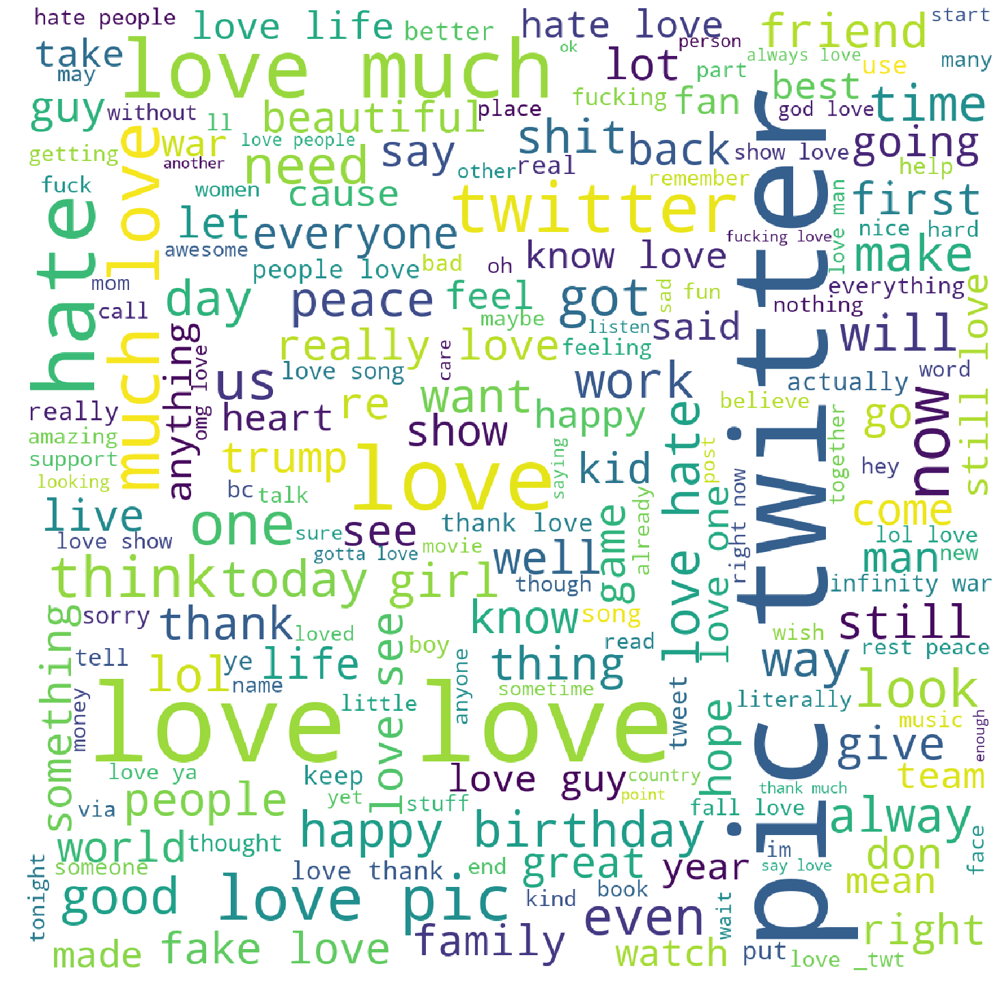

In [106]:
# plot & save the WordCloud image                        
plt.figure(figsize = (20, 20), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off") 
plt.tight_layout(pad = 0) 
plt.savefig('wordcloud_lovehate.png')

### OK, that took entirely too long to process. 

Perhaps there are less resource-expensive ways to examine the data we have gathered.

In [141]:
# getting lists of dates for each lunar phase
all_phases = list(phases_2018_df.date.astype(str))
fullmoon_2018 = list(phases_2018_df[phases_2018_df.phase == 'Full Moon'].date.astype(str))
lastquarter_2018 = list(phases_2018_df[phases_2018_df.phase == 'Last Quarter'].date.astype(str))
newmoon_2018 = list(phases_2018_df[phases_2018_df.phase == 'New Moon'].date.astype(str))
firstquarter_2018 = list(phases_2018_df[phases_2018_df.phase == 'First Quarter'].date.astype(str))

In [142]:
df1 = df.set_index('timestamp')

# filtering only for tweets on Full Moon nights
tweets_full = df1.loc[df1.index.floor('D').isin(fullmoon_2018)]
tweets_last = df1.loc[df1.index.floor('D').isin(lastquarter_2018)]
tweets_new = df1.loc[df1.index.floor('D').isin(newmoon_2018)]
tweets_first = df1.loc[df1.index.floor('D').isin(firstquarter_2018)]
tweets_not_in_phase = df1.loc[~df1.index.floor('D').isin(all_phases)]

In [145]:
tweets_not_in_phase.head()

,text,sentiment,polarity,subjectivity,tally
timestamp,,,,,
2018-01-01,i hate everyone.... naaa.. i just hate people...,negative,-0.800000,0.900000,1
2018-01-01,I love how your new label is taking everything...,positive,0.387273,0.550909,1
2018-01-01,I'll love you 'till my breathing stops...,positive,0.500000,0.600000,1
2018-01-01,"If RDR2 has loot boxes, I hope that 1/10 of th...",positive,0.150000,0.700000,1
2018-01-01,Love love luv you more,positive,0.500000,0.566667,1


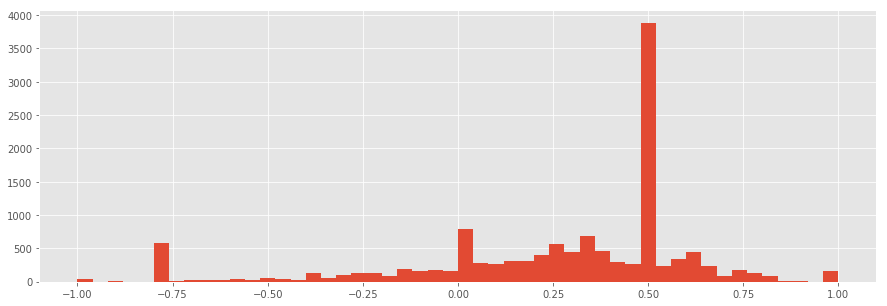

In [185]:
plt.figure(figsize=(15,5))
plt.hist(tweets_full.polarity, bins=50);

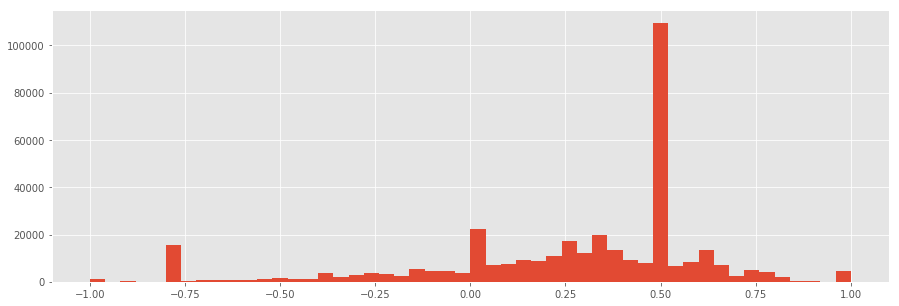

In [159]:
plt.figure(figsize=(15,5))
plt.hist(df1.polarity, bins=50);

love 11079
hate 2002
just 1000
like 906
war 733
don 696
people 665
know 572
good 453
time 437
peace 425
really 405
happy 398
want 391
thank 377
day 363
life 323
great 299
new 299
god 299
man 285
think 283
make 279
got 275
way 266


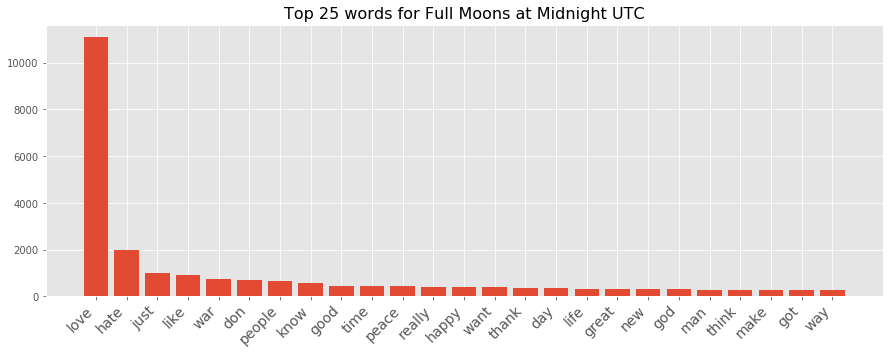

In [219]:
comm_words = get_top_n_words(tweets_full.text, 25)
for word, freq in comm_words:
    print(word, freq)
df2 = pd.DataFrame(comm_words, columns=['text' , 'count'])
plt.figure(figsize=(15,5))
plt.bar(df2.text, df2['count'])
plt.title("Top 25 words for Full Moons at Midnight UTC", fontsize=16)
plt.xticks(fontsize=14, rotation=45, horizontalalignment='right');

In [301]:
# function to get most frequent words
def get_top_n_words(corpus, stopwords):
    vec = CountVectorizer(stop_words=stopwords).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq


# function for plotting the most frequent words
def plot_phase_words(corpus, keywords, phase, stopwords, n=None):
    comm_words = get_top_n_words(corpus.text, stopwords)[:n]
    df2 = pd.DataFrame(comm_words, columns=['text', 'count'])
    total = df2['count'].sum()   ###################    
    # plotting
    fig, ax = plt.subplots(figsize=(15,5))
    plt.xticks(rotation=30, fontsize=14)
    hghts = ((df2['count'] / total) * 100)
    rects = ax.bar(df2.text, hghts)                                                  #################
    ax.set_title(f"Top {n} Words for {phase} at Midnight UTC", fontsize=16)
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width(), 1.005*height,
                f'{np.round(height, 2)}%', ha='right', va='bottom')
    plt.plot([], [], ' ', label=f"Search Keywords:\n{keywords}")
    plt.legend(fontsize=14)
    plt.show();


# function to parse a CSV file and then plot all results
def plot_CSV_words(filename, keywords, phases_df, n=None):
    """
    Inputs:
    filename       (str) CSV filename generated from Twitter scraping function
    keywords       (str) the query keywords used in Twitter scraping function
    phases_df      (df) dataframe of lunar phases for a given year
    n              (int) number of most common words to return
    ==================================================
    Returns:
    Histograms (5 total) of the 'n' most common words for each lunar phase and for
    all the nights not in a lunar phase.
    """
    df = pd.read_csv(filename)
    df.dropna(inplace=True)
    df.timestamp = pd.to_datetime(df.timestamp, format='%Y%m%d')  
    stopwords = set(ENGLISH_STOP_WORDS)
    # now add extra things to that list that we want to filter out
    stopwords.update(['twitter','com','pic','ve','ll','just','like','don','really','00'])
    df.set_index('timestamp', inplace=True)
    
    phase_list = ['Full Moon','Last Quarter','New Moon','First Quarter','No Phase']
    for phase in phase_list:
        all_moons = list(phases_df.date.astype(str))
        if phase != 'No Phase':
            moon = list(phases_df[phases_df.phase == phase].date.astype(str))
            moon_data = df.loc[df.index.floor('D').isin(moon)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)
        else:
            moon_data = df.loc[~df.index.floor('D').isin(all_moons)]
            plot_phase_words(moon_data, keywords, phase, stopwords, n=n)

In [303]:
# plot_CSV_words(filename='tweets_nowords_2018.csv',
#                keywords='(NO KEYWORDS QUERIED)',
#                phases_df=phases_2018_df,
#                n=25)

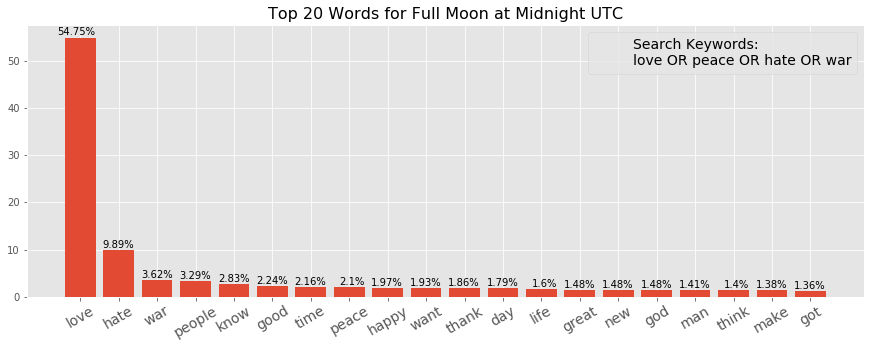

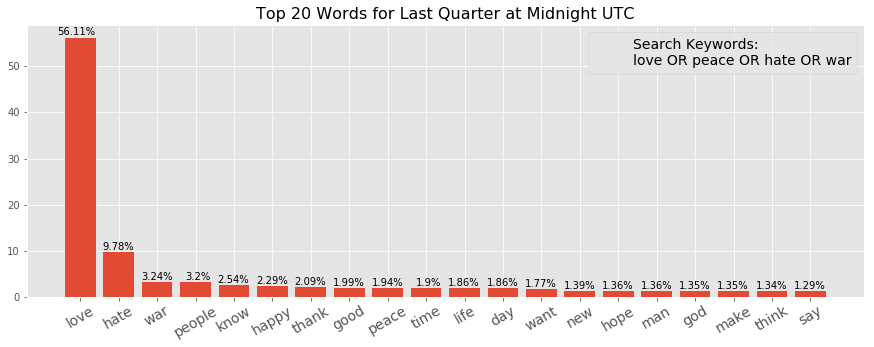

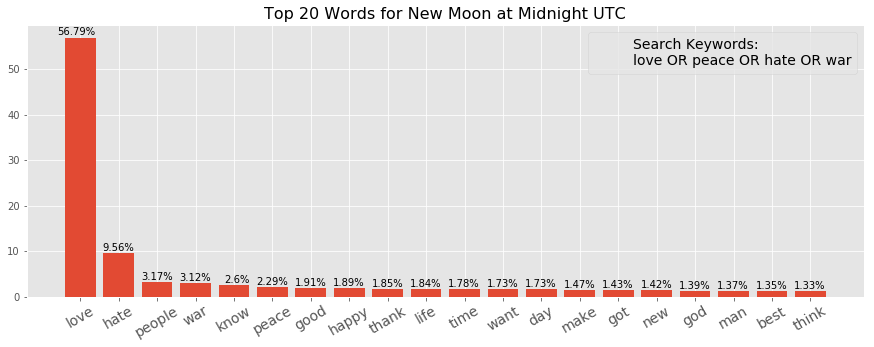

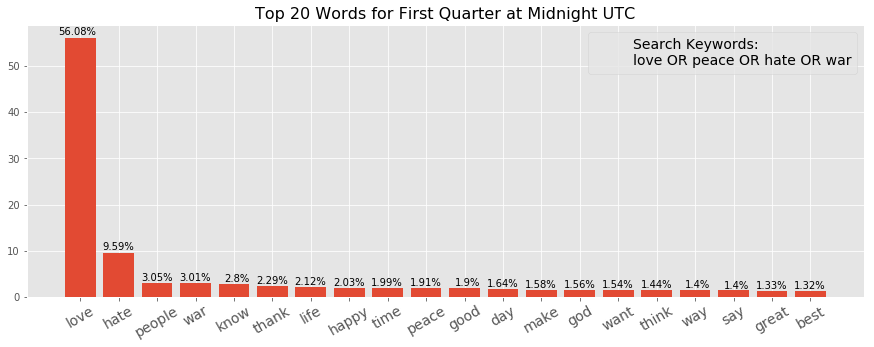

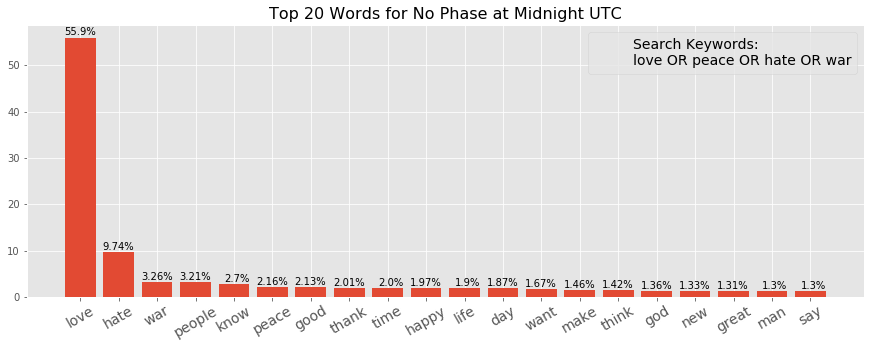

...

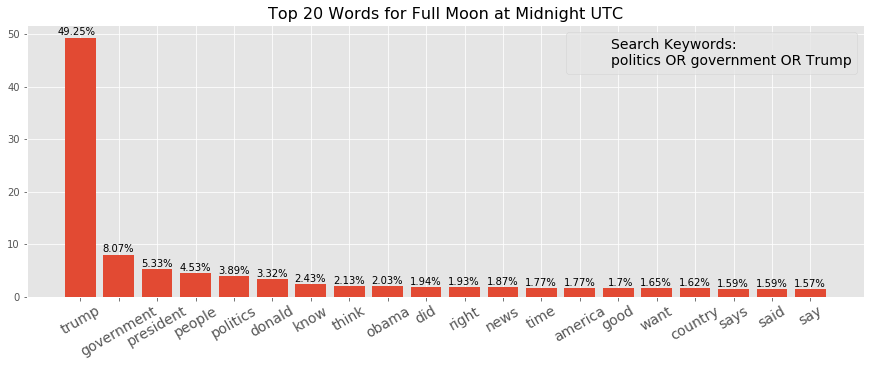

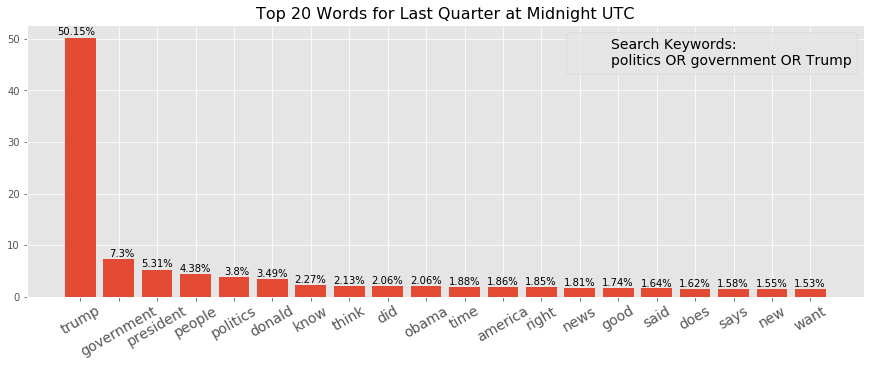

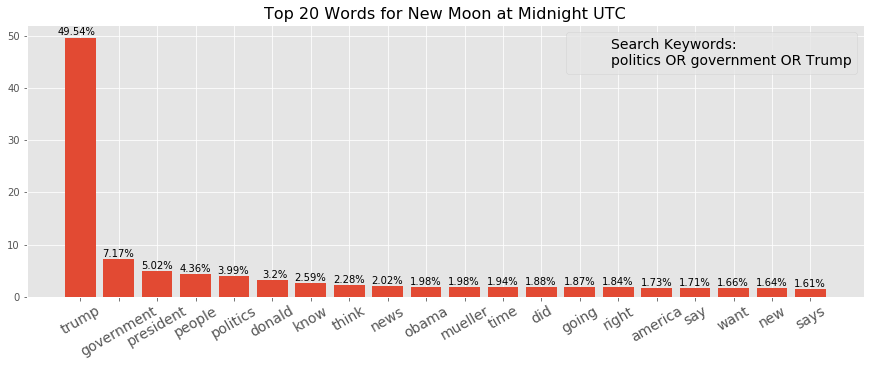

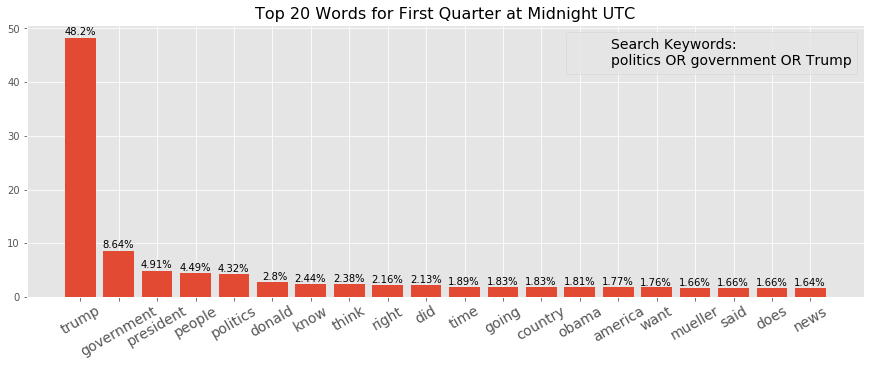

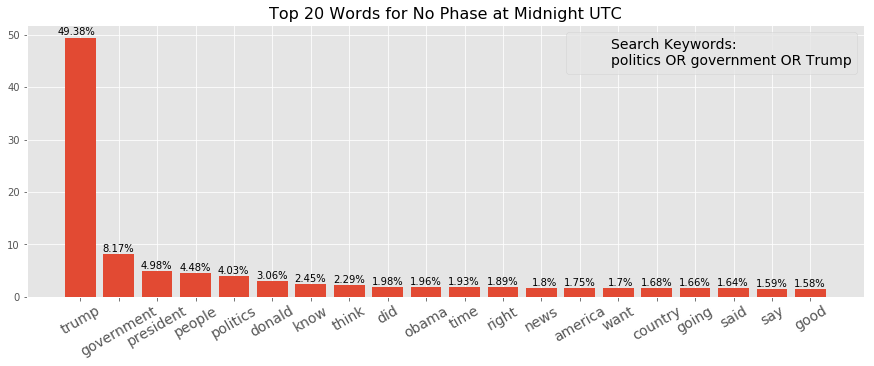

In [290]:
tweet_csv_files = ['tweets_lovehatewords_2018.csv',
                   'tweets_happysad_2018.csv',
                   'tweets_musicwords_2018.csv',
                   'tweets_moneywords_2018.csv',
                   'tweets_nowords_2018.csv',
                   'tweets_politicwords_2018.csv']

queries = ['love OR peace OR hate OR war',
           'happy OR sad OR life OR death',
           'music OR tunes OR dance',
           'stocks OR money OR taxes',
           '(no keywords entered)',
           'politics OR government OR Trump'] 

for filename, key_words in zip(tweet_csv_files, queries):
    plot_CSV_words(filename=filename,
               keywords=key_words,
               phases_df=phases_2018_df,
               n=20)

In [304]:
filename = 'tweets_nowords_2018.csv'
derf = pd.read_csv(filename)
derf.dropna(inplace=True)
derf.timestamp = pd.to_datetime(derf.timestamp, format='%Y%m%d')  
stopwords = set(ENGLISH_STOP_WORDS)
# now add extra things to that list that we want to filter out
stopwords.update(['twitter','com','pic','ve','ll','just','like','don','really','00'])
derf.set_index('timestamp', inplace=True)

comm_words = get_top_n_words(derf.text, stopwords)


In [311]:
word_count = 0
for word in comm_words:
    word_count += word[1]
word_count

2458654